In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
from numpy import linalg as LA
import random
from matplotlib.patches import Ellipse
import matplotlib.transforms as transforms

data_csv = pd.read_csv('./data.csv', header = None)
data = np.array(data_csv)

num_data = data.shape[0]

print(data)

[[ 37.39461895  31.04873877]
 [ -8.16834554 -12.04439852]
 [ 24.30362862  22.20918302]
 ...
 [ 28.15031603  29.59509463]
 [ 35.55857318  35.29055002]
 [ 23.16939613  22.22921506]]


In [7]:
def GMM(data_set, num_cluster, iteration):
    
    k = num_cluster
    num_iterate = iteration
    num_data = data.shape[0]
    # randomly select k data points for initial means
    mus = []
    for i in range(k):
        rand_index = random.randint(0,num_data-1)
        mus.append(data[rand_index])

    sigmas = []
    # calculate overall covariance matrix for initial variance for each cluster
    for i in range(k):
        sigma = np.dot((data-mus[i]).T, data - mus[i]) / num_data
        # store cov in a map with cluster number
        print('shape of sigma = ', sigma.shape)
        sigmas.append(sigma)

    # assign equal prior probabilities to each cluster initially
    phis = np.ones(k) * (1/k)
    
    print('###### Intialization ######')    
    print('Initial means\n', mus)
    print('Initial sigmas\n', sigmas)
    print('Initial phis\n', phis)
    # E-step and M-step

    # computes a probability of how much responsible for a specific 
    # data points fall under a certain cluster
    def get_rp(data_point, mu, sigma):
        data_point = data_point.reshape((2,1))
        mu = mu.reshape((2,1))
        const = 1 / math.sqrt((2*math.pi)**3 * LA.det(sigma))
        exp = np.exp(-0.5*(data_point-mu).T.dot(LA.inv(sigma)).dot(data_point-mu))

        return const * exp[0][0]
    
    def get_rp2(data_point, mu, sigma):
        data_point = data_point.reshape(2,-1)
        mu = mu.reshape(2,-1)
        
        y = 1.0 / math.sqrt((2*math.pi)**3 * LA.det(sigma))
        a = np.exp(-0.5*(data_point-mu).T.dot(LA.inv(sigma)).dot(data_point-mu))
        
        print(y*a)
        return y * a
    
    # This (n,k) shape of matrix will hold all the responsible probabilities
    r = np.zeros((num_data,k))


    # iteration for Expectation-Maximization
    print('Training in progress...({0} clusters)'.format(k))
    while iteration > 0:
        iteration = iteration - 1

        ### E-step ###
        total_rp = 0

        for i in range(num_data):
            for j in range(k):
                rp = phis[j] * get_rp2(data[i], mus[j], sigmas[j])
                total_rp = total_rp + rp
                r[i][j] = rp

        r = r / total_rp

        # normalizing for each data points over k clusters (row sum)
        row_sum = np.sum(r, axis=1)
        for i in range(num_data):
            r[i] = r[i] / row_sum[i]

        ### M-step ###

        # total responsibility allocated to 
        rp_sum_each_cluster = []
        m = 0
        for j in range(k):
            col_sum = np.sum(r[:,j])
            rp_sum_each_cluster.append(col_sum)
            m = m + col_sum

        # updating phi
        for j in range(k):
            phis[j] = rp_sum_each_cluster[j] / m

        # updating mu
        for j in range(k):
            new_mu = np.zeros(2)
            for i in range(num_data):
                new_mu = new_mu + r[i][j] * data[i]
            new_mu = new_mu / rp_sum_each_cluster[j]    
            mus[j] = new_mu 

        # updating sigma
        for j in range(k):
            new_sigma = np.zeros((2,2))
            mu = mus[j].reshape((2,1))
            for i in range(num_data):
                data_point = data[i].reshape((2,1))
                diff = data_point - mu # (2,1)
                new_sigma = new_sigma + r[i][j] * np.dot(diff, diff.T)
            sigmas[j] = new_sigma / rp_sum_each_cluster[j]

        # computer log likelihood
        # each iteration step should increase log likelihood of the model
        #llh = 0
        #for i in range(num_data):
        #    data_point = data[i].reshape((2,1))
        #    for j in range(k):
        #        llh = llh + phis[j] * get_rp(data_point, mus[j], sigmas[j])

    print('Training done!!!\n')
    print('###### RESULT ######')
    print('Total iteration: ', num_iterate)
    print('Number of clusters: ', k)
    print('Final means\n', mus)
    print('Final sigmas\n', sigmas)
    print('Final phis\n', phis)
        
    
    return mus, sigmas, r

def confidence_ellipse(x, y, mu, sigma, ax, n_std=3.0, facecolor='none', **kwargs):

    if x.size != y.size:
        raise ValueError("x and y must be the same size")

    cov = sigma
    pearson = cov[0][1]/np.sqrt(cov[0][0] * cov[1][1])
    # Using a special case to obtain the eigenvalues of this
    # two-dimensionl dataset.
    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
    ellipse = Ellipse((0, 0),
        width=ell_radius_x * 2,
        height=ell_radius_y * 2,
        facecolor=facecolor,
        **kwargs)

    # Calculating the stdandard deviation of x from
    # the squareroot of the variance and multiplying
    # with the given number of standard deviations.
    scale_x = np.sqrt(cov[0][0]) * n_std
    mean_x = mu[0]

    # calculating the stdandard deviation of y ...
    scale_y = np.sqrt(cov[1][1]) * n_std
    mean_y = mu[1]

    transf = transforms.Affine2D() \
        .rotate_deg(45) \
        .scale(scale_x, scale_y) \
        .translate(mean_x, mean_y)

    ellipse.set_transform(transf + ax.transData)
    return ax.add_patch(ellipse)

def plot_2d_gmm(mus, sigmas, num_clusters):
    
    title = 'Gaussian mixture model'
    if num_cluster == 1:
        title = 'Single Gaussian'
        
    k = num_clusters
    # Plotting Gaussian (showing each iteration)#
    x = data[:,0].reshape((num_data,1))
    y = data[:,1].reshape((num_data,1))       

    fig, ax_nstd = plt.subplots(figsize=(6, 6))
    ax_nstd.axvline(c='grey', lw=1)
    ax_nstd.axhline(c='grey', lw=1)

    ax_nstd.scatter(x, y, s=0.5)

    # color up to 4 clusters...
    color = ['red', 'black', 'green', 'blue']
    for j in range(k):
        confidence_ellipse(x, y, mus[j], sigmas[j], ax_nstd, n_std=1,
                            label=r'1$\sigma$', edgecolor=color[j])
        ax_nstd.scatter(mus[j][0], mus[j][1], c=color[j], s=10) # mean point
        confidence_ellipse(x, y, mus[j], sigmas[j], ax_nstd, n_std=2,
                            label=r'2$\sigma$', edgecolor=color[j])
        ax_nstd.scatter(mus[j][0], mus[j][1], c=color[j], s=10) # mean point
        confidence_ellipse(x, y, mus[j], sigmas[j], ax_nstd, n_std=3,
                            label=r'3$\sigma$', edgecolor=color[j])
        ax_nstd.scatter(mus[j][0], mus[j][1], c=color[j], s=10) # mean point

    ax_nstd.set_title(title)
    ax_nstd.legend()
    plt.show()
    
#def plot_2d_heatmap(mus, sigmas, num_clusters):
    

shape of sigma =  (2, 2)
###### Intialization ######
Initial means
 [array([23.19726908, 21.09387641])]
Initial sigmas
 [array([[267.12131012, 250.90791963],
       [250.90791963, 257.81456342]])]
Initial phis
 [1.]
Training in progress...(1 clusters)
[[0.00043737]]
[[9.64911826e-05]]
[[0.00082371]]
[[0.00075814]]
[[0.00013693]]
[[0.00022258]]
[[0.00028078]]
[[0.0002833]]
[[0.0007883]]
[[0.00071144]]
[[0.00015303]]
[[6.98492686e-05]]
[[0.00011746]]
[[9.41532278e-05]]
[[0.00027411]]
[[0.00066349]]
[[0.00038268]]
[[0.00068377]]
[[0.00052438]]
[[0.000795]]
[[1.79357405e-05]]
[[0.00078539]]
[[0.00047516]]
[[0.00059188]]
[[0.00074809]]
[[0.00043013]]
[[0.00041055]]
[[0.00020366]]
[[0.00062346]]
[[0.00062795]]
[[0.00035339]]
[[0.00070891]]
[[0.00068574]]
[[0.00025714]]
[[0.00034257]]
[[4.36256348e-05]]
[[3.59018111e-05]]
[[0.00021248]]
[[0.00036375]]
[[0.00051906]]
[[0.00037734]]
[[0.0007706]]
[[0.00079804]]
[[0.00035187]]
[[0.00057171]]
[[6.01537753e-05]]
[[0.00041662]]
[[0.00076966]]
[[0.0

[[0.00050194]]
[[0.00020272]]
[[0.00013035]]
[[0.0002496]]
[[0.00075095]]
[[0.00026871]]
[[1.38147784e-05]]
[[0.00033974]]
[[0.00072572]]
[[0.00078281]]
[[0.00033682]]
[[0.00018841]]
[[0.00068896]]
[[0.00077908]]
[[0.00014162]]
[[0.00055562]]
[[0.00073546]]
[[0.00028711]]
[[0.00034446]]
[[0.000618]]
[[0.00024772]]
[[0.00016023]]
[[0.00020679]]
[[0.00068886]]
[[0.00065373]]
[[0.00074956]]
[[0.00079228]]
[[3.20433586e-05]]
[[0.00035125]]
[[7.59159565e-05]]
[[0.00065139]]
[[0.00035633]]
[[0.00041756]]
[[0.00032175]]
[[0.00059172]]
[[3.96587851e-05]]
[[0.00028146]]
[[7.34635356e-05]]
[[0.00082333]]
[[0.00067514]]
[[0.00078633]]
[[7.71430315e-05]]
[[0.00045133]]
[[0.00063298]]
[[0.00076414]]
[[8.65562894e-05]]
[[1.41897781e-07]]
[[8.00173747e-05]]
[[0.00068008]]
[[0.00078531]]
[[0.00078878]]
[[0.00056416]]
[[5.85168001e-05]]
[[0.00029099]]
[[0.00031174]]
[[0.00051121]]
[[0.00034209]]
[[0.00013026]]
[[0.00078698]]
[[0.0002789]]
[[0.00038677]]
[[0.00018386]]
[[0.0004374]]
[[0.00081331]]
[[0.0

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.0001633]]
[[0.00023125]]
[[0.00041398]]
[[0.00045915]]
[[0.00073307]]
[[0.0002886]]
[[5.46562009e-05]]
[[0.00073192]]
[[0.00038394]]
[[0.0001953]]
[[5.39115004e-05]]
[[0.00051657]]
[[0.00027813]]
[[1.59137223e-05]]
[[0.00056441]]
[[0.00031399]]
[[0.00049478]]
[[0.00051899]]
[[0.00086065]]
[[0.00010033]]
[[0.00075258]]
[[2.11153561e-05]]
[[0.00087784]]
[[0.00087897]]
[[0.00092693]]
[[0.00090937]]
[[0.00051429]]
[[0.00039406]]
[[0.00085122]]
[[0.00041285]]
[[0.00090654]]
[[0.0003268]]
[[0.00073896]]
[[0.0009033]]
[[0.0007887]]
[[0.00058502]]
[[0.00018226]]
[[0.00011081]]
[[7.72751179e-06]]
[[0.00077584]]
[[0.00020143]]
[[0.00050638]]
[[0.00013874]]
[[0.0001637]]
[[0.00067045]]
[[0.000542]]
[[0.00022907]]
[[0.0008491]]
[[0.0003257]]
[[0.00029262]]
[[0.00022405]]
[[0.00039241]]
[[0.00086035]]
[[0.00016082]]
[[9.50221366e-05]]
[[0.00084173]]
[[0.00058099]]
[[0.00064158]]
[[0.00026598]]
[[0.00092933]]
[[0.00094151]]
[[0.00087185]]
[[0.00025439]]
[[0.00052206]]
[[0.0005883]]
[[0.00047504]

[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]]
[[0.00053968]]
[[0.00051673]]
[[0.0004763]]
[[0.00027391]]
[[0.00035571]]
[[0.00041659]]
[[0.00018708]]
[[0.00073362]]
[[0.00040649]]
[[2.98458778e-05]]
[[0.00025374]]
[[0.00087713]]
[[0.00011712]]
[[0.00072838]]
[[0.00073649]]
[[0.00080918]]
[[0.00046103]]
[[2.3274427e-05]]
[[0.0003403]]
[[2.20941919e-05]]
[[0.00033659]]
[[0.00085319]]
[[0.00070832]]
[[0.00043158]]
[[0.00044582]]
[[0.00075494]]
[[0.000915]]
[[0.00085327]]
[[0.0006145]]
[[0.00061062]]
[[0.00056174]]
[[0.00091485]]
[[0.0002093]]
[[0.00050538]]
[[0.00090026]]
[[0.00041198]]
[[0.00049682]]
[[0.00014759]]
[[0.00015551]]
[[0.00044647]]
[[0.0009224]]
[[0.00066222]]
[[0.00070574]]
[[0.00064408]]
[[1.61556876e-05]

[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]
[[0.00011585]]
[[0.00083149]]
[[0.0007099]]
[[0.00092238]]
[[0.00014289]]
[[0.00055567]]
[[0.00048575]]
[[0.00081948]]
[[1.051854e-05]]
[[2.24055424e-07]]
[[0.00014808]]
[[0.00044894]]
[[0.00066445]]
[[0.0009271]]
[[0.00084599]]
[[0.00010433]]
[[7.85626152e-05]]
[[0.00044349]]
[[0.00080653]]
[[0.00037234]]
[[0.00022828]]
[[0.00063397]]
[[0.00043248]]
[[0.00013286]]
[[0.00010346]]
[[0.00064089]]
[[0.00082648]]
[[0.0002477]]
[[0.00016348]]
[[0.00033934]]
[[0.00038259]]
[[0.00055986]]
[[0.00014891]]
[[0.00089244]]
[[2.14775713e-05]]
[[0.00021676]]
[[0.00031622]]
[[0.00033251]]
[[0.00026434]]
[[0.00064851]]
[[0.00088097]]
[[0.00091175]]
[[0.00082835]]
[[9.42354122e-05]]
[[0.00021059]]
[[0.00012837]]
[[0.00075833]]
[[3.38589167e-05]]
[[0.00033654]]
[[0.00018845]]
[[0.00031483]]
[[0.00033643]]
[[0.00055809]]
[[0.00086711]]
[[0.00017505]

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.00038345]]
[[0.00069232]]
[[0.00049667]]
[[0.00017777]]
[[0.00033038]]
[[0.00011862]]
[[0.0002647]]
[[0.00070981]]
[[0.00080251]]
[[0.00064387]]
[[0.00019215]]
[[0.00069742]]
[[0.0003756]]
[[0.00086306]]
[[0.00080039]]
[[0.00076007]]
[[0.0004513]]
[[0.00035915]]
[[0.00038128]]
[[0.00045038]]
[[0.00086791]]
[[0.00038819]]
[[7.03138258e-05]]
[[0.00040716]]
[[0.00088445]]
[[1.60873594e-05]]
[[0.00018534]]
[[0.00083102]]
[[0.0001305]]
[[0.00039435]]
[[0.00033222]]
[[0.00091695]]
[[0.00060147]]
[[5.76684983e-05]]
[[0.00083144]]
[[0.00016632]]
[[0.00035336]]
[[0.00026681]]
[[0.00017629]]
[[0.00053959]]
[[0.00071647]]
[[0.0003831]]
[[7.9164287e-05]]
[[0.00017689]]
[[0.00092127]]
[[0.00088205]]
[[0.00047291]]
[[0.00060259]]
[[6.77414687e-05]]
[[0.00091686]]
[[0.00023766]]
[[0.00090424]]
[[6.76831813e-05]]
[[0.00064665]]
[[0.00094411]]
[[0.00072471]]
[[0.00012708]]
[[0.00082857]]
[[0.00084371]]
[[0.00093761]]
[[0.00087209]]
[[0.00035286]]
[[0.00067887]]
[[0.00088916]]
[[0.00044848]]
[[1.694

[[0.0003606]]
[[0.0008783]]
[[0.00047029]]
[[0.00042082]]
[[6.05804659e-05]]
[[0.00055346]]
[[5.5676075e-05]]
[[0.00093552]]
[[0.00040498]]
[[0.0002266]]
[[0.00075763]]
[[2.71391472e-05]]
[[0.00076613]]
[[0.00089092]]
[[0.00043444]]
[[0.00015454]]
[[0.00016811]]
[[0.00087278]]
[[0.00040133]]
[[0.00073142]]
[[0.00093414]]
[[0.00047479]]
[[0.00093538]]
[[0.00024124]]
[[3.50937947e-05]]
[[0.00031579]]
[[0.00072371]]
[[0.00075218]]
[[0.0003831]]
[[0.00056924]]
[[0.00078125]]
[[0.00059327]]
[[0.00022467]]
[[0.00026584]]
[[0.00023898]]
[[0.00026721]]
[[0.00028743]]
[[0.00039658]]
[[6.65480494e-05]]
[[0.00083632]]
[[0.00034849]]
[[0.00079975]]
[[0.00037737]]
[[0.00020427]]
[[6.81488915e-05]]
[[0.00038817]]
[[7.10643284e-07]]
[[7.4997905e-05]]
[[0.00042724]]
[[0.00092958]]
[[0.00047346]]
[[6.37684199e-06]]
[[0.00052874]]
[[0.00023587]]
[[0.00084937]]
[[0.0004501]]
[[1.01688064e-05]]
[[0.0008647]]
[[0.00017102]]
[[0.00010618]]
[[0.00091185]]
[[0.00046168]]
[[0.00036866]]
[[0.00090189]]
[[0.0005

[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]
[[0.00011585]]
[[0.00083149]]
[[0.0007099]]
[[0.00092238]]
[[0.00014289]]
[[0.00055567]]
[[0.00048575]]
[[0.00081948]]
[[1.051854e-05]]
[[2.24055424e-07]]
[[0.00014808]]
[[0.00044894]]
[[0.00066445]]
[[0.0009271]]
[[0.00084599]]
[[0.00010433]]
[[7.85626152e-05]]
[[0.00044349]]
[[0.00080653]]
[[0.00037234]]
[[0.00022828]]
[[0.00063397]]
[[0.00043248]]
[[0.00013286]]
[[0.00010346]]
[[0.00064089]]
[[0.00082648]]
[[0.0002477]]
[[0.00016348]]
[[0.00033934]]
[[0.00038259]]
[[0.00055986]]
[[0.00014891]]
[[0.00089244]]
[[2.14775713e-05]]
[[0.00021676]]
[[0.00031622]]
[[0.00033251]]
[[0.00026434]]
[[0.00064851]]
[[0.00088097]]
[[0.00091175]]
[[0.00082835]]
[[9.42354122e-05]]
[[0.00021059]]
[[0.00012837]]
[[0.00075833]]
[[3.38589167e-05]]
[[0.00033654]]
[[0.00018845]]
[[0.00031483]]
[[0.00033643]]
[[0.00055809]]
[[0.00086711]]
[[0.00017505]]
[[0.00067535]]
[[0.00051401]]
[[0.00081981]]
[[0.00039855]]
[[0.00092973]]
[[0.00086267]]
[[

[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495

[[0.00061834]]
[[0.00079167]]
[[0.00035879]]
[[0.00069151]]
[[0.00052742]]
[[0.00021022]]
[[0.00030337]]
[[0.00065605]]
[[0.0005089]]
[[2.48185809e-05]]
[[0.00032094]]
[[0.00083415]]
[[0.0008157]]
[[0.00085879]]
[[0.00091471]]
[[0.00027163]]
[[0.00087563]]
[[0.00051229]]
[[0.00032416]]
[[0.0006343]]
[[0.0008411]]
[[0.00045272]]
[[0.0006233]]
[[0.00067583]]
[[0.00037538]]
[[0.00089227]]
[[0.00015708]]
[[0.00077661]]
[[0.00050724]]
[[0.00046485]]
[[0.00081705]]
[[0.00087647]]
[[0.00067349]]
[[0.00092808]]
[[0.00080867]]
[[3.62272494e-06]]
[[0.00056526]]
[[0.00023404]]
[[0.00091048]]
[[0.00070083]]
[[0.00086512]]
[[0.00028602]]
[[0.00022237]]
[[0.00037841]]
[[0.00086969]]
[[0.00091693]]
[[0.00082551]]
[[5.92354513e-05]]
[[0.00041423]]
[[0.00024809]]
[[0.00029288]]
[[4.92289655e-05]]
[[0.0007028]]
[[0.00079918]]
[[0.00084862]]
[[0.00094746]]
[[0.00090257]]
[[0.00085295]]
[[0.00034091]]
[[0.00082853]]
[[3.7557986e-05]]
[[0.00046824]]
[[0.00082828]]
[[1.00358439e-07]]
[[0.00071551]]
[[0.0001

[[0.0002499]]
[[0.00034871]]
[[0.00034946]]
[[0.00070076]]
[[0.00013222]]
[[0.00018382]]
[[0.00087722]]
[[0.00043835]]
[[0.0005347]]
[[0.00087195]]
[[0.00038345]]
[[0.00069232]]
[[0.00049667]]
[[0.00017777]]
[[0.00033038]]
[[0.00011862]]
[[0.0002647]]
[[0.00070981]]
[[0.00080251]]
[[0.00064387]]
[[0.00019215]]
[[0.00069742]]
[[0.0003756]]
[[0.00086306]]
[[0.00080039]]
[[0.00076007]]
[[0.0004513]]
[[0.00035915]]
[[0.00038128]]
[[0.00045038]]
[[0.00086791]]
[[0.00038819]]
[[7.03138258e-05]]
[[0.00040716]]
[[0.00088445]]
[[1.60873594e-05]]
[[0.00018534]]
[[0.00083102]]
[[0.0001305]]
[[0.00039435]]
[[0.00033222]]
[[0.00091695]]
[[0.00060147]]
[[5.76684983e-05]]
[[0.00083144]]
[[0.00016632]]
[[0.00035336]]
[[0.00026681]]
[[0.00017629]]
[[0.00053959]]
[[0.00071647]]
[[0.0003831]]
[[7.9164287e-05]]
[[0.00017689]]
[[0.00092127]]
[[0.00088205]]
[[0.00047291]]
[[0.00060259]]
[[6.77414687e-05]]
[[0.00091686]]
[[0.00023766]]
[[0.00090424]]
[[6.76831813e-05]]
[[0.00064665]]
[[0.00094411]]
[[0.00072

[[0.0005883]]
[[0.00047504]]
[[0.00092667]]
[[0.00023181]]
[[0.0001357]]
[[0.00050284]]
[[0.00094061]]
[[0.00082855]]
[[0.00056496]]
[[6.93172367e-05]]
[[0.00043216]]
[[0.00025896]]
[[0.0009341]]
[[0.00090786]]
[[0.00030096]]
[[0.00013557]]
[[0.00038701]]
[[0.00075041]]
[[0.00080722]]
[[0.00010505]]
[[0.00065066]]
[[0.00024655]]
[[0.00030279]]
[[0.00015776]]
[[0.00036417]]
[[0.00046545]]
[[7.73713821e-05]]
[[9.81380083e-06]]
[[0.0007586]]
[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]

[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]]
[[0.00053968]]
[[0.00051673]]
[[0.0004763]]
[[0.00027391]]
[[0.00035571]]
[[0.00041659]]
[[0.00018708]]
[[0.00073362]]
[[0.00040649]]
[[2.98458778e-05]]
[[0.00025374]]
[[0.00087713]]
[[0.00011712]]
[[0.00072838]]
[[0.00073649]]
[[0.00080918]]
[[0.00046103]]
[[2.3274427e-05]]
[[0.0003403]]
[[2.20941919e-05]]
[[0.00033659]]
[[0.00085319]]
[[0.00070832]]
[[0.00043158]]
[[0.00044582]]
[[0.00075494]]
[[0.000915]]
[[0.00085327]]
[[0.0006145]]
[[0.00061062]]
[[0.00056174]]
[[0.00091485]]
[[0.0002093]]
[[0.00050538]]
[

[[0.0007028]]
[[0.00079918]]
[[0.00084862]]
[[0.00094746]]
[[0.00090257]]
[[0.00085295]]
[[0.00034091]]
[[0.00082853]]
[[3.7557986e-05]]
[[0.00046824]]
[[0.00082828]]
[[1.00358439e-07]]
[[0.00071551]]
[[0.00013444]]
[[0.00091798]]
[[0.00083132]]
[[0.00080223]]
[[3.81790776e-05]]
[[0.00073207]]
[[0.00018555]]
[[0.00093825]]
[[0.00087295]]
[[0.00032492]]
[[0.00095261]]
[[0.00085182]]
[[0.000542]]
[[0.00041067]]
[[1.15642886e-05]]
[[0.00085833]]
[[5.74798598e-05]]
[[0.00072669]]
[[5.9039117e-05]]
[[1.10953726e-05]]
[[0.00052031]]
[[0.00032412]]
[[0.00033578]]
[[0.00016646]]
[[0.00017083]]
[[0.00020797]]
[[0.00090636]]
[[0.00069174]]
[[0.00076029]]
[[0.0004199]]
[[0.00054172]]
[[0.00053114]]
[[0.00026605]]
[[0.00075873]]
[[0.00085181]]
[[0.00086034]]
[[0.00028705]]
[[0.00073]]
[[0.00018364]]
[[0.0008289]]
[[0.00054501]]
[[0.00085277]]
[[0.00030891]]
[[2.39615085e-05]]
[[0.00079427]]
[[0.00044866]]
[[1.26859324e-05]]
[[0.00011335]]
[[5.91687168e-05]]
[[0.00070593]]
[[7.26066137e-05]]
[[0.00

[[0.00093145]]
[[6.17433014e-05]]
[[0.00045497]]
[[1.87822036e-05]]
[[5.83668674e-07]]
[[0.00083773]]
[[0.00065776]]
[[0.0008499]]
[[0.00033067]]
[[0.00092073]]
[[4.09859091e-05]]
[[0.00093133]]
[[0.00040757]]
[[0.00048929]]
[[0.00074182]]
[[0.00037421]]
[[0.00054532]]
[[3.91361205e-05]]
[[0.00092995]]
[[0.00014681]]
[[0.00035235]]
[[0.00012357]]
[[0.00093735]]
[[0.00086999]]
[[0.00053027]]
[[0.00033274]]
[[0.0003162]]
[[0.00083219]]
[[0.00013581]]
[[0.00023814]]
[[0.00032663]]
[[0.00055576]]
[[0.00033142]]
[[2.78459367e-05]]
[[0.00047772]]
[[0.00026435]]
[[0.00045438]]
[[2.53442985e-05]]
[[0.00039706]]
[[0.00089399]]
[[0.00036904]]
[[0.00041629]]
[[0.00062661]]
[[0.00067964]]
[[0.00038254]]
[[6.11524431e-05]]
[[0.0003068]]
[[0.00092851]]
[[0.00078468]]
[[0.00040809]]
[[8.10063073e-05]]
[[0.00031333]]
[[0.00080457]]
[[0.00045398]]
[[0.00022523]]
[[0.00073677]]
[[0.00052234]]
[[0.00011371]]
[[0.00080574]]
[[0.00027754]]
[[1.52797436e-05]]
[[0.00046618]]
[[0.00090368]]
[[0.00082561]]
[[6

[[0.00056441]]
[[0.00031399]]
[[0.00049478]]
[[0.00051899]]
[[0.00086065]]
[[0.00010033]]
[[0.00075258]]
[[2.11153561e-05]]
[[0.00087784]]
[[0.00087897]]
[[0.00092693]]
[[0.00090937]]
[[0.00051429]]
[[0.00039406]]
[[0.00085122]]
[[0.00041285]]
[[0.00090654]]
[[0.0003268]]
[[0.00073896]]
[[0.0009033]]
[[0.0007887]]
[[0.00058502]]
[[0.00018226]]
[[0.00011081]]
[[7.72751179e-06]]
[[0.00077584]]
[[0.00020143]]
[[0.00050638]]
[[0.00013874]]
[[0.0001637]]
[[0.00067045]]
[[0.000542]]
[[0.00022907]]
[[0.0008491]]
[[0.0003257]]
[[0.00029262]]
[[0.00022405]]
[[0.00039241]]
[[0.00086035]]
[[0.00016082]]
[[9.50221366e-05]]
[[0.00084173]]
[[0.00058099]]
[[0.00064158]]
[[0.00026598]]
[[0.00092933]]
[[0.00094151]]
[[0.00087185]]
[[0.00025439]]
[[0.00052206]]
[[0.0005883]]
[[0.00047504]]
[[0.00092667]]
[[0.00023181]]
[[0.0001357]]
[[0.00050284]]
[[0.00094061]]
[[0.00082855]]
[[0.00056496]]
[[6.93172367e-05]]
[[0.00043216]]
[[0.00025896]]
[[0.0009341]]
[[0.00090786]]
[[0.00030096]]
[[0.00013557]]
[[0.0

[[0.00039333]]
[[0.00074142]]
[[0.0009436]]
[[0.00020068]]
[[0.00037298]]
[[0.00085965]]
[[0.00038695]]
[[0.00056608]]
[[0.0009001]]
[[0.0001499]]
[[0.00034243]]
[[2.28186832e-05]]
[[0.0008299]]
[[0.00087497]]
[[0.00083873]]
[[0.00086304]]
[[0.00088703]]
[[0.00035439]]
[[4.34070818e-05]]
[[0.00032872]]
[[0.00043311]]
[[0.00080529]]
[[0.00058793]]
[[0.00021714]]
[[0.00040144]]
[[0.00059124]]
[[0.00036579]]
[[0.00033831]]
[[0.00084469]]
[[0.00059005]]
[[0.00066115]]
[[0.00040563]]
[[0.0004356]]
[[0.00040756]]
[[0.0009296]]
[[0.00015386]]
[[0.00041015]]
[[0.00057954]]
[[0.00017553]]
[[9.02710715e-05]]
[[0.00042673]]
[[0.00040785]]
[[0.00023552]]
[[0.00084736]]
[[0.00041095]]
[[0.00063567]]
[[0.00086356]]
[[0.00048041]]
[[0.00037733]]
[[0.00037812]]
[[0.00078505]]
[[0.00031018]]
[[1.45579909e-05]]
[[0.00061458]]
[[0.00091603]]
[[1.70797573e-05]]
[[0.00082651]]
[[0.00076787]]
[[0.00068489]]
[[0.0003247]]
[[0.00094279]]
[[0.00055482]]
[[0.0005017]]
[[3.46503423e-05]]
[[0.00012096]]
[[0.00055

[[0.00051401]]
[[0.00081981]]
[[0.00039855]]
[[0.00092973]]
[[0.00086267]]
[[0.00078491]]
[[3.95573541e-05]]
[[0.00058606]]
[[0.00027345]]
[[0.00057652]]
[[0.00071578]]
[[0.00050065]]
[[0.00059316]]
[[3.35523205e-05]]
[[0.00035502]]
[[0.00025037]]
[[0.00053097]]
[[0.00090604]]
[[0.00073006]]
[[0.00010928]]
[[0.00018629]]
[[0.00050316]]
[[0.00079236]]
[[0.00039998]]
[[0.00036702]]
[[0.00093734]]
[[0.00072832]]
[[0.00039838]]
[[0.00062688]]
[[0.00072042]]
[[0.00094859]]
[[0.00013404]]
[[0.00026374]]
[[0.00088543]]
[[0.00048577]]
[[0.00024591]]
[[0.00039637]]
[[0.0002246]]
[[0.00059756]]
[[0.00088034]]
[[0.00042308]]
[[0.00053891]]
[[7.02392183e-05]]
[[0.0005669]]
[[0.00047686]]
[[0.00012356]]
[[0.00037618]]
[[0.00045768]]
[[0.00016527]]
[[0.00057325]]
[[0.00024821]]
[[6.32949328e-05]]
[[0.0001743]]
[[0.00085112]]
[[0.00088933]]
[[0.00076119]]
[[0.00073233]]
[[0.00065499]]
[[0.00084541]]
[[0.00015214]]
[[0.00028135]]
[[0.00046785]]
[[0.00075653]]
[[9.23460305e-05]]
[[0.00044024]]
[[4.0585

[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.00044542]]
[[0.0008531]]
[[0.00024543]]
[[0.00045463]]
[[0.00085644]]
[[0.00043517]]
[[0.00037739]]
[[0.0004061]]
[[0.00043088]]
[[0.00028846]]
[[0.00027007]]
[[0.00091245]]
[[0.00042654]]
[[0.00085389]]
[[0.00067604]]
[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]
[[0.00011585]]
[[0.00083149]]
[[0.0007099]]
[[0.00092238]]
[[0.00014289]]
[[0.00055567]]
[[0.00048575]]
[[0.00081948]]
[[1.051854e-05]]
[[2.24055424e-07]]
[[0.00014808]]
[[0.00044894]]
[[0.00066445]]
[[0.0009271]]
[[0.0008459

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.00044821]]
[[0.00089483]]
[[0.00087673]]
[[0.00079576]]
[[0.000483]]
[[0.0001633]]
[[0.00023125]]
[[0.00041398]]
[[0.00045915]]
[[0.00073307]]
[[0.0002886]]
[[5.46562009e-05]]
[[0.00073192]]
[[0.00038394]]
[[0.0001953]]
[[5.39115004e-05]]
[[0.00051657]]
[[0.00027813]]
[[1.59137223e-05]]
[[0.00056441]]
[[0.00031399]]
[[0.00049478]]
[[0.00051899]]
[[0.00086065]]
[[0.00010033]]
[[0.00075258]]
[[2.11153561e-05]]
[[0.00087784]]
[[0.00087897]]
[[0.00092693]]
[[0.00090937]]
[[0.00051429]]
[[0.00039406]]
[[0.00085122]]
[[0.00041285]]
[[0.00090654]]
[[0.0003268]]
[[0.00073896]]
[[0.0009033]]
[[0.0007887]]
[[0.00058502]]
[[0.00018226]]
[[0.00011081]]
[[7.72751179e-06]]
[[0.00077584]]
[[0.00020143]]
[[0.00050638]]
[[0.00013874]]
[[0.0001637]]
[[0.00067045]]
[[0.000542]]
[[0.00022907]]
[[0.0008491]]
[[0.0003257]]
[[0.00029262]]
[[0.00022405]]
[[0.00039241]]
[[0.00086035]]
[[0.00016082]]
[[9.50221366e-05]]
[[0.00084173]]
[[0.00058099]]
[[0.00064158]]
[[0.00026598]]
[[0.00092933]]
[[0.00094151]]

[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]]
[[0.00053968]]
[[0.00051673]]
[[0.0004763]]
[[0.00027391]]
[[0.00035571]]
[[0.00041659]]
[[0.00018708]]
[[0.00073362]]
[[0.00040649]]
[[2.98458778e-05]]
[[0.00025374]]
[[0.00087713]]
[[0.00011712]]
[[0

[[0.00033934]]
[[0.00038259]]
[[0.00055986]]
[[0.00014891]]
[[0.00089244]]
[[2.14775713e-05]]
[[0.00021676]]
[[0.00031622]]
[[0.00033251]]
[[0.00026434]]
[[0.00064851]]
[[0.00088097]]
[[0.00091175]]
[[0.00082835]]
[[9.42354122e-05]]
[[0.00021059]]
[[0.00012837]]
[[0.00075833]]
[[3.38589167e-05]]
[[0.00033654]]
[[0.00018845]]
[[0.00031483]]
[[0.00033643]]
[[0.00055809]]
[[0.00086711]]
[[0.00017505]]
[[0.00067535]]
[[0.00051401]]
[[0.00081981]]
[[0.00039855]]
[[0.00092973]]
[[0.00086267]]
[[0.00078491]]
[[3.95573541e-05]]
[[0.00058606]]
[[0.00027345]]
[[0.00057652]]
[[0.00071578]]
[[0.00050065]]
[[0.00059316]]
[[3.35523205e-05]]
[[0.00035502]]
[[0.00025037]]
[[0.00053097]]
[[0.00090604]]
[[0.00073006]]
[[0.00010928]]
[[0.00018629]]
[[0.00050316]]
[[0.00079236]]
[[0.00039998]]
[[0.00036702]]
[[0.00093734]]
[[0.00072832]]
[[0.00039838]]
[[0.00062688]]
[[0.00072042]]
[[0.00094859]]
[[0.00013404]]
[[0.00026374]]
[[0.00088543]]
[[0.00048577]]
[[0.00024591]]
[[0.00039637]]
[[0.0002246]]
[[0.00

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.0002647]]
[[0.00070981]]
[[0.00080251]]
[[0.00064387]]
[[0.00019215]]
[[0.00069742]]
[[0.0003756]]
[[0.00086306]]
[[0.00080039]]
[[0.00076007]]
[[0.0004513]]
[[0.00035915]]
[[0.00038128]]
[[0.00045038]]
[[0.00086791]]
[[0.00038819]]
[[7.03138258e-05]]
[[0.00040716]]
[[0.00088445]]
[[1.60873594e-05]]
[[0.00018534]]
[[0.00083102]]
[[0.0001305]]
[[0.00039435]]
[[0.00033222]]
[[0.00091695]]
[[0.00060147]]
[[5.76684983e-05]]
[[0.00083144]]
[[0.00016632]]
[[0.00035336]]
[[0.00026681]]
[[0.00017629]]
[[0.00053959]]
[[0.00071647]]
[[0.0003831]]
[[7.9164287e-05]]
[[0.00017689]]
[[0.00092127]]
[[0.00088205]]
[[0.00047291]]
[[0.00060259]]
[[6.77414687e-05]]
[[0.00091686]]
[[0.00023766]]
[[0.00090424]]
[[6.76831813e-05]]
[[0.00064665]]
[[0.00094411]]
[[0.00072471]]
[[0.00012708]]
[[0.00082857]]
[[0.00084371]]
[[0.00093761]]
[[0.00087209]]
[[0.00035286]]
[[0.00067887]]
[[0.00088916]]
[[0.00044848]]
[[1.69464119e-05]]
[[0.00093329]]
[[0.00070677]]
[[1.81637916e-05]]
[[0.0003686]]
[[0.00043678]]


[[0.00041095]]
[[0.00063567]]
[[0.00086356]]
[[0.00048041]]
[[0.00037733]]
[[0.00037812]]
[[0.00078505]]
[[0.00031018]]
[[1.45579909e-05]]
[[0.00061458]]
[[0.00091603]]
[[1.70797573e-05]]
[[0.00082651]]
[[0.00076787]]
[[0.00068489]]
[[0.0003247]]
[[0.00094279]]
[[0.00055482]]
[[0.0005017]]
[[3.46503423e-05]]
[[0.00012096]]
[[0.00055027]]
[[0.00087045]]
[[0.00025998]]
[[0.00064566]]
[[0.00080179]]
[[0.00017039]]
[[0.00023894]]
[[0.0003606]]
[[0.0008783]]
[[0.00047029]]
[[0.00042082]]
[[6.05804659e-05]]
[[0.00055346]]
[[5.5676075e-05]]
[[0.00093552]]
[[0.00040498]]
[[0.0002266]]
[[0.00075763]]
[[2.71391472e-05]]
[[0.00076613]]
[[0.00089092]]
[[0.00043444]]
[[0.00015454]]
[[0.00016811]]
[[0.00087278]]
[[0.00040133]]
[[0.00073142]]
[[0.00093414]]
[[0.00047479]]
[[0.00093538]]
[[0.00024124]]
[[3.50937947e-05]]
[[0.00031579]]
[[0.00072371]]
[[0.00075218]]
[[0.0003831]]
[[0.00056924]]
[[0.00078125]]
[[0.00059327]]
[[0.00022467]]
[[0.00026584]]
[[0.00023898]]
[[0.00026721]]
[[0.00028743]]
[[0.

[[0.00044666]]
[[0.00044636]]
[[0.0009128]]
[[0.00086057]]
[[9.86625189e-05]]
[[0.00093199]]
[[0.00069423]]
[[0.00087442]]
[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055

[[0.00089004]]
[[0.00046651]]
[[0.0008685]]
[[0.00021579]]
[[0.00035041]]
[[0.00079759]]
[[0.00063933]]
[[0.00054534]]
[[0.00024017]]
[[0.00088686]]
[[0.00045832]]
[[0.00086707]]
[[0.00062088]]
[[0.00091343]]
[[0.00038329]]
[[0.00034506]]
[[0.00030244]]
[[0.00084963]]
[[0.0008335]]
[[1.26952043e-06]]
[[8.52844499e-05]]
[[0.00029114]]
[[0.00085066]]
[[0.00049734]]
[[0.00079915]]
[[0.00054211]]
[[0.00030132]]
[[0.00032364]]
[[0.00010188]]
[[0.0004101]]
[[0.00057871]]
[[0.00084325]]
[[0.00069402]]
[[0.00016258]]
[[0.00039518]]
[[0.0005826]]
[[9.20297927e-05]]
[[0.00045147]]
[[0.000333]]
[[0.00065502]]
[[0.00023794]]
[[0.00075594]]
[[0.00026823]]
[[0.00029215]]
[[0.00029603]]
[[0.00044876]]
[[0.00013589]]
[[4.31264442e-06]]
[[0.00069576]]
[[0.00035633]]
[[0.00051899]]
[[0.00056397]]
[[0.00060083]]
[[0.00079147]]
[[2.53750541e-05]]
[[0.00067796]]
[[0.00012689]]
[[0.00079633]]
[[0.00068773]]
[[1.15910111e-05]]
[[0.00057004]]
[[0.00080314]]
[[0.00072647]]
[[0.00027723]]
[[0.0001518]]
[[0.0004

[[0.00093019]]
[[0.0001886]]
[[0.0006817]]
[[0.00091847]]
[[0.0002513]]
[[0.00081483]]
[[0.00048355]]
[[0.00062839]]
[[0.00065999]]
[[0.00037586]]
[[0.00085613]]
[[0.00011447]]
[[0.00014388]]
[[0.00019933]]
[[2.39291328e-05]]
[[2.30025411e-05]]
[[0.0004488]]
[[0.00072483]]
[[0.00036502]]
[[0.00034361]]
[[0.00047217]]
[[0.00051521]]
[[0.0003424]]
[[0.00046752]]
[[0.00092535]]
[[0.00040911]]
[[0.00017895]]
[[0.00081763]]
[[0.00036298]]
[[0.00013464]]
[[0.0003075]]
[[0.00038611]]
[[0.00065447]]
[[0.0002995]]
[[0.00073438]]
[[0.00040437]]
[[0.00084153]]
[[0.00044829]]
[[0.00066142]]
[[0.00016549]]
[[0.00041944]]
[[0.00061136]]
[[0.00027887]]
[[0.00091709]]
[[0.00016937]]
[[0.00029443]]
[[0.0006084]]
[[0.00014379]]
[[0.00041406]]
[[0.00016275]]
[[0.00093875]]
[[0.00067278]]
[[6.81627882e-05]]
[[0.00039035]]
[[0.00021206]]
[[0.00010888]]
[[0.00080712]]
[[0.00089405]]
[[0.00017351]]
[[0.00029618]]
[[0.00019286]]
[[0.00046844]]
[[0.00091664]]
[[0.00045949]]
[[0.00025474]]
[[0.00082736]]
[[0.00

[[0.00079147]]
[[2.53750541e-05]]
[[0.00067796]]
[[0.00012689]]
[[0.00079633]]
[[0.00068773]]
[[1.15910111e-05]]
[[0.00057004]]
[[0.00080314]]
[[0.00072647]]
[[0.00027723]]
[[0.0001518]]
[[0.00041357]]
[[0.00025343]]
[[0.00024802]]
[[0.00085544]]
[[0.0008256]]
[[0.00091425]]
[[0.00035197]]
[[0.00014037]]
[[0.00044942]]
[[0.00073993]]
[[0.00036936]]
[[0.00090499]]
[[0.00082315]]
[[0.00050581]]
[[0.00046829]]
[[0.00093875]]
[[0.00042062]]
[[0.0008646]]
[[0.00089595]]
[[0.00085005]]
[[0.00039731]]
[[0.00049726]]
[[0.00017182]]
[[0.00052703]]
[[0.00036296]]
[[0.00046534]]
[[0.00041207]]
[[7.6935678e-06]]
[[0.00084655]]
[[8.53907732e-05]]
[[0.00070744]]
[[0.00050453]]
[[0.00095005]]
[[0.00036414]]
[[0.00051224]]
[[0.00066468]]
[[0.0002499]]
[[0.00034871]]
[[0.00034946]]
[[0.00070076]]
[[0.00013222]]
[[0.00018382]]
[[0.00087722]]
[[0.00043835]]
[[0.0005347]]
[[0.00087195]]
[[0.00038345]]
[[0.00069232]]
[[0.00049667]]
[[0.00017777]]
[[0.00033038]]
[[0.00011862]]
[[0.0002647]]
[[0.00070981]]
[

[[0.00088703]]
[[0.00035439]]
[[4.34070818e-05]]
[[0.00032872]]
[[0.00043311]]
[[0.00080529]]
[[0.00058793]]
[[0.00021714]]
[[0.00040144]]
[[0.00059124]]
[[0.00036579]]
[[0.00033831]]
[[0.00084469]]
[[0.00059005]]
[[0.00066115]]
[[0.00040563]]
[[0.0004356]]
[[0.00040756]]
[[0.0009296]]
[[0.00015386]]
[[0.00041015]]
[[0.00057954]]
[[0.00017553]]
[[9.02710715e-05]]
[[0.00042673]]
[[0.00040785]]
[[0.00023552]]
[[0.00084736]]
[[0.00041095]]
[[0.00063567]]
[[0.00086356]]
[[0.00048041]]
[[0.00037733]]
[[0.00037812]]
[[0.00078505]]
[[0.00031018]]
[[1.45579909e-05]]
[[0.00061458]]
[[0.00091603]]
[[1.70797573e-05]]
[[0.00082651]]
[[0.00076787]]
[[0.00068489]]
[[0.0003247]]
[[0.00094279]]
[[0.00055482]]
[[0.0005017]]
[[3.46503423e-05]]
[[0.00012096]]
[[0.00055027]]
[[0.00087045]]
[[0.00025998]]
[[0.00064566]]
[[0.00080179]]
[[0.00017039]]
[[0.00023894]]
[[0.0003606]]
[[0.0008783]]
[[0.00047029]]
[[0.00042082]]
[[6.05804659e-05]]
[[0.00055346]]
[[5.5676075e-05]]
[[0.00093552]]
[[0.00040498]]
[[0.

[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.00044542]]
[[0.0008531]]
[[0.00024543]]
[[0.00045463]]
[[0.00085644]]
[[0.00043517]]
[[0.00037739]]
[[0.0004061]]
[[0.00043088]]
[[0.00028846]]
[[0.00027007]]
[[0.00091245]]
[[0.00042654]]
[[0.00085389]]
[[0.00067604]]
[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]
[[0.00011585]]
[[0.00083149]]
[[0.0007099]]
[[0.00092238]]
[[0.00014289]]
[

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.0004127]]
[[0.00030023]]
[[5.7064784e-05]]
[[0.00086202]]
[[0.00030422]]
[[0.00027846]]
[[3.52407963e-05]]
[[2.57282217e-05]]
[[4.78416461e-05]]
[[0.00084169]]
[[0.00065042]]
[[0.00023189]]
[[0.00057715]]
[[0.00047743]]
[[0.00071979]]
[[0.00034178]]
[[0.00023531]]
[[0.00094497]]
[[0.00011171]]
[[0.00084295]]
[[0.00050117]]
[[0.00082038]]
[[0.00069505]]
[[0.00087448]]
[[0.00086686]]
[[0.00026573]]
[[0.00083791]]
[[0.00025607]]
[[0.00057196]]
[[2.16450986e-06]]
[[0.00036724]]
[[0.0003217]]
[[0.00093091]]
[[0.00077239]]
[[0.00057398]]
[[4.9042363e-05]]
[[0.00083957]]
[[0.00060973]]
[[4.5762106e-05]]
[[0.00030128]]
[[0.00085731]]
[[0.00041748]]
[[0.00078976]]
[[0.00089861]]
[[0.0009319]]
[[0.00087555]]
[[0.00091889]]
[[0.00048464]]
[[0.00081447]]
[[0.00035136]]
[[0.00012408]]
[[0.00063362]]
[[0.00080717]]
[[1.03855231e-06]]
[[0.00045982]]
[[0.00083319]]
[[0.00092426]]
[[0.00032068]]
[[0.00026656]]
[[0.00061401]]
[[0.00044821]]
[[0.00089483]]
[[0.00087673]]
[[0.00079576]]
[[0.000483]]
[

[[0.00091564]]
[[0.00082852]]
[[0.00088839]]
[[0.00057407]]
[[0.00015552]]
[[0.00022083]]
[[0.00026373]]
[[0.0005478]]
[[0.00037741]]
[[0.00024228]]
[[0.00025866]]
[[0.00090799]]
[[0.00010007]]
[[0.00031083]]
[[0.0002407]]
[[0.00013756]]
[[0.00031459]]
[[0.00056066]]
[[0.00082122]]
[[0.00024901]]
[[2.78537599e-05]]
[[0.00092345]]
[[0.00036851]]
[[0.00056934]]
[[0.00058216]]
[[0.00080088]]
[[0.00073891]]
[[0.00040122]]
[[0.00057999]]
[[3.26459995e-05]]
[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.000

[[0.00050284]]
[[0.00094061]]
[[0.00082855]]
[[0.00056496]]
[[6.93172367e-05]]
[[0.00043216]]
[[0.00025896]]
[[0.0009341]]
[[0.00090786]]
[[0.00030096]]
[[0.00013557]]
[[0.00038701]]
[[0.00075041]]
[[0.00080722]]
[[0.00010505]]
[[0.00065066]]
[[0.00024655]]
[[0.00030279]]
[[0.00015776]]
[[0.00036417]]
[[0.00046545]]
[[7.73713821e-05]]
[[9.81380083e-06]]
[[0.0007586]]
[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.0004454

[[0.00044666]]
[[0.00044636]]
[[0.0009128]]
[[0.00086057]]
[[9.86625189e-05]]
[[0.00093199]]
[[0.00069423]]
[[0.00087442]]
[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055

[[0.00018439]]
[[0.00056122]]
[[0.0003184]]
[[7.7932225e-05]]
[[0.00055163]]
[[9.58064418e-05]]
[[0.00072694]]
[[0.00011539]]
[[0.00046011]]
[[0.00091541]]
[[0.0004127]]
[[0.00030023]]
[[5.7064784e-05]]
[[0.00086202]]
[[0.00030422]]
[[0.00027846]]
[[3.52407963e-05]]
[[2.57282217e-05]]
[[4.78416461e-05]]
[[0.00084169]]
[[0.00065042]]
[[0.00023189]]
[[0.00057715]]
[[0.00047743]]
[[0.00071979]]
[[0.00034178]]
[[0.00023531]]
[[0.00094497]]
[[0.00011171]]
[[0.00084295]]
[[0.00050117]]
[[0.00082038]]
[[0.00069505]]
[[0.00087448]]
[[0.00086686]]
[[0.00026573]]
[[0.00083791]]
[[0.00025607]]
[[0.00057196]]
[[2.16450986e-06]]
[[0.00036724]]
[[0.0003217]]
[[0.00093091]]
[[0.00077239]]
[[0.00057398]]
[[4.9042363e-05]]
[[0.00083957]]
[[0.00060973]]
[[4.5762106e-05]]
[[0.00030128]]
[[0.00085731]]
[[0.00041748]]
[[0.00078976]]
[[0.00089861]]
[[0.0009319]]
[[0.00087555]]
[[0.00091889]]
[[0.00048464]]
[[0.00081447]]
[[0.00035136]]
[[0.00012408]]
[[0.00063362]]
[[0.00080717]]
[[1.03855231e-06]]
[[0.0004

[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]

[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.00044542]]
[[0.0008531]]
[[0.00024543]]
[[0.00045463]]
[[0.00085644]]
[[0.00043517]]
[[0.00037739]]
[[0.0004061]]
[[0.00043088]]
[[0.00028846]]
[[0.00027007]]
[[0.00091245]]
[[0.00042654]]
[[0.00085389]]
[[0.00067604]]
[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]


[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.0007884

[[0.00061834]]
[[0.00079167]]
[[0.00035879]]
[[0.00069151]]
[[0.00052742]]
[[0.00021022]]
[[0.00030337]]
[[0.00065605]]
[[0.0005089]]
[[2.48185809e-05]]
[[0.00032094]]
[[0.00083415]]
[[0.0008157]]
[[0.00085879]]
[[0.00091471]]
[[0.00027163]]
[[0.00087563]]
[[0.00051229]]
[[0.00032416]]
[[0.0006343]]
[[0.0008411]]
[[0.00045272]]
[[0.0006233]]
[[0.00067583]]
[[0.00037538]]
[[0.00089227]]
[[0.00015708]]
[[0.00077661]]
[[0.00050724]]
[[0.00046485]]
[[0.00081705]]
[[0.00087647]]
[[0.00067349]]
[[0.00092808]]
[[0.00080867]]
[[3.62272494e-06]]
[[0.00056526]]
[[0.00023404]]
[[0.00091048]]
[[0.00070083]]
[[0.00086512]]
[[0.00028602]]
[[0.00022237]]
[[0.00037841]]
[[0.00086969]]
[[0.00091693]]
[[0.00082551]]
[[5.92354513e-05]]
[[0.00041423]]
[[0.00024809]]
[[0.00029288]]
[[4.92289655e-05]]
[[0.0007028]]
[[0.00079918]]
[[0.00084862]]
[[0.00094746]]
[[0.00090257]]
[[0.00085295]]
[[0.00034091]]
[[0.00082853]]
[[3.7557986e-05]]
[[0.00046824]]
[[0.00082828]]
[[1.00358439e-07]]
[[0.00071551]]
[[0.0001

[[9.20297927e-05]]
[[0.00045147]]
[[0.000333]]
[[0.00065502]]
[[0.00023794]]
[[0.00075594]]
[[0.00026823]]
[[0.00029215]]
[[0.00029603]]
[[0.00044876]]
[[0.00013589]]
[[4.31264442e-06]]
[[0.00069576]]
[[0.00035633]]
[[0.00051899]]
[[0.00056397]]
[[0.00060083]]
[[0.00079147]]
[[2.53750541e-05]]
[[0.00067796]]
[[0.00012689]]
[[0.00079633]]
[[0.00068773]]
[[1.15910111e-05]]
[[0.00057004]]
[[0.00080314]]
[[0.00072647]]
[[0.00027723]]
[[0.0001518]]
[[0.00041357]]
[[0.00025343]]
[[0.00024802]]
[[0.00085544]]
[[0.0008256]]
[[0.00091425]]
[[0.00035197]]
[[0.00014037]]
[[0.00044942]]
[[0.00073993]]
[[0.00036936]]
[[0.00090499]]
[[0.00082315]]
[[0.00050581]]
[[0.00046829]]
[[0.00093875]]
[[0.00042062]]
[[0.0008646]]
[[0.00089595]]
[[0.00085005]]
[[0.00039731]]
[[0.00049726]]
[[0.00017182]]
[[0.00052703]]
[[0.00036296]]
[[0.00046534]]
[[0.00041207]]
[[7.6935678e-06]]
[[0.00084655]]
[[8.53907732e-05]]
[[0.00070744]]
[[0.00050453]]
[[0.00095005]]
[[0.00036414]]
[[0.00051224]]
[[0.00066468]]
[[0.000

[[9.81380083e-06]]
[[0.0007586]]
[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.00044542]]
[[0.0008531]]
[[0.00024543]]
[[0.00045463]]
[[0.00085644]]
[[0.00043517]]
[[0.00037739]]
[[0.0004061]]
[[0.00043088]]
[[0.00028846]]
[[0.00027007]]
[[0.00091245]]
[[0.00042654]]
[[0.00085389]]
[[0.00067604]]
[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[

[[0.0001364]]
[[0.00044666]]
[[0.00044636]]
[[0.0009128]]
[[0.00086057]]
[[9.86625189e-05]]
[[0.00093199]]
[[0.00069423]]
[[0.00087442]]
[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]

[[0.00025343]]
[[0.00024802]]
[[0.00085544]]
[[0.0008256]]
[[0.00091425]]
[[0.00035197]]
[[0.00014037]]
[[0.00044942]]
[[0.00073993]]
[[0.00036936]]
[[0.00090499]]
[[0.00082315]]
[[0.00050581]]
[[0.00046829]]
[[0.00093875]]
[[0.00042062]]
[[0.0008646]]
[[0.00089595]]
[[0.00085005]]
[[0.00039731]]
[[0.00049726]]
[[0.00017182]]
[[0.00052703]]
[[0.00036296]]
[[0.00046534]]
[[0.00041207]]
[[7.6935678e-06]]
[[0.00084655]]
[[8.53907732e-05]]
[[0.00070744]]
[[0.00050453]]
[[0.00095005]]
[[0.00036414]]
[[0.00051224]]
[[0.00066468]]
[[0.0002499]]
[[0.00034871]]
[[0.00034946]]
[[0.00070076]]
[[0.00013222]]
[[0.00018382]]
[[0.00087722]]
[[0.00043835]]
[[0.0005347]]
[[0.00087195]]
[[0.00038345]]
[[0.00069232]]
[[0.00049667]]
[[0.00017777]]
[[0.00033038]]
[[0.00011862]]
[[0.0002647]]
[[0.00070981]]
[[0.00080251]]
[[0.00064387]]
[[0.00019215]]
[[0.00069742]]
[[0.0003756]]
[[0.00086306]]
[[0.00080039]]
[[0.00076007]]
[[0.0004513]]
[[0.00035915]]
[[0.00038128]]
[[0.00045038]]
[[0.00086791]]
[[0.000388

[[0.00067045]]
[[0.000542]]
[[0.00022907]]
[[0.0008491]]
[[0.0003257]]
[[0.00029262]]
[[0.00022405]]
[[0.00039241]]
[[0.00086035]]
[[0.00016082]]
[[9.50221366e-05]]
[[0.00084173]]
[[0.00058099]]
[[0.00064158]]
[[0.00026598]]
[[0.00092933]]
[[0.00094151]]
[[0.00087185]]
[[0.00025439]]
[[0.00052206]]
[[0.0005883]]
[[0.00047504]]
[[0.00092667]]
[[0.00023181]]
[[0.0001357]]
[[0.00050284]]
[[0.00094061]]
[[0.00082855]]
[[0.00056496]]
[[6.93172367e-05]]
[[0.00043216]]
[[0.00025896]]
[[0.0009341]]
[[0.00090786]]
[[0.00030096]]
[[0.00013557]]
[[0.00038701]]
[[0.00075041]]
[[0.00080722]]
[[0.00010505]]
[[0.00065066]]
[[0.00024655]]
[[0.00030279]]
[[0.00015776]]
[[0.00036417]]
[[0.00046545]]
[[7.73713821e-05]]
[[9.81380083e-06]]
[[0.0007586]]
[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[

[[0.00049682]]
[[0.00014759]]
[[0.00015551]]
[[0.00044647]]
[[0.0009224]]
[[0.00066222]]
[[0.00070574]]
[[0.00064408]]
[[1.61556876e-05]]
[[0.00070767]]
[[0.0006427]]
[[0.00052355]]
[[0.00057963]]
[[0.00037705]]
[[0.00063382]]
[[0.00078178]]
[[0.00065164]]
[[0.00091143]]
[[0.00089272]]
[[0.00086591]]
[[0.00090549]]
[[8.8445528e-05]]
[[0.00013432]]
[[0.00019492]]
[[8.58449186e-05]]
[[0.00085293]]
[[0.00055652]]
[[0.00069398]]
[[0.00071661]]
[[0.00033135]]
[[0.00018847]]
[[0.00019702]]
[[0.00034699]]
[[0.00036485]]
[[0.00087878]]
[[0.00012723]]
[[0.00018502]]
[[0.00043644]]
[[0.00053672]]
[[0.0001523]]
[[0.00080735]]
[[0.00087949]]
[[0.00021882]]
[[6.81926564e-05]]
[[0.0001929]]
[[0.00045391]]
[[0.0003475]]
[[0.0008133]]
[[0.00045745]]
[[3.5753153e-05]]
[[0.00017332]]
[[0.00041259]]
[[0.0001364]]
[[0.00044666]]
[[0.00044636]]
[[0.0009128]]
[[0.00086057]]
[[9.86625189e-05]]
[[0.00093199]]
[[0.00069423]]
[[0.00087442]]
[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.0005822

[[0.00016527]]
[[0.00057325]]
[[0.00024821]]
[[6.32949328e-05]]
[[0.0001743]]
[[0.00085112]]
[[0.00088933]]
[[0.00076119]]
[[0.00073233]]
[[0.00065499]]
[[0.00084541]]
[[0.00015214]]
[[0.00028135]]
[[0.00046785]]
[[0.00075653]]
[[9.23460305e-05]]
[[0.00044024]]
[[4.05850129e-05]]
[[0.00025881]]
[[0.00029617]]
[[0.00070746]]
[[0.00039226]]
[[0.00023887]]
[[0.00079368]]
[[0.00037461]]
[[0.00055386]]
[[0.00092409]]
[[0.00048264]]
[[0.00093245]]
[[0.00041639]]
[[0.00044577]]
[[0.0005291]]
[[0.00089804]]
[[6.81431253e-05]]
[[0.00026247]]
[[0.00035723]]
[[0.00036558]]
[[0.00091997]]
[[3.98287137e-05]]
[[0.0006557]]
[[0.0003407]]
[[0.00071889]]
[[0.00079582]]
[[0.00031225]]
[[0.00073356]]
[[0.00013265]]
[[0.00064231]]
[[0.00084307]]
[[6.01473511e-05]]
[[0.00049064]]
[[0.00041444]]
[[0.00043989]]
[[0.00035811]]
[[0.0001433]]
[[0.00058318]]
[[0.00088142]]
[[0.00091982]]
[[0.00034815]]
[[0.00085752]]
[[0.0002271]]
[[0.00087295]]
[[0.00034252]]
[[0.00080616]]
[[0.00088726]]
[[0.00047783]]
[[0.000

[[0.00040144]]
[[0.00059124]]
[[0.00036579]]
[[0.00033831]]
[[0.00084469]]
[[0.00059005]]
[[0.00066115]]
[[0.00040563]]
[[0.0004356]]
[[0.00040756]]
[[0.0009296]]
[[0.00015386]]
[[0.00041015]]
[[0.00057954]]
[[0.00017553]]
[[9.02710715e-05]]
[[0.00042673]]
[[0.00040785]]
[[0.00023552]]
[[0.00084736]]
[[0.00041095]]
[[0.00063567]]
[[0.00086356]]
[[0.00048041]]
[[0.00037733]]
[[0.00037812]]
[[0.00078505]]
[[0.00031018]]
[[1.45579909e-05]]
[[0.00061458]]
[[0.00091603]]
[[1.70797573e-05]]
[[0.00082651]]
[[0.00076787]]
[[0.00068489]]
[[0.0003247]]
[[0.00094279]]
[[0.00055482]]
[[0.0005017]]
[[3.46503423e-05]]
[[0.00012096]]
[[0.00055027]]
[[0.00087045]]
[[0.00025998]]
[[0.00064566]]
[[0.00080179]]
[[0.00017039]]
[[0.00023894]]
[[0.0003606]]
[[0.0008783]]
[[0.00047029]]
[[0.00042082]]
[[6.05804659e-05]]
[[0.00055346]]
[[5.5676075e-05]]
[[0.00093552]]
[[0.00040498]]
[[0.0002266]]
[[0.00075763]]
[[2.71391472e-05]]
[[0.00076613]]
[[0.00089092]]
[[0.00043444]]
[[0.00015454]]
[[0.00016811]]
[[0.0

[[0.00033643]]
[[0.00055809]]
[[0.00086711]]
[[0.00017505]]
[[0.00067535]]
[[0.00051401]]
[[0.00081981]]
[[0.00039855]]
[[0.00092973]]
[[0.00086267]]
[[0.00078491]]
[[3.95573541e-05]]
[[0.00058606]]
[[0.00027345]]
[[0.00057652]]
[[0.00071578]]
[[0.00050065]]
[[0.00059316]]
[[3.35523205e-05]]
[[0.00035502]]
[[0.00025037]]
[[0.00053097]]
[[0.00090604]]
[[0.00073006]]
[[0.00010928]]
[[0.00018629]]
[[0.00050316]]
[[0.00079236]]
[[0.00039998]]
[[0.00036702]]
[[0.00093734]]
[[0.00072832]]
[[0.00039838]]
[[0.00062688]]
[[0.00072042]]
[[0.00094859]]
[[0.00013404]]
[[0.00026374]]
[[0.00088543]]
[[0.00048577]]
[[0.00024591]]
[[0.00039637]]
[[0.0002246]]
[[0.00059756]]
[[0.00088034]]
[[0.00042308]]
[[0.00053891]]
[[7.02392183e-05]]
[[0.0005669]]
[[0.00047686]]
[[0.00012356]]
[[0.00037618]]
[[0.00045768]]
[[0.00016527]]
[[0.00057325]]
[[0.00024821]]
[[6.32949328e-05]]
[[0.0001743]]
[[0.00085112]]
[[0.00088933]]
[[0.00076119]]
[[0.00073233]]
[[0.00065499]]
[[0.00084541]]
[[0.00015214]]
[[0.00028135

[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681]]
[[0.00023715]]
[[0.00044188]]
[[0.0005096]]
[[0.0004971]]
[[0.00072634]]
[[0.00072562]]
[[0.00014702]]
[[0.00043428]]
[[0.00050296]]
[[0.00037917]]
[[0.00061]]
[[0.00093145]]
[[6.17433014e-05]]
[[0.00045497]]
[[1.87822036e-05]]
[[5.83668674e-07]]
[[0.0008

[[0.00028705]]
[[0.00073]]
[[0.00018364]]
[[0.0008289]]
[[0.00054501]]
[[0.00085277]]
[[0.00030891]]
[[2.39615085e-05]]
[[0.00079427]]
[[0.00044866]]
[[1.26859324e-05]]
[[0.00011335]]
[[5.91687168e-05]]
[[0.00070593]]
[[7.26066137e-05]]
[[0.00090956]]
[[0.00045683]]
[[0.00013899]]
[[0.00038145]]
[[0.00019403]]
[[0.00059413]]
[[0.00065783]]
[[0.00079722]]
[[0.00060671]]
[[0.00019068]]
[[0.00017431]]
[[0.00060082]]
[[1.00625704e-06]]
[[0.00057998]]
[[0.00042533]]
[[0.00044889]]
[[0.00070087]]
[[0.00020872]]
[[0.00022792]]
[[0.00081707]]
[[0.00046394]]
[[0.00059953]]
[[0.00039667]]
[[0.00073868]]
[[0.00090458]]
[[0.0007467]]
[[0.0007212]]
[[0.00061707]]
[[0.0003413]]
[[0.00018439]]
[[0.00056122]]
[[0.0003184]]
[[7.7932225e-05]]
[[0.00055163]]
[[9.58064418e-05]]
[[0.00072694]]
[[0.00011539]]
[[0.00046011]]
[[0.00091541]]
[[0.0004127]]
[[0.00030023]]
[[5.7064784e-05]]
[[0.00086202]]
[[0.00030422]]
[[0.00027846]]
[[3.52407963e-05]]
[[2.57282217e-05]]
[[4.78416461e-05]]
[[0.00084169]]
[[0.000

[[0.00037741]]
[[0.00024228]]
[[0.00025866]]
[[0.00090799]]
[[0.00010007]]
[[0.00031083]]
[[0.0002407]]
[[0.00013756]]
[[0.00031459]]
[[0.00056066]]
[[0.00082122]]
[[0.00024901]]
[[2.78537599e-05]]
[[0.00092345]]
[[0.00036851]]
[[0.00056934]]
[[0.00058216]]
[[0.00080088]]
[[0.00073891]]
[[0.00040122]]
[[0.00057999]]
[[3.26459995e-05]]
[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00

[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.00044542]]
[[0.0008531]]
[[0.00024543]]
[[0.00045463]]
[[0.00085644]]
[[0.00043517]]
[[0.00037739]]
[[0.0004061]]
[[0.00043088]]
[[0.00028846]]
[[0.00027007]]
[[0.00091245]]
[[0.00042654]]
[[0.00085389]]
[[0.00067604]]
[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]


[[0.0008133]]
[[0.00045745]]
[[3.5753153e-05]]
[[0.00017332]]
[[0.00041259]]
[[0.0001364]]
[[0.00044666]]
[[0.00044636]]
[[0.0009128]]
[[0.00086057]]
[[9.86625189e-05]]
[[0.00093199]]
[[0.00069423]]
[[0.00087442]]
[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.0001136

[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]]
[[0.00053968]]
[[0.00051673]]
[[0.0004763]]
[[0.00027391]]
[[0.00035571]]
[[0.00041659]]
[[0.00018708]]
[[0.00073362]]
[[0.00040649]]
[[2

[[3.50937947e-05]]
[[0.00031579]]
[[0.00072371]]
[[0.00075218]]
[[0.0003831]]
[[0.00056924]]
[[0.00078125]]
[[0.00059327]]
[[0.00022467]]
[[0.00026584]]
[[0.00023898]]
[[0.00026721]]
[[0.00028743]]
[[0.00039658]]
[[6.65480494e-05]]
[[0.00083632]]
[[0.00034849]]
[[0.00079975]]
[[0.00037737]]
[[0.00020427]]
[[6.81488915e-05]]
[[0.00038817]]
[[7.10643284e-07]]
[[7.4997905e-05]]
[[0.00042724]]
[[0.00092958]]
[[0.00047346]]
[[6.37684199e-06]]
[[0.00052874]]
[[0.00023587]]
[[0.00084937]]
[[0.0004501]]
[[1.01688064e-05]]
[[0.0008647]]
[[0.00017102]]
[[0.00010618]]
[[0.00091185]]
[[0.00046168]]
[[0.00036866]]
[[0.00090189]]
[[0.0005197]]
[[0.00068914]]
[[0.00034583]]
[[0.00082168]]
[[0.00063774]]
[[0.00046854]]
[[0.00029]]
[[0.00027358]]
[[0.00027533]]
[[0.00080943]]
[[0.00063867]]
[[0.00092143]]
[[0.00039093]]
[[0.00024216]]
[[0.00093019]]
[[0.0001886]]
[[0.0006817]]
[[0.00091847]]
[[0.0002513]]
[[0.00081483]]
[[0.00048355]]
[[0.00062839]]
[[0.00065999]]
[[0.00037586]]
[[0.00085613]]
[[0.0001

[[0.0005291]]
[[0.00089804]]
[[6.81431253e-05]]
[[0.00026247]]
[[0.00035723]]
[[0.00036558]]
[[0.00091997]]
[[3.98287137e-05]]
[[0.0006557]]
[[0.0003407]]
[[0.00071889]]
[[0.00079582]]
[[0.00031225]]
[[0.00073356]]
[[0.00013265]]
[[0.00064231]]
[[0.00084307]]
[[6.01473511e-05]]
[[0.00049064]]
[[0.00041444]]
[[0.00043989]]
[[0.00035811]]
[[0.0001433]]
[[0.00058318]]
[[0.00088142]]
[[0.00091982]]
[[0.00034815]]
[[0.00085752]]
[[0.0002271]]
[[0.00087295]]
[[0.00034252]]
[[0.00080616]]
[[0.00088726]]
[[0.00047783]]
[[0.00014205]]
[[0.00055041]]
[[0.00023207]]
[[0.00010162]]
[[0.00011838]]
[[0.00024977]]
[[1.33966553e-06]]
[[0.00068665]]
[[0.00089004]]
[[0.00046651]]
[[0.0008685]]
[[0.00021579]]
[[0.00035041]]
[[0.00079759]]
[[0.00063933]]
[[0.00054534]]
[[0.00024017]]
[[0.00088686]]
[[0.00045832]]
[[0.00086707]]
[[0.00062088]]
[[0.00091343]]
[[0.00038329]]
[[0.00034506]]
[[0.00030244]]
[[0.00084963]]
[[0.0008335]]
[[1.26952043e-06]]
[[8.52844499e-05]]
[[0.00029114]]
[[0.00085066]]
[[0.0004

[[0.00034583]]
[[0.00082168]]
[[0.00063774]]
[[0.00046854]]
[[0.00029]]
[[0.00027358]]
[[0.00027533]]
[[0.00080943]]
[[0.00063867]]
[[0.00092143]]
[[0.00039093]]
[[0.00024216]]
[[0.00093019]]
[[0.0001886]]
[[0.0006817]]
[[0.00091847]]
[[0.0002513]]
[[0.00081483]]
[[0.00048355]]
[[0.00062839]]
[[0.00065999]]
[[0.00037586]]
[[0.00085613]]
[[0.00011447]]
[[0.00014388]]
[[0.00019933]]
[[2.39291328e-05]]
[[2.30025411e-05]]
[[0.0004488]]
[[0.00072483]]
[[0.00036502]]
[[0.00034361]]
[[0.00047217]]
[[0.00051521]]
[[0.0003424]]
[[0.00046752]]
[[0.00092535]]
[[0.00040911]]
[[0.00017895]]
[[0.00081763]]
[[0.00036298]]
[[0.00013464]]
[[0.0003075]]
[[0.00038611]]
[[0.00065447]]
[[0.0002995]]
[[0.00073438]]
[[0.00040437]]
[[0.00084153]]
[[0.00044829]]
[[0.00066142]]
[[0.00016549]]
[[0.00041944]]
[[0.00061136]]
[[0.00027887]]
[[0.00091709]]
[[0.00016937]]
[[0.00029443]]
[[0.0006084]]
[[0.00014379]]
[[0.00041406]]
[[0.00016275]]
[[0.00093875]]
[[0.00067278]]
[[6.81627882e-05]]
[[0.00039035]]
[[0.00021

[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]]
[[0.00053968]]
[[0.00051673]]
[[0.0004763]]
[[0.00027391]]
[[0.00035571]]
[[0.00041659]]
[[0.00018708]]
[[0.00073362]]
[[0.00040649]]
[[2.98458778e-05]]
[[0.00025374]]
[[0.00087713]]
[[0.00011712]]
[[0.00072838]]
[[0.00073649]]
[[0.00080918]]
[[0.00046103]]
[[2.3274427e-05]]
[[0.0003403]]
[[2.20941919e-05]]
[[0.00033659]]
[[0.00085319]]
[[0.00070832]]
[[0.00043158]]
[[0.00044582]]
[[0.00075494]]
[[0.000915]]
[[0.00085327]]
[[0.0006145]]
[[0.00061062]]


[[0.00027007]]
[[0.00091245]]
[[0.00042654]]
[[0.00085389]]
[[0.00067604]]
[[6.09634631e-05]]
[[0.00023378]]
[[0.00013497]]
[[0.00060099]]
[[0.00052068]]
[[0.00050377]]
[[0.00053491]]
[[0.00045286]]
[[7.48687219e-05]]
[[0.00044651]]
[[0.00011585]]
[[0.00083149]]
[[0.0007099]]
[[0.00092238]]
[[0.00014289]]
[[0.00055567]]
[[0.00048575]]
[[0.00081948]]
[[1.051854e-05]]
[[2.24055424e-07]]
[[0.00014808]]
[[0.00044894]]
[[0.00066445]]
[[0.0009271]]
[[0.00084599]]
[[0.00010433]]
[[7.85626152e-05]]
[[0.00044349]]
[[0.00080653]]
[[0.00037234]]
[[0.00022828]]
[[0.00063397]]
[[0.00043248]]
[[0.00013286]]
[[0.00010346]]
[[0.00064089]]
[[0.00082648]]
[[0.0002477]]
[[0.00016348]]
[[0.00033934]]
[[0.00038259]]
[[0.00055986]]
[[0.00014891]]
[[0.00089244]]
[[2.14775713e-05]]
[[0.00021676]]
[[0.00031622]]
[[0.00033251]]
[[0.00026434]]
[[0.00064851]]
[[0.00088097]]
[[0.00091175]]
[[0.00082835]]
[[9.42354122e-05]]
[[0.00021059]]
[[0.00012837]]
[[0.00075833]]
[[3.38589167e-05]]
[[0.00033654]]
[[0.00018845]

[[0.00066312]]
[[2.84978662e-05]]
[[0.00046934]]
[[0.00054149]]
[[0.00039333]]
[[0.00074142]]
[[0.0009436]]
[[0.00020068]]
[[0.00037298]]
[[0.00085965]]
[[0.00038695]]
[[0.00056608]]
[[0.0009001]]
[[0.0001499]]
[[0.00034243]]
[[2.28186832e-05]]
[[0.0008299]]
[[0.00087497]]
[[0.00083873]]
[[0.00086304]]
[[0.00088703]]
[[0.00035439]]
[[4.34070818e-05]]
[[0.00032872]]
[[0.00043311]]
[[0.00080529]]
[[0.00058793]]
[[0.00021714]]
[[0.00040144]]
[[0.00059124]]
[[0.00036579]]
[[0.00033831]]
[[0.00084469]]
[[0.00059005]]
[[0.00066115]]
[[0.00040563]]
[[0.0004356]]
[[0.00040756]]
[[0.0009296]]
[[0.00015386]]
[[0.00041015]]
[[0.00057954]]
[[0.00017553]]
[[9.02710715e-05]]
[[0.00042673]]
[[0.00040785]]
[[0.00023552]]
[[0.00084736]]
[[0.00041095]]
[[0.00063567]]
[[0.00086356]]
[[0.00048041]]
[[0.00037733]]
[[0.00037812]]
[[0.00078505]]
[[0.00031018]]
[[1.45579909e-05]]
[[0.00061458]]
[[0.00091603]]
[[1.70797573e-05]]
[[0.00082651]]
[[0.00076787]]
[[0.00068489]]
[[0.0003247]]
[[0.00094279]]
[[0.0005

[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059161]]
[[0.00089049]]
[[0.00026249]]
[[0.00053968]]
[[0.00051673]]
[[0.0004763]]

[[0.00010346]]
[[0.00064089]]
[[0.00082648]]
[[0.0002477]]
[[0.00016348]]
[[0.00033934]]
[[0.00038259]]
[[0.00055986]]
[[0.00014891]]
[[0.00089244]]
[[2.14775713e-05]]
[[0.00021676]]
[[0.00031622]]
[[0.00033251]]
[[0.00026434]]
[[0.00064851]]
[[0.00088097]]
[[0.00091175]]
[[0.00082835]]
[[9.42354122e-05]]
[[0.00021059]]
[[0.00012837]]
[[0.00075833]]
[[3.38589167e-05]]
[[0.00033654]]
[[0.00018845]]
[[0.00031483]]
[[0.00033643]]
[[0.00055809]]
[[0.00086711]]
[[0.00017505]]
[[0.00067535]]
[[0.00051401]]
[[0.00081981]]
[[0.00039855]]
[[0.00092973]]
[[0.00086267]]
[[0.00078491]]
[[3.95573541e-05]]
[[0.00058606]]
[[0.00027345]]
[[0.00057652]]
[[0.00071578]]
[[0.00050065]]
[[0.00059316]]
[[3.35523205e-05]]
[[0.00035502]]
[[0.00025037]]
[[0.00053097]]
[[0.00090604]]
[[0.00073006]]
[[0.00010928]]
[[0.00018629]]
[[0.00050316]]
[[0.00079236]]
[[0.00039998]]
[[0.00036702]]
[[0.00093734]]
[[0.00072832]]
[[0.00039838]]
[[0.00062688]]
[[0.00072042]]
[[0.00094859]]
[[0.00013404]]
[[0.00026374]]
[[0.00

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.00056526]]
[[0.00023404]]
[[0.00091048]]
[[0.00070083]]
[[0.00086512]]
[[0.00028602]]
[[0.00022237]]
[[0.00037841]]
[[0.00086969]]
[[0.00091693]]
[[0.00082551]]
[[5.92354513e-05]]
[[0.00041423]]
[[0.00024809]]
[[0.00029288]]
[[4.92289655e-05]]
[[0.0007028]]
[[0.00079918]]
[[0.00084862]]
[[0.00094746]]
[[0.00090257]]
[[0.00085295]]
[[0.00034091]]
[[0.00082853]]
[[3.7557986e-05]]
[[0.00046824]]
[[0.00082828]]
[[1.00358439e-07]]
[[0.00071551]]
[[0.00013444]]
[[0.00091798]]
[[0.00083132]]
[[0.00080223]]
[[3.81790776e-05]]
[[0.00073207]]
[[0.00018555]]
[[0.00093825]]
[[0.00087295]]
[[0.00032492]]
[[0.00095261]]
[[0.00085182]]
[[0.000542]]
[[0.00041067]]
[[1.15642886e-05]]
[[0.00085833]]
[[5.74798598e-05]]
[[0.00072669]]
[[5.9039117e-05]]
[[1.10953726e-05]]
[[0.00052031]]
[[0.00032412]]
[[0.00033578]]
[[0.00016646]]
[[0.00017083]]
[[0.00020797]]
[[0.00090636]]
[[0.00069174]]
[[0.00076029]]
[[0.0004199]]
[[0.00054172]]
[[0.00053114]]
[[0.00026605]]
[[0.00075873]]
[[0.00085181]]
[[0.000860

[[0.00056066]]
[[0.00082122]]
[[0.00024901]]
[[2.78537599e-05]]
[[0.00092345]]
[[0.00036851]]
[[0.00056934]]
[[0.00058216]]
[[0.00080088]]
[[0.00073891]]
[[0.00040122]]
[[0.00057999]]
[[3.26459995e-05]]
[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[

[[0.00047686]]
[[0.00012356]]
[[0.00037618]]
[[0.00045768]]
[[0.00016527]]
[[0.00057325]]
[[0.00024821]]
[[6.32949328e-05]]
[[0.0001743]]
[[0.00085112]]
[[0.00088933]]
[[0.00076119]]
[[0.00073233]]
[[0.00065499]]
[[0.00084541]]
[[0.00015214]]
[[0.00028135]]
[[0.00046785]]
[[0.00075653]]
[[9.23460305e-05]]
[[0.00044024]]
[[4.05850129e-05]]
[[0.00025881]]
[[0.00029617]]
[[0.00070746]]
[[0.00039226]]
[[0.00023887]]
[[0.00079368]]
[[0.00037461]]
[[0.00055386]]
[[0.00092409]]
[[0.00048264]]
[[0.00093245]]
[[0.00041639]]
[[0.00044577]]
[[0.0005291]]
[[0.00089804]]
[[6.81431253e-05]]
[[0.00026247]]
[[0.00035723]]
[[0.00036558]]
[[0.00091997]]
[[3.98287137e-05]]
[[0.0006557]]
[[0.0003407]]
[[0.00071889]]
[[0.00079582]]
[[0.00031225]]
[[0.00073356]]
[[0.00013265]]
[[0.00064231]]
[[0.00084307]]
[[6.01473511e-05]]
[[0.00049064]]
[[0.00041444]]
[[0.00043989]]
[[0.00035811]]
[[0.0001433]]
[[0.00058318]]
[[0.00088142]]
[[0.00091982]]
[[0.00034815]]
[[0.00085752]]
[[0.0002271]]
[[0.00087295]]
[[0.000

[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681]]
[[0.00023715]]
[[0.00044188]]
[[0.0005096]]
[[0.0004971]]
[[0.00072634]]
[[0.00072562]]
[[0.00014702]]
[[0.00043428]]
[[0.00050296]]
[[0.00037917]]
[[0.00061]]
[[0.00093145]]
[[6.17433014e-05]]
[[0.00045497]]
[[1.87822036e-05]]
[[5.83668674e-07]]
[[0.00083773]]
[[0.00065776]]
[[0.0008499]]
[[0.00033067]]
[[0.00092073]]
[[4.09859091e-05]]
[[0.00093133]]
[[0.00040757]]
[[0.00048929]]
[[0.00074182]]
[[0.00037421]]
[[0.00054532]]
[[3.91361205e-05]]
[[0.00092995]]
[[0.00014681]]
[[0.00035235]]
[[0.00012357]]
[[0.00093735]]
[[0.00086999]]
[[0.00053027]]
[[0.00033274]]
[[0.0003162]]
[[0.00083219]]
[[0.00013581]]
[[0.00023814]]
[[0.00032663]]
[[0.00055576]]
[[0.00033142]]
[[2.78459367e-05]]
[[0.00047772]]
[[0.00026435]]
[[0.00045438]]
[[2.53442985e-05]]
[[0.00039706]]
[[0.00089399]]
[[0.00036904]]
[[0.00041629]]
[[0.0

[[0.00087673]]
[[0.00079576]]
[[0.000483]]
[[0.0001633]]
[[0.00023125]]
[[0.00041398]]
[[0.00045915]]
[[0.00073307]]
[[0.0002886]]
[[5.46562009e-05]]
[[0.00073192]]
[[0.00038394]]
[[0.0001953]]
[[5.39115004e-05]]
[[0.00051657]]
[[0.00027813]]
[[1.59137223e-05]]
[[0.00056441]]
[[0.00031399]]
[[0.00049478]]
[[0.00051899]]
[[0.00086065]]
[[0.00010033]]
[[0.00075258]]
[[2.11153561e-05]]
[[0.00087784]]
[[0.00087897]]
[[0.00092693]]
[[0.00090937]]
[[0.00051429]]
[[0.00039406]]
[[0.00085122]]
[[0.00041285]]
[[0.00090654]]
[[0.0003268]]
[[0.00073896]]
[[0.0009033]]
[[0.0007887]]
[[0.00058502]]
[[0.00018226]]
[[0.00011081]]
[[7.72751179e-06]]
[[0.00077584]]
[[0.00020143]]
[[0.00050638]]
[[0.00013874]]
[[0.0001637]]
[[0.00067045]]
[[0.000542]]
[[0.00022907]]
[[0.0008491]]
[[0.0003257]]
[[0.00029262]]
[[0.00022405]]
[[0.00039241]]
[[0.00086035]]
[[0.00016082]]
[[9.50221366e-05]]
[[0.00084173]]
[[0.00058099]]
[[0.00064158]]
[[0.00026598]]
[[0.00092933]]
[[0.00094151]]
[[0.00087185]]
[[0.00025439]]

[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.00025588]]
[[0.00047183]]
[[0.00093849]]
[[0.00088896]]
[[0.00059

[[0.00016348]]
[[0.00033934]]
[[0.00038259]]
[[0.00055986]]
[[0.00014891]]
[[0.00089244]]
[[2.14775713e-05]]
[[0.00021676]]
[[0.00031622]]
[[0.00033251]]
[[0.00026434]]
[[0.00064851]]
[[0.00088097]]
[[0.00091175]]
[[0.00082835]]
[[9.42354122e-05]]
[[0.00021059]]
[[0.00012837]]
[[0.00075833]]
[[3.38589167e-05]]
[[0.00033654]]
[[0.00018845]]
[[0.00031483]]
[[0.00033643]]
[[0.00055809]]
[[0.00086711]]
[[0.00017505]]
[[0.00067535]]
[[0.00051401]]
[[0.00081981]]
[[0.00039855]]
[[0.00092973]]
[[0.00086267]]
[[0.00078491]]
[[3.95573541e-05]]
[[0.00058606]]
[[0.00027345]]
[[0.00057652]]
[[0.00071578]]
[[0.00050065]]
[[0.00059316]]
[[3.35523205e-05]]
[[0.00035502]]
[[0.00025037]]
[[0.00053097]]
[[0.00090604]]
[[0.00073006]]
[[0.00010928]]
[[0.00018629]]
[[0.00050316]]
[[0.00079236]]
[[0.00039998]]
[[0.00036702]]
[[0.00093734]]
[[0.00072832]]
[[0.00039838]]
[[0.00062688]]
[[0.00072042]]
[[0.00094859]]
[[0.00013404]]
[[0.00026374]]
[[0.00088543]]
[[0.00048577]]
[[0.00024591]]
[[0.00039637]]
[[0.0

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.00050284]]
[[0.00094061]]
[[0.00082855]]
[[0.00056496]]
[[6.93172367e-05]]
[[0.00043216]]
[[0.00025896]]
[[0.0009341]]
[[0.00090786]]
[[0.00030096]]
[[0.00013557]]
[[0.00038701]]
[[0.00075041]]
[[0.00080722]]
[[0.00010505]]
[[0.00065066]]
[[0.00024655]]
[[0.00030279]]
[[0.00015776]]
[[0.00036417]]
[[0.00046545]]
[[7.73713821e-05]]
[[9.81380083e-06]]
[[0.0007586]]
[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[2.62461664e-05]]
[[0.00051446]]
[[0.00051188]]
[[0.00071214]]
[[0.00033345]]
[[0.00032904]]
[[0.0004454

[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.00011361]]
[[0.00025588]]
[[0.00060114]]
[[0.00017345]]
[[0.00086163]]
[[0.00073281]]
[[3.11263055e-05]]
[[0.00053663]]
[[0.00022842]]
[[0.00087722]]
[[0.00032747]]
[[0.00022851]]
[[0.00049973]]
[[0.00062702]]
[[0.00078841]]
[[0.0004434]]
[[0.00085139]]
[[0.00083537]]
[[0.00028495]]
[[0.00039139]]
[[0.00033681

[[0.00083791]]
[[0.00025607]]
[[0.00057196]]
[[2.16450986e-06]]
[[0.00036724]]
[[0.0003217]]
[[0.00093091]]
[[0.00077239]]
[[0.00057398]]
[[4.9042363e-05]]
[[0.00083957]]
[[0.00060973]]
[[4.5762106e-05]]
[[0.00030128]]
[[0.00085731]]
[[0.00041748]]
[[0.00078976]]
[[0.00089861]]
[[0.0009319]]
[[0.00087555]]
[[0.00091889]]
[[0.00048464]]
[[0.00081447]]
[[0.00035136]]
[[0.00012408]]
[[0.00063362]]
[[0.00080717]]
[[1.03855231e-06]]
[[0.00045982]]
[[0.00083319]]
[[0.00092426]]
[[0.00032068]]
[[0.00026656]]
[[0.00061401]]
[[0.00044821]]
[[0.00089483]]
[[0.00087673]]
[[0.00079576]]
[[0.000483]]
[[0.0001633]]
[[0.00023125]]
[[0.00041398]]
[[0.00045915]]
[[0.00073307]]
[[0.0002886]]
[[5.46562009e-05]]
[[0.00073192]]
[[0.00038394]]
[[0.0001953]]
[[5.39115004e-05]]
[[0.00051657]]
[[0.00027813]]
[[1.59137223e-05]]
[[0.00056441]]
[[0.00031399]]
[[0.00049478]]
[[0.00051899]]
[[0.00086065]]
[[0.00010033]]
[[0.00075258]]
[[2.11153561e-05]]
[[0.00087784]]
[[0.00087897]]
[[0.00092693]]
[[0.00090937]]
[[

[[0.00073891]]
[[0.00040122]]
[[0.00057999]]
[[3.26459995e-05]]
[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.00087712]]
[[0.00083574]]
[[0.00036208]]
[[0.0

[[0.00070746]]
[[0.00039226]]
[[0.00023887]]
[[0.00079368]]
[[0.00037461]]
[[0.00055386]]
[[0.00092409]]
[[0.00048264]]
[[0.00093245]]
[[0.00041639]]
[[0.00044577]]
[[0.0005291]]
[[0.00089804]]
[[6.81431253e-05]]
[[0.00026247]]
[[0.00035723]]
[[0.00036558]]
[[0.00091997]]
[[3.98287137e-05]]
[[0.0006557]]
[[0.0003407]]
[[0.00071889]]
[[0.00079582]]
[[0.00031225]]
[[0.00073356]]
[[0.00013265]]
[[0.00064231]]
[[0.00084307]]
[[6.01473511e-05]]
[[0.00049064]]
[[0.00041444]]
[[0.00043989]]
[[0.00035811]]
[[0.0001433]]
[[0.00058318]]
[[0.00088142]]
[[0.00091982]]
[[0.00034815]]
[[0.00085752]]
[[0.0002271]]
[[0.00087295]]
[[0.00034252]]
[[0.00080616]]
[[0.00088726]]
[[0.00047783]]
[[0.00014205]]
[[0.00055041]]
[[0.00023207]]
[[0.00010162]]
[[0.00011838]]
[[0.00024977]]
[[1.33966553e-06]]
[[0.00068665]]
[[0.00089004]]
[[0.00046651]]
[[0.0008685]]
[[0.00021579]]
[[0.00035041]]
[[0.00079759]]
[[0.00063933]]
[[0.00054534]]
[[0.00024017]]
[[0.00088686]]
[[0.00045832]]
[[0.00086707]]
[[0.00062088]]


[[0.00027846]]
[[3.52407963e-05]]
[[2.57282217e-05]]
[[4.78416461e-05]]
[[0.00084169]]
[[0.00065042]]
[[0.00023189]]
[[0.00057715]]
[[0.00047743]]
[[0.00071979]]
[[0.00034178]]
[[0.00023531]]
[[0.00094497]]
[[0.00011171]]
[[0.00084295]]
[[0.00050117]]
[[0.00082038]]
[[0.00069505]]
[[0.00087448]]
[[0.00086686]]
[[0.00026573]]
[[0.00083791]]
[[0.00025607]]
[[0.00057196]]
[[2.16450986e-06]]
[[0.00036724]]
[[0.0003217]]
[[0.00093091]]
[[0.00077239]]
[[0.00057398]]
[[4.9042363e-05]]
[[0.00083957]]
[[0.00060973]]
[[4.5762106e-05]]
[[0.00030128]]
[[0.00085731]]
[[0.00041748]]
[[0.00078976]]
[[0.00089861]]
[[0.0009319]]
[[0.00087555]]
[[0.00091889]]
[[0.00048464]]
[[0.00081447]]
[[0.00035136]]
[[0.00012408]]
[[0.00063362]]
[[0.00080717]]
[[1.03855231e-06]]
[[0.00045982]]
[[0.00083319]]
[[0.00092426]]
[[0.00032068]]
[[0.00026656]]
[[0.00061401]]
[[0.00044821]]
[[0.00089483]]
[[0.00087673]]
[[0.00079576]]
[[0.000483]]
[[0.0001633]]
[[0.00023125]]
[[0.00041398]]
[[0.00045915]]
[[0.00073307]]
[[0.

[[0.00024228]]
[[0.00025866]]
[[0.00090799]]
[[0.00010007]]
[[0.00031083]]
[[0.0002407]]
[[0.00013756]]
[[0.00031459]]
[[0.00056066]]
[[0.00082122]]
[[0.00024901]]
[[2.78537599e-05]]
[[0.00092345]]
[[0.00036851]]
[[0.00056934]]
[[0.00058216]]
[[0.00080088]]
[[0.00073891]]
[[0.00040122]]
[[0.00057999]]
[[3.26459995e-05]]
[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00

[[5.9039117e-05]]
[[1.10953726e-05]]
[[0.00052031]]
[[0.00032412]]
[[0.00033578]]
[[0.00016646]]
[[0.00017083]]
[[0.00020797]]
[[0.00090636]]
[[0.00069174]]
[[0.00076029]]
[[0.0004199]]
[[0.00054172]]
[[0.00053114]]
[[0.00026605]]
[[0.00075873]]
[[0.00085181]]
[[0.00086034]]
[[0.00028705]]
[[0.00073]]
[[0.00018364]]
[[0.0008289]]
[[0.00054501]]
[[0.00085277]]
[[0.00030891]]
[[2.39615085e-05]]
[[0.00079427]]
[[0.00044866]]
[[1.26859324e-05]]
[[0.00011335]]
[[5.91687168e-05]]
[[0.00070593]]
[[7.26066137e-05]]
[[0.00090956]]
[[0.00045683]]
[[0.00013899]]
[[0.00038145]]
[[0.00019403]]
[[0.00059413]]
[[0.00065783]]
[[0.00079722]]
[[0.00060671]]
[[0.00019068]]
[[0.00017431]]
[[0.00060082]]
[[1.00625704e-06]]
[[0.00057998]]
[[0.00042533]]
[[0.00044889]]
[[0.00070087]]
[[0.00020872]]
[[0.00022792]]
[[0.00081707]]
[[0.00046394]]
[[0.00059953]]
[[0.00039667]]
[[0.00073868]]
[[0.00090458]]
[[0.0007467]]
[[0.0007212]]
[[0.00061707]]
[[0.0003413]]
[[0.00018439]]
[[0.00056122]]
[[0.0003184]]
[[7.793

[[0.00056934]]
[[0.00058216]]
[[0.00080088]]
[[0.00073891]]
[[0.00040122]]
[[0.00057999]]
[[3.26459995e-05]]
[[0.00073136]]
[[8.51746682e-05]]
[[0.00037017]]
[[0.00065248]]
[[0.00027742]]
[[0.00045819]]
[[0.00052114]]
[[0.00088345]]
[[0.00093152]]
[[0.00054642]]
[[4.39424018e-06]]
[[9.29238795e-05]]
[[0.00077513]]
[[0.00019479]]
[[0.00090046]]
[[0.00092896]]
[[8.80340965e-05]]
[[0.00024185]]
[[0.00071829]]
[[0.0009277]]
[[0.00062925]]
[[0.0003405]]
[[0.00036376]]
[[0.000187]]
[[0.00055561]]
[[0.00084983]]
[[0.00075001]]
[[0.00088371]]
[[0.00082482]]
[[0.00036794]]
[[0.00075323]]
[[0.00045653]]
[[0.00012959]]
[[0.00048504]]
[[0.00094832]]
[[0.00018631]]
[[0.00051653]]
[[0.00090678]]
[[0.00024837]]
[[0.00024121]]
[[0.0006937]]
[[8.33679e-05]]
[[0.00084334]]
[[0.00014478]]
[[0.00093715]]
[[0.00055784]]
[[0.00020475]]
[[0.00063156]]
[[0.00023221]]
[[0.00080185]]
[[2.04319998e-05]]
[[0.00064073]]
[[0.00044702]]
[[0.00034549]]
[[0.00079419]]
[[0.00043586]]
[[0.00046433]]
[[0.00056406]]
[[0.0

[[0.00072371]]
[[0.00075218]]
[[0.0003831]]
[[0.00056924]]
[[0.00078125]]
[[0.00059327]]
[[0.00022467]]
[[0.00026584]]
[[0.00023898]]
[[0.00026721]]
[[0.00028743]]
[[0.00039658]]
[[6.65480494e-05]]
[[0.00083632]]
[[0.00034849]]
[[0.00079975]]
[[0.00037737]]
[[0.00020427]]
[[6.81488915e-05]]
[[0.00038817]]
[[7.10643284e-07]]
[[7.4997905e-05]]
[[0.00042724]]
[[0.00092958]]
[[0.00047346]]
[[6.37684199e-06]]
[[0.00052874]]
[[0.00023587]]
[[0.00084937]]
[[0.0004501]]
[[1.01688064e-05]]
[[0.0008647]]
[[0.00017102]]
[[0.00010618]]
[[0.00091185]]
[[0.00046168]]
[[0.00036866]]
[[0.00090189]]
[[0.0005197]]
[[0.00068914]]
[[0.00034583]]
[[0.00082168]]
[[0.00063774]]
[[0.00046854]]
[[0.00029]]
[[0.00027358]]
[[0.00027533]]
[[0.00080943]]
[[0.00063867]]
[[0.00092143]]
[[0.00039093]]
[[0.00024216]]
[[0.00093019]]
[[0.0001886]]
[[0.0006817]]
[[0.00091847]]
[[0.0002513]]
[[0.00081483]]
[[0.00048355]]
[[0.00062839]]
[[0.00065999]]
[[0.00037586]]
[[0.00085613]]
[[0.00011447]]
[[0.00014388]]
[[0.00019933

[[0.000333]]
[[0.00065502]]
[[0.00023794]]
[[0.00075594]]
[[0.00026823]]
[[0.00029215]]
[[0.00029603]]
[[0.00044876]]
[[0.00013589]]
[[4.31264442e-06]]
[[0.00069576]]
[[0.00035633]]
[[0.00051899]]
[[0.00056397]]
[[0.00060083]]
[[0.00079147]]
[[2.53750541e-05]]
[[0.00067796]]
[[0.00012689]]
[[0.00079633]]
[[0.00068773]]
[[1.15910111e-05]]
[[0.00057004]]
[[0.00080314]]
[[0.00072647]]
[[0.00027723]]
[[0.0001518]]
[[0.00041357]]
[[0.00025343]]
[[0.00024802]]
[[0.00085544]]
[[0.0008256]]
[[0.00091425]]
[[0.00035197]]
[[0.00014037]]
[[0.00044942]]
[[0.00073993]]
[[0.00036936]]
[[0.00090499]]
[[0.00082315]]
[[0.00050581]]
[[0.00046829]]
[[0.00093875]]
[[0.00042062]]
[[0.0008646]]
[[0.00089595]]
[[0.00085005]]
[[0.00039731]]
[[0.00049726]]
[[0.00017182]]
[[0.00052703]]
[[0.00036296]]
[[0.00046534]]
[[0.00041207]]
[[7.6935678e-06]]
[[0.00084655]]
[[8.53907732e-05]]
[[0.00070744]]
[[0.00050453]]
[[0.00095005]]
[[0.00036414]]
[[0.00051224]]
[[0.00066468]]
[[0.0002499]]
[[0.00034871]]
[[0.00034946

[[0.00025439]]
[[0.00052206]]
[[0.0005883]]
[[0.00047504]]
[[0.00092667]]
[[0.00023181]]
[[0.0001357]]
[[0.00050284]]
[[0.00094061]]
[[0.00082855]]
[[0.00056496]]
[[6.93172367e-05]]
[[0.00043216]]
[[0.00025896]]
[[0.0009341]]
[[0.00090786]]
[[0.00030096]]
[[0.00013557]]
[[0.00038701]]
[[0.00075041]]
[[0.00080722]]
[[0.00010505]]
[[0.00065066]]
[[0.00024655]]
[[0.00030279]]
[[0.00015776]]
[[0.00036417]]
[[0.00046545]]
[[7.73713821e-05]]
[[9.81380083e-06]]
[[0.0007586]]
[[0.00086793]]
[[0.00072098]]
[[0.00090358]]
[[0.00030554]]
[[0.00037252]]
[[0.00062718]]
[[9.80017465e-05]]
[[0.00074683]]
[[3.36756988e-06]]
[[0.00047492]]
[[7.96453415e-05]]
[[0.00039287]]
[[0.0008934]]
[[1.17395401e-05]]
[[0.00041686]]
[[0.00042124]]
[[0.00039792]]
[[1.74133068e-05]]
[[0.00090319]]
[[0.00024456]]
[[0.00023659]]
[[0.00050615]]
[[0.00040958]]
[[9.66948429e-06]]
[[0.00087935]]
[[0.0001313]]
[[0.00027964]]
[[0.00030269]]
[[7.05424284e-05]]
[[1.92591521e-05]]
[[0.00032187]]
[[0.00084923]]
[[0.00027294]]
[[

[[0.0008133]]
[[0.00045745]]
[[3.5753153e-05]]
[[0.00017332]]
[[0.00041259]]
[[0.0001364]]
[[0.00044666]]
[[0.00044636]]
[[0.0009128]]
[[0.00086057]]
[[9.86625189e-05]]
[[0.00093199]]
[[0.00069423]]
[[0.00087442]]
[[0.00038922]]
[[0.00031371]]
[[0.00025984]]
[[0.00077813]]
[[0.00058228]]
[[0.00090115]]
[[0.00018244]]
[[0.00010153]]
[[0.00079761]]
[[0.00094319]]
[[0.00024183]]
[[0.00036582]]
[[0.00046546]]
[[0.00043514]]
[[0.00092226]]
[[0.00091684]]
[[0.00027575]]
[[0.00012731]]
[[4.42056685e-05]]
[[0.00016447]]
[[0.00045306]]
[[0.0005249]]
[[0.00059307]]
[[0.00094299]]
[[0.00049212]]
[[0.00091411]]
[[3.3988356e-05]]
[[0.00086256]]
[[0.00072686]]
[[0.00067339]]
[[0.00063916]]
[[0.00059541]]
[[0.00049192]]
[[0.00034949]]
[[0.000605]]
[[0.00089717]]
[[0.00021717]]
[[0.00063918]]
[[0.00084593]]
[[0.00041278]]
[[0.00052546]]
[[8.21416859e-05]]
[[6.8220842e-05]]
[[0.00034446]]
[[0.00045373]]
[[0.00078557]]
[[0.0005005]]
[[0.00087839]]
[[0.00080109]]
[[0.00017497]]
[[0.00033965]]
[[0.0001136

[[0.00023207]]
[[0.00010162]]
[[0.00011838]]
[[0.00024977]]
[[1.33966553e-06]]
[[0.00068665]]
[[0.00089004]]
[[0.00046651]]
[[0.0008685]]
[[0.00021579]]
[[0.00035041]]
[[0.00079759]]
[[0.00063933]]
[[0.00054534]]
[[0.00024017]]
[[0.00088686]]
[[0.00045832]]
[[0.00086707]]
[[0.00062088]]
[[0.00091343]]
[[0.00038329]]
[[0.00034506]]
[[0.00030244]]
[[0.00084963]]
[[0.0008335]]
[[1.26952043e-06]]
[[8.52844499e-05]]
[[0.00029114]]
[[0.00085066]]
[[0.00049734]]
[[0.00079915]]
[[0.00054211]]
[[0.00030132]]
[[0.00032364]]
[[0.00010188]]
[[0.0004101]]
[[0.00057871]]
[[0.00084325]]
[[0.00069402]]
[[0.00016258]]
[[0.00039518]]
[[0.0005826]]
[[9.20297927e-05]]
[[0.00045147]]
[[0.000333]]
[[0.00065502]]
[[0.00023794]]
[[0.00075594]]
[[0.00026823]]
[[0.00029215]]
[[0.00029603]]
[[0.00044876]]
[[0.00013589]]
[[4.31264442e-06]]
[[0.00069576]]
[[0.00035633]]
[[0.00051899]]
[[0.00056397]]
[[0.00060083]]
[[0.00079147]]
[[2.53750541e-05]]
[[0.00067796]]
[[0.00012689]]
[[0.00079633]]
[[0.00068773]]
[[1.159

[[0.00035439]]
[[4.34070818e-05]]
[[0.00032872]]
[[0.00043311]]
[[0.00080529]]
[[0.00058793]]
[[0.00021714]]
[[0.00040144]]
[[0.00059124]]
[[0.00036579]]
[[0.00033831]]
[[0.00084469]]
[[0.00059005]]
[[0.00066115]]
[[0.00040563]]
[[0.0004356]]
[[0.00040756]]
[[0.0009296]]
[[0.00015386]]
[[0.00041015]]
[[0.00057954]]
[[0.00017553]]
[[9.02710715e-05]]
[[0.00042673]]
[[0.00040785]]
[[0.00023552]]
[[0.00084736]]
[[0.00041095]]
[[0.00063567]]
[[0.00086356]]
[[0.00048041]]
[[0.00037733]]
[[0.00037812]]
[[0.00078505]]
[[0.00031018]]
[[1.45579909e-05]]
[[0.00061458]]
[[0.00091603]]
[[1.70797573e-05]]
[[0.00082651]]
[[0.00076787]]
[[0.00068489]]
[[0.0003247]]
[[0.00094279]]
[[0.00055482]]
[[0.0005017]]
[[3.46503423e-05]]
[[0.00012096]]
[[0.00055027]]
[[0.00087045]]
[[0.00025998]]
[[0.00064566]]
[[0.00080179]]
[[0.00017039]]
[[0.00023894]]
[[0.0003606]]
[[0.0008783]]
[[0.00047029]]
[[0.00042082]]
[[6.05804659e-05]]
[[0.00055346]]
[[5.5676075e-05]]
[[0.00093552]]
[[0.00040498]]
[[0.0002266]]
[[0.0

[[0.00085752]]
[[0.0002271]]
[[0.00087295]]
[[0.00034252]]
[[0.00080616]]
[[0.00088726]]
[[0.00047783]]
[[0.00014205]]
[[0.00055041]]
[[0.00023207]]
[[0.00010162]]
[[0.00011838]]
[[0.00024977]]
[[1.33966553e-06]]
[[0.00068665]]
[[0.00089004]]
[[0.00046651]]
[[0.0008685]]
[[0.00021579]]
[[0.00035041]]
[[0.00079759]]
[[0.00063933]]
[[0.00054534]]
[[0.00024017]]
[[0.00088686]]
[[0.00045832]]
[[0.00086707]]
[[0.00062088]]
[[0.00091343]]
[[0.00038329]]
[[0.00034506]]
[[0.00030244]]
[[0.00084963]]
[[0.0008335]]
[[1.26952043e-06]]
[[8.52844499e-05]]
[[0.00029114]]
[[0.00085066]]
[[0.00049734]]
[[0.00079915]]
[[0.00054211]]
[[0.00030132]]
[[0.00032364]]
[[0.00010188]]
[[0.0004101]]
[[0.00057871]]
[[0.00084325]]
[[0.00069402]]
[[0.00016258]]
[[0.00039518]]
[[0.0005826]]
[[9.20297927e-05]]
[[0.00045147]]
[[0.000333]]
[[0.00065502]]
[[0.00023794]]
[[0.00075594]]
[[0.00026823]]
[[0.00029215]]
[[0.00029603]]
[[0.00044876]]
[[0.00013589]]
[[4.31264442e-06]]
[[0.00069576]]
[[0.00035633]]
[[0.00051899

[[0.00041944]]
[[0.00061136]]
[[0.00027887]]
[[0.00091709]]
[[0.00016937]]
[[0.00029443]]
[[0.0006084]]
[[0.00014379]]
[[0.00041406]]
[[0.00016275]]
[[0.00093875]]
[[0.00067278]]
[[6.81627882e-05]]
[[0.00039035]]
[[0.00021206]]
[[0.00010888]]
[[0.00080712]]
[[0.00089405]]
[[0.00017351]]
[[0.00029618]]
[[0.00019286]]
[[0.00046844]]
[[0.00091664]]
[[0.00045949]]
[[0.00025474]]
[[0.00082736]]
[[0.00037809]]
[[0.00021757]]
[[0.00076632]]
[[0.00054325]]
[[0.00076062]]
[[0.00044824]]
[[0.00034554]]
[[0.00053225]]
[[0.00056008]]
[[0.00061833]]
[[0.00024537]]
[[0.0003907]]
[[0.00091759]]
[[0.00084991]]
[[0.00036353]]
[[0.00059719]]
[[0.00020451]]
[[0.00069525]]
[[0.00039947]]
[[0.00055351]]
[[0.00052181]]
[[0.00061834]]
[[0.00079167]]
[[0.00035879]]
[[0.00069151]]
[[0.00052742]]
[[0.00021022]]
[[0.00030337]]
[[0.00065605]]
[[0.0005089]]
[[2.48185809e-05]]
[[0.00032094]]
[[0.00083415]]
[[0.0008157]]
[[0.00085879]]
[[0.00091471]]
[[0.00027163]]
[[0.00087563]]
[[0.00051229]]
[[0.00032416]]
[[0.00

[[0.00035197]]
[[0.00014037]]
[[0.00044942]]
[[0.00073993]]
[[0.00036936]]
[[0.00090499]]
[[0.00082315]]
[[0.00050581]]
[[0.00046829]]
[[0.00093875]]
[[0.00042062]]
[[0.0008646]]
[[0.00089595]]
[[0.00085005]]
[[0.00039731]]
[[0.00049726]]
[[0.00017182]]
[[0.00052703]]
[[0.00036296]]
[[0.00046534]]
[[0.00041207]]
[[7.6935678e-06]]
[[0.00084655]]
[[8.53907732e-05]]
[[0.00070744]]
[[0.00050453]]
[[0.00095005]]
[[0.00036414]]
[[0.00051224]]
[[0.00066468]]
[[0.0002499]]
[[0.00034871]]
[[0.00034946]]
[[0.00070076]]
[[0.00013222]]
[[0.00018382]]
[[0.00087722]]
[[0.00043835]]
[[0.0005347]]
[[0.00087195]]
[[0.00038345]]
[[0.00069232]]
[[0.00049667]]
[[0.00017777]]
[[0.00033038]]
[[0.00011862]]
[[0.0002647]]
[[0.00070981]]
[[0.00080251]]
[[0.00064387]]
[[0.00019215]]
[[0.00069742]]
[[0.0003756]]
[[0.00086306]]
[[0.00080039]]
[[0.00076007]]
[[0.0004513]]
[[0.00035915]]
[[0.00038128]]
[[0.00045038]]
[[0.00086791]]
[[0.00038819]]
[[7.03138258e-05]]
[[0.00040716]]
[[0.00088445]]
[[1.60873594e-05]]
[

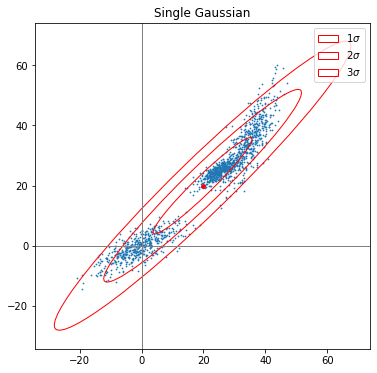

In [8]:
# single gaussian
num_cluster = 1
num_iteration = 50
mus, sigmas, r = GMM(data, num_cluster, num_iteration)
plot_2d_gmm(mus, sigmas, num_cluster)

shape of sigma =  (2, 2)
shape of sigma =  (2, 2)
shape of sigma =  (2, 2)
###### Intialization ######
Initial means
 [array([-2.417519  , -0.97492672]), array([31.13446406, 25.12526955]), array([23.48643123, 26.17216723])]
Initial sigmas
 [array([[744.5802897 , 709.71153193],
       [709.71153193, 693.97777057]]), array([[385.48083483, 306.11264848],
       [306.11264848, 283.35910515]]), array([[269.22177718, 270.41969789],
       [270.41969789, 295.30912428]])]
Initial phis
 [0.33333333 0.33333333 0.33333333]
Training in progress...(3 clusters)
Training done!!!

###### RESULT ######
Total iteration:  50
Number of clusters:  3
Final means
 [array([-0.97480974, -0.47629593]), array([25.05589376, 24.84141219]), array([35.01574267, 35.42400365])]
Final sigmas
 [array([[45.36338963, 22.23927885],
       [22.23927885, 18.24320375]]), array([[10.51548422,  6.13905063],
       [ 6.13905063,  5.84431121]]), array([[17.51625854, 25.94591368],
       [25.94591368, 63.78015919]])]
Final phis
 [

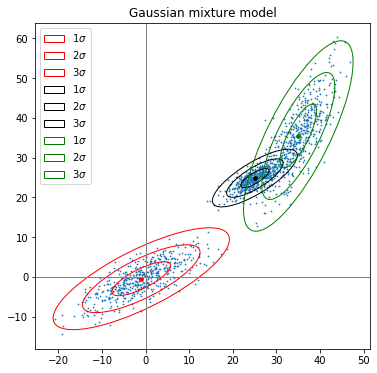

In [6]:
# GMM (3 clusters)
num_cluster = 3
num_iteration = 50
mus, sigmas, r = GMM(data, num_cluster, num_iteration)
plot_2d_gmm(mus, sigmas, num_cluster)

###### Intialization ######
Initial means
 [array([23.9817759 , 25.57643471]), array([42.35870406, 48.85833716]), array([23.40749113, 24.03501256])]
Initial sigmas
 [array([[273.20855041, 270.9611719 ],
       [270.9611719 , 288.24024472]]), array([[ 767.92935031,  901.82447957],
       [ 901.82447957, 1092.67726962]]), array([[268.63176318, 262.02543269],
       [262.02543269, 273.24420053]])]
Initial phis
 [0.33333333 0.33333333 0.33333333]
Training in progress...(3 clusters)
exp shape is 
[[0.14946278]]
exp shape is 
[[0.11636737]]
exp shape is 
[[0.20023333]]
exp shape is 
[[0.06491368]]
exp shape is 
[[0.18291661]]
exp shape is 
[[0.07100642]]
exp shape is 
[[0.70574032]]
exp shape is 
[[0.52024787]]
exp shape is 
[[0.81232748]]
exp shape is 
[[0.91755937]]
exp shape is 
[[0.66180918]]
exp shape is 
[[0.97750377]]
exp shape is 
[[0.18933601]]
exp shape is 
[[0.15963275]]
exp shape is 
[[0.19030193]]
exp shape is 
[[0.69352412]]
exp shape is 
[[0.94496816]]
exp shape is 
[[0.536277

exp shape is 
[[0.79856122]]
exp shape is 
[[0.58140675]]
exp shape is 
[[0.94555126]]
exp shape is 
[[0.4422406]]
exp shape is 
[[0.65483119]]
exp shape is 
[[0.52135154]]
exp shape is 
[[0.715752]]
exp shape is 
[[0.80551577]]
exp shape is 
[[0.84881567]]
exp shape is 
[[0.71887139]]
exp shape is 
[[0.34758324]]
exp shape is 
[[0.25869456]]
exp shape is 
[[0.42895951]]
exp shape is 
[[0.19512971]]
exp shape is 
[[0.14587103]]
exp shape is 
[[0.18693003]]
exp shape is 
[[0.99964219]]
exp shape is 
[[0.7751192]]
exp shape is 
[[0.9658539]]
exp shape is 
[[0.90404318]]
exp shape is 
[[0.66380316]]
exp shape is 
[[0.96547169]]
exp shape is 
[[0.77458189]]
exp shape is 
[[0.57715853]]
exp shape is 
[[0.85349499]]
exp shape is 
[[0.43681418]]
exp shape is 
[[0.37152408]]
exp shape is 
[[0.46702193]]
exp shape is 
[[0.64573508]]
exp shape is 
[[0.70097218]]
exp shape is 
[[0.6074932]]
exp shape is 
[[0.02606808]]
exp shape is 
[[0.36862769]]
exp shape is 
[[0.00801047]]
exp shape is 
[[0.39

exp shape is 
[[0.72174057]]
exp shape is 
[[0.26783725]]
exp shape is 
[[0.20711547]]
exp shape is 
[[0.34423884]]
exp shape is 
[[0.87818519]]
exp shape is 
[[0.63409346]]
exp shape is 
[[0.94831475]]
exp shape is 
[[0.79835356]]
exp shape is 
[[0.77650352]]
exp shape is 
[[0.75227418]]
exp shape is 
[[0.35382345]]
exp shape is 
[[0.38567616]]
exp shape is 
[[0.40658229]]
exp shape is 
[[0.02954107]]
exp shape is 
[[0.02209386]]
exp shape is 
[[0.02652391]]
exp shape is 
[[0.34616683]]
exp shape is 
[[0.9100662]]
exp shape is 
[[0.20379128]]
exp shape is 
[[0.39486697]]
exp shape is 
[[0.40005217]]
exp shape is 
[[0.46331776]]
exp shape is 
[[0.99685258]]
exp shape is 
[[0.75745285]]
exp shape is 
[[0.96673673]]
exp shape is 
[[0.56676364]]
exp shape is 
[[0.94364065]]
exp shape is 
[[0.39601128]]
exp shape is 
[[0.68264477]]
exp shape is 
[[0.51569336]]
exp shape is 
[[0.76337338]]
exp shape is 
[[0.92885244]]
exp shape is 
[[0.70096412]]
exp shape is 
[[0.86520581]]
exp shape is 
[

exp shape is 
[[0.23229855]]
exp shape is 
[[0.94163463]]
exp shape is 
[[0.74252899]]
exp shape is 
[[0.85833748]]
exp shape is 
[[0.47971014]]
exp shape is 
[[0.3485359]]
exp shape is 
[[0.47522512]]
exp shape is 
[[0.69511637]]
exp shape is 
[[0.50858439]]
exp shape is 
[[0.80097383]]
exp shape is 
[[0.34860266]]
exp shape is 
[[0.29547692]]
exp shape is 
[[0.36444638]]
exp shape is 
[[0.29483021]]
exp shape is 
[[0.21994085]]
exp shape is 
[[0.28817742]]
exp shape is 
[[0.38248653]]
exp shape is 
[[0.3913985]]
exp shape is 
[[0.43160879]]
exp shape is 
[[0.4647664]]
exp shape is 
[[0.35708493]]
exp shape is 
[[0.56764465]]
exp shape is 
[[0.6897191]]
exp shape is 
[[0.53743285]]
exp shape is 
[[0.75605379]]
exp shape is 
[[0.17951111]]
exp shape is 
[[0.17856642]]
exp shape is 
[[0.18750661]]
exp shape is 
[[0.70157675]]
exp shape is 
[[0.90386214]]
exp shape is 
[[0.57912135]]
exp shape is 
[[0.98431054]]
exp shape is 
[[0.72298041]]
exp shape is 
[[0.98386472]]
exp shape is 
[[0.

[[0.84840809]]
exp shape is 
[[0.67207297]]
exp shape is 
[[0.49140424]]
exp shape is 
[[0.77664424]]
exp shape is 
[[0.5410036]]
exp shape is 
[[0.40200364]]
exp shape is 
[[0.64818699]]
exp shape is 
[[0.66745913]]
exp shape is 
[[0.94716611]]
exp shape is 
[[0.50288885]]
exp shape is 
[[0.45496389]]
exp shape is 
[[0.92179863]]
exp shape is 
[[0.29243328]]
exp shape is 
[[0.45303662]]
exp shape is 
[[0.36028846]]
exp shape is 
[[0.47231209]]
exp shape is 
[[0.21898694]]
exp shape is 
[[0.27511]]
exp shape is 
[[0.24169371]]
exp shape is 
[[0.04969361]]
exp shape is 
[[0.1385005]]
exp shape is 
[[0.05859984]]
exp shape is 
[[0.49482109]]
exp shape is 
[[0.36574146]]
exp shape is 
[[0.59758639]]
exp shape is 
[[0.07520088]]
exp shape is 
[[0.06361561]]
exp shape is 
[[0.072866]]
exp shape is 
[[0.66717531]]
exp shape is 
[[0.4884138]]
exp shape is 
[[0.77344512]]
exp shape is 
[[0.102639]]
exp shape is 
[[0.0737317]]
exp shape is 
[[0.09335301]]
exp shape is 
[[0.33460854]]
exp shape 

exp shape is 
[[0.22034868]]
exp shape is 
[[0.22173072]]
exp shape is 
[[0.23344658]]
exp shape is 
[[0.15262854]]
exp shape is 
[[0.10542583]]
exp shape is 
[[0.13431694]]
exp shape is 
[[0.66400276]]
exp shape is 
[[0.88281994]]
exp shape is 
[[0.5513229]]
exp shape is 
[[0.78330454]]
exp shape is 
[[0.87735543]]
exp shape is 
[[0.61973447]]
exp shape is 
[[0.26160008]]
exp shape is 
[[0.97097213]]
exp shape is 
[[0.14492688]]
exp shape is 
[[0.06103523]]
exp shape is 
[[0.77609092]]
exp shape is 
[[0.0226067]]
exp shape is 
[[0.94482813]]
exp shape is 
[[0.77962302]]
exp shape is 
[[0.92316789]]
exp shape is 
[[0.9959647]]
exp shape is 
[[0.76333511]]
exp shape is 
[[0.98324641]]
exp shape is 
[[0.55220095]]
exp shape is 
[[0.47527263]]
exp shape is 
[[0.62703883]]
exp shape is 
[[0.99035081]]
exp shape is 
[[0.73438781]]
exp shape is 
[[0.97978172]]
exp shape is 
[[0.2519725]]
exp shape is 
[[0.19536693]]
exp shape is 
[[0.24909151]]
exp shape is 
[[0.65362298]]
exp shape is 
[[0.

[[0.64809147]]
exp shape is 
[[0.95704935]]
exp shape is 
[[0.29517934]]
exp shape is 
[[0.34117937]]
exp shape is 
[[0.33151068]]
exp shape is 
[[0.38510005]]
exp shape is 
[[0.39582943]]
exp shape is 
[[0.45186236]]
exp shape is 
[[0.06955232]]
exp shape is 
[[0.04746149]]
exp shape is 
[[0.05856624]]
exp shape is 
[[0.51785438]]
exp shape is 
[[0.38139148]]
exp shape is 
[[0.62069348]]
exp shape is 
[[0.39060555]]
exp shape is 
[[0.30362073]]
exp shape is 
[[0.4856984]]
exp shape is 
[[0.07897815]]
exp shape is 
[[0.2084784]]
exp shape is 
[[0.09058336]]
exp shape is 
[[0.25645925]]
exp shape is 
[[0.33179578]]
exp shape is 
[[0.29180965]]
exp shape is 
[[0.6346246]]
exp shape is 
[[0.60604339]]
exp shape is 
[[0.637913]]
exp shape is 
[[0.42836706]]
exp shape is 
[[0.99101611]]
exp shape is 
[[0.28404933]]
exp shape is 
[[0.76582935]]
exp shape is 
[[0.69181903]]
exp shape is 
[[0.76049087]]
exp shape is 
[[0.20506091]]
exp shape is 
[[0.15874782]]
exp shape is 
[[0.20041389]]
exp 

[[0.66512881]]
exp shape is 
[[0.79335903]]
exp shape is 
[[0.59059783]]
exp shape is 
[[0.73102558]]
exp shape is 
[[0.73613016]]
exp shape is 
[[0.69335245]]
exp shape is 
[[0.17674534]]
exp shape is 
[[0.12151041]]
exp shape is 
[[0.15118728]]
exp shape is 
[[0.37470125]]
exp shape is 
[[0.39267972]]
exp shape is 
[[0.43850839]]
exp shape is 
[[0.26984565]]
exp shape is 
[[0.25411525]]
exp shape is 
[[0.28543292]]
exp shape is 
[[0.41641698]]
exp shape is 
[[0.29971068]]
exp shape is 
[[0.4048109]]
exp shape is 
[[0.45969512]]
exp shape is 
[[0.36458122]]
exp shape is 
[[0.52906919]]
exp shape is 
[[0.00769585]]
exp shape is 
[[0.00515893]]
exp shape is 
[[0.00605594]]
exp shape is 
[[0.88322708]]
exp shape is 
[[0.65345836]]
exp shape is 
[[0.94620182]]
exp shape is 
[[0.07781443]]
exp shape is 
[[0.05492067]]
exp shape is 
[[0.06908969]]
exp shape is 
[[0.65740307]]
exp shape is 
[[0.48101336]]
exp shape is 
[[0.76249822]]
exp shape is 
[[0.36634162]]
exp shape is 
[[0.36477839]]


exp shape is 
[[0.97312185]]
exp shape is 
[[0.95354657]]
exp shape is 
[[0.68782395]]
exp shape is 
[[0.96172677]]
exp shape is 
[[0.08023649]]
exp shape is 
[[0.05663085]]
exp shape is 
[[0.07130854]]
exp shape is 
[[0.16092012]]
exp shape is 
[[0.25145782]]
exp shape is 
[[0.17880582]]
exp shape is 
[[0.67541747]]
exp shape is 
[[0.49377529]]
exp shape is 
[[0.77882015]]
exp shape is 
[[0.95226349]]
exp shape is 
[[0.69413017]]
exp shape is 
[[0.99546393]]
exp shape is 
[[0.85051494]]
exp shape is 
[[0.7684062]]
exp shape is 
[[0.8195283]]
exp shape is 
[[0.24691854]]
exp shape is 
[[0.25045708]]
exp shape is 
[[0.2640459]]
exp shape is 
[[0.69018246]]
exp shape is 
[[0.94529736]]
exp shape is 
[[0.53657776]]
exp shape is 
[[0.14500827]]
exp shape is 
[[0.1249487]]
exp shape is 
[[0.14488619]]
exp shape is 
[[0.61439465]]
exp shape is 
[[0.47868072]]
exp shape is 
[[0.68627988]]
exp shape is 
[[0.81554802]]
exp shape is 
[[0.59269023]]
exp shape is 
[[0.90594384]]
exp shape is 
[[0.

exp shape is 
[[0.16738593]]
exp shape is 
[[0.16503482]]
exp shape is 
[[0.20535985]]
exp shape is 
[[0.07120313]]
exp shape is 
[[0.17743477]]
exp shape is 
[[0.06455626]]
exp shape is 
[[0.80875261]]
exp shape is 
[[0.8022586]]
exp shape is 
[[0.87017777]]
exp shape is 
[[0.98507939]]
exp shape is 
[[0.97325252]]
exp shape is 
[[0.98483642]]
exp shape is 
[[0.27834992]]
exp shape is 
[[0.19455043]]
exp shape is 
[[0.25581093]]
exp shape is 
[[0.29688249]]
exp shape is 
[[0.70093381]]
exp shape is 
[[0.20218596]]
exp shape is 
[[0.39910849]]
exp shape is 
[[0.79732937]]
exp shape is 
[[0.28797528]]
exp shape is 
[[0.46508359]]
exp shape is 
[[0.40723449]]
exp shape is 
[[0.4522095]]
exp shape is 
[[0.95889065]]
exp shape is 
[[0.94152637]]
exp shape is 
[[0.97850419]]
exp shape is 
[[0.95291265]]
exp shape is 
[[0.97491439]]
exp shape is 
[[0.92158566]]
exp shape is 
[[0.31878082]]
exp shape is 
[[0.22515297]]
exp shape is 
[[0.2891047]]
exp shape is 
[[0.07576818]]
exp shape is 
[[0

[[0.45342719]]
exp shape is 
[[0.06644737]]
exp shape is 
[[0.26076334]]
exp shape is 
[[0.06405093]]
exp shape is 
[[0.80640576]]
exp shape is 
[[0.97012002]]
exp shape is 
[[0.70759955]]
exp shape is 
[[0.29216692]]
exp shape is 
[[0.2580529]]
exp shape is 
[[0.27862348]]
exp shape is 
[[0.00508392]]
exp shape is 
[[0.06924844]]
exp shape is 
[[0.00515584]]
exp shape is 
[[0.51639351]]
exp shape is 
[[0.4194311]]
exp shape is 
[[0.49125944]]
exp shape is 
[[0.93658913]]
exp shape is 
[[0.91825892]]
exp shape is 
[[0.96534184]]
exp shape is 
[[0.85582082]]
exp shape is 
[[0.8355175]]
exp shape is 
[[0.87348388]]
exp shape is 
[[0.02893402]]
exp shape is 
[[0.18706803]]
exp shape is 
[[0.02947881]]
exp shape is 
[[0.31041111]]
exp shape is 
[[0.3962951]]
exp shape is 
[[0.30868667]]
exp shape is 
[[0.42516955]]
exp shape is 
[[0.55631587]]
exp shape is 
[[0.3554542]]
exp shape is 
[[0.09253472]]
exp shape is 
[[0.31945057]]
exp shape is 
[[0.09641086]]
exp shape is 
[[0.70715901]]
exp 

exp shape is 
[[0.53324799]]
exp shape is 
[[0.59974481]]
exp shape is 
[[0.34708713]]
exp shape is 
[[0.48764705]]
exp shape is 
[[0.35466797]]
exp shape is 
[[0.76798276]]
exp shape is 
[[0.74520558]]
exp shape is 
[[0.77906528]]
exp shape is 
[[0.98591369]]
exp shape is 
[[0.98443719]]
exp shape is 
[[0.9706674]]
exp shape is 
[[0.16783479]]
exp shape is 
[[0.21529971]]
exp shape is 
[[0.20609241]]
exp shape is 
[[0.36143479]]
exp shape is 
[[0.401253]]
exp shape is 
[[0.35803866]]
exp shape is 
[[0.88011001]]
exp shape is 
[[0.96202579]]
exp shape is 
[[0.81544568]]
exp shape is 
[[0.32020768]]
exp shape is 
[[0.52325259]]
exp shape is 
[[0.33572011]]
exp shape is 
[[0.51255251]]
exp shape is 
[[0.86497062]]
exp shape is 
[[0.39097345]]
exp shape is 
[[0.93604301]]
exp shape is 
[[0.92445332]]
exp shape is 
[[0.94324632]]
exp shape is 
[[0.1150541]]
exp shape is 
[[0.17918004]]
exp shape is 
[[0.14224733]]
exp shape is 
[[0.38931165]]
exp shape is 
[[0.29038339]]
exp shape is 
[[0.

exp shape is 
[[0.36569924]]
exp shape is 
[[0.32600354]]
exp shape is 
[[0.41745259]]
exp shape is 
[[0.32158978]]
exp shape is 
[[0.38891685]]
exp shape is 
[[0.31873047]]
exp shape is 
[[0.49028248]]
exp shape is 
[[0.44166846]]
exp shape is 
[[0.50692432]]
exp shape is 
[[0.57308555]]
exp shape is 
[[0.4717787]]
exp shape is 
[[0.53413149]]
exp shape is 
[[0.31677744]]
exp shape is 
[[0.46450877]]
exp shape is 
[[0.25022118]]
exp shape is 
[[0.40033352]]
exp shape is 
[[0.80557222]]
exp shape is 
[[0.28748762]]
exp shape is 
[[0.96316338]]
exp shape is 
[[0.98058383]]
exp shape is 
[[0.93403429]]
exp shape is 
[[0.41554819]]
exp shape is 
[[0.36759327]]
exp shape is 
[[0.46461804]]
exp shape is 
[[0.21188948]]
exp shape is 
[[0.13664556]]
exp shape is 
[[0.18617064]]
exp shape is 
[[0.84766003]]
exp shape is 
[[0.83904484]]
exp shape is 
[[0.84808498]]
exp shape is 
[[0.38328534]]
exp shape is 
[[0.34163345]]
exp shape is 
[[0.37084376]]
exp shape is 
[[0.08938244]]
exp shape is 
[

[[0.00540409]]
exp shape is 
[[0.50977133]]
exp shape is 
[[0.50548378]]
exp shape is 
[[0.5794054]]
exp shape is 
[[0.25858611]]
exp shape is 
[[0.64046174]]
exp shape is 
[[0.17277777]]
exp shape is 
[[0.30953823]]
exp shape is 
[[0.38879841]]
exp shape is 
[[0.30711765]]
exp shape is 
[[0.19665905]]
exp shape is 
[[0.12798028]]
exp shape is 
[[0.16993047]]
exp shape is 
[[0.20289085]]
exp shape is 
[[0.12806914]]
exp shape is 
[[0.180551]]
exp shape is 
[[0.16015667]]
exp shape is 
[[0.43180311]]
exp shape is 
[[0.10194319]]
exp shape is 
[[0.95645161]]
exp shape is 
[[0.95350237]]
exp shape is 
[[0.90632805]]
exp shape is 
[[0.67312733]]
exp shape is 
[[0.74990497]]
exp shape is 
[[0.71054602]]
exp shape is 
[[0.78641862]]
exp shape is 
[[0.75664034]]
exp shape is 
[[0.81374037]]
exp shape is 
[[0.40919814]]
exp shape is 
[[0.50074901]]
exp shape is 
[[0.35041644]]
exp shape is 
[[0.59472104]]
exp shape is 
[[0.49991331]]
exp shape is 
[[0.57057371]]
exp shape is 
[[0.53740928]]
ex

[[0.55228425]]
exp shape is 
[[0.14549619]]
exp shape is 
[[0.00565139]]
exp shape is 
[[0.06229513]]
exp shape is 
[[0.00600361]]
exp shape is 
[[0.56392135]]
exp shape is 
[[0.64252358]]
exp shape is 
[[0.50667353]]
exp shape is 
[[0.25944138]]
exp shape is 
[[0.42837301]]
exp shape is 
[[0.2626931]]
exp shape is 
[[0.4745919]]
exp shape is 
[[0.62911274]]
exp shape is 
[[0.39695833]]
exp shape is 
[[0.48969396]]
exp shape is 
[[0.69545903]]
exp shape is 
[[0.39966664]]
exp shape is 
[[0.88461172]]
exp shape is 
[[0.94588155]]
exp shape is 
[[0.83190037]]
exp shape is 
[[0.11376531]]
exp shape is 
[[0.08269917]]
exp shape is 
[[0.09058123]]
exp shape is 
[[0.75216475]]
exp shape is 
[[0.89198388]]
exp shape is 
[[0.66890431]]
exp shape is 
[[0.00742839]]
exp shape is 
[[0.21375217]]
exp shape is 
[[0.00245968]]
exp shape is 
[[0.89977471]]
exp shape is 
[[0.99029192]]
exp shape is 
[[0.8255677]]
exp shape is 
[[0.90274384]]
exp shape is 
[[0.9938013]]
exp shape is 
[[0.82241081]]
exp

[[0.42663686]]
exp shape is 
[[0.50396067]]
exp shape is 
[[0.66892584]]
exp shape is 
[[0.65118136]]
exp shape is 
[[0.73482134]]
exp shape is 
[[0.96377781]]
exp shape is 
[[0.94581477]]
exp shape is 
[[0.98573268]]
exp shape is 
[[0.85962195]]
exp shape is 
[[0.98563089]]
exp shape is 
[[0.76678125]]
exp shape is 
[[0.06047011]]
exp shape is 
[[0.39724959]]
exp shape is 
[[0.02974592]]
exp shape is 
[[0.05161304]]
exp shape is 
[[0.11331256]]
exp shape is 
[[0.06410511]]
exp shape is 
[[0.45406364]]
exp shape is 
[[0.44245002]]
exp shape is 
[[0.44904895]]
exp shape is 
[[0.81586845]]
exp shape is 
[[0.95678676]]
exp shape is 
[[0.71277568]]
exp shape is 
[[0.3243593]]
exp shape is 
[[0.47025384]]
exp shape is 
[[0.33048012]]
exp shape is 
[[0.16084112]]
exp shape is 
[[0.58814808]]
exp shape is 
[[0.09526115]]
exp shape is 
[[0.62721402]]
exp shape is 
[[0.62934103]]
exp shape is 
[[0.69957382]]
exp shape is 
[[0.46461269]]
exp shape is 
[[0.40165028]]
exp shape is 
[[0.45059012]]


exp shape is 
[[0.41756654]]
exp shape is 
[[0.71362634]]
exp shape is 
[[0.31769887]]
exp shape is 
[[0.88751983]]
exp shape is 
[[0.98920676]]
exp shape is 
[[0.80832194]]
exp shape is 
[[0.25287207]]
exp shape is 
[[0.16856694]]
exp shape is 
[[0.22746721]]
exp shape is 
[[0.31411186]]
exp shape is 
[[0.42395774]]
exp shape is 
[[0.31509124]]
exp shape is 
[[0.82100479]]
exp shape is 
[[0.85311519]]
exp shape is 
[[0.78791758]]
exp shape is 
[[0.62859603]]
exp shape is 
[[0.64125376]]
exp shape is 
[[0.70255712]]
exp shape is 
[[0.55526189]]
exp shape is 
[[0.51239327]]
exp shape is 
[[0.60909474]]
exp shape is 
[[0.27388717]]
exp shape is 
[[0.19543255]]
exp shape is 
[[0.25325163]]
exp shape is 
[[0.91887342]]
exp shape is 
[[0.94457186]]
exp shape is 
[[0.88830273]]
exp shape is 
[[0.43272423]]
exp shape is 
[[0.46032856]]
exp shape is 
[[0.50182399]]
exp shape is 
[[0.90021637]]
exp shape is 
[[0.89739732]]
exp shape is 
[[0.89601017]]
exp shape is 
[[0.63864081]]
exp shape is 


exp shape is 
[[0.0396045]]
exp shape is 
[[0.83606981]]
exp shape is 
[[0.97507085]]
exp shape is 
[[0.74526751]]
exp shape is 
[[0.87035759]]
exp shape is 
[[0.84814704]]
exp shape is 
[[0.90916689]]
exp shape is 
[[0.97833248]]
exp shape is 
[[0.98615785]]
exp shape is 
[[0.95485579]]
exp shape is 
[[0.90556539]]
exp shape is 
[[0.89108143]]
exp shape is 
[[0.91711272]]
exp shape is 
[[0.27871575]]
exp shape is 
[[0.72000167]]
exp shape is 
[[0.18455017]]
exp shape is 
[[0.66595179]]
exp shape is 
[[0.86919829]]
exp shape is 
[[0.54937485]]
exp shape is 
[[0.92420314]]
exp shape is 
[[0.91333844]]
exp shape is 
[[0.93036888]]
exp shape is 
[[0.45819278]]
exp shape is 
[[0.4600821]]
exp shape is 
[[0.43303322]]
exp shape is 
[[0.01737117]]
exp shape is 
[[0.01510436]]
exp shape is 
[[0.01186632]]
exp shape is 
[[0.97256598]]
exp shape is 
[[0.99422314]]
exp shape is 
[[0.93560344]]
exp shape is 
[[0.73063077]]
exp shape is 
[[0.72142008]]
exp shape is 
[[0.72448995]]
exp shape is 
[[

[[0.59760499]]
exp shape is 
[[0.61126956]]
exp shape is 
[[0.67167019]]
exp shape is 
[[0.58158607]]
exp shape is 
[[0.53441578]]
exp shape is 
[[0.60782844]]
exp shape is 
[[0.95247057]]
exp shape is 
[[0.95082973]]
exp shape is 
[[0.94504544]]
exp shape is 
[[0.14713778]]
exp shape is 
[[0.53917767]]
exp shape is 
[[0.08660533]]
exp shape is 
[[0.44709611]]
exp shape is 
[[0.62010325]]
exp shape is 
[[0.47549132]]
exp shape is 
[[0.93608667]]
exp shape is 
[[0.93829623]]
exp shape is 
[[0.92563544]]
exp shape is 
[[0.42350148]]
exp shape is 
[[0.40889511]]
exp shape is 
[[0.40680807]]
exp shape is 
[[0.46670436]]
exp shape is 
[[0.51059085]]
exp shape is 
[[0.53823041]]
exp shape is 
[[0.08867349]]
exp shape is 
[[0.30175672]]
exp shape is 
[[0.09562349]]
exp shape is 
[[0.09463255]]
exp shape is 
[[0.3226749]]
exp shape is 
[[0.0985371]]
exp shape is 
[[0.46185398]]
exp shape is 
[[0.40633624]]
exp shape is 
[[0.49450518]]
exp shape is 
[[0.96089537]]
exp shape is 
[[0.96141712]]
e

[[0.92707376]]
exp shape is 
[[0.91113179]]
exp shape is 
[[0.81934156]]
exp shape is 
[[0.83328733]]
exp shape is 
[[0.85836335]]
exp shape is 
[[0.08899615]]
exp shape is 
[[0.3639097]]
exp shape is 
[[0.09746863]]
exp shape is 
[[0.32976153]]
exp shape is 
[[0.31466952]]
exp shape is 
[[0.37971584]]
exp shape is 
[[0.04113462]]
exp shape is 
[[0.52003492]]
exp shape is 
[[0.01994391]]
exp shape is 
[[0.26574287]]
exp shape is 
[[0.20539739]]
exp shape is 
[[0.28950462]]
exp shape is 
[[0.54079838]]
exp shape is 
[[0.6869752]]
exp shape is 
[[0.60958727]]
exp shape is 
[[0.13506391]]
exp shape is 
[[0.15346057]]
exp shape is 
[[0.12470664]]
exp shape is 
[[0.88370655]]
exp shape is 
[[0.92378291]]
exp shape is 
[[0.87327982]]
exp shape is 
[[0.75066128]]
exp shape is 
[[0.76890321]]
exp shape is 
[[0.75627252]]
exp shape is 
[[0.01165252]]
exp shape is 
[[0.07206128]]
exp shape is 
[[0.01451875]]
exp shape is 
[[0.54690898]]
exp shape is 
[[0.52293774]]
exp shape is 
[[0.5868842]]
ex

[[0.89099876]]
exp shape is 
[[0.99209604]]
exp shape is 
[[0.8166223]]
exp shape is 
[[0.88992992]]
exp shape is 
[[0.90258028]]
exp shape is 
[[0.91533849]]
exp shape is 
[[0.64084473]]
exp shape is 
[[0.77650837]]
exp shape is 
[[0.58015148]]
exp shape is 
[[0.27257426]]
exp shape is 
[[0.08856697]]
exp shape is 
[[0.2418224]]
exp shape is 
[[0.80045309]]
exp shape is 
[[0.95279256]]
exp shape is 
[[0.7038835]]
exp shape is 
[[0.55334183]]
exp shape is 
[[0.31796587]]
exp shape is 
[[0.53756614]]
exp shape is 
[[0.69220393]]
exp shape is 
[[0.71964262]]
exp shape is 
[[0.68189617]]
exp shape is 
[[0.47143216]]
exp shape is 
[[0.90588103]]
exp shape is 
[[0.36354087]]
exp shape is 
[[0.48131773]]
exp shape is 
[[0.3548271]]
exp shape is 
[[0.47760443]]
exp shape is 
[[0.91575334]]
exp shape is 
[[0.99841842]]
exp shape is 
[[0.86055343]]
exp shape is 
[[0.44715188]]
exp shape is 
[[0.47133134]]
exp shape is 
[[0.50977549]]
exp shape is 
[[0.84036273]]
exp shape is 
[[0.88165605]]
exp

[[0.00317588]]
exp shape is 
[[0.01630447]]
exp shape is 
[[0.79894815]]
exp shape is 
[[0.96305914]]
exp shape is 
[[0.70216618]]
exp shape is 
[[0.78006461]]
exp shape is 
[[0.7970908]]
exp shape is 
[[0.82876732]]
exp shape is 
[[0.68244775]]
exp shape is 
[[0.71092006]]
exp shape is 
[[0.7443692]]
exp shape is 
[[0.29099979]]
exp shape is 
[[0.33207873]]
exp shape is 
[[0.34508306]]
exp shape is 
[[0.98391143]]
exp shape is 
[[0.95414812]]
exp shape is 
[[0.99621013]]
exp shape is 
[[0.49463103]]
exp shape is 
[[0.74334391]]
exp shape is 
[[0.40966442]]
exp shape is 
[[0.43577392]]
exp shape is 
[[0.53091385]]
exp shape is 
[[0.45381924]]
exp shape is 
[[0.04981087]]
exp shape is 
[[0.00603795]]
exp shape is 
[[0.04113949]]
exp shape is 
[[0.04551085]]
exp shape is 
[[0.54063391]]
exp shape is 
[[0.02214936]]
exp shape is 
[[0.46736871]]
exp shape is 
[[0.63808097]]
exp shape is 
[[0.50285824]]
exp shape is 
[[0.86005853]]
exp shape is 
[[0.99117367]]
exp shape is 
[[0.77742615]]
e

exp shape is 
[[0.98377564]]
exp shape is 
[[0.9562529]]
exp shape is 
[[0.68908654]]
exp shape is 
[[0.69640859]]
exp shape is 
[[0.69605028]]
exp shape is 
[[0.01929038]]
exp shape is 
[[0.43839619]]
exp shape is 
[[0.0081862]]
exp shape is 
[[0.39197822]]
exp shape is 
[[0.35870533]]
exp shape is 
[[0.43722217]]
exp shape is 
[[0.26980616]]
exp shape is 
[[0.08301445]]
exp shape is 
[[0.24158878]]
exp shape is 
[[0.04005078]]
exp shape is 
[[0.50570584]]
exp shape is 
[[0.01897574]]
exp shape is 
[[0.81801751]]
exp shape is 
[[0.88570537]]
exp shape is 
[[0.79014828]]
exp shape is 
[[0.91448208]]
exp shape is 
[[0.96847211]]
exp shape is 
[[0.88700795]]
exp shape is 
[[0.16058763]]
exp shape is 
[[0.14593547]]
exp shape is 
[[0.19444197]]
exp shape is 
[[0.18192955]]
exp shape is 
[[0.68617293]]
exp shape is 
[[0.11523442]]
exp shape is 
[[0.09731993]]
exp shape is 
[[0.58403511]]
exp shape is 
[[0.05448044]]
exp shape is 
[[0.47688063]]
exp shape is 
[[0.44322872]]
exp shape is 
[[

[[0.55794823]]
exp shape is 
[[0.60500943]]
exp shape is 
[[0.13221065]]
exp shape is 
[[0.02467095]]
exp shape is 
[[0.11554834]]
exp shape is 
[[0.73369152]]
exp shape is 
[[0.75276929]]
exp shape is 
[[0.78809509]]
exp shape is 
[[0.14905667]]
exp shape is 
[[0.03632255]]
exp shape is 
[[0.12737641]]
exp shape is 
[[0.47499712]]
exp shape is 
[[0.33881216]]
exp shape is 
[[0.46967832]]
exp shape is 
[[0.93026729]]
exp shape is 
[[0.99830406]]
exp shape is 
[[0.87501058]]
exp shape is 
[[0.39545943]]
exp shape is 
[[0.40637648]]
exp shape is 
[[0.45391347]]
exp shape is 
[[0.37029756]]
exp shape is 
[[0.13937953]]
exp shape is 
[[0.34002259]]
exp shape is 
[[0.01932212]]
exp shape is 
[[0.16708162]]
exp shape is 
[[0.01702569]]
exp shape is 
[[0.84711774]]
exp shape is 
[[0.99759708]]
exp shape is 
[[0.76496641]]
exp shape is 
[[0.2113937]]
exp shape is 
[[0.40920592]]
exp shape is 
[[0.21616588]]
exp shape is 
[[0.34428361]]
exp shape is 
[[0.12471834]]
exp shape is 
[[0.31797256]]


exp shape is 
[[0.70171873]]
exp shape is 
[[0.69270466]]
exp shape is 
[[0.29446178]]
exp shape is 
[[0.11622752]]
exp shape is 
[[0.25671962]]
exp shape is 
[[0.34333703]]
exp shape is 
[[0.16194053]]
exp shape is 
[[0.32515136]]
exp shape is 
[[0.1874222]]
exp shape is 
[[0.06516621]]
exp shape is 
[[0.15779907]]
exp shape is 
[[0.2653748]]
exp shape is 
[[0.65440041]]
exp shape is 
[[0.1866582]]
exp shape is 
[[0.33463823]]
exp shape is 
[[0.85332587]]
exp shape is 
[[0.23764665]]
exp shape is 
[[0.02450434]]
exp shape is 
[[0.43878032]]
exp shape is 
[[0.01064482]]
exp shape is 
[[0.00112688]]
exp shape is 
[[0.20997489]]
exp shape is 
[[0.00029855]]
exp shape is 
[[0.72568278]]
exp shape is 
[[0.92666502]]
exp shape is 
[[0.64491489]]
exp shape is 
[[0.85919407]]
exp shape is 
[[0.99710221]]
exp shape is 
[[0.78583187]]
exp shape is 
[[0.7019111]]
exp shape is 
[[0.71309694]]
exp shape is 
[[0.73917876]]
exp shape is 
[[0.91233332]]
exp shape is 
[[0.98901803]]
exp shape is 
[[0.

exp shape is 
[[0.53189024]]
exp shape is 
[[0.81046889]]
exp shape is 
[[0.44066533]]
exp shape is 
[[0.90686189]]
exp shape is 
[[0.93257181]]
exp shape is 
[[0.90741697]]
exp shape is 
[[0.38629992]]
exp shape is 
[[0.38008074]]
exp shape is 
[[0.38779775]]
exp shape is 
[[0.45430895]]
exp shape is 
[[0.62830686]]
exp shape is 
[[0.48818375]]
exp shape is 
[[0.08451239]]
exp shape is 
[[0.02182054]]
exp shape is 
[[0.06832283]]
exp shape is 
[[0.56415613]]
exp shape is 
[[0.57016915]]
exp shape is 
[[0.62244654]]
exp shape is 
[[0.43536763]]
exp shape is 
[[0.51578554]]
exp shape is 
[[0.50231838]]
exp shape is 
[[0.05615701]]
exp shape is 
[[0.27129673]]
exp shape is 
[[0.05442629]]
exp shape is 
[[0.31182725]]
exp shape is 
[[0.38898201]]
exp shape is 
[[0.31463363]]
exp shape is 
[[0.43208606]]
exp shape is 
[[0.53268964]]
exp shape is 
[[0.37612158]]
exp shape is 
[[0.07802508]]
exp shape is 
[[0.54715503]]
exp shape is 
[[0.04190556]]
exp shape is 
[[0.54137433]]
exp shape is 


[[0.94554329]]
exp shape is 
[[0.92602317]]
exp shape is 
[[0.87263855]]
exp shape is 
[[0.88544696]]
exp shape is 
[[0.90709437]]
exp shape is 
[[0.3201563]]
exp shape is 
[[0.60705082]]
exp shape is 
[[0.24163738]]
exp shape is 
[[0.44265451]]
exp shape is 
[[0.65718179]]
exp shape is 
[[0.36487635]]
exp shape is 
[[0.19215586]]
exp shape is 
[[0.0825732]]
exp shape is 
[[0.15862545]]
exp shape is 
[[0.442922]]
exp shape is 
[[0.61124103]]
exp shape is 
[[0.47362233]]
exp shape is 
[[0.41179095]]
exp shape is 
[[0.20679492]]
exp shape is 
[[0.39385682]]
exp shape is 
[[0.54172161]]
exp shape is 
[[0.28362811]]
exp shape is 
[[0.49797253]]
exp shape is 
[[0.42564585]]
exp shape is 
[[0.38179463]]
exp shape is 
[[0.43372513]]
exp shape is 
[[0.00992515]]
exp shape is 
[[0.00103548]]
exp shape is 
[[0.00747449]]
exp shape is 
[[0.86748419]]
exp shape is 
[[0.90792253]]
exp shape is 
[[0.85802335]]
exp shape is 
[[0.11023551]]
exp shape is 
[[0.02449182]]
exp shape is 
[[0.09236242]]
exp

[[0.21992788]]
exp shape is 
[[0.09564084]]
exp shape is 
[[0.18366856]]
exp shape is 
[[0.90889355]]
exp shape is 
[[0.98282716]]
exp shape is 
[[0.83822372]]
exp shape is 
[[0.96389806]]
exp shape is 
[[0.95267392]]
exp shape is 
[[0.91427221]]
exp shape is 
[[0.11343882]]
exp shape is 
[[0.0255889]]
exp shape is 
[[0.09515476]]
exp shape is 
[[0.2032096]]
exp shape is 
[[0.20795174]]
exp shape is 
[[0.19365103]]
exp shape is 
[[0.72937737]]
exp shape is 
[[0.73996079]]
exp shape is 
[[0.7771812]]
exp shape is 
[[0.95620381]]
exp shape is 
[[0.98634444]]
exp shape is 
[[0.93192639]]
exp shape is 
[[0.58125012]]
exp shape is 
[[0.80382173]]
exp shape is 
[[0.49878584]]
exp shape is 
[[0.37497093]]
exp shape is 
[[0.20001282]]
exp shape is 
[[0.35909792]]
exp shape is 
[[0.24221419]]
exp shape is 
[[0.75478349]]
exp shape is 
[[0.16221102]]
exp shape is 
[[0.2407175]]
exp shape is 
[[0.06795101]]
exp shape is 
[[0.21798042]]
exp shape is 
[[0.56898723]]
exp shape is 
[[0.5581869]]
exp 

exp shape is 
[[0.1461933]]
exp shape is 
[[0.16676471]]
exp shape is 
[[0.18079197]]
exp shape is 
[[0.0541026]]
exp shape is 
[[0.04150089]]
exp shape is 
[[0.04811136]]
exp shape is 
[[0.78870974]]
exp shape is 
[[0.87741845]]
exp shape is 
[[0.84554645]]
exp shape is 
[[0.97426657]]
exp shape is 
[[0.94919934]]
exp shape is 
[[0.97079527]]
exp shape is 
[[0.3301439]]
exp shape is 
[[0.0242995]]
exp shape is 
[[0.30481726]]
exp shape is 
[[0.19685016]]
exp shape is 
[[0.8106917]]
exp shape is 
[[0.13314812]]
exp shape is 
[[0.28492362]]
exp shape is 
[[0.87745194]]
exp shape is 
[[0.20519941]]
exp shape is 
[[0.51124107]]
exp shape is 
[[0.11044978]]
exp shape is 
[[0.49601413]]
exp shape is 
[[0.94875591]]
exp shape is 
[[0.95162068]]
exp shape is 
[[0.96442574]]
exp shape is 
[[0.92273926]]
exp shape is 
[[0.98772154]]
exp shape is 
[[0.8886659]]
exp shape is 
[[0.37015154]]
exp shape is 
[[0.03299245]]
exp shape is 
[[0.33910724]]
exp shape is 
[[0.03314151]]
exp shape is 
[[0.58

[[0.43384396]]
exp shape is 
[[0.06744351]]
exp shape is 
[[0.454036]]
exp shape is 
[[0.42797387]]
exp shape is 
[[0.48153623]]
exp shape is 
[[0.22987483]]
exp shape is 
[[0.09960766]]
exp shape is 
[[0.22258671]]
exp shape is 
[[0.87411662]]
exp shape is 
[[0.99656869]]
exp shape is 
[[0.82145665]]
exp shape is 
[[0.85097587]]
exp shape is 
[[0.91755134]]
exp shape is 
[[0.88766957]]
exp shape is 
[[0.3793688]]
exp shape is 
[[0.52767493]]
exp shape is 
[[0.32418777]]
exp shape is 
[[0.43253603]]
exp shape is 
[[0.05889493]]
exp shape is 
[[0.4106745]]
exp shape is 
[[0.51699786]]
exp shape is 
[[0.81285291]]
exp shape is 
[[0.44272777]]
exp shape is 
[[0.00487518]]
exp shape is 
[[0.40530007]]
exp shape is 
[[0.00189696]]
exp shape is 
[[0.12805925]]
exp shape is 
[[0.00213544]]
exp shape is 
[[0.1121547]]
exp shape is 
[[0.63154284]]
exp shape is 
[[0.75573379]]
exp shape is 
[[0.69796354]]
exp shape is 
[[0.88987687]]
exp shape is 
[[0.98906514]]
exp shape is 
[[0.83680948]]
exp 

[[0.74239056]]
exp shape is 
[[0.9946562]]
exp shape is 
[[0.6656672]]
exp shape is 
[[0.56815047]]
exp shape is 
[[0.65852783]]
exp shape is 
[[0.53931269]]
exp shape is 
[[0.29195575]]
exp shape is 
[[0.02094231]]
exp shape is 
[[0.26065932]]
exp shape is 
[[0.35678885]]
exp shape is 
[[0.43623936]]
exp shape is 
[[0.41519679]]
exp shape is 
[[0.58106241]]
exp shape is 
[[0.64596579]]
exp shape is 
[[0.56438466]]
exp shape is 
[[0.4001503]]
exp shape is 
[[0.09253967]]
exp shape is 
[[0.3883725]]
exp shape is 
[[0.33116654]]
exp shape is 
[[0.29439301]]
exp shape is 
[[0.31460699]]
exp shape is 
[[0.85694668]]
exp shape is 
[[0.93126173]]
exp shape is 
[[0.87376748]]
exp shape is 
[[0.58224761]]
exp shape is 
[[0.63162342]]
exp shape is 
[[0.63115477]]
exp shape is 
[[0.55020964]]
exp shape is 
[[0.68935573]]
exp shape is 
[[0.45315111]]
exp shape is 
[[0.4631065]]
exp shape is 
[[0.10272823]]
exp shape is 
[[0.44997582]]
exp shape is 
[[0.42389484]]
exp shape is 
[[0.17862926]]
exp 

[[0.82149782]]
exp shape is 
[[0.9225972]]
exp shape is 
[[0.81590153]]
exp shape is 
[[0.42175136]]
exp shape is 
[[0.07862986]]
exp shape is 
[[0.40632765]]
exp shape is 
[[0.04571448]]
exp shape is 
[[0.44053186]]
exp shape is 
[[0.02458132]]
exp shape is 
[[0.34094137]]
exp shape is 
[[0.06310238]]
exp shape is 
[[0.32661135]]
exp shape is 
[[0.47678565]]
exp shape is 
[[0.07700907]]
exp shape is 
[[0.45575853]]
exp shape is 
[[0.65045902]]
exp shape is 
[[0.72439841]]
exp shape is 
[[0.64351791]]
exp shape is 
[[0.2087284]]
exp shape is 
[[0.4163116]]
exp shape is 
[[0.2520761]]
exp shape is 
[[0.73899171]]
exp shape is 
[[0.81176603]]
exp shape is 
[[0.76829871]]
exp shape is 
[[0.30362526]]
exp shape is 
[[0.31327492]]
exp shape is 
[[0.31393018]]
exp shape is 
[[0.82729848]]
exp shape is 
[[0.97456366]]
exp shape is 
[[0.78879693]]
exp shape is 
[[0.55899734]]
exp shape is 
[[0.10244762]]
exp shape is 
[[0.52385327]]
exp shape is 
[[0.58639686]]
exp shape is 
[[0.86567089]]
exp

exp shape is 
[[0.96118202]]
exp shape is 
[[0.85804842]]
exp shape is 
[[0.14376387]]
exp shape is 
[[0.67622798]]
exp shape is 
[[0.09300691]]
exp shape is 
[[0.72868692]]
exp shape is 
[[0.80832581]]
exp shape is 
[[0.77401555]]
exp shape is 
[[0.26076256]]
exp shape is 
[[0.01301626]]
exp shape is 
[[0.23777483]]
exp shape is 
[[0.8356658]]
exp shape is 
[[0.92944131]]
exp shape is 
[[0.83485786]]
exp shape is 
[[0.65612276]]
exp shape is 
[[0.16589796]]
exp shape is 
[[0.61857067]]
exp shape is 
[[0.86609828]]
exp shape is 
[[0.93548066]]
exp shape is 
[[0.88581559]]
exp shape is 
[[0.17501568]]
exp shape is 
[[0.41586178]]
exp shape is 
[[0.18762667]]
exp shape is 
[[0.00479492]]
exp shape is 
[[0.08542996]]
exp shape is 
[[0.00602027]]
exp shape is 
[[0.80221898]]
exp shape is 
[[0.88432132]]
exp shape is 
[[0.81886881]]
exp shape is 
[[0.36741096]]
exp shape is 
[[0.56303439]]
exp shape is 
[[0.42914126]]
exp shape is 
[[0.0124789]]
exp shape is 
[[0.00022504]]
exp shape is 
[[

[[0.95032752]]
exp shape is 
[[0.85558961]]
exp shape is 
[[0.35108647]]
exp shape is 
[[0.22915671]]
exp shape is 
[[0.35537839]]
exp shape is 
[[0.89754086]]
exp shape is 
[[0.98526223]]
exp shape is 
[[0.84545693]]
exp shape is 
[[0.19677844]]
exp shape is 
[[0.38277065]]
exp shape is 
[[0.20817018]]
exp shape is 
[[0.74428366]]
exp shape is 
[[0.81840488]]
exp shape is 
[[0.76770787]]
exp shape is 
[[0.8949189]]
exp shape is 
[[0.99142539]]
exp shape is 
[[0.84602059]]
exp shape is 
[[0.70113105]]
exp shape is 
[[0.90673099]]
exp shape is 
[[0.60517837]]
exp shape is 
[[0.44022656]]
exp shape is 
[[0.91657204]]
exp shape is 
[[0.3494002]]
exp shape is 
[[0.25761095]]
exp shape is 
[[0.01319852]]
exp shape is 
[[0.23119013]]
exp shape is 
[[0.03791938]]
exp shape is 
[[0.16646322]]
exp shape is 
[[0.03641272]]
exp shape is 
[[0.00080017]]
exp shape is 
[[0.04887897]]
exp shape is 
[[0.00096644]]
exp shape is 
[[0.77636591]]
exp shape is 
[[0.85892825]]
exp shape is 
[[0.82209475]]
e

[[0.79207155]]
exp shape is 
[[0.92286216]]
exp shape is 
[[0.70628388]]
exp shape is 
[[0.02571785]]
exp shape is 
[[0.50178845]]
exp shape is 
[[0.0125108]]
exp shape is 
[[0.03183282]]
exp shape is 
[[0.1502805]]
exp shape is 
[[0.04076457]]
exp shape is 
[[0.4811733]]
exp shape is 
[[0.14000737]]
exp shape is 
[[0.47356321]]
exp shape is 
[[0.74449254]]
exp shape is 
[[0.82681529]]
exp shape is 
[[0.65219478]]
exp shape is 
[[0.29351767]]
exp shape is 
[[0.22588968]]
exp shape is 
[[0.29689084]]
exp shape is 
[[0.08797445]]
exp shape is 
[[0.70769889]]
exp shape is 
[[0.05191257]]
exp shape is 
[[0.59718241]]
exp shape is 
[[0.72529059]]
exp shape is 
[[0.66449358]]
exp shape is 
[[0.51279558]]
exp shape is 
[[0.10667343]]
exp shape is 
[[0.49645965]]
exp shape is 
[[0.08586416]]
exp shape is 
[[0.15013784]]
exp shape is 
[[0.10965876]]
exp shape is 
[[0.03078285]]
exp shape is 
[[0.2249452]]
exp shape is 
[[0.03064236]]
exp shape is 
[[0.50763487]]
exp shape is 
[[0.94670214]]
exp

[[0.23929668]]
exp shape is 
[[0.05131906]]
exp shape is 
[[0.24161924]]
exp shape is 
[[0.05160007]]
exp shape is 
[[0.37162347]]
exp shape is 
[[0.29946131]]
exp shape is 
[[0.38229149]]
exp shape is 
[[0.73394189]]
exp shape is 
[[0.82263657]]
exp shape is 
[[0.78601193]]
exp shape is 
[[0.23256107]]
exp shape is 
[[0.45795717]]
exp shape is 
[[0.25090194]]
exp shape is 
[[0.89467443]]
exp shape is 
[[0.98561408]]
exp shape is 
[[0.84158571]]
exp shape is 
[[0.82976086]]
exp shape is 
[[0.90272219]]
exp shape is 
[[0.86998681]]
exp shape is 
[[0.37986047]]
exp shape is 
[[0.78480068]]
exp shape is 
[[0.29989449]]
exp shape is 
[[0.46021945]]
exp shape is 
[[0.4684592]]
exp shape is 
[[0.44541915]]
exp shape is 
[[0.96831426]]
exp shape is 
[[0.95454644]]
exp shape is 
[[0.96811029]]
exp shape is 
[[0.28306143]]
exp shape is 
[[0.51703204]]
exp shape is 
[[0.30879359]]
exp shape is 
[[0.87328368]]
exp shape is 
[[0.96203743]]
exp shape is 
[[0.86651447]]
exp shape is 
[[0.91254135]]


[[0.92650609]]
exp shape is 
[[0.97460318]]
exp shape is 
[[0.9247416]]
exp shape is 
[[0.15403963]]
exp shape is 
[[0.0033795]]
exp shape is 
[[0.13695355]]
exp shape is 
[[0.27582398]]
exp shape is 
[[0.11237511]]
exp shape is 
[[0.26926151]]
exp shape is 
[[0.32683674]]
exp shape is 
[[0.02477191]]
exp shape is 
[[0.29608147]]
exp shape is 
[[0.1088568]]
exp shape is 
[[0.11200746]]
exp shape is 
[[0.13665671]]
exp shape is 
[[0.14641042]]
exp shape is 
[[0.78080656]]
exp shape is 
[[0.09402308]]
exp shape is 
[[0.43102785]]
exp shape is 
[[0.85862401]]
exp shape is 
[[0.34558527]]
exp shape is 
[[0.76560126]]
exp shape is 
[[0.84108648]]
exp shape is 
[[0.67541099]]
exp shape is 
[[0.11071189]]
exp shape is 
[[0.66570704]]
exp shape is 
[[0.06820084]]
exp shape is 
[[0.00251666]]
exp shape is 
[[0.34652577]]
exp shape is 
[[0.00091459]]
exp shape is 
[[0.9258914]]
exp shape is 
[[0.95302392]]
exp shape is 
[[0.87522824]]
exp shape is 
[[0.32832976]]
exp shape is 
[[0.15854062]]
exp

[[0.25107062]]
exp shape is 
[[0.01641241]]
exp shape is 
[[0.22102606]]
exp shape is 
[[0.0832346]]
exp shape is 
[[0.39786618]]
exp shape is 
[[0.09123619]]
exp shape is 
[[0.45145347]]
exp shape is 
[[0.05546988]]
exp shape is 
[[0.42065309]]
exp shape is 
[[0.40172321]]
exp shape is 
[[0.09059332]]
exp shape is 
[[0.38955968]]
exp shape is 
[[0.85849449]]
exp shape is 
[[0.86684199]]
exp shape is 
[[0.78271837]]
exp shape is 
[[0.07553986]]
exp shape is 
[[0.16213066]]
exp shape is 
[[0.09663698]]
exp shape is 
[[0.14298858]]
exp shape is 
[[0.05519609]]
exp shape is 
[[0.1336068]]
exp shape is 
[[0.38492194]]
exp shape is 
[[0.50532855]]
exp shape is 
[[0.33397967]]
exp shape is 
[[0.53422548]]
exp shape is 
[[0.55112832]]
exp shape is 
[[0.57429747]]
exp shape is 
[[0.1791856]]
exp shape is 
[[0.01493147]]
exp shape is 
[[0.150596]]
exp shape is 
[[0.81424455]]
exp shape is 
[[0.89047389]]
exp shape is 
[[0.85053618]]
exp shape is 
[[0.85260987]]
exp shape is 
[[0.99547095]]
exp 

exp shape is 
[[0.48168238]]
exp shape is 
[[0.74579712]]
exp shape is 
[[0.42832164]]
exp shape is 
[[0.0648327]]
exp shape is 
[[0.60701763]]
exp shape is 
[[0.04042299]]
exp shape is 
[[0.53507756]]
exp shape is 
[[0.01328377]]
exp shape is 
[[0.51737389]]
exp shape is 
[[0.85729313]]
exp shape is 
[[0.98137743]]
exp shape is 
[[0.82627115]]
exp shape is 
[[0.65113373]]
exp shape is 
[[0.79254735]]
exp shape is 
[[0.69864304]]
exp shape is 
[[0.79824952]]
exp shape is 
[[0.90686704]]
exp shape is 
[[0.84752777]]
exp shape is 
[[0.84784671]]
exp shape is 
[[0.66784412]]
exp shape is 
[[0.78056992]]
exp shape is 
[[0.72073738]]
exp shape is 
[[0.86219783]]
exp shape is 
[[0.75426965]]
exp shape is 
[[0.7929757]]
exp shape is 
[[0.93104135]]
exp shape is 
[[0.81568299]]
exp shape is 
[[0.72932473]]
exp shape is 
[[0.84189218]]
exp shape is 
[[0.79276401]]
exp shape is 
[[0.77848802]]
exp shape is 
[[0.99789565]]
exp shape is 
[[0.73488705]]
exp shape is 
[[0.38675523]]
exp shape is 
[[

exp shape is 
[[0.3704506]]
exp shape is 
[[0.41187609]]
exp shape is 
[[0.33702377]]
exp shape is 
[[0.27030857]]
exp shape is 
[[0.19018594]]
exp shape is 
[[0.28905155]]
exp shape is 
[[0.34906211]]
exp shape is 
[[0.00134312]]
exp shape is 
[[0.32041799]]
exp shape is 
[[0.84447171]]
exp shape is 
[[0.93236736]]
exp shape is 
[[0.87954817]]
exp shape is 
[[0.29471894]]
exp shape is 
[[0.51676107]]
exp shape is 
[[0.24273156]]
exp shape is 
[[0.52037346]]
exp shape is 
[[0.29979208]]
exp shape is 
[[0.4404998]]
exp shape is 
[[0.79829697]]
exp shape is 
[[0.96520462]]
exp shape is 
[[0.73983523]]
exp shape is 
[[0.58954253]]
exp shape is 
[[0.02515546]]
exp shape is 
[[0.57724393]]
exp shape is 
[[0.47474483]]
exp shape is 
[[0.01025202]]
exp shape is 
[[0.45986798]]
exp shape is 
[[0.3410381]]
exp shape is 
[[0.30836195]]
exp shape is 
[[0.31820276]]
exp shape is 
[[0.67299343]]
exp shape is 
[[0.62062952]]
exp shape is 
[[0.58855527]]
exp shape is 
[[0.18863335]]
exp shape is 
[[0

exp shape is 
[[0.87519526]]
exp shape is 
[[0.93290462]]
exp shape is 
[[0.65372795]]
exp shape is 
[[0.77893883]]
exp shape is 
[[0.65848377]]
exp shape is 
[[0.00653978]]
exp shape is 
[[0.46009464]]
exp shape is 
[[0.00318323]]
exp shape is 
[[0.36791665]]
exp shape is 
[[0.34207304]]
exp shape is 
[[0.4094386]]
exp shape is 
[[0.31824336]]
exp shape is 
[[0.00093529]]
exp shape is 
[[0.29023799]]
exp shape is 
[[0.01647578]]
exp shape is 
[[0.56997636]]
exp shape is 
[[0.00869108]]
exp shape is 
[[0.77149333]]
exp shape is 
[[0.97420192]]
exp shape is 
[[0.74519144]]
exp shape is 
[[0.87599464]]
exp shape is 
[[0.97241643]]
exp shape is 
[[0.84988943]]
exp shape is 
[[0.14241874]]
exp shape is 
[[0.09975508]]
exp shape is 
[[0.1735571]]
exp shape is 
[[0.11187244]]
exp shape is 
[[0.75929473]]
exp shape is 
[[0.0748134]]
exp shape is 
[[0.0510633]]
exp shape is 
[[0.6474488]]
exp shape is 
[[0.03078672]]
exp shape is 
[[0.45136107]]
exp shape is 
[[0.44942216]]
exp shape is 
[[0.4

exp shape is 
[[0.64985903]]
exp shape is 
[[0.30892349]]
exp shape is 
[[0.68755627]]
exp shape is 
[[0.74902978]]
exp shape is 
[[0.89473972]]
exp shape is 
[[0.76831407]]
exp shape is 
[[0.32118316]]
exp shape is 
[[0.48565054]]
exp shape is 
[[0.27245142]]
exp shape is 
[[0.68208048]]
exp shape is 
[[0.03427521]]
exp shape is 
[[0.65890792]]
exp shape is 
[[0.5014364]]
exp shape is 
[[0.58177887]]
exp shape is 
[[0.55157986]]
exp shape is 
[[0.38483281]]
exp shape is 
[[0.00208155]]
exp shape is 
[[0.36034966]]
exp shape is 
[[0.74699157]]
exp shape is 
[[0.88973581]]
exp shape is 
[[0.78020334]]
exp shape is 
[[0.84887725]]
exp shape is 
[[0.92437321]]
exp shape is 
[[0.88670935]]
exp shape is 
[[0.84767118]]
exp shape is 
[[0.98093176]]
exp shape is 
[[0.8384014]]
exp shape is 
[[0.11314002]]
exp shape is 
[[0.69380415]]
exp shape is 
[[0.07612052]]
exp shape is 
[[0.71282483]]
exp shape is 
[[0.8593998]]
exp shape is 
[[0.75571361]]
exp shape is 
[[0.2851484]]
exp shape is 
[[0.

[[0.20802911]]
exp shape is 
[[0.06507293]]
exp shape is 
[[0.21377692]]
exp shape is 
[[0.36095154]]
exp shape is 
[[0.69551383]]
exp shape is 
[[0.30075253]]
exp shape is 
[[0.3597489]]
exp shape is 
[[0.80163149]]
exp shape is 
[[0.2938311]]
exp shape is 
[[0.80583769]]
exp shape is 
[[0.98663337]]
exp shape is 
[[0.75573813]]
exp shape is 
[[0.12337812]]
exp shape is 
[[0.00020309]]
exp shape is 
[[0.10425958]]
exp shape is 
[[0.63415573]]
exp shape is 
[[0.99430126]]
exp shape is 
[[0.56375662]]
exp shape is 
[[0.0007785]]
exp shape is 
[[0.32967915]]
exp shape is 
[[0.0002969]]
exp shape is 
[[0.81240724]]
exp shape is 
[[0.87975552]]
exp shape is 
[[0.7468588]]
exp shape is 
[[0.81898807]]
exp shape is 
[[0.77176609]]
exp shape is 
[[0.74939666]]
exp shape is 
[[0.95454199]]
exp shape is 
[[0.76744649]]
exp shape is 
[[0.97987916]]
exp shape is 
[[0.88309347]]
exp shape is 
[[0.92613079]]
exp shape is 
[[0.84135255]]
exp shape is 
[[0.49278307]]
exp shape is 
[[0.5106032]]
exp s

exp shape is 
[[0.29892544]]
exp shape is 
[[0.01599935]]
exp shape is 
[[0.81857623]]
exp shape is 
[[0.8990662]]
exp shape is 
[[0.86785166]]
exp shape is 
[[0.68271159]]
exp shape is 
[[0.84635728]]
exp shape is 
[[0.67317462]]
exp shape is 
[[0.9384695]]
exp shape is 
[[0.89280987]]
exp shape is 
[[0.95122567]]
exp shape is 
[[0.02599811]]
exp shape is 
[[0.60457279]]
exp shape is 
[[0.01461214]]
exp shape is 
[[0.43874491]]
exp shape is 
[[0.7510706]]
exp shape is 
[[0.37953544]]
exp shape is 
[[0.46914916]]
exp shape is 
[[0.47595717]]
exp shape is 
[[0.50459355]]
exp shape is 
[[0.8112649]]
exp shape is 
[[0.95159756]]
exp shape is 
[[0.82205775]]
exp shape is 
[[0.001051]]
exp shape is 
[[0.03511127]]
exp shape is 
[[0.00146192]]
exp shape is 
[[1.74381628e-07]]
exp shape is 
[[0.06360818]]
exp shape is 
[[3.22477047e-08]]
exp shape is 
[[0.23976019]]
exp shape is 
[[0.00023705]]
exp shape is 
[[0.21761463]]
exp shape is 
[[0.39363641]]
exp shape is 
[[0.50647621]]
exp shape is

[[0.0306021]]
exp shape is 
[[0.64466815]]
exp shape is 
[[0.88583387]]
exp shape is 
[[0.96847587]]
exp shape is 
[[0.86509481]]
exp shape is 
[[0.00656496]]
exp shape is 
[[0.47871954]]
exp shape is 
[[0.00317523]]
exp shape is 
[[0.2550042]]
exp shape is 
[[0.13413087]]
exp shape is 
[[0.25503781]]
exp shape is 
[[0.34912852]]
exp shape is 
[[0.25562262]]
exp shape is 
[[0.36369053]]
exp shape is 
[[0.42291693]]
exp shape is 
[[0.01244361]]
exp shape is 
[[0.41361657]]
exp shape is 
[[0.91436338]]
exp shape is 
[[0.93155456]]
exp shape is 
[[0.8911837]]
exp shape is 
[[0.0033476]]
exp shape is 
[[0.26471368]]
exp shape is 
[[0.00144989]]
exp shape is 
[[0.4631594]]
exp shape is 
[[0.94245753]]
exp shape is 
[[0.38137402]]
exp shape is 
[[0.19338638]]
exp shape is 
[[0.19445274]]
exp shape is 
[[0.20795507]]
exp shape is 
[[0.61130865]]
exp shape is 
[[0.42200561]]
exp shape is 
[[0.52769888]]
exp shape is 
[[0.66755367]]
exp shape is 
[[0.91096865]]
exp shape is 
[[0.58691643]]
exp 

[[0.92439011]]
exp shape is 
[[0.64922988]]
exp shape is 
[[0.87346771]]
exp shape is 
[[0.87987838]]
exp shape is 
[[0.968405]]
exp shape is 
[[0.88053923]]
exp shape is 
[[0.27640614]]
exp shape is 
[[0.85863222]]
exp shape is 
[[0.21219841]]
exp shape is 
[[0.58560609]]
exp shape is 
[[0.67040992]]
exp shape is 
[[0.62111888]]
exp shape is 
[[0.01748066]]
exp shape is 
[[0.17255251]]
exp shape is 
[[0.02290508]]
exp shape is 
[[0.89163776]]
exp shape is 
[[0.87328322]]
exp shape is 
[[0.84446417]]
exp shape is 
[[0.35357857]]
exp shape is 
[[0.00133767]]
exp shape is 
[[0.32814637]]
exp shape is 
[[0.86553898]]
exp shape is 
[[0.81024348]]
exp shape is 
[[0.80621775]]
exp shape is 
[[0.00770791]]
exp shape is 
[[0.41623557]]
exp shape is 
[[0.00369224]]
exp shape is 
[[0.58840241]]
exp shape is 
[[0.79027986]]
exp shape is 
[[0.5529076]]
exp shape is 
[[0.96565608]]
exp shape is 
[[0.84305701]]
exp shape is 
[[0.96097267]]
exp shape is 
[[0.62141804]]
exp shape is 
[[0.42096413]]
ex

[[0.94724551]]
exp shape is 
[[0.78473378]]
exp shape is 
[[0.97921607]]
exp shape is 
[[0.72656188]]
exp shape is 
[[0.5912194]]
exp shape is 
[[0.70349168]]
exp shape is 
[[0.63729964]]
exp shape is 
[[0.54464084]]
exp shape is 
[[0.75995888]]
exp shape is 
[[0.6111689]]
exp shape is 
[[0.54713865]]
exp shape is 
[[0.58998336]]
exp shape is 
[[0.56514911]]
exp shape is 
[[0.91536359]]
exp shape is 
[[0.94319673]]
exp shape is 
[[0.90389912]]
exp shape is 
[[0.05898299]]
exp shape is 
[[0.67175873]]
exp shape is 
[[0.03622448]]
exp shape is 
[[0.38188454]]
exp shape is 
[[0.24790454]]
exp shape is 
[[0.41006732]]
exp shape is 
[[0.89354004]]
exp shape is 
[[0.96482969]]
exp shape is 
[[0.8790229]]
exp shape is 
[[0.37708282]]
exp shape is 
[[0.3570425]]
exp shape is 
[[0.35662415]]
exp shape is 
[[0.40219084]]
exp shape is 
[[0.65640667]]
exp shape is 
[[0.46569488]]
exp shape is 
[[0.04095947]]
exp shape is 
[[0.30557926]]
exp shape is 
[[0.04662495]]
exp shape is 
[[0.04564103]]
exp

[[0.62739883]]
exp shape is 
[[0.76929696]]
exp shape is 
[[0.97348684]]
exp shape is 
[[0.73659877]]
exp shape is 
[[0.16449876]]
exp shape is 
[[0.86956436]]
exp shape is 
[[0.12581605]]
exp shape is 
[[0.67417984]]
exp shape is 
[[0.00329549]]
exp shape is 
[[0.66388498]]
exp shape is 
[[0.00585888]]
exp shape is 
[[0.4901005]]
exp shape is 
[[0.00340606]]
exp shape is 
[[0.13560946]]
exp shape is 
[[2.76153589e-08]]
exp shape is 
[[0.12054359]]
exp shape is 
[[0.11674367]]
exp shape is 
[[0.81520856]]
exp shape is 
[[0.08631706]]
exp shape is 
[[0.43830245]]
exp shape is 
[[0.00750573]]
exp shape is 
[[0.45344254]]
exp shape is 
[[0.60109319]]
exp shape is 
[[0.70681567]]
exp shape is 
[[0.53228247]]
exp shape is 
[[0.30409034]]
exp shape is 
[[0.76611672]]
exp shape is 
[[0.25567742]]
exp shape is 
[[0.8557415]]
exp shape is 
[[0.91756551]]
exp shape is 
[[0.85771027]]
exp shape is 
[[0.77658824]]
exp shape is 
[[0.92397168]]
exp shape is 
[[0.80755889]]
exp shape is 
[[0.04998797

exp shape is 
[[0.28949512]]
exp shape is 
[[0.49777161]]
exp shape is 
[[0.7150869]]
exp shape is 
[[0.55563]]
exp shape is 
[[0.82068102]]
exp shape is 
[[0.95217401]]
exp shape is 
[[0.80367374]]
exp shape is 
[[0.530034]]
exp shape is 
[[0.76687707]]
exp shape is 
[[0.58996134]]
exp shape is 
[[0.43735756]]
exp shape is 
[[0.42362483]]
exp shape is 
[[0.46354825]]
exp shape is 
[[0.50479944]]
exp shape is 
[[0.06435263]]
exp shape is 
[[0.5404885]]
exp shape is 
[[0.76526337]]
exp shape is 
[[0.95313552]]
exp shape is 
[[0.77637562]]
exp shape is 
[[0.38802044]]
exp shape is 
[[0.63615962]]
exp shape is 
[[0.44714793]]
exp shape is 
[[0.199089]]
exp shape is 
[[0.51889441]]
exp shape is 
[[0.24261696]]
exp shape is 
[[0.19513179]]
exp shape is 
[[0.50597898]]
exp shape is 
[[0.15733237]]
exp shape is 
[[0.71505845]]
exp shape is 
[[0.715135]]
exp shape is 
[[0.6518868]]
exp shape is 
[[0.43859426]]
exp shape is 
[[0.01626526]]
exp shape is 
[[0.46025926]]
exp shape is 
[[0.43915033

[[0.07412736]]
exp shape is 
[[7.28438073e-06]]
exp shape is 
[[0.06105694]]
exp shape is 
[[0.33788019]]
exp shape is 
[[0.36287807]]
exp shape is 
[[0.31091164]]
exp shape is 
[[0.2658661]]
exp shape is 
[[0.05642101]]
exp shape is 
[[0.29197298]]
exp shape is 
[[0.3730201]]
exp shape is 
[[2.25680676e-05]]
exp shape is 
[[0.34426567]]
exp shape is 
[[0.8314496]]
exp shape is 
[[0.88466336]]
exp shape is 
[[0.86243425]]
exp shape is 
[[0.25751563]]
exp shape is 
[[0.47548328]]
exp shape is 
[[0.21803012]]
exp shape is 
[[0.48469006]]
exp shape is 
[[0.12567538]]
exp shape is 
[[0.41872754]]
exp shape is 
[[0.75818646]]
exp shape is 
[[0.874632]]
exp shape is 
[[0.70738293]]
exp shape is 
[[0.61975481]]
exp shape is 
[[0.00199578]]
exp shape is 
[[0.61040691]]
exp shape is 
[[0.50306371]]
exp shape is 
[[0.00047983]]
exp shape is 
[[0.49165982]]
exp shape is 
[[0.31316799]]
exp shape is 
[[0.25111992]]
exp shape is 
[[0.29455479]]
exp shape is 
[[0.63076562]]
exp shape is 
[[0.4002722

[[0.00652585]]
exp shape is 
[[0.73752683]]
exp shape is 
[[0.98963262]]
exp shape is 
[[0.71377904]]
exp shape is 
[[0.84692622]]
exp shape is 
[[0.89638178]]
exp shape is 
[[0.82256673]]
exp shape is 
[[0.13587686]]
exp shape is 
[[0.07086508]]
exp shape is 
[[0.16432299]]
exp shape is 
[[0.08699001]]
exp shape is 
[[0.76556979]]
exp shape is 
[[0.06250643]]
exp shape is 
[[0.03703984]]
exp shape is 
[[0.64033944]]
exp shape is 
[[0.02459813]]
exp shape is 
[[0.43522878]]
exp shape is 
[[0.43726866]]
exp shape is 
[[0.46729487]]
exp shape is 
[[0.89216178]]
exp shape is 
[[0.83061463]]
exp shape is 
[[0.87713355]]
exp shape is 
[[0.60028042]]
exp shape is 
[[0.00147927]]
exp shape is 
[[0.58950943]]
exp shape is 
[[0.40159915]]
exp shape is 
[[3.19952261e-05]]
exp shape is 
[[0.37625224]]
exp shape is 
[[0.69170516]]
exp shape is 
[[0.9123207]]
exp shape is 
[[0.63494219]]
exp shape is 
[[0.53246638]]
exp shape is 
[[0.0003735]]
exp shape is 
[[0.51346203]]
exp shape is 
[[0.15015497

exp shape is 
[[0.89737221]]
exp shape is 
[[0.60862743]]
exp shape is 
[[0.37791009]]
exp shape is 
[[0.60270261]]
exp shape is 
[[0.43567899]]
exp shape is 
[[0.62163112]]
exp shape is 
[[0.02472402]]
exp shape is 
[[0.64423952]]
exp shape is 
[[0.32227256]]
exp shape is 
[[0.00990157]]
exp shape is 
[[0.33908829]]
exp shape is 
[[0.70666016]]
exp shape is 
[[0.90360012]]
exp shape is 
[[0.7297351]]
exp shape is 
[[0.88484414]]
exp shape is 
[[0.86666744]]
exp shape is 
[[0.87976125]]
exp shape is 
[[0.56060101]]
exp shape is 
[[0.43170496]]
exp shape is 
[[0.48974534]]
exp shape is 
[[0.68657351]]
exp shape is 
[[0.88121654]]
exp shape is 
[[0.72780885]]
exp shape is 
[[0.55772975]]
exp shape is 
[[0.7816341]]
exp shape is 
[[0.61504121]]
exp shape is 
[[0.10849844]]
exp shape is 
[[0.81439642]]
exp shape is 
[[0.07954828]]
exp shape is 
[[0.02999439]]
exp shape is 
[[0.63577477]]
exp shape is 
[[0.01972079]]
exp shape is 
[[0.72283921]]
exp shape is 
[[0.00455563]]
exp shape is 
[[

exp shape is 
[[0.7746022]]
exp shape is 
[[0.79886097]]
exp shape is 
[[0.82771014]]
exp shape is 
[[0.10364725]]
exp shape is 
[[6.09441377e-06]]
exp shape is 
[[0.08715182]]
exp shape is 
[[0.57139178]]
exp shape is 
[[0.80141232]]
exp shape is 
[[0.63610022]]
exp shape is 
[[0.33889784]]
exp shape is 
[[5.89432452e-05]]
exp shape is 
[[0.30463975]]
exp shape is 
[[0.40518843]]
exp shape is 
[[0.00015226]]
exp shape is 
[[0.39421051]]
exp shape is 
[[0.21262114]]
exp shape is 
[[8.49230809e-06]]
exp shape is 
[[0.18686087]]
exp shape is 
[[0.1524856]]
exp shape is 
[[0.69771114]]
exp shape is 
[[0.11706225]]
exp shape is 
[[0.19811011]]
exp shape is 
[[0.70358071]]
exp shape is 
[[0.15412459]]
exp shape is 
[[0.00558789]]
exp shape is 
[[0.48204675]]
exp shape is 
[[0.00318953]]
exp shape is 
[[8.62094556e-05]]
exp shape is 
[[0.23305626]]
exp shape is 
[[3.72791834e-05]]
exp shape is 
[[0.60087081]]
exp shape is 
[[0.99343859]]
exp shape is 
[[0.54476615]]
exp shape is 
[[0.7571560

exp shape is 
[[0.94998565]]
exp shape is 
[[0.68604045]]
exp shape is 
[[0.89933492]]
exp shape is 
[[0.69110797]]
exp shape is 
[[0.56663941]]
exp shape is 
[[0.00046878]]
exp shape is 
[[0.54117104]]
exp shape is 
[[0.40153378]]
exp shape is 
[[0.97069859]]
exp shape is 
[[0.34212825]]
exp shape is 
[[0.68360337]]
exp shape is 
[[0.87859617]]
exp shape is 
[[0.72864589]]
exp shape is 
[[0.95614179]]
exp shape is 
[[0.61979231]]
exp shape is 
[[0.9436299]]
exp shape is 
[[0.23951113]]
exp shape is 
[[9.18311142e-07]]
exp shape is 
[[0.217813]]
exp shape is 
[[0.0756928]]
exp shape is 
[[0.64769656]]
exp shape is 
[[0.05381806]]
exp shape is 
[[0.79748397]]
exp shape is 
[[0.82265821]]
exp shape is 
[[0.74951131]]
exp shape is 
[[0.41697909]]
exp shape is 
[[0.45036945]]
exp shape is 
[[0.39937789]]
exp shape is 
[[0.34492893]]
exp shape is 
[[4.27209615e-05]]
exp shape is 
[[0.33178005]]
exp shape is 
[[0.16924858]]
exp shape is 
[[0.79289618]]
exp shape is 
[[0.13079575]]
exp shape 

[[0.73652022]]
exp shape is 
[[0.24580008]]
exp shape is 
[[0.71820241]]
exp shape is 
[[0.23166896]]
exp shape is 
[[0.65020804]]
exp shape is 
[[0.50956323]]
exp shape is 
[[0.62591337]]
exp shape is 
[[0.44020855]]
exp shape is 
[[0.4238214]]
exp shape is 
[[5.43387421e-05]]
exp shape is 
[[0.40146153]]
exp shape is 
[[0.05162519]]
exp shape is 
[[0.00717041]]
exp shape is 
[[0.05580255]]
exp shape is 
[[0.19427132]]
exp shape is 
[[0.75683316]]
exp shape is 
[[0.15318642]]
exp shape is 
[[0.05748027]]
exp shape is 
[[0.71055596]]
exp shape is 
[[0.03984816]]
exp shape is 
[[0.12234695]]
exp shape is 
[[0.01405162]]
exp shape is 
[[0.13271359]]
exp shape is 
[[0.74778318]]
exp shape is 
[[0.90373061]]
exp shape is 
[[0.69779295]]
exp shape is 
[[0.81275266]]
exp shape is 
[[0.15934958]]
exp shape is 
[[0.75227883]]
exp shape is 
[[0.85438332]]
exp shape is 
[[0.70704463]]
exp shape is 
[[0.81019434]]
exp shape is 
[[0.20129813]]
exp shape is 
[[0.05495261]]
exp shape is 
[[0.2228956

[[0.48541596]]
exp shape is 
[[0.11296957]]
exp shape is 
[[0.00939008]]
exp shape is 
[[0.12161891]]
exp shape is 
[[0.40796652]]
exp shape is 
[[0.63002349]]
exp shape is 
[[0.37010477]]
exp shape is 
[[0.46634033]]
exp shape is 
[[0.00048796]]
exp shape is 
[[0.45870989]]
exp shape is 
[[0.34118684]]
exp shape is 
[[0.65773309]]
exp shape is 
[[0.29661133]]
exp shape is 
[[0.0260127]]
exp shape is 
[[0.02734997]]
exp shape is 
[[0.02937232]]
exp shape is 
[[0.87849565]]
exp shape is 
[[0.82183423]]
exp shape is 
[[0.85335982]]
exp shape is 
[[0.68559149]]
exp shape is 
[[0.86849613]]
exp shape is 
[[0.62560763]]
exp shape is 
[[0.87767627]]
exp shape is 
[[0.86819377]]
exp shape is 
[[0.89124297]]
exp shape is 
[[0.51545387]]
exp shape is 
[[0.71807875]]
exp shape is 
[[0.57092101]]
exp shape is 
[[0.02113298]]
exp shape is 
[[0.57728668]]
exp shape is 
[[0.01355175]]
exp shape is 
[[0.34267465]]
exp shape is 
[[1.89947653e-05]]
exp shape is 
[[0.31265872]]
exp shape is 
[[0.3998122

[[0.88110536]]
exp shape is 
[[0.04332098]]
exp shape is 
[[0.66801681]]
exp shape is 
[[0.02917562]]
exp shape is 
[[0.38017146]]
exp shape is 
[[0.08577345]]
exp shape is 
[[0.41561479]]
exp shape is 
[[0.86851573]]
exp shape is 
[[0.88513777]]
exp shape is 
[[0.85411335]]
exp shape is 
[[0.34861619]]
exp shape is 
[[0.30576276]]
exp shape is 
[[0.33171507]]
exp shape is 
[[0.39193832]]
exp shape is 
[[0.68537456]]
exp shape is 
[[0.45303789]]
exp shape is 
[[0.03615235]]
exp shape is 
[[0.18809028]]
exp shape is 
[[0.04374416]]
exp shape is 
[[0.04070319]]
exp shape is 
[[0.08852404]]
exp shape is 
[[0.04749466]]
exp shape is 
[[0.41629887]]
exp shape is 
[[0.37238824]]
exp shape is 
[[0.43798714]]
exp shape is 
[[0.90181916]]
exp shape is 
[[0.80647525]]
exp shape is 
[[0.8872215]]
exp shape is 
[[0.62194454]]
exp shape is 
[[0.81770347]]
exp shape is 
[[0.66701398]]
exp shape is 
[[0.54617298]]
exp shape is 
[[0.98429363]]
exp shape is 
[[0.49312231]]
exp shape is 
[[0.79905475]]


[[2.94615038e-05]]
exp shape is 
[[0.52107101]]
exp shape is 
[[0.2031504]]
exp shape is 
[[0.91277805]]
exp shape is 
[[0.17226484]]
exp shape is 
[[0.67508496]]
exp shape is 
[[0.93085891]]
exp shape is 
[[0.68409151]]
exp shape is 
[[0.12837347]]
exp shape is 
[[0.72678209]]
exp shape is 
[[0.1062943]]
exp shape is 
[[0.34857985]]
exp shape is 
[[0.72089986]]
exp shape is 
[[0.31731471]]
exp shape is 
[[0.01220654]]
exp shape is 
[[0.01944574]]
exp shape is 
[[0.0176778]]
exp shape is 
[[0.88043624]]
exp shape is 
[[0.5970837]]
exp shape is 
[[0.86325697]]
exp shape is 
[[0.25058742]]
exp shape is 
[[1.20356363e-08]]
exp shape is 
[[0.22433408]]
exp shape is 
[[0.19983569]]
exp shape is 
[[0.02381999]]
exp shape is 
[[0.23492129]]
exp shape is 
[[0.11339809]]
exp shape is 
[[2.55043642e-07]]
exp shape is 
[[0.09721587]]
exp shape is 
[[0.93036296]]
exp shape is 
[[0.49051658]]
exp shape is 
[[0.93207142]]
exp shape is 
[[0.80845107]]
exp shape is 
[[0.85642014]]
exp shape is 
[[0.80

[[0.71161279]]
exp shape is 
[[0.20209102]]
exp shape is 
[[0.6571285]]
exp shape is 
[[0.00145812]]
exp shape is 
[[0.08837014]]
exp shape is 
[[0.00234083]]
exp shape is 
[[0.59728423]]
exp shape is 
[[0.83525573]]
exp shape is 
[[0.60615503]]
exp shape is 
[[0.84650877]]
exp shape is 
[[0.4378379]]
exp shape is 
[[0.80948322]]
exp shape is 
[[0.80912048]]
exp shape is 
[[0.00168983]]
exp shape is 
[[0.81176697]]
exp shape is 
[[0.26217081]]
exp shape is 
[[0.19101982]]
exp shape is 
[[0.24714835]]
exp shape is 
[[0.00548253]]
exp shape is 
[[0.03739013]]
exp shape is 
[[0.00835502]]
exp shape is 
[[0.50062417]]
exp shape is 
[[0.75519184]]
exp shape is 
[[0.55506907]]
exp shape is 
[[0.36705809]]
exp shape is 
[[4.92606767e-06]]
exp shape is 
[[0.32953071]]
exp shape is 
[[0.39188149]]
exp shape is 
[[0.36572283]]
exp shape is 
[[0.39282555]]
exp shape is 
[[0.00104926]]
exp shape is 
[[0.33568939]]
exp shape is 
[[0.00072491]]
exp shape is 
[[0.66754477]]
exp shape is 
[[0.89647223

exp shape is 
[[0.87082461]]
exp shape is 
[[0.49888701]]
exp shape is 
[[0.00063447]]
exp shape is 
[[0.52521836]]
exp shape is 
[[2.28733596e-05]]
exp shape is 
[[0.10411195]]
exp shape is 
[[1.47808987e-05]]
exp shape is 
[[0.47895745]]
exp shape is 
[[0.00663044]]
exp shape is 
[[0.52137299]]
exp shape is 
[[0.33536719]]
exp shape is 
[[4.28658785e-07]]
exp shape is 
[[0.33163563]]
exp shape is 
[[0.67188746]]
exp shape is 
[[0.66870697]]
exp shape is 
[[0.62501373]]
exp shape is 
[[0.16955656]]
exp shape is 
[[0.88980003]]
exp shape is 
[[0.14210922]]
exp shape is 
[[5.5383216e-05]]
exp shape is 
[[0.1896981]]
exp shape is 
[[3.47991162e-05]]
exp shape is 
[[0.75090377]]
exp shape is 
[[0.86640011]]
exp shape is 
[[0.72350987]]
exp shape is 
[[0.31725994]]
exp shape is 
[[1.40735191e-08]]
exp shape is 
[[0.29230943]]
exp shape is 
[[0.02430912]]
exp shape is 
[[0.00153478]]
exp shape is 
[[0.03036322]]
exp shape is 
[[0.82220573]]
exp shape is 
[[0.65247233]]
exp shape is 
[[0.792

exp shape is 
[[3.34662692e-10]]
exp shape is 
[[0.04721881]]
exp shape is 
[[0.46065345]]
exp shape is 
[[0.23054121]]
exp shape is 
[[0.40895941]]
exp shape is 
[[0.58488285]]
exp shape is 
[[0.41787857]]
exp shape is 
[[0.53143161]]
exp shape is 
[[0.70288436]]
exp shape is 
[[0.86573415]]
exp shape is 
[[0.66702836]]
exp shape is 
[[0.98671616]]
exp shape is 
[[0.20877311]]
exp shape is 
[[0.97911771]]
exp shape is 
[[0.80690432]]
exp shape is 
[[0.70951477]]
exp shape is 
[[0.77802081]]
exp shape is 
[[0.67675036]]
exp shape is 
[[0.55392645]]
exp shape is 
[[0.62736153]]
exp shape is 
[[0.29786801]]
exp shape is 
[[0.1633423]]
exp shape is 
[[0.3122393]]
exp shape is 
[[0.67875152]]
exp shape is 
[[0.21025009]]
exp shape is 
[[0.62358613]]
exp shape is 
[[0.00082536]]
exp shape is 
[[0.29492964]]
exp shape is 
[[0.00056908]]
exp shape is 
[[0.1725492]]
exp shape is 
[[0.78922873]]
exp shape is 
[[0.14425676]]
exp shape is 
[[0.6307736]]
exp shape is 
[[0.50442561]]
exp shape is 


[[0.8565897]]
exp shape is 
[[0.75230044]]
exp shape is 
[[0.87473984]]
exp shape is 
[[0.77987894]]
exp shape is 
[[0.41881994]]
exp shape is 
[[0.57349299]]
exp shape is 
[[0.46347495]]
exp shape is 
[[0.24009759]]
exp shape is 
[[6.50735001e-08]]
exp shape is 
[[0.21300206]]
exp shape is 
[[0.13511951]]
exp shape is 
[[0.33360077]]
exp shape is 
[[0.16942954]]
exp shape is 
[[0.41888479]]
exp shape is 
[[0.00030084]]
exp shape is 
[[0.44312346]]
exp shape is 
[[0.18340598]]
exp shape is 
[[0.88446139]]
exp shape is 
[[0.15479466]]
exp shape is 
[[0.49600332]]
exp shape is 
[[0.28080068]]
exp shape is 
[[0.44310727]]
exp shape is 
[[0.19710037]]
exp shape is 
[[0.36979717]]
exp shape is 
[[0.23860923]]
exp shape is 
[[0.07042042]]
exp shape is 
[[2.61637889e-10]]
exp shape is 
[[0.0602004]]
exp shape is 
[[0.68185395]]
exp shape is 
[[0.88494713]]
exp shape is 
[[0.71585502]]
exp shape is 
[[0.58388235]]
exp shape is 
[[9.68823662e-06]]
exp shape is 
[[0.55743954]]
exp shape is 
[[0.

[[0.92816991]]
exp shape is 
[[0.76359644]]
exp shape is 
[[0.0008349]]
exp shape is 
[[0.0283559]]
exp shape is 
[[0.00139045]]
exp shape is 
[[2.19232183e-08]]
exp shape is 
[[0.03944077]]
exp shape is 
[[1.21815632e-08]]
exp shape is 
[[0.28313919]]
exp shape is 
[[4.78769639e-09]]
exp shape is 
[[0.25922422]]
exp shape is 
[[0.37778737]]
exp shape is 
[[0.54221544]]
exp shape is 
[[0.42534123]]
exp shape is 
[[0.6061108]]
exp shape is 
[[0.83390747]]
exp shape is 
[[0.65233754]]
exp shape is 
[[0.92357771]]
exp shape is 
[[0.50725134]]
exp shape is 
[[0.93392102]]
exp shape is 
[[0.67206181]]
exp shape is 
[[0.40238192]]
exp shape is 
[[0.61960775]]
exp shape is 
[[0.00782663]]
exp shape is 
[[0.43558136]]
exp shape is 
[[0.00565559]]
exp shape is 
[[0.02297701]]
exp shape is 
[[0.15136853]]
exp shape is 
[[0.0324168]]
exp shape is 
[[0.54960798]]
exp shape is 
[[0.00010601]]
exp shape is 
[[0.55941809]]
exp shape is 
[[0.62941349]]
exp shape is 
[[0.23551295]]
exp shape is 
[[0.57

exp shape is 
[[0.42233718]]
exp shape is 
[[2.9268411e-07]]
exp shape is 
[[0.39318717]]
exp shape is 
[[3.24388359e-05]]
exp shape is 
[[0.00282137]]
exp shape is 
[[6.22314145e-05]]
exp shape is 
[[0.63193447]]
exp shape is 
[[0.86563937]]
exp shape is 
[[0.66091489]]
exp shape is 
[[0.77131519]]
exp shape is 
[[0.71751199]]
exp shape is 
[[0.73628984]]
exp shape is 
[[0.1964065]]
exp shape is 
[[0.86716708]]
exp shape is 
[[0.16687513]]
exp shape is 
[[0.70871322]]
exp shape is 
[[0.54904936]]
exp shape is 
[[0.66095587]]
exp shape is 
[[0.37513994]]
exp shape is 
[[9.863352e-08]]
exp shape is 
[[0.34620219]]
exp shape is 
[[0.30832623]]
exp shape is 
[[0.0002451]]
exp shape is 
[[0.33244357]]
exp shape is 
[[0.66774014]]
exp shape is 
[[0.98500864]]
exp shape is 
[[0.6424295]]
exp shape is 
[[0.56564902]]
exp shape is 
[[0.78171446]]
exp shape is 
[[0.62321213]]
exp shape is 
[[0.48943426]]
exp shape is 
[[0.63519321]]
exp shape is 
[[0.52309562]]
exp shape is 
[[0.40778598]]
exp 

[[0.01654998]]
exp shape is 
[[0.87336231]]
exp shape is 
[[0.2344451]]
exp shape is 
[[0.8318997]]
exp shape is 
[[0.8276715]]
exp shape is 
[[0.81615363]]
exp shape is 
[[0.82484512]]
exp shape is 
[[0.19838909]]
exp shape is 
[[0.88640441]]
exp shape is 
[[0.16847672]]
exp shape is 
[[0.54490765]]
exp shape is 
[[0.72582645]]
exp shape is 
[[0.569459]]
exp shape is 
[[0.01563752]]
exp shape is 
[[0.17592622]]
exp shape is 
[[0.02251535]]
exp shape is 
[[0.82233087]]
exp shape is 
[[0.53068753]]
exp shape is 
[[0.78576144]]
exp shape is 
[[0.40898553]]
exp shape is 
[[1.79361766e-07]]
exp shape is 
[[0.38296804]]
exp shape is 
[[0.79278879]]
exp shape is 
[[0.43205538]]
exp shape is 
[[0.74856757]]
exp shape is 
[[0.00326465]]
exp shape is 
[[0.31716935]]
exp shape is 
[[0.00227902]]
exp shape is 
[[0.5036985]]
exp shape is 
[[0.84415832]]
exp shape is 
[[0.48041154]]
exp shape is 
[[0.9296303]]
exp shape is 
[[0.47167779]]
exp shape is 
[[0.92199438]]
exp shape is 
[[0.55087668]]
ex

[[0.97431551]]
exp shape is 
[[0.55891184]]
exp shape is 
[[0.68484282]]
exp shape is 
[[0.80902264]]
exp shape is 
[[0.73346724]]
exp shape is 
[[0.60792125]]
exp shape is 
[[0.36869757]]
exp shape is 
[[0.55394058]]
exp shape is 
[[0.63332407]]
exp shape is 
[[6.73059531e-05]]
exp shape is 
[[0.62719368]]
exp shape is 
[[0.00030148]]
exp shape is 
[[0.28178697]]
exp shape is 
[[0.00020045]]
exp shape is 
[[0.28299659]]
exp shape is 
[[0.00030872]]
exp shape is 
[[0.30768873]]
exp shape is 
[[0.00234328]]
exp shape is 
[[0.08032901]]
exp shape is 
[[0.00370343]]
exp shape is 
[[0.47312799]]
exp shape is 
[[7.57729745e-06]]
exp shape is 
[[0.43298912]]
exp shape is 
[[0.6868587]]
exp shape is 
[[0.74626178]]
exp shape is 
[[0.64343409]]
exp shape is 
[[0.65575559]]
exp shape is 
[[0.8813389]]
exp shape is 
[[0.6877356]]
exp shape is 
[[0.49910015]]
exp shape is 
[[0.00014516]]
exp shape is 
[[0.5152732]]
exp shape is 
[[0.38252666]]
exp shape is 
[[0.49796479]]
exp shape is 
[[0.425876

[[0.79452496]]
exp shape is 
[[0.50188155]]
exp shape is 
[[0.77127747]]
exp shape is 
[[0.47959465]]
exp shape is 
[[9.21962468e-09]]
exp shape is 
[[0.44262381]]
exp shape is 
[[0.00853159]]
exp shape is 
[[0.51894247]]
exp shape is 
[[0.00774152]]
exp shape is 
[[0.00466886]]
exp shape is 
[[0.0029292]]
exp shape is 
[[0.00807199]]
exp shape is 
[[0.31960048]]
exp shape is 
[[3.11004158e-11]]
exp shape is 
[[0.30475409]]
exp shape is 
[[0.69211751]]
exp shape is 
[[1.49676649e-06]]
exp shape is 
[[0.66549002]]
exp shape is 
[[0.44324741]]
exp shape is 
[[0.57965519]]
exp shape is 
[[0.46185823]]
exp shape is 
[[0.82092605]]
exp shape is 
[[3.99100595e-05]]
exp shape is 
[[0.80535467]]
exp shape is 
[[0.88740316]]
exp shape is 
[[0.16798817]]
exp shape is 
[[0.85915225]]
exp shape is 
[[0.35284817]]
exp shape is 
[[0.41937264]]
exp shape is 
[[0.34464589]]
exp shape is 
[[0.87568426]]
exp shape is 
[[0.437694]]
exp shape is 
[[0.8834379]]
exp shape is 
[[0.00050642]]
exp shape is 
[[

exp shape is 
[[0.00254764]]
exp shape is 
[[0.00441507]]
exp shape is 
[[0.68489204]]
exp shape is 
[[0.91171775]]
exp shape is 
[[0.67331086]]
exp shape is 
[[0.18621412]]
exp shape is 
[[4.48958826e-06]]
exp shape is 
[[0.22222579]]
exp shape is 
[[0.07527317]]
exp shape is 
[[5.77878132e-14]]
exp shape is 
[[0.06407406]]
exp shape is 
[[0.02568115]]
exp shape is 
[[6.23719665e-13]]
exp shape is 
[[0.02205214]]
exp shape is 
[[0.12160137]]
exp shape is 
[[0.00524051]]
exp shape is 
[[0.1094453]]
exp shape is 
[[0.23571798]]
exp shape is 
[[0.0007256]]
exp shape is 
[[0.28799257]]
exp shape is 
[[0.71635836]]
exp shape is 
[[2.70444194e-05]]
exp shape is 
[[0.7313957]]
exp shape is 
[[0.08438083]]
exp shape is 
[[0.00017792]]
exp shape is 
[[0.1123733]]
exp shape is 
[[0.03863655]]
exp shape is 
[[0.19950461]]
exp shape is 
[[0.0344354]]
exp shape is 
[[0.36872376]]
exp shape is 
[[0.36334059]]
exp shape is 
[[0.37911666]]
exp shape is 
[[0.2632343]]
exp shape is 
[[7.51229765e-07]]


exp shape is 
[[0.65204492]]
exp shape is 
[[0.24755851]]
exp shape is 
[[0.36554177]]
exp shape is 
[[0.28779879]]
exp shape is 
[[0.9388121]]
exp shape is 
[[0.22616473]]
exp shape is 
[[0.94086866]]
exp shape is 
[[0.2756076]]
exp shape is 
[[0.85574242]]
exp shape is 
[[0.25515962]]
exp shape is 
[[0.44760549]]
exp shape is 
[[0.00141665]]
exp shape is 
[[0.51191916]]
exp shape is 
[[0.08781732]]
exp shape is 
[[1.28799463e-16]]
exp shape is 
[[0.07451524]]
exp shape is 
[[0.00758176]]
exp shape is 
[[0.48349313]]
exp shape is 
[[0.00691713]]
exp shape is 
[[0.45694949]]
exp shape is 
[[0.01818818]]
exp shape is 
[[0.5305883]]
exp shape is 
[[0.67446551]]
exp shape is 
[[0.30788739]]
exp shape is 
[[0.63633608]]
exp shape is 
[[0.04006321]]
exp shape is 
[[0.66098402]]
exp shape is 
[[0.03612328]]
exp shape is 
[[0.52567924]]
exp shape is 
[[0.81889211]]
exp shape is 
[[0.5260104]]
exp shape is 
[[0.62329975]]
exp shape is 
[[0.0757483]]
exp shape is 
[[0.58003333]]
exp shape is 
[

exp shape is 
[[7.37659004e-10]]
exp shape is 
[[0.35682877]]
exp shape is 
[[0.00611579]]
exp shape is 
[[0.47745326]]
exp shape is 
[[0.0055611]]
exp shape is 
[[0.64323396]]
exp shape is 
[[0.9454666]]
exp shape is 
[[0.62623763]]
exp shape is 
[[0.76326935]]
exp shape is 
[[0.65888489]]
exp shape is 
[[0.74402133]]
exp shape is 
[[0.13108188]]
exp shape is 
[[0.04505702]]
exp shape is 
[[0.15197568]]
exp shape is 
[[0.05675663]]
exp shape is 
[[0.7286955]]
exp shape is 
[[0.05102339]]
exp shape is 
[[0.02232264]]
exp shape is 
[[0.5644002]]
exp shape is 
[[0.0200438]]
exp shape is 
[[0.39139609]]
exp shape is 
[[0.43969868]]
exp shape is 
[[0.40916043]]
exp shape is 
[[0.82025437]]
exp shape is 
[[0.54180048]]
exp shape is 
[[0.8057985]]
exp shape is 
[[0.67252649]]
exp shape is 
[[2.32298651e-06]]
exp shape is 
[[0.66833276]]
exp shape is 
[[0.46275827]]
exp shape is 
[[2.82776442e-09]]
exp shape is 
[[0.43348784]]
exp shape is 
[[0.59115176]]
exp shape is 
[[0.71271272]]
exp shap

[[0.15247545]]
exp shape is 
[[0.11501707]]
exp shape is 
[[0.00019649]]
exp shape is 
[[0.14902905]]
exp shape is 
[[0.56833384]]
exp shape is 
[[0.68994384]]
exp shape is 
[[0.53548415]]
exp shape is 
[[0.37703129]]
exp shape is 
[[0.63316669]]
exp shape is 
[[0.42716833]]
exp shape is 
[[0.68644697]]
exp shape is 
[[0.00038128]]
exp shape is 
[[0.73044499]]
exp shape is 
[[0.36751004]]
exp shape is 
[[5.59657657e-05]]
exp shape is 
[[0.41780881]]
exp shape is 
[[0.64598768]]
exp shape is 
[[0.9129911]]
exp shape is 
[[0.65765238]]
exp shape is 
[[0.81709655]]
exp shape is 
[[0.60262488]]
exp shape is 
[[0.80916777]]
exp shape is 
[[0.48532563]]
exp shape is 
[[0.16586441]]
exp shape is 
[[0.44803775]]
exp shape is 
[[0.64628699]]
exp shape is 
[[0.85997842]]
exp shape is 
[[0.67308716]]
exp shape is 
[[0.54110741]]
exp shape is 
[[0.78374348]]
exp shape is 
[[0.58524191]]
exp shape is 
[[0.07396636]]
exp shape is 
[[0.76710793]]
exp shape is 
[[0.06667122]]
exp shape is 
[[0.0188939

exp shape is 
[[0.18589596]]
exp shape is 
[[0.27823522]]
exp shape is 
[[0.67426648]]
exp shape is 
[[0.86373151]]
exp shape is 
[[0.69657257]]
exp shape is 
[[0.76400324]]
exp shape is 
[[0.52119736]]
exp shape is 
[[0.80674332]]
exp shape is 
[[0.11395347]]
exp shape is 
[[5.54514455e-10]]
exp shape is 
[[0.09914616]]
exp shape is 
[[0.57279982]]
exp shape is 
[[0.66258897]]
exp shape is 
[[0.63043417]]
exp shape is 
[[0.37613123]]
exp shape is 
[[1.47961812e-08]]
exp shape is 
[[0.33761039]]
exp shape is 
[[0.46780605]]
exp shape is 
[[3.15735433e-08]]
exp shape is 
[[0.46886268]]
exp shape is 
[[0.23964575]]
exp shape is 
[[5.99547987e-10]]
exp shape is 
[[0.21099369]]
exp shape is 
[[0.10282481]]
exp shape is 
[[0.64972346]]
exp shape is 
[[0.09282033]]
exp shape is 
[[0.14836507]]
exp shape is 
[[0.52235855]]
exp shape is 
[[0.13436792]]
exp shape is 
[[0.00297383]]
exp shape is 
[[0.38127566]]
exp shape is 
[[0.00271819]]
exp shape is 
[[3.65690312e-05]]
exp shape is 
[[0.14368

exp shape is 
[[0.33390947]]
exp shape is 
[[0.40900581]]
exp shape is 
[[0.32327244]]
exp shape is 
[[0.40236584]]
exp shape is 
[[3.12591307e-09]]
exp shape is 
[[0.3995057]]
exp shape is 
[[0.11644949]]
exp shape is 
[[0.77474966]]
exp shape is 
[[0.10528677]]
exp shape is 
[[0.27896735]]
exp shape is 
[[1.07789422e-08]]
exp shape is 
[[0.29785701]]
exp shape is 
[[0.30275221]]
exp shape is 
[[0.9539598]]
exp shape is 
[[0.28027045]]
exp shape is 
[[0.78351218]]
exp shape is 
[[0.71454555]]
exp shape is 
[[0.77764932]]
exp shape is 
[[0.42597083]]
exp shape is 
[[4.30470886e-05]]
exp shape is 
[[0.47439767]]
exp shape is 
[[0.44290976]]
exp shape is 
[[0.01605782]]
exp shape is 
[[0.51591293]]
exp shape is 
[[0.11306306]]
exp shape is 
[[1.24904856e-12]]
exp shape is 
[[0.09722301]]
exp shape is 
[[0.49042002]]
exp shape is 
[[0.72767618]]
exp shape is 
[[0.52385627]]
exp shape is 
[[0.38539537]]
exp shape is 
[[0.65451462]]
exp shape is 
[[0.43910087]]
exp shape is 
[[0.03462509]]


[[0.35860086]]
exp shape is 
[[0.32413929]]
exp shape is 
[[0.89236032]]
exp shape is 
[[0.36047873]]
exp shape is 
[[0.88579704]]
exp shape is 
[[0.28180908]]
exp shape is 
[[0.02092871]]
exp shape is 
[[0.34604636]]
exp shape is 
[[0.75104807]]
exp shape is 
[[0.78748087]]
exp shape is 
[[0.74208848]]
exp shape is 
[[0.80924523]]
exp shape is 
[[0.63936109]]
exp shape is 
[[0.80373916]]
exp shape is 
[[0.7887669]]
exp shape is 
[[0.68738345]]
exp shape is 
[[0.80472735]]
exp shape is 
[[0.14242312]]
exp shape is 
[[0.53862385]]
exp shape is 
[[0.12955458]]
exp shape is 
[[0.23878066]]
exp shape is 
[[0.67248427]]
exp shape is 
[[0.22081432]]
exp shape is 
[[0.22249049]]
exp shape is 
[[4.33237739e-09]]
exp shape is 
[[0.19585596]]
exp shape is 
[[0.43331374]]
exp shape is 
[[0.01109348]]
exp shape is 
[[0.50500428]]
exp shape is 
[[0.55044699]]
exp shape is 
[[1.94887199e-07]]
exp shape is 
[[0.54980943]]
exp shape is 
[[0.66096733]]
exp shape is 
[[3.78864261e-06]]
exp shape is 
[[0

[[0.36153376]]
exp shape is 
[[0.60176846]]
exp shape is 
[[0.34646841]]
exp shape is 
[[6.83903231e-06]]
exp shape is 
[[0.10461006]]
exp shape is 
[[7.04544219e-06]]
exp shape is 
[[0.04103815]]
exp shape is 
[[0.09552354]]
exp shape is 
[[0.0570975]]
exp shape is 
[[0.70166044]]
exp shape is 
[[0.83955624]]
exp shape is 
[[0.72301544]]
exp shape is 
[[0.2571946]]
exp shape is 
[[9.1392596e-09]]
exp shape is 
[[0.22737297]]
exp shape is 
[[0.7540522]]
exp shape is 
[[0.22460432]]
exp shape is 
[[0.71621995]]
exp shape is 
[[0.86791026]]
exp shape is 
[[0.12178298]]
exp shape is 
[[0.83384574]]
exp shape is 
[[0.16721569]]
exp shape is 
[[1.28383237e-12]]
exp shape is 
[[0.14516442]]
exp shape is 
[[0.21731251]]
exp shape is 
[[4.14954862e-07]]
exp shape is 
[[0.24896874]]
exp shape is 
[[0.64086242]]
exp shape is 
[[0.87110285]]
exp shape is 
[[0.66530335]]
exp shape is 
[[0.82993441]]
exp shape is 
[[0.45513669]]
exp shape is 
[[0.81066807]]
exp shape is 
[[0.3538755]]
exp shape is 

exp shape is 
[[0.12612844]]
exp shape is 
[[0.08918405]]
exp shape is 
[[0.15132376]]
exp shape is 
[[0.05647793]]
exp shape is 
[[2.62503521e-10]]
exp shape is 
[[0.08395526]]
exp shape is 
[[0.72502754]]
exp shape is 
[[0.52548625]]
exp shape is 
[[0.75983705]]
exp shape is 
[[0.86459979]]
exp shape is 
[[0.24157172]]
exp shape is 
[[0.85294449]]
exp shape is 
[[0.47766566]]
exp shape is 
[[4.42273675e-11]]
exp shape is 
[[0.44469344]]
exp shape is 
[[0.07344604]]
exp shape is 
[[0.77956347]]
exp shape is 
[[0.07350066]]
exp shape is 
[[0.12785645]]
exp shape is 
[[0.64621329]]
exp shape is 
[[0.12570061]]
exp shape is 
[[0.66804097]]
exp shape is 
[[1.09594926e-07]]
exp shape is 
[[0.6740275]]
exp shape is 
[[0.85033319]]
exp shape is 
[[0.31990606]]
exp shape is 
[[0.85031128]]
exp shape is 
[[0.74920346]]
exp shape is 
[[0.4102742]]
exp shape is 
[[0.72684568]]
exp shape is 
[[0.51332244]]
exp shape is 
[[3.68583241e-10]]
exp shape is 
[[0.46767768]]
exp shape is 
[[0.00679391]]


[[0.00215661]]
exp shape is 
[[0.00564952]]
exp shape is 
[[0.63392482]]
exp shape is 
[[0.86972773]]
exp shape is 
[[0.62083993]]
exp shape is 
[[0.19811237]]
exp shape is 
[[3.28950371e-07]]
exp shape is 
[[0.26093074]]
exp shape is 
[[0.08634713]]
exp shape is 
[[5.18003169e-16]]
exp shape is 
[[0.07243482]]
exp shape is 
[[0.02987853]]
exp shape is 
[[1.0107146e-14]]
exp shape is 
[[0.02643136]]
exp shape is 
[[0.11807127]]
exp shape is 
[[0.0023428]]
exp shape is 
[[0.11520174]]
exp shape is 
[[0.25017121]]
exp shape is 
[[0.00013729]]
exp shape is 
[[0.33387258]]
exp shape is 
[[0.74741268]]
exp shape is 
[[3.35782731e-06]]
exp shape is 
[[0.77222127]]
exp shape is 
[[0.09097675]]
exp shape is 
[[2.4151249e-05]]
exp shape is 
[[0.14039509]]
exp shape is 
[[0.0296226]]
exp shape is 
[[0.16221572]]
exp shape is 
[[0.02973189]]
exp shape is 
[[0.33391933]]
exp shape is 
[[0.3648123]]
exp shape is 
[[0.3377213]]
exp shape is 
[[0.27911242]]
exp shape is 
[[4.2319405e-08]]
exp shape i

[[0.00022501]]
exp shape is 
[[0.38651193]]
exp shape is 
[[0.21336895]]
exp shape is 
[[0.3295275]]
exp shape is 
[[0.20627672]]
exp shape is 
[[0.77683658]]
exp shape is 
[[0.5206864]]
exp shape is 
[[0.76887279]]
exp shape is 
[[0.07691881]]
exp shape is 
[[0.23258161]]
exp shape is 
[[0.10951529]]
exp shape is 
[[0.60400423]]
exp shape is 
[[3.83592269e-09]]
exp shape is 
[[0.56278419]]
exp shape is 
[[0.00476452]]
exp shape is 
[[0.03343555]]
exp shape is 
[[0.0094323]]
exp shape is 
[[0.76390249]]
exp shape is 
[[0.45870792]]
exp shape is 
[[0.79430624]]
exp shape is 
[[0.77617532]]
exp shape is 
[[0.5472427]]
exp shape is 
[[0.7808835]]
exp shape is 
[[0.5632738]]
exp shape is 
[[0.61381502]]
exp shape is 
[[0.53914911]]
exp shape is 
[[0.6129735]]
exp shape is 
[[0.27504622]]
exp shape is 
[[0.58421978]]
exp shape is 
[[0.86465273]]
exp shape is 
[[0.1971107]]
exp shape is 
[[0.89354778]]
exp shape is 
[[0.47450899]]
exp shape is 
[[4.31082547e-08]]
exp shape is 
[[0.51817328]]

[[0.08052933]]
exp shape is 
[[0.08706522]]
exp shape is 
[[0.07684748]]
exp shape is 
[[0.50436389]]
exp shape is 
[[0.55694004]]
exp shape is 
[[0.481139]]
exp shape is 
[[0.38721776]]
exp shape is 
[[0.87276624]]
exp shape is 
[[0.37282312]]
exp shape is 
[[0.84317658]]
exp shape is 
[[0.33906575]]
exp shape is 
[[0.84169762]]
exp shape is 
[[0.30286969]]
exp shape is 
[[0.32034065]]
exp shape is 
[[0.32092297]]
exp shape is 
[[0.47854164]]
exp shape is 
[[5.08266977e-11]]
exp shape is 
[[0.44101086]]
exp shape is 
[[0.88900955]]
exp shape is 
[[0.21373201]]
exp shape is 
[[0.89326369]]
exp shape is 
[[0.13145523]]
exp shape is 
[[0.09383077]]
exp shape is 
[[0.1568384]]
exp shape is 
[[0.91443738]]
exp shape is 
[[4.72252926e-05]]
exp shape is 
[[0.88568881]]
exp shape is 
[[0.79810516]]
exp shape is 
[[0.42821215]]
exp shape is 
[[0.78631063]]
exp shape is 
[[0.31749158]]
exp shape is 
[[1.63203634e-09]]
exp shape is 
[[0.36067808]]
exp shape is 
[[0.5134047]]
exp shape is 
[[0.53

[[0.93706229]]
exp shape is 
[[0.41036122]]
exp shape is 
[[0.7739893]]
exp shape is 
[[0.21967635]]
exp shape is 
[[0.74576128]]
exp shape is 
[[0.68408847]]
exp shape is 
[[0.7942391]]
exp shape is 
[[0.68890266]]
exp shape is 
[[4.00205895e-06]]
exp shape is 
[[0.06269577]]
exp shape is 
[[7.72996671e-06]]
exp shape is 
[[0.43808203]]
exp shape is 
[[0.67738929]]
exp shape is 
[[0.44521616]]
exp shape is 
[[0.12756415]]
exp shape is 
[[0.35302608]]
exp shape is 
[[0.1791412]]
exp shape is 
[[0.81771933]]
exp shape is 
[[0.41525117]]
exp shape is 
[[0.81566951]]
exp shape is 
[[0.41083186]]
exp shape is 
[[0.99819494]]
exp shape is 
[[0.39386375]]
exp shape is 
[[0.65793123]]
exp shape is 
[[0.70816764]]
exp shape is 
[[0.63831935]]
exp shape is 
[[0.18171545]]
exp shape is 
[[0.04999804]]
exp shape is 
[[0.17784527]]
exp shape is 
[[0.15217966]]
exp shape is 
[[4.71690891e-07]]
exp shape is 
[[0.20996505]]
exp shape is 
[[0.39181863]]
exp shape is 
[[1.76288523e-06]]
exp shape is 
[

[[0.61057547]]
exp shape is 
[[0.66104564]]
exp shape is 
[[0.1857965]]
exp shape is 
[[0.62989216]]
exp shape is 
[[0.91348188]]
exp shape is 
[[0.14568167]]
exp shape is 
[[0.92447015]]
exp shape is 
[[0.72105267]]
exp shape is 
[[0.40873082]]
exp shape is 
[[0.69633281]]
exp shape is 
[[0.34470569]]
exp shape is 
[[0.48004308]]
exp shape is 
[[0.33771458]]
exp shape is 
[[0.5090681]]
exp shape is 
[[2.07419209e-07]]
exp shape is 
[[0.55913104]]
exp shape is 
[[0.68936487]]
exp shape is 
[[0.76395402]]
exp shape is 
[[0.6792551]]
exp shape is 
[[0.41361822]]
exp shape is 
[[8.1151859e-06]]
exp shape is 
[[0.49426847]]
exp shape is 
[[0.70857367]]
exp shape is 
[[0.36942131]]
exp shape is 
[[0.68207603]]
exp shape is 
[[0.2054465]]
exp shape is 
[[0.00078807]]
exp shape is 
[[0.28568727]]
exp shape is 
[[0.59614262]]
exp shape is 
[[0.91399897]]
exp shape is 
[[0.59847375]]
exp shape is 
[[0.70360355]]
exp shape is 
[[0.42103084]]
exp shape is 
[[0.67827804]]
exp shape is 
[[0.4934852

[[0.24710868]]
exp shape is 
[[0.3735261]]
exp shape is 
[[0.48737039]]
exp shape is 
[[0.38323345]]
exp shape is 
[[0.67364951]]
exp shape is 
[[0.82457212]]
exp shape is 
[[0.67050168]]
exp shape is 
[[0.00124121]]
exp shape is 
[[0.02416109]]
exp shape is 
[[0.00295263]]
exp shape is 
[[1.09766356e-08]]
exp shape is 
[[0.01522825]]
exp shape is 
[[3.29566402e-08]]
exp shape is 
[[0.33616292]]
exp shape is 
[[1.99789629e-13]]
exp shape is 
[[0.30040242]]
exp shape is 
[[0.35785567]]
exp shape is 
[[0.57211239]]
exp shape is 
[[0.39567183]]
exp shape is 
[[0.5674265]]
exp shape is 
[[0.78782298]]
exp shape is 
[[0.6010864]]
exp shape is 
[[0.87127045]]
exp shape is 
[[0.26157549]]
exp shape is 
[[0.87353817]]
exp shape is 
[[0.59196954]]
exp shape is 
[[0.20326338]]
exp shape is 
[[0.56275696]]
exp shape is 
[[0.00455042]]
exp shape is 
[[0.31736144]]
exp shape is 
[[0.00521195]]
exp shape is 
[[0.02814388]]
exp shape is 
[[0.14424636]]
exp shape is 
[[0.04613497]]
exp shape is 
[[0.6

[[0.16741886]]
exp shape is 
[[0.00536437]]
exp shape is 
[[0.06133366]]
exp shape is 
[[0.12315549]]
exp shape is 
[[0.08646495]]
exp shape is 
[[0.48639265]]
exp shape is 
[[8.70906745e-11]]
exp shape is 
[[0.44503367]]
exp shape is 
[[5.71058233e-05]]
exp shape is 
[[0.00200872]]
exp shape is 
[[0.00018614]]
exp shape is 
[[0.56811318]]
exp shape is 
[[0.86873318]]
exp shape is 
[[0.58270183]]
exp shape is 
[[0.67531382]]
exp shape is 
[[0.50018263]]
exp shape is 
[[0.65074089]]
exp shape is 
[[0.13989934]]
exp shape is 
[[0.85441775]]
exp shape is 
[[0.13570017]]
exp shape is 
[[0.61932237]]
exp shape is 
[[0.32840968]]
exp shape is 
[[0.59120231]]
exp shape is 
[[0.43598282]]
exp shape is 
[[1.83279144e-11]]
exp shape is 
[[0.39390718]]
exp shape is 
[[0.3514701]]
exp shape is 
[[1.02647876e-06]]
exp shape is 
[[0.42392011]]
exp shape is 
[[0.56198333]]
exp shape is 
[[0.93060639]]
exp shape is 
[[0.54405181]]
exp shape is 
[[0.54914818]]
exp shape is 
[[0.67063409]]
exp shape is 

exp shape is 
[[0.71061799]]
exp shape is 
[[0.21816668]]
exp shape is 
[[0.68019009]]
exp shape is 
[[0.00179088]]
exp shape is 
[[0.19719172]]
exp shape is 
[[0.00215867]]
exp shape is 
[[0.40032157]]
exp shape is 
[[0.8841026]]
exp shape is 
[[0.38598767]]
exp shape is 
[[0.86582959]]
exp shape is 
[[0.23533454]]
exp shape is 
[[0.85363543]]
exp shape is 
[[0.50519788]]
exp shape is 
[[0.02384738]]
exp shape is 
[[0.47571991]]
exp shape is 
[[0.00690062]]
exp shape is 
[[0.41322159]]
exp shape is 
[[0.00775551]]
exp shape is 
[[0.53840498]]
exp shape is 
[[0.4229677]]
exp shape is 
[[0.51317852]]
exp shape is 
[[0.7453141]]
exp shape is 
[[0.62363406]]
exp shape is 
[[0.75612432]]
exp shape is 
[[0.81144061]]
exp shape is 
[[0.27942059]]
exp shape is 
[[0.79007054]]
exp shape is 
[[0.73742555]]
exp shape is 
[[0.65146348]]
exp shape is 
[[0.73144852]]
exp shape is 
[[0.06807388]]
exp shape is 
[[0.55020354]]
exp shape is 
[[0.06886917]]
exp shape is 
[[0.41315922]]
exp shape is 
[[0

exp shape is 
[[0.6093577]]
exp shape is 
[[0.35493801]]
exp shape is 
[[0.52755991]]
exp shape is 
[[0.38590819]]
exp shape is 
[[0.65299692]]
exp shape is 
[[0.77875229]]
exp shape is 
[[0.67417269]]
exp shape is 
[[0.84143113]]
exp shape is 
[[0.34757432]]
exp shape is 
[[0.84361]]
exp shape is 
[[0.59562765]]
exp shape is 
[[0.61420777]]
exp shape is 
[[0.57141691]]
exp shape is 
[[0.50236975]]
exp shape is 
[[0.80126335]]
exp shape is 
[[0.52104332]]
exp shape is 
[[0.51809271]]
exp shape is 
[[0.68704702]]
exp shape is 
[[0.57050836]]
exp shape is 
[[0.41664968]]
exp shape is 
[[0.64014549]]
exp shape is 
[[0.41664945]]
exp shape is 
[[0.77930829]]
exp shape is 
[[0.45879881]]
exp shape is 
[[0.764842]]
exp shape is 
[[0.02117943]]
exp shape is 
[[0.55806458]]
exp shape is 
[[0.02235504]]
exp shape is 
[[0.44466487]]
exp shape is 
[[0.00108436]]
exp shape is 
[[0.54398377]]
exp shape is 
[[0.74647036]]
exp shape is 
[[0.54726974]]
exp shape is 
[[0.73122051]]
exp shape is 
[[0.23

[[0.05936037]]
exp shape is 
[[0.53311409]]
exp shape is 
[[1.39306706e-06]]
exp shape is 
[[0.63902841]]
exp shape is 
[[0.434764]]
exp shape is 
[[0.31269412]]
exp shape is 
[[0.41936639]]
exp shape is 
[[0.15832158]]
exp shape is 
[[0.75254691]]
exp shape is 
[[0.15574365]]
exp shape is 
[[0.69993707]]
exp shape is 
[[0.58372305]]
exp shape is 
[[0.68645485]]
exp shape is 
[[0.65245275]]
exp shape is 
[[0.71356316]]
exp shape is 
[[0.6584994]]
exp shape is 
[[0.06446499]]
exp shape is 
[[0.01615516]]
exp shape is 
[[0.1321552]]
exp shape is 
[[0.24080625]]
exp shape is 
[[0.26635194]]
exp shape is 
[[0.26120058]]
exp shape is 
[[0.00477118]]
exp shape is 
[[0.25555337]]
exp shape is 
[[0.00723195]]
exp shape is 
[[0.15834942]]
exp shape is 
[[0.04325052]]
exp shape is 
[[0.1560462]]
exp shape is 
[[0.49437147]]
exp shape is 
[[0.3005089]]
exp shape is 
[[0.59423468]]
exp shape is 
[[0.14763791]]
exp shape is 
[[2.65290854e-10]]
exp shape is 
[[0.22159857]]
exp shape is 
[[0.64393278

exp shape is 
[[0.6329027]]
exp shape is 
[[0.42402575]]
exp shape is 
[[0.21209675]]
exp shape is 
[[0.44418079]]
exp shape is 
[[0.29013077]]
exp shape is 
[[0.08805435]]
exp shape is 
[[0.37205131]]
exp shape is 
[[0.08822578]]
exp shape is 
[[0.54045148]]
exp shape is 
[[0.29907572]]
exp shape is 
[[0.51713345]]
exp shape is 
[[0.52815891]]
exp shape is 
[[8.72096917e-06]]
exp shape is 
[[0.64879498]]
exp shape is 
[[0.25546592]]
exp shape is 
[[0.79198399]]
exp shape is 
[[0.24433695]]
exp shape is 
[[0.01773726]]
exp shape is 
[[0.41069937]]
exp shape is 
[[0.02141121]]
exp shape is 
[[0.70113285]]
exp shape is 
[[1.20342432e-08]]
exp shape is 
[[0.69211064]]
exp shape is 
[[0.64132853]]
exp shape is 
[[0.57948959]]
exp shape is 
[[0.61737881]]
exp shape is 
[[0.52728124]]
exp shape is 
[[0.83692477]]
exp shape is 
[[0.54219806]]
exp shape is 
[[0.70331375]]
exp shape is 
[[0.50496709]]
exp shape is 
[[0.72790569]]
exp shape is 
[[0.67960123]]
exp shape is 
[[0.08065028]]
exp sha

exp shape is 
[[0.29263599]]
exp shape is 
[[0.49252367]]
exp shape is 
[[0.37649709]]
exp shape is 
[[0.79772577]]
exp shape is 
[[3.76715393e-06]]
exp shape is 
[[0.84165512]]
exp shape is 
[[0.01097937]]
exp shape is 
[[0.47578963]]
exp shape is 
[[0.01430933]]
exp shape is 
[[0.09744438]]
exp shape is 
[[9.1640466e-12]]
exp shape is 
[[0.089855]]
exp shape is 
[[0.18316468]]
exp shape is 
[[0.26696935]]
exp shape is 
[[0.17305535]]
exp shape is 
[[0.32253865]]
exp shape is 
[[0.00016323]]
exp shape is 
[[0.46304593]]
exp shape is 
[[0.49382304]]
exp shape is 
[[1.04344164e-11]]
exp shape is 
[[0.43687161]]
exp shape is 
[[0.71984787]]
exp shape is 
[[0.53017146]]
exp shape is 
[[0.72805196]]
exp shape is 
[[0.12467454]]
exp shape is 
[[0.35994101]]
exp shape is 
[[0.12113746]]
exp shape is 
[[0.41182508]]
exp shape is 
[[0.00597312]]
exp shape is 
[[0.39626689]]
exp shape is 
[[0.56735846]]
exp shape is 
[[0.51111166]]
exp shape is 
[[0.54287169]]
exp shape is 
[[0.75269602]]
exp s

[[0.28320228]]
exp shape is 
[[0.25498134]]
exp shape is 
[[0.25015153]]
exp shape is 
[[0.24764148]]
exp shape is 
[[0.37856507]]
exp shape is 
[[1.60549045e-13]]
exp shape is 
[[0.32545]]
exp shape is 
[[0.78816046]]
exp shape is 
[[0.25020126]]
exp shape is 
[[0.76485463]]
exp shape is 
[[0.45272403]]
exp shape is 
[[0.90082045]]
exp shape is 
[[0.44051859]]
exp shape is 
[[0.00143204]]
exp shape is 
[[0.26463861]]
exp shape is 
[[0.0024878]]
exp shape is 
[[0.27331055]]
exp shape is 
[[0.30711296]]
exp shape is 
[[0.28317885]]
exp shape is 
[[0.45590834]]
exp shape is 
[[3.48138533e-12]]
exp shape is 
[[0.39896211]]
exp shape is 
[[0.00367057]]
exp shape is 
[[0.38550094]]
exp shape is 
[[0.00550106]]
exp shape is 
[[0.54047939]]
exp shape is 
[[0.89494396]]
exp shape is 
[[0.52008883]]
exp shape is 
[[0.66885993]]
exp shape is 
[[0.52994353]]
exp shape is 
[[0.64524762]]
exp shape is 
[[0.11482931]]
exp shape is 
[[0.04059205]]
exp shape is 
[[0.13162462]]
exp shape is 
[[0.037519

exp shape is 
[[0.09158717]]
exp shape is 
[[0.60186059]]
exp shape is 
[[0.51396842]]
exp shape is 
[[0.65847892]]
exp shape is 
[[0.01344318]]
exp shape is 
[[6.69949073e-05]]
exp shape is 
[[0.03889303]]
exp shape is 
[[0.6805499]]
exp shape is 
[[0.38335392]]
exp shape is 
[[0.6535194]]
exp shape is 
[[0.54287378]]
exp shape is 
[[1.31187007e-06]]
exp shape is 
[[0.64662583]]
exp shape is 
[[0.18871274]]
exp shape is 
[[1.7127062e-13]]
exp shape is 
[[0.23398794]]
exp shape is 
[[0.31512833]]
exp shape is 
[[2.4201031e-05]]
exp shape is 
[[0.44934013]]
exp shape is 
[[0.01375803]]
exp shape is 
[[0.54147234]]
exp shape is 
[[0.01768674]]
exp shape is 
[[0.29194735]]
exp shape is 
[[0.0267713]]
exp shape is 
[[0.28921635]]
exp shape is 
[[0.48183337]]
exp shape is 
[[0.86637657]]
exp shape is 
[[0.48120155]]
exp shape is 
[[0.48218479]]
exp shape is 
[[0.14931783]]
exp shape is 
[[0.46328744]]
exp shape is 
[[0.47112913]]
exp shape is 
[[0.78920938]]
exp shape is 
[[0.49411077]]
exp

exp shape is 
[[0.17922446]]
exp shape is 
[[0.44358033]]
exp shape is 
[[0.19687667]]
exp shape is 
[[0.89580802]]
exp shape is 
[[0.19633046]]
exp shape is 
[[0.40937762]]
exp shape is 
[[6.13764964e-13]]
exp shape is 
[[0.35437513]]
exp shape is 
[[0.03367118]]
exp shape is 
[[1.75516999e-06]]
exp shape is 
[[0.07867294]]
exp shape is 
[[0.00054673]]
exp shape is 
[[0.02919183]]
exp shape is 
[[0.00243592]]
exp shape is 
[[0.63647962]]
exp shape is 
[[0.71847111]]
exp shape is 
[[0.6500067]]
exp shape is 
[[0.44838668]]
exp shape is 
[[7.02318656e-13]]
exp shape is 
[[0.40899238]]
exp shape is 
[[0.14582718]]
exp shape is 
[[0.8764907]]
exp shape is 
[[0.1464247]]
exp shape is 
[[0.33209966]]
exp shape is 
[[5.70378967e-15]]
exp shape is 
[[0.30785999]]
exp shape is 
[[0.35024675]]
exp shape is 
[[6.32355168e-13]]
exp shape is 
[[0.29824086]]
exp shape is 
[[0.5264005]]
exp shape is 
[[0.82986132]]
exp shape is 
[[0.54321763]]
exp shape is 
[[0.36935017]]
exp shape is 
[[0.61406154]

[[0.83448614]]
exp shape is 
[[0.55648833]]
exp shape is 
[[0.17471764]]
exp shape is 
[[0.5319055]]
exp shape is 
[[0.00336847]]
exp shape is 
[[0.27832777]]
exp shape is 
[[0.00494896]]
exp shape is 
[[0.0281463]]
exp shape is 
[[0.13746388]]
exp shape is 
[[0.05514198]]
exp shape is 
[[0.634349]]
exp shape is 
[[1.05232239e-07]]
exp shape is 
[[0.68997705]]
exp shape is 
[[0.53510093]]
exp shape is 
[[0.07324618]]
exp shape is 
[[0.51149659]]
exp shape is 
[[0.34530397]]
exp shape is 
[[2.64227484e-06]]
exp shape is 
[[0.4710192]]
exp shape is 
[[0.0200992]]
exp shape is 
[[0.59437984]]
exp shape is 
[[0.02500955]]
exp shape is 
[[0.51630506]]
exp shape is 
[[0.69057652]]
exp shape is 
[[0.56425497]]
exp shape is 
[[0.69908253]]
exp shape is 
[[2.48765791e-08]]
exp shape is 
[[0.70660519]]
exp shape is 
[[0.07415473]]
exp shape is 
[[0.10252777]]
exp shape is 
[[0.10651978]]
exp shape is 
[[0.02622841]]
exp shape is 
[[4.86437645e-05]]
exp shape is 
[[0.06594285]]
exp shape is 
[[0.

exp shape is 
[[0.15234195]]
exp shape is 
[[0.83175429]]
exp shape is 
[[0.15143579]]
exp shape is 
[[0.24970549]]
exp shape is 
[[0.35104997]]
exp shape is 
[[0.2372003]]
exp shape is 
[[0.82059155]]
exp shape is 
[[0.2322564]]
exp shape is 
[[0.80456609]]
exp shape is 
[[0.29892357]]
exp shape is 
[[0.00444904]]
exp shape is 
[[0.4395987]]
exp shape is 
[[0.65638557]]
exp shape is 
[[0.67750636]]
exp shape is 
[[0.63875325]]
exp shape is 
[[0.72239509]]
exp shape is 
[[0.50385378]]
exp shape is 
[[0.70704163]]
exp shape is 
[[0.71457147]]
exp shape is 
[[0.55514566]]
exp shape is 
[[0.71892903]]
exp shape is 
[[0.09522086]]
exp shape is 
[[0.49731526]]
exp shape is 
[[0.09591371]]
exp shape is 
[[0.16935355]]
exp shape is 
[[0.65993502]]
exp shape is 
[[0.16461663]]
exp shape is 
[[0.26217865]]
exp shape is 
[[4.5473882e-11]]
exp shape is 
[[0.22909044]]
exp shape is 
[[0.45574987]]
exp shape is 
[[0.00201809]]
exp shape is 
[[0.60318515]]
exp shape is 
[[0.60725929]]
exp shape is 


[[0.50408132]]
exp shape is 
[[0.59216214]]
exp shape is 
[[0.76235579]]
exp shape is 
[[0.30152424]]
exp shape is 
[[0.73857921]]
exp shape is 
[[0.27179064]]
exp shape is 
[[0.60947502]]
exp shape is 
[[0.25828031]]
exp shape is 
[[3.30469732e-06]]
exp shape is 
[[0.0551504]]
exp shape is 
[[1.22775119e-05]]
exp shape is 
[[0.04261735]]
exp shape is 
[[0.09363044]]
exp shape is 
[[0.07074817]]
exp shape is 
[[0.62669591]]
exp shape is 
[[0.75841264]]
exp shape is 
[[0.63549852]]
exp shape is 
[[0.30031766]]
exp shape is 
[[1.09475195e-10]]
exp shape is 
[[0.26253388]]
exp shape is 
[[0.6809241]]
exp shape is 
[[0.13264536]]
exp shape is 
[[0.64910252]]
exp shape is 
[[0.80940928]]
exp shape is 
[[0.05917268]]
exp shape is 
[[0.77334941]]
exp shape is 
[[0.20787461]]
exp shape is 
[[1.89940067e-15]]
exp shape is 
[[0.17155621]]
exp shape is 
[[0.23529573]]
exp shape is 
[[4.19608356e-09]]
exp shape is 
[[0.32670961]]
exp shape is 
[[0.56797292]]
exp shape is 
[[0.83118483]]
exp shape 

exp shape is 
[[0.10639964]]
exp shape is 
[[0.09164916]]
exp shape is 
[[0.13893594]]
exp shape is 
[[0.05158145]]
exp shape is 
[[1.77520369e-11]]
exp shape is 
[[0.1251892]]
exp shape is 
[[0.65988768]]
exp shape is 
[[0.45809214]]
exp shape is 
[[0.69328804]]
exp shape is 
[[0.79457369]]
exp shape is 
[[0.19563375]]
exp shape is 
[[0.76472221]]
exp shape is 
[[0.53862508]]
exp shape is 
[[4.99161306e-12]]
exp shape is 
[[0.48511467]]
exp shape is 
[[0.04996818]]
exp shape is 
[[0.73172108]]
exp shape is 
[[0.06043568]]
exp shape is 
[[0.09453431]]
exp shape is 
[[0.60397174]]
exp shape is 
[[0.10752773]]
exp shape is 
[[0.71325235]]
exp shape is 
[[2.11658325e-08]]
exp shape is 
[[0.73669812]]
exp shape is 
[[0.77890838]]
exp shape is 
[[0.26529826]]
exp shape is 
[[0.76238167]]
exp shape is 
[[0.66651399]]
exp shape is 
[[0.35762598]]
exp shape is 
[[0.62865815]]
exp shape is 
[[0.58148789]]
exp shape is 
[[5.35701492e-11]]
exp shape is 
[[0.50665929]]
exp shape is 
[[0.00383098]]

exp shape is 
[[0.02026824]]
exp shape is 
[[0.26624803]]
exp shape is 
[[0.37746239]]
exp shape is 
[[0.2549245]]
exp shape is 
[[0.27897629]]
exp shape is 
[[5.82937349e-09]]
exp shape is 
[[0.42344064]]
exp shape is 
[[0.58771165]]
exp shape is 
[[0.43288034]]
exp shape is 
[[0.55204385]]
exp shape is 
[[0.67054653]]
exp shape is 
[[0.54607497]]
exp shape is 
[[0.66979054]]
exp shape is 
[[0.1340237]]
exp shape is 
[[0.36213789]]
exp shape is 
[[0.12479956]]
exp shape is 
[[0.64603447]]
exp shape is 
[[5.55127459e-10]]
exp shape is 
[[0.63075393]]
exp shape is 
[[0.21669723]]
exp shape is 
[[0.92117044]]
exp shape is 
[[0.20620034]]
exp shape is 
[[0.0002808]]
exp shape is 
[[0.19626706]]
exp shape is 
[[0.00087348]]
exp shape is 
[[0.25631084]]
exp shape is 
[[1.72026727e-17]]
exp shape is 
[[0.20419475]]
exp shape is 
[[0.51329551]]
exp shape is 
[[0.65993117]]
exp shape is 
[[0.56306408]]
exp shape is 
[[0.61452227]]
exp shape is 
[[0.34789266]]
exp shape is 
[[0.57745185]]
exp s

[[0.8107424]]
exp shape is 
[[0.15112515]]
exp shape is 
[[0.83925846]]
exp shape is 
[[0.49349474]]
exp shape is 
[[6.78420363e-09]]
exp shape is 
[[0.59824425]]
exp shape is 
[[0.01058889]]
exp shape is 
[[0.06720042]]
exp shape is 
[[0.03405524]]
exp shape is 
[[0.1850968]]
exp shape is 
[[0.12787188]]
exp shape is 
[[0.17704804]]
exp shape is 
[[0.28386928]]
exp shape is 
[[0.44979293]]
exp shape is 
[[0.29618602]]
exp shape is 
[[0.422323]]
exp shape is 
[[0.67348122]]
exp shape is 
[[0.39921598]]
exp shape is 
[[0.28231615]]
exp shape is 
[[0.727182]]
exp shape is 
[[0.2595331]]
exp shape is 
[[0.46786973]]
exp shape is 
[[8.42048431e-12]]
exp shape is 
[[0.39453707]]
exp shape is 
[[0.27116115]]
exp shape is 
[[0.50579292]]
exp shape is 
[[0.31842454]]
exp shape is 
[[0.30448249]]
exp shape is 
[[0.72540241]]
exp shape is 
[[0.28076578]]
exp shape is 
[[0.55109429]]
exp shape is 
[[4.9876872e-09]]
exp shape is 
[[0.63061237]]
exp shape is 
[[0.13385543]]
exp shape is 
[[0.092309

[[0.35623516]]
exp shape is 
[[0.54942663]]
exp shape is 
[[0.84054555]]
exp shape is 
[[0.5207837]]
exp shape is 
[[0.60103963]]
exp shape is 
[[2.15776609e-09]]
exp shape is 
[[0.64386749]]
exp shape is 
[[0.00486452]]
exp shape is 
[[0.13909958]]
exp shape is 
[[0.00751241]]
exp shape is 
[[0.48158715]]
exp shape is 
[[4.37129028e-10]]
exp shape is 
[[0.55280124]]
exp shape is 
[[0.69395825]]
exp shape is 
[[2.80752865e-09]]
exp shape is 
[[0.68186914]]
exp shape is 
[[0.37375035]]
exp shape is 
[[0.88069311]]
exp shape is 
[[0.34864726]]
exp shape is 
[[0.17685676]]
exp shape is 
[[0.41522217]]
exp shape is 
[[0.27510731]]
exp shape is 
[[0.51492692]]
exp shape is 
[[0.88652568]]
exp shape is 
[[0.50271171]]
exp shape is 
[[0.3339972]]
exp shape is 
[[2.38967325e-05]]
exp shape is 
[[0.53766052]]
exp shape is 
[[0.52485375]]
exp shape is 
[[0.75980321]]
exp shape is 
[[0.49211612]]
exp shape is 
[[0.77286192]]
exp shape is 
[[3.47906147e-08]]
exp shape is 
[[0.69963619]]
exp shape 

[[0.36338502]]
exp shape is 
[[0.67677894]]
exp shape is 
[[0.37619508]]
exp shape is 
[[0.57020474]]
exp shape is 
[[1.66691337e-11]]
exp shape is 
[[0.52135727]]
exp shape is 
[[0.55440365]]
exp shape is 
[[0.82475601]]
exp shape is 
[[0.54784333]]
exp shape is 
[[0.69700331]]
exp shape is 
[[0.46220137]]
exp shape is 
[[0.70186453]]
exp shape is 
[[0.60248865]]
exp shape is 
[[0.68939266]]
exp shape is 
[[0.57192115]]
exp shape is 
[[0.02852465]]
exp shape is 
[[0.53967539]]
exp shape is 
[[0.03546257]]
exp shape is 
[[0.54077905]]
exp shape is 
[[0.81095166]]
exp shape is 
[[0.54451262]]
exp shape is 
[[0.44883995]]
exp shape is 
[[1.44680281e-13]]
exp shape is 
[[0.39661942]]
exp shape is 
[[0.57317354]]
exp shape is 
[[0.79474975]]
exp shape is 
[[0.54569838]]
exp shape is 
[[0.84440919]]
exp shape is 
[[6.69944264e-07]]
exp shape is 
[[0.77187678]]
exp shape is 
[[0.64877061]]
exp shape is 
[[0.62242851]]
exp shape is 
[[0.63184221]]
exp shape is 
[[0.16892086]]
exp shape is 
[[

exp shape is 
[[0.123187]]
exp shape is 
[[0.86538135]]
exp shape is 
[[0.12612514]]
exp shape is 
[[0.35166021]]
exp shape is 
[[3.35781802e-15]]
exp shape is 
[[0.32146453]]
exp shape is 
[[0.3785481]]
exp shape is 
[[4.40198967e-13]]
exp shape is 
[[0.31306694]]
exp shape is 
[[0.48887733]]
exp shape is 
[[0.82355436]]
exp shape is 
[[0.49997824]]
exp shape is 
[[0.33291408]]
exp shape is 
[[0.62172427]]
exp shape is 
[[0.31971249]]
exp shape is 
[[0.52298169]]
exp shape is 
[[2.8523688e-12]]
exp shape is 
[[0.46216477]]
exp shape is 
[[0.62604618]]
exp shape is 
[[0.67816421]]
exp shape is 
[[0.60384084]]
exp shape is 
[[0.54323928]]
exp shape is 
[[5.49455535e-10]]
exp shape is 
[[0.59126974]]
exp shape is 
[[0.56231144]]
exp shape is 
[[3.40158016e-10]]
exp shape is 
[[0.48436779]]
exp shape is 
[[0.49335422]]
exp shape is 
[[7.43824571e-12]]
exp shape is 
[[0.41821468]]
exp shape is 
[[0.64878476]]
exp shape is 
[[5.63404659e-09]]
exp shape is 
[[0.68376535]]
exp shape is 
[[0.6

exp shape is 
[[0.36371559]]
exp shape is 
[[0.23100402]]
exp shape is 
[[0.93540599]]
exp shape is 
[[0.22550764]]
exp shape is 
[[0.57790015]]
exp shape is 
[[0.21894045]]
exp shape is 
[[0.54436917]]
exp shape is 
[[0.70008217]]
exp shape is 
[[0.4146944]]
exp shape is 
[[0.6693078]]
exp shape is 
[[0.69167912]]
exp shape is 
[[0.41914889]]
exp shape is 
[[0.71536158]]
exp shape is 
[[0.00186644]]
exp shape is 
[[0.19457723]]
exp shape is 
[[0.00364302]]
exp shape is 
[[0.39611164]]
exp shape is 
[[1.34922894e-12]]
exp shape is 
[[0.42437857]]
exp shape is 
[[0.35288731]]
exp shape is 
[[4.34006692e-15]]
exp shape is 
[[0.29041577]]
exp shape is 
[[0.62867205]]
exp shape is 
[[0.42760069]]
exp shape is 
[[0.68430322]]
exp shape is 
[[0.00302174]]
exp shape is 
[[0.0052297]]
exp shape is 
[[0.02042076]]
exp shape is 
[[0.66377532]]
exp shape is 
[[5.45658919e-10]]
exp shape is 
[[0.59466416]]
exp shape is 
[[0.10129905]]
exp shape is 
[[0.22291802]]
exp shape is 
[[0.16093951]]
exp s

[[0.82953005]]
exp shape is 
[[1.14623679e-07]]
exp shape is 
[[0.77461893]]
exp shape is 
[[0.43965591]]
exp shape is 
[[0.19732022]]
exp shape is 
[[0.42256249]]
exp shape is 
[[0.19044846]]
exp shape is 
[[0.70281172]]
exp shape is 
[[0.17847111]]
exp shape is 
[[0.25252863]]
exp shape is 
[[2.28037776e-07]]
exp shape is 
[[0.4236861]]
exp shape is 
[[0.20065582]]
exp shape is 
[[0.45220943]]
exp shape is 
[[0.29098876]]
exp shape is 
[[0.02149544]]
exp shape is 
[[0.00021876]]
exp shape is 
[[0.0847361]]
exp shape is 
[[0.69926378]]
exp shape is 
[[2.03210367e-08]]
exp shape is 
[[0.61867496]]
exp shape is 
[[0.30330269]]
exp shape is 
[[0.68626027]]
exp shape is 
[[0.27999697]]
exp shape is 
[[0.63817343]]
exp shape is 
[[0.65250985]]
exp shape is 
[[0.62236188]]
exp shape is 
[[0.3344998]]
exp shape is 
[[0.09098163]]
exp shape is 
[[0.3332518]]
exp shape is 
[[0.0078958]]
exp shape is 
[[0.15728329]]
exp shape is 
[[0.01117154]]
exp shape is 
[[0.07670288]]
exp shape is 
[[0.481

[[0.64309455]]
exp shape is 
[[0.17998202]]
exp shape is 
[[0.31078742]]
exp shape is 
[[0.16303837]]
exp shape is 
[[0.02464615]]
exp shape is 
[[4.70361619e-18]]
exp shape is 
[[0.0243086]]
exp shape is 
[[0.71442341]]
exp shape is 
[[0.20972503]]
exp shape is 
[[0.67370654]]
exp shape is 
[[0.41275597]]
exp shape is 
[[0.96131059]]
exp shape is 
[[0.3857025]]
exp shape is 
[[0.00115598]]
exp shape is 
[[0.01488556]]
exp shape is 
[[0.0097134]]
exp shape is 
[[0.05271124]]
exp shape is 
[[0.57328393]]
exp shape is 
[[0.06557605]]
exp shape is 
[[0.36247622]]
exp shape is 
[[7.62703465e-05]]
exp shape is 
[[0.57193903]]
exp shape is 
[[0.50722795]]
exp shape is 
[[0.72501817]]
exp shape is 
[[0.47536198]]
exp shape is 
[[0.7304039]]
exp shape is 
[[1.90165381e-07]]
exp shape is 
[[0.78823734]]
exp shape is 
[[0.66517199]]
exp shape is 
[[7.30229155e-09]]
exp shape is 
[[0.58461686]]
exp shape is 
[[0.56789374]]
exp shape is 
[[0.81708136]]
exp shape is 
[[0.55500331]]
exp shape is 
[[

exp shape is 
[[0.02818509]]
exp shape is 
[[0.55485329]]
exp shape is 
[[0.36233588]]
exp shape is 
[[0.52201837]]
exp shape is 
[[0.00327633]]
exp shape is 
[[0.3728084]]
exp shape is 
[[0.00648995]]
exp shape is 
[[0.38672398]]
exp shape is 
[[0.99578763]]
exp shape is 
[[0.35977619]]
exp shape is 
[[0.58726254]]
exp shape is 
[[0.59299939]]
exp shape is 
[[0.62597406]]
exp shape is 
[[0.46854874]]
exp shape is 
[[0.15021145]]
exp shape is 
[[0.44875078]]
exp shape is 
[[0.75053646]]
exp shape is 
[[4.51086299e-08]]
exp shape is 
[[0.76595952]]
exp shape is 
[[7.98097953e-05]]
exp shape is 
[[0.13820785]]
exp shape is 
[[0.00032198]]
exp shape is 
[[0.3215028]]
exp shape is 
[[2.73371135e-07]]
exp shape is 
[[0.49548328]]
exp shape is 
[[0.00289465]]
exp shape is 
[[0.05232383]]
exp shape is 
[[0.0149107]]
exp shape is 
[[0.58962325]]
exp shape is 
[[3.08036068e-09]]
exp shape is 
[[0.51275756]]
exp shape is 
[[0.50469448]]
exp shape is 
[[0.4968671]]
exp shape is 
[[0.47515949]]
ex

[[0.38072795]]
exp shape is 
[[0.87722401]]
exp shape is 
[[0.34487865]]
exp shape is 
[[0.48134767]]
exp shape is 
[[0.67797019]]
exp shape is 
[[0.4303099]]
exp shape is 
[[0.68933962]]
exp shape is 
[[5.10905996e-10]]
exp shape is 
[[0.60999154]]
exp shape is 
[[0.63790715]]
exp shape is 
[[0.30193429]]
exp shape is 
[[0.5770594]]
exp shape is 
[[0.00981329]]
exp shape is 
[[0.02249237]]
exp shape is 
[[0.03819846]]
exp shape is 
[[0.67495132]]
exp shape is 
[[0.24122051]]
exp shape is 
[[0.61259613]]
exp shape is 
[[0.7096037]]
exp shape is 
[[3.19169778e-08]]
exp shape is 
[[0.61208847]]
exp shape is 
[[0.08905492]]
exp shape is 
[[0.84416763]]
exp shape is 
[[0.09638524]]
exp shape is 
[[0.46384195]]
exp shape is 
[[0.91748778]]
exp shape is 
[[0.42614551]]
exp shape is 
[[0.0458909]]
exp shape is 
[[0.6239853]]
exp shape is 
[[0.05188667]]
exp shape is 
[[0.16450745]]
exp shape is 
[[0.71975219]]
exp shape is 
[[0.14500184]]
exp shape is 
[[0.0098837]]
exp shape is 
[[0.01494998

exp shape is 
[[0.12880051]]
exp shape is 
[[0.59545679]]
exp shape is 
[[0.63069804]]
exp shape is 
[[0.0943671]]
exp shape is 
[[0.57378365]]
exp shape is 
[[0.67406047]]
exp shape is 
[[9.26081793e-10]]
exp shape is 
[[0.57735744]]
exp shape is 
[[0.64414182]]
exp shape is 
[[0.31584246]]
exp shape is 
[[0.58329588]]
exp shape is 
[[0.60671598]]
exp shape is 
[[3.49137254e-11]]
exp shape is 
[[0.52111803]]
exp shape is 
[[0.47039823]]
exp shape is 
[[2.60865573e-13]]
exp shape is 
[[0.38669042]]
exp shape is 
[[0.57918378]]
exp shape is 
[[0.70183327]]
exp shape is 
[[0.53485161]]
exp shape is 
[[0.00604559]]
exp shape is 
[[0.01021404]]
exp shape is 
[[0.02635742]]
exp shape is 
[[0.69736765]]
exp shape is 
[[1.88807562e-07]]
exp shape is 
[[0.80187003]]
exp shape is 
[[0.09241769]]
exp shape is 
[[0.85117193]]
exp shape is 
[[0.09914842]]
exp shape is 
[[0.56903498]]
exp shape is 
[[0.05490487]]
exp shape is 
[[0.52413163]]
exp shape is 
[[0.00120042]]
exp shape is 
[[0.0401812]]


[[0.96525118]]
exp shape is 
[[0.36594922]]
exp shape is 
[[0.71922602]]
exp shape is 
[[0.27754473]]
exp shape is 
[[0.66490411]]
exp shape is 
[[0.1141792]]
exp shape is 
[[0.55222333]]
exp shape is 
[[0.10300576]]
exp shape is 
[[0.92311028]]
exp shape is 
[[0.02365551]]
exp shape is 
[[0.88291555]]
exp shape is 
[[0.12861655]]
exp shape is 
[[0.18624732]]
exp shape is 
[[0.17592235]]
exp shape is 
[[0.15328955]]
exp shape is 
[[1.07687532e-21]]
exp shape is 
[[0.11119123]]
exp shape is 
[[0.02954656]]
exp shape is 
[[0.48926309]]
exp shape is 
[[0.03563043]]
exp shape is 
[[0.46848578]]
exp shape is 
[[0.88811472]]
exp shape is 
[[0.44131316]]
exp shape is 
[[0.31235162]]
exp shape is 
[[0.78268334]]
exp shape is 
[[0.28689423]]
exp shape is 
[[0.46305655]]
exp shape is 
[[5.91516428e-08]]
exp shape is 
[[0.65694311]]
exp shape is 
[[0.28320673]]
exp shape is 
[[0.66361602]]
exp shape is 
[[0.24620162]]
exp shape is 
[[0.54860576]]
exp shape is 
[[0.75766306]]
exp shape is 
[[0.530

exp shape is 
[[0.14839887]]
exp shape is 
[[0.10825298]]
exp shape is 
[[0.17066426]]
exp shape is 
[[0.08985642]]
exp shape is 
[[0.30293207]]
exp shape is 
[[0.20579767]]
exp shape is 
[[0.64583193]]
exp shape is 
[[1.28881156e-10]]
exp shape is 
[[0.58957558]]
exp shape is 
[[0.26672604]]
exp shape is 
[[0.94455218]]
exp shape is 
[[0.23243985]]
exp shape is 
[[0.70161085]]
exp shape is 
[[6.98587578e-07]]
exp shape is 
[[0.83072375]]
exp shape is 
[[0.115789]]
exp shape is 
[[3.28924155e-22]]
exp shape is 
[[0.07986216]]
exp shape is 
[[0.21673844]]
exp shape is 
[[2.72003809e-06]]
exp shape is 
[[0.48281753]]
exp shape is 
[[0.55833895]]
exp shape is 
[[0.75521609]]
exp shape is 
[[0.51365495]]
exp shape is 
[[0.46332635]]
exp shape is 
[[0.86702253]]
exp shape is 
[[0.41189058]]
exp shape is 
[[0.67058381]]
exp shape is 
[[0.43734745]]
exp shape is 
[[0.66330344]]
exp shape is 
[[0.62193848]]
exp shape is 
[[0.35561161]]
exp shape is 
[[0.56199596]]
exp shape is 
[[0.14256403]]


[[0.55221314]]
exp shape is 
[[0.005805]]
exp shape is 
[[0.04726932]]
exp shape is 
[[0.03472434]]
exp shape is 
[[5.04338604e-05]]
exp shape is 
[[0.12171735]]
exp shape is 
[[0.00035113]]
exp shape is 
[[0.1326651]]
exp shape is 
[[3.82338382e-17]]
exp shape is 
[[0.10759077]]
exp shape is 
[[0.61564598]]
exp shape is 
[[0.60926639]]
exp shape is 
[[0.59022217]]
exp shape is 
[[0.4712346]]
exp shape is 
[[0.55906913]]
exp shape is 
[[0.55518937]]
exp shape is 
[[0.55598343]]
exp shape is 
[[4.65964584e-12]]
exp shape is 
[[0.48150015]]
exp shape is 
[[0.65873856]]
exp shape is 
[[2.28477966e-05]]
exp shape is 
[[0.86600267]]
exp shape is 
[[0.29199771]]
exp shape is 
[[0.57448701]]
exp shape is 
[[0.30662089]]
exp shape is 
[[0.42629624]]
exp shape is 
[[0.94102398]]
exp shape is 
[[0.3850073]]
exp shape is 
[[0.34058558]]
exp shape is 
[[8.02509499e-08]]
exp shape is 
[[0.5701967]]
exp shape is 
[[0.01274051]]
exp shape is 
[[0.44109711]]
exp shape is 
[[0.01907522]]
exp shape is 


[[0.02339035]]
exp shape is 
[[0.08629289]]
exp shape is 
[[0.07575386]]
exp shape is 
[[0.23632356]]
exp shape is 
[[0.4833114]]
exp shape is 
[[0.29111918]]
exp shape is 
[[0.5997958]]
exp shape is 
[[0.53557904]]
exp shape is 
[[0.54322503]]
exp shape is 
[[2.56025247e-05]]
exp shape is 
[[0.00755052]]
exp shape is 
[[0.00029579]]
exp shape is 
[[0.25500896]]
exp shape is 
[[0.53204895]]
exp shape is 
[[0.31285679]]
exp shape is 
[[0.12920386]]
exp shape is 
[[0.25798413]]
exp shape is 
[[0.10737117]]
exp shape is 
[[0.19973373]]
exp shape is 
[[0.24487274]]
exp shape is 
[[0.17801235]]
exp shape is 
[[0.00201092]]
exp shape is 
[[0.01828146]]
exp shape is 
[[0.01684731]]
exp shape is 
[[0.64371709]]
exp shape is 
[[0.4735136]]
exp shape is 
[[0.5905148]]
exp shape is 
[[0.5551138]]
exp shape is 
[[2.9622362e-11]]
exp shape is 
[[0.46087179]]
exp shape is 
[[0.47036341]]
exp shape is 
[[6.09835398e-12]]
exp shape is 
[[0.49408481]]
exp shape is 
[[0.33175822]]
exp shape is 
[[0.6046

[[2.40051148e-18]]
exp shape is 
[[0.17430975]]
exp shape is 
[[0.46024313]]
exp shape is 
[[3.13274681e-13]]
exp shape is 
[[0.37363734]]
exp shape is 
[[0.4788261]]
exp shape is 
[[0.65059529]]
exp shape is 
[[0.42860314]]
exp shape is 
[[0.77484776]]
exp shape is 
[[0.16441856]]
exp shape is 
[[0.79656034]]
exp shape is 
[[0.3510938]]
exp shape is 
[[0.94096895]]
exp shape is 
[[0.31215234]]
exp shape is 
[[0.47514754]]
exp shape is 
[[0.88714828]]
exp shape is 
[[0.44662928]]
exp shape is 
[[0.27776131]]
exp shape is 
[[0.07151199]]
exp shape is 
[[0.28456397]]
exp shape is 
[[0.46236892]]
exp shape is 
[[0.33581143]]
exp shape is 
[[0.42308419]]
exp shape is 
[[0.06434737]]
exp shape is 
[[0.1565243]]
exp shape is 
[[0.13421851]]
exp shape is 
[[0.15556791]]
exp shape is 
[[0.19132363]]
exp shape is 
[[0.18329723]]
exp shape is 
[[0.07829671]]
exp shape is 
[[0.82059737]]
exp shape is 
[[0.0873004]]
exp shape is 
[[0.56548492]]
exp shape is 
[[0.59360195]]
exp shape is 
[[0.593693

exp shape is 
[[0.18588613]]
exp shape is 
[[0.2382972]]
exp shape is 
[[0.15783789]]
exp shape is 
[[0.02902977]]
exp shape is 
[[4.80862059e-24]]
exp shape is 
[[0.02334936]]
exp shape is 
[[0.54304839]]
exp shape is 
[[0.75277802]]
exp shape is 
[[0.49125929]]
exp shape is 
[[0.24167838]]
exp shape is 
[[1.5653426e-15]]
exp shape is 
[[0.18954765]]
exp shape is 
[[0.48741922]]
exp shape is 
[[0.80365387]]
exp shape is 
[[0.48778226]]
exp shape is 
[[0.61547162]]
exp shape is 
[[1.93825074e-06]]
exp shape is 
[[0.80656022]]
exp shape is 
[[0.85520978]]
exp shape is 
[[0.05419119]]
exp shape is 
[[0.79631587]]
exp shape is 
[[0.2092687]]
exp shape is 
[[0.31602609]]
exp shape is 
[[0.22527943]]
exp shape is 
[[0.11013405]]
exp shape is 
[[0.84037545]]
exp shape is 
[[0.10837384]]
exp shape is 
[[0.90569162]]
exp shape is 
[[2.0944953e-05]]
exp shape is 
[[0.95829795]]
exp shape is 
[[0.01478295]]
exp shape is 
[[0.49190864]]
exp shape is 
[[0.02177358]]
exp shape is 
[[0.36099597]]
ex

exp shape is 
[[2.90940232e-09]]
exp shape is 
[[0.40924626]]
exp shape is 
[[0.49130272]]
exp shape is 
[[0.81932416]]
exp shape is 
[[0.48429446]]
exp shape is 
[[0.67375373]]
exp shape is 
[[0.31717246]]
exp shape is 
[[0.61401613]]
exp shape is 
[[0.20645524]]
exp shape is 
[[0.96026265]]
exp shape is 
[[0.18694574]]
exp shape is 
[[0.55794887]]
exp shape is 
[[1.35666688e-09]]
exp shape is 
[[0.63871276]]
exp shape is 
[[0.03927574]]
exp shape is 
[[0.71882708]]
exp shape is 
[[0.05028389]]
exp shape is 
[[0.48076704]]
exp shape is 
[[2.71446193e-13]]
exp shape is 
[[0.4150304]]
exp shape is 
[[0.27174993]]
exp shape is 
[[0.62278559]]
exp shape is 
[[0.23532178]]
exp shape is 
[[0.62185796]]
exp shape is 
[[0.59503411]]
exp shape is 
[[0.59334224]]
exp shape is 
[[0.48893129]]
exp shape is 
[[0.88090085]]
exp shape is 
[[0.45763525]]
exp shape is 
[[0.64769978]]
exp shape is 
[[0.51658863]]
exp shape is 
[[0.6065114]]
exp shape is 
[[0.46353356]]
exp shape is 
[[0.15907476]]
exp 

exp shape is 
[[0.07497769]]
exp shape is 
[[0.09307708]]
exp shape is 
[[0.122689]]
exp shape is 
[[0.03137053]]
exp shape is 
[[2.94599578e-11]]
exp shape is 
[[0.17386287]]
exp shape is 
[[0.58197267]]
exp shape is 
[[0.46314739]]
exp shape is 
[[0.60675969]]
exp shape is 
[[0.73612009]]
exp shape is 
[[0.21133901]]
exp shape is 
[[0.65000777]]
exp shape is 
[[0.59011417]]
exp shape is 
[[1.33073513e-11]]
exp shape is 
[[0.51564586]]
exp shape is 
[[0.03098792]]
exp shape is 
[[0.69583986]]
exp shape is 
[[0.04056984]]
exp shape is 
[[0.06494454]]
exp shape is 
[[0.60199286]]
exp shape is 
[[0.07772972]]
exp shape is 
[[0.72226979]]
exp shape is 
[[3.92745246e-08]]
exp shape is 
[[0.7863615]]
exp shape is 
[[0.71469803]]
exp shape is 
[[0.28094598]]
exp shape is 
[[0.64990184]]
exp shape is 
[[0.60410665]]
exp shape is 
[[0.37982298]]
exp shape is 
[[0.50748475]]
exp shape is 
[[0.64458249]]
exp shape is 
[[1.36035755e-10]]
exp shape is 
[[0.53566346]]
exp shape is 
[[0.00159634]]
e

exp shape is 
[[7.88895531e-08]]
exp shape is 
[[0.616812]]
exp shape is 
[[0.08429116]]
exp shape is 
[[0.44636789]]
exp shape is 
[[0.06604827]]
exp shape is 
[[0.02411384]]
exp shape is 
[[0.00038005]]
exp shape is 
[[0.23134805]]
exp shape is 
[[0.39590517]]
exp shape is 
[[0.88881647]]
exp shape is 
[[0.34434172]]
exp shape is 
[[0.44614314]]
exp shape is 
[[0.79188547]]
exp shape is 
[[0.43683291]]
exp shape is 
[[0.37716255]]
exp shape is 
[[0.8406245]]
exp shape is 
[[0.30502281]]
exp shape is 
[[0.17285294]]
exp shape is 
[[0.95586215]]
exp shape is 
[[0.14657891]]
exp shape is 
[[0.18911131]]
exp shape is 
[[0.00052255]]
exp shape is 
[[0.58915684]]
exp shape is 
[[0.00107572]]
exp shape is 
[[0.00202338]]
exp shape is 
[[0.01447524]]
exp shape is 
[[0.47277833]]
exp shape is 
[[0.8495677]]
exp shape is 
[[0.38850546]]
exp shape is 
[[0.14143986]]
exp shape is 
[[7.30517104e-08]]
exp shape is 
[[0.44413101]]
exp shape is 
[[0.12170397]]
exp shape is 
[[1.84518979e-16]]
exp sh

exp shape is 
[[0.73585715]]
exp shape is 
[[0.77451736]]
exp shape is 
[[0.04764435]]
exp shape is 
[[0.66842815]]
exp shape is 
[[0.45484308]]
exp shape is 
[[7.63722772e-14]]
exp shape is 
[[0.36538928]]
exp shape is 
[[0.20600412]]
exp shape is 
[[0.44114982]]
exp shape is 
[[0.39298441]]
exp shape is 
[[0.79083761]]
exp shape is 
[[4.41231079e-06]]
exp shape is 
[[0.92434348]]
exp shape is 
[[0.00383089]]
exp shape is 
[[0.39065581]]
exp shape is 
[[0.00826536]]
exp shape is 
[[0.10103559]]
exp shape is 
[[2.23511316e-11]]
exp shape is 
[[0.1227393]]
exp shape is 
[[0.11646278]]
exp shape is 
[[0.27083478]]
exp shape is 
[[0.08203345]]
exp shape is 
[[0.2355953]]
exp shape is 
[[0.00014017]]
exp shape is 
[[0.64188634]]
exp shape is 
[[0.5886684]]
exp shape is 
[[1.97638946e-11]]
exp shape is 
[[0.48203564]]
exp shape is 
[[0.60865683]]
exp shape is 
[[0.52502592]]
exp shape is 
[[0.57264789]]
exp shape is 
[[0.07207918]]
exp shape is 
[[0.3497752]]
exp shape is 
[[0.05617807]]
ex

exp shape is 
[[0.25868863]]
exp shape is 
[[0.59739229]]
exp shape is 
[[0.34635009]]
exp shape is 
[[0.90308731]]
exp shape is 
[[0.27944198]]
exp shape is 
[[0.00034822]]
exp shape is 
[[0.20356156]]
exp shape is 
[[0.00211102]]
exp shape is 
[[0.19489055]]
exp shape is 
[[0.31647235]]
exp shape is 
[[0.18517421]]
exp shape is 
[[0.54913656]]
exp shape is 
[[6.88416466e-12]]
exp shape is 
[[0.44278246]]
exp shape is 
[[0.0010304]]
exp shape is 
[[0.29767289]]
exp shape is 
[[0.00356585]]
exp shape is 
[[0.42963147]]
exp shape is 
[[0.90043161]]
exp shape is 
[[0.34672173]]
exp shape is 
[[0.56179131]]
exp shape is 
[[0.54062332]]
exp shape is 
[[0.46859251]]
exp shape is 
[[0.07329105]]
exp shape is 
[[0.04432504]]
exp shape is 
[[0.09525523]]
exp shape is 
[[0.01697436]]
exp shape is 
[[0.59376973]]
exp shape is 
[[0.02422658]]
exp shape is 
[[0.00502142]]
exp shape is 
[[0.39958741]]
exp shape is 
[[0.0097192]]
exp shape is 
[[0.23810432]]
exp shape is 
[[0.46689119]]
exp shape is

[[0.39578791]]
exp shape is 
[[0.0482564]]
exp shape is 
[[0.76268439]]
exp shape is 
[[0.05589673]]
exp shape is 
[[0.44175639]]
exp shape is 
[[2.01510907e-06]]
exp shape is 
[[0.76673633]]
exp shape is 
[[0.45917613]]
exp shape is 
[[0.72997517]]
exp shape is 
[[0.47125775]]
exp shape is 
[[0.07203317]]
exp shape is 
[[0.28278855]]
exp shape is 
[[0.20844966]]
exp shape is 
[[0.07392207]]
exp shape is 
[[7.01896196e-06]]
exp shape is 
[[0.37131364]]
exp shape is 
[[0.37587897]]
exp shape is 
[[0.59429516]]
exp shape is 
[[0.31436241]]
exp shape is 
[[0.25844853]]
exp shape is 
[[0.59397173]]
exp shape is 
[[0.35162772]]
exp shape is 
[[0.67475867]]
exp shape is 
[[3.18850381e-05]]
exp shape is 
[[0.92744978]]
exp shape is 
[[0.31907534]]
exp shape is 
[[2.17599273e-06]]
exp shape is 
[[0.67919382]]
exp shape is 
[[0.44808397]]
exp shape is 
[[0.88267148]]
exp shape is 
[[0.39365475]]
exp shape is 
[[0.6241826]]
exp shape is 
[[0.47159138]]
exp shape is 
[[0.53765776]]
exp shape is 


[[0.26795961]]
exp shape is 
[[0.56229143]]
exp shape is 
[[0.60993293]]
exp shape is 
[[0.46736501]]
exp shape is 
[[0.5177012]]
exp shape is 
[[0.14545637]]
exp shape is 
[[0.24679959]]
exp shape is 
[[0.18339642]]
exp shape is 
[[0.02046674]]
exp shape is 
[[1.8249102e-05]]
exp shape is 
[[0.20806417]]
exp shape is 
[[0.14033265]]
exp shape is 
[[0.17901049]]
exp shape is 
[[0.09984104]]
exp shape is 
[[0.48624985]]
exp shape is 
[[0.7903645]]
exp shape is 
[[0.45469761]]
exp shape is 
[[0.6071758]]
exp shape is 
[[0.36166203]]
exp shape is 
[[0.65219517]]
exp shape is 
[[0.15224553]]
exp shape is 
[[1.06605446e-11]]
exp shape is 
[[0.16072529]]
exp shape is 
[[0.43052607]]
exp shape is 
[[0.51150746]]
exp shape is 
[[0.54186479]]
exp shape is 
[[0.50937176]]
exp shape is 
[[3.27878254e-10]]
exp shape is 
[[0.42259187]]
exp shape is 
[[0.5354142]]
exp shape is 
[[3.38438856e-10]]
exp shape is 
[[0.61499385]]
exp shape is 
[[0.34062093]]
exp shape is 
[[8.34542616e-12]]
exp shape is 

exp shape is 
[[0.746464]]
exp shape is 
[[0.17296625]]
exp shape is 
[[0.65366482]]
exp shape is 
[[0.41754285]]
exp shape is 
[[2.03631667e-14]]
exp shape is 
[[0.32610604]]
exp shape is 
[[0.01285445]]
exp shape is 
[[0.43753449]]
exp shape is 
[[0.01773345]]
exp shape is 
[[0.51137585]]
exp shape is 
[[0.43218784]]
exp shape is 
[[0.42510128]]
exp shape is 
[[0.16948767]]
exp shape is 
[[0.41044004]]
exp shape is 
[[0.12214717]]
exp shape is 
[[0.47009578]]
exp shape is 
[[2.02924467e-11]]
exp shape is 
[[0.527412]]
exp shape is 
[[0.04175027]]
exp shape is 
[[0.68252025]]
exp shape is 
[[0.04460207]]
exp shape is 
[[0.27103976]]
exp shape is 
[[6.12402539e-11]]
exp shape is 
[[0.45894596]]
exp shape is 
[[0.1491057]]
exp shape is 
[[0.93512232]]
exp shape is 
[[0.12550184]]
exp shape is 
[[0.58357949]]
exp shape is 
[[0.59387158]]
exp shape is 
[[0.49992478]]
exp shape is 
[[0.38675755]]
exp shape is 
[[1.68998494e-06]]
exp shape is 
[[0.72720649]]
exp shape is 
[[0.36187006]]
exp

exp shape is 
[[0.55383283]]
exp shape is 
[[0.56196035]]
exp shape is 
[[0.34589509]]
exp shape is 
[[0.46974199]]
exp shape is 
[[0.57711629]]
exp shape is 
[[0.59831314]]
exp shape is 
[[0.54521537]]
exp shape is 
[[0.09198347]]
exp shape is 
[[0.79935116]]
exp shape is 
[[0.08125018]]
exp shape is 
[[0.17037922]]
exp shape is 
[[0.36004056]]
exp shape is 
[[0.12290871]]
exp shape is 
[[0.72551732]]
exp shape is 
[[0.23843954]]
exp shape is 
[[0.64217206]]
exp shape is 
[[0.20921948]]
exp shape is 
[[0.00364963]]
exp shape is 
[[0.60837075]]
exp shape is 
[[0.54537916]]
exp shape is 
[[0.68283342]]
exp shape is 
[[0.45946587]]
exp shape is 
[[0.61468289]]
exp shape is 
[[0.50937684]]
exp shape is 
[[0.53115142]]
exp shape is 
[[0.60329567]]
exp shape is 
[[0.55101513]]
exp shape is 
[[0.5587031]]
exp shape is 
[[0.05176734]]
exp shape is 
[[0.46885476]]
exp shape is 
[[0.04615418]]
exp shape is 
[[0.10438311]]
exp shape is 
[[0.64200214]]
exp shape is 
[[0.08366773]]
exp shape is 
[

[[0.3912738]]
exp shape is 
[[9.96439211e-06]]
exp shape is 
[[0.75773543]]
exp shape is 
[[0.28056153]]
exp shape is 
[[0.61732378]]
exp shape is 
[[0.25716674]]
exp shape is 
[[0.51274638]]
exp shape is 
[[0.51807824]]
exp shape is 
[[0.42385247]]
exp shape is 
[[0.66366492]]
exp shape is 
[[0.31085568]]
exp shape is 
[[0.56783134]]
exp shape is 
[[0.1865682]]
exp shape is 
[[0.61260931]]
exp shape is 
[[0.13730761]]
exp shape is 
[[2.1964065e-07]]
exp shape is 
[[0.02686787]]
exp shape is 
[[1.4262466e-05]]
exp shape is 
[[0.02215113]]
exp shape is 
[[0.08604602]]
exp shape is 
[[0.09443293]]
exp shape is 
[[0.51312011]]
exp shape is 
[[0.74741861]]
exp shape is 
[[0.4793309]]
exp shape is 
[[0.34411482]]
exp shape is 
[[2.27650421e-10]]
exp shape is 
[[0.30677499]]
exp shape is 
[[0.59509609]]
exp shape is 
[[0.14265532]]
exp shape is 
[[0.50612471]]
exp shape is 
[[0.73952231]]
exp shape is 
[[0.06443999]]
exp shape is 
[[0.63506592]]
exp shape is 
[[0.26246708]]
exp shape is 
[[5

exp shape is 
[[0.05898999]]
exp shape is 
[[0.09184343]]
exp shape is 
[[0.10945805]]
exp shape is 
[[0.02092674]]
exp shape is 
[[4.9240483e-11]]
exp shape is 
[[0.19493246]]
exp shape is 
[[0.54175072]]
exp shape is 
[[0.47208119]]
exp shape is 
[[0.5457187]]
exp shape is 
[[0.7129336]]
exp shape is 
[[0.22541682]]
exp shape is 
[[0.57300131]]
exp shape is 
[[0.60848918]]
exp shape is 
[[2.74326952e-11]]
exp shape is 
[[0.53375837]]
exp shape is 
[[0.02377806]]
exp shape is 
[[0.68018943]]
exp shape is 
[[0.02779499]]
exp shape is 
[[0.05273549]]
exp shape is 
[[0.60493921]]
exp shape is 
[[0.05704257]]
exp shape is 
[[0.71081607]]
exp shape is 
[[6.37497341e-08]]
exp shape is 
[[0.81034219]]
exp shape is 
[[0.68725691]]
exp shape is 
[[0.29564072]]
exp shape is 
[[0.5745109]]
exp shape is 
[[0.58155805]]
exp shape is 
[[0.39858626]]
exp shape is 
[[0.42990848]]
exp shape is 
[[0.67038811]]
exp shape is 
[[2.67135628e-10]]
exp shape is 
[[0.55279838]]
exp shape is 
[[0.00092925]]
ex

[[0.3808418]]
exp shape is 
[[0.13470273]]
exp shape is 
[[0.18941933]]
exp shape is 
[[1.49809421e-08]]
exp shape is 
[[0.55089873]]
exp shape is 
[[0.50138154]]
exp shape is 
[[0.47706052]]
exp shape is 
[[0.3610902]]
exp shape is 
[[0.56488363]]
exp shape is 
[[0.56793028]]
exp shape is 
[[0.48820536]]
exp shape is 
[[0.0857868]]
exp shape is 
[[0.35784255]]
exp shape is 
[[0.04747394]]
exp shape is 
[[0.67989577]]
exp shape is 
[[2.16022241e-09]]
exp shape is 
[[0.69289152]]
exp shape is 
[[0.14990208]]
exp shape is 
[[0.90134744]]
exp shape is 
[[0.09558487]]
exp shape is 
[[3.35654869e-05]]
exp shape is 
[[0.13681137]]
exp shape is 
[[0.00042363]]
exp shape is 
[[0.31631032]]
exp shape is 
[[2.22902626e-16]]
exp shape is 
[[0.23207472]]
exp shape is 
[[0.3934077]]
exp shape is 
[[0.64608521]]
exp shape is 
[[0.44219342]]
exp shape is 
[[0.53021554]]
exp shape is 
[[0.3906061]]
exp shape is 
[[0.38653001]]
exp shape is 
[[0.52205198]]
exp shape is 
[[0.58796598]]
exp shape is 
[[0

exp shape is 
[[0.49724473]]
exp shape is 
[[0.46686501]]
exp shape is 
[[0.02898794]]
exp shape is 
[[0.18702088]]
exp shape is 
[[0.16555883]]
exp shape is 
[[0.75426517]]
exp shape is 
[[2.67684581e-09]]
exp shape is 
[[0.65230182]]
exp shape is 
[[0.00079756]]
exp shape is 
[[0.02271103]]
exp shape is 
[[0.0385965]]
exp shape is 
[[0.58347992]]
exp shape is 
[[0.41152664]]
exp shape is 
[[0.5710148]]
exp shape is 
[[0.5970591]]
exp shape is 
[[0.51439488]]
exp shape is 
[[0.49435896]]
exp shape is 
[[0.39136792]]
exp shape is 
[[0.61104179]]
exp shape is 
[[0.27712868]]
exp shape is 
[[0.45730278]]
exp shape is 
[[0.27320041]]
exp shape is 
[[0.34191111]]
exp shape is 
[[0.70399632]]
exp shape is 
[[0.17038135]]
exp shape is 
[[0.69961521]]
exp shape is 
[[0.42191451]]
exp shape is 
[[1.96737178e-08]]
exp shape is 
[[0.70577553]]
exp shape is 
[[0.00258106]]
exp shape is 
[[0.05184425]]
exp shape is 
[[0.06658017]]
exp shape is 
[[0.1280283]]
exp shape is 
[[0.13514875]]
exp shape 

[[0.23020377]]
exp shape is 
[[0.00552424]]
exp shape is 
[[0.00017738]]
exp shape is 
[[0.00332343]]
exp shape is 
[[0.04868632]]
exp shape is 
[[0.07448573]]
exp shape is 
[[7.85511067e-19]]
exp shape is 
[[0.07363073]]
exp shape is 
[[0.56282192]]
exp shape is 
[[3.02736911e-07]]
exp shape is 
[[0.83026432]]
exp shape is 
[[0.33376786]]
exp shape is 
[[0.97566222]]
exp shape is 
[[0.21955711]]
exp shape is 
[[0.16012489]]
exp shape is 
[[0.29782774]]
exp shape is 
[[0.15515432]]
exp shape is 
[[0.30131007]]
exp shape is 
[[7.21048586e-08]]
exp shape is 
[[0.6742258]]
exp shape is 
[[0.18685949]]
exp shape is 
[[0.39240924]]
exp shape is 
[[0.11593343]]
exp shape is 
[[0.89220879]]
exp shape is 
[[8.77904802e-07]]
exp shape is 
[[0.76046853]]
exp shape is 
[[0.03659778]]
exp shape is 
[[0.21534639]]
exp shape is 
[[0.02202669]]
exp shape is 
[[0.05888932]]
exp shape is 
[[0.38345249]]
exp shape is 
[[0.06914386]]
exp shape is 
[[0.6081254]]
exp shape is 
[[0.34540147]]
exp shape is 


[[0.3123366]]
exp shape is 
[[0.39270271]]
exp shape is 
[[4.29943632e-13]]
exp shape is 
[[0.3110391]]
exp shape is 
[[0.60160947]]
exp shape is 
[[0.19454556]]
exp shape is 
[[0.45223812]]
exp shape is 
[[0.42323096]]
exp shape is 
[[0.83344549]]
exp shape is 
[[0.2915629]]
exp shape is 
[[0.41042916]]
exp shape is 
[[0.91760655]]
exp shape is 
[[0.28191726]]
exp shape is 
[[0.08673953]]
exp shape is 
[[4.65152121e-16]]
exp shape is 
[[0.09769808]]
exp shape is 
[[0.46879471]]
exp shape is 
[[0.51929313]]
exp shape is 
[[0.52021396]]
exp shape is 
[[0.05834717]]
exp shape is 
[[1.41591576e-08]]
exp shape is 
[[0.36495568]]
exp shape is 
[[0.65695198]]
exp shape is 
[[0.235181]]
exp shape is 
[[0.49996241]]
exp shape is 
[[0.46907695]]
exp shape is 
[[0.31996885]]
exp shape is 
[[0.34631611]]
exp shape is 
[[0.03570535]]
exp shape is 
[[0.15608054]]
exp shape is 
[[0.02036249]]
exp shape is 
[[0.79530119]]
exp shape is 
[[0.09135582]]
exp shape is 
[[0.64944375]]
exp shape is 
[[0.490

exp shape is 
[[0.01005432]]
exp shape is 
[[0.63962126]]
exp shape is 
[[0.28461648]]
exp shape is 
[[0.48423654]]
exp shape is 
[[0.58585956]]
exp shape is 
[[0.48554923]]
exp shape is 
[[0.43939569]]
exp shape is 
[[0.12235672]]
exp shape is 
[[0.24278723]]
exp shape is 
[[0.15753873]]
exp shape is 
[[0.01191637]]
exp shape is 
[[2.07951139e-05]]
exp shape is 
[[0.25426363]]
exp shape is 
[[0.12655359]]
exp shape is 
[[0.18057866]]
exp shape is 
[[0.06948345]]
exp shape is 
[[0.45365732]]
exp shape is 
[[0.79209393]]
exp shape is 
[[0.38796287]]
exp shape is 
[[0.5647837]]
exp shape is 
[[0.37132844]]
exp shape is 
[[0.59476871]]
exp shape is 
[[0.14556117]]
exp shape is 
[[2.30784655e-11]]
exp shape is 
[[0.17355277]]
exp shape is 
[[0.38411104]]
exp shape is 
[[0.51076003]]
exp shape is 
[[0.50141796]]
exp shape is 
[[0.52515898]]
exp shape is 
[[6.39086772e-10]]
exp shape is 
[[0.43742797]]
exp shape is 
[[0.52076049]]
exp shape is 
[[6.17977665e-10]]
exp shape is 
[[0.63945088]]

exp shape is 
[[0.76280326]]
exp shape is 
[[0.39874072]]
exp shape is 
[[0.72505351]]
exp shape is 
[[0.18599963]]
exp shape is 
[[0.57685114]]
exp shape is 
[[0.4390212]]
exp shape is 
[[5.06810026e-14]]
exp shape is 
[[0.34093555]]
exp shape is 
[[0.00929121]]
exp shape is 
[[0.41948995]]
exp shape is 
[[0.01101765]]
exp shape is 
[[0.48844657]]
exp shape is 
[[0.45216996]]
exp shape is 
[[0.35238495]]
exp shape is 
[[0.15395074]]
exp shape is 
[[0.40931456]]
exp shape is 
[[0.0857573]]
exp shape is 
[[0.45904797]]
exp shape is 
[[3.99502441e-11]]
exp shape is 
[[0.54841497]]
exp shape is 
[[0.03333832]]
exp shape is 
[[0.66522047]]
exp shape is 
[[0.02945585]]
exp shape is 
[[0.24069871]]
exp shape is 
[[1.12052308e-10]]
exp shape is 
[[0.48532189]]
exp shape is 
[[0.13191657]]
exp shape is 
[[0.92770935]]
exp shape is 
[[0.08955891]]
exp shape is 
[[0.55768795]]
exp shape is 
[[0.60984759]]
exp shape is 
[[0.42271789]]
exp shape is 
[[0.33604559]]
exp shape is 
[[2.350508e-06]]
ex

[[0.41957698]]
exp shape is 
[[0.12355866]]
exp shape is 
[[0.00152336]]
exp shape is 
[[0.61636529]]
exp shape is 
[[0.53968018]]
exp shape is 
[[0.36484553]]
exp shape is 
[[0.3949211]]
exp shape is 
[[0.54365653]]
exp shape is 
[[0.60838843]]
exp shape is 
[[0.47491586]]
exp shape is 
[[0.07865625]]
exp shape is 
[[0.78694941]]
exp shape is 
[[0.05552948]]
exp shape is 
[[0.15483681]]
exp shape is 
[[0.35968334]]
exp shape is 
[[0.08671474]]
exp shape is 
[[0.70148417]]
exp shape is 
[[0.2531406]]
exp shape is 
[[0.56501528]]
exp shape is 
[[0.16227479]]
exp shape is 
[[0.00398357]]
exp shape is 
[[0.66555185]]
exp shape is 
[[0.52005391]]
exp shape is 
[[0.69771353]]
exp shape is 
[[0.3833133]]
exp shape is 
[[0.58885482]]
exp shape is 
[[0.52620903]]
exp shape is 
[[0.4533027]]
exp shape is 
[[0.57151366]]
exp shape is 
[[0.56344643]]
exp shape is 
[[0.48597708]]
exp shape is 
[[0.04276096]]
exp shape is 
[[0.45947323]]
exp shape is 
[[0.02953987]]
exp shape is 
[[0.09095059]]
exp

[[0.3399322]]
exp shape is 
[[0.01183724]]
exp shape is 
[[0.33721911]]
exp shape is 
[[1.31895494e-05]]
exp shape is 
[[0.80791849]]
exp shape is 
[[0.25432672]]
exp shape is 
[[0.61005343]]
exp shape is 
[[0.20833055]]
exp shape is 
[[0.48962459]]
exp shape is 
[[0.53787896]]
exp shape is 
[[0.35006139]]
exp shape is 
[[0.64101407]]
exp shape is 
[[0.3280187]]
exp shape is 
[[0.48923421]]
exp shape is 
[[0.16984541]]
exp shape is 
[[0.60845345]]
exp shape is 
[[0.09736573]]
exp shape is 
[[5.27322224e-08]]
exp shape is 
[[0.02165438]]
exp shape is 
[[8.56558413e-06]]
exp shape is 
[[0.01440791]]
exp shape is 
[[0.08108381]]
exp shape is 
[[0.10065326]]
exp shape is 
[[0.48040071]]
exp shape is 
[[0.75197751]]
exp shape is 
[[0.41098194]]
exp shape is 
[[0.34601858]]
exp shape is 
[[4.51245617e-10]]
exp shape is 
[[0.32069898]]
exp shape is 
[[0.57457379]]
exp shape is 
[[0.15542528]]
exp shape is 
[[0.43506141]]
exp shape is 
[[0.72347937]]
exp shape is 
[[0.07194282]]
exp shape is 


exp shape is 
[[0.04551448]]
exp shape is 
[[0.0896193]]
exp shape is 
[[0.08949469]]
exp shape is 
[[0.01323354]]
exp shape is 
[[8.53875789e-11]]
exp shape is 
[[0.20784098]]
exp shape is 
[[0.50491003]]
exp shape is 
[[0.4824085]]
exp shape is 
[[0.46451426]]
exp shape is 
[[0.69548183]]
exp shape is 
[[0.24108839]]
exp shape is 
[[0.47656174]]
exp shape is 
[[0.61932721]]
exp shape is 
[[5.69149485e-11]]
exp shape is 
[[0.55827546]]
exp shape is 
[[0.01851082]]
exp shape is 
[[0.66535484]]
exp shape is 
[[0.01526646]]
exp shape is 
[[0.0433185]]
exp shape is 
[[0.60773324]]
exp shape is 
[[0.03492343]]
exp shape is 
[[0.69111262]]
exp shape is 
[[1.04708137e-07]]
exp shape is 
[[0.83683076]]
exp shape is 
[[0.66504464]]
exp shape is 
[[0.31197722]]
exp shape is 
[[0.47949445]]
exp shape is 
[[0.56609481]]
exp shape is 
[[0.41892171]]
exp shape is 
[[0.33757902]]
exp shape is 
[[0.68884973]]
exp shape is 
[[5.25937436e-10]]
exp shape is 
[[0.57592562]]
exp shape is 
[[0.00053967]]
e

exp shape is 
[[0.0580637]]
exp shape is 
[[1.40802253e-05]]
exp shape is 
[[0.12239079]]
exp shape is 
[[0.00017627]]
exp shape is 
[[0.32843833]]
exp shape is 
[[6.45418611e-16]]
exp shape is 
[[0.24851916]]
exp shape is 
[[0.35519929]]
exp shape is 
[[0.64384084]]
exp shape is 
[[0.37360661]]
exp shape is 
[[0.51477319]]
exp shape is 
[[0.41141436]]
exp shape is 
[[0.29847615]]
exp shape is 
[[0.48920535]]
exp shape is 
[[0.59694676]]
exp shape is 
[[0.40753869]]
exp shape is 
[[0.12577926]]
exp shape is 
[[0.00029263]]
exp shape is 
[[0.73382697]]
exp shape is 
[[0.2051787]]
exp shape is 
[[1.1828957e-07]]
exp shape is 
[[0.67545949]]
exp shape is 
[[0.26755966]]
exp shape is 
[[0.67754859]]
exp shape is 
[[0.28607846]]
exp shape is 
[[0.48742297]]
exp shape is 
[[0.71718436]]
exp shape is 
[[0.27676759]]
exp shape is 
[[0.29519601]]
exp shape is 
[[0.66897207]]
exp shape is 
[[0.32658917]]
exp shape is 
[[0.1916924]]
exp shape is 
[[0.43383037]]
exp shape is 
[[0.10504844]]
exp sh

[[0.38751113]]
exp shape is 
[[1.09350495e-06]]
exp shape is 
[[0.84391259]]
exp shape is 
[[0.39242674]]
exp shape is 
[[3.1138591e-07]]
exp shape is 
[[0.81112227]]
exp shape is 
[[0.75019187]]
exp shape is 
[[0.060623]]
exp shape is 
[[0.50815305]]
exp shape is 
[[0.49057727]]
exp shape is 
[[4.37568233e-13]]
exp shape is 
[[0.40245472]]
exp shape is 
[[0.13248065]]
exp shape is 
[[0.41498881]]
exp shape is 
[[0.36151435]]
exp shape is 
[[0.7291632]]
exp shape is 
[[9.00181221e-06]]
exp shape is 
[[0.96430568]]
exp shape is 
[[0.00157699]]
exp shape is 
[[0.34763829]]
exp shape is 
[[0.00237019]]
exp shape is 
[[0.08211522]]
exp shape is 
[[9.8435477e-11]]
exp shape is 
[[0.14339302]]
exp shape is 
[[0.09542255]]
exp shape is 
[[0.27017713]]
exp shape is 
[[0.03041496]]
exp shape is 
[[0.14348755]]
exp shape is 
[[0.00020513]]
exp shape is 
[[0.75609209]]
exp shape is 
[[0.63223548]]
exp shape is 
[[8.48885927e-11]]
exp shape is 
[[0.52356168]]
exp shape is 
[[0.54776594]]
exp shape

exp shape is 
[[0.09736056]]
exp shape is 
[[0.44930864]]
exp shape is 
[[9.63996836e-13]]
exp shape is 
[[0.36196009]]
exp shape is 
[[0.14809327]]
exp shape is 
[[0.26087275]]
exp shape is 
[[0.06435772]]
exp shape is 
[[0.50490193]]
exp shape is 
[[1.87153612e-12]]
exp shape is 
[[0.40538787]]
exp shape is 
[[0.65445256]]
exp shape is 
[[0.29219089]]
exp shape is 
[[0.42285096]]
exp shape is 
[[0.30561549]]
exp shape is 
[[0.89163582]]
exp shape is 
[[0.15453828]]
exp shape is 
[[8.27204745e-05]]
exp shape is 
[[0.17481447]]
exp shape is 
[[0.00068738]]
exp shape is 
[[0.15380704]]
exp shape is 
[[0.30976051]]
exp shape is 
[[0.10667619]]
exp shape is 
[[0.59211417]]
exp shape is 
[[3.14483389e-11]]
exp shape is 
[[0.48414072]]
exp shape is 
[[0.00032145]]
exp shape is 
[[0.25549578]]
exp shape is 
[[0.00099162]]
exp shape is 
[[0.38968031]]
exp shape is 
[[0.91832451]]
exp shape is 
[[0.20068268]]
exp shape is 
[[0.52182325]]
exp shape is 
[[0.57928148]]
exp shape is 
[[0.30181248]

[[2.16478644e-13]]
exp shape is 
[[0.29551585]]
exp shape is 
[[0.12048629]]
exp shape is 
[[4.41285005e-14]]
exp shape is 
[[0.15153322]]
exp shape is 
[[0.39984208]]
exp shape is 
[[0.49651676]]
exp shape is 
[[0.45909264]]
exp shape is 
[[0.0010017]]
exp shape is 
[[4.26229463e-05]]
exp shape is 
[[0.16668046]]
exp shape is 
[[0.5406135]]
exp shape is 
[[0.43612064]]
exp shape is 
[[0.3164487]]
exp shape is 
[[0.38239717]]
exp shape is 
[[2.8462314e-06]]
exp shape is 
[[0.86611397]]
exp shape is 
[[0.11577]]
exp shape is 
[[1.00487886e-12]]
exp shape is 
[[0.32291775]]
exp shape is 
[[0.14387736]]
exp shape is 
[[3.4658746e-05]]
exp shape is 
[[0.73686002]]
exp shape is 
[[0.00217394]]
exp shape is 
[[0.40964457]]
exp shape is 
[[0.00332225]]
exp shape is 
[[0.18603105]]
exp shape is 
[[0.0402069]]
exp shape is 
[[0.16317326]]
exp shape is 
[[0.32501575]]
exp shape is 
[[0.84917147]]
exp shape is 
[[0.19730516]]
exp shape is 
[[0.35271101]]
exp shape is 
[[0.19013879]]
exp shape is 

exp shape is 
[[0.74366166]]
exp shape is 
[[0.13897278]]
exp shape is 
[[0.61505319]]
exp shape is 
[[0.53834847]]
exp shape is 
[[0.42030215]]
exp shape is 
[[0.31504562]]
exp shape is 
[[0.18419436]]
exp shape is 
[[0.49068019]]
exp shape is 
[[0.07582395]]
exp shape is 
[[0.40239983]]
exp shape is 
[[1.5470353e-07]]
exp shape is 
[[0.7945697]]
exp shape is 
[[0.48611341]]
exp shape is 
[[0.76019965]]
exp shape is 
[[0.28396139]]
exp shape is 
[[0.24522855]]
exp shape is 
[[5.00671523e-06]]
exp shape is 
[[0.80044881]]
exp shape is 
[[0.52882338]]
exp shape is 
[[0.38254029]]
exp shape is 
[[0.30953352]]
exp shape is 
[[0.07006917]]
exp shape is 
[[0.0003782]]
exp shape is 
[[0.63138444]]
exp shape is 
[[0.3898831]]
exp shape is 
[[0.89985051]]
exp shape is 
[[0.23451993]]
exp shape is 
[[0.52011955]]
exp shape is 
[[0.4338714]]
exp shape is 
[[0.3012667]]
exp shape is 
[[0.32984927]]
exp shape is 
[[0.2237911]]
exp shape is 
[[0.20952501]]
exp shape is 
[[0.09757386]]
exp shape is 

exp shape is 
[[0.32698914]]
exp shape is 
[[0.65020057]]
exp shape is 
[[0.35884874]]
exp shape is 
[[0.7071949]]
exp shape is 
[[9.00970355e-08]]
exp shape is 
[[0.83135442]]
exp shape is 
[[0.02111468]]
exp shape is 
[[0.09132817]]
exp shape is 
[[0.1044938]]
exp shape is 
[[0.00282869]]
exp shape is 
[[3.62488024e-05]]
exp shape is 
[[0.23167889]]
exp shape is 
[[0.13429912]]
exp shape is 
[[0.85707327]]
exp shape is 
[[0.07220416]]
exp shape is 
[[0.52460911]]
exp shape is 
[[0.57715918]]
exp shape is 
[[0.40796065]]
exp shape is 
[[0.06183118]]
exp shape is 
[[0.26312519]]
exp shape is 
[[0.17351862]]
exp shape is 
[[0.40874269]]
exp shape is 
[[1.97998496e-11]]
exp shape is 
[[0.35589629]]
exp shape is 
[[0.01580558]]
exp shape is 
[[0.55862329]]
exp shape is 
[[0.01026758]]
exp shape is 
[[0.12241043]]
exp shape is 
[[0.44654144]]
exp shape is 
[[0.30170636]]
exp shape is 
[[0.08159742]]
exp shape is 
[[0.80035452]]
exp shape is 
[[0.04918227]]
exp shape is 
[[0.45230094]]
exp 

exp shape is 
[[0.04256735]]
exp shape is 
[[0.34267396]]
exp shape is 
[[0.01544644]]
exp shape is 
[[0.59658792]]
exp shape is 
[[4.44312449e-11]]
exp shape is 
[[0.55761068]]
exp shape is 
[[0.32469671]]
exp shape is 
[[0.28030953]]
exp shape is 
[[0.20088631]]
exp shape is 
[[0.08516355]]
exp shape is 
[[0.15509967]]
exp shape is 
[[0.02566414]]
exp shape is 
[[0.25766045]]
exp shape is 
[[0.6431996]]
exp shape is 
[[0.31109512]]
exp shape is 
[[0.6053548]]
exp shape is 
[[0.40137756]]
exp shape is 
[[0.37708648]]
exp shape is 
[[0.43248277]]
exp shape is 
[[4.16953633e-06]]
exp shape is 
[[0.89499107]]
exp shape is 
[[0.61697128]]
exp shape is 
[[0.30055689]]
exp shape is 
[[0.38173793]]
exp shape is 
[[0.62342525]]
exp shape is 
[[7.17676459e-08]]
exp shape is 
[[0.82125527]]
exp shape is 
[[0.18513881]]
exp shape is 
[[0.52280162]]
exp shape is 
[[0.19483765]]
exp shape is 
[[0.92786794]]
exp shape is 
[[1.29580954e-06]]
exp shape is 
[[0.83167744]]
exp shape is 
[[0.53821209]]


exp shape is 
[[0.78950487]]
exp shape is 
[[0.02643452]]
exp shape is 
[[0.28595095]]
exp shape is 
[[0.76307363]]
exp shape is 
[[0.17781536]]
exp shape is 
[[0.00236905]]
exp shape is 
[[0.0858182]]
exp shape is 
[[0.1240879]]
exp shape is 
[[0.56285659]]
exp shape is 
[[0.31167889]]
exp shape is 
[[0.33724919]]
exp shape is 
[[0.62359269]]
exp shape is 
[[5.130374e-11]]
exp shape is 
[[0.54810293]]
exp shape is 
[[0.54549136]]
exp shape is 
[[0.23067015]]
exp shape is 
[[0.33133364]]
exp shape is 
[[7.09609041e-05]]
exp shape is 
[[0.09518075]]
exp shape is 
[[0.00024077]]
exp shape is 
[[0.22265192]]
exp shape is 
[[0.88370367]]
exp shape is 
[[0.09352204]]
exp shape is 
[[0.6978795]]
exp shape is 
[[0.23514556]]
exp shape is 
[[0.47772715]]
exp shape is 
[[0.37922025]]
exp shape is 
[[0.02802979]]
exp shape is 
[[0.28205117]]
exp shape is 
[[0.00053989]]
exp shape is 
[[0.25129314]]
exp shape is 
[[0.00113742]]
exp shape is 
[[0.35899635]]
exp shape is 
[[0.44300673]]
exp shape i

exp shape is 
[[0.00016809]]
exp shape is 
[[0.02967418]]
exp shape is 
[[0.05616191]]
exp shape is 
[[0.67603342]]
exp shape is 
[[2.21292347e-08]]
exp shape is 
[[0.56057293]]
exp shape is 
[[0.4012543]]
exp shape is 
[[0.56337095]]
exp shape is 
[[0.2204419]]
exp shape is 
[[0.38547793]]
exp shape is 
[[0.82107288]]
exp shape is 
[[0.27993868]]
exp shape is 
[[0.45565496]]
exp shape is 
[[4.2846682e-07]]
exp shape is 
[[0.84273963]]
exp shape is 
[[0.18634062]]
exp shape is 
[[0.50996806]]
exp shape is 
[[0.18137494]]
exp shape is 
[[0.4377432]]
exp shape is 
[[0.73965045]]
exp shape is 
[[0.33794797]]
exp shape is 
[[0.65214239]]
exp shape is 
[[0.33762752]]
exp shape is 
[[0.47358756]]
exp shape is 
[[0.40511467]]
exp shape is 
[[0.63077749]]
exp shape is 
[[0.219051]]
exp shape is 
[[0.30394878]]
exp shape is 
[[0.77934116]]
exp shape is 
[[0.21864087]]
exp shape is 
[[0.30423042]]
exp shape is 
[[0.60959223]]
exp shape is 
[[0.37269428]]
exp shape is 
[[0.23875638]]
exp shape is

[[0.28823905]]
exp shape is 
[[0.38711364]]
exp shape is 
[[0.11032192]]
exp shape is 
[[0.06766097]]
exp shape is 
[[0.69316542]]
exp shape is 
[[0.01234145]]
exp shape is 
[[0.53262908]]
exp shape is 
[[0.63730322]]
exp shape is 
[[0.23468836]]
exp shape is 
[[0.46097373]]
exp shape is 
[[0.72952129]]
exp shape is 
[[0.24022871]]
exp shape is 
[[0.00622314]]
exp shape is 
[[0.01088812]]
exp shape is 
[[0.40065398]]
exp shape is 
[[0.10984268]]
exp shape is 
[[0.25952407]]
exp shape is 
[[0.07295111]]
exp shape is 
[[0.00027716]]
exp shape is 
[[0.194153]]
exp shape is 
[[0.00078455]]
exp shape is 
[[0.07508526]]
exp shape is 
[[0.05080936]]
exp shape is 
[[0.01749527]]
exp shape is 
[[0.23931752]]
exp shape is 
[[0.28118552]]
exp shape is 
[[0.4820092]]
exp shape is 
[[0.04295695]]
exp shape is 
[[1.27821819e-09]]
exp shape is 
[[0.38721856]]
exp shape is 
[[0.4815187]]
exp shape is 
[[0.74968217]]
exp shape is 
[[0.18498639]]
exp shape is 
[[0.34803408]]
exp shape is 
[[0.94348179]]

exp shape is 
[[0.1463721]]
exp shape is 
[[0.18637797]]
exp shape is 
[[0.75663522]]
exp shape is 
[[7.75931795e-07]]
exp shape is 
[[0.90718375]]
exp shape is 
[[0.28122015]]
exp shape is 
[[0.91056582]]
exp shape is 
[[0.07553064]]
exp shape is 
[[0.08349635]]
exp shape is 
[[0.71294884]]
exp shape is 
[[0.02860498]]
exp shape is 
[[0.45855072]]
exp shape is 
[[1.82558274e-06]]
exp shape is 
[[0.91940933]]
exp shape is 
[[0.51788067]]
exp shape is 
[[0.40385549]]
exp shape is 
[[0.2057545]]
exp shape is 
[[0.17408416]]
exp shape is 
[[0.55316212]]
exp shape is 
[[0.15083135]]
exp shape is 
[[0.42609625]]
exp shape is 
[[0.8781778]]
exp shape is 
[[0.15070179]]
exp shape is 
[[0.47656095]]
exp shape is 
[[0.77425018]]
exp shape is 
[[0.20323695]]
exp shape is 
[[0.19907569]]
exp shape is 
[[0.70821503]]
exp shape is 
[[0.04167567]]
exp shape is 
[[0.74938573]]
exp shape is 
[[7.07750278e-09]]
exp shape is 
[[0.64348754]]
exp shape is 
[[0.07016323]]
exp shape is 
[[0.74438176]]
exp s

exp shape is 
[[9.4451617e-08]]
exp shape is 
[[0.8438956]]
exp shape is 
[[0.34116569]]
exp shape is 
[[1.62207434e-06]]
exp shape is 
[[0.88091096]]
exp shape is 
[[0.34838513]]
exp shape is 
[[4.79462786e-07]]
exp shape is 
[[0.84772181]]
exp shape is 
[[0.74736213]]
exp shape is 
[[0.06829063]]
exp shape is 
[[0.39291733]]
exp shape is 
[[0.4965423]]
exp shape is 
[[1.0244917e-12]]
exp shape is 
[[0.43257661]]
exp shape is 
[[0.1049211]]
exp shape is 
[[0.40429847]]
exp shape is 
[[0.30992339]]
exp shape is 
[[0.69235093]]
exp shape is 
[[1.28888508e-05]]
exp shape is 
[[0.97953115]]
exp shape is 
[[0.00107483]]
exp shape is 
[[0.32930402]]
exp shape is 
[[0.00065467]]
exp shape is 
[[0.07069983]]
exp shape is 
[[1.98371398e-10]]
exp shape is 
[[0.1507096]]
exp shape is 
[[0.09131007]]
exp shape is 
[[0.26899587]]
exp shape is 
[[0.01214172]]
exp shape is 
[[0.10920786]]
exp shape is 
[[0.0002522]]
exp shape is 
[[0.79979253]]
exp shape is 
[[0.64081697]]
exp shape is 
[[1.72620923

exp shape is 
[[0.26984051]]
exp shape is 
[[0.46514841]]
exp shape is 
[[0.29551112]]
exp shape is 
[[2.31422666e-12]]
exp shape is 
[[0.30271024]]
exp shape is 
[[0.34628368]]
exp shape is 
[[2.02549662e-11]]
exp shape is 
[[0.34427896]]
exp shape is 
[[0.00219744]]
exp shape is 
[[0.21072647]]
exp shape is 
[[0.00060735]]
exp shape is 
[[1.72501202e-05]]
exp shape is 
[[0.00267926]]
exp shape is 
[[0.08613228]]
exp shape is 
[[0.06527762]]
exp shape is 
[[8.81752223e-18]]
exp shape is 
[[0.10171744]]
exp shape is 
[[0.47896681]]
exp shape is 
[[7.19522225e-07]]
exp shape is 
[[0.89712855]]
exp shape is 
[[0.31045064]]
exp shape is 
[[0.97076702]]
exp shape is 
[[0.08698667]]
exp shape is 
[[0.12461803]]
exp shape is 
[[0.28757788]]
exp shape is 
[[0.07045646]]
exp shape is 
[[0.21770523]]
exp shape is 
[[1.75876484e-07]]
exp shape is 
[[0.74777811]]
exp shape is 
[[0.16597913]]
exp shape is 
[[0.38619869]]
exp shape is 
[[0.03778367]]
exp shape is 
[[0.91642918]]
exp shape is 
[[2.1

[[0.73642847]]
exp shape is 
[[0.13254396]]
exp shape is 
[[0.82215037]]
exp shape is 
[[0.06926891]]
exp shape is 
[[0.50916908]]
exp shape is 
[[0.5193044]]
exp shape is 
[[0.51799722]]
exp shape is 
[[0.20285437]]
exp shape is 
[[0.40166071]]
exp shape is 
[[0.37526672]]
exp shape is 
[[0.15409987]]
exp shape is 
[[0.11076581]]
exp shape is 
[[0.14447727]]
exp shape is 
[[0.02731301]]
exp shape is 
[[0.46036435]]
exp shape is 
[[0.09222695]]
exp shape is 
[[0.21955332]]
exp shape is 
[[5.49335215e-06]]
exp shape is 
[[0.10031554]]
exp shape is 
[[5.98587004e-05]]
exp shape is 
[[0.03733682]]
exp shape is 
[[0.64865098]]
exp shape is 
[[0.01509542]]
exp shape is 
[[0.36266069]]
exp shape is 
[[0.33201596]]
exp shape is 
[[0.14230728]]
exp shape is 
[[1.03926634e-14]]
exp shape is 
[[0.00064993]]
exp shape is 
[[8.6560902e-10]]
exp shape is 
[[0.32016126]]
exp shape is 
[[0.04643445]]
exp shape is 
[[0.17482567]]
exp shape is 
[[0.40374171]]
exp shape is 
[[2.36174571e-12]]
exp shape 

[[0.16177071]]
exp shape is 
[[0.05005125]]
exp shape is 
[[0.4307848]]
exp shape is 
[[0.75327059]]
exp shape is 
[[0.14752115]]
exp shape is 
[[0.67868886]]
exp shape is 
[[9.12025843e-08]]
exp shape is 
[[0.84582503]]
exp shape is 
[[0.30046196]]
exp shape is 
[[0.87889261]]
exp shape is 
[[0.0879158]]
exp shape is 
[[0.5488974]]
exp shape is 
[[0.57304043]]
exp shape is 
[[0.23298842]]
exp shape is 
[[0.61006105]]
exp shape is 
[[0.33921989]]
exp shape is 
[[0.26970646]]
exp shape is 
[[0.50022767]]
exp shape is 
[[0.69370682]]
exp shape is 
[[0.1959896]]
exp shape is 
[[0.58658645]]
exp shape is 
[[0.45675185]]
exp shape is 
[[0.25764312]]
exp shape is 
[[0.19377934]]
exp shape is 
[[0.0019837]]
exp shape is 
[[0.16711811]]
exp shape is 
[[0.49143144]]
exp shape is 
[[0.55897568]]
exp shape is 
[[0.31870724]]
exp shape is 
[[0.52677618]]
exp shape is 
[[3.50802291e-07]]
exp shape is 
[[0.46281944]]
exp shape is 
[[0.40910385]]
exp shape is 
[[6.31412599e-14]]
exp shape is 
[[0.367

[[0.12161799]]
exp shape is 
[[1.01588889e-10]]
exp shape is 
[[0.19855125]]
exp shape is 
[[0.30367351]]
exp shape is 
[[0.51271733]]
exp shape is 
[[0.35149374]]
exp shape is 
[[0.53303533]]
exp shape is 
[[2.35831568e-09]]
exp shape is 
[[0.47527002]]
exp shape is 
[[0.47309682]]
exp shape is 
[[2.10008331e-09]]
exp shape is 
[[0.69857678]]
exp shape is 
[[0.34051515]]
exp shape is 
[[8.14302643e-11]]
exp shape is 
[[0.34733633]]
exp shape is 
[[0.01886679]]
exp shape is 
[[0.50913098]]
exp shape is 
[[0.00399499]]
exp shape is 
[[0.03897656]]
exp shape is 
[[0.45850803]]
exp shape is 
[[0.01975864]]
exp shape is 
[[5.68439991e-05]]
exp shape is 
[[0.1585586]]
exp shape is 
[[9.66319175e-05]]
exp shape is 
[[4.20651795e-08]]
exp shape is 
[[0.0255781]]
exp shape is 
[[1.40317994e-06]]
exp shape is 
[[0.25489207]]
exp shape is 
[[0.91067853]]
exp shape is 
[[0.07128056]]
exp shape is 
[[0.42437554]]
exp shape is 
[[0.48236069]]
exp shape is 
[[0.15596809]]
exp shape is 
[[0.51385419]

[[0.25509898]]
exp shape is 
[[0.18689501]]
exp shape is 
[[0.5281416]]
exp shape is 
[[3.4984172e-12]]
exp shape is 
[[0.47445832]]
exp shape is 
[[0.54304529]]
exp shape is 
[[0.00067179]]
exp shape is 
[[0.98277096]]
exp shape is 
[[0.08286837]]
exp shape is 
[[0.66535955]]
exp shape is 
[[0.0142505]]
exp shape is 
[[0.48118534]]
exp shape is 
[[0.70593881]]
exp shape is 
[[0.24544415]]
exp shape is 
[[0.02154618]]
exp shape is 
[[0.4867115]]
exp shape is 
[[0.01187613]]
exp shape is 
[[0.63576349]]
exp shape is 
[[0.17900046]]
exp shape is 
[[0.29351804]]
exp shape is 
[[0.44561756]]
exp shape is 
[[0.74049313]]
exp shape is 
[[0.15597825]]
exp shape is 
[[0.33870467]]
exp shape is 
[[0.96546932]]
exp shape is 
[[0.09855638]]
exp shape is 
[[0.05181989]]
exp shape is 
[[3.4309213e-14]]
exp shape is 
[[0.11695371]]
exp shape is 
[[0.37039151]]
exp shape is 
[[0.00031895]]
exp shape is 
[[0.96902649]]
exp shape is 
[[0.05319095]]
exp shape is 
[[0.30619186]]
exp shape is 
[[0.1665638

exp shape is 
[[0.82223503]]
exp shape is 
[[0.11124132]]
exp shape is 
[[0.50560599]]
exp shape is 
[[0.67608677]]
exp shape is 
[[0.24830172]]
exp shape is 
[[2.39836451e-05]]
exp shape is 
[[0.15369426]]
exp shape is 
[[8.77564364e-05]]
exp shape is 
[[0.18202505]]
exp shape is 
[[0.58554118]]
exp shape is 
[[0.20209104]]
exp shape is 
[[0.78674466]]
exp shape is 
[[2.87111412e-07]]
exp shape is 
[[0.64384923]]
exp shape is 
[[0.12464162]]
exp shape is 
[[0.43242759]]
exp shape is 
[[0.3111318]]
exp shape is 
[[0.09987986]]
exp shape is 
[[0.40821845]]
exp shape is 
[[0.16028697]]
exp shape is 
[[0.30065164]]
exp shape is 
[[4.66615736e-11]]
exp shape is 
[[0.32096204]]
exp shape is 
[[0.29337985]]
exp shape is 
[[0.00402018]]
exp shape is 
[[0.21071546]]
exp shape is 
[[0.52065139]]
exp shape is 
[[0.160653]]
exp shape is 
[[0.23186116]]
exp shape is 
[[0.57858088]]
exp shape is 
[[0.25601049]]
exp shape is 
[[0.2502193]]
exp shape is 
[[0.55306321]]
exp shape is 
[[1.06161595e-08]

[[0.63151665]]
exp shape is 
[[0.23196891]]
exp shape is 
[[0.04286239]]
exp shape is 
[[0.77626568]]
exp shape is 
[[0.01056639]]
exp shape is 
[[0.27056594]]
exp shape is 
[[0.75374884]]
exp shape is 
[[0.10951035]]
exp shape is 
[[0.00116361]]
exp shape is 
[[0.07747654]]
exp shape is 
[[0.13377008]]
exp shape is 
[[0.55691244]]
exp shape is 
[[0.33146272]]
exp shape is 
[[0.23210131]]
exp shape is 
[[0.62798075]]
exp shape is 
[[1.05106397e-10]]
exp shape is 
[[0.58174426]]
exp shape is 
[[0.53892912]]
exp shape is 
[[0.24822481]]
exp shape is 
[[0.2288926]]
exp shape is 
[[3.8567667e-05]]
exp shape is 
[[0.08739438]]
exp shape is 
[[4.5674318e-05]]
exp shape is 
[[0.21637397]]
exp shape is 
[[0.87667742]]
exp shape is 
[[0.04739133]]
exp shape is 
[[0.68876269]]
exp shape is 
[[0.25162869]]
exp shape is 
[[0.35767068]]
exp shape is 
[[0.36386053]]
exp shape is 
[[0.03235076]]
exp shape is 
[[0.202717]]
exp shape is 
[[0.00033854]]
exp shape is 
[[0.23518224]]
exp shape is 
[[0.000

exp shape is 
[[0.13774186]]
exp shape is 
[[1.17889063e-06]]
exp shape is 
[[0.73334612]]
exp shape is 
[[6.08995541e-05]]
exp shape is 
[[0.02569104]]
exp shape is 
[[0.06794226]]
exp shape is 
[[0.68051861]]
exp shape is 
[[3.87557772e-08]]
exp shape is 
[[0.57285833]]
exp shape is 
[[0.39317693]]
exp shape is 
[[0.58478565]]
exp shape is 
[[0.13705227]]
exp shape is 
[[0.36507976]]
exp shape is 
[[0.81901684]]
exp shape is 
[[0.19013085]]
exp shape is 
[[0.4116819]]
exp shape is 
[[6.57451556e-07]]
exp shape is 
[[0.87837391]]
exp shape is 
[[0.16530961]]
exp shape is 
[[0.49866763]]
exp shape is 
[[0.12145312]]
exp shape is 
[[0.41506924]]
exp shape is 
[[0.74393554]]
exp shape is 
[[0.23918631]]
exp shape is 
[[0.63679489]]
exp shape is 
[[0.35501449]]
exp shape is 
[[0.35494295]]
exp shape is 
[[0.39749475]]
exp shape is 
[[0.6514156]]
exp shape is 
[[0.13550951]]
exp shape is 
[[0.28451241]]
exp shape is 
[[0.77007583]]
exp shape is 
[[0.14265772]]
exp shape is 
[[0.27095667]]


exp shape is 
[[0.64651897]]
exp shape is 
[[0.00021992]]
exp shape is 
[[0.26309737]]
exp shape is 
[[3.78357384e-05]]
exp shape is 
[[3.11454381e-05]]
exp shape is 
[[0.00014317]]
exp shape is 
[[0.14186157]]
exp shape is 
[[0.38885687]]
exp shape is 
[[2.46607771e-12]]
exp shape is 
[[0.46822889]]
exp shape is 
[[0.85137041]]
exp shape is 
[[3.81365202e-07]]
exp shape is 
[[0.84288256]]
exp shape is 
[[0.20948557]]
exp shape is 
[[0.58251174]]
exp shape is 
[[0.03411788]]
exp shape is 
[[0.9080145]]
exp shape is 
[[1.27547183e-05]]
exp shape is 
[[0.89224705]]
exp shape is 
[[0.72081303]]
exp shape is 
[[0.13884554]]
exp shape is 
[[0.21849952]]
exp shape is 
[[0.15295994]]
exp shape is 
[[0.41686414]]
exp shape is 
[[0.00718767]]
exp shape is 
[[0.63230396]]
exp shape is 
[[0.36577852]]
exp shape is 
[[0.21769109]]
exp shape is 
[[1.49580238e-06]]
exp shape is 
[[0.07071438]]
exp shape is 
[[8.40712326e-07]]
exp shape is 
[[0.52115036]]
exp shape is 
[[0.66709863]]
exp shape is 
[[

[[0.00182036]]
exp shape is 
[[0.64428777]]
exp shape is 
[[1.23885204e-08]]
exp shape is 
[[0.79445759]]
exp shape is 
[[0.13008067]]
exp shape is 
[[0.87558053]]
exp shape is 
[[0.00673237]]
exp shape is 
[[3.06691187e-06]]
exp shape is 
[[0.09979965]]
exp shape is 
[[2.34116155e-06]]
exp shape is 
[[0.32865226]]
exp shape is 
[[4.89220285e-15]]
exp shape is 
[[0.29845186]]
exp shape is 
[[0.29894768]]
exp shape is 
[[0.64373784]]
exp shape is 
[[0.16675798]]
exp shape is 
[[0.51352253]]
exp shape is 
[[0.45404898]]
exp shape is 
[[0.09802083]]
exp shape is 
[[0.44634805]]
exp shape is 
[[0.61739413]]
exp shape is 
[[0.17485245]]
exp shape is 
[[0.07019278]]
exp shape is 
[[0.00042737]]
exp shape is 
[[0.81010425]]
exp shape is 
[[0.13860009]]
exp shape is 
[[2.78159207e-07]]
exp shape is 
[[0.74001153]]
exp shape is 
[[0.21810722]]
exp shape is 
[[0.66010736]]
exp shape is 
[[0.11392857]]
exp shape is 
[[0.48351924]]
exp shape is 
[[0.75108811]]
exp shape is 
[[0.08483208]]
exp shap

[[0.05824891]]
exp shape is 
[[0.06790102]]
exp shape is 
[[0.52238891]]
exp shape is 
[[1.52326764e-07]]
exp shape is 
[[0.88298318]]
exp shape is 
[[0.29906053]]
exp shape is 
[[2.36791765e-06]]
exp shape is 
[[0.91764513]]
exp shape is 
[[0.30777755]]
exp shape is 
[[7.25334524e-07]]
exp shape is 
[[0.88532093]]
exp shape is 
[[0.75422176]]
exp shape is 
[[0.07651026]]
exp shape is 
[[0.250279]]
exp shape is 
[[0.49220714]]
exp shape is 
[[2.3219242e-12]]
exp shape is 
[[0.47085003]]
exp shape is 
[[0.08347357]]
exp shape is 
[[0.39696337]]
exp shape is 
[[0.22121972]]
exp shape is 
[[0.65464364]]
exp shape is 
[[1.81822694e-05]]
exp shape is 
[[0.98631372]]
exp shape is 
[[0.00079287]]
exp shape is 
[[0.31227806]]
exp shape is 
[[6.65726426e-05]]
exp shape is 
[[0.05899341]]
exp shape is 
[[3.91885596e-10]]
exp shape is 
[[0.1512685]]
exp shape is 
[[0.09225608]]
exp shape is 
[[0.26794103]]
exp shape is 
[[0.0024158]]
exp shape is 
[[0.0828662]]
exp shape is 
[[0.00030822]]
exp sh

exp shape is 
[[0.44703355]]
exp shape is 
[[4.99241126e-12]]
exp shape is 
[[0.43489815]]
exp shape is 
[[0.13827224]]
exp shape is 
[[0.2587724]]
exp shape is 
[[0.00911039]]
exp shape is 
[[0.50745081]]
exp shape is 
[[9.29814076e-12]]
exp shape is 
[[0.48030262]]
exp shape is 
[[0.65159339]]
exp shape is 
[[0.32936815]]
exp shape is 
[[0.17421958]]
exp shape is 
[[0.29609812]]
exp shape is 
[[0.87977726]]
exp shape is 
[[0.03372695]]
exp shape is 
[[2.27694099e-05]]
exp shape is 
[[0.1520262]]
exp shape is 
[[1.82287088e-05]]
exp shape is 
[[0.13014636]]
exp shape is 
[[0.30220237]]
exp shape is 
[[0.02364601]]
exp shape is 
[[0.59690671]]
exp shape is 
[[1.33928706e-10]]
exp shape is 
[[0.55993119]]
exp shape is 
[[0.00012185]]
exp shape is 
[[0.22235606]]
exp shape is 
[[2.17028868e-05]]
exp shape is 
[[0.38629996]]
exp shape is 
[[0.93564912]]
exp shape is 
[[0.04977118]]
exp shape is 
[[0.51973583]]
exp shape is 
[[0.61973693]]
exp shape is 
[[0.09813391]]
exp shape is 
[[0.031

exp shape is 
[[0.06912787]]
exp shape is 
[[0.26296808]]
exp shape is 
[[0.73863385]]
exp shape is 
[[0.0849485]]
exp shape is 
[[0.00104269]]
exp shape is 
[[0.36038893]]
exp shape is 
[[0.0002135]]
exp shape is 
[[0.03289786]]
exp shape is 
[[0.04239853]]
exp shape is 
[[0.0131379]]
exp shape is 
[[0.2394064]]
exp shape is 
[[0.62941931]]
exp shape is 
[[0.15776484]]
exp shape is 
[[5.60037783e-12]]
exp shape is 
[[0.00392425]]
exp shape is 
[[3.03667688e-09]]
exp shape is 
[[0.23297926]]
exp shape is 
[[0.68021523]]
exp shape is 
[[0.11163899]]
exp shape is 
[[0.02369241]]
exp shape is 
[[0.71333278]]
exp shape is 
[[0.00172002]]
exp shape is 
[[0.24924735]]
exp shape is 
[[7.94389947e-06]]
exp shape is 
[[0.92673636]]
exp shape is 
[[0.34336584]]
exp shape is 
[[0.7284606]]
exp shape is 
[[0.13347116]]
exp shape is 
[[0.01747964]]
exp shape is 
[[0.22832535]]
exp shape is 
[[0.13196815]]
exp shape is 
[[0.01392994]]
exp shape is 
[[1.78329468e-05]]
exp shape is 
[[0.5488783]]
exp 

exp shape is 
[[0.16258063]]
exp shape is 
[[0.33732085]]
exp shape is 
[[0.53778163]]
exp shape is 
[[0.46277273]]
exp shape is 
[[0.10659954]]
exp shape is 
[[0.17790634]]
exp shape is 
[[0.48244809]]
exp shape is 
[[0.01090177]]
exp shape is 
[[0.3200276]]
exp shape is 
[[3.75839147e-07]]
exp shape is 
[[0.86825121]]
exp shape is 
[[0.47857633]]
exp shape is 
[[0.78873748]]
exp shape is 
[[0.08899448]]
exp shape is 
[[0.16633434]]
exp shape is 
[[9.62462124e-06]]
exp shape is 
[[0.87815132]]
exp shape is 
[[0.52788763]]
exp shape is 
[[0.42459301]]
exp shape is 
[[0.10425685]]
exp shape is 
[[0.03389137]]
exp shape is 
[[0.00052547]]
exp shape is 
[[0.71583784]]
exp shape is 
[[0.37240142]]
exp shape is 
[[0.89954686]]
exp shape is 
[[0.06746908]]
exp shape is 
[[0.51917571]]
exp shape is 
[[0.47667228]]
exp shape is 
[[0.09913208]]
exp shape is 
[[0.31240908]]
exp shape is 
[[0.25744881]]
exp shape is 
[[0.06098336]]
exp shape is 
[[0.08553142]]
exp shape is 
[[0.8691851]]
exp shap

[[0.2466367]]
exp shape is 
[[0.72765119]]
exp shape is 
[[0.02496757]]
exp shape is 
[[0.65804528]]
exp shape is 
[[3.41343886e-06]]
exp shape is 
[[0.96575646]]
exp shape is 
[[0.08853676]]
exp shape is 
[[0.5727877]]
exp shape is 
[[0.00295467]]
exp shape is 
[[0.93902373]]
exp shape is 
[[4.14491202e-06]]
exp shape is 
[[0.78232205]]
exp shape is 
[[0.16468847]]
exp shape is 
[[0.37978059]]
exp shape is 
[[0.01765299]]
exp shape is 
[[0.30988482]]
exp shape is 
[[1.41661492e-15]]
exp shape is 
[[0.27426223]]
exp shape is 
[[0.02852692]]
exp shape is 
[[0.73410081]]
exp shape is 
[[0.00213285]]
exp shape is 
[[0.0003375]]
exp shape is 
[[0.0406686]]
exp shape is 
[[5.61172646e-06]]
exp shape is 
[[0.50179336]]
exp shape is 
[[0.45844696]]
exp shape is 
[[0.23062216]]
exp shape is 
[[0.31066182]]
exp shape is 
[[0.94538562]]
exp shape is 
[[0.03299979]]
exp shape is 
[[0.64354661]]
exp shape is 
[[0.35909286]]
exp shape is 
[[0.20958557]]
exp shape is 
[[0.00035315]]
exp shape is 
[[

[[1.6320414e-11]]
exp shape is 
[[0.50308211]]
exp shape is 
[[0.4066311]]
exp shape is 
[[0.74077397]]
exp shape is 
[[0.05777193]]
exp shape is 
[[0.62025727]]
exp shape is 
[[0.21997926]]
exp shape is 
[[0.33391711]]
exp shape is 
[[0.27976428]]
exp shape is 
[[0.97285852]]
exp shape is 
[[0.0265609]]
exp shape is 
[[0.36987266]]
exp shape is 
[[0.88296712]]
exp shape is 
[[0.07278378]]
exp shape is 
[[0.18305295]]
exp shape is 
[[0.11598642]]
exp shape is 
[[0.04662385]]
exp shape is 
[[0.38382754]]
exp shape is 
[[0.43363841]]
exp shape is 
[[0.064804]]
exp shape is 
[[0.0114253]]
exp shape is 
[[0.12438293]]
exp shape is 
[[0.06908028]]
exp shape is 
[[0.0685549]]
exp shape is 
[[0.17936537]]
exp shape is 
[[0.02927772]]
exp shape is 
[[0.03501647]]
exp shape is 
[[0.76600457]]
exp shape is 
[[0.00239457]]
exp shape is 
[[0.40145448]]
exp shape is 
[[0.62239273]]
exp shape is 
[[0.17859189]]
exp shape is 
[[0.34466205]]
exp shape is 
[[8.43377472e-15]]
exp shape is 
[[0.31591506]

[[0.00098492]]
exp shape is 
[[0.31239304]]
exp shape is 
[[0.00027912]]
exp shape is 
[[0.49780528]]
exp shape is 
[[0.54496545]]
exp shape is 
[[0.19280457]]
exp shape is 
[[0.00401847]]
exp shape is 
[[0.14039359]]
exp shape is 
[[0.14835699]]
exp shape is 
[[0.04175213]]
exp shape is 
[[0.31115582]]
exp shape is 
[[0.00088414]]
exp shape is 
[[0.54596417]]
exp shape is 
[[9.23593428e-09]]
exp shape is 
[[0.78388354]]
exp shape is 
[[0.58437551]]
exp shape is 
[[0.24439698]]
exp shape is 
[[0.13685572]]
exp shape is 
[[0.70152746]]
exp shape is 
[[2.68361042e-05]]
exp shape is 
[[0.97904077]]
exp shape is 
[[0.00078364]]
exp shape is 
[[0.04311588]]
exp shape is 
[[0.06389269]]
exp shape is 
[[0.43417288]]
exp shape is 
[[0.87117]]
exp shape is 
[[0.06693275]]
exp shape is 
[[0.01959398]]
exp shape is 
[[0.09380728]]
exp shape is 
[[0.03933256]]
exp shape is 
[[0.08148581]]
exp shape is 
[[1.35829148e-05]]
exp shape is 
[[0.78382461]]
exp shape is 
[[0.07078567]]
exp shape is 
[[0.1

[[0.21874883]]
exp shape is 
[[0.31469597]]
exp shape is 
[[1.50711956e-07]]
exp shape is 
[[0.83414299]]
exp shape is 
[[0.28445495]]
exp shape is 
[[0.84118273]]
exp shape is 
[[0.03284399]]
exp shape is 
[[0.00653812]]
exp shape is 
[[0.30745375]]
exp shape is 
[[0.00018568]]
exp shape is 
[[0.19723573]]
exp shape is 
[[3.20994727e-05]]
exp shape is 
[[0.92464974]]
exp shape is 
[[0.20694929]]
exp shape is 
[[0.58451024]]
exp shape is 
[[0.03812312]]
exp shape is 
[[0.4719958]]
exp shape is 
[[0.60131154]]
exp shape is 
[[0.07956323]]
exp shape is 
[[0.62268574]]
exp shape is 
[[0.38620667]]
exp shape is 
[[0.15416133]]
exp shape is 
[[0.15487863]]
exp shape is 
[[0.59139535]]
exp shape is 
[[0.00694577]]
exp shape is 
[[7.56522187e-10]]
exp shape is 
[[0.01218115]]
exp shape is 
[[9.81938926e-09]]
exp shape is 
[[0.00321406]]
exp shape is 
[[0.0672783]]
exp shape is 
[[0.06310109]]
exp shape is 
[[0.42202207]]
exp shape is 
[[0.76970903]]
exp shape is 
[[0.11973128]]
exp shape is 


[[0.81223277]]
exp shape is 
[[0.0301639]]
exp shape is 
[[0.17047473]]
exp shape is 
[[0.70563902]]
exp shape is 
[[0.0085454]]
exp shape is 
[[0.60617204]]
exp shape is 
[[0.41332533]]
exp shape is 
[[0.2075548]]
exp shape is 
[[0.02156808]]
exp shape is 
[[0.08756969]]
exp shape is 
[[0.00514197]]
exp shape is 
[[0.00316384]]
exp shape is 
[[4.15094701e-10]]
exp shape is 
[[0.14461278]]
exp shape is 
[[0.4384368]]
exp shape is 
[[0.51795433]]
exp shape is 
[[0.07775544]]
exp shape is 
[[0.70400087]]
exp shape is 
[[0.29122736]]
exp shape is 
[[0.07263738]]
exp shape is 
[[0.59409269]]
exp shape is 
[[4.40437412e-10]]
exp shape is 
[[0.6851614]]
exp shape is 
[[0.0118784]]
exp shape is 
[[0.62225427]]
exp shape is 
[[2.89012076e-05]]
exp shape is 
[[0.03068286]]
exp shape is 
[[0.61236181]]
exp shape is 
[[0.00020633]]
exp shape is 
[[0.60167346]]
exp shape is 
[[4.22336458e-07]]
exp shape is 
[[0.94109514]]
exp shape is 
[[0.65587511]]
exp shape is 
[[0.36371474]]
exp shape is 
[[0.

exp shape is 
[[2.45520417e-05]]
exp shape is 
[[0.01889091]]
exp shape is 
[[0.03312944]]
exp shape is 
[[0.07260191]]
exp shape is 
[[8.20808335e-05]]
exp shape is 
[[0.86529753]]
exp shape is 
[[0.5647386]]
exp shape is 
[[0.63036171]]
exp shape is 
[[0.02900745]]
exp shape is 
[[0.10271853]]
exp shape is 
[[0.31616571]]
exp shape is 
[[0.00542014]]
exp shape is 
[[0.02934913]]
exp shape is 
[[0.56746507]]
exp shape is 
[[2.55618251e-05]]
exp shape is 
[[0.27631858]]
exp shape is 
[[0.78555359]]
exp shape is 
[[0.00359634]]
exp shape is 
[[0.32508059]]
exp shape is 
[[0.8329367]]
exp shape is 
[[0.0151928]]
exp shape is 
[[0.04376618]]
exp shape is 
[[0.27159198]]
exp shape is 
[[0.1745933]]
exp shape is 
[[8.01518089e-06]]
exp shape is 
[[0.13597315]]
exp shape is 
[[4.67138027e-08]]
exp shape is 
[[0.36962767]]
exp shape is 
[[9.07674239e-09]]
exp shape is 
[[0.77355639]]
exp shape is 
[[0.63114176]]
exp shape is 
[[0.30078852]]
exp shape is 
[[0.04053753]]
exp shape is 
[[0.30027

[[0.4294122]]
exp shape is 
[[0.03243324]]
exp shape is 
[[0.66329099]]
exp shape is 
[[1.80249532e-09]]
exp shape is 
[[0.70347849]]
exp shape is 
[[0.52365134]]
exp shape is 
[[2.85621912e-11]]
exp shape is 
[[0.56429258]]
exp shape is 
[[0.50169275]]
exp shape is 
[[0.77813562]]
exp shape is 
[[0.02291294]]
exp shape is 
[[0.00010974]]
exp shape is 
[[0.00801333]]
exp shape is 
[[0.00975118]]
exp shape is 
[[0.49999942]]
exp shape is 
[[2.16091184e-06]]
exp shape is 
[[0.98178367]]
exp shape is 
[[0.04427343]]
exp shape is 
[[0.78877859]]
exp shape is 
[[0.0001218]]
exp shape is 
[[0.50775267]]
exp shape is 
[[0.10545027]]
exp shape is 
[[0.03883031]]
exp shape is 
[[2.39792698e-06]]
exp shape is 
[[0.01737576]]
exp shape is 
[[0.06971025]]
exp shape is 
[[0.31150311]]
exp shape is 
[[0.86197849]]
exp shape is 
[[0.00562585]]
exp shape is 
[[0.62615181]]
exp shape is 
[[0.28073114]]
exp shape is 
[[0.04035942]]
exp shape is 
[[0.7867237]]
exp shape is 
[[7.4576401e-05]]
exp shape is

[[0.84905787]]
exp shape is 
[[0.45102351]]
exp shape is 
[[0.77473322]]
exp shape is 
[[0.02916373]]
exp shape is 
[[0.05695295]]
exp shape is 
[[0.40313884]]
exp shape is 
[[0.07321331]]
exp shape is 
[[0.00262228]]
exp shape is 
[[0.11328763]]
exp shape is 
[[2.69617178e-07]]
exp shape is 
[[0.00099957]]
exp shape is 
[[0.03506495]]
exp shape is 
[[0.01534218]]
exp shape is 
[[0.01456568]]
exp shape is 
[[0.61677477]]
exp shape is 
[[5.84247505e-05]]
exp shape is 
[[1.63483906e-13]]
exp shape is 
[[0.00202009]]
exp shape is 
[[3.56784205e-14]]
exp shape is 
[[0.14255262]]
exp shape is 
[[9.83995854e-13]]
exp shape is 
[[0.28022481]]
exp shape is 
[[0.69683925]]
exp shape is 
[[2.8055055e-07]]
exp shape is 
[[0.91199844]]
exp shape is 
[[0.64216794]]
exp shape is 
[[0.42126122]]
exp shape is 
[[0.04495316]]
exp shape is 
[[0.27631137]]
exp shape is 
[[1.03763752e-05]]
exp shape is 
[[0.98153739]]
exp shape is 
[[1.42340109e-09]]
exp shape is 
[[0.01580618]]
exp shape is 
[[4.36075337

[[5.86235251e-07]]
exp shape is 
[[0.50859228]]
exp shape is 
[[0.12976573]]
exp shape is 
[[3.16374605e-06]]
exp shape is 
[[0.86559541]]
exp shape is 
[[0.53409991]]
exp shape is 
[[0.705562]]
exp shape is 
[[0.02755255]]
exp shape is 
[[0.62994558]]
exp shape is 
[[0.19853056]]
exp shape is 
[[0.04566422]]
exp shape is 
[[0.44420192]]
exp shape is 
[[0.89773132]]
exp shape is 
[[0.01115908]]
exp shape is 
[[3.31668064e-05]]
exp shape is 
[[0.00281418]]
exp shape is 
[[0.219947]]
exp shape is 
[[0.77948515]]
exp shape is 
[[1.9421285e-07]]
exp shape is 
[[0.8614301]]
exp shape is 
[[0.59685357]]
exp shape is 
[[5.65445573e-10]]
exp shape is 
[[0.69603492]]
exp shape is 
[[0.69605511]]
exp shape is 
[[8.07541658e-09]]
exp shape is 
[[0.68466345]]
exp shape is 
[[0.04887719]]
exp shape is 
[[6.032934e-13]]
exp shape is 
[[0.17519964]]
exp shape is 
[[0.23079821]]
exp shape is 
[[0.13807069]]
exp shape is 
[[0.01158029]]
exp shape is 
[[0.33153663]]
exp shape is 
[[0.2916468]]
exp shape

exp shape is 
[[0.40127397]]
exp shape is 
[[0.30582478]]
exp shape is 
[[0.01599552]]
exp shape is 
[[0.00291004]]
exp shape is 
[[0.44119444]]
exp shape is 
[[3.5328831e-06]]
exp shape is 
[[0.29854409]]
exp shape is 
[[0.00021913]]
exp shape is 
[[0.95808183]]
exp shape is 
[[1.31827684e-11]]
exp shape is 
[[0.00578356]]
exp shape is 
[[8.05758823e-13]]
exp shape is 
[[0.1026111]]
exp shape is 
[[0.14579611]]
exp shape is 
[[0.00010237]]
exp shape is 
[[0.09768197]]
exp shape is 
[[0.10227678]]
exp shape is 
[[0.0002008]]
exp shape is 
[[0.65648117]]
exp shape is 
[[0.23588335]]
exp shape is 
[[0.04822287]]
exp shape is 
[[0.40239343]]
exp shape is 
[[0.93958513]]
exp shape is 
[[0.0098676]]
exp shape is 
[[0.17839335]]
exp shape is 
[[0.52562987]]
exp shape is 
[[0.08018583]]
exp shape is 
[[0.10936272]]
exp shape is 
[[1.72619638e-14]]
exp shape is 
[[0.23593437]]
exp shape is 
[[0.49650933]]
exp shape is 
[[0.76913312]]
exp shape is 
[[0.02555147]]
exp shape is 
[[0.22352315]]
ex

exp shape is 
[[0.54692293]]
exp shape is 
[[0.64623826]]
exp shape is 
[[0.02317863]]
exp shape is 
[[4.00107275e-08]]
exp shape is 
[[0.00665486]]
exp shape is 
[[7.55437691e-08]]
exp shape is 
[[0.10627159]]
exp shape is 
[[0.47143603]]
exp shape is 
[[0.01928461]]
exp shape is 
[[0.0962455]]
exp shape is 
[[0.25677821]]
exp shape is 
[[7.18110319e-05]]
exp shape is 
[[0.13632288]]
exp shape is 
[[0.24657115]]
exp shape is 
[[0.00082662]]
exp shape is 
[[9.83793442e-06]]
exp shape is 
[[0.01044486]]
exp shape is 
[[0.0242252]]
exp shape is 
[[0.58292125]]
exp shape is 
[[0.58223963]]
exp shape is 
[[0.03254725]]
exp shape is 
[[0.61342694]]
exp shape is 
[[1.65390054e-09]]
exp shape is 
[[0.62307312]]
exp shape is 
[[0.3752486]]
exp shape is 
[[3.35433227e-10]]
exp shape is 
[[0.63489686]]
exp shape is 
[[0.13767182]]
exp shape is 
[[0.5492811]]
exp shape is 
[[0.05447284]]
exp shape is 
[[0.02026296]]
exp shape is 
[[0.67802594]]
exp shape is 
[[3.8933545e-05]]
exp shape is 
[[1.05

[[0.26882]]
exp shape is 
[[0.22330607]]
exp shape is 
[[0.69055749]]
exp shape is 
[[0.01476598]]
exp shape is 
[[0.12147387]]
exp shape is 
[[0.53612454]]
exp shape is 
[[0.047395]]
exp shape is 
[[0.0006707]]
exp shape is 
[[2.363787e-05]]
exp shape is 
[[0.32036392]]
exp shape is 
[[0.08144394]]
exp shape is 
[[1.6807066e-05]]
exp shape is 
[[0.85174259]]
exp shape is 
[[0.09233578]]
exp shape is 
[[0.37883521]]
exp shape is 
[[7.6452397e-05]]
exp shape is 
[[0.00052779]]
exp shape is 
[[0.25000927]]
exp shape is 
[[3.2127518e-07]]
exp shape is 
[[0.14046755]]
exp shape is 
[[0.73980053]]
exp shape is 
[[0.00030404]]
exp shape is 
[[0.64004491]]
exp shape is 
[[1.05525873e-09]]
exp shape is 
[[0.66872437]]
exp shape is 
[[0.26254454]]
exp shape is 
[[1.52704364e-15]]
exp shape is 
[[0.26666128]]
exp shape is 
[[0.51412645]]
exp shape is 
[[3.41613969e-11]]
exp shape is 
[[0.55389888]]
exp shape is 
[[0.42620612]]
exp shape is 
[[0.75752711]]
exp shape is 
[[0.00982843]]
exp shape i

exp shape is 
[[0.96264562]]
exp shape is 
[[0.44073835]]
exp shape is 
[[0.74743054]]
exp shape is 
[[0.03366994]]
exp shape is 
[[2.31774806e-07]]
exp shape is 
[[0.05461473]]
exp shape is 
[[9.35632363e-10]]
exp shape is 
[[0.31875198]]
exp shape is 
[[0.79956648]]
exp shape is 
[[0.02132437]]
exp shape is 
[[0.21695519]]
exp shape is 
[[9.8035936e-11]]
exp shape is 
[[0.3345482]]
exp shape is 
[[0.43589834]]
exp shape is 
[[0.89378699]]
exp shape is 
[[0.01456445]]
exp shape is 
[[0.22752284]]
exp shape is 
[[0.97364834]]
exp shape is 
[[0.00127315]]
exp shape is 
[[0.00809489]]
exp shape is 
[[3.86669513e-17]]
exp shape is 
[[0.08270994]]
exp shape is 
[[0.07324536]]
exp shape is 
[[0.50751033]]
exp shape is 
[[0.00095188]]
exp shape is 
[[0.51225062]]
exp shape is 
[[0.04445752]]
exp shape is 
[[0.05408513]]
exp shape is 
[[0.21571438]]
exp shape is 
[[0.34805536]]
exp shape is 
[[0.00584016]]
exp shape is 
[[0.60648296]]
exp shape is 
[[1.77965939e-09]]
exp shape is 
[[0.7446829

exp shape is 
[[0.08426883]]
exp shape is 
[[0.4332626]]
exp shape is 
[[0.02329449]]
exp shape is 
[[0.05355296]]
exp shape is 
[[0.39955685]]
exp shape is 
[[0.05941755]]
exp shape is 
[[0.04365264]]
exp shape is 
[[0.65962804]]
exp shape is 
[[0.00029272]]
exp shape is 
[[0.66535607]]
exp shape is 
[[8.30438947e-09]]
exp shape is 
[[0.79674278]]
exp shape is 
[[5.13284968e-05]]
exp shape is 
[[0.0001331]]
exp shape is 
[[0.20606889]]
exp shape is 
[[0.15207013]]
exp shape is 
[[0.91333117]]
exp shape is 
[[0.00051786]]
exp shape is 
[[0.00148831]]
exp shape is 
[[0.00482918]]
exp shape is 
[[0.44722774]]
exp shape is 
[[0.79417933]]
exp shape is 
[[8.41218644e-08]]
exp shape is 
[[0.74962501]]
exp shape is 
[[5.47893086e-05]]
exp shape is 
[[0.20460651]]
exp shape is 
[[1.6285915e-07]]
exp shape is 
[[0.56943608]]
exp shape is 
[[0.39192623]]
exp shape is 
[[0.09080076]]
exp shape is 
[[4.15772126e-17]]
exp shape is 
[[0.00030278]]
exp shape is 
[[2.29986333e-16]]
exp shape is 
[[0.

exp shape is 
[[1.52265354e-05]]
exp shape is 
[[0.28213653]]
exp shape is 
[[0.82478298]]
exp shape is 
[[0.00376208]]
exp shape is 
[[0.18253226]]
exp shape is 
[[0.70017396]]
exp shape is 
[[0.00053259]]
exp shape is 
[[0.61128339]]
exp shape is 
[[0.43014293]]
exp shape is 
[[0.0689934]]
exp shape is 
[[0.01618058]]
exp shape is 
[[0.09511457]]
exp shape is 
[[3.2241387e-05]]
exp shape is 
[[0.00164746]]
exp shape is 
[[6.1766527e-10]]
exp shape is 
[[0.06410952]]
exp shape is 
[[0.42838911]]
exp shape is 
[[0.52993522]]
exp shape is 
[[0.00429139]]
exp shape is 
[[0.73868844]]
exp shape is 
[[0.30538119]]
exp shape is 
[[0.00392383]]
exp shape is 
[[0.55285017]]
exp shape is 
[[8.02283125e-10]]
exp shape is 
[[0.73115584]]
exp shape is 
[[0.0114256]]
exp shape is 
[[0.60897611]]
exp shape is 
[[2.43983365e-09]]
exp shape is 
[[0.02991272]]
exp shape is 
[[0.61404239]]
exp shape is 
[[9.66346749e-08]]
exp shape is 
[[0.54827763]]
exp shape is 
[[6.20985153e-07]]
exp shape is 
[[0.9

[[0.00488719]]
exp shape is 
[[0.56537726]]
exp shape is 
[[0.7383497]]
exp shape is 
[[0.00045079]]
exp shape is 
[[0.16916916]]
exp shape is 
[[0.55274152]]
exp shape is 
[[8.1203747e-08]]
exp shape is 
[[0.03337067]]
exp shape is 
[[1.56427897e-05]]
exp shape is 
[[0.78873236]]
exp shape is 
[[0.04603898]]
exp shape is 
[[2.1316048e-06]]
exp shape is 
[[0.73989192]]
exp shape is 
[[0.43134409]]
exp shape is 
[[0.25061659]]
exp shape is 
[[0.00037415]]
exp shape is 
[[0.34629721]]
exp shape is 
[[2.22070112e-11]]
exp shape is 
[[0.5041134]]
exp shape is 
[[0.04488625]]
exp shape is 
[[0.10137992]]
exp shape is 
[[3.55327712e-06]]
exp shape is 
[[0.67072952]]
exp shape is 
[[7.18898199e-08]]
exp shape is 
[[0.59604932]]
exp shape is 
[[0.24092854]]
exp shape is 
[[0.6508482]]
exp shape is 
[[1.60313389e-05]]
exp shape is 
[[0.11621967]]
exp shape is 
[[3.26552315e-07]]
exp shape is 
[[0.78536241]]
exp shape is 
[[1.54617182e-07]]
exp shape is 
[[0.06257998]]
exp shape is 
[[8.23791953

[[0.22414299]]
exp shape is 
[[0.00159958]]
exp shape is 
[[0.62224926]]
exp shape is 
[[0.17619939]]
exp shape is 
[[0.00161143]]
exp shape is 
[[0.70609116]]
exp shape is 
[[5.01319779e-08]]
exp shape is 
[[0.68906079]]
exp shape is 
[[0.64643521]]
exp shape is 
[[0.44604108]]
exp shape is 
[[0.00085288]]
exp shape is 
[[0.62396308]]
exp shape is 
[[3.20863298e-09]]
exp shape is 
[[0.75370554]]
exp shape is 
[[0.48491099]]
exp shape is 
[[5.73188827e-11]]
exp shape is 
[[0.60642719]]
exp shape is 
[[0.53438266]]
exp shape is 
[[0.7899571]]
exp shape is 
[[0.00039823]]
exp shape is 
[[3.95203299e-05]]
exp shape is 
[[0.00937557]]
exp shape is 
[[0.00033936]]
exp shape is 
[[0.44311176]]
exp shape is 
[[3.00649419e-06]]
exp shape is 
[[0.99081926]]
exp shape is 
[[0.04644172]]
exp shape is 
[[0.77649857]]
exp shape is 
[[2.83122344e-08]]
exp shape is 
[[0.53175063]]
exp shape is 
[[0.11535652]]
exp shape is 
[[0.00151156]]
exp shape is 
[[4.79856196e-07]]
exp shape is 
[[0.01832064]]
e

exp shape is 
[[0.56274636]]
exp shape is 
[[3.88945665e-08]]
exp shape is 
[[0.89882768]]
exp shape is 
[[0.46658796]]
exp shape is 
[[0.78555712]]
exp shape is 
[[0.00062616]]
exp shape is 
[[0.04238896]]
exp shape is 
[[0.41241202]]
exp shape is 
[[0.00502228]]
exp shape is 
[[0.00268295]]
exp shape is 
[[0.10922098]]
exp shape is 
[[3.1026199e-13]]
exp shape is 
[[0.00047094]]
exp shape is 
[[0.03906413]]
exp shape is 
[[0.00051277]]
exp shape is 
[[0.01384079]]
exp shape is 
[[0.60974741]]
exp shape is 
[[9.56980145e-09]]
exp shape is 
[[2.01138817e-14]]
exp shape is 
[[0.0017877]]
exp shape is 
[[4.41847752e-24]]
exp shape is 
[[0.11554301]]
exp shape is 
[[2.3523193e-12]]
exp shape is 
[[0.30686062]]
exp shape is 
[[0.64831335]]
exp shape is 
[[4.21915562e-07]]
exp shape is 
[[0.93020031]]
exp shape is 
[[0.68324816]]
exp shape is 
[[0.43715394]]
exp shape is 
[[0.00154662]]
exp shape is 
[[0.22641582]]
exp shape is 
[[1.35460919e-05]]
exp shape is 
[[0.98711536]]
exp shape is 


exp shape is 
[[7.67566718e-09]]
exp shape is 
[[0.01009063]]
exp shape is 
[[7.64238142e-07]]
exp shape is 
[[0.45389259]]
exp shape is 
[[0.0973215]]
exp shape is 
[[4.16079777e-06]]
exp shape is 
[[0.8883375]]
exp shape is 
[[0.56820058]]
exp shape is 
[[0.71887386]]
exp shape is 
[[0.0005731]]
exp shape is 
[[0.67065592]]
exp shape is 
[[0.21197113]]
exp shape is 
[[0.00180283]]
exp shape is 
[[0.48485252]]
exp shape is 
[[0.90647836]]
exp shape is 
[[0.00010119]]
exp shape is 
[[8.99970296e-06]]
exp shape is 
[[0.00288846]]
exp shape is 
[[0.21436067]]
exp shape is 
[[0.73800541]]
exp shape is 
[[2.99051753e-07]]
exp shape is 
[[0.86266238]]
exp shape is 
[[0.55521589]]
exp shape is 
[[1.02114273e-09]]
exp shape is 
[[0.74241192]]
exp shape is 
[[0.65867135]]
exp shape is 
[[1.39688978e-08]]
exp shape is 
[[0.7019378]]
exp shape is 
[[0.03532883]]
exp shape is 
[[1.50849905e-12]]
exp shape is 
[[0.1788614]]
exp shape is 
[[0.23370542]]
exp shape is 
[[0.14997082]]
exp shape is 
[[

[[1.02996781e-13]]
exp shape is 
[[0.00157418]]
exp shape is 
[[7.92620763e-25]]
exp shape is 
[[0.08209227]]
exp shape is 
[[0.00025897]]
exp shape is 
[[0.85984821]]
exp shape is 
[[0.50541187]]
exp shape is 
[[0.63813891]]
exp shape is 
[[0.00171142]]
exp shape is 
[[0.67379028]]
exp shape is 
[[0.4638525]]
exp shape is 
[[0.00163237]]
exp shape is 
[[0.01064496]]
exp shape is 
[[0.00221708]]
exp shape is 
[[0.62269553]]
exp shape is 
[[0.56920422]]
exp shape is 
[[2.12197734e-09]]
exp shape is 
[[0.7759197]]
exp shape is 
[[0.10752315]]
exp shape is 
[[0.82091158]]
exp shape is 
[[6.0529074e-07]]
exp shape is 
[[0.83607051]]
exp shape is 
[[1.06472255e-06]]
exp shape is 
[[0.67560064]]
exp shape is 
[[0.59925541]]
exp shape is 
[[0.65208675]]
exp shape is 
[[0.00051822]]
exp shape is 
[[0.58271922]]
exp shape is 
[[0.59730381]]
exp shape is 
[[0.00152887]]
exp shape is 
[[0.45620562]]
exp shape is 
[[0.74937491]]
exp shape is 
[[0.00088178]]
exp shape is 
[[0.14857273]]
exp shape i

exp shape is 
[[8.71645e-06]]
exp shape is 
[[0.55086728]]
exp shape is 
[[0.17495847]]
exp shape is 
[[0.39141635]]
exp shape is 
[[2.63537866e-06]]
exp shape is 
[[0.26515618]]
exp shape is 
[[9.65560948e-15]]
exp shape is 
[[0.23613235]]
exp shape is 
[[0.0276002]]
exp shape is 
[[0.71140165]]
exp shape is 
[[1.46078486e-08]]
exp shape is 
[[0.00026275]]
exp shape is 
[[0.0370051]]
exp shape is 
[[1.2949284e-15]]
exp shape is 
[[0.48533142]]
exp shape is 
[[0.48488791]]
exp shape is 
[[0.00480909]]
exp shape is 
[[0.36018675]]
exp shape is 
[[0.94654789]]
exp shape is 
[[1.43919509e-05]]
exp shape is 
[[0.67957776]]
exp shape is 
[[0.39077665]]
exp shape is 
[[0.00355793]]
exp shape is 
[[0.0001721]]
exp shape is 
[[0.26634538]]
exp shape is 
[[1.85111563e-11]]
exp shape is 
[[0.13552552]]
exp shape is 
[[0.71505038]]
exp shape is 
[[6.02804988e-08]]
exp shape is 
[[0.18992065]]
exp shape is 
[[0.49396352]]
exp shape is 
[[8.80912561e-06]]
exp shape is 
[[0.49651425]]
exp shape is 


[[0.97376623]]
exp shape is 
[[0.12093661]]
exp shape is 
[[0.51347919]]
exp shape is 
[[0.0001584]]
exp shape is 
[[0.88540675]]
exp shape is 
[[6.43878006e-06]]
exp shape is 
[[0.6426793]]
exp shape is 
[[0.59983897]]
exp shape is 
[[0.63665132]]
exp shape is 
[[0.00048259]]
exp shape is 
[[6.94071511e-06]]
exp shape is 
[[0.14320993]]
exp shape is 
[[1.54174422e-13]]
exp shape is 
[[0.07817225]]
exp shape is 
[[0.0412591]]
exp shape is 
[[2.32750967e-09]]
exp shape is 
[[0.1254206]]
exp shape is 
[[0.16386309]]
exp shape is 
[[1.32955658e-07]]
exp shape is 
[[0.33142881]]
exp shape is 
[[1.34600593e-07]]
exp shape is 
[[0.91105951]]
exp shape is 
[[0.64891144]]
exp shape is 
[[0.5005911]]
exp shape is 
[[0.00089296]]
exp shape is 
[[1.58482497e-06]]
exp shape is 
[[0.0159422]]
exp shape is 
[[1.19855613e-18]]
exp shape is 
[[0.13732124]]
exp shape is 
[[0.72514147]]
exp shape is 
[[2.33172806e-06]]
exp shape is 
[[0.01782253]]
exp shape is 
[[0.00042088]]
exp shape is 
[[0.7446213]]

exp shape is 
[[0.5668221]]
exp shape is 
[[0.00020423]]
exp shape is 
[[0.08451381]]
exp shape is 
[[0.51556378]]
exp shape is 
[[0.00135881]]
exp shape is 
[[0.13011237]]
exp shape is 
[[0.5503747]]
exp shape is 
[[0.00357977]]
exp shape is 
[[0.49356101]]
exp shape is 
[[0.46351891]]
exp shape is 
[[0.00024357]]
exp shape is 
[[0.71440571]]
exp shape is 
[[1.2406388e-07]]
exp shape is 
[[0.86468719]]
exp shape is 
[[0.35371377]]
exp shape is 
[[0.87502306]]
exp shape is 
[[0.00010025]]
exp shape is 
[[0.86563914]]
exp shape is 
[[3.07068797e-06]]
exp shape is 
[[0.67554601]]
exp shape is 
[[0.00116744]]
exp shape is 
[[8.7005557e-05]]
exp shape is 
[[0.45921032]]
exp shape is 
[[0.04810833]]
exp shape is 
[[0.35875427]]
exp shape is 
[[0.0003742]]
exp shape is 
[[0.11586433]]
exp shape is 
[[5.43611713e-10]]
exp shape is 
[[0.22515405]]
exp shape is 
[[0.06085656]]
exp shape is 
[[6.02727321e-08]]
exp shape is 
[[0.56015738]]
exp shape is 
[[0.36651808]]
exp shape is 
[[0.86625748]]

[[0.53839954]]
exp shape is 
[[0.68676562]]
exp shape is 
[[0.00102715]]
exp shape is 
[[0.41406142]]
exp shape is 
[[0.89725381]]
exp shape is 
[[0.0001641]]
exp shape is 
[[0.59464129]]
exp shape is 
[[0.62760634]]
exp shape is 
[[0.00106253]]
exp shape is 
[[0.41125319]]
exp shape is 
[[0.26487296]]
exp shape is 
[[0.00030735]]
exp shape is 
[[0.11666029]]
exp shape is 
[[0.15077431]]
exp shape is 
[[9.7726275e-09]]
exp shape is 
[[0.37106022]]
exp shape is 
[[0.62452497]]
exp shape is 
[[0.00264026]]
exp shape is 
[[0.14599543]]
exp shape is 
[[0.49779331]]
exp shape is 
[[4.9507023e-05]]
exp shape is 
[[0.00011487]]
exp shape is 
[[0.25110054]]
exp shape is 
[[2.69730249e-12]]
exp shape is 
[[0.03843884]]
exp shape is 
[[0.73936475]]
exp shape is 
[[4.36563959e-08]]
exp shape is 
[[0.75895188]]
exp shape is 
[[0.26366475]]
exp shape is 
[[0.00384362]]
exp shape is 
[[0.47565213]]
exp shape is 
[[2.23414657e-10]]
exp shape is 
[[0.60442623]]
exp shape is 
[[0.82373194]]
exp shape i

[[0.45629252]]
exp shape is 
[[0.93872]]
exp shape is 
[[5.83886668e-05]]
exp shape is 
[[0.14610733]]
exp shape is 
[[0.50067021]]
exp shape is 
[[5.15025913e-05]]
exp shape is 
[[0.07399873]]
exp shape is 
[[1.95442397e-15]]
exp shape is 
[[0.22225175]]
exp shape is 
[[0.00838232]]
exp shape is 
[[0.13803321]]
exp shape is 
[[0.00030611]]
exp shape is 
[[0.07362416]]
exp shape is 
[[0.48725406]]
exp shape is 
[[0.00110532]]
exp shape is 
[[0.30809998]]
exp shape is 
[[1.51394742e-12]]
exp shape is 
[[0.33982668]]
exp shape is 
[[0.15817832]]
exp shape is 
[[0.4272243]]
exp shape is 
[[1.08510369e-05]]
exp shape is 
[[0.14754033]]
exp shape is 
[[1.81471142e-05]]
exp shape is 
[[0.96329458]]
exp shape is 
[[0.63397231]]
exp shape is 
[[0.55115036]]
exp shape is 
[[0.00076384]]
exp shape is 
[[0.54204263]]
exp shape is 
[[0.46179037]]
exp shape is 
[[0.00458492]]
exp shape is 
[[0.19008921]]
exp shape is 
[[7.87568533e-12]]
exp shape is 
[[0.37973207]]
exp shape is 
[[0.68247031]]
exp 

[[3.64506951e-06]]
exp shape is 
[[0.13485411]]
exp shape is 
[[0.38248471]]
exp shape is 
[[0.51709875]]
exp shape is 
[[1.14305205e-09]]
exp shape is 
[[0.22469895]]
exp shape is 
[[6.47485683e-09]]
exp shape is 
[[0.61774195]]
exp shape is 
[[3.56695999e-09]]
exp shape is 
[[0.00311424]]
exp shape is 
[[0.05466953]]
exp shape is 
[[0.73084299]]
exp shape is 
[[1.63256048e-06]]
exp shape is 
[[0.65115815]]
exp shape is 
[[0.66658077]]
exp shape is 
[[0.44043904]]
exp shape is 
[[2.53423325e-06]]
exp shape is 
[[0.55690877]]
exp shape is 
[[0.84695909]]
exp shape is 
[[1.16505011e-08]]
exp shape is 
[[1.62035255e-06]]
exp shape is 
[[0.00097096]]
exp shape is 
[[0.18203615]]
exp shape is 
[[0.05897244]]
exp shape is 
[[9.93693818e-07]]
exp shape is 
[[0.77914333]]
exp shape is 
[[0.09067331]]
exp shape is 
[[0.410552]]
exp shape is 
[[3.74429565e-19]]
exp shape is 
[[0.000132]]
exp shape is 
[[0.00066433]]
exp shape is 
[[0.3764484]]
exp shape is 
[[0.38002916]]
exp shape is 
[[0.8908

[[0.7206544]]
exp shape is 
[[0.45460092]]
exp shape is 
[[1.55882033e-07]]
exp shape is 
[[0.54915591]]
exp shape is 
[[4.84286744e-09]]
exp shape is 
[[0.79296705]]
exp shape is 
[[0.41452572]]
exp shape is 
[[9.53693307e-11]]
exp shape is 
[[0.59582265]]
exp shape is 
[[0.5896578]]
exp shape is 
[[0.7972797]]
exp shape is 
[[2.20503777e-08]]
exp shape is 
[[9.66739756e-06]]
exp shape is 
[[0.01270143]]
exp shape is 
[[1.98322012e-08]]
exp shape is 
[[0.36069053]]
exp shape is 
[[3.68024977e-06]]
exp shape is 
[[0.94137238]]
exp shape is 
[[0.05025041]]
exp shape is 
[[0.76683122]]
exp shape is 
[[1.24939519e-16]]
exp shape is 
[[0.56959405]]
exp shape is 
[[0.12231498]]
exp shape is 
[[8.86736141e-07]]
exp shape is 
[[5.03541158e-08]]
exp shape is 
[[0.02237682]]
exp shape is 
[[0.00269667]]
exp shape is 
[[0.37717336]]
exp shape is 
[[0.88197237]]
exp shape is 
[[5.11205397e-11]]
exp shape is 
[[0.74046358]]
exp shape is 
[[0.3047774]]
exp shape is 
[[4.81002941e-07]]
exp shape is 

[[0.48128087]]
exp shape is 
[[0.2570071]]
exp shape is 
[[5.24676199e-08]]
exp shape is 
[[0.48004106]]
exp shape is 
[[5.31805338e-08]]
exp shape is 
[[0.93631696]]
exp shape is 
[[0.49428767]]
exp shape is 
[[0.79540719]]
exp shape is 
[[5.11766798e-08]]
exp shape is 
[[0.0283038]]
exp shape is 
[[0.4371761]]
exp shape is 
[[3.97281116e-06]]
exp shape is 
[[0.0027916]]
exp shape is 
[[0.10617447]]
exp shape is 
[[6.15708217e-27]]
exp shape is 
[[0.00016739]]
exp shape is 
[[0.04868258]]
exp shape is 
[[3.54734202e-08]]
exp shape is 
[[0.01302226]]
exp shape is 
[[0.60715762]]
exp shape is 
[[2.52087995e-17]]
exp shape is 
[[1.04661258e-15]]
exp shape is 
[[0.00183328]]
exp shape is 
[[1.81275484e-45]]
exp shape is 
[[0.08279106]]
exp shape is 
[[4.77356756e-12]]
exp shape is 
[[0.32261585]]
exp shape is 
[[0.56457229]]
exp shape is 
[[5.51358722e-07]]
exp shape is 
[[0.90872806]]
exp shape is 
[[0.75018078]]
exp shape is 
[[0.44522119]]
exp shape is 
[[4.96263126e-07]]
exp shape is 

[[3.86111401e-09]]
exp shape is 
[[0.10889708]]
exp shape is 
[[0.06794366]]
exp shape is 
[[1.05505013e-18]]
exp shape is 
[[0.00461837]]
exp shape is 
[[8.78085156e-07]]
exp shape is 
[[0.35668403]]
exp shape is 
[[0.06227123]]
exp shape is 
[[4.84427855e-06]]
exp shape is 
[[0.8888593]]
exp shape is 
[[0.6254136]]
exp shape is 
[[0.72620021]]
exp shape is 
[[4.98889976e-08]]
exp shape is 
[[0.73567602]]
exp shape is 
[[0.22013443]]
exp shape is 
[[9.57848098e-07]]
exp shape is 
[[0.55437549]]
exp shape is 
[[0.91146559]]
exp shape is 
[[1.28206671e-09]]
exp shape is 
[[1.4046846e-06]]
exp shape is 
[[0.00307861]]
exp shape is 
[[0.15788912]]
exp shape is 
[[0.65976305]]
exp shape is 
[[4.00219243e-07]]
exp shape is 
[[0.81388209]]
exp shape is 
[[0.47833848]]
exp shape is 
[[1.54441652e-09]]
exp shape is 
[[0.75140149]]
exp shape is 
[[0.58775825]]
exp shape is 
[[2.0768153e-08]]
exp shape is 
[[0.69365656]]
exp shape is 
[[0.02168935]]
exp shape is 
[[3.27089247e-12]]
exp shape is 

exp shape is 
[[0.55894285]]
exp shape is 
[[2.21027282e-06]]
exp shape is 
[[7.2639907e-15]]
exp shape is 
[[0.00154419]]
exp shape is 
[[2.18355482e-47]]
exp shape is 
[[0.05109775]]
exp shape is 
[[0.00028274]]
exp shape is 
[[0.66355727]]
exp shape is 
[[0.52335679]]
exp shape is 
[[0.64700415]]
exp shape is 
[[4.57713817e-07]]
exp shape is 
[[0.73592569]]
exp shape is 
[[0.47176267]]
exp shape is 
[[5.31461332e-07]]
exp shape is 
[[0.00484689]]
exp shape is 
[[0.0023301]]
exp shape is 
[[0.39521909]]
exp shape is 
[[0.49113227]]
exp shape is 
[[3.14820982e-09]]
exp shape is 
[[0.79625579]]
exp shape is 
[[0.11871019]]
exp shape is 
[[0.8189639]]
exp shape is 
[[6.67554544e-14]]
exp shape is 
[[0.77194186]]
exp shape is 
[[1.41856004e-06]]
exp shape is 
[[0.4978956]]
exp shape is 
[[0.66941584]]
exp shape is 
[[0.6593324]]
exp shape is 
[[4.53379379e-08]]
exp shape is 
[[0.6210296]]
exp shape is 
[[0.60522804]]
exp shape is 
[[3.92201969e-07]]
exp shape is 
[[0.47549374]]
exp shape

exp shape is 
[[0.19148066]]
exp shape is 
[[0.41237866]]
exp shape is 
[[2.93401432e-13]]
exp shape is 
[[0.21342057]]
exp shape is 
[[1.9374476e-14]]
exp shape is 
[[0.10385171]]
exp shape is 
[[0.02831255]]
exp shape is 
[[0.70356835]]
exp shape is 
[[4.10903828e-17]]
exp shape is 
[[0.00023296]]
exp shape is 
[[0.03559891]]
exp shape is 
[[1.27454292e-31]]
exp shape is 
[[0.48098566]]
exp shape is 
[[0.49311828]]
exp shape is 
[[4.21797835e-06]]
exp shape is 
[[0.4199122]]
exp shape is 
[[0.95388402]]
exp shape is 
[[1.71808091e-11]]
exp shape is 
[[0.72156506]]
exp shape is 
[[0.39828364]]
exp shape is 
[[2.64938153e-06]]
exp shape is 
[[0.0001043]]
exp shape is 
[[0.26799031]]
exp shape is 
[[2.7732553e-22]]
exp shape is 
[[0.1661614]]
exp shape is 
[[0.71065731]]
exp shape is 
[[2.48522544e-16]]
exp shape is 
[[0.20174654]]
exp shape is 
[[0.51775721]]
exp shape is 
[[3.93390308e-12]]
exp shape is 
[[0.54848556]]
exp shape is 
[[0.8606995]]
exp shape is 
[[9.25381073e-09]]
exp s

[[3.06695555e-08]]
exp shape is 
[[0.17535554]]
exp shape is 
[[7.01671461e-10]]
exp shape is 
[[0.32413337]]
exp shape is 
[[0.24017085]]
exp shape is 
[[0.00842339]]
exp shape is 
[[9.37763469e-06]]
exp shape is 
[[0.62481799]]
exp shape is 
[[0.21158549]]
exp shape is 
[[3.59175345e-07]]
exp shape is 
[[0.71858944]]
exp shape is 
[[0.31638954]]
exp shape is 
[[3.31466868e-07]]
exp shape is 
[[0.3578854]]
exp shape is 
[[6.32582682e-08]]
exp shape is 
[[0.9203921]]
exp shape is 
[[0.6062407]]
exp shape is 
[[0.81119026]]
exp shape is 
[[8.94629507e-09]]
exp shape is 
[[0.30959599]]
exp shape is 
[[2.27452032e-08]]
exp shape is 
[[0.27375074]]
exp shape is 
[[0.6221792]]
exp shape is 
[[0.76309904]]
exp shape is 
[[8.4722496e-09]]
exp shape is 
[[0.01100901]]
exp shape is 
[[0.50462887]]
exp shape is 
[[1.55109009e-20]]
exp shape is 
[[0.46974911]]
exp shape is 
[[0.66858489]]
exp shape is 
[[4.45913222e-07]]
exp shape is 
[[0.64266691]]
exp shape is 
[[0.69097234]]
exp shape is 
[[1.

[[0.59411046]]
exp shape is 
[[0.5876876]]
exp shape is 
[[6.35362179e-07]]
exp shape is 
[[0.07490669]]
exp shape is 
[[0.25378096]]
exp shape is 
[[1.42002375e-20]]
exp shape is 
[[0.13491202]]
exp shape is 
[[2.99752413e-13]]
exp shape is 
[[0.32428961]]
exp shape is 
[[0.01949305]]
exp shape is 
[[0.65400268]]
exp shape is 
[[3.48579608e-18]]
exp shape is 
[[0.62665055]]
exp shape is 
[[0.53056349]]
exp shape is 
[[1.05509844e-06]]
exp shape is 
[[0.00038854]]
exp shape is 
[[1.4307836e-12]]
exp shape is 
[[0.0183731]]
exp shape is 
[[0.00035469]]
exp shape is 
[[0.30803357]]
exp shape is 
[[4.15861559e-20]]
exp shape is 
[[0.50111892]]
exp shape is 
[[0.580223]]
exp shape is 
[[1.26789133e-06]]
exp shape is 
[[0.00039351]]
exp shape is 
[[0.16144504]]
exp shape is 
[[4.38957351e-05]]
exp shape is 
[[0.06353756]]
exp shape is 
[[0.30167444]]
exp shape is 
[[1.52016716e-20]]
exp shape is 
[[0.38214874]]
exp shape is 
[[3.40775621e-08]]
exp shape is 
[[0.89355808]]
exp shape is 
[[0.

[[2.81127723e-10]]
exp shape is 
[[0.25976215]]
exp shape is 
[[0.19403452]]
exp shape is 
[[0.91516353]]
exp shape is 
[[1.32872066e-14]]
exp shape is 
[[0.49895288]]
exp shape is 
[[2.03752107e-09]]
exp shape is 
[[0.71504904]]
exp shape is 
[[0.37741281]]
exp shape is 
[[0.39865744]]
exp shape is 
[[3.41995624e-09]]
exp shape is 
[[5.99426572e-07]]
exp shape is 
[[0.01990588]]
exp shape is 
[[8.64813349e-06]]
exp shape is 
[[0.13748848]]
exp shape is 
[[0.29674944]]
exp shape is 
[[2.12496973e-10]]
exp shape is 
[[0.05318781]]
exp shape is 
[[0.00013938]]
exp shape is 
[[0.75432824]]
exp shape is 
[[0.65978726]]
exp shape is 
[[9.8579817e-08]]
exp shape is 
[[0.65905058]]
exp shape is 
[[0.503071]]
exp shape is 
[[0.85823575]]
exp shape is 
[[1.33241828e-08]]
exp shape is 
[[0.18587647]]
exp shape is 
[[0.35806864]]
exp shape is 
[[6.55781149e-14]]
exp shape is 
[[0.043232]]
exp shape is 
[[0.07696794]]
exp shape is 
[[8.07377969e-10]]
exp shape is 
[[0.22794954]]
exp shape is 
[[0.

exp shape is 
[[0.00688878]]
exp shape is 
[[0.11859325]]
exp shape is 
[[1.95525497e-14]]
exp shape is 
[[0.00017149]]
exp shape is 
[[9.01838781e-10]]
exp shape is 
[[0.004938]]
exp shape is 
[[0.39954653]]
exp shape is 
[[0.54746346]]
exp shape is 
[[5.34072837e-08]]
exp shape is 
[[0.850703]]
exp shape is 
[[0.31735675]]
exp shape is 
[[8.07747418e-08]]
exp shape is 
[[0.37268154]]
exp shape is 
[[1.47468353e-09]]
exp shape is 
[[0.73119316]]
exp shape is 
[[0.00994118]]
exp shape is 
[[0.60009978]]
exp shape is 
[[2.35614137e-23]]
exp shape is 
[[0.02735677]]
exp shape is 
[[0.61956144]]
exp shape is 
[[3.73786923e-19]]
exp shape is 
[[0.36097701]]
exp shape is 
[[8.9784253e-07]]
exp shape is 
[[0.95202207]]
exp shape is 
[[0.75729757]]
exp shape is 
[[0.39065936]]
exp shape is 
[[6.70579242e-08]]
exp shape is 
[[0.79257083]]
exp shape is 
[[0.5101397]]
exp shape is 
[[8.73002114e-10]]
exp shape is 
[[0.46281076]]
exp shape is 
[[1.11028366e-08]]
exp shape is 
[[0.76909467]]
exp s

[[0.00359222]]
exp shape is 
[[0.03210299]]
exp shape is 
[[0.62327898]]
exp shape is 
[[1.8445702e-06]]
exp shape is 
[[0.59324142]]
exp shape is 
[[0.6947612]]
exp shape is 
[[0.44614497]]
exp shape is 
[[4.60562196e-08]]
exp shape is 
[[0.6148475]]
exp shape is 
[[0.8526037]]
exp shape is 
[[4.34382049e-11]]
exp shape is 
[[1.79586929e-07]]
exp shape is 
[[0.001079]]
exp shape is 
[[0.1420952]]
exp shape is 
[[0.0328451]]
exp shape is 
[[1.11340269e-06]]
exp shape is 
[[0.75958534]]
exp shape is 
[[0.11203434]]
exp shape is 
[[0.4094834]]
exp shape is 
[[2.06742943e-24]]
exp shape is 
[[2.87561448e-05]]
exp shape is 
[[0.00072464]]
exp shape is 
[[0.30782538]]
exp shape is 
[[0.41230867]]
exp shape is 
[[0.89945284]]
exp shape is 
[[6.12906542e-13]]
exp shape is 
[[0.33798059]]
exp shape is 
[[0.8238057]]
exp shape is 
[[1.14736263e-10]]
exp shape is 
[[0.53226861]]
exp shape is 
[[0.91293806]]
exp shape is 
[[1.10496617e-13]]
exp shape is 
[[0.20491927]]
exp shape is 
[[0.91732154]

[[0.16148662]]
exp shape is 
[[0.11589294]]
exp shape is 
[[7.17714241e-25]]
exp shape is 
[[0.62999468]]
exp shape is 
[[0.77556117]]
exp shape is 
[[2.39983316e-10]]
exp shape is 
[[0.25761625]]
exp shape is 
[[0.77256964]]
exp shape is 
[[8.18028105e-13]]
exp shape is 
[[0.20861149]]
exp shape is 
[[0.08194885]]
exp shape is 
[[1.00094589e-09]]
exp shape is 
[[0.25742473]]
exp shape is 
[[5.07678012e-07]]
exp shape is 
[[0.99949269]]
exp shape is 
[[0.09812661]]
exp shape is 
[[5.89419903e-06]]
exp shape is 
[[0.94488685]]
exp shape is 
[[0.10410159]]
exp shape is 
[[1.98468187e-06]]
exp shape is 
[[0.96212169]]
exp shape is 
[[0.93033186]]
exp shape is 
[[0.10063596]]
exp shape is 
[[9.27352823e-07]]
exp shape is 
[[0.27774584]]
exp shape is 
[[2.28228304e-11]]
exp shape is 
[[0.40219387]]
exp shape is 
[[0.0202827]]
exp shape is 
[[0.44074112]]
exp shape is 
[[2.79499823e-07]]
exp shape is 
[[0.37323177]]
exp shape is 
[[4.23805991e-05]]
exp shape is 
[[0.49705006]]
exp shape is 


exp shape is 
[[8.91834065e-10]]
exp shape is 
[[0.07570026]]
exp shape is 
[[4.43997598e-11]]
exp shape is 
[[0.08976454]]
exp shape is 
[[0.02122566]]
exp shape is 
[[3.23410063e-07]]
exp shape is 
[[0.55102442]]
exp shape is 
[[0.38378315]]
exp shape is 
[[0.75895139]]
exp shape is 
[[2.40150843e-17]]
exp shape is 
[[0.24184779]]
exp shape is 
[[5.15443422e-11]]
exp shape is 
[[0.54526169]]
exp shape is 
[[0.20570154]]
exp shape is 
[[0.29122249]]
exp shape is 
[[1.82882304e-19]]
exp shape is 
[[0.29137182]]
exp shape is 
[[8.71348737e-11]]
exp shape is 
[[0.57507801]]
exp shape is 
[[0.85134111]]
exp shape is 
[[0.37551232]]
exp shape is 
[[1.67925204e-08]]
exp shape is 
[[0.44470651]]
exp shape is 
[[0.8994]]
exp shape is 
[[9.30749891e-15]]
exp shape is 
[[1.03447287e-06]]
exp shape is 
[[0.14642783]]
exp shape is 
[[3.37682004e-31]]
exp shape is 
[[0.11871281]]
exp shape is 
[[0.3497196]]
exp shape is 
[[4.61677136e-16]]
exp shape is 
[[0.36950893]]
exp shape is 
[[9.89340145e-1

exp shape is 
[[0.2675679]]
exp shape is 
[[1.32566032e-10]]
exp shape is 
[[0.23417985]]
exp shape is 
[[0.78419231]]
exp shape is 
[[1.56478597e-11]]
exp shape is 
[[0.00025799]]
exp shape is 
[[0.34596251]]
exp shape is 
[[3.23586867e-26]]
exp shape is 
[[0.01327374]]
exp shape is 
[[0.06161434]]
exp shape is 
[[1.48687586e-17]]
exp shape is 
[[0.15035234]]
exp shape is 
[[0.67530572]]
exp shape is 
[[3.71484537e-09]]
exp shape is 
[[1.77656949e-16]]
exp shape is 
[[0.00394729]]
exp shape is 
[[1.17819847e-47]]
exp shape is 
[[0.16709087]]
exp shape is 
[[0.72878878]]
exp shape is 
[[1.79522469e-10]]
exp shape is 
[[0.02242027]]
exp shape is 
[[0.67717995]]
exp shape is 
[[3.79094075e-22]]
exp shape is 
[[0.07169602]]
exp shape is 
[[1.77353557e-05]]
exp shape is 
[[0.87483093]]
exp shape is 
[[0.30693354]]
exp shape is 
[[0.76999186]]
exp shape is 
[[6.93811923e-10]]
exp shape is 
[[0.00162297]]
exp shape is 
[[0.27666327]]
exp shape is 
[[2.81369626e-08]]
exp shape is 
[[0.0006087

[[3.83355907e-11]]
exp shape is 
[[0.84315512]]
exp shape is 
[[0.34371329]]
exp shape is 
[[5.2204729e-08]]
exp shape is 
[[0.63759674]]
exp shape is 
[[0.91208368]]
exp shape is 
[[1.9637325e-12]]
exp shape is 
[[0.80083581]]
exp shape is 
[[2.89914312e-05]]
exp shape is 
[[0.11097896]]
exp shape is 
[[0.00723447]]
exp shape is 
[[6.49424576e-10]]
exp shape is 
[[0.03834017]]
exp shape is 
[[0.48323546]]
exp shape is 
[[7.08880952e-07]]
exp shape is 
[[0.86285036]]
exp shape is 
[[0.00461616]]
exp shape is 
[[0.25062655]]
exp shape is 
[[2.38472366e-30]]
exp shape is 
[[0.84267533]]
exp shape is 
[[0.3889091]]
exp shape is 
[[6.69966708e-09]]
exp shape is 
[[0.77524244]]
exp shape is 
[[0.59283669]]
exp shape is 
[[7.99240372e-10]]
exp shape is 
[[0.03546799]]
exp shape is 
[[0.27814296]]
exp shape is 
[[4.12717587e-14]]
exp shape is 
[[2.16576944e-05]]
exp shape is 
[[5.41314443e-05]]
exp shape is 
[[0.26413755]]
exp shape is 
[[0.2012019]]
exp shape is 
[[0.20436918]]
exp shape is 

[[0.48275888]]
exp shape is 
[[2.19662141e-25]]
exp shape is 
[[0.39100984]]
exp shape is 
[[1.10431008e-07]]
exp shape is 
[[0.96738423]]
exp shape is 
[[0.81611606]]
exp shape is 
[[0.32978064]]
exp shape is 
[[1.06484591e-07]]
exp shape is 
[[0.5020582]]
exp shape is 
[[0.95570853]]
exp shape is 
[[1.84945072e-13]]
exp shape is 
[[0.56029896]]
exp shape is 
[[3.14102522e-07]]
exp shape is 
[[0.7822895]]
exp shape is 
[[0.1683602]]
exp shape is 
[[0.8921154]]
exp shape is 
[[5.07415256e-18]]
exp shape is 
[[0.35835645]]
exp shape is 
[[0.8051933]]
exp shape is 
[[2.81385157e-10]]
exp shape is 
[[0.88289028]]
exp shape is 
[[0.27275176]]
exp shape is 
[[1.10762694e-07]]
exp shape is 
[[0.25055624]]
exp shape is 
[[8.02949888e-12]]
exp shape is 
[[0.35256964]]
exp shape is 
[[0.00343295]]
exp shape is 
[[0.33246216]]
exp shape is 
[[4.31486884e-29]]
exp shape is 
[[0.68388857]]
exp shape is 
[[0.56633322]]
exp shape is 
[[6.83099889e-11]]
exp shape is 
[[0.26662462]]
exp shape is 
[[0.

exp shape is 
[[0.76131756]]
exp shape is 
[[0.0254469]]
exp shape is 
[[4.9813498e-06]]
exp shape is 
[[0.77283855]]
exp shape is 
[[0.40213662]]
exp shape is 
[[1.30594063e-09]]
exp shape is 
[[0.00469904]]
exp shape is 
[[0.00040004]]
exp shape is 
[[0.5239189]]
exp shape is 
[[2.52337616e-05]]
exp shape is 
[[7.08007448e-05]]
exp shape is 
[[0.28562326]]
exp shape is 
[[0.03514005]]
exp shape is 
[[0.00010189]]
exp shape is 
[[0.69344497]]
exp shape is 
[[0.37875236]]
exp shape is 
[[0.78163049]]
exp shape is 
[[5.98369374e-10]]
exp shape is 
[[0.00418991]]
exp shape is 
[[0.00307415]]
exp shape is 
[[0.22480759]]
exp shape is 
[[0.74353579]]
exp shape is 
[[0.47787305]]
exp shape is 
[[3.98313516e-10]]
exp shape is 
[[0.52326633]]
exp shape is 
[[0.68613598]]
exp shape is 
[[2.87169487e-09]]
exp shape is 
[[0.09331181]]
exp shape is 
[[0.70820503]]
exp shape is 
[[4.92959971e-22]]
exp shape is 
[[0.26012621]]
exp shape is 
[[0.37476664]]
exp shape is 
[[9.35061345e-21]]
exp shape 

exp shape is 
[[2.81751631e-12]]
exp shape is 
[[0.02050071]]
exp shape is 
[[6.85931932e-15]]
exp shape is 
[[0.16175057]]
exp shape is 
[[0.53511288]]
exp shape is 
[[0.00094308]]
exp shape is 
[[0.07367822]]
exp shape is 
[[0.03143484]]
exp shape is 
[[1.27471865e-10]]
exp shape is 
[[0.18248758]]
exp shape is 
[[0.11005606]]
exp shape is 
[[4.68017044e-07]]
exp shape is 
[[0.90433723]]
exp shape is 
[[0.41835152]]
exp shape is 
[[0.864176]]
exp shape is 
[[6.98995541e-15]]
exp shape is 
[[0.00652289]]
exp shape is 
[[0.27623993]]
exp shape is 
[[1.21293876e-29]]
exp shape is 
[[0.04812835]]
exp shape is 
[[6.34800959e-05]]
exp shape is 
[[0.74650547]]
exp shape is 
[[0.21947964]]
exp shape is 
[[0.63189379]]
exp shape is 
[[1.97226442e-14]]
exp shape is 
[[0.69676055]]
exp shape is 
[[0.6478323]]
exp shape is 
[[4.0270626e-11]]
exp shape is 
[[0.83198522]]
exp shape is 
[[0.43404637]]
exp shape is 
[[6.04486037e-09]]
exp shape is 
[[0.29546514]]
exp shape is 
[[0.59522231]]
exp sha

[[0.43017595]]
exp shape is 
[[2.132809e-07]]
exp shape is 
[[0.95186904]]
exp shape is 
[[0.00323283]]
exp shape is 
[[0.00010811]]
exp shape is 
[[0.63401795]]
exp shape is 
[[0.0012837]]
exp shape is 
[[0.42625773]]
exp shape is 
[[1.21788886e-23]]
exp shape is 
[[0.41306476]]
exp shape is 
[[0.83733828]]
exp shape is 
[[3.93921078e-14]]
exp shape is 
[[0.31951567]]
exp shape is 
[[0.70320346]]
exp shape is 
[[3.24570799e-19]]
exp shape is 
[[0.68878445]]
exp shape is 
[[0.45776059]]
exp shape is 
[[4.00122923e-08]]
exp shape is 
[[0.00396959]]
exp shape is 
[[0.11988771]]
exp shape is 
[[7.05132758e-15]]
exp shape is 
[[4.28883767e-05]]
exp shape is 
[[1.13944835e-09]]
exp shape is 
[[0.00445707]]
exp shape is 
[[0.37033033]]
exp shape is 
[[0.55507471]]
exp shape is 
[[3.26409453e-08]]
exp shape is 
[[0.88597213]]
exp shape is 
[[0.32280513]]
exp shape is 
[[5.2562418e-08]]
exp shape is 
[[0.27409621]]
exp shape is 
[[1.77285698e-09]]
exp shape is 
[[0.73663826]]
exp shape is 
[[0

exp shape is 
[[2.84908012e-21]]
exp shape is 
[[0.00365896]]
exp shape is 
[[2.19448421e-05]]
exp shape is 
[[0.71462919]]
exp shape is 
[[0.00595106]]
exp shape is 
[[3.18754061e-06]]
exp shape is 
[[0.67016917]]
exp shape is 
[[0.52986485]]
exp shape is 
[[0.26836866]]
exp shape is 
[[2.48779157e-10]]
exp shape is 
[[0.14404351]]
exp shape is 
[[6.15961665e-11]]
exp shape is 
[[0.53942796]]
exp shape is 
[[0.02439481]]
exp shape is 
[[0.12284937]]
exp shape is 
[[1.34033542e-17]]
exp shape is 
[[0.40623168]]
exp shape is 
[[1.4056952e-07]]
exp shape is 
[[0.47200945]]
exp shape is 
[[0.28401012]]
exp shape is 
[[0.68459297]]
exp shape is 
[[2.60879958e-15]]
exp shape is 
[[0.0243698]]
exp shape is 
[[5.27066316e-07]]
exp shape is 
[[0.71869894]]
exp shape is 
[[1.37968201e-09]]
exp shape is 
[[0.06943594]]
exp shape is 
[[2.16828229e-35]]
exp shape is 
[[0.30176563]]
exp shape is 
[[0.3971677]]
exp shape is 
[[1.61731379e-21]]
exp shape is 
[[0.00218634]]
exp shape is 
[[1.3221472e-

[[0.33743074]]
exp shape is 
[[6.86389602e-09]]
exp shape is 
[[0.825878]]
exp shape is 
[[0.22908708]]
exp shape is 
[[1.44733608e-10]]
exp shape is 
[[0.57738186]]
exp shape is 
[[0.69321229]]
exp shape is 
[[0.80766462]]
exp shape is 
[[5.45875019e-11]]
exp shape is 
[[2.96983925e-07]]
exp shape is 
[[0.015181]]
exp shape is 
[[1.38544719e-11]]
exp shape is 
[[0.19374419]]
exp shape is 
[[4.66201678e-06]]
exp shape is 
[[0.89554367]]
exp shape is 
[[0.05157349]]
exp shape is 
[[0.76314019]]
exp shape is 
[[1.97092874e-21]]
exp shape is 
[[0.62122159]]
exp shape is 
[[0.12790811]]
exp shape is 
[[1.26071582e-08]]
exp shape is 
[[2.08429884e-10]]
exp shape is 
[[0.02737152]]
exp shape is 
[[0.00021248]]
exp shape is 
[[0.45404978]]
exp shape is 
[[0.88992539]]
exp shape is 
[[1.51875003e-14]]
exp shape is 
[[0.87642492]]
exp shape is 
[[0.31355917]]
exp shape is 
[[4.4239282e-09]]
exp shape is 
[[0.46571671]]
exp shape is 
[[0.00013475]]
exp shape is 
[[0.21625996]]
exp shape is 
[[0.

[[4.41411163e-24]]
exp shape is 
[[0.04274176]]
exp shape is 
[[0.54348514]]
exp shape is 
[[3.9288663e-25]]
exp shape is 
[[0.00580843]]
exp shape is 
[[4.56076972e-11]]
exp shape is 
[[0.13008669]]
exp shape is 
[[0.17255008]]
exp shape is 
[[4.82731646e-05]]
exp shape is 
[[0.59506683]]
exp shape is 
[[1.61790349e-08]]
exp shape is 
[[0.01475353]]
exp shape is 
[[0.02826092]]
exp shape is 
[[0.93438059]]
exp shape is 
[[0.19067723]]
exp shape is 
[[6.37811484e-08]]
exp shape is 
[[0.00930149]]
exp shape is 
[[9.0002014e-05]]
exp shape is 
[[0.7009075]]
exp shape is 
[[0.2281573]]
exp shape is 
[[1.11573214e-08]]
exp shape is 
[[0.45488989]]
exp shape is 
[[0.31106543]]
exp shape is 
[[0.62953]]
exp shape is 
[[1.13381877e-08]]
exp shape is 
[[0.00053627]]
exp shape is 
[[1.51839739e-12]]
exp shape is 
[[0.07768167]]
exp shape is 
[[0.33813451]]
exp shape is 
[[0.33619494]]
exp shape is 
[[8.67725331e-12]]
exp shape is 
[[0.73349833]]
exp shape is 
[[0.5999725]]
exp shape is 
[[2.083

[[0.9020641]]
exp shape is 
[[4.6896116e-18]]
exp shape is 
[[0.17968346]]
exp shape is 
[[1.29626977e-05]]
exp shape is 
[[0.78826073]]
exp shape is 
[[0.02323224]]
exp shape is 
[[1.48294176e-17]]
exp shape is 
[[0.00939677]]
exp shape is 
[[0.00267696]]
exp shape is 
[[2.3938533e-05]]
exp shape is 
[[0.68719932]]
exp shape is 
[[0.67758627]]
exp shape is 
[[0.84955484]]
exp shape is 
[[2.25737411e-11]]
exp shape is 
[[0.68142291]]
exp shape is 
[[0.94193557]]
exp shape is 
[[2.69138842e-13]]
exp shape is 
[[0.56385125]]
exp shape is 
[[0.55578885]]
exp shape is 
[[1.31033427e-08]]
exp shape is 
[[0.85011372]]
exp shape is 
[[0.50713898]]
exp shape is 
[[4.134667e-10]]
exp shape is 
[[0.004601]]
exp shape is 
[[0.34973239]]
exp shape is 
[[2.14682294e-10]]
exp shape is 
[[0.68294147]]
exp shape is 
[[0.27534761]]
exp shape is 
[[9.39202757e-10]]
exp shape is 
[[0.31031287]]
exp shape is 
[[0.52743171]]
exp shape is 
[[4.62922045e-18]]
exp shape is 
[[0.01252806]]
exp shape is 
[[0.35

exp shape is 
[[1.06516398e-08]]
exp shape is 
[[0.75205752]]
exp shape is 
[[0.54262819]]
exp shape is 
[[0.34094922]]
exp shape is 
[[8.25226488e-11]]
exp shape is 
[[0.00132497]]
exp shape is 
[[0.41616588]]
exp shape is 
[[4.78816383e-28]]
exp shape is 
[[0.08176092]]
exp shape is 
[[0.00034888]]
exp shape is 
[[0.37126066]]
exp shape is 
[[3.97817299e-16]]
exp shape is 
[[0.00594238]]
exp shape is 
[[4.27231191e-52]]
exp shape is 
[[0.21225055]]
exp shape is 
[[0.16288464]]
exp shape is 
[[5.22083328e-24]]
exp shape is 
[[0.15539962]]
exp shape is 
[[0.12160526]]
exp shape is 
[[1.07150871e-22]]
exp shape is 
[[0.90041801]]
exp shape is 
[[0.26677252]]
exp shape is 
[[1.1779232e-08]]
exp shape is 
[[0.60707561]]
exp shape is 
[[0.96054147]]
exp shape is 
[[4.75615687e-13]]
exp shape is 
[[0.07428779]]
exp shape is 
[[0.57460949]]
exp shape is 
[[3.4427609e-08]]
exp shape is 
[[0.01866293]]
exp shape is 
[[1.80330763e-13]]
exp shape is 
[[0.25308546]]
exp shape is 
[[0.6566384]]
ex

[[0.12589291]]
exp shape is 
[[8.09549216e-37]]
exp shape is 
[[4.60665981e-12]]
exp shape is 
[[0.01827762]]
exp shape is 
[[1.06141204e-47]]
exp shape is 
[[0.45365385]]
exp shape is 
[[0.92992794]]
exp shape is 
[[2.86079528e-15]]
exp shape is 
[[0.67355113]]
exp shape is 
[[0.55792306]]
exp shape is 
[[1.73280308e-11]]
exp shape is 
[[0.16787314]]
exp shape is 
[[0.00787482]]
exp shape is 
[[0.02485532]]
exp shape is 
[[0.79212876]]
exp shape is 
[[0.27943092]]
exp shape is 
[[2.5659422e-09]]
exp shape is 
[[0.38891262]]
exp shape is 
[[2.99341628e-08]]
exp shape is 
[[0.80953161]]
exp shape is 
[[0.03155802]]
exp shape is 
[[0.39478744]]
exp shape is 
[[3.69686051e-27]]
exp shape is 
[[0.28194974]]
exp shape is 
[[0.89169747]]
exp shape is 
[[3.54257725e-19]]
exp shape is 
[[0.1247168]]
exp shape is 
[[6.70259203e-13]]
exp shape is 
[[0.19276996]]
exp shape is 
[[0.54179108]]
exp shape is 
[[0.94470996]]
exp shape is 
[[6.80801536e-13]]
exp shape is 
[[3.42990057e-16]]
exp shape i

exp shape is 
[[3.04761539e-10]]
exp shape is 
[[0.03684228]]
exp shape is 
[[0.48352886]]
exp shape is 
[[5.85507804e-26]]
exp shape is 
[[0.29253935]]
exp shape is 
[[1.2881835e-07]]
exp shape is 
[[0.97416837]]
exp shape is 
[[0.84118485]]
exp shape is 
[[0.33548017]]
exp shape is 
[[6.93444586e-08]]
exp shape is 
[[0.54444524]]
exp shape is 
[[0.95709717]]
exp shape is 
[[8.39625201e-14]]
exp shape is 
[[0.4474214]]
exp shape is 
[[3.6134407e-07]]
exp shape is 
[[0.78800798]]
exp shape is 
[[0.17867464]]
exp shape is 
[[0.891251]]
exp shape is 
[[1.99783537e-18]]
exp shape is 
[[0.34317958]]
exp shape is 
[[0.81073948]]
exp shape is 
[[1.49064784e-10]]
exp shape is 
[[0.92294302]]
exp shape is 
[[0.27775247]]
exp shape is 
[[7.31016232e-08]]
exp shape is 
[[0.1725268]]
exp shape is 
[[1.00053547e-11]]
exp shape is 
[[0.34957882]]
exp shape is 
[[0.00272528]]
exp shape is 
[[0.33417521]]
exp shape is 
[[1.00656718e-29]]
exp shape is 
[[0.74751411]]
exp shape is 
[[0.57078508]]
exp s

[[0.67311881]]
exp shape is 
[[0.71141577]]
exp shape is 
[[2.80362411e-12]]
exp shape is 
[[0.75935006]]
exp shape is 
[[0.02636896]]
exp shape is 
[[3.80405328e-06]]
exp shape is 
[[0.83452417]]
exp shape is 
[[0.40693014]]
exp shape is 
[[7.89483179e-10]]
exp shape is 
[[0.00191654]]
exp shape is 
[[0.00044386]]
exp shape is 
[[0.49178861]]
exp shape is 
[[4.88516371e-06]]
exp shape is 
[[8.08496485e-05]]
exp shape is 
[[0.26659858]]
exp shape is 
[[0.01898098]]
exp shape is 
[[0.00011384]]
exp shape is 
[[0.66647136]]
exp shape is 
[[0.36326612]]
exp shape is 
[[0.78761703]]
exp shape is 
[[3.24146846e-10]]
exp shape is 
[[0.00170848]]
exp shape is 
[[0.00334175]]
exp shape is 
[[0.20252509]]
exp shape is 
[[0.80766487]]
exp shape is 
[[0.48267215]]
exp shape is 
[[2.33556225e-10]]
exp shape is 
[[0.52005969]]
exp shape is 
[[0.69279664]]
exp shape is 
[[1.64900797e-09]]
exp shape is 
[[0.0990135]]
exp shape is 
[[0.70767582]]
exp shape is 
[[1.54980903e-22]]
exp shape is 
[[0.2978

[[0.21937754]]
exp shape is 
[[2.04503272e-07]]
exp shape is 
[[0.98737868]]
exp shape is 
[[0.29730671]]
exp shape is 
[[2.21818996e-09]]
exp shape is 
[[0.77668242]]
exp shape is 
[[0.20076467]]
exp shape is 
[[2.85639956e-09]]
exp shape is 
[[0.65650898]]
exp shape is 
[[0.81156814]]
exp shape is 
[[0.57502793]]
exp shape is 
[[1.32887555e-09]]
exp shape is 
[[0.11066362]]
exp shape is 
[[2.7799918e-13]]
exp shape is 
[[0.07082138]]
exp shape is 
[[0.01518907]]
exp shape is 
[[4.4782918e-07]]
exp shape is 
[[0.61975357]]
exp shape is 
[[0.30901606]]
exp shape is 
[[4.72132296e-09]]
exp shape is 
[[0.73381842]]
exp shape is 
[[0.00212227]]
exp shape is 
[[0.05650708]]
exp shape is 
[[2.35498352e-16]]
exp shape is 
[[0.00242529]]
exp shape is 
[[0.48065515]]
exp shape is 
[[1.51096843e-22]]
exp shape is 
[[0.12825541]]
exp shape is 
[[0.83084951]]
exp shape is 
[[1.27008217e-20]]
exp shape is 
[[0.5200882]]
exp shape is 
[[0.17163677]]
exp shape is 
[[1.68327102e-09]]
exp shape is 
[[

exp shape is 
[[0.00210347]]
exp shape is 
[[0.12113137]]
exp shape is 
[[1.37502991e-14]]
exp shape is 
[[7.66676697e-06]]
exp shape is 
[[1.26513538e-09]]
exp shape is 
[[0.00484493]]
exp shape is 
[[0.33253425]]
exp shape is 
[[0.55807206]]
exp shape is 
[[4.74102697e-08]]
exp shape is 
[[0.90292275]]
exp shape is 
[[0.32463689]]
exp shape is 
[[7.64330858e-08]]
exp shape is 
[[0.17919538]]
exp shape is 
[[1.91706165e-09]]
exp shape is 
[[0.74504693]]
exp shape is 
[[0.00587985]]
exp shape is 
[[0.60208072]]
exp shape is 
[[2.46448349e-23]]
exp shape is 
[[0.01849018]]
exp shape is 
[[0.62104591]]
exp shape is 
[[3.90500515e-19]]
exp shape is 
[[0.1806601]]
exp shape is 
[[1.09328279e-06]]
exp shape is 
[[0.95491767]]
exp shape is 
[[0.77361415]]
exp shape is 
[[0.39898242]]
exp shape is 
[[6.24346227e-08]]
exp shape is 
[[0.90879991]]
exp shape is 
[[0.51692819]]
exp shape is 
[[8.32045967e-10]]
exp shape is 
[[0.25169696]]
exp shape is 
[[1.39772525e-08]]
exp shape is 
[[0.7879669

[[0.11761695]]
exp shape is 
[[0.15595135]]
exp shape is 
[[0.69744298]]
exp shape is 
[[4.40657051e-09]]
exp shape is 
[[0.848724]]
exp shape is 
[[0.51049105]]
exp shape is 
[[2.59621985e-10]]
exp shape is 
[[0.38399783]]
exp shape is 
[[0.66924354]]
exp shape is 
[[6.26316303e-09]]
exp shape is 
[[0.00146818]]
exp shape is 
[[0.0007664]]
exp shape is 
[[0.40824119]]
exp shape is 
[[0.00622304]]
exp shape is 
[[9.4684117e-07]]
exp shape is 
[[0.67883919]]
exp shape is 
[[0.09908649]]
exp shape is 
[[0.71822941]]
exp shape is 
[[1.86757963e-10]]
exp shape is 
[[0.81625304]]
exp shape is 
[[0.7951072]]
exp shape is 
[[3.07612368e-11]]
exp shape is 
[[0.10797967]]
exp shape is 
[[0.7137487]]
exp shape is 
[[1.04536693e-09]]
exp shape is 
[[0.20715614]]
exp shape is 
[[0.46995313]]
exp shape is 
[[1.01081052e-16]]
exp shape is 
[[0.03146393]]
exp shape is 
[[0.00115111]]
exp shape is 
[[0.23295665]]
exp shape is 
[[0.62556059]]
exp shape is 
[[0.90488678]]
exp shape is 
[[1.29519532e-11]

exp shape is 
[[0.81372889]]
exp shape is 
[[0.60744998]]
exp shape is 
[[1.67996192e-09]]
exp shape is 
[[4.37366346e-05]]
exp shape is 
[[0.20439019]]
exp shape is 
[[1.78151801e-08]]
exp shape is 
[[0.30621229]]
exp shape is 
[[9.1193364e-08]]
exp shape is 
[[0.81146136]]
exp shape is 
[[8.38827661e-10]]
exp shape is 
[[0.02862064]]
exp shape is 
[[9.22903719e-08]]
exp shape is 
[[0.39871125]]
exp shape is 
[[0.50334772]]
exp shape is 
[[8.34694201e-08]]
exp shape is 
[[0.66688965]]
exp shape is 
[[0.6167779]]
exp shape is 
[[4.22051347e-09]]
exp shape is 
[[0.64925371]]
exp shape is 
[[0.717404]]
exp shape is 
[[2.02707824e-12]]
exp shape is 
[[0.65577359]]
exp shape is 
[[0.38646663]]
exp shape is 
[[1.74350929e-10]]
exp shape is 
[[0.48295002]]
exp shape is 
[[0.24764381]]
exp shape is 
[[2.95897522e-06]]
exp shape is 
[[0.03445572]]
exp shape is 
[[3.47831492e-07]]
exp shape is 
[[0.84679535]]
exp shape is 
[[2.49691345e-08]]
exp shape is 
[[0.06016117]]
exp shape is 
[[1.707086

[[1.05233841e-38]]
exp shape is 
[[0.0219302]]
exp shape is 
[[0.00042152]]
exp shape is 
[[0.41184368]]
exp shape is 
[[0.0373437]]
exp shape is 
[[1.89400758e-09]]
exp shape is 
[[0.34292013]]
exp shape is 
[[0.63787866]]
exp shape is 
[[0.57270465]]
exp shape is 
[[1.16527986e-11]]
exp shape is 
[[0.02559061]]
exp shape is 
[[0.70757105]]
exp shape is 
[[5.12219463e-22]]
exp shape is 
[[3.7963025e-13]]
exp shape is 
[[0.01806869]]
exp shape is 
[[4.5038777e-47]]
exp shape is 
[[0.80841139]]
exp shape is 
[[0.78879431]]
exp shape is 
[[9.87637157e-12]]
exp shape is 
[[0.13462002]]
exp shape is 
[[8.48472931e-11]]
exp shape is 
[[0.49913634]]
exp shape is 
[[1.45269573e-07]]
exp shape is 
[[1.10950118e-05]]
exp shape is 
[[0.11129525]]
exp shape is 
[[0.89504008]]
exp shape is 
[[0.52930451]]
exp shape is 
[[4.97257049e-10]]
exp shape is 
[[0.02446563]]
exp shape is 
[[0.7168268]]
exp shape is 
[[5.01696778e-21]]
exp shape is 
[[0.0331606]]
exp shape is 
[[6.25670042e-07]]
exp shape i

exp shape is 
[[0.72066827]]
exp shape is 
[[0.96317724]]
exp shape is 
[[4.67999359e-13]]
exp shape is 
[[0.002212]]
exp shape is 
[[3.18164546e-13]]
exp shape is 
[[0.2106718]]
exp shape is 
[[0.20767525]]
exp shape is 
[[0.59177642]]
exp shape is 
[[4.2128593e-08]]
exp shape is 
[[9.5061933e-05]]
exp shape is 
[[1.75196024e-07]]
exp shape is 
[[0.13868443]]
exp shape is 
[[0.95761972]]
exp shape is 
[[0.34041673]]
exp shape is 
[[1.29371954e-08]]
exp shape is 
[[0.7046604]]
exp shape is 
[[0.4373343]]
exp shape is 
[[1.33813052e-10]]
exp shape is 
[[0.05744341]]
exp shape is 
[[0.15392983]]
exp shape is 
[[6.09618896e-29]]
exp shape is 
[[0.96092099]]
exp shape is 
[[0.15720342]]
exp shape is 
[[1.1477402e-06]]
exp shape is 
[[0.6194372]]
exp shape is 
[[0.20702471]]
exp shape is 
[[2.77972251e-09]]
exp shape is 
[[0.33114423]]
exp shape is 
[[1.29863588e-05]]
exp shape is 
[[0.52418177]]
exp shape is 
[[0.26762218]]
exp shape is 
[[4.80433446e-07]]
exp shape is 
[[0.89922277]]
exp 

[[0.05000898]]
exp shape is 
[[0.07888864]]
exp shape is 
[[2.50553604e-12]]
exp shape is 
[[0.15915612]]
exp shape is 
[[0.40300046]]
exp shape is 
[[0.86459917]]
exp shape is 
[[2.10277865e-18]]
exp shape is 
[[0.36981273]]
exp shape is 
[[0.57755989]]
exp shape is 
[[3.01744771e-08]]
exp shape is 
[[7.86798857e-20]]
exp shape is 
[[0.00186315]]
exp shape is 
[[3.04812566e-58]]
exp shape is 
[[0.00688749]]
exp shape is 
[[0.00035175]]
exp shape is 
[[0.49940043]]
exp shape is 
[[0.51582877]]
exp shape is 
[[0.66379311]]
exp shape is 
[[4.16498218e-09]]
exp shape is 
[[0.88024045]]
exp shape is 
[[0.48458228]]
exp shape is 
[[6.32058203e-09]]
exp shape is 
[[0.00020819]]
exp shape is 
[[0.00282938]]
exp shape is 
[[0.23432759]]
exp shape is 
[[0.18850615]]
exp shape is 
[[4.84179175e-09]]
exp shape is 
[[0.81344403]]
exp shape is 
[[0.12540221]]
exp shape is 
[[0.81809224]]
exp shape is 
[[1.59676497e-17]]
exp shape is 
[[0.43622461]]
exp shape is 
[[1.91732015e-06]]
exp shape is 
[[0

[[1.08158234e-05]]
exp shape is 
[[0.71481317]]
exp shape is 
[[0.20073416]]
exp shape is 
[[0.55662955]]
exp shape is 
[[2.12567128e-22]]
exp shape is 
[[0.53563913]]
exp shape is 
[[1.43625396e-05]]
exp shape is 
[[0.21912655]]
exp shape is 
[[0.20255908]]
exp shape is 
[[0.42375235]]
exp shape is 
[[2.97257665e-17]]
exp shape is 
[[0.04977474]]
exp shape is 
[[3.81939373e-14]]
exp shape is 
[[0.06056766]]
exp shape is 
[[0.02068997]]
exp shape is 
[[0.70264451]]
exp shape is 
[[1.62923961e-21]]
exp shape is 
[[6.13537241e-05]]
exp shape is 
[[0.03709265]]
exp shape is 
[[6.96046888e-40]]
exp shape is 
[[0.4080587]]
exp shape is 
[[0.51076818]]
exp shape is 
[[7.17983302e-08]]
exp shape is 
[[0.58788178]]
exp shape is 
[[0.95791721]]
exp shape is 
[[8.78471497e-15]]
exp shape is 
[[0.78558373]]
exp shape is 
[[0.41182265]]
exp shape is 
[[4.7273572e-08]]
exp shape is 
[[8.87749428e-06]]
exp shape is 
[[0.27615441]]
exp shape is 
[[1.23238452e-27]]
exp shape is 
[[0.24540831]]
exp sha

[[0.38224021]]
exp shape is 
[[0.85170768]]
exp shape is 
[[8.4264869e-14]]
exp shape is 
[[0.62318416]]
exp shape is 
[[0.73903592]]
exp shape is 
[[6.80356411e-10]]
exp shape is 
[[3.68219141e-08]]
exp shape is 
[[0.12891897]]
exp shape is 
[[9.95869142e-35]]
exp shape is 
[[0.04808829]]
exp shape is 
[[0.6393175]]
exp shape is 
[[2.5361544e-10]]
exp shape is 
[[0.39553444]]
exp shape is 
[[2.09579945e-06]]
exp shape is 
[[0.20966206]]
exp shape is 
[[0.01035224]]
exp shape is 
[[0.48227465]]
exp shape is 
[[1.46618828e-07]]
exp shape is 
[[0.01222023]]
exp shape is 
[[0.46557113]]
exp shape is 
[[7.03052118e-11]]
exp shape is 
[[0.04897241]]
exp shape is 
[[1.1159352e-09]]
exp shape is 
[[0.33491712]]
exp shape is 
[[0.15920362]]
exp shape is 
[[0.00942213]]
exp shape is 
[[5.53254174e-07]]
exp shape is 
[[0.73668884]]
exp shape is 
[[0.22009782]]
exp shape is 
[[5.44523534e-09]]
exp shape is 
[[0.89506561]]
exp shape is 
[[0.32658449]]
exp shape is 
[[4.29127179e-09]]
exp shape is 

[[0.33596325]]
exp shape is 
[[0.00022701]]
exp shape is 
[[0.1895778]]
exp shape is 
[[0.00098782]]
exp shape is 
[[0.35639447]]
exp shape is 
[[7.60440515e-29]]
exp shape is 
[[0.00883568]]
exp shape is 
[[1.71060603e-06]]
exp shape is 
[[0.77847745]]
exp shape is 
[[0.33111386]]
exp shape is 
[[2.72569148e-07]]
exp shape is 
[[0.4453136]]
exp shape is 
[[0.39459276]]
exp shape is 
[[0.0004425]]
exp shape is 
[[0.11168734]]
exp shape is 
[[0.00463322]]
exp shape is 
[[1.15286817e-11]]
exp shape is 
[[0.01641375]]
exp shape is 
[[0.15259145]]
exp shape is 
[[2.23100439e-10]]
exp shape is 
[[0.61619331]]
exp shape is 
[[0.7630898]]
exp shape is 
[[0.58445992]]
exp shape is 
[[3.86239054e-11]]
exp shape is 
[[0.02247623]]
exp shape is 
[[0.57179403]]
exp shape is 
[[9.50751086e-10]]
exp shape is 
[[0.04156081]]
exp shape is 
[[0.59838459]]
exp shape is 
[[1.76149439e-08]]
exp shape is 
[[0.70964441]]
exp shape is 
[[0.48266014]]
exp shape is 
[[7.69850675e-11]]
exp shape is 
[[0.2975945

exp shape is 
[[0.71402474]]
exp shape is 
[[0.19664308]]
exp shape is 
[[0.63517684]]
exp shape is 
[[1.62080379e-14]]
exp shape is 
[[0.81912653]]
exp shape is 
[[0.65333676]]
exp shape is 
[[3.84989496e-11]]
exp shape is 
[[0.9278433]]
exp shape is 
[[0.44136294]]
exp shape is 
[[5.73472053e-09]]
exp shape is 
[[0.37373843]]
exp shape is 
[[0.59608959]]
exp shape is 
[[4.8448702e-20]]
exp shape is 
[[9.67540698e-16]]
exp shape is 
[[0.01073169]]
exp shape is 
[[7.253113e-49]]
exp shape is 
[[8.4425676e-06]]
exp shape is 
[[0.10003519]]
exp shape is 
[[4.53443113e-10]]
exp shape is 
[[0.44958553]]
exp shape is 
[[0.81586536]]
exp shape is 
[[2.50599968e-10]]
exp shape is 
[[0.06540538]]
exp shape is 
[[2.62154216e-08]]
exp shape is 
[[0.16378195]]
exp shape is 
[[0.81391569]]
exp shape is 
[[0.24741527]]
exp shape is 
[[6.32503873e-09]]
exp shape is 
[[0.96361274]]
exp shape is 
[[0.13238356]]
exp shape is 
[[3.19983202e-07]]
exp shape is 
[[0.03691611]]
exp shape is 
[[4.51597958e-1

[[0.42931696]]
exp shape is 
[[1.33291728e-23]]
exp shape is 
[[0.47919378]]
exp shape is 
[[0.83906075]]
exp shape is 
[[3.82367909e-14]]
exp shape is 
[[0.40374945]]
exp shape is 
[[0.70341445]]
exp shape is 
[[2.91128299e-19]]
exp shape is 
[[0.68833248]]
exp shape is 
[[0.46668026]]
exp shape is 
[[3.68635741e-08]]
exp shape is 
[[0.00105977]]
exp shape is 
[[0.12309551]]
exp shape is 
[[3.30659071e-14]]
exp shape is 
[[7.79440421e-07]]
exp shape is 
[[1.24393285e-09]]
exp shape is 
[[0.00533979]]
exp shape is 
[[0.29188585]]
exp shape is 
[[0.55684832]]
exp shape is 
[[7.61447518e-08]]
exp shape is 
[[0.90496608]]
exp shape is 
[[0.3222904]]
exp shape is 
[[1.21187817e-07]]
exp shape is 
[[0.09027662]]
exp shape is 
[[1.84865044e-09]]
exp shape is 
[[0.75264892]]
exp shape is 
[[0.00377773]]
exp shape is 
[[0.60537378]]
exp shape is 
[[1.00552678e-22]]
exp shape is 
[[0.0134305]]
exp shape is 
[[0.62179268]]
exp shape is 
[[1.22528902e-18]]
exp shape is 
[[0.0981854]]
exp shape is

[[0.66187187]]
exp shape is 
[[8.21507121e-10]]
exp shape is 
[[0.03664612]]
exp shape is 
[[0.37564663]]
exp shape is 
[[3.09272425e-14]]
exp shape is 
[[0.02828997]]
exp shape is 
[[0.54453913]]
exp shape is 
[[4.96970417e-24]]
exp shape is 
[[0.43908418]]
exp shape is 
[[0.81813129]]
exp shape is 
[[6.95901004e-15]]
exp shape is 
[[0.32468277]]
exp shape is 
[[0.87579275]]
exp shape is 
[[1.08964713e-11]]
exp shape is 
[[0.00100067]]
exp shape is 
[[0.31745745]]
exp shape is 
[[1.20026655e-05]]
exp shape is 
[[5.36353301e-09]]
exp shape is 
[[0.13979665]]
exp shape is 
[[1.32628911e-32]]
exp shape is 
[[0.02826446]]
exp shape is 
[[2.81958032e-08]]
exp shape is 
[[0.73370802]]
exp shape is 
[[0.96156724]]
exp shape is 
[[0.33299519]]
exp shape is 
[[1.07206316e-08]]
exp shape is 
[[0.37287183]]
exp shape is 
[[0.36676519]]
exp shape is 
[[3.16305254e-11]]
exp shape is 
[[0.01077785]]
exp shape is 
[[0.64966744]]
exp shape is 
[[1.27024634e-22]]
exp shape is 
[[5.79110114e-10]]
exp s

[[0.13238536]]
exp shape is 
[[0.78421889]]
exp shape is 
[[0.23200471]]
exp shape is 
[[1.14597574e-06]]
exp shape is 
[[0.00048269]]
exp shape is 
[[0.39294399]]
exp shape is 
[[1.99927443e-27]]
exp shape is 
[[0.40252224]]
exp shape is 
[[0.80336879]]
exp shape is 
[[6.48664e-10]]
exp shape is 
[[2.38805106e-07]]
exp shape is 
[[0.00017708]]
exp shape is 
[[0.30609627]]
exp shape is 
[[0.01803349]]
exp shape is 
[[9.90969787e-14]]
exp shape is 
[[0.15580343]]
exp shape is 
[[0.04437052]]
exp shape is 
[[0.53620202]]
exp shape is 
[[8.42700117e-24]]
exp shape is 
[[0.81397437]]
exp shape is 
[[0.83056099]]
exp shape is 
[[5.20808455e-11]]
exp shape is 
[[0.06138734]]
exp shape is 
[[7.36813837e-07]]
exp shape is 
[[0.99824838]]
exp shape is 
[[0.85061073]]
exp shape is 
[[0.58440574]]
exp shape is 
[[1.27359037e-10]]
exp shape is 
[[1.67324175e-05]]
exp shape is 
[[0.01821404]]
exp shape is 
[[0.05317214]]
exp shape is 
[[1.31619836e-10]]
exp shape is 
[[0.08995113]]
exp shape is 
[[

[[0.38279061]]
exp shape is 
[[4.74841418e-27]]
exp shape is 
[[0.4559192]]
exp shape is 
[[0.91677416]]
exp shape is 
[[7.06427991e-12]]
exp shape is 
[[0.41762056]]
exp shape is 
[[0.8633197]]
exp shape is 
[[2.01940729e-14]]
exp shape is 
[[0.00952128]]
exp shape is 
[[1.58132224e-06]]
exp shape is 
[[0.89625113]]
exp shape is 
[[0.41422492]]
exp shape is 
[[0.66701586]]
exp shape is 
[[7.6531935e-17]]
exp shape is 
[[0.46453597]]
exp shape is 
[[0.82933125]]
exp shape is 
[[3.11421637e-10]]
exp shape is 
[[0.0862516]]
exp shape is 
[[0.72369387]]
exp shape is 
[[1.18902488e-09]]
exp shape is 
[[2.38400758e-06]]
exp shape is 
[[0.00408669]]
exp shape is 
[[0.18235921]]
exp shape is 
[[0.05732013]]
exp shape is 
[[4.00579184e-09]]
exp shape is 
[[0.69862252]]
exp shape is 
[[0.00018701]]
exp shape is 
[[0.4215429]]
exp shape is 
[[2.74680192e-26]]
exp shape is 
[[1.65013746e-05]]
exp shape is 
[[0.00029211]]
exp shape is 
[[0.46061408]]
exp shape is 
[[0.00127369]]
exp shape is 
[[0.

[[2.46580548e-16]]
exp shape is 
[[0.03626695]]
exp shape is 
[[1.81683084e-09]]
exp shape is 
[[0.52690846]]
exp shape is 
[[0.01284733]]
exp shape is 
[[0.56423621]]
exp shape is 
[[3.86977389e-24]]
exp shape is 
[[0.90988511]]
exp shape is 
[[0.25673449]]
exp shape is 
[[1.75608851e-08]]
exp shape is 
[[0.61715438]]
exp shape is 
[[0.40840536]]
exp shape is 
[[1.46705804e-10]]
exp shape is 
[[0.01901646]]
exp shape is 
[[0.42240121]]
exp shape is 
[[1.12856994e-12]]
exp shape is 
[[0.28224745]]
exp shape is 
[[0.82262863]]
exp shape is 
[[4.177362e-19]]
exp shape is 
[[0.03955508]]
exp shape is 
[[2.56764933e-10]]
exp shape is 
[[0.39826107]]
exp shape is 
[[0.51808945]]
exp shape is 
[[0.92877248]]
exp shape is 
[[1.70213713e-13]]
exp shape is 
[[0.0232867]]
exp shape is 
[[0.50471988]]
exp shape is 
[[1.32030925e-24]]
exp shape is 
[[0.10727886]]
exp shape is 
[[0.82351347]]
exp shape is 
[[7.95295555e-20]]
exp shape is 
[[0.37978962]]
exp shape is 
[[0.52133948]]
exp shape is 
[[

[[1.95107072e-12]]
exp shape is 
[[0.03669916]]
exp shape is 
[[0.58034365]]
exp shape is 
[[7.81911042e-08]]
exp shape is 
[[0.00317266]]
exp shape is 
[[1.90499973e-13]]
exp shape is 
[[0.25862491]]
exp shape is 
[[0.67846886]]
exp shape is 
[[0.79996016]]
exp shape is 
[[2.84061913e-10]]
exp shape is 
[[0.48776347]]
exp shape is 
[[0.7678206]]
exp shape is 
[[2.04553271e-17]]
exp shape is 
[[0.00232342]]
exp shape is 
[[1.7706936e-13]]
exp shape is 
[[0.24973355]]
exp shape is 
[[0.03034333]]
exp shape is 
[[0.20478798]]
exp shape is 
[[1.9108122e-16]]
exp shape is 
[[0.83828943]]
exp shape is 
[[0.80844579]]
exp shape is 
[[1.1061768e-11]]
exp shape is 
[[0.10387736]]
exp shape is 
[[6.16961532e-07]]
exp shape is 
[[0.97174978]]
exp shape is 
[[0.60578665]]
exp shape is 
[[0.90845328]]
exp shape is 
[[9.78815597e-14]]
exp shape is 
[[0.88091693]]
exp shape is 
[[0.64258689]]
exp shape is 
[[9.45237996e-10]]
exp shape is 
[[0.97385399]]
exp shape is 
[[0.4110798]]
exp shape is 
[[8.

[[0.90222376]]
exp shape is 
[[0.67634992]]
exp shape is 
[[3.09651934e-10]]
exp shape is 
[[3.55183716e-14]]
exp shape is 
[[0.01081608]]
exp shape is 
[[1.37264146e-27]]
exp shape is 
[[0.02223042]]
exp shape is 
[[0.54377567]]
exp shape is 
[[3.03085715e-11]]
exp shape is 
[[0.23082189]]
exp shape is 
[[0.27129507]]
exp shape is 
[[3.04414904e-23]]
exp shape is 
[[0.16355138]]
exp shape is 
[[0.28429443]]
exp shape is 
[[1.95305604e-18]]
exp shape is 
[[1.40355907e-11]]
exp shape is 
[[0.02065949]]
exp shape is 
[[6.79730984e-08]]
exp shape is 
[[0.87964462]]
exp shape is 
[[0.61470646]]
exp shape is 
[[1.55640938e-09]]
exp shape is 
[[0.12232953]]
exp shape is 
[[6.8914512e-09]]
exp shape is 
[[0.70902194]]
exp shape is 
[[0.02837197]]
exp shape is 
[[1.30992771e-09]]
exp shape is 
[[0.4485551]]
exp shape is 
[[0.02456327]]
exp shape is 
[[0.61382055]]
exp shape is 
[[9.24785204e-09]]
exp shape is 
[[0.01074321]]
exp shape is 
[[0.65386975]]
exp shape is 
[[1.64719507e-22]]
exp sha

[[2.62624457e-28]]
exp shape is 
[[0.83484312]]
exp shape is 
[[0.56882688]]
exp shape is 
[[1.26742269e-10]]
exp shape is 
[[0.33845849]]
exp shape is 
[[0.4221532]]
exp shape is 
[[2.43079385e-20]]
exp shape is 
[[0.02646876]]
exp shape is 
[[2.09251795e-09]]
exp shape is 
[[0.47461463]]
exp shape is 
[[0.01399372]]
exp shape is 
[[0.57492409]]
exp shape is 
[[5.77340125e-24]]
exp shape is 
[[0.00249693]]
exp shape is 
[[4.01784613e-09]]
exp shape is 
[[0.21760444]]
exp shape is 
[[0.19138996]]
exp shape is 
[[0.8711174]]
exp shape is 
[[6.49981867e-19]]
exp shape is 
[[0.81891926]]
exp shape is 
[[0.70997209]]
exp shape is 
[[5.71178978e-10]]
exp shape is 
[[0.0053067]]
exp shape is 
[[1.73296428e-05]]
exp shape is 
[[0.84658972]]
exp shape is 
[[0.00453064]]
exp shape is 
[[0.00749674]]
exp shape is 
[[0.07828274]]
exp shape is 
[[0.00515895]]
exp shape is 
[[5.64429453e-12]]
exp shape is 
[[0.32451149]]
exp shape is 
[[0.13814113]]
exp shape is 
[[0.74969129]]
exp shape is 
[[7.47

[[0.44054858]]
exp shape is 
[[8.36943316e-24]]
exp shape is 
[[2.19119467e-05]]
exp shape is 
[[2.03836207e-05]]
exp shape is 
[[0.47723865]]
exp shape is 
[[0.7579535]]
exp shape is 
[[0.70921326]]
exp shape is 
[[1.05223506e-11]]
exp shape is 
[[0.70348243]]
exp shape is 
[[0.02632591]]
exp shape is 
[[7.04967668e-06]]
exp shape is 
[[0.91651188]]
exp shape is 
[[0.40550737]]
exp shape is 
[[2.24073304e-09]]
exp shape is 
[[0.00018042]]
exp shape is 
[[0.00046154]]
exp shape is 
[[0.47434026]]
exp shape is 
[[7.25151173e-08]]
exp shape is 
[[8.62187376e-05]]
exp shape is 
[[0.24491435]]
exp shape is 
[[0.00338672]]
exp shape is 
[[0.00011773]]
exp shape is 
[[0.65525709]]
exp shape is 
[[0.30748412]]
exp shape is 
[[0.79026481]]
exp shape is 
[[9.51824494e-10]]
exp shape is 
[[0.00017285]]
exp shape is 
[[0.00345824]]
exp shape is 
[[0.20272394]]
exp shape is 
[[0.89557519]]
exp shape is 
[[0.4810066]]
exp shape is 
[[7.04249323e-10]]
exp shape is 
[[0.47748959]]
exp shape is 
[[0.6

exp shape is 
[[0.00080305]]
exp shape is 
[[0.48444905]]
exp shape is 
[[1.70244363e-21]]
exp shape is 
[[0.11490847]]
exp shape is 
[[0.83351656]]
exp shape is 
[[1.2213051e-19]]
exp shape is 
[[0.50668641]]
exp shape is 
[[0.17094892]]
exp shape is 
[[4.55817987e-09]]
exp shape is 
[[0.00049739]]
exp shape is 
[[0.36017738]]
exp shape is 
[[4.31981536e-28]]
exp shape is 
[[1.28660401e-11]]
exp shape is 
[[0.07352123]]
exp shape is 
[[3.85277528e-35]]
exp shape is 
[[0.94133186]]
exp shape is 
[[0.32740951]]
exp shape is 
[[8.52652692e-09]]
exp shape is 
[[0.0035846]]
exp shape is 
[[3.12101234e-06]]
exp shape is 
[[0.82794605]]
exp shape is 
[[0.206215]]
exp shape is 
[[0.78563984]]
exp shape is 
[[6.82864793e-20]]
exp shape is 
[[0.08988705]]
exp shape is 
[[0.02679019]]
exp shape is 
[[2.35563027e-08]]
exp shape is 
[[0.57944686]]
exp shape is 
[[0.86011741]]
exp shape is 
[[1.10071595e-10]]
exp shape is 
[[0.66590552]]
exp shape is 
[[0.98695281]]
exp shape is 
[[4.68390856e-14]]

exp shape is 
[[1.67899884e-09]]
exp shape is 
[[2.69027501e-05]]
exp shape is 
[[0.10101667]]
exp shape is 
[[2.42146204e-06]]
exp shape is 
[[0.26054532]]
exp shape is 
[[1.14388009e-29]]
exp shape is 
[[1.51532469e-06]]
exp shape is 
[[6.17432204e-05]]
exp shape is 
[[0.36434334]]
exp shape is 
[[3.23242873e-07]]
exp shape is 
[[0.09011258]]
exp shape is 
[[3.33367161e-37]]
exp shape is 
[[0.77537984]]
exp shape is 
[[0.81072096]]
exp shape is 
[[1.2173368e-10]]
exp shape is 
[[0.11329133]]
exp shape is 
[[0.73557866]]
exp shape is 
[[1.61012492e-11]]
exp shape is 
[[0.36137536]]
exp shape is 
[[0.88890053]]
exp shape is 
[[1.02371579e-11]]
exp shape is 
[[0.1445182]]
exp shape is 
[[0.57986758]]
exp shape is 
[[8.96545452e-08]]
exp shape is 
[[0.00129672]]
exp shape is 
[[2.44939558e-06]]
exp shape is 
[[0.70623882]]
exp shape is 
[[0.06899075]]
exp shape is 
[[1.79492585e-09]]
exp shape is 
[[0.56280439]]
exp shape is 
[[8.24938117e-07]]
exp shape is 
[[0.00707557]]
exp shape is 


[[0.01986589]]
exp shape is 
[[0.10528786]]
exp shape is 
[[1.89889008e-06]]
exp shape is 
[[0.62132786]]
exp shape is 
[[0.64292585]]
exp shape is 
[[0.44497599]]
exp shape is 
[[1.09200898e-07]]
exp shape is 
[[0.69813706]]
exp shape is 
[[0.85211037]]
exp shape is 
[[1.48350977e-10]]
exp shape is 
[[1.84673216e-12]]
exp shape is 
[[0.00128624]]
exp shape is 
[[0.10276857]]
exp shape is 
[[0.00043618]]
exp shape is 
[[1.21264203e-06]]
exp shape is 
[[0.73160233]]
exp shape is 
[[0.0943417]]
exp shape is 
[[0.41995618]]
exp shape is 
[[3.74498793e-23]]
exp shape is 
[[7.15481275e-09]]
exp shape is 
[[0.0008272]]
exp shape is 
[[0.24644768]]
exp shape is 
[[0.40834909]]
exp shape is 
[[0.90738886]]
exp shape is 
[[2.54260784e-12]]
exp shape is 
[[0.24616459]]
exp shape is 
[[0.83226828]]
exp shape is 
[[3.54596862e-10]]
exp shape is 
[[0.70624913]]
exp shape is 
[[0.90778837]]
exp shape is 
[[5.39450093e-13]]
exp shape is 
[[0.20298067]]
exp shape is 
[[0.91962378]]
exp shape is 
[[2.6

[[0.00032955]]
exp shape is 
[[0.51240822]]
exp shape is 
[[0.03315774]]
exp shape is 
[[0.41062562]]
exp shape is 
[[2.57373419e-14]]
exp shape is 
[[0.83777874]]
exp shape is 
[[0.5964869]]
exp shape is 
[[5.15105858e-09]]
exp shape is 
[[3.53340142e-06]]
exp shape is 
[[0.21391372]]
exp shape is 
[[4.38606146e-08]]
exp shape is 
[[0.06578057]]
exp shape is 
[[7.65481631e-08]]
exp shape is 
[[0.82228021]]
exp shape is 
[[4.25272302e-12]]
exp shape is 
[[0.03132837]]
exp shape is 
[[1.81108626e-07]]
exp shape is 
[[0.3138784]]
exp shape is 
[[0.49530069]]
exp shape is 
[[2.06525716e-07]]
exp shape is 
[[0.63947876]]
exp shape is 
[[0.60698958]]
exp shape is 
[[1.23209452e-08]]
exp shape is 
[[0.70122999]]
exp shape is 
[[0.70653475]]
exp shape is 
[[8.8307887e-12]]
exp shape is 
[[0.67920763]]
exp shape is 
[[0.37588735]]
exp shape is 
[[5.92590805e-10]]
exp shape is 
[[0.36325089]]
exp shape is 
[[0.24040355]]
exp shape is 
[[6.01653626e-06]]
exp shape is 
[[0.00294578]]
exp shape is

[[0.72314855]]
exp shape is 
[[6.04012033e-20]]
exp shape is 
[[0.00293032]]
exp shape is 
[[5.40731743e-07]]
exp shape is 
[[0.88044391]]
exp shape is 
[[0.88184163]]
exp shape is 
[[0.3925996]]
exp shape is 
[[2.22157823e-09]]
exp shape is 
[[0.32714076]]
exp shape is 
[[0.52796078]]
exp shape is 
[[1.17222366e-19]]
exp shape is 
[[0.45931685]]
exp shape is 
[[0.91851678]]
exp shape is 
[[1.00134877e-12]]
exp shape is 
[[0.00602297]]
exp shape is 
[[0.40398305]]
exp shape is 
[[1.0347619e-25]]
exp shape is 
[[0.49462766]]
exp shape is 
[[0.37421477]]
exp shape is 
[[1.53877814e-10]]
exp shape is 
[[0.16205239]]
exp shape is 
[[0.8122575]]
exp shape is 
[[1.57821877e-10]]
exp shape is 
[[0.06353548]]
exp shape is 
[[0.58158173]]
exp shape is 
[[2.95582456e-22]]
exp shape is 
[[0.00200629]]
exp shape is 
[[0.28945242]]
exp shape is 
[[7.89715622e-28]]
exp shape is 
[[0.01455866]]
exp shape is 
[[4.63267593e-09]]
exp shape is 
[[0.7451405]]
exp shape is 
[[0.02052534]]
exp shape is 
[[0

[[6.73892688e-13]]
exp shape is 
[[0.01990325]]
exp shape is 
[[0.19556797]]
exp shape is 
[[1.05379453e-12]]
exp shape is 
[[1.87407579e-05]]
exp shape is 
[[0.29423666]]
exp shape is 
[[3.14456868e-07]]
exp shape is 
[[0.03510844]]
exp shape is 
[[1.56458279e-08]]
exp shape is 
[[0.91132002]]
exp shape is 
[[0.47253867]]
exp shape is 
[[0.90871168]]
exp shape is 
[[9.74832651e-17]]
exp shape is 
[[0.02067815]]
exp shape is 
[[1.2026408e-05]]
exp shape is 
[[0.79813203]]
exp shape is 
[[0.00027548]]
exp shape is 
[[1.2186854e-17]]
exp shape is 
[[0.01292543]]
exp shape is 
[[3.64220527e-05]]
exp shape is 
[[2.30511681e-05]]
exp shape is 
[[0.64838401]]
exp shape is 
[[0.73635555]]
exp shape is 
[[0.84391379]]
exp shape is 
[[1.4693337e-10]]
exp shape is 
[[0.81937872]]
exp shape is 
[[0.93651638]]
exp shape is 
[[2.44755441e-12]]
exp shape is 
[[0.47777236]]
exp shape is 
[[0.54927659]]
exp shape is 
[[5.23891344e-08]]
exp shape is 
[[0.97649637]]
exp shape is 
[[0.49682973]]
exp shap

[[1.16584879e-09]]
exp shape is 
[[0.75139955]]
exp shape is 
[[0.01370178]]
exp shape is 
[[0.00018378]]
exp shape is 
[[0.44667395]]
exp shape is 
[[0.07105365]]
exp shape is 
[[0.6005203]]
exp shape is 
[[9.54040659e-13]]
exp shape is 
[[0.57636865]]
exp shape is 
[[0.95512328]]
exp shape is 
[[6.3591391e-13]]
exp shape is 
[[0.0003963]]
exp shape is 
[[1.59461382e-06]]
exp shape is 
[[0.7399948]]
exp shape is 
[[0.00015245]]
exp shape is 
[[0.32508919]]
exp shape is 
[[3.33828758e-28]]
exp shape is 
[[0.80711522]]
exp shape is 
[[0.25099841]]
exp shape is 
[[7.90020666e-07]]
exp shape is 
[[1.22820715e-07]]
exp shape is 
[[0.22520684]]
exp shape is 
[[3.24064043e-30]]
exp shape is 
[[0.60372762]]
exp shape is 
[[0.44947093]]
exp shape is 
[[1.17515389e-10]]
exp shape is 
[[0.25679357]]
exp shape is 
[[0.49430302]]
exp shape is 
[[1.03513792e-20]]
exp shape is 
[[0.48158333]]
exp shape is 
[[0.19164626]]
exp shape is 
[[3.95985106e-09]]
exp shape is 
[[0.19166455]]
exp shape is 
[[0

[[0.24929424]]
exp shape is 
[[2.92847212e-05]]
exp shape is 
[[0.12764557]]
exp shape is 
[[0.00013925]]
exp shape is 
[[6.67635626e-10]]
exp shape is 
[[0.0427219]]
exp shape is 
[[0.05632165]]
exp shape is 
[[7.37747665e-07]]
exp shape is 
[[0.88149331]]
exp shape is 
[[0.00072891]]
exp shape is 
[[0.26240476]]
exp shape is 
[[9.18248414e-29]]
exp shape is 
[[0.99615523]]
exp shape is 
[[0.38491399]]
exp shape is 
[[1.81691793e-08]]
exp shape is 
[[0.9365111]]
exp shape is 
[[0.58853598]]
exp shape is 
[[2.39822722e-09]]
exp shape is 
[[0.00766565]]
exp shape is 
[[0.29066724]]
exp shape is 
[[1.70329704e-13]]
exp shape is 
[[2.98103522e-09]]
exp shape is 
[[6.28241066e-05]]
exp shape is 
[[0.21889997]]
exp shape is 
[[0.19911019]]
exp shape is 
[[0.21133528]]
exp shape is 
[[6.4328846e-21]]
exp shape is 
[[0.37126988]]
exp shape is 
[[0.84342666]]
exp shape is 
[[3.79268903e-10]]
exp shape is 
[[0.22298123]]
exp shape is 
[[0.45071666]]
exp shape is 
[[5.58200154e-07]]
exp shape is

exp shape is 
[[0.02142974]]
exp shape is 
[[2.87512091e-10]]
exp shape is 
[[0.67509129]]
exp shape is 
[[0.02360034]]
exp shape is 
[[8.95362823e-06]]
exp shape is 
[[0.81802653]]
exp shape is 
[[0.38298325]]
exp shape is 
[[0.19825231]]
exp shape is 
[[1.57808174e-09]]
exp shape is 
[[0.01720462]]
exp shape is 
[[0.4953541]]
exp shape is 
[[4.58145153e-24]]
exp shape is 
[[0.03196887]]
exp shape is 
[[1.16129937e-07]]
exp shape is 
[[0.98208687]]
exp shape is 
[[0.8136245]]
exp shape is 
[[0.32776551]]
exp shape is 
[[2.4523172e-07]]
exp shape is 
[[0.59316146]]
exp shape is 
[[0.96021776]]
exp shape is 
[[8.35759311e-13]]
exp shape is 
[[0.07517145]]
exp shape is 
[[3.25476975e-07]]
exp shape is 
[[0.80850853]]
exp shape is 
[[0.14884954]]
exp shape is 
[[0.89304291]]
exp shape is 
[[4.29551749e-17]]
exp shape is 
[[0.26255644]]
exp shape is 
[[0.81251655]]
exp shape is 
[[8.32609008e-10]]
exp shape is 
[[0.93469472]]
exp shape is 
[[0.27035332]]
exp shape is 
[[2.57431807e-07]]
ex

[[0.56329192]]
exp shape is 
[[2.3993397e-23]]
exp shape is 
[[7.61692159e-05]]
exp shape is 
[[0.44588699]]
exp shape is 
[[3.34740169e-23]]
exp shape is 
[[2.29068503e-06]]
exp shape is 
[[1.88523669e-05]]
exp shape is 
[[0.46673727]]
exp shape is 
[[0.78917499]]
exp shape is 
[[0.70105708]]
exp shape is 
[[2.11918022e-11]]
exp shape is 
[[0.63285381]]
exp shape is 
[[0.02506597]]
exp shape is 
[[9.77009139e-06]]
exp shape is 
[[0.94337371]]
exp shape is 
[[0.39724175]]
exp shape is 
[[3.89963879e-09]]
exp shape is 
[[3.20141677e-05]]
exp shape is 
[[0.00043505]]
exp shape is 
[[0.46983253]]
exp shape is 
[[3.99649982e-09]]
exp shape is 
[[8.19315307e-05]]
exp shape is 
[[0.23586848]]
exp shape is 
[[0.00082175]]
exp shape is 
[[0.00010886]]
exp shape is 
[[0.65352529]]
exp shape is 
[[0.27977066]]
exp shape is 
[[0.7879161]]
exp shape is 
[[1.70770706e-09]]
exp shape is 
[[3.60073147e-05]]
exp shape is 
[[0.00331674]]
exp shape is 
[[0.20566278]]
exp shape is 
[[0.92768619]]
exp sha

[[0.5745274]]
exp shape is 
[[0.85623199]]
exp shape is 
[[2.09670812e-10]]
exp shape is 
[[0.68697661]]
exp shape is 
[[0.98804475]]
exp shape is 
[[1.10264823e-13]]
exp shape is 
[[0.01743515]]
exp shape is 
[[4.40875075e-07]]
exp shape is 
[[0.99924189]]
exp shape is 
[[0.14230183]]
exp shape is 
[[0.77243688]]
exp shape is 
[[1.03210161e-11]]
exp shape is 
[[0.00020833]]
exp shape is 
[[7.4022562e-15]]
exp shape is 
[[0.16758375]]
exp shape is 
[[0.1349798]]
exp shape is 
[[0.00096033]]
exp shape is 
[[0.08360209]]
exp shape is 
[[0.00099047]]
exp shape is 
[[1.32002364e-10]]
exp shape is 
[[0.19217589]]
exp shape is 
[[0.0033738]]
exp shape is 
[[5.0241486e-07]]
exp shape is 
[[0.89084608]]
exp shape is 
[[0.47770459]]
exp shape is 
[[0.87270653]]
exp shape is 
[[3.71520015e-14]]
exp shape is 
[[0.00124153]]
exp shape is 
[[0.28831606]]
exp shape is 
[[4.28175842e-28]]
exp shape is 
[[0.00133535]]
exp shape is 
[[6.76804827e-05]]
exp shape is 
[[0.70890985]]
exp shape is 
[[0.1570

[[0.06961325]]
exp shape is 
[[9.15350136e-08]]
exp shape is 
[[0.79803224]]
exp shape is 
[[0.0065362]]
exp shape is 
[[2.32696612e-07]]
exp shape is 
[[0.91658146]]
exp shape is 
[[0.732591]]
exp shape is 
[[0.17246767]]
exp shape is 
[[3.41698176e-08]]
exp shape is 
[[4.99806314e-06]]
exp shape is 
[[0.14689319]]
exp shape is 
[[5.77896171e-10]]
exp shape is 
[[9.85281052e-06]]
exp shape is 
[[7.29188947e-09]]
exp shape is 
[[0.09380445]]
exp shape is 
[[0.16121635]]
exp shape is 
[[0.33409829]]
exp shape is 
[[7.58530687e-23]]
exp shape is 
[[0.19136747]]
exp shape is 
[[0.6680164]]
exp shape is 
[[6.13404137e-14]]
exp shape is 
[[0.00729267]]
exp shape is 
[[3.33989047e-09]]
exp shape is 
[[0.22249743]]
exp shape is 
[[0.47941097]]
exp shape is 
[[0.771848]]
exp shape is 
[[1.6610309e-09]]
exp shape is 
[[0.84023742]]
exp shape is 
[[0.56805976]]
exp shape is 
[[1.6623392e-10]]
exp shape is 
[[0.02236399]]
exp shape is 
[[6.7403298e-10]]
exp shape is 
[[0.70886379]]
exp shape is 


[[7.67707565e-14]]
exp shape is 
[[1.02754187e-07]]
exp shape is 
[[0.20636827]]
exp shape is 
[[1.05343889e-05]]
exp shape is 
[[1.89675684e-05]]
exp shape is 
[[0.00232995]]
exp shape is 
[[0.22439793]]
exp shape is 
[[0.00065064]]
exp shape is 
[[2.24610115e-05]]
exp shape is 
[[0.77212614]]
exp shape is 
[[0.0073699]]
exp shape is 
[[1.61518132e-07]]
exp shape is 
[[0.77823528]]
exp shape is 
[[0.09079789]]
exp shape is 
[[0.77477544]]
exp shape is 
[[8.12187353e-10]]
exp shape is 
[[0.96838394]]
exp shape is 
[[0.41143664]]
exp shape is 
[[2.5663734e-08]]
exp shape is 
[[3.50059694e-05]]
exp shape is 
[[2.37421487e-13]]
exp shape is 
[[0.30246221]]
exp shape is 
[[0.0231601]]
exp shape is 
[[0.61303608]]
exp shape is 
[[5.93724365e-11]]
exp shape is 
[[3.74083779e-16]]
exp shape is 
[[0.05348311]]
exp shape is 
[[6.06183173e-38]]
exp shape is 
[[1.75059035e-30]]
exp shape is 
[[0.00366986]]
exp shape is 
[[1.14312253e-46]]
exp shape is 
[[0.88570432]]
exp shape is 
[[0.86716485]]


[[2.23089516e-10]]
exp shape is 
[[0.05363758]]
exp shape is 
[[0.7195758]]
exp shape is 
[[5.59157794e-09]]
exp shape is 
[[0.14168258]]
exp shape is 
[[0.49075035]]
exp shape is 
[[1.99549504e-15]]
exp shape is 
[[0.00075358]]
exp shape is 
[[0.00092245]]
exp shape is 
[[0.25780233]]
exp shape is 
[[0.648405]]
exp shape is 
[[0.89310924]]
exp shape is 
[[1.00777671e-10]]
exp shape is 
[[0.0107519]]
exp shape is 
[[0.62584278]]
exp shape is 
[[7.10693081e-09]]
exp shape is 
[[0.00015612]]
exp shape is 
[[0.40801091]]
exp shape is 
[[7.25175238e-07]]
exp shape is 
[[0.00983667]]
exp shape is 
[[0.32965681]]
exp shape is 
[[6.4993653e-25]]
exp shape is 
[[0.63010994]]
exp shape is 
[[0.42309093]]
exp shape is 
[[3.05507178e-10]]
exp shape is 
[[0.00020106]]
exp shape is 
[[5.23332358e-05]]
exp shape is 
[[0.70623065]]
exp shape is 
[[0.22530904]]
exp shape is 
[[0.75684582]]
exp shape is 
[[1.86240677e-18]]
exp shape is 
[[1.29821431e-05]]
exp shape is 
[[0.2746552]]
exp shape is 
[[8.6

[[0.00022751]]
exp shape is 
[[1.90377276e-07]]
exp shape is 
[[0.91035608]]
exp shape is 
[[0.07969739]]
exp shape is 
[[0.12433816]]
exp shape is 
[[5.29156925e-23]]
exp shape is 
[[0.68370768]]
exp shape is 
[[0.76102203]]
exp shape is 
[[1.35254241e-09]]
exp shape is 
[[0.16817912]]
exp shape is 
[[0.79466807]]
exp shape is 
[[6.67252475e-12]]
exp shape is 
[[0.10713668]]
exp shape is 
[[0.07478173]]
exp shape is 
[[5.36335437e-09]]
exp shape is 
[[0.00085803]]
exp shape is 
[[4.06287916e-07]]
exp shape is 
[[0.99752703]]
exp shape is 
[[0.00018822]]
exp shape is 
[[4.97935917e-06]]
exp shape is 
[[0.91147255]]
exp shape is 
[[0.00015692]]
exp shape is 
[[1.65218816e-06]]
exp shape is 
[[0.93182786]]
exp shape is 
[[0.80495493]]
exp shape is 
[[0.09183306]]
exp shape is 
[[2.8845416e-06]]
exp shape is 
[[0.00024474]]
exp shape is 
[[1.59200924e-11]]
exp shape is 
[[0.43197139]]
exp shape is 
[[0.00092468]]
exp shape is 
[[0.46274049]]
exp shape is 
[[7.39745765e-07]]
exp shape is 


exp shape is 
[[2.50691574e-06]]
exp shape is 
[[0.93222162]]
exp shape is 
[[0.4299608]]
exp shape is 
[[0.78742032]]
exp shape is 
[[6.78037552e-16]]
exp shape is 
[[0.00740116]]
exp shape is 
[[1.55054525e-07]]
exp shape is 
[[0.16636728]]
exp shape is 
[[0.99987981]]
exp shape is 
[[0.48281554]]
exp shape is 
[[4.71855661e-09]]
exp shape is 
[[5.23970923e-06]]
exp shape is 
[[3.28921131e-11]]
exp shape is 
[[0.10559932]]
exp shape is 
[[3.17129702e-06]]
exp shape is 
[[2.72833164e-07]]
exp shape is 
[[0.5333022]]
exp shape is 
[[0.42402556]]
exp shape is 
[[0.77981585]]
exp shape is 
[[4.73980452e-16]]
exp shape is 
[[0.000481]]
exp shape is 
[[3.58002485e-11]]
exp shape is 
[[0.56835535]]
exp shape is 
[[0.13522436]]
exp shape is 
[[0.30844152]]
exp shape is 
[[4.93811047e-18]]
exp shape is 
[[0.00056594]]
exp shape is 
[[6.10768897e-11]]
exp shape is 
[[0.60128804]]
exp shape is 
[[0.93489997]]
exp shape is 
[[0.35549108]]
exp shape is 
[[7.01816709e-08]]
exp shape is 
[[0.506939

[[0.95186327]]
exp shape is 
[[4.73868261e-12]]
exp shape is 
[[4.51253734e-06]]
exp shape is 
[[1.52406545e-13]]
exp shape is 
[[0.20929512]]
exp shape is 
[[0.11321045]]
exp shape is 
[[0.57726619]]
exp shape is 
[[1.69034754e-07]]
exp shape is 
[[6.50784723e-09]]
exp shape is 
[[1.19047518e-07]]
exp shape is 
[[0.1419602]]
exp shape is 
[[0.97598322]]
exp shape is 
[[0.31422251]]
exp shape is 
[[5.77406321e-08]]
exp shape is 
[[0.75108818]]
exp shape is 
[[0.40894791]]
exp shape is 
[[8.49903898e-10]]
exp shape is 
[[0.01043355]]
exp shape is 
[[0.16343034]]
exp shape is 
[[1.08400995e-26]]
exp shape is 
[[0.76511705]]
exp shape is 
[[0.14082351]]
exp shape is 
[[3.5826985e-06]]
exp shape is 
[[0.58315006]]
exp shape is 
[[0.18769599]]
exp shape is 
[[1.37503266e-08]]
exp shape is 
[[0.01203431]]
exp shape is 
[[8.99110133e-06]]
exp shape is 
[[0.56165282]]
exp shape is 
[[0.00427385]]
exp shape is 
[[3.07151459e-07]]
exp shape is 
[[0.91558563]]
exp shape is 
[[2.71616454e-22]]
exp

[[0.28723924]]
exp shape is 
[[3.36452817e-10]]
exp shape is 
[[0.06023865]]
exp shape is 
[[0.85367566]]
exp shape is 
[[2.59356887e-17]]
exp shape is 
[[0.00084986]]
exp shape is 
[[1.7899475e-10]]
exp shape is 
[[0.6698589]]
exp shape is 
[[2.97498383e-12]]
exp shape is 
[[4.89646881e-06]]
exp shape is 
[[0.09541352]]
exp shape is 
[[1.82015767e-19]]
exp shape is 
[[0.01674948]]
exp shape is 
[[0.00027684]]
exp shape is 
[[0.34416788]]
exp shape is 
[[0.76579228]]
exp shape is 
[[3.63531817e-09]]
exp shape is 
[[0.00036625]]
exp shape is 
[[1.55877894e-10]]
exp shape is 
[[0.5614058]]
exp shape is 
[[0.03026175]]
exp shape is 
[[0.76783044]]
exp shape is 
[[5.29384312e-20]]
exp shape is 
[[3.6116092e-05]]
exp shape is 
[[2.74034565e-12]]
exp shape is 
[[0.1527163]]
exp shape is 
[[0.00090588]]
exp shape is 
[[2.11459073e-10]]
exp shape is 
[[0.6045877]]
exp shape is 
[[0.21401231]]
exp shape is 
[[0.84692646]]
exp shape is 
[[1.9382294e-10]]
exp shape is 
[[0.23572511]]
exp shape is

[[0.96884363]]
exp shape is 
[[0.40859951]]
exp shape is 
[[0.14501178]]
exp shape is 
[[1.20084434e-08]]
exp shape is 
[[8.34394708e-06]]
exp shape is 
[[1.60806881e-05]]
exp shape is 
[[0.74771576]]
exp shape is 
[[1.00729441e-05]]
exp shape is 
[[0.43218511]]
exp shape is 
[[9.07582114e-25]]
exp shape is 
[[0.06493466]]
exp shape is 
[[0.69989054]]
exp shape is 
[[1.55527115e-08]]
exp shape is 
[[0.00254379]]
exp shape is 
[[6.33380406e-07]]
exp shape is 
[[0.95890272]]
exp shape is 
[[6.67928403e-06]]
exp shape is 
[[0.13404672]]
exp shape is 
[[6.05004064e-11]]
exp shape is 
[[1.29637019e-12]]
exp shape is 
[[7.51342103e-05]]
exp shape is 
[[0.15012572]]
exp shape is 
[[0.11513385]]
exp shape is 
[[0.85654034]]
exp shape is 
[[6.07089963e-16]]
exp shape is 
[[0.39199843]]
exp shape is 
[[0.63334195]]
exp shape is 
[[2.63571079e-08]]
exp shape is 
[[0.00023599]]
exp shape is 
[[0.32737046]]
exp shape is 
[[5.04823228e-10]]
exp shape is 
[[0.00104798]]
exp shape is 
[[5.40688406e-10

[[0.04010007]]
exp shape is 
[[0.71434464]]
exp shape is 
[[1.55428698e-09]]
exp shape is 
[[0.00032417]]
exp shape is 
[[0.26937891]]
exp shape is 
[[3.7866164e-11]]
exp shape is 
[[2.18026413e-08]]
exp shape is 
[[0.07867542]]
exp shape is 
[[9.38816224e-36]]
exp shape is 
[[9.92987103e-07]]
exp shape is 
[[0.14488309]]
exp shape is 
[[1.33322368e-09]]
exp shape is 
[[0.00169526]]
exp shape is 
[[2.21081323e-09]]
exp shape is 
[[0.82057313]]
exp shape is 
[[2.73696907e-23]]
exp shape is 
[[0.00207885]]
exp shape is 
[[8.72015245e-07]]
exp shape is 
[[0.29981926]]
exp shape is 
[[0.8825937]]
exp shape is 
[[5.34601581e-11]]
exp shape is 
[[0.9429635]]
exp shape is 
[[0.58043881]]
exp shape is 
[[4.7658075e-10]]
exp shape is 
[[0.01396743]]
exp shape is 
[[0.71787596]]
exp shape is 
[[7.83299149e-21]]
exp shape is 
[[0.72976014]]
exp shape is 
[[0.41512449]]
exp shape is 
[[6.72665809e-10]]
exp shape is 
[[0.00117108]]
exp shape is 
[[6.09403822e-10]]
exp shape is 
[[0.74801828]]
exp s

exp shape is 
[[0.01028515]]
exp shape is 
[[0.15570932]]
exp shape is 
[[2.94193889e-16]]
exp shape is 
[[5.54854094e-10]]
exp shape is 
[[3.24735719e-05]]
exp shape is 
[[0.29025528]]
exp shape is 
[[0.03131568]]
exp shape is 
[[0.82088632]]
exp shape is 
[[2.65129703e-18]]
exp shape is 
[[0.07204668]]
exp shape is 
[[0.50091347]]
exp shape is 
[[6.49716282e-07]]
exp shape is 
[[4.89879888e-05]]
exp shape is 
[[1.84952866e-06]]
exp shape is 
[[0.86231635]]
exp shape is 
[[3.35072966e-05]]
exp shape is 
[[5.00212133e-14]]
exp shape is 
[[0.13368561]]
exp shape is 
[[9.89558396e-07]]
exp shape is 
[[0.34284136]]
exp shape is 
[[5.38263244e-27]]
exp shape is 
[[0.83464804]]
exp shape is 
[[0.12546713]]
exp shape is 
[[6.25081553e-07]]
exp shape is 
[[0.83907968]]
exp shape is 
[[0.67287965]]
exp shape is 
[[2.40680855e-09]]
exp shape is 
[[0.01404697]]
exp shape is 
[[0.73898542]]
exp shape is 
[[1.75843192e-20]]
exp shape is 
[[0.2486278]]
exp shape is 
[[0.80738107]]
exp shape is 
[[8

[[0.00032837]]
exp shape is 
[[1.34556812e-05]]
exp shape is 
[[0.84508959]]
exp shape is 
[[0.72128098]]
exp shape is 
[[0.29266812]]
exp shape is 
[[5.46728782e-07]]
exp shape is 
[[0.84825089]]
exp shape is 
[[0.64242342]]
exp shape is 
[[3.50276829e-09]]
exp shape is 
[[0.01784567]]
exp shape is 
[[0.54052777]]
exp shape is 
[[4.3738509e-07]]
exp shape is 
[[0.73042447]]
exp shape is 
[[0.58042984]]
exp shape is 
[[1.45916767e-08]]
exp shape is 
[[0.00593983]]
exp shape is 
[[8.44553095e-08]]
exp shape is 
[[0.19869284]]
exp shape is 
[[0.04620425]]
exp shape is 
[[0.71990893]]
exp shape is 
[[4.26399744e-10]]
exp shape is 
[[0.00245354]]
exp shape is 
[[9.78934954e-06]]
exp shape is 
[[0.77819262]]
exp shape is 
[[0.11585234]]
exp shape is 
[[0.45562818]]
exp shape is 
[[3.72064416e-21]]
exp shape is 
[[2.19732133e-05]]
exp shape is 
[[1.13622134e-08]]
exp shape is 
[[0.48025921]]
exp shape is 
[[1.77755658e-06]]
exp shape is 
[[0.00081481]]
exp shape is 
[[0.37368769]]
exp shape 

exp shape is 
[[0.85920586]]
exp shape is 
[[0.58942611]]
exp shape is 
[[1.88846691e-10]]
exp shape is 
[[0.00267484]]
exp shape is 
[[1.66079408e-07]]
exp shape is 
[[0.97146093]]
exp shape is 
[[4.86518639e-07]]
exp shape is 
[[0.0001014]]
exp shape is 
[[0.55406248]]
exp shape is 
[[2.62918791e-05]]
exp shape is 
[[0.44363076]]
exp shape is 
[[7.68182137e-22]]
exp shape is 
[[0.48055516]]
exp shape is 
[[0.81907855]]
exp shape is 
[[4.63118907e-13]]
exp shape is 
[[0.31895784]]
exp shape is 
[[0.72475375]]
exp shape is 
[[9.14459421e-18]]
exp shape is 
[[0.58727783]]
exp shape is 
[[0.44011533]]
exp shape is 
[[1.51703069e-07]]
exp shape is 
[[0.0002021]]
exp shape is 
[[0.14370076]]
exp shape is 
[[3.78034642e-13]]
exp shape is 
[[1.55916366e-18]]
exp shape is 
[[4.01713512e-10]]
exp shape is 
[[0.00643946]]
exp shape is 
[[0.16657612]]
exp shape is 
[[0.50902662]]
exp shape is 
[[3.10872628e-07]]
exp shape is 
[[0.66191439]]
exp shape is 
[[0.26931465]]
exp shape is 
[[4.91729506

exp shape is 
[[9.95702495e-23]]
exp shape is 
[[3.75174813e-26]]
exp shape is 
[[0.01693083]]
exp shape is 
[[1.47379618e-35]]
exp shape is 
[[8.1776821e-06]]
exp shape is 
[[4.40547292e-06]]
exp shape is 
[[0.7857338]]
exp shape is 
[[0.05016723]]
exp shape is 
[[0.32490881]]
exp shape is 
[[6.64549304e-06]]
exp shape is 
[[2.43714952e-07]]
exp shape is 
[[4.62052121e-11]]
exp shape is 
[[0.60295845]]
exp shape is 
[[0.74871589]]
exp shape is 
[[0.53717086]]
exp shape is 
[[2.10859279e-10]]
exp shape is 
[[1.35155395e-05]]
exp shape is 
[[1.75579797e-08]]
exp shape is 
[[0.64480901]]
exp shape is 
[[0.98649347]]
exp shape is 
[[0.66548002]]
exp shape is 
[[6.64069739e-10]]
exp shape is 
[[2.91412251e-15]]
exp shape is 
[[0.13093999]]
exp shape is 
[[2.60496509e-32]]
exp shape is 
[[0.64045663]]
exp shape is 
[[0.96763908]]
exp shape is 
[[6.10596597e-12]]
exp shape is 
[[1.57213807e-07]]
exp shape is 
[[0.00023036]]
exp shape is 
[[0.48926928]]
exp shape is 
[[0.69853278]]
exp shape 

[[0.90953112]]
exp shape is 
[[5.17966226e-08]]
exp shape is 
[[9.85508809e-07]]
exp shape is 
[[0.92604248]]
exp shape is 
[[0.52399211]]
exp shape is 
[[0.07779614]]
exp shape is 
[[4.51031014e-06]]
exp shape is 
[[8.78584782e-09]]
exp shape is 
[[6.63239985e-12]]
exp shape is 
[[0.42626517]]
exp shape is 
[[0.00047498]]
exp shape is 
[[0.46509788]]
exp shape is 
[[1.10513666e-06]]
exp shape is 
[[3.18187441e-05]]
exp shape is 
[[2.29891897e-05]]
exp shape is 
[[0.54705565]]
exp shape is 
[[1.83624757e-08]]
exp shape is 
[[0.32710983]]
exp shape is 
[[1.40220515e-27]]
exp shape is 
[[7.57208968e-07]]
exp shape is 
[[1.33501689e-09]]
exp shape is 
[[0.03756667]]
exp shape is 
[[0.02110227]]
exp shape is 
[[0.31210092]]
exp shape is 
[[3.49178135e-21]]
exp shape is 
[[1.90034155e-08]]
exp shape is 
[[0.00034181]]
exp shape is 
[[0.45180399]]
exp shape is 
[[7.43366927e-07]]
exp shape is 
[[7.90675007e-10]]
exp shape is 
[[0.78510931]]
exp shape is 
[[0.41822006]]
exp shape is 
[[0.5763

exp shape is 
[[8.82491329e-12]]
exp shape is 
[[1.42430681e-11]]
exp shape is 
[[0.10635821]]
exp shape is 
[[1.14894676e-10]]
exp shape is 
[[1.57043932e-07]]
exp shape is 
[[0.52536808]]
exp shape is 
[[0.26222906]]
exp shape is 
[[0.80394322]]
exp shape is 
[[1.38747451e-15]]
exp shape is 
[[8.82065347e-08]]
exp shape is 
[[1.52721061e-11]]
exp shape is 
[[0.5625436]]
exp shape is 
[[0.05910295]]
exp shape is 
[[0.32656374]]
exp shape is 
[[1.59705087e-17]]
exp shape is 
[[7.94235471e-08]]
exp shape is 
[[2.64136572e-11]]
exp shape is 
[[0.59474201]]
exp shape is 
[[0.82515672]]
exp shape is 
[[0.32223782]]
exp shape is 
[[1.21618173e-07]]
exp shape is 
[[0.43217123]]
exp shape is 
[[0.92866785]]
exp shape is 
[[2.84998882e-13]]
exp shape is 
[[7.66491645e-13]]
exp shape is 
[[0.179529]]
exp shape is 
[[5.32480148e-28]]
exp shape is 
[[0.03413312]]
exp shape is 
[[0.39314699]]
exp shape is 
[[1.65359324e-14]]
exp shape is 
[[4.83030113e-07]]
exp shape is 
[[3.29479094e-10]]
exp sha

[[5.57156922e-10]]
exp shape is 
[[8.29874001e-06]]
exp shape is 
[[0.44036508]]
exp shape is 
[[4.03099617e-25]]
exp shape is 
[[0.3142499]]
exp shape is 
[[0.83855467]]
exp shape is 
[[9.09081153e-10]]
exp shape is 
[[1.05213987e-08]]
exp shape is 
[[2.7568713e-11]]
exp shape is 
[[0.48037702]]
exp shape is 
[[0.81313144]]
exp shape is 
[[0.84369209]]
exp shape is 
[[2.01725159e-10]]
exp shape is 
[[0.00094971]]
exp shape is 
[[9.25355125e-06]]
exp shape is 
[[0.1897096]]
exp shape is 
[[0.65215794]]
exp shape is 
[[0.68470547]]
exp shape is 
[[5.59821468e-09]]
exp shape is 
[[8.21681254e-10]]
exp shape is 
[[0.0014834]]
exp shape is 
[[0.26997038]]
exp shape is 
[[6.26360658e-16]]
exp shape is 
[[0.05243044]]
exp shape is 
[[5.78468131e-05]]
exp shape is 
[[0.64432898]]
exp shape is 
[[0.87520066]]
exp shape is 
[[2.14503655e-10]]
exp shape is 
[[0.00187922]]
exp shape is 
[[0.53927138]]
exp shape is 
[[2.32043902e-07]]
exp shape is 
[[1.10984979e-11]]
exp shape is 
[[5.90417363e-16

exp shape is 
[[5.39040879e-10]]
exp shape is 
[[1.78650647e-06]]
exp shape is 
[[1.98825861e-06]]
exp shape is 
[[0.91853393]]
exp shape is 
[[0.87521566]]
exp shape is 
[[0.26763152]]
exp shape is 
[[5.44622618e-08]]
exp shape is 
[[5.95142291e-07]]
exp shape is 
[[0.34926902]]
exp shape is 
[[6.48584997e-27]]
exp shape is 
[[1.40617859e-14]]
exp shape is 
[[0.00093035]]
exp shape is 
[[0.19474133]]
exp shape is 
[[0.03042259]]
exp shape is 
[[0.6975788]]
exp shape is 
[[4.23109631e-10]]
exp shape is 
[[0.69364862]]
exp shape is 
[[0.29363092]]
exp shape is 
[[3.32609595e-07]]
exp shape is 
[[0.86920352]]
exp shape is 
[[0.87320917]]
exp shape is 
[[3.63085164e-11]]
exp shape is 
[[0.00137557]]
exp shape is 
[[1.47517941e-05]]
exp shape is 
[[0.15184139]]
exp shape is 
[[1.7429903e-07]]
exp shape is 
[[2.21807516e-10]]
exp shape is 
[[0.04879823]]
exp shape is 
[[6.4047747e-06]]
exp shape is 
[[3.15414277e-07]]
exp shape is 
[[0.90280143]]
exp shape is 
[[3.3212226e-06]]
exp shape is

[[0.18063955]]
exp shape is 
[[0.39766641]]
exp shape is 
[[1.56581323e-11]]
exp shape is 
[[7.48087243e-11]]
exp shape is 
[[0.25108972]]
exp shape is 
[[7.05046014e-29]]
exp shape is 
[[1.67119107e-07]]
exp shape is 
[[8.63991131e-11]]
exp shape is 
[[0.67029869]]
exp shape is 
[[3.48958165e-06]]
exp shape is 
[[4.36842971e-06]]
exp shape is 
[[0.83927649]]
exp shape is 
[[0.33247097]]
exp shape is 
[[0.1649624]]
exp shape is 
[[5.42327386e-09]]
exp shape is 
[[0.0006895]]
exp shape is 
[[0.53666392]]
exp shape is 
[[9.57580248e-23]]
exp shape is 
[[8.29375135e-07]]
exp shape is 
[[4.57536454e-08]]
exp shape is 
[[0.98339196]]
exp shape is 
[[0.58475741]]
exp shape is 
[[0.2816644]]
exp shape is 
[[6.24310709e-07]]
exp shape is 
[[0.55974302]]
exp shape is 
[[0.96351539]]
exp shape is 
[[4.17871665e-12]]
exp shape is 
[[1.10701042e-05]]
exp shape is 
[[1.33394757e-07]]
exp shape is 
[[0.83373073]]
exp shape is 
[[0.0572836]]
exp shape is 
[[0.89552835]]
exp shape is 
[[3.80347743e-16

[[0.83577242]]
exp shape is 
[[9.64499909e-16]]
exp shape is 
[[1.60282321e-06]]
exp shape is 
[[0.14918125]]
exp shape is 
[[0.0008339]]
exp shape is 
[[0.60577697]]
exp shape is 
[[4.59649534e-22]]
exp shape is 
[[1.96114357e-06]]
exp shape is 
[[0.46976714]]
exp shape is 
[[6.25136446e-22]]
exp shape is 
[[3.00707081e-12]]
exp shape is 
[[1.06655641e-05]]
exp shape is 
[[0.44461111]]
exp shape is 
[[0.8063827]]
exp shape is 
[[0.64757354]]
exp shape is 
[[9.15892475e-11]]
exp shape is 
[[0.25298291]]
exp shape is 
[[0.01803736]]
exp shape is 
[[2.0570763e-05]]
exp shape is 
[[0.91785128]]
exp shape is 
[[0.34564921]]
exp shape is 
[[1.26588916e-08]]
exp shape is 
[[1.87043327e-09]]
exp shape is 
[[0.00028153]]
exp shape is 
[[0.46508426]]
exp shape is 
[[1.65899107e-15]]
exp shape is 
[[5.41375167e-05]]
exp shape is 
[[0.2187269]]
exp shape is 
[[7.08159952e-08]]
exp shape is 
[[6.28203436e-05]]
exp shape is 
[[0.6571116]]
exp shape is 
[[0.24565537]]
exp shape is 
[[0.7645527]]
exp

exp shape is 
[[0.82779982]]
exp shape is 
[[2.66590105e-18]]
exp shape is 
[[0.04012494]]
exp shape is 
[[0.01899974]]
exp shape is 
[[1.06745696e-07]]
exp shape is 
[[0.58001501]]
exp shape is 
[[0.82545859]]
exp shape is 
[[7.75149769e-10]]
exp shape is 
[[0.60009468]]
exp shape is 
[[0.99088095]]
exp shape is 
[[6.21664188e-13]]
exp shape is 
[[4.05019411e-07]]
exp shape is 
[[1.86342398e-07]]
exp shape is 
[[0.99700022]]
exp shape is 
[[0.12133527]]
exp shape is 
[[0.79657791]]
exp shape is 
[[4.33079301e-11]]
exp shape is 
[[1.80697439e-10]]
exp shape is 
[[1.47774414e-15]]
exp shape is 
[[0.16269768]]
exp shape is 
[[0.0011016]]
exp shape is 
[[0.00058471]]
exp shape is 
[[0.1013612]]
exp shape is 
[[2.24013932e-07]]
exp shape is 
[[3.98087567e-11]]
exp shape is 
[[0.20178584]]
exp shape is 
[[2.02329325e-08]]
exp shape is 
[[2.17751476e-07]]
exp shape is 
[[0.87657112]]
exp shape is 
[[0.38269728]]
exp shape is 
[[0.8986512]]
exp shape is 
[[2.18356369e-13]]
exp shape is 
[[7.9

exp shape is 
[[0.28697549]]
exp shape is 
[[0.42961638]]
exp shape is 
[[4.41634483e-07]]
exp shape is 
[[8.64036846e-08]]
exp shape is 
[[5.63227031e-12]]
exp shape is 
[[0.42227846]]
exp shape is 
[[0.92108527]]
exp shape is 
[[0.34646556]]
exp shape is 
[[4.19636468e-08]]
exp shape is 
[[0.06347809]]
exp shape is 
[[0.59078708]]
exp shape is 
[[1.83557462e-07]]
exp shape is 
[[0.86433585]]
exp shape is 
[[0.55175067]]
exp shape is 
[[3.92083265e-10]]
exp shape is 
[[1.88550815e-06]]
exp shape is 
[[9.0513827e-08]]
exp shape is 
[[0.97611398]]
exp shape is 
[[1.94762735e-10]]
exp shape is 
[[7.23558613e-05]]
exp shape is 
[[0.54597464]]
exp shape is 
[[2.86946292e-06]]
exp shape is 
[[0.45429797]]
exp shape is 
[[3.46830244e-21]]
exp shape is 
[[0.41257003]]
exp shape is 
[[0.79213459]]
exp shape is 
[[1.14823153e-12]]
exp shape is 
[[0.14275935]]
exp shape is 
[[0.75066445]]
exp shape is 
[[3.02183035e-17]]
exp shape is 
[[0.48681933]]
exp shape is 
[[0.40613557]]
exp shape is 
[[2

[[0.05782749]]
exp shape is 
[[5.96998833e-07]]
exp shape is 
[[5.11996676e-14]]
exp shape is 
[[3.4865633e-05]]
exp shape is 
[[0.62599003]]
exp shape is 
[[0.90807819]]
exp shape is 
[[0.52667303]]
exp shape is 
[[8.30248309e-09]]
exp shape is 
[[0.01261801]]
exp shape is 
[[0.45720924]]
exp shape is 
[[7.76912318e-13]]
exp shape is 
[[1.07452082e-05]]
exp shape is 
[[0.64514533]]
exp shape is 
[[1.41705529e-21]]
exp shape is 
[[0.18127108]]
exp shape is 
[[0.8880038]]
exp shape is 
[[2.2502886e-13]]
exp shape is 
[[0.29005096]]
exp shape is 
[[0.87798877]]
exp shape is 
[[1.63778049e-10]]
exp shape is 
[[1.53700657e-05]]
exp shape is 
[[0.29515977]]
exp shape is 
[[3.6981615e-05]]
exp shape is 
[[1.06032219e-17]]
exp shape is 
[[0.19657408]]
exp shape is 
[[2.34099541e-29]]
exp shape is 
[[3.65908454e-16]]
exp shape is 
[[2.28352675e-09]]
exp shape is 
[[0.72409561]]
exp shape is 
[[0.79690219]]
exp shape is 
[[0.22249595]]
exp shape is 
[[8.42467472e-08]]
exp shape is 
[[0.30158612

[[1.00980068e-09]]
exp shape is 
[[2.30282197e-27]]
exp shape is 
[[0.06254449]]
exp shape is 
[[4.22254825e-35]]
exp shape is 
[[0.09855608]]
exp shape is 
[[0.96267786]]
exp shape is 
[[7.01058576e-15]]
exp shape is 
[[1.22503899e-08]]
exp shape is 
[[1.16690395e-05]]
exp shape is 
[[0.46906608]]
exp shape is 
[[3.17537281e-11]]
exp shape is 
[[1.19534649e-06]]
exp shape is 
[[0.87215022]]
exp shape is 
[[1.75512293e-37]]
exp shape is 
[[0.00066829]]
exp shape is 
[[0.00590638]]
exp shape is 
[[7.81026547e-18]]
exp shape is 
[[6.44308633e-17]]
exp shape is 
[[0.12563629]]
exp shape is 
[[0.22638248]]
exp shape is 
[[0.14574803]]
exp shape is 
[[5.44708513e-06]]
exp shape is 
[[2.82758499e-09]]
exp shape is 
[[0.48958446]]
exp shape is 
[[1.21818556e-24]]
exp shape is 
[[0.36946192]]
exp shape is 
[[0.72360935]]
exp shape is 
[[6.4784881e-09]]
exp shape is 
[[6.09329898e-21]]
exp shape is 
[[6.10377421e-05]]
exp shape is 
[[0.27146192]]
exp shape is 
[[2.50555465e-19]]
exp shape is 
[

exp shape is 
[[5.33284765e-12]]
exp shape is 
[[4.03195488e-27]]
exp shape is 
[[2.81588323e-19]]
exp shape is 
[[0.00443595]]
exp shape is 
[[6.7044353e-08]]
exp shape is 
[[0.47754644]]
exp shape is 
[[2.7030965e-24]]
exp shape is 
[[0.42458478]]
exp shape is 
[[0.89866741]]
exp shape is 
[[1.12606436e-10]]
exp shape is 
[[0.17187623]]
exp shape is 
[[0.77540784]]
exp shape is 
[[6.16627043e-13]]
exp shape is 
[[4.77521613e-15]]
exp shape is 
[[2.13746669e-07]]
exp shape is 
[[0.87136283]]
exp shape is 
[[0.06745696]]
exp shape is 
[[0.7572759]]
exp shape is 
[[3.92302703e-15]]
exp shape is 
[[0.45358182]]
exp shape is 
[[0.74943227]]
exp shape is 
[[3.37222113e-09]]
exp shape is 
[[0.05372858]]
exp shape is 
[[0.7190231]]
exp shape is 
[[1.05781944e-08]]
exp shape is 
[[1.74384615e-15]]
exp shape is 
[[0.00205814]]
exp shape is 
[[0.18163575]]
exp shape is 
[[8.03285918e-16]]
exp shape is 
[[2.53832262e-10]]
exp shape is 
[[0.69431472]]
exp shape is 
[[2.6369114e-09]]
exp shape is 

exp shape is 
[[1.31400932e-07]]
exp shape is 
[[0.58707097]]
exp shape is 
[[0.28959195]]
exp shape is 
[[1.80320965e-09]]
exp shape is 
[[0.00841394]]
exp shape is 
[[0.50694779]]
exp shape is 
[[1.93037634e-11]]
exp shape is 
[[0.00914934]]
exp shape is 
[[0.90114062]]
exp shape is 
[[3.79136588e-17]]
exp shape is 
[[6.72568749e-18]]
exp shape is 
[[1.20273022e-11]]
exp shape is 
[[0.40623138]]
exp shape is 
[[0.35198778]]
exp shape is 
[[0.9528467]]
exp shape is 
[[4.00042046e-12]]
exp shape is 
[[5.06491077e-06]]
exp shape is 
[[0.60482876]]
exp shape is 
[[4.29930223e-22]]
exp shape is 
[[0.00159191]]
exp shape is 
[[0.88463305]]
exp shape is 
[[8.57168562e-18]]
exp shape is 
[[0.01191701]]
exp shape is 
[[0.61134212]]
exp shape is 
[[1.79262947e-17]]
exp shape is 
[[0.01793988]]
exp shape is 
[[0.9259226]]
exp shape is 
[[1.40924186e-16]]
exp shape is 
[[0.50577301]]
exp shape is 
[[0.749007]]
exp shape is 
[[2.88443702e-09]]
exp shape is 
[[0.00036101]]
exp shape is 
[[0.500216

[[3.82576623e-10]]
exp shape is 
[[0.00161728]]
exp shape is 
[[0.53409597]]
exp shape is 
[[3.37329014e-07]]
exp shape is 
[[1.70952714e-17]]
exp shape is 
[[6.52690563e-17]]
exp shape is 
[[0.0854693]]
exp shape is 
[[1.21114385e-14]]
exp shape is 
[[6.89739265e-13]]
exp shape is 
[[0.476884]]
exp shape is 
[[1.02730852e-13]]
exp shape is 
[[1.99109751e-13]]
exp shape is 
[[0.25063099]]
exp shape is 
[[0.04101847]]
exp shape is 
[[0.47593278]]
exp shape is 
[[7.36098196e-07]]
exp shape is 
[[4.6204765e-27]]
exp shape is 
[[3.72035094e-05]]
exp shape is 
[[0.08771347]]
exp shape is 
[[0.97463681]]
exp shape is 
[[0.3959015]]
exp shape is 
[[7.60850485e-09]]
exp shape is 
[[6.49071481e-13]]
exp shape is 
[[2.81925545e-06]]
exp shape is 
[[0.86509685]]
exp shape is 
[[1.90722554e-26]]
exp shape is 
[[1.57422289e-12]]
exp shape is 
[[0.02469952]]
exp shape is 
[[1.86501277e-14]]
exp shape is 
[[3.06709871e-05]]
exp shape is 
[[0.62646189]]
exp shape is 
[[7.21088412e-11]]
exp shape is 
[

exp shape is 
[[0.34429929]]
exp shape is 
[[0.69302554]]
exp shape is 
[[1.09311592e-08]]
exp shape is 
[[2.85098819e-16]]
exp shape is 
[[1.29613612e-11]]
exp shape is 
[[0.55130028]]
exp shape is 
[[0.00034623]]
exp shape is 
[[0.82965972]]
exp shape is 
[[6.22498203e-19]]
exp shape is 
[[1.55429003e-20]]
exp shape is 
[[1.62430914e-13]]
exp shape is 
[[0.15346901]]
exp shape is 
[[6.01665618e-13]]
exp shape is 
[[1.82380132e-11]]
exp shape is 
[[0.60357838]]
exp shape is 
[[0.22475581]]
exp shape is 
[[0.83604886]]
exp shape is 
[[6.68745919e-10]]
exp shape is 
[[0.08685606]]
exp shape is 
[[0.72821761]]
exp shape is 
[[6.3780412e-14]]
exp shape is 
[[1.45401539e-14]]
exp shape is 
[[6.82083324e-11]]
exp shape is 
[[0.73424576]]
exp shape is 
[[0.76356137]]
exp shape is 
[[0.67367211]]
exp shape is 
[[3.16411281e-09]]
exp shape is 
[[1.55294409e-15]]
exp shape is 
[[4.69279167e-09]]
exp shape is 
[[0.80612033]]
exp shape is 
[[7.09265761e-10]]
exp shape is 
[[5.3751574e-09]]
exp sh

exp shape is 
[[0.33189505]]
exp shape is 
[[3.92038508e-07]]
exp shape is 
[[0.14347382]]
exp shape is 
[[0.33899469]]
exp shape is 
[[3.0345416e-11]]
exp shape is 
[[1.25476348e-14]]
exp shape is 
[[0.28781367]]
exp shape is 
[[3.54878874e-28]]
exp shape is 
[[3.19836509e-14]]
exp shape is 
[[1.63924621e-11]]
exp shape is 
[[0.66614177]]
exp shape is 
[[4.2397537e-11]]
exp shape is 
[[1.590837e-06]]
exp shape is 
[[0.84882064]]
exp shape is 
[[0.31656794]]
exp shape is 
[[0.12705076]]
exp shape is 
[[9.10859813e-09]]
exp shape is 
[[5.280524e-06]]
exp shape is 
[[0.58777668]]
exp shape is 
[[3.4317254e-22]]
exp shape is 
[[7.94840783e-13]]
exp shape is 
[[1.24909244e-08]]
exp shape is 
[[0.98261686]]
exp shape is 
[[0.42707795]]
exp shape is 
[[0.22630836]]
exp shape is 
[[9.22819733e-07]]
exp shape is 
[[0.44347373]]
exp shape is 
[[0.95773504]]
exp shape is 
[[8.18690303e-12]]
exp shape is 
[[1.07753827e-10]]
exp shape is 
[[3.86374237e-08]]
exp shape is 
[[0.84305758]]
exp shape i

exp shape is 
[[2.66163961e-14]]
exp shape is 
[[4.43045525e-10]]
exp shape is 
[[0.83135173]]
exp shape is 
[[1.28349929e-24]]
exp shape is 
[[6.37649567e-07]]
exp shape is 
[[0.14880864]]
exp shape is 
[[9.46726896e-06]]
exp shape is 
[[0.65672518]]
exp shape is 
[[1.58885204e-21]]
exp shape is 
[[2.55160058e-08]]
exp shape is 
[[0.48761482]]
exp shape is 
[[2.15655517e-21]]
exp shape is 
[[2.67039929e-19]]
exp shape is 
[[4.56737355e-06]]
exp shape is 
[[0.44045042]]
exp shape is 
[[0.73302991]]
exp shape is 
[[0.57580726]]
exp shape is 
[[1.69045496e-10]]
exp shape is 
[[0.09390588]]
exp shape is 
[[0.01139451]]
exp shape is 
[[2.81069072e-05]]
exp shape is 
[[0.88067639]]
exp shape is 
[[0.28320335]]
exp shape is 
[[2.07235436e-08]]
exp shape is 
[[2.27155859e-14]]
exp shape is 
[[0.00014656]]
exp shape is 
[[0.46722965]]
exp shape is 
[[1.02540844e-22]]
exp shape is 
[[2.79852818e-05]]
exp shape is 
[[0.2158757]]
exp shape is 
[[7.775805e-13]]
exp shape is 
[[2.83287909e-05]]
exp

[[4.72227949e-07]]
exp shape is 
[[0.79762237]]
exp shape is 
[[0.00355735]]
exp shape is 
[[0.86960957]]
exp shape is 
[[7.45723519e-18]]
exp shape is 
[[0.03236408]]
exp shape is 
[[0.01245151]]
exp shape is 
[[1.66407936e-07]]
exp shape is 
[[0.60271083]]
exp shape is 
[[0.77584156]]
exp shape is 
[[1.33888838e-09]]
exp shape is 
[[0.3858359]]
exp shape is 
[[0.9852061]]
exp shape is 
[[1.28093036e-12]]
exp shape is 
[[3.71527576e-13]]
exp shape is 
[[5.57531445e-08]]
exp shape is 
[[0.99584747]]
exp shape is 
[[0.12284966]]
exp shape is 
[[0.81738751]]
exp shape is 
[[7.88856308e-11]]
exp shape is 
[[4.0630525e-18]]
exp shape is 
[[1.60203817e-16]]
exp shape is 
[[0.16028234]]
exp shape is 
[[2.76567847e-06]]
exp shape is 
[[0.00029045]]
exp shape is 
[[0.10990601]]
exp shape is 
[[1.03618692e-11]]
exp shape is 
[[7.60251532e-12]]
exp shape is 
[[0.20610648]]
exp shape is 
[[3.67368125e-15]]
exp shape is 
[[6.68565567e-08]]
exp shape is 
[[0.87204007]]
exp shape is 
[[0.22895773]]


[[0.94539629]]
exp shape is 
[[0.43102904]]
exp shape is 
[[1.47070815e-08]]
exp shape is 
[[0.22192827]]
exp shape is 
[[0.36679126]]
exp shape is 
[[6.53311754e-07]]
exp shape is 
[[1.08459873e-13]]
exp shape is 
[[9.3896044e-13]]
exp shape is 
[[0.42086636]]
exp shape is 
[[0.84616084]]
exp shape is 
[[0.28374411]]
exp shape is 
[[6.65592807e-08]]
exp shape is 
[[0.05509735]]
exp shape is 
[[0.54456506]]
exp shape is 
[[2.74010728e-07]]
exp shape is 
[[0.83050047]]
exp shape is 
[[0.47926518]]
exp shape is 
[[6.98718119e-10]]
exp shape is 
[[3.95102088e-12]]
exp shape is 
[[2.57115118e-08]]
exp shape is 
[[0.97835939]]
exp shape is 
[[3.49224946e-16]]
exp shape is 
[[3.45622913e-05]]
exp shape is 
[[0.54358792]]
exp shape is 
[[5.67720871e-08]]
exp shape is 
[[0.46391329]]
exp shape is 
[[1.1485393e-20]]
exp shape is 
[[0.26552323]]
exp shape is 
[[0.73454828]]
exp shape is 
[[2.36044431e-12]]
exp shape is 
[[0.02035862]]
exp shape is 
[[0.79835122]]
exp shape is 
[[7.8988248e-17]]


exp shape is 
[[2.58543423e-25]]
exp shape is 
[[1.65713701e-10]]
exp shape is 
[[0.68338051]]
exp shape is 
[[0.00457102]]
exp shape is 
[[0.95176872]]
exp shape is 
[[9.27696548e-16]]
exp shape is 
[[3.0771928e-12]]
exp shape is 
[[0.52588966]]
exp shape is 
[[1.10671215e-24]]
exp shape is 
[[0.00467819]]
exp shape is 
[[0.80903912]]
exp shape is 
[[9.51062746e-16]]
exp shape is 
[[1.27685163e-05]]
exp shape is 
[[0.88231119]]
exp shape is 
[[1.55366719e-18]]
exp shape is 
[[0.00231821]]
exp shape is 
[[0.39018566]]
exp shape is 
[[7.65113178e-15]]
exp shape is 
[[3.70066676e-19]]
exp shape is 
[[8.23878631e-12]]
exp shape is 
[[0.74112685]]
exp shape is 
[[0.57485495]]
exp shape is 
[[0.24423369]]
exp shape is 
[[1.17198956e-09]]
exp shape is 
[[0.94046036]]
exp shape is 
[[0.49542132]]
exp shape is 
[[3.0498287e-09]]
exp shape is 
[[0.33042942]]
exp shape is 
[[0.91154629]]
exp shape is 
[[1.62675864e-11]]
exp shape is 
[[7.12316101e-14]]
exp shape is 
[[6.25601894e-07]]
exp shape 

[[0.00141432]]
exp shape is 
[[0.08921826]]
exp shape is 
[[0.65250705]]
exp shape is 
[[0.15253309]]
exp shape is 
[[9.64218714e-09]]
exp shape is 
[[1.94842467e-10]]
exp shape is 
[[0.5247102]]
exp shape is 
[[1.79702514e-21]]
exp shape is 
[[0.0776997]]
exp shape is 
[[0.94328857]]
exp shape is 
[[3.50593766e-13]]
exp shape is 
[[0.22521831]]
exp shape is 
[[0.02578246]]
exp shape is 
[[3.02643805e-07]]
exp shape is 
[[6.13898688e-14]]
exp shape is 
[[0.42436934]]
exp shape is 
[[4.37118829e-24]]
exp shape is 
[[0.00039975]]
exp shape is 
[[0.41404056]]
exp shape is 
[[1.85532834e-09]]
exp shape is 
[[1.46455655e-17]]
exp shape is 
[[0.00016441]]
exp shape is 
[[0.33259409]]
exp shape is 
[[0.67914731]]
exp shape is 
[[0.40171078]]
exp shape is 
[[3.75223044e-08]]
exp shape is 
[[9.7034495e-07]]
exp shape is 
[[0.66791769]]
exp shape is 
[[1.89015283e-20]]
exp shape is 
[[4.50680194e-08]]
exp shape is 
[[0.70752492]]
exp shape is 
[[2.37483551e-21]]
exp shape is 
[[3.20933476e-17]]


[[9.8571472e-10]]
exp shape is 
[[0.66856342]]
exp shape is 
[[2.03245059e-15]]
exp shape is 
[[9.38994198e-06]]
exp shape is 
[[0.55935103]]
exp shape is 
[[0.02360579]]
exp shape is 
[[0.56851737]]
exp shape is 
[[1.14354271e-07]]
exp shape is 
[[0.02032496]]
exp shape is 
[[0.9126026]]
exp shape is 
[[1.42194994e-14]]
exp shape is 
[[1.06131364e-26]]
exp shape is 
[[3.88714819e-12]]
exp shape is 
[[0.52924419]]
exp shape is 
[[1.22809147e-08]]
exp shape is 
[[0.71870482]]
exp shape is 
[[1.52959662e-21]]
exp shape is 
[[0.63266767]]
exp shape is 
[[0.10219414]]
exp shape is 
[[1.46923535e-07]]
exp shape is 
[[0.571249]]
exp shape is 
[[0.20406365]]
exp shape is 
[[2.06811212e-09]]
exp shape is 
[[0.0094579]]
exp shape is 
[[0.55471695]]
exp shape is 
[[2.33090403e-11]]
exp shape is 
[[0.00046636]]
exp shape is 
[[0.94174768]]
exp shape is 
[[4.88079774e-17]]
exp shape is 
[[5.94796575e-28]]
exp shape is 
[[3.36685856e-13]]
exp shape is 
[[0.40644275]]
exp shape is 
[[0.20202301]]
ex

exp shape is 
[[4.08833564e-09]]
exp shape is 
[[0.3423361]]
exp shape is 
[[0.73334322]]
exp shape is 
[[2.42204948e-09]]
exp shape is 
[[0.10870929]]
exp shape is 
[[0.69974172]]
exp shape is 
[[8.27498414e-09]]
exp shape is 
[[1.33622521e-08]]
exp shape is 
[[0.64109359]]
exp shape is 
[[2.53719313e-20]]
exp shape is 
[[7.91443554e-13]]
exp shape is 
[[0.41773978]]
exp shape is 
[[5.36412159e-23]]
exp shape is 
[[1.15131664e-12]]
exp shape is 
[[4.09487022e-07]]
exp shape is 
[[0.47337331]]
exp shape is 
[[7.14091674e-26]]
exp shape is 
[[2.91847578e-09]]
exp shape is 
[[0.63698566]]
exp shape is 
[[6.04625119e-28]]
exp shape is 
[[0.00041379]]
exp shape is 
[[0.11088808]]
exp shape is 
[[0.09031147]]
exp shape is 
[[0.78813118]]
exp shape is 
[[3.01865215e-10]]
exp shape is 
[[2.68033741e-31]]
exp shape is 
[[1.04576297e-16]]
exp shape is 
[[0.15480879]]
exp shape is 
[[0.30529227]]
exp shape is 
[[0.6728238]]
exp shape is 
[[7.13607144e-09]]
exp shape is 
[[1.65310475e-22]]
exp sh

[[0.40505322]]
exp shape is 
[[0.60232553]]
exp shape is 
[[1.25490405e-08]]
exp shape is 
[[1.74908476e-25]]
exp shape is 
[[3.67903709e-13]]
exp shape is 
[[0.55100994]]
exp shape is 
[[6.80993913e-06]]
exp shape is 
[[0.8687801]]
exp shape is 
[[8.1614791e-19]]
exp shape is 
[[2.84288078e-32]]
exp shape is 
[[2.71216933e-15]]
exp shape is 
[[0.15417415]]
exp shape is 
[[5.6177889e-20]]
exp shape is 
[[5.61560843e-13]]
exp shape is 
[[0.60303876]]
exp shape is 
[[0.25230695]]
exp shape is 
[[0.79974649]]
exp shape is 
[[7.83569492e-10]]
exp shape is 
[[0.02611003]]
exp shape is 
[[0.77905698]]
exp shape is 
[[7.94086127e-14]]
exp shape is 
[[9.26928717e-23]]
exp shape is 
[[2.3757256e-12]]
exp shape is 
[[0.73331368]]
exp shape is 
[[0.79822976]]
exp shape is 
[[0.56746933]]
exp shape is 
[[3.65099561e-09]]
exp shape is 
[[9.19011982e-24]]
exp shape is 
[[2.74366823e-10]]
exp shape is 
[[0.80521363]]
exp shape is 
[[3.83446463e-15]]
exp shape is 
[[3.26925439e-10]]
exp shape is 
[[0.

exp shape is 
[[4.40399894e-10]]
exp shape is 
[[0.64247916]]
exp shape is 
[[8.40986615e-23]]
exp shape is 
[[0.0012712]]
exp shape is 
[[0.5152925]]
exp shape is 
[[1.88412648e-07]]
exp shape is 
[[0.00024917]]
exp shape is 
[[0.73839957]]
exp shape is 
[[3.36659723e-16]]
exp shape is 
[[7.73690806e-22]]
exp shape is 
[[1.17095058e-13]]
exp shape is 
[[0.58042877]]
exp shape is 
[[0.26692588]]
exp shape is 
[[0.23094425]]
exp shape is 
[[7.87584484e-07]]
exp shape is 
[[2.87682855e-27]]
exp shape is 
[[2.67790545e-19]]
exp shape is 
[[0.12538328]]
exp shape is 
[[0.00051894]]
exp shape is 
[[0.27545812]]
exp shape is 
[[4.70567527e-12]]
exp shape is 
[[8.56030806e-21]]
exp shape is 
[[1.07674687e-10]]
exp shape is 
[[0.92256509]]
exp shape is 
[[4.10609753e-20]]
exp shape is 
[[3.12303392e-05]]
exp shape is 
[[0.47369722]]
exp shape is 
[[8.29679607e-12]]
exp shape is 
[[1.6372635e-09]]
exp shape is 
[[0.16154432]]
exp shape is 
[[0.00293055]]
exp shape is 
[[0.87919763]]
exp shape i

exp shape is 
[[4.42461532e-18]]
exp shape is 
[[5.80403546e-06]]
exp shape is 
[[0.65780269]]
exp shape is 
[[5.49807552e-28]]
exp shape is 
[[3.34259346e-05]]
exp shape is 
[[0.22007058]]
exp shape is 
[[3.14037229e-37]]
exp shape is 
[[3.16942944e-25]]
exp shape is 
[[0.01169797]]
exp shape is 
[[0.04681413]]
exp shape is 
[[0.99745458]]
exp shape is 
[[6.55783908e-14]]
exp shape is 
[[2.58586874e-07]]
exp shape is 
[[0.50437319]]
exp shape is 
[[1.96068341e-18]]
exp shape is 
[[3.01196752e-05]]
exp shape is 
[[0.7210479]]
exp shape is 
[[7.30122444e-19]]
exp shape is 
[[1.13680563e-14]]
exp shape is 
[[4.14687037e-06]]
exp shape is 
[[0.57994841]]
exp shape is 
[[2.71682388e-13]]
exp shape is 
[[3.78378693e-06]]
exp shape is 
[[0.48580954]]
exp shape is 
[[0.47514386]]
exp shape is 
[[0.59891476]]
exp shape is 
[[1.01247307e-08]]
exp shape is 
[[4.50947308e-31]]
exp shape is 
[[0.11758363]]
exp shape is 
[[2.04118865e-35]]
exp shape is 
[[0.26546266]]
exp shape is 
[[0.79273811]]
e

exp shape is 
[[7.71821783e-08]]
exp shape is 
[[5.4349324e-23]]
exp shape is 
[[5.11864352e-08]]
exp shape is 
[[0.79779325]]
exp shape is 
[[0.00012124]]
exp shape is 
[[0.91439398]]
exp shape is 
[[9.68272919e-18]]
exp shape is 
[[0.03199288]]
exp shape is 
[[0.00552947]]
exp shape is 
[[1.83623723e-07]]
exp shape is 
[[0.62735859]]
exp shape is 
[[0.68679783]]
exp shape is 
[[1.55598974e-09]]
exp shape is 
[[0.17736372]]
exp shape is 
[[0.95939301]]
exp shape is 
[[1.55360633e-12]]
exp shape is 
[[4.99994132e-20]]
exp shape is 
[[4.43777619e-09]]
exp shape is 
[[0.9956594]]
exp shape is 
[[0.12186396]]
exp shape is 
[[0.82890818]]
exp shape is 
[[9.3901486e-11]]
exp shape is 
[[2.11831558e-27]]
exp shape is 
[[1.34657632e-18]]
exp shape is 
[[0.16067809]]
exp shape is 
[[4.29279941e-09]]
exp shape is 
[[7.0740916e-05]]
exp shape is 
[[0.11234163]]
exp shape is 
[[6.91494767e-17]]
exp shape is 
[[2.3088196e-13]]
exp shape is 
[[0.20654356]]
exp shape is 
[[9.6968253e-23]]
exp shape 

exp shape is 
[[7.62205355e-07]]
exp shape is 
[[0.81860644]]
exp shape is 
[[0.96394379]]
exp shape is 
[[0.32459033]]
exp shape is 
[[1.67474572e-08]]
exp shape is 
[[0.20985264]]
exp shape is 
[[0.27192874]]
exp shape is 
[[7.28818861e-07]]
exp shape is 
[[8.85677504e-21]]
exp shape is 
[[2.10292417e-14]]
exp shape is 
[[0.42060569]]
exp shape is 
[[0.8233206]]
exp shape is 
[[0.19638527]]
exp shape is 
[[7.4953864e-08]]
exp shape is 
[[0.06661202]]
exp shape is 
[[0.46034923]]
exp shape is 
[[3.08573461e-07]]
exp shape is 
[[0.76177978]]
exp shape is 
[[0.37080139]]
exp shape is 
[[8.08796029e-10]]
exp shape is 
[[1.14473956e-18]]
exp shape is 
[[1.84963199e-09]]
exp shape is 
[[0.97839722]]
exp shape is 
[[3.82052101e-22]]
exp shape is 
[[7.07353405e-06]]
exp shape is 
[[0.54597932]]
exp shape is 
[[7.98010162e-10]]
exp shape is 
[[0.46020511]]
exp shape is 
[[1.51323087e-20]]
exp shape is 
[[0.1365409]]
exp shape is 
[[0.63822661]]
exp shape is 
[[2.82785301e-12]]
exp shape is 
[

exp shape is 
[[0.75000634]]
exp shape is 
[[2.3297387e-21]]
exp shape is 
[[0.02488636]]
exp shape is 
[[0.93899038]]
exp shape is 
[[3.21547633e-13]]
exp shape is 
[[0.26288278]]
exp shape is 
[[0.79478248]]
exp shape is 
[[2.18920032e-10]]
exp shape is 
[[2.42150033e-05]]
exp shape is 
[[0.18497768]]
exp shape is 
[[4.38305918e-05]]
exp shape is 
[[2.89245881e-24]]
exp shape is 
[[0.25286104]]
exp shape is 
[[4.16795736e-29]]
exp shape is 
[[4.29413963e-31]]
exp shape is 
[[9.20612334e-13]]
exp shape is 
[[0.72254742]]
exp shape is 
[[0.73791396]]
exp shape is 
[[0.079047]]
exp shape is 
[[1.02052021e-07]]
exp shape is 
[[0.28534765]]
exp shape is 
[[0.10598929]]
exp shape is 
[[5.72215636e-10]]
exp shape is 
[[4.51210605e-09]]
exp shape is 
[[0.78499852]]
exp shape is 
[[4.0843843e-20]]
exp shape is 
[[6.79248089e-28]]
exp shape is 
[[0.00026232]]
exp shape is 
[[0.10103517]]
exp shape is 
[[5.00867438e-08]]
exp shape is 
[[0.29121676]]
exp shape is 
[[7.70533886e-18]]
exp shape is

[[0.12693195]]
exp shape is 
[[0.11333421]]
exp shape is 
[[0.042431]]
exp shape is 
[[6.37196658e-06]]
exp shape is 
[[1.02311319e-14]]
exp shape is 
[[0.58993072]]
exp shape is 
[[2.07994743e-24]]
exp shape is 
[[0.50205261]]
exp shape is 
[[0.51997839]]
exp shape is 
[[8.28134736e-09]]
exp shape is 
[[2.83398823e-31]]
exp shape is 
[[1.37568583e-06]]
exp shape is 
[[0.27609301]]
exp shape is 
[[4.2438732e-39]]
exp shape is 
[[9.39843416e-21]]
exp shape is 
[[0.16356338]]
exp shape is 
[[1.28313169e-09]]
exp shape is 
[[0.74036898]]
exp shape is 
[[3.75203165e-21]]
exp shape is 
[[0.77622439]]
exp shape is 
[[0.47834923]]
exp shape is 
[[9.01100152e-10]]
exp shape is 
[[1.58318221e-24]]
exp shape is 
[[1.19584583e-10]]
exp shape is 
[[0.99806888]]
exp shape is 
[[0.82325691]]
exp shape is 
[[0.22657496]]
exp shape is 
[[1.99960067e-09]]
exp shape is 
[[5.83173422e-16]]
exp shape is 
[[0.00166433]]
exp shape is 
[[0.06718115]]
exp shape is 
[[5.16571604e-24]]
exp shape is 
[[0.1367169

[[0.97570332]]
exp shape is 
[[0.18311527]]
exp shape is 
[[1.14029156e-08]]
exp shape is 
[[4.13325566e-07]]
exp shape is 
[[0.72940546]]
exp shape is 
[[3.34226355e-18]]
exp shape is 
[[2.64151029e-28]]
exp shape is 
[[9.76551038e-11]]
exp shape is 
[[0.86080723]]
exp shape is 
[[0.83434222]]
exp shape is 
[[0.11196906]]
exp shape is 
[[1.52463271e-08]]
exp shape is 
[[7.80459767e-06]]
exp shape is 
[[0.70599763]]
exp shape is 
[[6.13621714e-18]]
exp shape is 
[[0.14999849]]
exp shape is 
[[0.89437214]]
exp shape is 
[[1.30948813e-11]]
exp shape is 
[[1.27876187e-12]]
exp shape is 
[[0.58717945]]
exp shape is 
[[1.77753625e-23]]
exp shape is 
[[0.43119032]]
exp shape is 
[[0.10985657]]
exp shape is 
[[1.33232627e-09]]
exp shape is 
[[0.21792702]]
exp shape is 
[[0.72611271]]
exp shape is 
[[1.29787758e-09]]
exp shape is 
[[1.48953214e-08]]
exp shape is 
[[0.7781948]]
exp shape is 
[[2.60286105e-20]]
exp shape is 
[[3.48943603e-15]]
exp shape is 
[[0.43848962]]
exp shape is 
[[2.04183

exp shape is 
[[0.57568881]]
exp shape is 
[[0.14338543]]
exp shape is 
[[1.57709393e-09]]
exp shape is 
[[7.59362547e-06]]
exp shape is 
[[0.25392176]]
exp shape is 
[[1.96387368e-17]]
exp shape is 
[[0.32045531]]
exp shape is 
[[0.01817273]]
exp shape is 
[[1.39340613e-07]]
exp shape is 
[[4.72633124e-26]]
exp shape is 
[[0.16739232]]
exp shape is 
[[1.71107702e-29]]
exp shape is 
[[4.58604089e-06]]
exp shape is 
[[0.53022975]]
exp shape is 
[[7.62594277e-17]]
exp shape is 
[[0.45385776]]
exp shape is 
[[0.1214199]]
exp shape is 
[[1.20908474e-09]]
exp shape is 
[[7.40356594e-76]]
exp shape is 
[[0.00430852]]
exp shape is 
[[3.07953765e-53]]
exp shape is 
[[0.14031646]]
exp shape is 
[[0.00756575]]
exp shape is 
[[9.51157599e-08]]
exp shape is 
[[1.3353358e-27]]
exp shape is 
[[1.53468613e-16]]
exp shape is 
[[0.54165166]]
exp shape is 
[[0.68382399]]
exp shape is 
[[0.06333826]]
exp shape is 
[[9.81584376e-08]]
exp shape is 
[[0.39883934]]
exp shape is 
[[0.57889015]]
exp shape is 


exp shape is 
[[0.26328497]]
exp shape is 
[[6.41978686e-08]]
exp shape is 
[[0.554352]]
exp shape is 
[[0.46240583]]
exp shape is 
[[1.31576183e-08]]
exp shape is 
[[0.04813003]]
exp shape is 
[[0.75235749]]
exp shape is 
[[9.25490447e-11]]
exp shape is 
[[8.11132291e-22]]
exp shape is 
[[1.36574869e-14]]
exp shape is 
[[0.44939659]]
exp shape is 
[[0.00032695]]
exp shape is 
[[0.43024075]]
exp shape is 
[[5.26627738e-08]]
exp shape is 
[[2.16279334e-25]]
exp shape is 
[[3.69524974e-09]]
exp shape is 
[[0.88401214]]
exp shape is 
[[5.37722867e-08]]
exp shape is 
[[0.84117747]]
exp shape is 
[[2.44061826e-19]]
exp shape is 
[[0.20724415]]
exp shape is 
[[0.04073981]]
exp shape is 
[[2.43797265e-09]]
exp shape is 
[[0.00267551]]
exp shape is 
[[0.51425934]]
exp shape is 
[[5.44679048e-09]]
exp shape is 
[[6.53273975e-26]]
exp shape is 
[[2.59547712e-18]]
exp shape is 
[[0.2441089]]
exp shape is 
[[0.41407803]]
exp shape is 
[[0.6083246]]
exp shape is 
[[3.78877512e-09]]
exp shape is 
[[

exp shape is 
[[0.19579462]]
exp shape is 
[[8.10089034e-07]]
exp shape is 
[[0.05783281]]
exp shape is 
[[0.95008589]]
exp shape is 
[[8.97250269e-13]]
exp shape is 
[[0.40905513]]
exp shape is 
[[0.11729127]]
exp shape is 
[[5.75748211e-07]]
exp shape is 
[[4.51052998e-16]]
exp shape is 
[[0.36061561]]
exp shape is 
[[5.16647451e-24]]
exp shape is 
[[5.12935104e-06]]
exp shape is 
[[0.90098936]]
exp shape is 
[[5.19734517e-18]]
exp shape is 
[[0.00613325]]
exp shape is 
[[0.71610537]]
exp shape is 
[[1.14839525e-13]]
exp shape is 
[[0.67920046]]
exp shape is 
[[0.56221482]]
exp shape is 
[[9.7773808e-10]]
exp shape is 
[[9.48819016e-16]]
exp shape is 
[[0.04923233]]
exp shape is 
[[6.60291191e-06]]
exp shape is 
[[9.91842464e-72]]
exp shape is 
[[0.00660271]]
exp shape is 
[[6.630542e-52]]
exp shape is 
[[3.77147531e-34]]
exp shape is 
[[2.42807385e-17]]
exp shape is 
[[0.4120122]]
exp shape is 
[[0.03692559]]
exp shape is 
[[0.70892501]]
exp shape is 
[[2.72353181e-10]]
exp shape is

[[8.87799901e-08]]
exp shape is 
[[0.74533747]]
exp shape is 
[[0.07572432]]
exp shape is 
[[7.29198326e-08]]
exp shape is 
[[1.35003256e-27]]
exp shape is 
[[5.01810465e-12]]
exp shape is 
[[0.92177337]]
exp shape is 
[[0.79933027]]
exp shape is 
[[0.46176576]]
exp shape is 
[[1.04229572e-09]]
exp shape is 
[[9.79900381e-18]]
exp shape is 
[[1.35023083e-12]]
exp shape is 
[[0.30669349]]
exp shape is 
[[0.82993877]]
exp shape is 
[[0.39652271]]
exp shape is 
[[1.04825118e-09]]
exp shape is 
[[1.03254415e-11]]
exp shape is 
[[0.70848665]]
exp shape is 
[[2.12405993e-22]]
exp shape is 
[[0.4258488]]
exp shape is 
[[0.35574095]]
exp shape is 
[[6.53485417e-08]]
exp shape is 
[[0.90985]]
exp shape is 
[[0.3207787]]
exp shape is 
[[2.02810241e-09]]
exp shape is 
[[5.41436477e-21]]
exp shape is 
[[1.21330906e-09]]
exp shape is 
[[0.90173825]]
exp shape is 
[[7.7065139e-32]]
exp shape is 
[[3.64210327e-17]]
exp shape is 
[[0.48700978]]
exp shape is 
[[0.09067349]]
exp shape is 
[[0.66328641]]

exp shape is 
[[8.46886737e-20]]
exp shape is 
[[0.50200117]]
exp shape is 
[[0.20563012]]
exp shape is 
[[1.92326064e-07]]
exp shape is 
[[5.64156775e-21]]
exp shape is 
[[3.73229988e-18]]
exp shape is 
[[0.01975474]]
exp shape is 
[[6.27806095e-13]]
exp shape is 
[[0.33202856]]
exp shape is 
[[1.17739276e-21]]
exp shape is 
[[0.33975713]]
exp shape is 
[[0.26276411]]
exp shape is 
[[2.14505984e-07]]
exp shape is 
[[2.08873381e-07]]
exp shape is 
[[0.25307955]]
exp shape is 
[[4.51050561e-06]]
exp shape is 
[[4.76270128e-11]]
exp shape is 
[[0.43929413]]
exp shape is 
[[1.16032155e-22]]
exp shape is 
[[4.99576487e-28]]
exp shape is 
[[2.01317796e-12]]
exp shape is 
[[0.89689351]]
exp shape is 
[[0.68582451]]
exp shape is 
[[0.06343572]]
exp shape is 
[[9.38602919e-08]]
exp shape is 
[[5.22466896e-16]]
exp shape is 
[[1.14272676e-07]]
exp shape is 
[[0.48111661]]
exp shape is 
[[5.37895354e-08]]
exp shape is 
[[0.14776085]]
exp shape is 
[[6.62405582e-08]]
exp shape is 
[[0.54554309]]


[[1.62899403e-26]]
exp shape is 
[[3.03480058e-15]]
exp shape is 
[[0.67426609]]
exp shape is 
[[7.16465249e-17]]
exp shape is 
[[3.32227589e-09]]
exp shape is 
[[0.56046863]]
exp shape is 
[[0.51227012]]
exp shape is 
[[0.1629208]]
exp shape is 
[[2.64817501e-07]]
exp shape is 
[[4.97343961e-19]]
exp shape is 
[[1.10016724e-12]]
exp shape is 
[[0.44267328]]
exp shape is 
[[5.01503456e-38]]
exp shape is 
[[4.71791332e-12]]
exp shape is 
[[0.28365918]]
exp shape is 
[[0.11184564]]
exp shape is 
[[0.06359198]]
exp shape is 
[[2.99934777e-10]]
exp shape is 
[[2.52583426e-22]]
exp shape is 
[[0.30955535]]
exp shape is 
[[3.2868441e-28]]
exp shape is 
[[0.69506603]]
exp shape is 
[[0.52527793]]
exp shape is 
[[5.08128939e-10]]
exp shape is 
[[0.00010279]]
exp shape is 
[[0.21128307]]
exp shape is 
[[3.90081348e-11]]
exp shape is 
[[0.6855626]]
exp shape is 
[[0.10661737]]
exp shape is 
[[1.82440396e-07]]
exp shape is 
[[1.29276525e-14]]
exp shape is 
[[1.50243278e-08]]
exp shape is 
[[0.352

[[0.84206201]]
exp shape is 
[[7.57306304e-13]]
exp shape is 
[[4.94874578e-05]]
exp shape is 
[[0.19507873]]
exp shape is 
[[1.54620917e-14]]
exp shape is 
[[0.78185574]]
exp shape is 
[[0.2544006]]
exp shape is 
[[1.08219954e-09]]
exp shape is 
[[5.93599342e-13]]
exp shape is 
[[0.71060034]]
exp shape is 
[[7.08319097e-23]]
exp shape is 
[[4.12725581e-42]]
exp shape is 
[[1.71443837e-15]]
exp shape is 
[[0.22786302]]
exp shape is 
[[0.00015731]]
exp shape is 
[[0.69667085]]
exp shape is 
[[1.22787875e-15]]
exp shape is 
[[0.00442264]]
exp shape is 
[[0.96224888]]
exp shape is 
[[4.92521731e-14]]
exp shape is 
[[0.35811754]]
exp shape is 
[[0.01961398]]
exp shape is 
[[6.78873322e-09]]
exp shape is 
[[3.24877495e-24]]
exp shape is 
[[2.44244918e-12]]
exp shape is 
[[0.96971303]]
exp shape is 
[[0.82641632]]
exp shape is 
[[0.27427308]]
exp shape is 
[[1.14931033e-08]]
exp shape is 
[[0.51583358]]
exp shape is 
[[0.04262394]]
exp shape is 
[[3.97918337e-09]]
exp shape is 
[[1.81979103e

[[2.08808308e-14]]
exp shape is 
[[5.16660463e-16]]
exp shape is 
[[6.88874445e-07]]
exp shape is 
[[0.29566528]]
exp shape is 
[[0.5366805]]
exp shape is 
[[0.51935149]]
exp shape is 
[[5.28952183e-10]]
exp shape is 
[[0.0506026]]
exp shape is 
[[0.53369464]]
exp shape is 
[[2.73448235e-08]]
exp shape is 
[[0.00076654]]
exp shape is 
[[0.30883032]]
exp shape is 
[[1.99003412e-06]]
exp shape is 
[[5.75615162e-13]]
exp shape is 
[[0.46615138]]
exp shape is 
[[2.72595168e-23]]
exp shape is 
[[0.5496435]]
exp shape is 
[[0.0802026]]
exp shape is 
[[1.48532006e-09]]
exp shape is 
[[4.15241866e-22]]
exp shape is 
[[3.7107732e-09]]
exp shape is 
[[0.73394544]]
exp shape is 
[[8.88557713e-06]]
exp shape is 
[[0.94942492]]
exp shape is 
[[3.07588896e-17]]
exp shape is 
[[7.19994767e-19]]
exp shape is 
[[0.44545139]]
exp shape is 
[[6.08867061e-27]]
exp shape is 
[[2.18345539e-24]]
exp shape is 
[[4.84766942e-13]]
exp shape is 
[[0.96190495]]
exp shape is 
[[0.83684163]]
exp shape is 
[[0.22862

exp shape is 
[[1.13495801e-06]]
exp shape is 
[[2.40389915e-06]]
exp shape is 
[[0.2383239]]
exp shape is 
[[4.06309924e-17]]
exp shape is 
[[0.00718989]]
exp shape is 
[[0.68492084]]
exp shape is 
[[1.3439191e-12]]
exp shape is 
[[0.14739427]]
exp shape is 
[[0.33782939]]
exp shape is 
[[1.45233699e-11]]
exp shape is 
[[0.00013519]]
exp shape is 
[[0.9220128]]
exp shape is 
[[5.78330539e-16]]
exp shape is 
[[1.58847698e-25]]
exp shape is 
[[7.62481802e-17]]
exp shape is 
[[0.65903679]]
exp shape is 
[[0.02684069]]
exp shape is 
[[0.66465567]]
exp shape is 
[[3.44528066e-10]]
exp shape is 
[[0.00041774]]
exp shape is 
[[0.92290708]]
exp shape is 
[[2.29714879e-15]]
exp shape is 
[[4.63442341e-30]]
exp shape is 
[[1.53615986e-13]]
exp shape is 
[[0.89677841]]
exp shape is 
[[1.06163884e-10]]
exp shape is 
[[0.14457272]]
exp shape is 
[[1.69272676e-21]]
exp shape is 
[[0.8182722]]
exp shape is 
[[0.31388869]]
exp shape is 
[[5.99085157e-09]]
exp shape is 
[[0.09149236]]
exp shape is 
[[

[[6.09092657e-32]]
exp shape is 
[[3.3601494e-34]]
exp shape is 
[[4.77229573e-15]]
exp shape is 
[[0.67391614]]
exp shape is 
[[7.04201477e-26]]
exp shape is 
[[1.0122005e-13]]
exp shape is 
[[0.98250673]]
exp shape is 
[[0.00848864]]
exp shape is 
[[0.9705709]]
exp shape is 
[[1.12543153e-13]]
exp shape is 
[[0.0008451]]
exp shape is 
[[0.35076409]]
exp shape is 
[[9.59204556e-07]]
exp shape is 
[[0.32995073]]
exp shape is 
[[0.67167723]]
exp shape is 
[[2.08071098e-10]]
exp shape is 
[[1.7553759e-23]]
exp shape is 
[[2.2491187e-08]]
exp shape is 
[[0.62769111]]
exp shape is 
[[0.4108209]]
exp shape is 
[[0.40492178]]
exp shape is 
[[1.05576031e-10]]
exp shape is 
[[4.64448603e-18]]
exp shape is 
[[5.37409321e-12]]
exp shape is 
[[0.47506584]]
exp shape is 
[[0.00047635]]
exp shape is 
[[0.93953074]]
exp shape is 
[[2.48583521e-15]]
exp shape is 
[[1.20613573e-25]]
exp shape is 
[[7.55786345e-18]]
exp shape is 
[[0.5291694]]
exp shape is 
[[6.72915982e-27]]
exp shape is 
[[1.52754042

[[0.14246748]]
exp shape is 
[[0.66496436]]
exp shape is 
[[0.03851213]]
exp shape is 
[[1.99776831e-07]]
exp shape is 
[[0.69746849]]
exp shape is 
[[0.07236753]]
exp shape is 
[[3.87018803e-09]]
exp shape is 
[[4.0698305e-15]]
exp shape is 
[[0.20515785]]
exp shape is 
[[5.90520475e-25]]
exp shape is 
[[0.0881872]]
exp shape is 
[[0.00732569]]
exp shape is 
[[9.40201059e-06]]
exp shape is 
[[0.47226223]]
exp shape is 
[[0.01470368]]
exp shape is 
[[5.19119589e-08]]
exp shape is 
[[1.34233519e-18]]
exp shape is 
[[1.3426773e-10]]
exp shape is 
[[0.60973605]]
exp shape is 
[[6.46307138e-24]]
exp shape is 
[[3.48769921e-13]]
exp shape is 
[[0.93316751]]
exp shape is 
[[5.9859203e-47]]
exp shape is 
[[9.58937536e-07]]
exp shape is 
[[0.00959675]]
exp shape is 
[[0.60815506]]
exp shape is 
[[0.03826067]]
exp shape is 
[[9.14190645e-09]]
exp shape is 
[[1.5814547e-35]]
exp shape is 
[[0.0787397]]
exp shape is 
[[9.64799479e-37]]
exp shape is 
[[0.01955476]]
exp shape is 
[[0.88448482]]
exp

exp shape is 
[[0.98464656]]
exp shape is 
[[0.17473178]]
exp shape is 
[[1.26371518e-08]]
exp shape is 
[[0.82451565]]
exp shape is 
[[0.05973015]]
exp shape is 
[[8.4755945e-08]]
exp shape is 
[[0.87836666]]
exp shape is 
[[0.26841522]]
exp shape is 
[[2.37535109e-09]]
exp shape is 
[[0.93936625]]
exp shape is 
[[0.10790741]]
exp shape is 
[[3.88599458e-08]]
exp shape is 
[[0.00322854]]
exp shape is 
[[1.6031315e-05]]
exp shape is 
[[2.98166746e-06]]
exp shape is 
[[0.3967499]]
exp shape is 
[[0.19256131]]
exp shape is 
[[1.83150648e-07]]
exp shape is 
[[2.63451798e-13]]
exp shape is 
[[1.10250062e-11]]
exp shape is 
[[0.07875915]]
exp shape is 
[[7.73300405e-44]]
exp shape is 
[[1.63851482e-22]]
exp shape is 
[[0.18107061]]
exp shape is 
[[0.00018102]]
exp shape is 
[[0.99857349]]
exp shape is 
[[7.4607391e-16]]
exp shape is 
[[0.27794513]]
exp shape is 
[[0.1625295]]
exp shape is 
[[4.09224499e-07]]
exp shape is 
[[1.64880749e-66]]
exp shape is 
[[0.01087803]]
exp shape is 
[[8.627

exp shape is 
[[3.33341981e-11]]
exp shape is 
[[0.77526099]]
exp shape is 
[[0.34682426]]
exp shape is 
[[1.38050215e-09]]
exp shape is 
[[0.28988584]]
exp shape is 
[[0.45983809]]
exp shape is 
[[1.73013085e-08]]
exp shape is 
[[1.94102179e-20]]
exp shape is 
[[0.16922615]]
exp shape is 
[[4.59126057e-26]]
exp shape is 
[[8.57980521e-24]]
exp shape is 
[[3.06021411e-06]]
exp shape is 
[[0.29128475]]
exp shape is 
[[9.91933368e-22]]
exp shape is 
[[0.40834977]]
exp shape is 
[[2.32607726e-28]]
exp shape is 
[[0.00606789]]
exp shape is 
[[0.92896913]]
exp shape is 
[[9.98059429e-14]]
exp shape is 
[[1.10701713e-20]]
exp shape is 
[[9.81043408e-11]]
exp shape is 
[[0.78130042]]
exp shape is 
[[5.5923825e-08]]
exp shape is 
[[0.78447888]]
exp shape is 
[[2.64962394e-19]]
exp shape is 
[[2.55011594e-15]]
exp shape is 
[[1.67282682e-10]]
exp shape is 
[[0.29305125]]
exp shape is 
[[0.00041512]]
exp shape is 
[[0.61824661]]
exp shape is 
[[7.27788694e-15]]
exp shape is 
[[1.97650216e-48]]
e

[[3.71992234e-16]]
exp shape is 
[[5.73986727e-12]]
exp shape is 
[[0.27488526]]
exp shape is 
[[0.00539361]]
exp shape is 
[[0.29743032]]
exp shape is 
[[1.45054967e-06]]
exp shape is 
[[0.01713164]]
exp shape is 
[[0.60016596]]
exp shape is 
[[2.05386803e-09]]
exp shape is 
[[2.23520995e-23]]
exp shape is 
[[1.26839612e-17]]
exp shape is 
[[0.36230643]]
exp shape is 
[[0.00724181]]
exp shape is 
[[4.26474416e-05]]
exp shape is 
[[4.57349614e-06]]
exp shape is 
[[0.51896471]]
exp shape is 
[[0.01610662]]
exp shape is 
[[9.32465907e-08]]
exp shape is 
[[0.73522505]]
exp shape is 
[[0.03585528]]
exp shape is 
[[7.69526505e-08]]
exp shape is 
[[8.22687842e-30]]
exp shape is 
[[1.80521877e-14]]
exp shape is 
[[0.92098144]]
exp shape is 
[[0.76247857]]
exp shape is 
[[0.3408284]]
exp shape is 
[[1.12463341e-09]]
exp shape is 
[[1.54626548e-19]]
exp shape is 
[[4.54255142e-15]]
exp shape is 
[[0.30672164]]
exp shape is 
[[0.78872345]]
exp shape is 
[[0.28073104]]
exp shape is 
[[1.1280188e-

[[5.63874232e-24]]
exp shape is 
[[1.01640134e-13]]
exp shape is 
[[0.90243731]]
exp shape is 
[[0.19856443]]
exp shape is 
[[0.7740466]]
exp shape is 
[[6.78951885e-11]]
exp shape is 
[[1.48115712e-17]]
exp shape is 
[[2.66902289e-11]]
exp shape is 
[[0.47165298]]
exp shape is 
[[4.90942615e-32]]
exp shape is 
[[3.06585151e-08]]
exp shape is 
[[0.30634412]]
exp shape is 
[[0.01158638]]
exp shape is 
[[0.58293556]]
exp shape is 
[[6.94707197e-10]]
exp shape is 
[[6.5680392e-21]]
exp shape is 
[[2.8833385e-17]]
exp shape is 
[[0.18927774]]
exp shape is 
[[2.7252618e-38]]
exp shape is 
[[3.19596e-14]]
exp shape is 
[[0.38323027]]
exp shape is 
[[0.30965358]]
exp shape is 
[[0.6828433]]
exp shape is 
[[2.900198e-10]]
exp shape is 
[[0.67063193]]
exp shape is 
[[0.39182034]]
exp shape is 
[[5.17092996e-09]]
exp shape is 
[[0.16664803]]
exp shape is 
[[0.7844396]]
exp shape is 
[[1.02547229e-10]]
exp shape is 
[[4.93755154e-16]]
exp shape is 
[[0.5332954]]
exp shape is 
[[1.89875305e-24]]
e

exp shape is 
[[2.91486075e-17]]
exp shape is 
[[7.28296779e-50]]
exp shape is 
[[0.0486307]]
exp shape is 
[[1.40472488e-42]]
exp shape is 
[[1.62905184e-05]]
exp shape is 
[[0.21445051]]
exp shape is 
[[8.27119026e-09]]
exp shape is 
[[0.57812149]]
exp shape is 
[[0.41570468]]
exp shape is 
[[6.71096336e-09]]
exp shape is 
[[1.36585847e-18]]
exp shape is 
[[3.37847357e-15]]
exp shape is 
[[0.20299678]]
exp shape is 
[[0.57926591]]
exp shape is 
[[0.02017392]]
exp shape is 
[[1.06632691e-07]]
exp shape is 
[[0.16204782]]
exp shape is 
[[0.00524044]]
exp shape is 
[[3.11885437e-06]]
exp shape is 
[[4.93079744e-33]]
exp shape is 
[[7.38505765e-22]]
exp shape is 
[[0.3958543]]
exp shape is 
[[5.36334575e-40]]
exp shape is 
[[3.56982102e-14]]
exp shape is 
[[0.29164541]]
exp shape is 
[[0.40777144]]
exp shape is 
[[0.57321666]]
exp shape is 
[[1.60545352e-09]]
exp shape is 
[[0.88697472]]
exp shape is 
[[0.077889]]
exp shape is 
[[5.95505208e-08]]
exp shape is 
[[9.33242079e-05]]
exp shap

[[0.99020832]]
exp shape is 
[[0.12754126]]
exp shape is 
[[1.94992069e-08]]
exp shape is 
[[0.27061597]]
exp shape is 
[[0.09834132]]
exp shape is 
[[8.39952803e-07]]
exp shape is 
[[2.44495194e-29]]
exp shape is 
[[1.71026714e-20]]
exp shape is 
[[0.42169701]]
exp shape is 
[[0.82013824]]
exp shape is 
[[0.05821898]]
exp shape is 
[[8.59081197e-08]]
exp shape is 
[[0.13751236]]
exp shape is 
[[0.24982815]]
exp shape is 
[[3.6432645e-07]]
exp shape is 
[[0.67551971]]
exp shape is 
[[0.16093752]]
exp shape is 
[[9.51252818e-10]]
exp shape is 
[[1.47911671e-25]]
exp shape is 
[[1.18112991e-13]]
exp shape is 
[[0.97752907]]
exp shape is 
[[9.77990289e-27]]
exp shape is 
[[1.84150483e-08]]
exp shape is 
[[0.55680819]]
exp shape is 
[[6.66494805e-11]]
exp shape is 
[[0.40583535]]
exp shape is 
[[1.95036636e-20]]
exp shape is 
[[0.06758014]]
exp shape is 
[[0.40271342]]
exp shape is 
[[3.43871638e-12]]
exp shape is 
[[3.77067538e-05]]
exp shape is 
[[0.92256664]]
exp shape is 
[[1.36620391e

[[5.85245994e-14]]
exp shape is 
[[0.28525611]]
exp shape is 
[[3.98156401e-07]]
exp shape is 
[[0.7666081]]
exp shape is 
[[3.7307882e-18]]
exp shape is 
[[0.23587001]]
exp shape is 
[[0.63949432]]
exp shape is 
[[6.42702901e-11]]
exp shape is 
[[1.03516591e-11]]
exp shape is 
[[0.76854371]]
exp shape is 
[[4.09829485e-22]]
exp shape is 
[[8.09281642e-07]]
exp shape is 
[[0.91443822]]
exp shape is 
[[3.81831747e-18]]
exp shape is 
[[9.50014664e-07]]
exp shape is 
[[0.05750628]]
exp shape is 
[[2.97192766e-10]]
exp shape is 
[[0.83989864]]
exp shape is 
[[0.04108578]]
exp shape is 
[[9.05290327e-08]]
exp shape is 
[[1.35936009e-30]]
exp shape is 
[[2.90037745e-22]]
exp shape is 
[[0.57512942]]
exp shape is 
[[4.07963903e-20]]
exp shape is 
[[1.82507131e-07]]
exp shape is 
[[0.3450529]]
exp shape is 
[[5.18247298e-17]]
exp shape is 
[[1.15867476e-17]]
exp shape is 
[[0.05230571]]
exp shape is 
[[0.31844192]]
exp shape is 
[[0.01738008]]
exp shape is 
[[1.45493887e-06]]
exp shape is 
[[0

[[0.82422698]]
exp shape is 
[[5.28527983e-08]]
exp shape is 
[[0.14886759]]
exp shape is 
[[1.22224348e-06]]
exp shape is 
[[1.49468352e-06]]
exp shape is 
[[0.23411613]]
exp shape is 
[[4.39797407e-17]]
exp shape is 
[[0.00640714]]
exp shape is 
[[0.70311225]]
exp shape is 
[[1.43334592e-12]]
exp shape is 
[[0.1461897]]
exp shape is 
[[0.25533521]]
exp shape is 
[[1.5009053e-11]]
exp shape is 
[[0.00010592]]
exp shape is 
[[0.94044473]]
exp shape is 
[[6.12120741e-16]]
exp shape is 
[[3.77877865e-26]]
exp shape is 
[[2.01702703e-19]]
exp shape is 
[[0.65881245]]
exp shape is 
[[0.03112922]]
exp shape is 
[[0.66031423]]
exp shape is 
[[3.65857869e-10]]
exp shape is 
[[0.00032784]]
exp shape is 
[[0.93964227]]
exp shape is 
[[2.43200697e-15]]
exp shape is 
[[3.20297799e-30]]
exp shape is 
[[1.07976394e-15]]
exp shape is 
[[0.89667068]]
exp shape is 
[[5.73194393e-11]]
exp shape is 
[[0.1324815]]
exp shape is 
[[1.83444979e-21]]
exp shape is 
[[0.83492969]]
exp shape is 
[[0.22939878]]


exp shape is 
[[0.58627468]]
exp shape is 
[[2.17573036e-10]]
exp shape is 
[[3.62976291e-23]]
exp shape is 
[[9.97417267e-10]]
exp shape is 
[[0.63179845]]
exp shape is 
[[0.39627554]]
exp shape is 
[[0.31324942]]
exp shape is 
[[1.09422775e-10]]
exp shape is 
[[2.11631437e-18]]
exp shape is 
[[7.22377544e-14]]
exp shape is 
[[0.47512307]]
exp shape is 
[[0.00043853]]
exp shape is 
[[0.9060591]]
exp shape is 
[[2.60125432e-15]]
exp shape is 
[[2.42554869e-26]]
exp shape is 
[[1.48785107e-20]]
exp shape is 
[[0.52923664]]
exp shape is 
[[6.58185429e-27]]
exp shape is 
[[2.16186555e-13]]
exp shape is 
[[0.93167862]]
exp shape is 
[[0.00091095]]
exp shape is 
[[0.96512847]]
exp shape is 
[[8.12544719e-15]]
exp shape is 
[[3.58684895e-17]]
exp shape is 
[[1.3624579e-15]]
exp shape is 
[[0.19211483]]
exp shape is 
[[0.96702167]]
exp shape is 
[[0.05796442]]
exp shape is 
[[1.98173002e-08]]
exp shape is 
[[1.26185328e-47]]
exp shape is 
[[3.03699696e-23]]
exp shape is 
[[0.10892562]]
exp sh

exp shape is 
[[0.11903193]]
exp shape is 
[[0.12656857]]
exp shape is 
[[9.99979208e-07]]
exp shape is 
[[5.08262774e-38]]
exp shape is 
[[2.54476857e-09]]
exp shape is 
[[0.09189602]]
exp shape is 
[[0.9536412]]
exp shape is 
[[0.0656319]]
exp shape is 
[[1.03842078e-08]]
exp shape is 
[[2.51248154e-24]]
exp shape is 
[[5.13841947e-12]]
exp shape is 
[[0.8766922]]
exp shape is 
[[2.08297082e-54]]
exp shape is 
[[1.2637351e-23]]
exp shape is 
[[0.0250991]]
exp shape is 
[[2.58044821e-24]]
exp shape is 
[[5.59683607e-10]]
exp shape is 
[[0.64498278]]
exp shape is 
[[2.34475202e-16]]
exp shape is 
[[0.56926751]]
exp shape is 
[[5.03313808e-25]]
exp shape is 
[[0.07359963]]
exp shape is 
[[0.00095689]]
exp shape is 
[[7.15005932e-09]]
exp shape is 
[[0.09831405]]
exp shape is 
[[0.80500062]]
exp shape is 
[[1.8442944e-11]]
exp shape is 
[[0.38961501]]
exp shape is 
[[0.01395981]]
exp shape is 
[[3.85590318e-09]]
exp shape is 
[[0.18613969]]
exp shape is 
[[0.66036263]]
exp shape is 
[[5.

[[0.02135805]]
exp shape is 
[[3.30811741e-07]]
exp shape is 
[[0.64564103]]
exp shape is 
[[0.16357207]]
exp shape is 
[[5.96629448e-10]]
exp shape is 
[[1.41547391e-38]]
exp shape is 
[[5.08310525e-16]]
exp shape is 
[[0.34608984]]
exp shape is 
[[0.10706455]]
exp shape is 
[[0.4770955]]
exp shape is 
[[2.00706279e-08]]
exp shape is 
[[0.06739483]]
exp shape is 
[[0.00248997]]
exp shape is 
[[1.25225981e-09]]
exp shape is 
[[1.67876364e-23]]
exp shape is 
[[3.58315251e-13]]
exp shape is 
[[0.9318372]]
exp shape is 
[[0.70203944]]
exp shape is 
[[0.01715443]]
exp shape is 
[[1.12434267e-07]]
exp shape is 
[[3.52895004e-17]]
exp shape is 
[[0.53372327]]
exp shape is 
[[6.30082803e-26]]
exp shape is 
[[6.70933922e-27]]
exp shape is 
[[4.12425971e-07]]
exp shape is 
[[0.20682192]]
exp shape is 
[[0.09420924]]
exp shape is 
[[0.65482338]]
exp shape is 
[[1.12746552e-09]]
exp shape is 
[[0.47011677]]
exp shape is 
[[0.02066436]]
exp shape is 
[[6.48870419e-07]]
exp shape is 
[[0.38024651]]

[[6.15382373e-30]]
exp shape is 
[[3.61734097e-13]]
exp shape is 
[[0.75312692]]
exp shape is 
[[7.93810793e-17]]
exp shape is 
[[0.5174695]]
exp shape is 
[[9.29843098e-26]]
exp shape is 
[[0.12063817]]
exp shape is 
[[0.64059191]]
exp shape is 
[[1.34945416e-09]]
exp shape is 
[[0.46995015]]
exp shape is 
[[0.04397483]]
exp shape is 
[[5.17870821e-07]]
exp shape is 
[[0.11161076]]
exp shape is 
[[0.06002812]]
exp shape is 
[[4.28208044e-11]]
exp shape is 
[[5.67822804e-21]]
exp shape is 
[[0.41595125]]
exp shape is 
[[7.46789941e-28]]
exp shape is 
[[5.76884131e-32]]
exp shape is 
[[1.51435093e-21]]
exp shape is 
[[0.66477206]]
exp shape is 
[[4.50382154e-22]]
exp shape is 
[[1.71758136e-12]]
exp shape is 
[[0.8586141]]
exp shape is 
[[0.36372447]]
exp shape is 
[[0.00700107]]
exp shape is 
[[1.18972665e-08]]
exp shape is 
[[2.5438237e-11]]
exp shape is 
[[0.7430392]]
exp shape is 
[[6.91187799e-22]]
exp shape is 
[[2.13794187e-27]]
exp shape is 
[[2.1799193e-16]]
exp shape is 
[[0.9

exp shape is 
[[0.08674392]]
exp shape is 
[[0.00170883]]
exp shape is 
[[0.14636516]]
exp shape is 
[[7.90427804e-14]]
exp shape is 
[[0.08485612]]
exp shape is 
[[0.00032685]]
exp shape is 
[[1.74098079e-06]]
exp shape is 
[[0.13709394]]
exp shape is 
[[0.0394959]]
exp shape is 
[[9.91928405e-11]]
exp shape is 
[[2.34616981e-31]]
exp shape is 
[[4.90825587e-19]]
exp shape is 
[[0.8275571]]
exp shape is 
[[1.38087036e-40]]
exp shape is 
[[5.2163621e-13]]
exp shape is 
[[0.15117863]]
exp shape is 
[[1.53080624e-10]]
exp shape is 
[[0.81824379]]
exp shape is 
[[3.11550332e-21]]
exp shape is 
[[2.24132169e-11]]
exp shape is 
[[0.44763589]]
exp shape is 
[[3.87078083e-21]]
exp shape is 
[[4.11257841e-32]]
exp shape is 
[[1.76931024e-11]]
exp shape is 
[[0.44897096]]
exp shape is 
[[0.47113342]]
exp shape is 
[[0.16156574]]
exp shape is 
[[2.4211581e-10]]
exp shape is 
[[0.00980163]]
exp shape is 
[[4.99342717e-05]]
exp shape is 
[[3.29391803e-05]]
exp shape is 
[[0.85615175]]
exp shape is

exp shape is 
[[0.61173758]]
exp shape is 
[[6.40025339e-25]]
exp shape is 
[[5.32384664e-28]]
exp shape is 
[[0.1732719]]
exp shape is 
[[2.39956539e-31]]
exp shape is 
[[0.72382634]]
exp shape is 
[[0.0180743]]
exp shape is 
[[8.99796759e-08]]
exp shape is 
[[1.40234993e-29]]
exp shape is 
[[1.83150547e-13]]
exp shape is 
[[0.80238498]]
exp shape is 
[[2.91003799e-06]]
exp shape is 
[[0.97686669]]
exp shape is 
[[1.35346374e-17]]
exp shape is 
[[0.03419968]]
exp shape is 
[[8.82115794e-05]]
exp shape is 
[[2.0259605e-07]]
exp shape is 
[[0.64793596]]
exp shape is 
[[0.3544332]]
exp shape is 
[[1.95454366e-09]]
exp shape is 
[[0.05384851]]
exp shape is 
[[0.77407773]]
exp shape is 
[[2.0460438e-12]]
exp shape is 
[[3.26685222e-27]]
exp shape is 
[[3.31467476e-15]]
exp shape is 
[[0.99553612]]
exp shape is 
[[0.1129109]]
exp shape is 
[[0.74959372]]
exp shape is 
[[1.2512557e-10]]
exp shape is 
[[5.71601439e-40]]
exp shape is 
[[3.13919237e-30]]
exp shape is 
[[0.1646214]]
exp shape is

exp shape is 
[[0.01723056]]
exp shape is 
[[0.75131968]]
exp shape is 
[[7.89767419e-12]]
exp shape is 
[[4.74582664e-41]]
exp shape is 
[[2.60008938e-30]]
exp shape is 
[[0.16106805]]
exp shape is 
[[0.00080431]]
exp shape is 
[[0.33849653]]
exp shape is 
[[3.65705083e-10]]
exp shape is 
[[0.0397741]]
exp shape is 
[[0.53872661]]
exp shape is 
[[1.19854251e-08]]
exp shape is 
[[1.87049655e-46]]
exp shape is 
[[1.67464375e-25]]
exp shape is 
[[0.13840929]]
exp shape is 
[[0.00246962]]
exp shape is 
[[0.69428667]]
exp shape is 
[[1.98656001e-13]]
exp shape is 
[[2.75940716e-24]]
exp shape is 
[[1.6532495e-11]]
exp shape is 
[[0.82968816]]
exp shape is 
[[0.99261155]]
exp shape is 
[[0.07837462]]
exp shape is 
[[2.00829646e-08]]
exp shape is 
[[0.30702285]]
exp shape is 
[[0.05727054]]
exp shape is 
[[8.66323922e-07]]
exp shape is 
[[3.46724131e-30]]
exp shape is 
[[1.43306521e-23]]
exp shape is 
[[0.42242401]]
exp shape is 
[[0.81883586]]
exp shape is 
[[0.03107275]]
exp shape is 
[[8.

[[7.24795873e-44]]
exp shape is 
[[0.38751721]]
exp shape is 
[[0.27670779]]
exp shape is 
[[1.01878922e-10]]
exp shape is 
[[0.03767288]]
exp shape is 
[[0.85883019]]
exp shape is 
[[2.13410628e-12]]
exp shape is 
[[0.42439123]]
exp shape is 
[[0.18630508]]
exp shape is 
[[1.41234981e-10]]
exp shape is 
[[2.05242253e-25]]
exp shape is 
[[8.23316869e-19]]
exp shape is 
[[0.87449005]]
exp shape is 
[[0.90497806]]
exp shape is 
[[0.02605874]]
exp shape is 
[[3.05320484e-08]]
exp shape is 
[[2.10935417e-06]]
exp shape is 
[[0.08769567]]
exp shape is 
[[2.01917728e-09]]
exp shape is 
[[0.78156931]]
exp shape is 
[[0.01565777]]
exp shape is 
[[9.29171158e-08]]
exp shape is 
[[9.25799243e-17]]
exp shape is 
[[2.32282711e-15]]
exp shape is 
[[0.2851337]]
exp shape is 
[[5.75108234e-07]]
exp shape is 
[[0.74600425]]
exp shape is 
[[3.77421911e-18]]
exp shape is 
[[0.23854049]]
exp shape is 
[[0.57762077]]
exp shape is 
[[6.5458886e-11]]
exp shape is 
[[1.79323442e-11]]
exp shape is 
[[0.786071

exp shape is 
[[8.88306082e-19]]
exp shape is 
[[0.65420178]]
exp shape is 
[[0.82727733]]
exp shape is 
[[0.12500673]]
exp shape is 
[[1.66861049e-09]]
exp shape is 
[[4.09176279e-26]]
exp shape is 
[[0.26546734]]
exp shape is 
[[3.44966246e-31]]
exp shape is 
[[0.15972502]]
exp shape is 
[[0.60949276]]
exp shape is 
[[1.88382216e-11]]
exp shape is 
[[1.43348733e-19]]
exp shape is 
[[7.2423981e-10]]
exp shape is 
[[0.51992937]]
exp shape is 
[[0.46896938]]
exp shape is 
[[0.38579411]]
exp shape is 
[[3.08109148e-10]]
exp shape is 
[[1.23250106e-18]]
exp shape is 
[[0.42444155]]
exp shape is 
[[1.31851654e-26]]
exp shape is 
[[4.91565128e-27]]
exp shape is 
[[5.0447316e-21]]
exp shape is 
[[0.75799124]]
exp shape is 
[[1.71092698e-36]]
exp shape is 
[[3.57286547e-35]]
exp shape is 
[[0.06035092]]
exp shape is 
[[0.51787413]]
exp shape is 
[[0.00447575]]
exp shape is 
[[2.00493767e-07]]
exp shape is 
[[0.41163679]]
exp shape is 
[[0.00249695]]
exp shape is 
[[2.39998888e-07]]
exp shape 

[[0.33183064]]
exp shape is 
[[0.11529775]]
exp shape is 
[[2.59644928e-07]]
exp shape is 
[[8.4318405e-27]]
exp shape is 
[[1.10111447e-27]]
exp shape is 
[[0.08391361]]
exp shape is 
[[0.27404019]]
exp shape is 
[[0.01605486]]
exp shape is 
[[6.00373832e-10]]
exp shape is 
[[0.84423259]]
exp shape is 
[[0.0668988]]
exp shape is 
[[6.3908828e-08]]
exp shape is 
[[7.10879766e-24]]
exp shape is 
[[3.72081493e-16]]
exp shape is 
[[0.94841248]]
exp shape is 
[[7.97089547e-31]]
exp shape is 
[[2.71294206e-24]]
exp shape is 
[[0.59705322]]
exp shape is 
[[6.39650424e-29]]
exp shape is 
[[1.07074459e-09]]
exp shape is 
[[0.29223403]]
exp shape is 
[[0.62792713]]
exp shape is 
[[0.00946432]]
exp shape is 
[[1.9006201e-08]]
exp shape is 
[[6.13057779e-06]]
exp shape is 
[[0.40814539]]
exp shape is 
[[9.94518512e-17]]
exp shape is 
[[0.07050936]]
exp shape is 
[[0.7259752]]
exp shape is 
[[3.68476563e-12]]
exp shape is 
[[0.68098124]]
exp shape is 
[[0.0200069]]
exp shape is 
[[2.32692921e-07]]

[[9.00503151e-28]]
exp shape is 
[[7.70146958e-27]]
exp shape is 
[[0.18610607]]
exp shape is 
[[0.19284492]]
exp shape is 
[[0.00266013]]
exp shape is 
[[3.45072441e-09]]
exp shape is 
[[0.38644691]]
exp shape is 
[[0.01366928]]
exp shape is 
[[1.68633367e-09]]
exp shape is 
[[0.40849271]]
exp shape is 
[[0.17898399]]
exp shape is 
[[1.30424274e-10]]
exp shape is 
[[0.02016396]]
exp shape is 
[[0.00040865]]
exp shape is 
[[4.64497969e-05]]
exp shape is 
[[0.93921319]]
exp shape is 
[[0.06170375]]
exp shape is 
[[5.83453566e-09]]
exp shape is 
[[0.57660013]]
exp shape is 
[[0.03046376]]
exp shape is 
[[1.73392271e-09]]
exp shape is 
[[1.01938359e-06]]
exp shape is 
[[0.24383291]]
exp shape is 
[[2.56772061e-17]]
exp shape is 
[[0.29224022]]
exp shape is 
[[0.00116074]]
exp shape is 
[[1.48961938e-07]]
exp shape is 
[[5.88567136e-24]]
exp shape is 
[[0.18637871]]
exp shape is 
[[1.97796323e-29]]
exp shape is 
[[7.25964335e-06]]
exp shape is 
[[0.36142638]]
exp shape is 
[[8.70181111e-17

[[8.59206788e-15]]
exp shape is 
[[0.07868643]]
exp shape is 
[[1.73069502e-44]]
exp shape is 
[[1.41622495e-28]]
exp shape is 
[[0.18153826]]
exp shape is 
[[0.0001726]]
exp shape is 
[[0.98926423]]
exp shape is 
[[7.98858976e-16]]
exp shape is 
[[0.35388824]]
exp shape is 
[[0.07364663]]
exp shape is 
[[4.29756413e-07]]
exp shape is 
[[3.81088161e-62]]
exp shape is 
[[0.01097147]]
exp shape is 
[[8.92848262e-51]]
exp shape is 
[[5.34056511e-20]]
exp shape is 
[[5.24409341e-10]]
exp shape is 
[[0.54209838]]
exp shape is 
[[0.65504021]]
exp shape is 
[[0.10698569]]
exp shape is 
[[7.90721826e-08]]
exp shape is 
[[0.81289076]]
exp shape is 
[[0.03191313]]
exp shape is 
[[1.12706705e-07]]
exp shape is 
[[8.8529857e-19]]
exp shape is 
[[1.69988711e-07]]
exp shape is 
[[0.26352702]]
exp shape is 
[[2.40731205e-31]]
exp shape is 
[[2.66705497e-21]]
exp shape is 
[[0.81059681]]
exp shape is 
[[0.00045956]]
exp shape is 
[[0.43644534]]
exp shape is 
[[4.24224631e-15]]
exp shape is 
[[7.348819

exp shape is 
[[0.92703022]]
exp shape is 
[[0.0341975]]
exp shape is 
[[1.47068691e-08]]
exp shape is 
[[0.02421332]]
exp shape is 
[[0.71219768]]
exp shape is 
[[3.64395809e-11]]
exp shape is 
[[0.77108364]]
exp shape is 
[[0.20483787]]
exp shape is 
[[1.45154739e-09]]
exp shape is 
[[0.36414924]]
exp shape is 
[[0.31330982]]
exp shape is 
[[1.84147714e-08]]
exp shape is 
[[6.81631112e-19]]
exp shape is 
[[0.15927177]]
exp shape is 
[[4.70903874e-26]]
exp shape is 
[[2.13834389e-22]]
exp shape is 
[[5.3505861e-08]]
exp shape is 
[[0.29761634]]
exp shape is 
[[1.09245554e-20]]
exp shape is 
[[0.44339865]]
exp shape is 
[[2.45496221e-28]]
exp shape is 
[[0.00505171]]
exp shape is 
[[0.93355044]]
exp shape is 
[[1.08016881e-13]]
exp shape is 
[[1.27921545e-20]]
exp shape is 
[[9.73757563e-14]]
exp shape is 
[[0.78311644]]
exp shape is 
[[5.70387344e-08]]
exp shape is 
[[0.82067375]]
exp shape is 
[[2.86444723e-19]]
exp shape is 
[[1.50937422e-15]]
exp shape is 
[[2.17741285e-13]]
exp sh

exp shape is 
[[3.90225931e-30]]
exp shape is 
[[0.1036691]]
exp shape is 
[[0.51581306]]
exp shape is 
[[6.92618859e-09]]
exp shape is 
[[1.51629057e-16]]
exp shape is 
[[3.3186022e-15]]
exp shape is 
[[0.27476675]]
exp shape is 
[[0.01310041]]
exp shape is 
[[0.18935363]]
exp shape is 
[[1.55182123e-06]]
exp shape is 
[[0.02732294]]
exp shape is 
[[0.57642158]]
exp shape is 
[[2.24176091e-09]]
exp shape is 
[[3.56732662e-24]]
exp shape is 
[[3.02020208e-22]]
exp shape is 
[[0.36238549]]
exp shape is 
[[0.00587221]]
exp shape is 
[[2.07720772e-06]]
exp shape is 
[[4.6136021e-06]]
exp shape is 
[[0.49380281]]
exp shape is 
[[0.0037214]]
exp shape is 
[[9.57746917e-08]]
exp shape is 
[[0.71190491]]
exp shape is 
[[0.01028697]]
exp shape is 
[[7.94262195e-08]]
exp shape is 
[[7.52405012e-30]]
exp shape is 
[[1.77002677e-18]]
exp shape is 
[[0.92024674]]
exp shape is 
[[0.75426735]]
exp shape is 
[[0.20017254]]
exp shape is 
[[1.18178632e-09]]
exp shape is 
[[3.6064498e-20]]
exp shape is 

[[0.6483135]]
exp shape is 
[[0.00777915]]
exp shape is 
[[1.01963804e-07]]
exp shape is 
[[5.05592861e-17]]
exp shape is 
[[7.73850018e-12]]
exp shape is 
[[0.48632351]]
exp shape is 
[[3.88182086e-06]]
exp shape is 
[[0.17826741]]
exp shape is 
[[8.45032034e-08]]
exp shape is 
[[0.47032617]]
exp shape is 
[[0.30706595]]
exp shape is 
[[1.96739544e-10]]
exp shape is 
[[0.00044743]]
exp shape is 
[[0.26650942]]
exp shape is 
[[2.07854155e-11]]
exp shape is 
[[7.75661431e-27]]
exp shape is 
[[2.03034949e-12]]
exp shape is 
[[0.69598854]]
exp shape is 
[[2.47733308e-05]]
exp shape is 
[[0.22597611]]
exp shape is 
[[3.82154926e-15]]
exp shape is 
[[4.94571532e-33]]
exp shape is 
[[9.02925549e-12]]
exp shape is 
[[0.28711435]]
exp shape is 
[[7.58052553e-06]]
exp shape is 
[[0.68997971]]
exp shape is 
[[4.43588301e-17]]
exp shape is 
[[0.10250018]]
exp shape is 
[[0.0673503]]
exp shape is 
[[1.98432093e-06]]
exp shape is 
[[1.46489338e-28]]
exp shape is 
[[4.51379355e-15]]
exp shape is 
[[

[[0.47235712]]
exp shape is 
[[1.88829081e-20]]
exp shape is 
[[9.6957054e-09]]
exp shape is 
[[0.4028074]]
exp shape is 
[[1.03778511e-10]]
exp shape is 
[[0.75675348]]
exp shape is 
[[1.42308105e-21]]
exp shape is 
[[1.70056296e-35]]
exp shape is 
[[2.56558715e-13]]
exp shape is 
[[0.26936509]]
exp shape is 
[[0.20171756]]
exp shape is 
[[0.09452212]]
exp shape is 
[[6.58880307e-07]]
exp shape is 
[[2.05417137e-10]]
exp shape is 
[[0.83827015]]
exp shape is 
[[2.86287872e-21]]
exp shape is 
[[4.49253563e-18]]
exp shape is 
[[0.01841553]]
exp shape is 
[[1.88966724e-24]]
exp shape is 
[[7.58661062e-13]]
exp shape is 
[[0.62775645]]
exp shape is 
[[8.62214978e-23]]
exp shape is 
[[0.70966751]]
exp shape is 
[[0.04528248]]
exp shape is 
[[2.09508363e-09]]
exp shape is 
[[5.99354658e-18]]
exp shape is 
[[0.40315606]]
exp shape is 
[[4.49184928e-26]]
exp shape is 
[[0.01644285]]
exp shape is 
[[0.76775648]]
exp shape is 
[[2.65545783e-13]]
exp shape is 
[[0.34032224]]
exp shape is 
[[0.14

exp shape is 
[[0.00026097]]
exp shape is 
[[0.23328822]]
exp shape is 
[[1.44915699e-12]]
exp shape is 
[[3.75683347e-56]]
exp shape is 
[[9.47195213e-24]]
exp shape is 
[[0.00691571]]
exp shape is 
[[0.30504868]]
exp shape is 
[[0.05300347]]
exp shape is 
[[6.36100041e-07]]
exp shape is 
[[0.40636431]]
exp shape is 
[[0.00655689]]
exp shape is 
[[9.5759268e-07]]
exp shape is 
[[3.97202597e-32]]
exp shape is 
[[1.67535948e-23]]
exp shape is 
[[0.74457053]]
exp shape is 
[[3.51238808e-09]]
exp shape is 
[[0.66435122]]
exp shape is 
[[3.82398562e-20]]
exp shape is 
[[1.5816722e-05]]
exp shape is 
[[0.2805552]]
exp shape is 
[[1.61646257e-16]]
exp shape is 
[[3.17721588e-24]]
exp shape is 
[[5.28020095e-17]]
exp shape is 
[[0.97733095]]
exp shape is 
[[0.43293663]]
exp shape is 
[[0.0128891]]
exp shape is 
[[8.08019724e-07]]
exp shape is 
[[0.95809457]]
exp shape is 
[[0.02976067]]
exp shape is 
[[1.97448692e-08]]
exp shape is 
[[3.67797834e-26]]
exp shape is 
[[2.28197665e-21]]
exp shap

[[6.27945412e-36]]
exp shape is 
[[1.47426393e-18]]
exp shape is 
[[0.42824608]]
exp shape is 
[[0.81614028]]
exp shape is 
[[0.05043175]]
exp shape is 
[[2.48257722e-09]]
exp shape is 
[[0.70535968]]
exp shape is 
[[0.08299766]]
exp shape is 
[[7.40818371e-08]]
exp shape is 
[[1.12223774e-09]]
exp shape is 
[[0.51042684]]
exp shape is 
[[7.61909643e-21]]
exp shape is 
[[4.55333536e-28]]
exp shape is 
[[6.84939114e-20]]
exp shape is 
[[0.95576415]]
exp shape is 
[[3.07066689e-05]]
exp shape is 
[[0.96953475]]
exp shape is 
[[9.82569741e-17]]
exp shape is 
[[7.373794e-27]]
exp shape is 
[[0.26125593]]
exp shape is 
[[3.93610061e-32]]
exp shape is 
[[2.26158593e-45]]
exp shape is 
[[3.94096979e-33]]
exp shape is 
[[0.13620525]]
exp shape is 
[[0.28996763]]
exp shape is 
[[0.20088538]]
exp shape is 
[[8.23855492e-08]]
exp shape is 
[[0.87679188]]
exp shape is 
[[0.029707]]
exp shape is 
[[7.20604669e-09]]
exp shape is 
[[0.52747092]]
exp shape is 
[[0.10160396]]
exp shape is 
[[1.12640524

exp shape is 
[[1.45463766e-45]]
exp shape is 
[[3.72776591e-18]]
exp shape is 
[[0.05382168]]
exp shape is 
[[1.51490152e-43]]
exp shape is 
[[3.22272787e-14]]
exp shape is 
[[0.03985646]]
exp shape is 
[[8.22734278e-11]]
exp shape is 
[[0.5362514]]
exp shape is 
[[7.88526507e-22]]
exp shape is 
[[0.69874905]]
exp shape is 
[[0.01999114]]
exp shape is 
[[4.14749207e-09]]
exp shape is 
[[0.35706299]]
exp shape is 
[[0.283487]]
exp shape is 
[[2.00826254e-08]]
exp shape is 
[[3.38415772e-38]]
exp shape is 
[[1.04270474e-34]]
exp shape is 
[[0.16561112]]
exp shape is 
[[1.94334402e-08]]
exp shape is 
[[0.91942057]]
exp shape is 
[[8.93578256e-20]]
exp shape is 
[[0.16431138]]
exp shape is 
[[0.39457964]]
exp shape is 
[[1.64300717e-08]]
exp shape is 
[[3.69026413e-25]]
exp shape is 
[[2.43535715e-13]]
exp shape is 
[[0.76849765]]
exp shape is 
[[0.14810436]]
exp shape is 
[[0.60640694]]
exp shape is 
[[1.61890028e-11]]
exp shape is 
[[0.54007099]]
exp shape is 
[[0.00722046]]
exp shape i

exp shape is 
[[6.22547894e-41]]
exp shape is 
[[0.6205835]]
exp shape is 
[[0.14162277]]
exp shape is 
[[4.40037174e-10]]
exp shape is 
[[5.57575291e-36]]
exp shape is 
[[1.27570147e-26]]
exp shape is 
[[0.51004731]]
exp shape is 
[[4.78418118e-39]]
exp shape is 
[[1.13775235e-13]]
exp shape is 
[[0.10191203]]
exp shape is 
[[0.95041759]]
exp shape is 
[[0.03250385]]
exp shape is 
[[1.26703153e-08]]
exp shape is 
[[6.68742033e-07]]
exp shape is 
[[0.61462627]]
exp shape is 
[[3.90097131e-18]]
exp shape is 
[[1.61145408e-29]]
exp shape is 
[[1.39404289e-17]]
exp shape is 
[[0.86157561]]
exp shape is 
[[0.80095494]]
exp shape is 
[[0.01425537]]
exp shape is 
[[1.67641414e-08]]
exp shape is 
[[1.9520706e-06]]
exp shape is 
[[0.7731387]]
exp shape is 
[[7.72396439e-18]]
exp shape is 
[[0.11443693]]
exp shape is 
[[0.70635176]]
exp shape is 
[[1.56313492e-11]]
exp shape is 
[[8.25964836e-13]]
exp shape is 
[[0.65168054]]
exp shape is 
[[2.20875519e-23]]
exp shape is 
[[0.45430798]]
exp sha

[[0.77352834]]
exp shape is 
[[2.61208974e-11]]
exp shape is 
[[6.49927205e-31]]
exp shape is 
[[1.43213506e-22]]
exp shape is 
[[0.81291893]]
exp shape is 
[[0.54213248]]
exp shape is 
[[0.3367061]]
exp shape is 
[[1.41214285e-09]]
exp shape is 
[[0.55641426]]
exp shape is 
[[0.05222104]]
exp shape is 
[[2.28677213e-07]]
exp shape is 
[[0.79094945]]
exp shape is 
[[0.16072116]]
exp shape is 
[[1.43223631e-09]]
exp shape is 
[[5.38425267e-14]]
exp shape is 
[[0.67501535]]
exp shape is 
[[3.48069723e-24]]
exp shape is 
[[0.50211998]]
exp shape is 
[[0.34582057]]
exp shape is 
[[2.36224075e-09]]
exp shape is 
[[5.45094199e-37]]
exp shape is 
[[2.50660801e-26]]
exp shape is 
[[0.47778645]]
exp shape is 
[[0.60870375]]
exp shape is 
[[0.25414057]]
exp shape is 
[[5.43022114e-10]]
exp shape is 
[[2.93363107e-14]]
exp shape is 
[[9.4450161e-14]]
exp shape is 
[[0.20767896]]
exp shape is 
[[0.88569082]]
exp shape is 
[[0.11924275]]
exp shape is 
[[1.32742659e-08]]
exp shape is 
[[2.92280313e-

[[0.47721592]]
exp shape is 
[[0.00188924]]
exp shape is 
[[0.97182967]]
exp shape is 
[[1.51468703e-14]]
exp shape is 
[[6.64961869e-34]]
exp shape is 
[[3.36300254e-16]]
exp shape is 
[[0.44349055]]
exp shape is 
[[0.38598118]]
exp shape is 
[[0.00977139]]
exp shape is 
[[1.0668836e-06]]
exp shape is 
[[0.59613663]]
exp shape is 
[[0.00876498]]
exp shape is 
[[3.35393782e-07]]
exp shape is 
[[0.65399648]]
exp shape is 
[[0.10128821]]
exp shape is 
[[6.06605025e-10]]
exp shape is 
[[2.36224556e-37]]
exp shape is 
[[8.46416057e-19]]
exp shape is 
[[0.34598686]]
exp shape is 
[[0.13900443]]
exp shape is 
[[0.39150281]]
exp shape is 
[[2.07360915e-08]]
exp shape is 
[[0.07483125]]
exp shape is 
[[0.00080059]]
exp shape is 
[[1.2567546e-09]]
exp shape is 
[[5.96518882e-23]]
exp shape is 
[[1.94131755e-15]]
exp shape is 
[[0.93260799]]
exp shape is 
[[0.6818286]]
exp shape is 
[[0.00686497]]
exp shape is 
[[1.13789647e-07]]
exp shape is 
[[2.1166129e-16]]
exp shape is 
[[0.55781406]]
exp s

exp shape is 
[[1.92462589e-34]]
exp shape is 
[[0.30193949]]
exp shape is 
[[0.03564283]]
exp shape is 
[[9.09254374e-07]]
exp shape is 
[[0.03616526]]
exp shape is 
[[0.78371861]]
exp shape is 
[[1.07043231e-12]]
exp shape is 
[[0.47909506]]
exp shape is 
[[0.014231]]
exp shape is 
[[6.36676934e-07]]
exp shape is 
[[1.12152679e-14]]
exp shape is 
[[0.34577298]]
exp shape is 
[[5.96851039e-24]]
exp shape is 
[[2.09425144e-06]]
exp shape is 
[[0.97090466]]
exp shape is 
[[6.36962866e-18]]
exp shape is 
[[0.00303235]]
exp shape is 
[[0.78367193]]
exp shape is 
[[1.44153838e-13]]
exp shape is 
[[0.67259916]]
exp shape is 
[[0.24879268]]
exp shape is 
[[1.12651857e-09]]
exp shape is 
[[1.59535764e-11]]
exp shape is 
[[0.06178163]]
exp shape is 
[[8.58705409e-06]]
exp shape is 
[[6.21316457e-64]]
exp shape is 
[[0.01079183]]
exp shape is 
[[7.95200475e-52]]
exp shape is 
[[8.43994878e-38]]
exp shape is 
[[6.58613732e-28]]
exp shape is 
[[0.41326477]]
exp shape is 
[[0.05955792]]
exp shape 

[[1.68558682e-08]]
exp shape is 
[[1.26938838e-23]]
exp shape is 
[[0.32132825]]
exp shape is 
[[3.89967539e-30]]
exp shape is 
[[0.11520314]]
exp shape is 
[[0.48525527]]
exp shape is 
[[7.0011175e-09]]
exp shape is 
[[1.98093326e-16]]
exp shape is 
[[4.18107958e-16]]
exp shape is 
[[0.27470039]]
exp shape is 
[[0.01604115]]
exp shape is 
[[0.16339921]]
exp shape is 
[[1.56721148e-06]]
exp shape is 
[[0.03153522]]
exp shape is 
[[0.56438315]]
exp shape is 
[[2.27022969e-09]]
exp shape is 
[[4.91387321e-24]]
exp shape is 
[[1.61963745e-23]]
exp shape is 
[[0.36237754]]
exp shape is 
[[0.00575055]]
exp shape is 
[[8.9358525e-07]]
exp shape is 
[[4.61376189e-06]]
exp shape is 
[[0.48499998]]
exp shape is 
[[0.0024417]]
exp shape is 
[[9.60328902e-08]]
exp shape is 
[[0.70194792]]
exp shape is 
[[0.00715599]]
exp shape is 
[[7.97051197e-08]]
exp shape is 
[[1.75095574e-29]]
exp shape is 
[[1.33845664e-19]]
exp shape is 
[[0.92013949]]
exp shape is 
[[0.76306905]]
exp shape is 
[[0.1701140

exp shape is 
[[3.17271733e-20]]
exp shape is 
[[0.89497721]]
exp shape is 
[[0.63841679]]
exp shape is 
[[0.00531837]]
exp shape is 
[[1.02303562e-07]]
exp shape is 
[[8.30216378e-17]]
exp shape is 
[[1.43182491e-12]]
exp shape is 
[[0.4866416]]
exp shape is 
[[6.48460583e-06]]
exp shape is 
[[0.18253669]]
exp shape is 
[[8.60234923e-08]]
exp shape is 
[[0.48014249]]
exp shape is 
[[0.27000858]]
exp shape is 
[[1.98012245e-10]]
exp shape is 
[[0.00055041]]
exp shape is 
[[0.27381751]]
exp shape is 
[[2.11439572e-11]]
exp shape is 
[[2.33900675e-26]]
exp shape is 
[[3.33032996e-13]]
exp shape is 
[[0.69667699]]
exp shape is 
[[2.88889142e-05]]
exp shape is 
[[0.22884487]]
exp shape is 
[[3.88433437e-15]]
exp shape is 
[[2.44003649e-32]]
exp shape is 
[[1.60450319e-12]]
exp shape is 
[[0.28753393]]
exp shape is 
[[1.00477472e-05]]
exp shape is 
[[0.66789017]]
exp shape is 
[[4.4565287e-17]]
exp shape is 
[[0.11312228]]
exp shape is 
[[0.05265418]]
exp shape is 
[[1.99867494e-06]]
exp sh

exp shape is 
[[1.09746578e-36]]
exp shape is 
[[2.92135743e-21]]
exp shape is 
[[0.47224001]]
exp shape is 
[[4.98586247e-20]]
exp shape is 
[[2.66972765e-09]]
exp shape is 
[[0.4038365]]
exp shape is 
[[1.67036215e-10]]
exp shape is 
[[0.76821175]]
exp shape is 
[[1.43326868e-21]]
exp shape is 
[[8.6559405e-35]]
exp shape is 
[[3.66509475e-14]]
exp shape is 
[[0.26959719]]
exp shape is 
[[0.21805514]]
exp shape is 
[[0.07577373]]
exp shape is 
[[6.63709683e-07]]
exp shape is 
[[3.3544327e-10]]
exp shape is 
[[0.84981584]]
exp shape is 
[[2.87991065e-21]]
exp shape is 
[[1.57013519e-17]]
exp shape is 
[[0.0166131]]
exp shape is 
[[1.88173769e-24]]
exp shape is 
[[1.53967606e-12]]
exp shape is 
[[0.63179983]]
exp shape is 
[[8.64510576e-23]]
exp shape is 
[[0.71049361]]
exp shape is 
[[0.03492095]]
exp shape is 
[[2.10341341e-09]]
exp shape is 
[[1.74131499e-17]]
exp shape is 
[[0.40910329]]
exp shape is 
[[4.49331128e-26]]
exp shape is 
[[0.01783403]]
exp shape is 
[[0.73416186]]
exp 

exp shape is 
[[0.00031357]]
exp shape is 
[[0.23764254]]
exp shape is 
[[1.46154991e-12]]
exp shape is 
[[2.6341844e-55]]
exp shape is 
[[1.30232789e-24]]
exp shape is 
[[0.00691248]]
exp shape is 
[[0.31566056]]
exp shape is 
[[0.04514233]]
exp shape is 
[[6.38209831e-07]]
exp shape is 
[[0.40714568]]
exp shape is 
[[0.00515448]]
exp shape is 
[[9.59671407e-07]]
exp shape is 
[[9.27101745e-32]]
exp shape is 
[[2.60156002e-24]]
exp shape is 
[[0.74455803]]
exp shape is 
[[5.16720171e-09]]
exp shape is 
[[0.66004471]]
exp shape is 
[[3.83183685e-20]]
exp shape is 
[[1.98519267e-05]]
exp shape is 
[[0.26628532]]
exp shape is 
[[1.61905485e-16]]
exp shape is 
[[6.24646742e-24]]
exp shape is 
[[1.31347172e-17]]
exp shape is 
[[0.97734864]]
exp shape is 
[[0.43649236]]
exp shape is 
[[0.01038341]]
exp shape is 
[[8.10015763e-07]]
exp shape is 
[[0.95345878]]
exp shape is 
[[0.02493357]]
exp shape is 
[[1.979078e-08]]
exp shape is 
[[7.00779914e-26]]
exp shape is 
[[4.23749888e-22]]
exp sha

[[9.79944802e-28]]
exp shape is 
[[1.37622996e-20]]
exp shape is 
[[0.95571136]]
exp shape is 
[[3.73707126e-05]]
exp shape is 
[[0.96520562]]
exp shape is 
[[9.86285133e-17]]
exp shape is 
[[2.48574372e-26]]
exp shape is 
[[0.26811115]]
exp shape is 
[[3.93580445e-32]]
exp shape is 
[[7.30847122e-45]]
exp shape is 
[[3.07455277e-34]]
exp shape is 
[[0.13627908]]
exp shape is 
[[0.30473159]]
exp shape is 
[[0.18208539]]
exp shape is 
[[8.27308163e-08]]
exp shape is 
[[0.87338504]]
exp shape is 
[[0.02495511]]
exp shape is 
[[7.22171389e-09]]
exp shape is 
[[0.54146882]]
exp shape is 
[[0.08906857]]
exp shape is 
[[1.13035196e-07]]
exp shape is 
[[2.29600231e-19]]
exp shape is 
[[5.12639354e-10]]
exp shape is 
[[0.44175422]]
exp shape is 
[[1.8805603e-31]]
exp shape is 
[[1.05595186e-17]]
exp shape is 
[[0.65203291]]
exp shape is 
[[0.2114214]]
exp shape is 
[[0.43328426]]
exp shape is 
[[5.48396024e-09]]
exp shape is 
[[0.78419929]]
exp shape is 
[[0.13046707]]
exp shape is 
[[1.178821

[[3.83034722e-10]]
exp shape is 
[[0.00045016]]
exp shape is 
[[0.95729539]]
exp shape is 
[[2.52459413e-15]]
exp shape is 
[[4.05470687e-29]]
exp shape is 
[[4.88075985e-19]]
exp shape is 
[[0.89655164]]
exp shape is 
[[1.3206576e-10]]
exp shape is 
[[0.12108008]]
exp shape is 
[[1.93429697e-21]]
exp shape is 
[[0.87279181]]
exp shape is 
[[0.13412585]]
exp shape is 
[[6.36606469e-09]]
exp shape is 
[[0.1034594]]
exp shape is 
[[0.72332366]]
exp shape is 
[[4.53236833e-11]]
exp shape is 
[[0.12204714]]
exp shape is 
[[0.00020645]]
exp shape is 
[[2.1562965e-08]]
exp shape is 
[[3.49982013e-26]]
exp shape is 
[[3.17378893e-18]]
exp shape is 
[[0.9951595]]
exp shape is 
[[1.01331455e-24]]
exp shape is 
[[1.54144822e-15]]
exp shape is 
[[0.91901555]]
exp shape is 
[[1.41626902e-26]]
exp shape is 
[[9.93176212e-17]]
exp shape is 
[[0.92811216]]
exp shape is 
[[0.08010746]]
exp shape is 
[[0.00017473]]
exp shape is 
[[7.87599975e-06]]
exp shape is 
[[3.22951469e-37]]
exp shape is 
[[1.4144

[[0.00649748]]
exp shape is 
[[9.59892992e-06]]
exp shape is 
[[1.90715198e-28]]
exp shape is 
[[4.03843178e-27]]
exp shape is 
[[0.45152306]]
exp shape is 
[[7.41546374e-26]]
exp shape is 
[[3.55988863e-25]]
exp shape is 
[[0.46054846]]
exp shape is 
[[2.26571475e-19]]
exp shape is 
[[0.30970912]]
exp shape is 
[[2.53968146e-28]]
exp shape is 
[[7.19180412e-27]]
exp shape is 
[[7.05598833e-06]]
exp shape is 
[[0.03384058]]
exp shape is 
[[6.04807221e-41]]
exp shape is 
[[7.39214031e-38]]
exp shape is 
[[0.12241537]]
exp shape is 
[[3.15183339e-24]]
exp shape is 
[[2.66025309e-16]]
exp shape is 
[[0.96564841]]
exp shape is 
[[0.04056837]]
exp shape is 
[[0.72260729]]
exp shape is 
[[1.03535878e-12]]
exp shape is 
[[0.00179485]]
exp shape is 
[[0.56749182]]
exp shape is 
[[2.88862397e-13]]
exp shape is 
[[2.00904923e-30]]
exp shape is 
[[9.81951412e-18]]
exp shape is 
[[0.73685566]]
exp shape is 
[[4.68368459e-05]]
exp shape is 
[[0.64612717]]
exp shape is 
[[3.76280349e-16]]
exp shape 

[[1.66710468e-21]]
exp shape is 
[[0.85210364]]
exp shape is 
[[2.25987248e-48]]
exp shape is 
[[1.30486009e-16]]
exp shape is 
[[0.01336997]]
exp shape is 
[[0.62867542]]
exp shape is 
[[0.01888555]]
exp shape is 
[[2.33879788e-09]]
exp shape is 
[[1.16355722e-24]]
exp shape is 
[[9.66158949e-12]]
exp shape is 
[[0.53898621]]
exp shape is 
[[3.50624984e-29]]
exp shape is 
[[9.21688081e-23]]
exp shape is 
[[0.8585241]]
exp shape is 
[[2.33457873e-07]]
exp shape is 
[[0.13633343]]
exp shape is 
[[8.61335967e-07]]
exp shape is 
[[1.11310006e-30]]
exp shape is 
[[0.1980675]]
exp shape is 
[[7.95707755e-35]]
exp shape is 
[[3.86029586e-35]]
exp shape is 
[[5.24675644e-33]]
exp shape is 
[[0.25452753]]
exp shape is 
[[0.83097559]]
exp shape is 
[[0.09886591]]
exp shape is 
[[2.5217915e-08]]
exp shape is 
[[0.16717983]]
exp shape is 
[[0.11112955]]
exp shape is 
[[4.65147813e-07]]
exp shape is 
[[1.48850189e-31]]
exp shape is 
[[1.36646542e-24]]
exp shape is 
[[0.73822878]]
exp shape is 
[[3

exp shape is 
[[2.11484893e-33]]
exp shape is 
[[8.51652787e-17]]
exp shape is 
[[0.4435401]]
exp shape is 
[[0.38899219]]
exp shape is 
[[0.00778813]]
exp shape is 
[[1.06941985e-06]]
exp shape is 
[[0.59367753]]
exp shape is 
[[0.00698181]]
exp shape is 
[[3.3611044e-07]]
exp shape is 
[[0.66032792]]
exp shape is 
[[0.08940197]]
exp shape is 
[[6.08178154e-10]]
exp shape is 
[[8.07782158e-37]]
exp shape is 
[[1.75548138e-19]]
exp shape is 
[[0.34596092]]
exp shape is 
[[0.14971237]]
exp shape is 
[[0.36950072]]
exp shape is 
[[2.08405825e-08]]
exp shape is 
[[0.07675391]]
exp shape is 
[[0.00060622]]
exp shape is 
[[1.25743333e-09]]
exp shape is 
[[1.15931984e-22]]
exp shape is 
[[5.40663581e-16]]
exp shape is 
[[0.9327172]]
exp shape is 
[[0.67500013]]
exp shape is 
[[0.00544237]]
exp shape is 
[[1.14001772e-07]]
exp shape is 
[[4.19490268e-16]]
exp shape is 
[[0.565472]]
exp shape is 
[[6.42552168e-26]]
exp shape is 
[[6.21488578e-25]]
exp shape is 
[[1.12041036e-08]]
exp shape is 

exp shape is 
[[0.10895474]]
exp shape is 
[[0.44412439]]
exp shape is 
[[5.0158094e-12]]
exp shape is 
[[6.17107962e-28]]
exp shape is 
[[4.41471637e-30]]
exp shape is 
[[0.1581703]]
exp shape is 
[[2.14297758e-15]]
exp shape is 
[[3.06385691e-10]]
exp shape is 
[[0.33947276]]
exp shape is 
[[0.01147108]]
exp shape is 
[[0.45364019]]
exp shape is 
[[1.5290628e-08]]
exp shape is 
[[6.73866216e-15]]
exp shape is 
[[5.94146976e-14]]
exp shape is 
[[0.2934548]]
exp shape is 
[[0.0078126]]
exp shape is 
[[0.7144848]]
exp shape is 
[[6.69606334e-14]]
exp shape is 
[[2.40159629e-20]]
exp shape is 
[[7.49579387e-13]]
exp shape is 
[[0.71796442]]
exp shape is 
[[0.13965992]]
exp shape is 
[[0.66966047]]
exp shape is 
[[1.12980285e-10]]
exp shape is 
[[3.3351311e-07]]
exp shape is 
[[0.13127344]]
exp shape is 
[[3.89912091e-07]]
exp shape is 
[[1.46840647e-28]]
exp shape is 
[[4.94485e-16]]
exp shape is 
[[0.75428573]]
exp shape is 
[[8.33876997e-16]]
exp shape is 
[[0.54405568]]
exp shape is 


exp shape is 
[[1.81491959e-10]]
exp shape is 
[[0.1818454]]
exp shape is 
[[0.0002065]]
exp shape is 
[[5.3536768e-07]]
exp shape is 
[[2.08791424e-51]]
exp shape is 
[[0.03221765]]
exp shape is 
[[3.79567019e-46]]
exp shape is 
[[6.01026721e-37]]
exp shape is 
[[1.51098772e-31]]
exp shape is 
[[0.33472414]]
exp shape is 
[[1.27353135e-34]]
exp shape is 
[[9.83558986e-20]]
exp shape is 
[[0.50873906]]
exp shape is 
[[0.53578122]]
exp shape is 
[[0.0327371]]
exp shape is 
[[7.46775239e-10]]
exp shape is 
[[8.56597842e-18]]
exp shape is 
[[7.19791803e-16]]
exp shape is 
[[0.51174603]]
exp shape is 
[[0.38771899]]
exp shape is 
[[0.00900205]]
exp shape is 
[[1.41640475e-09]]
exp shape is 
[[1.41765784e-06]]
exp shape is 
[[0.93220609]]
exp shape is 
[[3.51935944e-18]]
exp shape is 
[[6.34058501e-31]]
exp shape is 
[[4.42475839e-16]]
exp shape is 
[[0.57802881]]
exp shape is 
[[0.01272012]]
exp shape is 
[[0.31540974]]
exp shape is 
[[2.07693613e-07]]
exp shape is 
[[2.16850629e-29]]
exp 

[[1.28959134e-15]]
exp shape is 
[[0.56948815]]
exp shape is 
[[3.01105791e-25]]
exp shape is 
[[0.19224611]]
exp shape is 
[[0.00043826]]
exp shape is 
[[1.89329716e-06]]
exp shape is 
[[0.97355708]]
exp shape is 
[[0.07806214]]
exp shape is 
[[1.08584387e-08]]
exp shape is 
[[1.22373968e-07]]
exp shape is 
[[0.86774486]]
exp shape is 
[[4.10201334e-19]]
exp shape is 
[[0.05405735]]
exp shape is 
[[0.80799871]]
exp shape is 
[[6.86356214e-12]]
exp shape is 
[[1.12848714e-07]]
exp shape is 
[[0.10506668]]
exp shape is 
[[3.20560834e-05]]
exp shape is 
[[0.83082697]]
exp shape is 
[[0.01148322]]
exp shape is 
[[3.23996038e-08]]
exp shape is 
[[2.57944301e-31]]
exp shape is 
[[2.30188808e-24]]
exp shape is 
[[0.75343219]]
exp shape is 
[[0.68349599]]
exp shape is 
[[0.00549257]]
exp shape is 
[[4.64638452e-08]]
exp shape is 
[[4.81533939e-29]]
exp shape is 
[[0.14700947]]
exp shape is 
[[1.99041309e-34]]
exp shape is 
[[0.00102459]]
exp shape is 
[[0.97223507]]
exp shape is 
[[5.16332759

exp shape is 
[[2.97826587e-08]]
exp shape is 
[[0.66149515]]
exp shape is 
[[1.00772375e-19]]
exp shape is 
[[3.35294754e-36]]
exp shape is 
[[5.11409456e-22]]
exp shape is 
[[0.4721871]]
exp shape is 
[[1.04226162e-19]]
exp shape is 
[[1.18418178e-09]]
exp shape is 
[[0.4043113]]
exp shape is 
[[2.52527361e-10]]
exp shape is 
[[0.77642189]]
exp shape is 
[[1.43883932e-21]]
exp shape is 
[[3.10695279e-34]]
exp shape is 
[[1.08221879e-14]]
exp shape is 
[[0.26969289]]
exp shape is 
[[0.22866301]]
exp shape is 
[[0.06556847]]
exp shape is 
[[6.66116282e-07]]
exp shape is 
[[5.05515413e-10]]
exp shape is 
[[0.85767168]]
exp shape is 
[[2.88939565e-21]]
exp shape is 
[[3.65591477e-17]]
exp shape is 
[[0.01568339]]
exp shape is 
[[1.87857162e-24]]
exp shape is 
[[2.64073195e-12]]
exp shape is 
[[0.63483934]]
exp shape is 
[[8.65995498e-23]]
exp shape is 
[[0.71123497]]
exp shape is 
[[0.02960083]]
exp shape is 
[[2.10780583e-09]]
exp shape is 
[[3.80899302e-17]]
exp shape is 
[[0.41361343]

[[0.65750938]]
exp shape is 
[[3.83681053e-20]]
exp shape is 
[[2.3354659e-05]]
exp shape is 
[[0.25772268]]
exp shape is 
[[1.6207022e-16]]
exp shape is 
[[1.10555365e-23]]
exp shape is 
[[5.54973364e-18]]
exp shape is 
[[0.97735798]]
exp shape is 
[[0.43848994]]
exp shape is 
[[0.00904636]]
exp shape is 
[[8.11136676e-07]]
exp shape is 
[[0.94987583]]
exp shape is 
[[0.02227636]]
exp shape is 
[[1.98170072e-08]]
exp shape is 
[[1.25935127e-25]]
exp shape is 
[[1.50416491e-22]]
exp shape is 
[[0.806466]]
exp shape is 
[[5.3001768e-18]]
exp shape is 
[[0.49319878]]
exp shape is 
[[4.61195613e-27]]
exp shape is 
[[1.51169123e-34]]
exp shape is 
[[4.04835348e-10]]
exp shape is 
[[0.05898102]]
exp shape is 
[[5.42691954e-42]]
exp shape is 
[[2.01389588e-29]]
exp shape is 
[[0.21750198]]
exp shape is 
[[5.1708676e-20]]
exp shape is 
[[1.72845518e-17]]
exp shape is 
[[0.71326587]]
exp shape is 
[[0.01308279]]
exp shape is 
[[0.84086258]]
exp shape is 
[[8.31585347e-13]]
exp shape is 
[[2.63

[[0.44199528]]
exp shape is 
[[4.2595487e-31]]
exp shape is 
[[4.33336721e-18]]
exp shape is 
[[0.65204431]]
exp shape is 
[[0.22134991]]
exp shape is 
[[0.41837441]]
exp shape is 
[[5.49896647e-09]]
exp shape is 
[[0.79080013]]
exp shape is 
[[0.12135769]]
exp shape is 
[[1.18081975e-09]]
exp shape is 
[[0.25960173]]
exp shape is 
[[0.2896191]]
exp shape is 
[[2.40635363e-08]]
exp shape is 
[[0.00106862]]
exp shape is 
[[0.73155152]]
exp shape is 
[[2.34338144e-14]]
exp shape is 
[[7.1525056e-15]]
exp shape is 
[[5.47317254e-10]]
exp shape is 
[[0.30060376]]
exp shape is 
[[0.57198737]]
exp shape is 
[[0.28073367]]
exp shape is 
[[5.67288637e-10]]
exp shape is 
[[0.10826373]]
exp shape is 
[[0.3584613]]
exp shape is 
[[2.99968929e-08]]
exp shape is 
[[0.00438223]]
exp shape is 
[[0.16725285]]
exp shape is 
[[2.18457855e-06]]
exp shape is 
[[3.32731583e-12]]
exp shape is 
[[0.47914475]]
exp shape is 
[[3.0063924e-23]]
exp shape is 
[[0.55994219]]
exp shape is 
[[0.01721991]]
exp shape 

exp shape is 
[[4.67406661e-17]]
exp shape is 
[[0.0089172]]
exp shape is 
[[0.72738911]]
exp shape is 
[[1.50826838e-12]]
exp shape is 
[[0.17035397]]
exp shape is 
[[0.15047578]]
exp shape is 
[[1.53115651e-11]]
exp shape is 
[[0.00017783]]
exp shape is 
[[0.96446898]]
exp shape is 
[[6.36638745e-16]]
exp shape is 
[[1.85878489e-25]]
exp shape is 
[[7.9961616e-24]]
exp shape is 
[[0.65862567]]
exp shape is 
[[0.04700018]]
exp shape is 
[[0.62947411]]
exp shape is 
[[3.8432866e-10]]
exp shape is 
[[0.00051081]]
exp shape is 
[[0.95863797]]
exp shape is 
[[2.53186113e-15]]
exp shape is 
[[8.35577774e-29]]
exp shape is 
[[1.91154714e-19]]
exp shape is 
[[0.89654159]]
exp shape is 
[[1.83879653e-10]]
exp shape is 
[[0.12081426]]
exp shape is 
[[1.94223422e-21]]
exp shape is 
[[0.88067374]]
exp shape is 
[[0.12464086]]
exp shape is 
[[6.37787717e-09]]
exp shape is 
[[0.10931197]]
exp shape is 
[[0.7118368]]
exp shape is 
[[4.54539202e-11]]
exp shape is 
[[0.12249244]]
exp shape is 
[[0.00

exp shape is 
[[7.82103187e-11]]
exp shape is 
[[2.07929411e-06]]
exp shape is 
[[0.63022781]]
exp shape is 
[[6.91725779e-18]]
exp shape is 
[[0.00292161]]
exp shape is 
[[0.95884061]]
exp shape is 
[[2.32216408e-14]]
exp shape is 
[[8.07918561e-12]]
exp shape is 
[[8.54766101e-09]]
exp shape is 
[[0.13036029]]
exp shape is 
[[4.27380575e-12]]
exp shape is 
[[0.4534594]]
exp shape is 
[[3.69526565e-23]]
exp shape is 
[[0.08242976]]
exp shape is 
[[0.00558065]]
exp shape is 
[[9.61319719e-06]]
exp shape is 
[[3.55856465e-28]]
exp shape is 
[[1.19302213e-27]]
exp shape is 
[[0.45155727]]
exp shape is 
[[1.2984549e-25]]
exp shape is 
[[1.14153956e-25]]
exp shape is 
[[0.46055494]]
exp shape is 
[[4.19200227e-19]]
exp shape is 
[[0.31132627]]
exp shape is 
[[2.54485014e-28]]
exp shape is 
[[1.73336691e-26]]
exp shape is 
[[5.21929817e-06]]
exp shape is 
[[0.03389782]]
exp shape is 
[[1.5237299e-40]]
exp shape is 
[[1.42082898e-38]]
exp shape is 
[[0.12248922]]
exp shape is 
[[5.72302656e-

[[0.24894545]]
exp shape is 
[[0.06398736]]
exp shape is 
[[5.74617418e-07]]
exp shape is 
[[1.21334598e-40]]
exp shape is 
[[9.01122776e-20]]
exp shape is 
[[0.14245657]]
exp shape is 
[[0.64175664]]
exp shape is 
[[0.00530738]]
exp shape is 
[[2.07997531e-07]]
exp shape is 
[[0.68607022]]
exp shape is 
[[0.01449141]]
exp shape is 
[[4.02892134e-09]]
exp shape is 
[[2.30436975e-14]]
exp shape is 
[[0.17723377]]
exp shape is 
[[6.62717732e-25]]
exp shape is 
[[0.09272522]]
exp shape is 
[[0.00044683]]
exp shape is 
[[9.72373985e-06]]
exp shape is 
[[0.43828128]]
exp shape is 
[[0.00142768]]
exp shape is 
[[5.35035276e-08]]
exp shape is 
[[4.80927775e-18]]
exp shape is 
[[3.30664225e-15]]
exp shape is 
[[0.61127513]]
exp shape is 
[[2.60279231e-23]]
exp shape is 
[[7.49403128e-19]]
exp shape is 
[[0.93275182]]
exp shape is 
[[1.17694537e-40]]
exp shape is 
[[1.54927981e-09]]
exp shape is 
[[0.00997022]]
exp shape is 
[[0.58961445]]
exp shape is 
[[0.00575796]]
exp shape is 
[[9.47077956

[[8.36818281e-24]]
exp shape is 
[[0.53160372]]
exp shape is 
[[8.49214612e-35]]
exp shape is 
[[3.11694773e-33]]
exp shape is 
[[0.27621081]]
exp shape is 
[[2.27542574e-19]]
exp shape is 
[[7.93178062e-13]]
exp shape is 
[[0.67244104]]
exp shape is 
[[1.28797262e-14]]
exp shape is 
[[0.58158186]]
exp shape is 
[[4.80309069e-25]]
exp shape is 
[[2.4448411e-21]]
exp shape is 
[[0.00051903]]
exp shape is 
[[0.01017277]]
exp shape is 
[[7.92072843e-06]]
exp shape is 
[[0.96781337]]
exp shape is 
[[1.68403396e-17]]
exp shape is 
[[2.38620243e-28]]
exp shape is 
[[5.14195076e-15]]
exp shape is 
[[0.62453067]]
exp shape is 
[[6.29311513e-08]]
exp shape is 
[[0.87851476]]
exp shape is 
[[1.40726756e-19]]
exp shape is 
[[4.38670688e-07]]
exp shape is 
[[0.96409635]]
exp shape is 
[[9.04531403e-19]]
exp shape is 
[[0.54494483]]
exp shape is 
[[0.09657345]]
exp shape is 
[[2.90851189e-10]]
exp shape is 
[[8.23989263e-25]]
exp shape is 
[[1.53491294e-26]]
exp shape is 
[[0.29307786]]
exp shape i

exp shape is 
[[7.10188466e-07]]
exp shape is 
[[2.65720275e-25]]
exp shape is 
[[0.21727679]]
exp shape is 
[[2.53507022e-32]]
exp shape is 
[[3.51598785e-40]]
exp shape is 
[[1.8359386e-26]]
exp shape is 
[[0.27766976]]
exp shape is 
[[2.88442116e-37]]
exp shape is 
[[2.32963791e-30]]
exp shape is 
[[0.38230898]]
exp shape is 
[[0.17313879]]
exp shape is 
[[0.03467509]]
exp shape is 
[[1.62729125e-06]]
exp shape is 
[[1.48218769e-25]]
exp shape is 
[[3.075261e-06]]
exp shape is 
[[0.04668169]]
exp shape is 
[[1.0878825e-23]]
exp shape is 
[[1.07605049e-20]]
exp shape is 
[[0.8303335]]
exp shape is 
[[0.00305533]]
exp shape is 
[[0.40651679]]
exp shape is 
[[5.70380933e-09]]
exp shape is 
[[1.11730446e-30]]
exp shape is 
[[5.34161195e-22]]
exp shape is 
[[0.82787384]]
exp shape is 
[[1.22707069e-24]]
exp shape is 
[[6.57007265e-21]]
exp shape is 
[[0.88467244]]
exp shape is 
[[6.0743969e-18]]
exp shape is 
[[1.30579165e-12]]
exp shape is 
[[0.59060658]]
exp shape is 
[[0.61700774]]
ex

[[0.14286718]]
exp shape is 
[[1.19487855e-09]]
exp shape is 
[[1.08464849e-19]]
exp shape is 
[[3.02362945e-21]]
exp shape is 
[[0.30621491]]
exp shape is 
[[0.79526955]]
exp shape is 
[[0.10628644]]
exp shape is 
[[1.19381892e-09]]
exp shape is 
[[3.16260615e-11]]
exp shape is 
[[0.8062544]]
exp shape is 
[[2.58318891e-22]]
exp shape is 
[[0.63385863]]
exp shape is 
[[0.08590841]]
exp shape is 
[[7.48549374e-08]]
exp shape is 
[[0.87744614]]
exp shape is 
[[0.07057761]]
exp shape is 
[[2.29407825e-09]]
exp shape is 
[[8.70440955e-22]]
exp shape is 
[[1.12911632e-16]]
exp shape is 
[[0.90449583]]
exp shape is 
[[1.00135871e-34]]
exp shape is 
[[4.58011392e-29]]
exp shape is 
[[0.48870478]]
exp shape is 
[[0.20329811]]
exp shape is 
[[0.40839157]]
exp shape is 
[[7.30270821e-09]]
exp shape is 
[[0.00524247]]
exp shape is 
[[0.46350634]]
exp shape is 
[[2.26595797e-10]]
exp shape is 
[[7.88441804e-27]]
exp shape is 
[[0.11094602]]
exp shape is 
[[1.91291699e-33]]
exp shape is 
[[0.00045

exp shape is 
[[5.56218951e-06]]
exp shape is 
[[2.31286167e-11]]
exp shape is 
[[0.44861223]]
exp shape is 
[[1.49645964e-22]]
exp shape is 
[[2.21641188e-29]]
exp shape is 
[[2.23766548e-21]]
exp shape is 
[[0.89489718]]
exp shape is 
[[0.62666279]]
exp shape is 
[[0.00359444]]
exp shape is 
[[1.02584662e-07]]
exp shape is 
[[1.95069626e-16]]
exp shape is 
[[2.61691954e-13]]
exp shape is 
[[0.48687521]]
exp shape is 
[[1.16136277e-05]]
exp shape is 
[[0.18643633]]
exp shape is 
[[8.71637818e-08]]
exp shape is 
[[0.50010861]]
exp shape is 
[[0.23490404]]
exp shape is 
[[1.99039642e-10]]
exp shape is 
[[0.00077083]]
exp shape is 
[[0.28266273]]
exp shape is 
[[2.1419603e-11]]
exp shape is 
[[1.14943484e-25]]
exp shape is 
[[5.3063819e-14]]
exp shape is 
[[0.69713667]]
exp shape is 
[[4.16921753e-05]]
exp shape is 
[[0.23404581]]
exp shape is 
[[3.93363662e-15]]
exp shape is 
[[2.04392634e-31]]
exp shape is 
[[2.73388261e-13]]
exp shape is 
[[0.2878017]]
exp shape is 
[[1.49654741e-05]]

[[2.1652221e-20]]
exp shape is 
[[3.80246973e-15]]
exp shape is 
[[0.81676854]]
exp shape is 
[[3.85229057e-08]]
exp shape is 
[[0.66620247]]
exp shape is 
[[1.01071729e-19]]
exp shape is 
[[8.40102792e-36]]
exp shape is 
[[1.73813653e-22]]
exp shape is 
[[0.47216051]]
exp shape is 
[[1.79157002e-19]]
exp shape is 
[[7.09539001e-10]]
exp shape is 
[[0.40455626]]
exp shape is 
[[3.49050286e-10]]
exp shape is 
[[0.78222536]]
exp shape is 
[[1.44215945e-21]]
exp shape is 
[[8.09075751e-34]]
exp shape is 
[[5.03663426e-15]]
exp shape is 
[[0.26973673]]
exp shape is 
[[0.2356181]]
exp shape is 
[[0.05968143]]
exp shape is 
[[6.67446806e-07]]
exp shape is 
[[6.92580369e-10]]
exp shape is 
[[0.8630472]]
exp shape is 
[[2.89512638e-21]]
exp shape is 
[[6.4586678e-17]]
exp shape is 
[[0.01519301]]
exp shape is 
[[1.87719789e-24]]
exp shape is 
[[3.91157516e-12]]
exp shape is 
[[0.63716298]]
exp shape is 
[[8.66983109e-23]]
exp shape is 
[[0.71167745]]
exp shape is 
[[0.02665359]]
exp shape is 


exp shape is 
[[0.00041516]]
exp shape is 
[[0.24311559]]
exp shape is 
[[1.47250985e-12]]
exp shape is 
[[3.72818703e-54]]
exp shape is 
[[1.73110508e-25]]
exp shape is 
[[0.00690978]]
exp shape is 
[[0.32681184]]
exp shape is 
[[0.03801482]]
exp shape is 
[[6.40091034e-07]]
exp shape is 
[[0.40774543]]
exp shape is 
[[0.0040088]]
exp shape is 
[[9.6156619e-07]]
exp shape is 
[[3.56982676e-31]]
exp shape is 
[[4.01672797e-25]]
exp shape is 
[[0.7445558]]
exp shape is 
[[8.40484406e-09]]
exp shape is 
[[0.65600691]]
exp shape is 
[[3.84007961e-20]]
exp shape is 
[[2.61846791e-05]]
exp shape is 
[[0.252412]]
exp shape is 
[[1.62178641e-16]]
exp shape is 
[[1.72577523e-23]]
exp shape is 
[[3.21832927e-18]]
exp shape is 
[[0.97736343]]
exp shape is 
[[0.43967073]]
exp shape is 
[[0.0082734]]
exp shape is 
[[8.11822457e-07]]
exp shape is 
[[0.9472078]]
exp shape is 
[[0.02070966]]
exp shape is 
[[1.98332333e-08]]
exp shape is 
[[2.02350574e-25]]
exp shape is 
[[7.84106443e-23]]
exp shape i

[[6.45944561e-20]]
exp shape is 
[[0.42819953]]
exp shape is 
[[0.81816458]]
exp shape is 
[[0.03684875]]
exp shape is 
[[2.4937514e-09]]
exp shape is 
[[0.72813425]]
exp shape is 
[[0.06207913]]
exp shape is 
[[7.45385056e-08]]
exp shape is 
[[2.71839454e-09]]
exp shape is 
[[0.52029028]]
exp shape is 
[[7.69790239e-21]]
exp shape is 
[[3.19039501e-27]]
exp shape is 
[[2.73307588e-21]]
exp shape is 
[[0.95567113]]
exp shape is 
[[4.92450502e-05]]
exp shape is 
[[0.95987431]]
exp shape is 
[[9.89814623e-17]]
exp shape is 
[[1.08094418e-25]]
exp shape is 
[[0.27649563]]
exp shape is 
[[3.93776702e-32]]
exp shape is 
[[5.0457933e-44]]
exp shape is 
[[2.41912066e-35]]
exp shape is 
[[0.13634665]]
exp shape is 
[[0.32214952]]
exp shape is 
[[0.16345443]]
exp shape is 
[[8.30374929e-08]]
exp shape is 
[[0.86890286]]
exp shape is 
[[0.02079712]]
exp shape is 
[[7.23634262e-09]]
exp shape is 
[[0.55664454]]
exp shape is 
[[0.07729063]]
exp shape is 
[[1.13388532e-07]]
exp shape is 
[[5.663969

exp shape is 
[[0.15120773]]
exp shape is 
[[1.31070125e-06]]
exp shape is 
[[3.22658392e-06]]
exp shape is 
[[0.23885998]]
exp shape is 
[[4.68626749e-17]]
exp shape is 
[[0.00963234]]
exp shape is 
[[0.72848374]]
exp shape is 
[[1.5115073e-12]]
exp shape is 
[[0.17409016]]
exp shape is 
[[0.14454334]]
exp shape is 
[[1.53255317e-11]]
exp shape is 
[[0.00019847]]
exp shape is 
[[0.96574557]]
exp shape is 
[[6.37748376e-16]]
exp shape is 
[[2.96585148e-25]]
exp shape is 
[[4.06579206e-24]]
exp shape is 
[[0.65861856]]
exp shape is 
[[0.04981765]]
exp shape is 
[[0.62531393]]
exp shape is 
[[3.85111325e-10]]
exp shape is 
[[0.0005642]]
exp shape is 
[[0.95932581]]
exp shape is 
[[2.53635002e-15]]
exp shape is 
[[1.45872792e-28]]
exp shape is 
[[1.05608968e-19]]
exp shape is 
[[0.89653544]]
exp shape is 
[[2.38761764e-10]]
exp shape is 
[[0.12088099]]
exp shape is 
[[1.94714638e-21]]
exp shape is 
[[0.88643021]]
exp shape is 
[[0.11877835]]
exp shape is 
[[6.38511615e-09]]
exp shape is 


exp shape is 
[[0.0840264]]
exp shape is 
[[0.00505574]]
exp shape is 
[[9.62184747e-06]]
exp shape is 
[[5.98272881e-28]]
exp shape is 
[[5.56170492e-28]]
exp shape is 
[[0.45157656]]
exp shape is 
[[2.07114947e-25]]
exp shape is 
[[5.59946773e-26]]
exp shape is 
[[0.46055778]]
exp shape is 
[[6.57804803e-19]]
exp shape is 
[[0.31271119]]
exp shape is 
[[2.54822986e-28]]
exp shape is 
[[3.15057319e-26]]
exp shape is 
[[4.28335226e-06]]
exp shape is 
[[0.03393023]]
exp shape is 
[[3.30465864e-40]]
exp shape is 
[[5.08141317e-39]]
exp shape is 
[[0.12253258]]
exp shape is 
[[9.04277923e-24]]
exp shape is 
[[7.06516535e-17]]
exp shape is 
[[0.96573494]]
exp shape is 
[[0.04515394]]
exp shape is 
[[0.69831652]]
exp shape is 
[[1.03924472e-12]]
exp shape is 
[[0.00222722]]
exp shape is 
[[0.57485967]]
exp shape is 
[[2.90662094e-13]]
exp shape is 
[[7.94992126e-30]]
exp shape is 
[[2.29540595e-18]]
exp shape is 
[[0.73687487]]
exp shape is 
[[6.2552116e-05]]
exp shape is 
[[0.6543912]]
exp

[[0.34801205]]
exp shape is 
[[3.25851353e-11]]
exp shape is 
[[1.43430771e-31]]
exp shape is 
[[2.64639324e-33]]
exp shape is 
[[0.20970989]]
exp shape is 
[[0.25375317]]
exp shape is 
[[0.06021726]]
exp shape is 
[[5.75315829e-07]]
exp shape is 
[[2.78520891e-40]]
exp shape is 
[[4.82470941e-20]]
exp shape is 
[[0.14244976]]
exp shape is 
[[0.6392757]]
exp shape is 
[[0.00483142]]
exp shape is 
[[2.08144288e-07]]
exp shape is 
[[0.68501369]]
exp shape is 
[[0.01343317]]
exp shape is 
[[4.03167207e-09]]
exp shape is 
[[3.25686885e-14]]
exp shape is 
[[0.17725727]]
exp shape is 
[[6.64072457e-25]]
exp shape is 
[[0.09348276]]
exp shape is 
[[0.00039224]]
exp shape is 
[[9.72947601e-06]]
exp shape is 
[[0.43635669]]
exp shape is 
[[0.00128351]]
exp shape is 
[[5.35298592e-08]]
exp shape is 
[[6.67069552e-18]]
exp shape is 
[[2.08083947e-15]]
exp shape is 
[[0.61129934]]
exp shape is 
[[4.01546186e-23]]
exp shape is 
[[4.26626493e-19]]
exp shape is 
[[0.93274458]]
exp shape is 
[[2.90966

exp shape is 
[[0.34596811]]
exp shape is 
[[1.62587838e-14]]
exp shape is 
[[0.55612712]]
exp shape is 
[[0.12866116]]
exp shape is 
[[2.61123506e-10]]
exp shape is 
[[4.2264068e-24]]
exp shape is 
[[8.03335977e-19]]
exp shape is 
[[0.98657903]]
exp shape is 
[[0.09950785]]
exp shape is 
[[0.26587345]]
exp shape is 
[[3.9560087e-12]]
exp shape is 
[[0.99920044]]
exp shape is 
[[0.04761053]]
exp shape is 
[[1.3343108e-08]]
exp shape is 
[[0.79865854]]
exp shape is 
[[0.00935]]
exp shape is 
[[8.85687444e-08]]
exp shape is 
[[0.8943038]]
exp shape is 
[[0.09357676]]
exp shape is 
[[2.51810517e-09]]
exp shape is 
[[0.93931431]]
exp shape is 
[[0.02270395]]
exp shape is 
[[4.08374169e-08]]
exp shape is 
[[0.00283176]]
exp shape is 
[[8.5579342e-08]]
exp shape is 
[[2.99903786e-06]]
exp shape is 
[[0.52803268]]
exp shape is 
[[0.05461463]]
exp shape is 
[[1.94999976e-07]]
exp shape is 
[[2.24716155e-13]]
exp shape is 
[[1.04532783e-16]]
exp shape is 
[[0.07861663]]
exp shape is 
[[1.085599

[[8.91863849e-10]]
exp shape is 
[[9.38402612e-24]]
exp shape is 
[[3.98619442e-18]]
exp shape is 
[[0.98564388]]
exp shape is 
[[3.20801387e-25]]
exp shape is 
[[1.0941741e-14]]
exp shape is 
[[0.75968024]]
exp shape is 
[[0.00711852]]
exp shape is 
[[0.68441509]]
exp shape is 
[[1.2994806e-12]]
exp shape is 
[[1.57393127e-17]]
exp shape is 
[[1.55556852e-17]]
exp shape is 
[[0.43366514]]
exp shape is 
[[1.90460178e-07]]
exp shape is 
[[0.13572041]]
exp shape is 
[[3.03377651e-18]]
exp shape is 
[[4.1248199e-17]]
exp shape is 
[[0.13314738]]
exp shape is 
[[4.13349689e-27]]
exp shape is 
[[0.90862544]]
exp shape is 
[[0.01775664]]
exp shape is 
[[1.48320714e-08]]
exp shape is 
[[0.0338842]]
exp shape is 
[[0.70312216]]
exp shape is 
[[3.73305796e-11]]
exp shape is 
[[0.80404218]]
exp shape is 
[[0.14015374]]
exp shape is 
[[1.46956489e-09]]
exp shape is 
[[0.42450498]]
exp shape is 
[[0.23260275]]
exp shape is 
[[1.87234772e-08]]
exp shape is 
[[1.46704692e-17]]
exp shape is 
[[0.1563

exp shape is 
[[3.13731093e-08]]
exp shape is 
[[1.66858018e-37]]
exp shape is 
[[0.01733006]]
exp shape is 
[[3.26705766e-40]]
exp shape is 
[[0.00693696]]
exp shape is 
[[0.18002963]]
exp shape is 
[[1.01225427e-13]]
exp shape is 
[[9.48790462e-21]]
exp shape is 
[[1.117459e-10]]
exp shape is 
[[0.46541686]]
exp shape is 
[[0.09470438]]
exp shape is 
[[3.86710146e-05]]
exp shape is 
[[3.02266092e-07]]
exp shape is 
[[0.25498171]]
exp shape is 
[[0.04055251]]
exp shape is 
[[8.61858961e-11]]
exp shape is 
[[4.8285762e-21]]
exp shape is 
[[2.10258658e-10]]
exp shape is 
[[0.43051096]]
exp shape is 
[[0.56880322]]
exp shape is 
[[0.19301134]]
exp shape is 
[[1.55288137e-08]]
exp shape is 
[[4.75604991e-46]]
exp shape is 
[[3.76708733e-32]]
exp shape is 
[[0.09876032]]
exp shape is 
[[0.07797524]]
exp shape is 
[[0.75919552]]
exp shape is 
[[7.57088153e-12]]
exp shape is 
[[0.8711051]]
exp shape is 
[[0.09510378]]
exp shape is 
[[1.69618069e-08]]
exp shape is 
[[1.33680314e-22]]
exp shap

[[0.86449733]]
exp shape is 
[[0.11467854]]
exp shape is 
[[2.17394341e-09]]
exp shape is 
[[0.97456089]]
exp shape is 
[[0.04528312]]
exp shape is 
[[2.39518492e-08]]
exp shape is 
[[0.76451748]]
exp shape is 
[[0.0595469]]
exp shape is 
[[6.67446473e-08]]
exp shape is 
[[6.0934207e-11]]
exp shape is 
[[0.65841753]]
exp shape is 
[[2.61862756e-22]]
exp shape is 
[[8.9830847e-08]]
exp shape is 
[[0.88335918]]
exp shape is 
[[1.64992301e-19]]
exp shape is 
[[3.86287896e-19]]
exp shape is 
[[2.78879805e-22]]
exp shape is 
[[0.19265104]]
exp shape is 
[[4.54388539e-13]]
exp shape is 
[[3.17966632e-08]]
exp shape is 
[[0.15489446]]
exp shape is 
[[1.35584858e-27]]
exp shape is 
[[1.7108285e-20]]
exp shape is 
[[0.9574657]]
exp shape is 
[[4.36356884e-15]]
exp shape is 
[[3.43868893e-16]]
exp shape is 
[[0.24456584]]
exp shape is 
[[2.4745615e-06]]
exp shape is 
[[0.40374105]]
exp shape is 
[[1.34770503e-17]]
exp shape is 
[[1.83677534e-49]]
exp shape is 
[[1.24141911e-46]]
exp shape is 
[[

exp shape is 
[[3.23344663e-05]]
exp shape is 
[[0.10017559]]
exp shape is 
[[8.35529047e-14]]
exp shape is 
[[4.92623209e-08]]
exp shape is 
[[0.2897016]]
exp shape is 
[[4.46514784e-19]]
exp shape is 
[[1.13028694e-05]]
exp shape is 
[[0.85039107]]
exp shape is 
[[2.27761361e-17]]
exp shape is 
[[0.35254408]]
exp shape is 
[[0.00079697]]
exp shape is 
[[5.08573874e-08]]
exp shape is 
[[1.96730518e-14]]
exp shape is 
[[0.66123207]]
exp shape is 
[[6.53649189e-25]]
exp shape is 
[[4.16111053e-25]]
exp shape is 
[[0.19720344]]
exp shape is 
[[2.3846849e-31]]
exp shape is 
[[0.68714163]]
exp shape is 
[[0.00458319]]
exp shape is 
[[9.13884167e-08]]
exp shape is 
[[1.02996046e-27]]
exp shape is 
[[5.69403507e-17]]
exp shape is 
[[0.80346251]]
exp shape is 
[[7.97542424e-06]]
exp shape is 
[[0.98310874]]
exp shape is 
[[1.39702663e-17]]
exp shape is 
[[0.03397161]]
exp shape is 
[[6.87572837e-06]]
exp shape is 
[[2.03025115e-07]]
exp shape is 
[[0.71002456]]
exp shape is 
[[0.21293937]]
ex

exp shape is 
[[4.12139673e-11]]
exp shape is 
[[0.02504226]]
exp shape is 
[[0.7520399]]
exp shape is 
[[8.30970974e-12]]
exp shape is 
[[9.06050025e-40]]
exp shape is 
[[2.32802708e-37]]
exp shape is 
[[0.1623041]]
exp shape is 
[[0.00206597]]
exp shape is 
[[0.36728932]]
exp shape is 
[[3.90771809e-10]]
exp shape is 
[[0.06973303]]
exp shape is 
[[0.44231488]]
exp shape is 
[[1.25682329e-08]]
exp shape is 
[[2.79896829e-44]]
exp shape is 
[[9.12807824e-32]]
exp shape is 
[[0.13855201]]
exp shape is 
[[0.00378352]]
exp shape is 
[[0.72862908]]
exp shape is 
[[2.09475144e-13]]
exp shape is 
[[9.73388237e-23]]
exp shape is 
[[1.5885315e-14]]
exp shape is 
[[0.83227724]]
exp shape is 
[[0.98350927]]
exp shape is 
[[0.02948208]]
exp shape is 
[[2.05101623e-08]]
exp shape is 
[[0.36028123]]
exp shape is 
[[0.01904502]]
exp shape is 
[[8.87812905e-07]]
exp shape is 
[[2.81058007e-29]]
exp shape is 
[[3.97659376e-29]]
exp shape is 
[[0.42323417]]
exp shape is 
[[0.79292781]]
exp shape is 
[

exp shape is 
[[0.70978417]]
exp shape is 
[[3.81337167e-18]]
exp shape is 
[[0.27933629]]
exp shape is 
[[0.47562513]]
exp shape is 
[[6.65761017e-11]]
exp shape is 
[[1.07301722e-10]]
exp shape is 
[[0.82001254]]
exp shape is 
[[4.21369345e-22]]
exp shape is 
[[2.57174188e-06]]
exp shape is 
[[0.95484894]]
exp shape is 
[[3.96487143e-18]]
exp shape is 
[[6.61418485e-06]]
exp shape is 
[[0.06783703]]
exp shape is 
[[3.24762953e-10]]
exp shape is 
[[0.82453532]]
exp shape is 
[[0.01211289]]
exp shape is 
[[9.23472143e-08]]
exp shape is 
[[2.29321233e-29]]
exp shape is 
[[8.24829554e-28]]
exp shape is 
[[0.57568367]]
exp shape is 
[[2.32921728e-18]]
exp shape is 
[[1.46154495e-09]]
exp shape is 
[[0.34911122]]
exp shape is 
[[1.35341214e-16]]
exp shape is 
[[6.6272833e-22]]
exp shape is 
[[0.0521981]]
exp shape is 
[[0.33702475]]
exp shape is 
[[0.00388773]]
exp shape is 
[[1.483399e-06]]
exp shape is 
[[0.936173]]
exp shape is 
[[0.09175714]]
exp shape is 
[[4.57718225e-09]]
exp shape 

[[9.40160172e-15]]
exp shape is 
[[0.60825871]]
exp shape is 
[[2.59432806e-10]]
exp shape is 
[[0.5526783]]
exp shape is 
[[7.73334732e-22]]
exp shape is 
[[2.2314609e-31]]
exp shape is 
[[0.03354194]]
exp shape is 
[[2.11580293e-34]]
exp shape is 
[[5.93864293e-20]]
exp shape is 
[[7.96088782e-16]]
exp shape is 
[[0.80860123]]
exp shape is 
[[0.05056811]]
exp shape is 
[[0.00875561]]
exp shape is 
[[1.20945783e-05]]
exp shape is 
[[3.09229671e-29]]
exp shape is 
[[1.7985485e-27]]
exp shape is 
[[0.60034288]]
exp shape is 
[[0.56095183]]
exp shape is 
[[0.04083848]]
exp shape is 
[[5.47005289e-10]]
exp shape is 
[[5.74281486e-22]]
exp shape is 
[[2.06314672e-21]]
exp shape is 
[[0.65394942]]
exp shape is 
[[0.84683608]]
exp shape is 
[[0.07648231]]
exp shape is 
[[1.68753634e-09]]
exp shape is 
[[3.7934377e-24]]
exp shape is 
[[0.29269799]]
exp shape is 
[[3.44700476e-31]]
exp shape is 
[[0.19083099]]
exp shape is 
[[0.50804953]]
exp shape is 
[[1.91489639e-11]]
exp shape is 
[[1.9024

[[2.34915474e-07]]
exp shape is 
[[2.25817831e-08]]
exp shape is 
[[0.78025451]]
exp shape is 
[[4.04992095e-20]]
exp shape is 
[[0.00400119]]
exp shape is 
[[2.12541559e-05]]
exp shape is 
[[0.00019238]]
exp shape is 
[[0.00284653]]
exp shape is 
[[0.42234118]]
exp shape is 
[[1.01215792e-11]]
exp shape is 
[[2.11381416e-59]]
exp shape is 
[[1.76623575e-44]]
exp shape is 
[[0.00480378]]
exp shape is 
[[5.88375634e-13]]
exp shape is 
[[0.66441082]]
exp shape is 
[[5.82427126e-24]]
exp shape is 
[[0.34189664]]
exp shape is 
[[0.4524012]]
exp shape is 
[[1.78919025e-10]]
exp shape is 
[[0.04244056]]
exp shape is 
[[0.23931777]]
exp shape is 
[[9.65388647e-13]]
exp shape is 
[[2.59064403e-27]]
exp shape is 
[[6.28064469e-18]]
exp shape is 
[[0.87474391]]
exp shape is 
[[0.0011297]]
exp shape is 
[[0.92078141]]
exp shape is 
[[7.34209564e-15]]
exp shape is 
[[0.71016127]]
exp shape is 
[[0.19303474]]
exp shape is 
[[5.04861499e-09]]
exp shape is 
[[0.27406145]]
exp shape is 
[[0.3035909]]


exp shape is 
[[0.68783788]]
exp shape is 
[[6.66369317e-12]]
exp shape is 
[[2.83245148e-10]]
exp shape is 
[[0.81461439]]
exp shape is 
[[8.86904533e-22]]
exp shape is 
[[8.66342642e-06]]
exp shape is 
[[0.85897321]]
exp shape is 
[[1.55685572e-17]]
exp shape is 
[[1.45596354e-05]]
exp shape is 
[[0.79019859]]
exp shape is 
[[3.58214814e-17]]
exp shape is 
[[0.00012457]]
exp shape is 
[[0.97195131]]
exp shape is 
[[2.57561425e-16]]
exp shape is 
[[0.73411276]]
exp shape is 
[[0.18794547]]
exp shape is 
[[4.31471563e-09]]
exp shape is 
[[0.02032863]]
exp shape is 
[[0.25158269]]
exp shape is 
[[3.21711973e-07]]
exp shape is 
[[0.06916659]]
exp shape is 
[[0.03063673]]
exp shape is 
[[1.03405248e-11]]
exp shape is 
[[0.02196108]]
exp shape is 
[[0.00343109]]
exp shape is 
[[1.48534258e-11]]
exp shape is 
[[0.00100863]]
exp shape is 
[[0.21718472]]
exp shape is 
[[1.3962043e-06]]
exp shape is 
[[1.39535475e-27]]
exp shape is 
[[7.93260809e-23]]
exp shape is 
[[0.90284989]]
exp shape is 

[[0.46699718]]
exp shape is 
[[1.46768027e-27]]
exp shape is 
[[0.52789417]]
exp shape is 
[[0.01667131]]
exp shape is 
[[1.15618049e-09]]
exp shape is 
[[4.79358482e-07]]
exp shape is 
[[0.74627075]]
exp shape is 
[[8.53358895e-19]]
exp shape is 
[[0.3915195]]
exp shape is 
[[0.00116051]]
exp shape is 
[[2.78398414e-08]]
exp shape is 
[[0.48468789]]
exp shape is 
[[0.23198921]]
exp shape is 
[[1.27421225e-08]]
exp shape is 
[[0.53162299]]
exp shape is 
[[0.00206403]]
exp shape is 
[[4.60422978e-08]]
exp shape is 
[[0.47366106]]
exp shape is 
[[0.02245362]]
exp shape is 
[[4.84731697e-07]]
exp shape is 
[[3.82372275e-25]]
exp shape is 
[[3.28508743e-23]]
exp shape is 
[[0.77891676]]
exp shape is 
[[0.52528262]]
exp shape is 
[[0.00628007]]
exp shape is 
[[4.10162447e-09]]
exp shape is 
[[6.50959311e-13]]
exp shape is 
[[0.70735996]]
exp shape is 
[[1.05857829e-23]]
exp shape is 
[[2.84887916e-16]]
exp shape is 
[[1.22602912e-11]]
exp shape is 
[[0.45052252]]
exp shape is 
[[1.21494911e

[[4.19817216e-22]]
exp shape is 
[[1.06717248e-16]]
exp shape is 
[[0.93282622]]
exp shape is 
[[0.66474071]]
exp shape is 
[[0.00401903]]
exp shape is 
[[1.14249054e-07]]
exp shape is 
[[1.32852327e-15]]
exp shape is 
[[0.57785261]]
exp shape is 
[[6.44863074e-26]]
exp shape is 
[[3.17012659e-24]]
exp shape is 
[[4.26733574e-09]]
exp shape is 
[[0.21006326]]
exp shape is 
[[0.14006753]]
exp shape is 
[[0.54968884]]
exp shape is 
[[1.18116805e-09]]
exp shape is 
[[0.47806709]]
exp shape is 
[[0.00490755]]
exp shape is 
[[6.61362906e-07]]
exp shape is 
[[0.42313983]]
exp shape is 
[[0.23556532]]
exp shape is 
[[1.04251242e-10]]
exp shape is 
[[4.24802869e-13]]
exp shape is 
[[2.46588964e-14]]
exp shape is 
[[0.16807171]]
exp shape is 
[[4.27989307e-19]]
exp shape is 
[[7.36800894e-25]]
exp shape is 
[[0.05249306]]
exp shape is 
[[3.02839989e-22]]
exp shape is 
[[1.31519024e-18]]
exp shape is 
[[0.91283383]]
exp shape is 
[[8.48984266e-16]]
exp shape is 
[[0.44142356]]
exp shape is 
[[3.

[[5.03386342e-27]]
exp shape is 
[[0.27766464]]
exp shape is 
[[1.01858853e-36]]
exp shape is 
[[5.67481948e-31]]
exp shape is 
[[0.38236492]]
exp shape is 
[[0.17894135]]
exp shape is 
[[0.03080946]]
exp shape is 
[[1.63031865e-06]]
exp shape is 
[[3.88540555e-25]]
exp shape is 
[[2.17573659e-06]]
exp shape is 
[[0.04674898]]
exp shape is 
[[2.34561282e-23]]
exp shape is 
[[3.97689442e-21]]
exp shape is 
[[0.83030512]]
exp shape is 
[[0.00359477]]
exp shape is 
[[0.40548917]]
exp shape is 
[[5.72610385e-09]]
exp shape is 
[[3.13969142e-30]]
exp shape is 
[[1.80838231e-22]]
exp shape is 
[[0.82785092]]
exp shape is 
[[2.74176539e-24]]
exp shape is 
[[2.39497881e-21]]
exp shape is 
[[0.88464559]]
exp shape is 
[[1.08965885e-17]]
exp shape is 
[[6.74307787e-13]]
exp shape is 
[[0.59074878]]
exp shape is 
[[0.61322602]]
exp shape is 
[[0.00493947]]
exp shape is 
[[1.20829794e-08]]
exp shape is 
[[2.72701692e-35]]
exp shape is 
[[1.23624848e-28]]
exp shape is 
[[0.4879956]]
exp shape is 
[

[[0.57512741]]
exp shape is 
[[0.18784373]]
exp shape is 
[[1.55422501e-08]]
exp shape is 
[[9.50128053e-46]]
exp shape is 
[[2.07898558e-32]]
exp shape is 
[[0.09876499]]
exp shape is 
[[0.08070885]]
exp shape is 
[[0.75367601]]
exp shape is 
[[7.57905505e-12]]
exp shape is 
[[0.87469278]]
exp shape is 
[[0.09185367]]
exp shape is 
[[1.6974189e-08]]
exp shape is 
[[1.94121243e-22]]
exp shape is 
[[0.34025165]]
exp shape is 
[[3.90434448e-30]]
exp shape is 
[[0.14153657]]
exp shape is 
[[0.43602263]]
exp shape is 
[[7.07940883e-09]]
exp shape is 
[[6.48832436e-16]]
exp shape is 
[[2.36765089e-17]]
exp shape is 
[[0.27463928]]
exp shape is 
[[0.02169362]]
exp shape is 
[[0.12853035]]
exp shape is 
[[1.58296648e-06]]
exp shape is 
[[0.04248293]]
exp shape is 
[[0.53965699]]
exp shape is 
[[2.29982225e-09]]
exp shape is 
[[2.89359701e-23]]
exp shape is 
[[2.96132361e-25]]
exp shape is 
[[0.36235464]]
exp shape is 
[[0.00612531]]
exp shape is 
[[2.75902054e-07]]
exp shape is 
[[4.61530853e

[[1.00562448e-19]]
exp shape is 
[[0.64915321]]
exp shape is 
[[0.02568954]]
exp shape is 
[[2.16685676e-07]]
exp shape is 
[[7.36059771e-23]]
exp shape is 
[[3.64692684e-30]]
exp shape is 
[[0.02002706]]
exp shape is 
[[3.96926338e-11]]
exp shape is 
[[0.24393804]]
exp shape is 
[[1.34531742e-21]]
exp shape is 
[[0.52935084]]
exp shape is 
[[0.04213492]]
exp shape is 
[[2.43917338e-07]]
exp shape is 
[[4.01877155e-05]]
exp shape is 
[[0.16239578]]
exp shape is 
[[5.58101054e-06]]
exp shape is 
[[3.716637e-11]]
exp shape is 
[[0.45218304]]
exp shape is 
[[1.50099785e-22]]
exp shape is 
[[5.93744524e-29]]
exp shape is 
[[7.8027781e-22]]
exp shape is 
[[0.8948742]]
exp shape is 
[[0.62126583]]
exp shape is 
[[0.0030593]]
exp shape is 
[[1.02690869e-07]]
exp shape is 
[[3.28315109e-16]]
exp shape is 
[[1.3227262e-13]]
exp shape is 
[[0.48695363]]
exp shape is 
[[1.53015924e-05]]
exp shape is 
[[0.18775117]]
exp shape is 
[[8.75526031e-08]]
exp shape is 
[[0.51285874]]
exp shape is 
[[0.22

[[0.92771451]]
exp shape is 
[[0.04873257]]
exp shape is 
[[3.29936273e-08]]
exp shape is 
[[0.47033252]]
exp shape is 
[[0.00356873]]
exp shape is 
[[6.66291607e-09]]
exp shape is 
[[4.70586569e-09]]
exp shape is 
[[0.19682171]]
exp shape is 
[[2.20894929e-20]]
exp shape is 
[[0.42073692]]
exp shape is 
[[0.08028657]]
exp shape is 
[[1.81227566e-07]]
exp shape is 
[[0.02512863]]
exp shape is 
[[0.7514868]]
exp shape is 
[[7.56209352e-12]]
exp shape is 
[[2.90184278e-16]]
exp shape is 
[[0.45927793]]
exp shape is 
[[6.97787011e-26]]
exp shape is 
[[5.69619561e-06]]
exp shape is 
[[0.51948924]]
exp shape is 
[[1.68766171e-17]]
exp shape is 
[[0.37917704]]
exp shape is 
[[0.00235844]]
exp shape is 
[[1.03230971e-06]]
exp shape is 
[[1.35832558e-28]]
exp shape is 
[[2.37416025e-26]]
exp shape is 
[[0.67428137]]
exp shape is 
[[1.25845412e-17]]
exp shape is 
[[3.39332824e-16]]
exp shape is 
[[0.56258807]]
exp shape is 
[[0.62218173]]
exp shape is 
[[0.01634278]]
exp shape is 
[[2.96473904e

exp shape is 
[[0.00851265]]
exp shape is 
[[8.97941302e-08]]
exp shape is 
[[0.24681556]]
exp shape is 
[[0.08219563]]
exp shape is 
[[3.91516773e-07]]
exp shape is 
[[0.68349601]]
exp shape is 
[[0.04256658]]
exp shape is 
[[9.98945617e-10]]
exp shape is 
[[1.63849886e-24]]
exp shape is 
[[6.05735455e-20]]
exp shape is 
[[0.97685474]]
exp shape is 
[[4.03453478e-24]]
exp shape is 
[[1.45631219e-12]]
exp shape is 
[[0.56451528]]
exp shape is 
[[1.70347423e-09]]
exp shape is 
[[0.32574098]]
exp shape is 
[[2.03237109e-20]]
exp shape is 
[[0.0881013]]
exp shape is 
[[0.18888352]]
exp shape is 
[[3.63584032e-12]]
exp shape is 
[[6.78734319e-05]]
exp shape is 
[[0.97233062]]
exp shape is 
[[1.50527029e-16]]
exp shape is 
[[0.50738561]]
exp shape is 
[[0.01407947]]
exp shape is 
[[5.18038155e-07]]
exp shape is 
[[0.00048739]]
exp shape is 
[[0.2458524]]
exp shape is 
[[1.47692593e-12]]
exp shape is 
[[1.5410654e-53]]
exp shape is 
[[7.41710888e-26]]
exp shape is 
[[0.00690874]]
exp shape i

[[0.00372153]]
exp shape is 
[[1.48389935e-06]]
exp shape is 
[[0.93824426]]
exp shape is 
[[0.08966769]]
exp shape is 
[[4.57929938e-09]]
exp shape is 
[[4.15462746e-06]]
exp shape is 
[[0.84610642]]
exp shape is 
[[6.9938742e-18]]
exp shape is 
[[2.65626458e-26]]
exp shape is 
[[8.94612284e-15]]
exp shape is 
[[0.66441945]]
exp shape is 
[[1.65421815e-29]]
exp shape is 
[[4.53442154e-17]]
exp shape is 
[[0.62730069]]
exp shape is 
[[0.48085589]]
exp shape is 
[[0.0028266]]
exp shape is 
[[1.03037194e-08]]
exp shape is 
[[2.38139879e-30]]
exp shape is 
[[9.57667746e-29]]
exp shape is 
[[0.54669421]]
exp shape is 
[[6.41483752e-05]]
exp shape is 
[[0.20634529]]
exp shape is 
[[8.18310276e-15]]
exp shape is 
[[4.70176346e-20]]
exp shape is 
[[2.0473265e-20]]
exp shape is 
[[0.54266668]]
exp shape is 
[[0.01730285]]
exp shape is 
[[0.86164055]]
exp shape is 
[[7.23393564e-13]]
exp shape is 
[[1.85401217e-30]]
exp shape is 
[[3.21934602e-19]]
exp shape is 
[[0.69157441]]
exp shape is 
[[2

[[0.00154556]]
exp shape is 
[[2.01864365e-07]]
exp shape is 
[[0.39228936]]
exp shape is 
[[0.00079425]]
exp shape is 
[[2.41438263e-07]]
exp shape is 
[[1.3919551e-21]]
exp shape is 
[[6.9510254e-21]]
exp shape is 
[[0.68830412]]
exp shape is 
[[0.89505089]]
exp shape is 
[[0.01314574]]
exp shape is 
[[3.23704901e-08]]
exp shape is 
[[4.92080725e-27]]
exp shape is 
[[6.82035401e-24]]
exp shape is 
[[0.83777739]]
exp shape is 
[[1.19196756e-32]]
exp shape is 
[[4.43977913e-28]]
exp shape is 
[[0.59133065]]
exp shape is 
[[0.86562633]]
exp shape is 
[[0.12761725]]
exp shape is 
[[3.05898363e-09]]
exp shape is 
[[2.12330489e-06]]
exp shape is 
[[0.0518793]]
exp shape is 
[[6.05922126e-10]]
exp shape is 
[[6.45480421e-22]]
exp shape is 
[[9.01651288e-17]]
exp shape is 
[[0.92943057]]
exp shape is 
[[2.21824226e-06]]
exp shape is 
[[0.71620645]]
exp shape is 
[[4.53305563e-18]]
exp shape is 
[[0.25413933]]
exp shape is 
[[0.00026335]]
exp shape is 
[[2.7728029e-07]]
exp shape is 
[[3.8732

[[0.45799006]]
exp shape is 
[[6.10969941e-24]]
exp shape is 
[[0.00952491]]
exp shape is 
[[0.46852237]]
exp shape is 
[[2.72620198e-09]]
exp shape is 
[[3.64814912e-18]]
exp shape is 
[[1.14868257e-09]]
exp shape is 
[[0.35294648]]
exp shape is 
[[0.88029624]]
exp shape is 
[[0.04606227]]
exp shape is 
[[4.6611324e-08]]
exp shape is 
[[1.76354256e-08]]
exp shape is 
[[0.80306559]]
exp shape is 
[[2.88841206e-20]]
exp shape is 
[[1.57836318e-09]]
exp shape is 
[[0.86247945]]
exp shape is 
[[3.55068061e-21]]
exp shape is 
[[1.44618468e-23]]
exp shape is 
[[3.50277236e-28]]
exp shape is 
[[0.1459002]]
exp shape is 
[[2.61833955e-18]]
exp shape is 
[[4.49695952e-14]]
exp shape is 
[[0.67350861]]
exp shape is 
[[2.28753798e-18]]
exp shape is 
[[7.0634448e-05]]
exp shape is 
[[0.03056038]]
exp shape is 
[[0.29198551]]
exp shape is 
[[0.0006925]]
exp shape is 
[[1.11582797e-06]]
exp shape is 
[[4.22857138e-22]]
exp shape is 
[[3.59051012e-13]]
exp shape is 
[[0.69156895]]
exp shape is 
[[4.

exp shape is 
[[0.00039573]]
exp shape is 
[[0.06858371]]
exp shape is 
[[7.22644915e-15]]
exp shape is 
[[0.88356164]]
exp shape is 
[[0.01259593]]
exp shape is 
[[4.4426932e-08]]
exp shape is 
[[0.00240034]]
exp shape is 
[[0.64897064]]
exp shape is 
[[1.31260709e-13]]
exp shape is 
[[2.8945065e-29]]
exp shape is 
[[5.59704752e-27]]
exp shape is 
[[0.65869835]]
exp shape is 
[[0.50932564]]
exp shape is 
[[0.25279854]]
exp shape is 
[[2.14380791e-10]]
exp shape is 
[[8.85618636e-28]]
exp shape is 
[[1.31909496e-20]]
exp shape is 
[[0.93673994]]
exp shape is 
[[8.13001823e-24]]
exp shape is 
[[0.12647857]]
exp shape is 
[[6.66651607e-32]]
exp shape is 
[[3.57869856e-32]]
exp shape is 
[[3.58604501e-22]]
exp shape is 
[[0.67300139]]
exp shape is 
[[1.07835372e-24]]
exp shape is 
[[3.74095261e-20]]
exp shape is 
[[0.98180126]]
exp shape is 
[[0.01111162]]
exp shape is 
[[0.90013451]]
exp shape is 
[[1.23491767e-13]]
exp shape is 
[[0.00564282]]
exp shape is 
[[0.20248294]]
exp shape is 


exp shape is 
[[0.1217817]]
exp shape is 
[[0.16920245]]
exp shape is 
[[0.58435102]]
exp shape is 
[[4.19351445e-10]]
exp shape is 
[[7.46810085e-43]]
exp shape is 
[[1.31654031e-34]]
exp shape is 
[[0.15733471]]
exp shape is 
[[0.57313974]]
exp shape is 
[[0.21564943]]
exp shape is 
[[9.31408627e-09]]
exp shape is 
[[2.8310241e-31]]
exp shape is 
[[7.64262483e-30]]
exp shape is 
[[0.48611215]]
exp shape is 
[[6.39357048e-23]]
exp shape is 
[[1.27100871e-16]]
exp shape is 
[[0.94622895]]
exp shape is 
[[0.78456171]]
exp shape is 
[[0.00705216]]
exp shape is 
[[3.65175567e-08]]
exp shape is 
[[0.03461313]]
exp shape is 
[[0.6869059]]
exp shape is 
[[4.4841428e-11]]
exp shape is 
[[5.32107825e-25]]
exp shape is 
[[1.6114591e-22]]
exp shape is 
[[0.85204622]]
exp shape is 
[[8.80458067e-47]]
exp shape is 
[[1.71566091e-17]]
exp shape is 
[[0.01336849]]
exp shape is 
[[0.62834944]]
exp shape is 
[[0.01445486]]
exp shape is 
[[2.34472699e-09]]
exp shape is 
[[6.85223391e-24]]
exp shape is 

exp shape is 
[[0.00040672]]
exp shape is 
[[1.25859661e-09]]
exp shape is 
[[5.28164524e-22]]
exp shape is 
[[8.59516732e-17]]
exp shape is 
[[0.93283927]]
exp shape is 
[[0.66319017]]
exp shape is 
[[0.00385576]]
exp shape is 
[[1.1428259e-07]]
exp shape is 
[[1.60648349e-15]]
exp shape is 
[[0.57986985]]
exp shape is 
[[6.45204152e-26]]
exp shape is 
[[4.09506876e-24]]
exp shape is 
[[3.73630544e-09]]
exp shape is 
[[0.21010326]]
exp shape is 
[[0.14320744]]
exp shape is 
[[0.54571141]]
exp shape is 
[[1.18208356e-09]]
exp shape is 
[[0.47798027]]
exp shape is 
[[0.00470624]]
exp shape is 
[[6.61584788e-07]]
exp shape is 
[[0.4269201]]
exp shape is 
[[0.23188187]]
exp shape is 
[[1.04303581e-10]]
exp shape is 
[[4.82232621e-13]]
exp shape is 
[[2.06124699e-14]]
exp shape is 
[[0.16807334]]
exp shape is 
[[5.23119354e-19]]
exp shape is 
[[5.61765144e-25]]
exp shape is 
[[0.05249124]]
exp shape is 
[[3.81873166e-22]]
exp shape is 
[[1.04053271e-18]]
exp shape is 
[[0.9128332]]
exp sha

exp shape is 
[[0.01499053]]
exp shape is 
[[0.43770715]]
exp shape is 
[[1.54120088e-08]]
exp shape is 
[[1.6810839e-14]]
exp shape is 
[[1.23461678e-14]]
exp shape is 
[[0.29349457]]
exp shape is 
[[0.00974811]]
exp shape is 
[[0.68134392]]
exp shape is 
[[6.72810675e-14]]
exp shape is 
[[9.58318172e-20]]
exp shape is 
[[1.6246207e-13]]
exp shape is 
[[0.71833756]]
exp shape is 
[[0.16083208]]
exp shape is 
[[0.63769501]]
exp shape is 
[[1.1370527e-10]]
exp shape is 
[[6.8842732e-07]]
exp shape is 
[[0.13354706]]
exp shape is 
[[3.93998401e-07]]
exp shape is 
[[1.09027376e-27]]
exp shape is 
[[7.46634778e-17]]
exp shape is 
[[0.7544144]]
exp shape is 
[[3.12202851e-15]]
exp shape is 
[[0.55703761]]
exp shape is 
[[9.54620008e-26]]
exp shape is 
[[0.17745266]]
exp shape is 
[[0.5170743]]
exp shape is 
[[1.41270107e-09]]
exp shape is 
[[0.50910287]]
exp shape is 
[[0.01243493]]
exp shape is 
[[5.29967349e-07]]
exp shape is 
[[0.13908217]]
exp shape is 
[[0.02205446]]
exp shape is 
[[4.

exp shape is 
[[1.29931819e-08]]
exp shape is 
[[3.76380248e-30]]
exp shape is 
[[0.19923671]]
exp shape is 
[[3.12329245e-35]]
exp shape is 
[[0.40527665]]
exp shape is 
[[0.38925311]]
exp shape is 
[[1.22296722e-09]]
exp shape is 
[[1.46659089e-23]]
exp shape is 
[[5.23530504e-26]]
exp shape is 
[[0.33708845]]
exp shape is 
[[0.53026762]]
exp shape is 
[[0.28430747]]
exp shape is 
[[3.34949562e-10]]
exp shape is 
[[0.00315134]]
exp shape is 
[[0.78888159]]
exp shape is 
[[1.35708773e-14]]
exp shape is 
[[4.98919165e-36]]
exp shape is 
[[1.78077056e-39]]
exp shape is 
[[0.08770485]]
exp shape is 
[[0.00355168]]
exp shape is 
[[0.07616703]]
exp shape is 
[[8.00608102e-14]]
exp shape is 
[[0.07891784]]
exp shape is 
[[2.61694274e-05]]
exp shape is 
[[1.75331923e-06]]
exp shape is 
[[0.16497507]]
exp shape is 
[[0.01288744]]
exp shape is 
[[1.00428923e-10]]
exp shape is 
[[1.26856963e-29]]
exp shape is 
[[4.42404308e-24]]
exp shape is 
[[0.82713986]]
exp shape is 
[[5.14423993e-37]]
exp 

[[1.10353429e-31]]
exp shape is 
[[2.1942771e-19]]
exp shape is 
[[0.59751566]]
exp shape is 
[[6.93028082e-26]]
exp shape is 
[[3.39247189e-24]]
exp shape is 
[[0.75470206]]
exp shape is 
[[3.9610889e-05]]
exp shape is 
[[0.10147324]]
exp shape is 
[[8.38300225e-14]]
exp shape is 
[[6.10253554e-08]]
exp shape is 
[[0.28583608]]
exp shape is 
[[4.46807788e-19]]
exp shape is 
[[1.33025681e-05]]
exp shape is 
[[0.84647699]]
exp shape is 
[[2.28061398e-17]]
exp shape is 
[[0.35126915]]
exp shape is 
[[0.00070605]]
exp shape is 
[[5.08825555e-08]]
exp shape is 
[[2.98662144e-14]]
exp shape is 
[[0.66657887]]
exp shape is 
[[6.54446047e-25]]
exp shape is 
[[8.35581282e-25]]
exp shape is 
[[0.2001658]]
exp shape is 
[[2.38488908e-31]]
exp shape is 
[[0.68313343]]
exp shape is 
[[0.00413801]]
exp shape is 
[[9.14549586e-08]]
exp shape is 
[[2.06302089e-27]]
exp shape is 
[[3.22367503e-17]]
exp shape is 
[[0.80348995]]
exp shape is 
[[9.49176203e-06]]
exp shape is 
[[0.98295012]]
exp shape is 

[[0.02397708]]
exp shape is 
[[0.00634995]]
exp shape is 
[[0.59597765]]
exp shape is 
[[2.61821704e-12]]
exp shape is 
[[0.30553339]]
exp shape is 
[[0.29175624]]
exp shape is 
[[4.12670128e-11]]
exp shape is 
[[0.02727342]]
exp shape is 
[[0.75018995]]
exp shape is 
[[8.32803107e-12]]
exp shape is 
[[2.56000858e-39]]
exp shape is 
[[8.06808085e-38]]
exp shape is 
[[0.16235355]]
exp shape is 
[[0.00235101]]
exp shape is 
[[0.36928341]]
exp shape is 
[[3.91842292e-10]]
exp shape is 
[[0.07411086]]
exp shape is 
[[0.43312299]]
exp shape is 
[[1.25932546e-08]]
exp shape is 
[[8.85807293e-44]]
exp shape is 
[[3.4548196e-32]]
exp shape is 
[[0.13856348]]
exp shape is 
[[0.00424292]]
exp shape is 
[[0.7309108]]
exp shape is 
[[2.09962737e-13]]
exp shape is 
[[1.70445222e-22]]
exp shape is 
[[9.70600683e-15]]
exp shape is 
[[0.83236182]]
exp shape is 
[[0.98142267]]
exp shape is 
[[0.02733126]]
exp shape is 
[[2.05298961e-08]]
exp shape is 
[[0.36369838]]
exp shape is 
[[0.01745924]]
exp sha

[[0.05255827]]
exp shape is 
[[0.79102451]]
exp shape is 
[[2.17877709e-12]]
exp shape is 
[[0.4628978]]
exp shape is 
[[0.11969081]]
exp shape is 
[[1.42923208e-10]]
exp shape is 
[[4.18434583e-24]]
exp shape is 
[[1.12201902e-21]]
exp shape is 
[[0.87423501]]
exp shape is 
[[0.87704169]]
exp shape is 
[[0.01158993]]
exp shape is 
[[3.08195477e-08]]
exp shape is 
[[9.66447949e-06]]
exp shape is 
[[0.09963067]]
exp shape is 
[[2.10762395e-09]]
exp shape is 
[[0.75408563]]
exp shape is 
[[0.00635512]]
exp shape is 
[[9.37505347e-08]]
exp shape is 
[[5.35524771e-16]]
exp shape is 
[[1.10838282e-17]]
exp shape is 
[[0.28499079]]
exp shape is 
[[1.93336606e-06]]
exp shape is 
[[0.70698865]]
exp shape is 
[[3.81633249e-18]]
exp shape is 
[[0.28654141]]
exp shape is 
[[0.46734488]]
exp shape is 
[[6.66453421e-11]]
exp shape is 
[[1.34475465e-10]]
exp shape is 
[[0.82345031]]
exp shape is 
[[4.21783741e-22]]
exp shape is 
[[2.96264859e-06]]
exp shape is 
[[0.95702275]]
exp shape is 
[[3.96964

[[0.56315807]]
exp shape is 
[[0.03907348]]
exp shape is 
[[5.47331686e-10]]
exp shape is 
[[8.55221883e-22]]
exp shape is 
[[1.34166277e-21]]
exp shape is 
[[0.65393624]]
exp shape is 
[[0.84973225]]
exp shape is 
[[0.07350146]]
exp shape is 
[[1.68874816e-09]]
exp shape is 
[[6.11769709e-24]]
exp shape is 
[[0.29570076]]
exp shape is 
[[3.44798696e-31]]
exp shape is 
[[0.19642287]]
exp shape is 
[[0.49979155]]
exp shape is 
[[1.91684633e-11]]
exp shape is 
[[2.62545031e-18]]
exp shape is 
[[1.64687671e-11]]
exp shape is 
[[0.52178203]]
exp shape is 
[[0.52694354]]
exp shape is 
[[0.28281152]]
exp shape is 
[[3.13100256e-10]]
exp shape is 
[[4.15974491e-17]]
exp shape is 
[[0.45156885]]
exp shape is 
[[1.32273917e-26]]
exp shape is 
[[1.10238163e-25]]
exp shape is 
[[3.60781408e-24]]
exp shape is 
[[0.75786168]]
exp shape is 
[[7.73853773e-35]]
exp shape is 
[[6.12154645e-40]]
exp shape is 
[[0.06069248]]
exp shape is 
[[0.49372732]]
exp shape is 
[[0.00149788]]
exp shape is 
[[2.0190

[[0.00412768]]
exp shape is 
[[1.87761072e-05]]
exp shape is 
[[0.00019245]]
exp shape is 
[[0.00312337]]
exp shape is 
[[0.42437103]]
exp shape is 
[[1.01400351e-11]]
exp shape is 
[[6.80743009e-59]]
exp shape is 
[[7.47863846e-45]]
exp shape is 
[[0.00480526]]
exp shape is 
[[7.74080848e-13]]
exp shape is 
[[0.66787039]]
exp shape is 
[[5.83022471e-24]]
exp shape is 
[[0.35010482]]
exp shape is 
[[0.44416266]]
exp shape is 
[[1.79108859e-10]]
exp shape is 
[[0.04390381]]
exp shape is 
[[0.2338637]]
exp shape is 
[[9.66082862e-13]]
exp shape is 
[[4.25807557e-27]]
exp shape is 
[[4.23854668e-18]]
exp shape is 
[[0.87475379]]
exp shape is 
[[0.00123646]]
exp shape is 
[[0.92139231]]
exp shape is 
[[7.35216734e-15]]
exp shape is 
[[0.71795856]]
exp shape is 
[[0.18721619]]
exp shape is 
[[5.05332624e-09]]
exp shape is 
[[0.28081967]]
exp shape is 
[[0.29645657]]
exp shape is 
[[1.6269897e-08]]
exp shape is 
[[1.91940972e-18]]
exp shape is 
[[5.14181801e-08]]
exp shape is 
[[0.20126492]]

[[0.15569915]]
exp shape is 
[[0.18523279]]
exp shape is 
[[1.5014144e-07]]
exp shape is 
[[0.00318588]]
exp shape is 
[[0.95434152]]
exp shape is 
[[2.06203681e-14]]
exp shape is 
[[8.95752813e-35]]
exp shape is 
[[1.0413169e-25]]
exp shape is 
[[0.5276049]]
exp shape is 
[[8.69730389e-10]]
exp shape is 
[[0.86542822]]
exp shape is 
[[2.24950229e-21]]
exp shape is 
[[0.53274758]]
exp shape is 
[[0.00185796]]
exp shape is 
[[1.72183089e-07]]
exp shape is 
[[0.57332152]]
exp shape is 
[[0.01052901]]
exp shape is 
[[2.48898667e-09]]
exp shape is 
[[0.02084081]]
exp shape is 
[[0.64262189]]
exp shape is 
[[3.45970673e-11]]
exp shape is 
[[4.41555914e-05]]
exp shape is 
[[0.98154468]]
exp shape is 
[[7.02237207e-17]]
exp shape is 
[[7.03417923e-37]]
exp shape is 
[[7.73687515e-28]]
exp shape is 
[[0.4061269]]
exp shape is 
[[0.10235781]]
exp shape is 
[[0.68025236]]
exp shape is 
[[6.67122549e-12]]
exp shape is 
[[3.52781801e-10]]
exp shape is 
[[0.81807492]]
exp shape is 
[[8.87840315e-22

[[0.29568549]]
exp shape is 
[[2.73251721e-07]]
exp shape is 
[[7.69564349e-29]]
exp shape is 
[[5.50585243e-14]]
exp shape is 
[[0.41075524]]
exp shape is 
[[0.26352047]]
exp shape is 
[[0.084721]]
exp shape is 
[[4.56350497e-11]]
exp shape is 
[[0.11755941]]
exp shape is 
[[0.41285798]]
exp shape is 
[[1.12556359e-08]]
exp shape is 
[[6.92016417e-16]]
exp shape is 
[[2.38720414e-12]]
exp shape is 
[[0.45497589]]
exp shape is 
[[2.43812576e-24]]
exp shape is 
[[4.43657327e-15]]
exp shape is 
[[0.79747914]]
exp shape is 
[[0.40428211]]
exp shape is 
[[0.399501]]
exp shape is 
[[2.52001072e-10]]
exp shape is 
[[0.96589594]]
exp shape is 
[[0.03288722]]
exp shape is 
[[3.05829188e-08]]
exp shape is 
[[0.27311359]]
exp shape is 
[[0.00131206]]
exp shape is 
[[4.77170995e-09]]
exp shape is 
[[0.54777227]]
exp shape is 
[[0.2767996]]
exp shape is 
[[3.19352149e-09]]
exp shape is 
[[0.32949186]]
exp shape is 
[[0.30222048]]
exp shape is 
[[1.10287333e-08]]
exp shape is 
[[8.41560589e-09]]
ex

[[6.10429646e-10]]
exp shape is 
[[1.47319416e-35]]
exp shape is 
[[1.51157314e-20]]
exp shape is 
[[0.34592029]]
exp shape is 
[[0.17314909]]
exp shape is 
[[0.33258434]]
exp shape is 
[[2.09804043e-08]]
exp shape is 
[[0.08027689]]
exp shape is 
[[0.00039408]]
exp shape is 
[[1.25870709e-09]]
exp shape is 
[[6.23224005e-22]]
exp shape is 
[[7.42857334e-17]]
exp shape is 
[[0.93284799]]
exp shape is 
[[0.66211514]]
exp shape is 
[[0.00374878]]
exp shape is 
[[1.14305616e-07]]
exp shape is 
[[1.83817332e-15]]
exp shape is 
[[0.58129738]]
exp shape is 
[[6.4544247e-26]]
exp shape is 
[[4.90180349e-24]]
exp shape is 
[[3.41376465e-09]]
exp shape is 
[[0.21012976]]
exp shape is 
[[0.14548228]]
exp shape is 
[[0.54295217]]
exp shape is 
[[1.18270659e-09]]
exp shape is 
[[0.47791469]]
exp shape is 
[[0.00457416]]
exp shape is 
[[6.61736557e-07]]
exp shape is 
[[0.42965465]]
exp shape is 
[[0.22939291]]
exp shape is 
[[1.04339449e-10]]
exp shape is 
[[5.28924007e-13]]
exp shape is 
[[1.82696

[[0.00998125]]
exp shape is 
[[0.67850601]]
exp shape is 
[[6.73074606e-14]]
exp shape is 
[[1.10860745e-19]]
exp shape is 
[[1.43746998e-13]]
exp shape is 
[[0.71836427]]
exp shape is 
[[0.16333016]]
exp shape is 
[[0.63480308]]
exp shape is 
[[1.13762701e-10]]
exp shape is 
[[7.34691046e-07]]
exp shape is 
[[0.13368672]]
exp shape is 
[[3.94306308e-07]]
exp shape is 
[[1.34629104e-27]]
exp shape is 
[[6.42046557e-17]]
exp shape is 
[[0.75442237]]
exp shape is 
[[3.56761189e-15]]
exp shape is 
[[0.55835022]]
exp shape is 
[[9.54999311e-26]]
exp shape is 
[[0.18002734]]
exp shape is 
[[0.51412275]]
exp shape is 
[[1.413424e-09]]
exp shape is 
[[0.50951069]]
exp shape is 
[[0.01212856]]
exp shape is 
[[5.30109116e-07]]
exp shape is 
[[0.1398437]]
exp shape is 
[[0.02165009]]
exp shape is 
[[4.34144345e-11]]
exp shape is 
[[1.12027894e-18]]
exp shape is 
[[0.46761666]]
exp shape is 
[[7.53656948e-28]]
exp shape is 
[[2.66444879e-30]]
exp shape is 
[[3.21831971e-27]]
exp shape is 
[[0.665

[[0.49698272]]
exp shape is 
[[0.74538112]]
exp shape is 
[[0.13972133]]
exp shape is 
[[1.29979382e-08]]
exp shape is 
[[4.82969754e-30]]
exp shape is 
[[0.20017588]]
exp shape is 
[[3.12367741e-35]]
exp shape is 
[[0.40900857]]
exp shape is 
[[0.38602496]]
exp shape is 
[[1.22350885e-09]]
exp shape is 
[[1.76556995e-23]]
exp shape is 
[[4.29655334e-26]]
exp shape is 
[[0.33708732]]
exp shape is 
[[0.53371968]]
exp shape is 
[[0.2814549]]
exp shape is 
[[3.35076813e-10]]
exp shape is 
[[0.00324277]]
exp shape is 
[[0.78648593]]
exp shape is 
[[1.3576384e-14]]
exp shape is 
[[6.73811745e-36]]
exp shape is 
[[1.344825e-39]]
exp shape is 
[[0.08771332]]
exp shape is 
[[0.00362371]]
exp shape is 
[[0.07526406]]
exp shape is 
[[8.0076234e-14]]
exp shape is 
[[0.07912214]]
exp shape is 
[[2.50213048e-05]]
exp shape is 
[[1.75348954e-06]]
exp shape is 
[[0.16566794]]
exp shape is 
[[0.01262576]]
exp shape is 
[[1.00446416e-10]]
exp shape is 
[[1.60032306e-29]]
exp shape is 
[[3.63104166e-24]

exp shape is 
[[3.99400539e-35]]
exp shape is 
[[0.09326365]]
exp shape is 
[[1.40938088e-31]]
exp shape is 
[[1.84985335e-19]]
exp shape is 
[[0.597514]]
exp shape is 
[[8.48595592e-26]]
exp shape is 
[[2.79679059e-24]]
exp shape is 
[[0.75470014]]
exp shape is 
[[4.21510634e-05]]
exp shape is 
[[0.1018677]]
exp shape is 
[[8.3905333e-14]]
exp shape is 
[[6.49161437e-08]]
exp shape is 
[[0.28482509]]
exp shape is 
[[4.46893361e-19]]
exp shape is 
[[1.3962231e-05]]
exp shape is 
[[0.84539236]]
exp shape is 
[[2.28145505e-17]]
exp shape is 
[[0.3509434]]
exp shape is 
[[0.00068332]]
exp shape is 
[[5.0889628e-08]]
exp shape is 
[[3.37717597e-14]]
exp shape is 
[[0.66813445]]
exp shape is 
[[6.54674257e-25]]
exp shape is 
[[1.02090665e-24]]
exp shape is 
[[0.20104337]]
exp shape is 
[[2.38499725e-31]]
exp shape is 
[[0.68199451]]
exp shape is 
[[0.00402462]]
exp shape is 
[[9.1473391e-08]]
exp shape is 
[[2.54245885e-27]]
exp shape is 
[[2.76581966e-17]]
exp shape is 
[[0.80349675]]
exp 

exp shape is 
[[4.19731286e-10]]
exp shape is 
[[3.37036838e-14]]
exp shape is 
[[0.02397682]]
exp shape is 
[[0.00657285]]
exp shape is 
[[0.5966299]]
exp shape is 
[[2.61999268e-12]]
exp shape is 
[[0.30805379]]
exp shape is 
[[0.28897794]]
exp shape is 
[[4.12816523e-11]]
exp shape is 
[[0.02799327]]
exp shape is 
[[0.74959256]]
exp shape is 
[[8.33303218e-12]]
exp shape is 
[[3.54326359e-39]]
exp shape is 
[[6.089592e-38]]
exp shape is 
[[0.16236679]]
exp shape is 
[[0.00244273]]
exp shape is 
[[0.36980901]]
exp shape is 
[[3.92132144e-10]]
exp shape is 
[[0.07542774]]
exp shape is 
[[0.43052698]]
exp shape is 
[[1.26000455e-08]]
exp shape is 
[[1.26211546e-43]]
exp shape is 
[[2.66522192e-32]]
exp shape is 
[[0.13856679]]
exp shape is 
[[0.00439509]]
exp shape is 
[[0.73150961]]
exp shape is 
[[2.10096118e-13]]
exp shape is 
[[2.01670535e-22]]
exp shape is 
[[8.49886351e-15]]
exp shape is 
[[0.83238383]]
exp shape is 
[[0.98077845]]
exp shape is 
[[0.02677042]]
exp shape is 
[[2.0

[[0.95763582]]
exp shape is 
[[3.97099283e-18]]
exp shape is 
[[8.1224094e-06]]
exp shape is 
[[0.06897574]]
exp shape is 
[[3.25725018e-10]]
exp shape is 
[[0.82166574]]
exp shape is 
[[0.0112158]]
exp shape is 
[[9.24179397e-08]]
exp shape is 
[[4.71164006e-29]]
exp shape is 
[[4.14010384e-28]]
exp shape is 
[[0.5757032]]
exp shape is 
[[3.52846385e-18]]
exp shape is 
[[1.09015958e-09]]
exp shape is 
[[0.34922695]]
exp shape is 
[[1.99133141e-16]]
exp shape is 
[[3.94602297e-22]]
exp shape is 
[[0.0521929]]
exp shape is 
[[0.33797505]]
exp shape is 
[[0.00353972]]
exp shape is 
[[1.48447732e-06]]
exp shape is 
[[0.94074389]]
exp shape is 
[[0.08731584]]
exp shape is 
[[4.58174856e-09]]
exp shape is 
[[4.60361829e-06]]
exp shape is 
[[0.84808442]]
exp shape is 
[[7.00037488e-18]]
exp shape is 
[[3.73092916e-26]]
exp shape is 
[[7.12094669e-15]]
exp shape is 
[[0.6644499]]
exp shape is 
[[2.43378433e-29]]
exp shape is 
[[3.50133258e-17]]
exp shape is 
[[0.6273095]]
exp shape is 
[[0.48

[[0.83777419]]
exp shape is 
[[1.86570621e-32]]
exp shape is 
[[3.05080229e-28]]
exp shape is 
[[0.59134187]]
exp shape is 
[[0.86953063]]
exp shape is 
[[0.1245978]]
exp shape is 
[[3.06072577e-09]]
exp shape is 
[[2.39487173e-06]]
exp shape is 
[[0.05239117]]
exp shape is 
[[6.06898984e-10]]
exp shape is 
[[8.56353997e-22]]
exp shape is 
[[7.05694248e-17]]
exp shape is 
[[0.92944524]]
exp shape is 
[[2.42989067e-06]]
exp shape is 
[[0.71427842]]
exp shape is 
[[4.53552668e-18]]
exp shape is 
[[0.25399352]]
exp shape is 
[[0.00024752]]
exp shape is 
[[2.77341528e-07]]
exp shape is 
[[4.62286518e-13]]
exp shape is 
[[0.02350704]]
exp shape is 
[[0.00045536]]
exp shape is 
[[0.06650971]]
exp shape is 
[[0.75865982]]
exp shape is 
[[3.19054573e-12]]
exp shape is 
[[0.6450588]]
exp shape is 
[[0.00336349]]
exp shape is 
[[1.19375896e-07]]
exp shape is 
[[5.4814652e-14]]
exp shape is 
[[5.82451396e-13]]
exp shape is 
[[0.30312608]]
exp shape is 
[[3.80021334e-10]]
exp shape is 
[[0.1816311

[[4.15794867e-31]]
exp shape is 
[[0.48679293]]
exp shape is 
[[0.00254766]]
exp shape is 
[[1.2246633e-08]]
exp shape is 
[[1.14003226e-26]]
exp shape is 
[[1.44245561e-21]]
exp shape is 
[[0.96032073]]
exp shape is 
[[0.77672045]]
exp shape is 
[[0.15336782]]
exp shape is 
[[6.99842636e-09]]
exp shape is 
[[0.02147441]]
exp shape is 
[[0.20616581]]
exp shape is 
[[5.31402808e-07]]
exp shape is 
[[6.35935455e-20]]
exp shape is 
[[0.13434114]]
exp shape is 
[[2.17359476e-29]]
exp shape is 
[[7.66192479e-05]]
exp shape is 
[[0.16408456]]
exp shape is 
[[1.48327521e-09]]
exp shape is 
[[2.83115519e-07]]
exp shape is 
[[0.44648023]]
exp shape is 
[[1.00000358e-18]]
exp shape is 
[[1.1583259e-53]]
exp shape is 
[[0.02264432]]
exp shape is 
[[1.34679728e-48]]
exp shape is 
[[6.48860988e-29]]
exp shape is 
[[1.06595358e-30]]
exp shape is 
[[0.33937938]]
exp shape is 
[[1.62967589e-22]]
exp shape is 
[[5.70339763e-19]]
exp shape is 
[[0.93985816]]
exp shape is 
[[0.80433145]]
exp shape is 
[[

[[0.70794808]]
exp shape is 
[[0.01975707]]
exp shape is 
[[2.39227649e-09]]
exp shape is 
[[0.00402325]]
exp shape is 
[[0.89265384]]
exp shape is 
[[1.93843722e-14]]
exp shape is 
[[0.63977545]]
exp shape is 
[[0.00336471]]
exp shape is 
[[1.33961601e-07]]
exp shape is 
[[0.78185091]]
exp shape is 
[[0.16826773]]
exp shape is 
[[3.57600961e-09]]
exp shape is 
[[3.25315374e-36]]
exp shape is 
[[0.07141461]]
exp shape is 
[[3.84355842e-38]]
exp shape is 
[[0.02112556]]
exp shape is 
[[0.85978481]]
exp shape is 
[[8.78278156e-13]]
exp shape is 
[[0.00010431]]
exp shape is 
[[0.06498085]]
exp shape is 
[[3.44805956e-05]]
exp shape is 
[[0.68730062]]
exp shape is 
[[0.01606357]]
exp shape is 
[[2.16643626e-07]]
exp shape is 
[[0.00549373]]
exp shape is 
[[0.72761721]]
exp shape is 
[[2.75452188e-14]]
exp shape is 
[[0.67802224]]
exp shape is 
[[0.10759301]]
exp shape is 
[[5.16410591e-10]]
exp shape is 
[[8.54504323e-10]]
exp shape is 
[[0.06262554]]
exp shape is 
[[7.31766662e-21]]
exp s

exp shape is 
[[0.22373781]]
exp shape is 
[[1.27587679e-08]]
exp shape is 
[[0.52905961]]
exp shape is 
[[0.00187939]]
exp shape is 
[[4.60667524e-08]]
exp shape is 
[[0.47645196]]
exp shape is 
[[0.02089483]]
exp shape is 
[[4.85181191e-07]]
exp shape is 
[[6.98576704e-25]]
exp shape is 
[[1.81462203e-23]]
exp shape is 
[[0.7789062]]
exp shape is 
[[0.52440956]]
exp shape is 
[[0.00580627]]
exp shape is 
[[4.10397327e-09]]
exp shape is 
[[9.14202313e-13]]
exp shape is 
[[0.7114152]]
exp shape is 
[[1.05958041e-23]]
exp shape is 
[[4.09565904e-16]]
exp shape is 
[[8.73482757e-12]]
exp shape is 
[[0.45060363]]
exp shape is 
[[3.98959065e-46]]
exp shape is 
[[0.04681831]]
exp shape is 
[[1.74513659e-44]]
exp shape is 
[[9.93582113e-09]]
exp shape is 
[[0.20016207]]
exp shape is 
[[3.56252312e-20]]
exp shape is 
[[7.10437202e-08]]
exp shape is 
[[0.14513053]]
exp shape is 
[[4.52100305e-19]]
exp shape is 
[[0.5174666]]
exp shape is 
[[0.00195128]]
exp shape is 
[[2.71277253e-07]]
exp sha

exp shape is 
[[3.91042606e-16]]
exp shape is 
[[2.54984386e-40]]
exp shape is 
[[4.85947426e-34]]
exp shape is 
[[0.22018296]]
exp shape is 
[[0.30809057]]
exp shape is 
[[0.4469963]]
exp shape is 
[[7.75452104e-11]]
exp shape is 
[[9.28378789e-39]]
exp shape is 
[[1.2958798e-07]]
exp shape is 
[[0.00384524]]
exp shape is 
[[1.0312687e-21]]
exp shape is 
[[2.39493994e-15]]
exp shape is 
[[0.87046793]]
exp shape is 
[[9.28164496e-05]]
exp shape is 
[[0.23233695]]
exp shape is 
[[3.90344693e-08]]
exp shape is 
[[0.04887204]]
exp shape is 
[[0.62472458]]
exp shape is 
[[2.93233552e-10]]
exp shape is 
[[0.96420344]]
exp shape is 
[[0.05311746]]
exp shape is 
[[4.97945579e-09]]
exp shape is 
[[4.69789881e-18]]
exp shape is 
[[0.00160197]]
exp shape is 
[[9.83957637e-25]]
exp shape is 
[[0.06917065]]
exp shape is 
[[0.59907781]]
exp shape is 
[[6.3132702e-10]]
exp shape is 
[[7.27182498e-09]]
exp shape is 
[[0.37890468]]
exp shape is 
[[1.57287022e-20]]
exp shape is 
[[3.67734928e-05]]
exp 

[[0.23217397]]
exp shape is 
[[7.04602264e-09]]
exp shape is 
[[0.34953435]]
exp shape is 
[[0.00206716]]
exp shape is 
[[1.2664197e-06]]
exp shape is 
[[1.14210262e-36]]
exp shape is 
[[3.75760089e-31]]
exp shape is 
[[0.37534632]]
exp shape is 
[[2.64311878e-14]]
exp shape is 
[[0.62561301]]
exp shape is 
[[4.31093595e-25]]
exp shape is 
[[0.77495999]]
exp shape is 
[[0.02913819]]
exp shape is 
[[2.22928947e-09]]
exp shape is 
[[2.94769756e-06]]
exp shape is 
[[0.64797696]]
exp shape is 
[[5.88678972e-18]]
exp shape is 
[[1.9513187e-35]]
exp shape is 
[[1.22972609e-25]]
exp shape is 
[[0.47735532]]
exp shape is 
[[1.38524527e-09]]
exp shape is 
[[0.87215821]]
exp shape is 
[[3.21289561e-21]]
exp shape is 
[[1.41718437e-39]]
exp shape is 
[[6.02922015e-25]]
exp shape is 
[[0.22650639]]
exp shape is 
[[5.99219526e-05]]
exp shape is 
[[0.86432346]]
exp shape is 
[[1.01863749e-16]]
exp shape is 
[[0.97967218]]
exp shape is 
[[0.06641911]]
exp shape is 
[[8.59023569e-09]]
exp shape is 
[[

exp shape is 
[[0.02396696]]
exp shape is 
[[2.16883931e-07]]
exp shape is 
[[1.29390985e-22]]
exp shape is 
[[1.87249885e-30]]
exp shape is 
[[0.02002691]]
exp shape is 
[[5.209794e-11]]
exp shape is 
[[0.24250078]]
exp shape is 
[[1.34590926e-21]]
exp shape is 
[[0.53348847]]
exp shape is 
[[0.03955292]]
exp shape is 
[[2.44163645e-07]]
exp shape is 
[[4.59631766e-05]]
exp shape is 
[[0.1581633]]
exp shape is 
[[5.59131654e-06]]
exp shape is 
[[5.14033275e-11]]
exp shape is 
[[0.45476603]]
exp shape is 
[[1.50366145e-22]]
exp shape is 
[[1.18865709e-28]]
exp shape is 
[[4.35208106e-22]]
exp shape is 
[[0.89486292]]
exp shape is 
[[0.61802536]]
exp shape is 
[[0.00279196]]
exp shape is 
[[1.02752516e-07]]
exp shape is 
[[4.71868119e-16]]
exp shape is 
[[9.03855417e-14]]
exp shape is 
[[0.48699635]]
exp shape is 
[[1.81388133e-05]]
exp shape is 
[[0.18837101]]
exp shape is 
[[8.77659265e-08]]
exp shape is 
[[0.52184568]]
exp shape is 
[[0.21346424]]
exp shape is 
[[1.9963673e-10]]
exp 

[[1.5464325e-08]]
exp shape is 
[[0.07947549]]
exp shape is 
[[0.07451822]]
exp shape is 
[[1.39264659e-06]]
exp shape is 
[[0.87627662]]
exp shape is 
[[0.03515724]]
exp shape is 
[[5.8544397e-08]]
exp shape is 
[[2.77459739e-17]]
exp shape is 
[[2.34176635e-20]]
exp shape is 
[[0.22516647]]
exp shape is 
[[0.20056889]]
exp shape is 
[[0.47538063]]
exp shape is 
[[2.19931111e-09]]
exp shape is 
[[6.68115145e-20]]
exp shape is 
[[1.140173e-15]]
exp shape is 
[[0.81688864]]
exp shape is 
[[6.89967433e-08]]
exp shape is 
[[0.6758766]]
exp shape is 
[[1.01561775e-19]]
exp shape is 
[[6.75398308e-35]]
exp shape is 
[[3.02033159e-23]]
exp shape is 
[[0.47212416]]
exp shape is 
[[5.40026922e-19]]
exp shape is 
[[3.02598429e-10]]
exp shape is 
[[0.40490363]]
exp shape is 
[[7.00879716e-10]]
exp shape is 
[[0.79359763]]
exp shape is 
[[1.44775707e-21]]
exp shape is 
[[5.90338443e-33]]
exp shape is 
[[1.42368663e-15]]
exp shape is 
[[0.26978721]]
exp shape is 
[[0.24783177]]
exp shape is 
[[0.0

[[3.94975823e-53]]
exp shape is 
[[4.53925818e-26]]
exp shape is 
[[0.00690814]]
exp shape is 
[[0.33449967]]
exp shape is 
[[0.03367285]]
exp shape is 
[[6.4130635e-07]]
exp shape is 
[[0.40812446]]
exp shape is 
[[0.00337401]]
exp shape is 
[[9.62817324e-07]]
exp shape is 
[[1.35267503e-30]]
exp shape is 
[[1.188542e-25]]
exp shape is 
[[0.74456034]]
exp shape is 
[[1.25953444e-08]]
exp shape is 
[[0.65374573]]
exp shape is 
[[3.84621085e-20]]
exp shape is 
[[3.27322264e-05]]
exp shape is 
[[0.24356108]]
exp shape is 
[[1.62382302e-16]]
exp shape is 
[[4.55677474e-23]]
exp shape is 
[[1.27501803e-18]]
exp shape is 
[[0.97737236]]
exp shape is 
[[0.44152143]]
exp shape is 
[[0.00707197]]
exp shape is 
[[8.13007334e-07]]
exp shape is 
[[0.94165812]]
exp shape is 
[[0.01822322]]
exp shape is 
[[1.98616512e-08]]
exp shape is 
[[5.88900638e-25]]
exp shape is 
[[2.61434018e-23]]
exp shape is 
[[0.80643209]]
exp shape is 
[[1.83904224e-17]]
exp shape is 
[[0.50533562]]
exp shape is 
[[4.620

exp shape is 
[[2.27116898e-20]]
exp shape is 
[[0.4281818]]
exp shape is 
[[0.81898137]]
exp shape is 
[[0.03298321]]
exp shape is 
[[2.49739351e-09]]
exp shape is 
[[0.73607726]]
exp shape is 
[[0.05583621]]
exp shape is 
[[7.46796802e-08]]
exp shape is 
[[4.42877348e-09]]
exp shape is 
[[0.52577799]]
exp shape is 
[[7.72398702e-21]]
exp shape is 
[[1.00204599e-26]]
exp shape is 
[[9.47462907e-22]]
exp shape is 
[[0.95564968]]
exp shape is 
[[6.31808996e-05]]
exp shape is 
[[0.95562329]]
exp shape is 
[[9.92236597e-17]]
exp shape is 
[[3.521917e-25]]
exp shape is 
[[0.2834376]]
exp shape is 
[[3.94045937e-32]]
exp shape is 
[[3.53229615e-43]]
exp shape is 
[[4.67735948e-36]]
exp shape is 
[[0.13639153]]
exp shape is 
[[0.33577657]]
exp shape is 
[[0.15112434]]
exp shape is 
[[8.32348102e-08]]
exp shape is 
[[0.86492195]]
exp shape is 
[[0.01835091]]
exp shape is 
[[7.24622336e-09]]
exp shape is 
[[0.56748782]]
exp shape is 
[[0.06987816]]
exp shape is 
[[1.1361773e-07]]
exp shape is 

exp shape is 
[[0.28813411]]
exp shape is 
[[2.31060958e-07]]
exp shape is 
[[3.93312431e-23]]
exp shape is 
[[2.77222738e-21]]
exp shape is 
[[0.84541375]]
exp shape is 
[[8.88112854e-08]]
exp shape is 
[[0.10464298]]
exp shape is 
[[7.12031732e-07]]
exp shape is 
[[0.30635443]]
exp shape is 
[[0.02060736]]
exp shape is 
[[1.04199534e-06]]
exp shape is 
[[0.80003616]]
exp shape is 
[[0.03845271]]
exp shape is 
[[8.11144992e-08]]
exp shape is 
[[0.38439388]]
exp shape is 
[[0.07754836]]
exp shape is 
[[1.11370585e-10]]
exp shape is 
[[0.62749388]]
exp shape is 
[[0.00798223]]
exp shape is 
[[5.03407714e-09]]
exp shape is 
[[0.04836042]]
exp shape is 
[[0.00149936]]
exp shape is 
[[2.20194679e-05]]
exp shape is 
[[5.7123211e-29]]
exp shape is 
[[5.88995909e-20]]
exp shape is 
[[0.8241608]]
exp shape is 
[[1.04412687e-06]]
exp shape is 
[[0.15011362]]
exp shape is 
[[1.31631776e-06]]
exp shape is 
[[4.68319492e-06]]
exp shape is 
[[0.24212309]]
exp shape is 
[[4.70734826e-17]]
exp shape 

[[0.65085616]]
exp shape is 
[[1.31449467e-13]]
exp shape is 
[[4.86549683e-29]]
exp shape is 
[[3.54535464e-27]]
exp shape is 
[[0.65870803]]
exp shape is 
[[0.51631589]]
exp shape is 
[[0.24706638]]
exp shape is 
[[2.1454905e-10]]
exp shape is 
[[1.42762749e-27]]
exp shape is 
[[9.0498508e-21]]
exp shape is 
[[0.93673409]]
exp shape is 
[[1.29210619e-23]]
exp shape is 
[[0.12668469]]
exp shape is 
[[6.67311419e-32]]
exp shape is 
[[6.25393907e-32]]
exp shape is 
[[2.38823271e-22]]
exp shape is 
[[0.6729929]]
exp shape is 
[[1.64500485e-24]]
exp shape is 
[[2.60019674e-20]]
exp shape is 
[[0.98179568]]
exp shape is 
[[0.01178679]]
exp shape is 
[[0.89628478]]
exp shape is 
[[1.23622631e-13]]
exp shape is 
[[0.00594713]]
exp shape is 
[[0.19802732]]
exp shape is 
[[1.0632342e-06]]
exp shape is 
[[0.39152562]]
exp shape is 
[[0.40913229]]
exp shape is 
[[2.25819015e-10]]
exp shape is 
[[4.02114698e-21]]
exp shape is 
[[1.30705874e-12]]
exp shape is 
[[0.6358725]]
exp shape is 
[[0.44567

[[4.03656209e-09]]
exp shape is 
[[6.7884944e-14]]
exp shape is 
[[0.17798646]]
exp shape is 
[[6.66493154e-25]]
exp shape is 
[[0.0952541]]
exp shape is 
[[0.00031286]]
exp shape is 
[[9.73944549e-06]]
exp shape is 
[[0.43306363]]
exp shape is 
[[0.00106827]]
exp shape is 
[[5.35771501e-08]]
exp shape is 
[[1.36633842e-17]]
exp shape is 
[[9.46292791e-16]]
exp shape is 
[[0.61133982]]
exp shape is 
[[1.04473559e-22]]
exp shape is 
[[1.64154066e-19]]
exp shape is 
[[0.93273349]]
exp shape is 
[[1.64525821e-39]]
exp shape is 
[[6.4363173e-10]]
exp shape is 
[[0.00998195]]
exp shape is 
[[0.58409579]]
exp shape is 
[[0.00453034]]
exp shape is 
[[9.48630607e-09]]
exp shape is 
[[3.52880238e-31]]
exp shape is 
[[0.06492992]]
exp shape is 
[[1.04342085e-36]]
exp shape is 
[[0.02679127]]
exp shape is 
[[0.68353424]]
exp shape is 
[[3.18186139e-13]]
exp shape is 
[[8.24639187e-30]]
exp shape is 
[[5.22623499e-32]]
exp shape is 
[[0.28916156]]
exp shape is 
[[9.87869905e-12]]
exp shape is 
[[0

exp shape is 
[[3.17359296e-28]]
exp shape is 
[[2.03464491e-31]]
exp shape is 
[[0.24671028]]
exp shape is 
[[0.58851935]]
exp shape is 
[[0.24347995]]
exp shape is 
[[4.45789335e-09]]
exp shape is 
[[2.66765746e-22]]
exp shape is 
[[3.75550256e-20]]
exp shape is 
[[0.86236905]]
exp shape is 
[[1.65431183e-23]]
exp shape is 
[[1.39295864e-24]]
exp shape is 
[[0.53157922]]
exp shape is 
[[7.44153578e-34]]
exp shape is 
[[2.80951222e-34]]
exp shape is 
[[0.27634112]]
exp shape is 
[[7.14341634e-19]]
exp shape is 
[[2.61370189e-13]]
exp shape is 
[[0.67270132]]
exp shape is 
[[3.67040182e-14]]
exp shape is 
[[0.59273772]]
exp shape is 
[[4.82055444e-25]]
exp shape is 
[[1.00611119e-20]]
exp shape is 
[[0.00037244]]
exp shape is 
[[0.01021063]]
exp shape is 
[[1.22863169e-05]]
exp shape is 
[[0.97410365]]
exp shape is 
[[1.69160826e-17]]
exp shape is 
[[1.36259287e-27]]
exp shape is 
[[1.38857597e-15]]
exp shape is 
[[0.62466459]]
exp shape is 
[[1.13234426e-07]]
exp shape is 
[[0.8893016

[[1.13647198e-09]]
exp shape is 
[[1.14069877e-10]]
exp shape is 
[[0.06227287]]
exp shape is 
[[8.76947395e-06]]
exp shape is 
[[7.05810423e-60]]
exp shape is 
[[0.01243003]]
exp shape is 
[[7.88800547e-52]]
exp shape is 
[[5.45452367e-36]]
exp shape is 
[[2.06778655e-30]]
exp shape is 
[[0.4134574]]
exp shape is 
[[0.08178262]]
exp shape is 
[[0.6279401]]
exp shape is 
[[3.38798976e-10]]
exp shape is 
[[0.43147057]]
exp shape is 
[[0.26735696]]
exp shape is 
[[9.38464696e-09]]
exp shape is 
[[0.2839693]]
exp shape is 
[[0.00385113]]
exp shape is 
[[2.06826909e-06]]
exp shape is 
[[0.53718718]]
exp shape is 
[[0.00384504]]
exp shape is 
[[8.67752058e-09]]
exp shape is 
[[1.33078411e-22]]
exp shape is 
[[0.31222431]]
exp shape is 
[[5.80141446e-31]]
exp shape is 
[[1.11690489e-05]]
exp shape is 
[[0.1819823]]
exp shape is 
[[2.00914475e-06]]
exp shape is 
[[1.45937319e-23]]
exp shape is 
[[1.17106513e-17]]
exp shape is 
[[0.97802641]]
exp shape is 
[[0.32079143]]
exp shape is 
[[0.0005

[[0.88093998]]
exp shape is 
[[0.08664336]]
exp shape is 
[[1.69947901e-08]]
exp shape is 
[[3.775178e-22]]
exp shape is 
[[0.34503095]]
exp shape is 
[[3.9064353e-30]]
exp shape is 
[[0.14916598]]
exp shape is 
[[0.42548476]]
exp shape is 
[[7.09257251e-09]]
exp shape is 
[[9.88010059e-16]]
exp shape is 
[[1.41442009e-17]]
exp shape is 
[[0.27463024]]
exp shape is 
[[0.02307541]]
exp shape is 
[[0.12208781]]
exp shape is 
[[1.58555761e-06]]
exp shape is 
[[0.04598476]]
exp shape is 
[[0.53333889]]
exp shape is 
[[2.30476524e-09]]
exp shape is 
[[5.57111416e-23]]
exp shape is 
[[1.46216452e-25]]
exp shape is 
[[0.36234774]]
exp shape is 
[[0.0063519]]
exp shape is 
[[2.23166748e-07]]
exp shape is 
[[4.61581028e-06]]
exp shape is 
[[0.46921376]]
exp shape is 
[[0.00118654]]
exp shape is 
[[9.63925904e-08]]
exp shape is 
[[0.67955077]]
exp shape is 
[[0.00381091]]
exp shape is 
[[8.00796429e-08]]
exp shape is 
[[4.7613323e-28]]
exp shape is 
[[1.88986883e-21]]
exp shape is 
[[0.92003427]

[[2.695535e-17]]
exp shape is 
[[1.32367853e-17]]
exp shape is 
[[0.46707996]]
exp shape is 
[[1.80845547e-07]]
exp shape is 
[[0.37151794]]
exp shape is 
[[7.87206967e-19]]
exp shape is 
[[1.00989235e-26]]
exp shape is 
[[1.80896165e-17]]
exp shape is 
[[0.84590579]]
exp shape is 
[[2.84146664e-19]]
exp shape is 
[[4.08340739e-18]]
exp shape is 
[[0.6841467]]
exp shape is 
[[0.72245513]]
exp shape is 
[[0.03614056]]
exp shape is 
[[1.21200561e-07]]
exp shape is 
[[4.20626116e-11]]
exp shape is 
[[0.36009962]]
exp shape is 
[[1.27656684e-22]]
exp shape is 
[[1.87425329e-35]]
exp shape is 
[[5.6712491e-34]]
exp shape is 
[[0.30408838]]
exp shape is 
[[4.40356387e-08]]
exp shape is 
[[0.73112213]]
exp shape is 
[[1.00674361e-19]]
exp shape is 
[[0.65122361]]
exp shape is 
[[0.02371695]]
exp shape is 
[[2.16914028e-07]]
exp shape is 
[[1.42307247e-22]]
exp shape is 
[[1.69848513e-30]]
exp shape is 
[[0.02002686]]
exp shape is 
[[5.43736462e-11]]
exp shape is 
[[0.24230373]]
exp shape is 


exp shape is 
[[0.98747829]]
exp shape is 
[[0.05063532]]
exp shape is 
[[1.54665332e-08]]
exp shape is 
[[0.07989068]]
exp shape is 
[[0.0739018]]
exp shape is 
[[1.39290822e-06]]
exp shape is 
[[0.87638707]]
exp shape is 
[[0.03482224]]
exp shape is 
[[5.85526254e-08]]
exp shape is 
[[2.96929758e-17]]
exp shape is 
[[2.17467791e-20]]
exp shape is 
[[0.22516451]]
exp shape is 
[[0.20192953]]
exp shape is 
[[0.47391627]]
exp shape is 
[[2.19983843e-09]]
exp shape is 
[[7.20699138e-20]]
exp shape is 
[[1.0694641e-15]]
exp shape is 
[[0.81689481]]
exp shape is 
[[7.17368975e-08]]
exp shape is 
[[0.67648473]]
exp shape is 
[[1.01589415e-19]]
exp shape is 
[[7.76874855e-35]]
exp shape is 
[[2.75313744e-23]]
exp shape is 
[[0.47212238]]
exp shape is 
[[5.79033327e-19]]
exp shape is 
[[2.88967354e-10]]
exp shape is 
[[0.40492118]]
exp shape is 
[[7.33412842e-10]]
exp shape is 
[[0.79429523]]
exp shape is 
[[1.44807922e-21]]
exp shape is 
[[6.70318338e-33]]
exp shape is 
[[1.33019709e-15]]
ex

exp shape is 
[[0.00055285]]
exp shape is 
[[0.24786135]]
exp shape is 
[[1.47992074e-12]]
exp shape is 
[[4.59645241e-53]]
exp shape is 
[[4.21412059e-26]]
exp shape is 
[[0.00690805]]
exp shape is 
[[0.33493294]]
exp shape is 
[[0.03343924]]
exp shape is 
[[6.41375654e-07]]
exp shape is 
[[0.40814887]]
exp shape is 
[[0.00334127]]
exp shape is 
[[9.62889396e-07]]
exp shape is 
[[1.47816543e-30]]
exp shape is 
[[1.11154376e-25]]
exp shape is 
[[0.74456075]]
exp shape is 
[[1.29172098e-08]]
exp shape is 
[[0.65363434]]
exp shape is 
[[3.84658202e-20]]
exp shape is 
[[3.3184794e-05]]
exp shape is 
[[0.24307712]]
exp shape is 
[[1.62394643e-16]]
exp shape is 
[[4.85783813e-23]]
exp shape is 
[[1.21136857e-18]]
exp shape is 
[[0.97737285]]
exp shape is 
[[0.44161863]]
exp shape is 
[[0.00700926]]
exp shape is 
[[8.13075377e-07]]
exp shape is 
[[0.9413043]]
exp shape is 
[[0.01809152]]
exp shape is 
[[1.98632982e-08]]
exp shape is 
[[6.32599267e-25]]
exp shape is 
[[2.46117687e-23]]
exp sh

[[1.06553789e-15]]
exp shape is 
[[2.20806335e-17]]
exp shape is 
[[1.07055001e-09]]
exp shape is 
[[0.34147036]]
exp shape is 
[[8.71551643e-08]]
exp shape is 
[[0.01296091]]
exp shape is 
[[1.77197601e-10]]
exp shape is 
[[0.47602174]]
exp shape is 
[[0.2410127]]
exp shape is 
[[1.49129295e-10]]
exp shape is 
[[1.42874698e-33]]
exp shape is 
[[1.56880749e-18]]
exp shape is 
[[0.37510206]]
exp shape is 
[[3.26966376e-32]]
exp shape is 
[[4.41827642e-34]]
exp shape is 
[[0.25005561]]
exp shape is 
[[9.2014098e-24]]
exp shape is 
[[2.7684678e-30]]
exp shape is 
[[0.06600145]]
exp shape is 
[[0.00386491]]
exp shape is 
[[7.25501627e-07]]
exp shape is 
[[1.12745396e-08]]
exp shape is 
[[5.00903896e-22]]
exp shape is 
[[3.37001819e-12]]
exp shape is 
[[0.56850915]]
exp shape is 
[[1.32916589e-18]]
exp shape is 
[[2.41320035e-15]]
exp shape is 
[[0.72157568]]
exp shape is 
[[1.8166293e-30]]
exp shape is 
[[2.85992062e-14]]
exp shape is 
[[0.32034693]]
exp shape is 
[[1.00061482e-19]]
exp sh

[[0.03359361]]
exp shape is 
[[3.67206997e-08]]
exp shape is 
[[0.00070746]]
exp shape is 
[[0.28775127]]
exp shape is 
[[2.3110971e-07]]
exp shape is 
[[4.19908084e-23]]
exp shape is 
[[2.62109332e-21]]
exp shape is 
[[0.84541227]]
exp shape is 
[[9.10226976e-08]]
exp shape is 
[[0.10468787]]
exp shape is 
[[7.12217465e-07]]
exp shape is 
[[0.30670433]]
exp shape is 
[[0.02045012]]
exp shape is 
[[1.04210087e-06]]
exp shape is 
[[0.80024459]]
exp shape is 
[[0.03820064]]
exp shape is 
[[8.11227074e-08]]
exp shape is 
[[0.38495411]]
exp shape is 
[[0.07716838]]
exp shape is 
[[1.11380557e-10]]
exp shape is 
[[0.62731679]]
exp shape is 
[[0.0079197]]
exp shape is 
[[5.03441196e-09]]
exp shape is 
[[0.04848005]]
exp shape is 
[[0.00148259]]
exp shape is 
[[2.20211893e-05]]
exp shape is 
[[6.19492216e-29]]
exp shape is 
[[5.57036431e-20]]
exp shape is 
[[0.82416022]]
exp shape is 
[[1.06595984e-06]]
exp shape is 
[[0.15003441]]
exp shape is 
[[1.31663081e-06]]
exp shape is 
[[4.8006519e-0

exp shape is 
[[0.00265196]]
exp shape is 
[[0.65114406]]
exp shape is 
[[1.3147849e-13]]
exp shape is 
[[5.29790516e-29]]
exp shape is 
[[3.3098043e-27]]
exp shape is 
[[0.65870952]]
exp shape is 
[[0.51745336]]
exp shape is 
[[0.24619495]]
exp shape is 
[[2.14575008e-10]]
exp shape is 
[[1.54287284e-27]]
exp shape is 
[[8.54905204e-21]]
exp shape is 
[[0.93673322]]
exp shape is 
[[1.39161679e-23]]
exp shape is 
[[0.12672583]]
exp shape is 
[[6.67415186e-32]]
exp shape is 
[[6.84725014e-32]]
exp shape is 
[[2.24595561e-22]]
exp shape is 
[[0.67299163]]
exp shape is 
[[1.76222636e-24]]
exp shape is 
[[2.46122301e-20]]
exp shape is 
[[0.98179486]]
exp shape is 
[[0.01190025]]
exp shape is 
[[0.89567835]]
exp shape is 
[[1.23642827e-13]]
exp shape is 
[[0.00599548]]
exp shape is 
[[0.19734196]]
exp shape is 
[[1.06341581e-06]]
exp shape is 
[[0.39282134]]
exp shape is 
[[0.40803518]]
exp shape is 
[[2.25850874e-10]]
exp shape is 
[[4.25256077e-21]]
exp shape is 
[[1.25828769e-12]]
exp sh

exp shape is 
[[5.47755335e-10]]
exp shape is 
[[1.21841209e-13]]
exp shape is 
[[4.71141482e-15]]
exp shape is 
[[0.20769652]]
exp shape is 
[[0.91603541]]
exp shape is 
[[0.08362267]]
exp shape is 
[[1.33830339e-08]]
exp shape is 
[[3.39518098e-18]]
exp shape is 
[[3.6888275e-09]]
exp shape is 
[[0.2968761]]
exp shape is 
[[1.34000894e-10]]
exp shape is 
[[0.05211759]]
exp shape is 
[[0.00010036]]
exp shape is 
[[0.59879039]]
exp shape is 
[[0.25821726]]
exp shape is 
[[5.86941428e-10]]
exp shape is 
[[0.044408]]
exp shape is 
[[0.17429019]]
exp shape is 
[[5.03655662e-07]]
exp shape is 
[[3.79205461e-33]]
exp shape is 
[[4.4505984e-38]]
exp shape is 
[[0.08901053]]
exp shape is 
[[3.90864247e-31]]
exp shape is 
[[3.15580181e-30]]
exp shape is 
[[0.47943733]]
exp shape is 
[[1.32398661e-27]]
exp shape is 
[[6.70658023e-31]]
exp shape is 
[[0.2535761]]
exp shape is 
[[0.17916113]]
exp shape is 
[[0.04821287]]
exp shape is 
[[1.03368887e-06]]
exp shape is 
[[7.11898035e-34]]
exp shape 

exp shape is 
[[1.31188767e-20]]
exp shape is 
[[1.80027004e-21]]
exp shape is 
[[0.54386711]]
exp shape is 
[[8.38439552e-26]]
exp shape is 
[[7.36311415e-25]]
exp shape is 
[[0.7194286]]
exp shape is 
[[1.29941281e-25]]
exp shape is 
[[6.86056341e-20]]
exp shape is 
[[0.9925342]]
exp shape is 
[[0.94039573]]
exp shape is 
[[0.08573236]]
exp shape is 
[[8.65165733e-09]]
exp shape is 
[[0.00043677]]
exp shape is 
[[0.23032521]]
exp shape is 
[[1.03047261e-06]]
exp shape is 
[[1.26185763e-23]]
exp shape is 
[[3.89320468e-08]]
exp shape is 
[[0.13715557]]
exp shape is 
[[0.42404199]]
exp shape is 
[[0.05916143]]
exp shape is 
[[1.72517769e-10]]
exp shape is 
[[3.2478764e-16]]
exp shape is 
[[2.90270034e-12]]
exp shape is 
[[0.47788071]]
exp shape is 
[[0.00309342]]
exp shape is 
[[0.9522279]]
exp shape is 
[[1.53282772e-14]]
exp shape is 
[[4.39345777e-32]]
exp shape is 
[[7.80842005e-18]]
exp shape is 
[[0.44358017]]
exp shape is 
[[0.39368979]]
exp shape is 
[[0.00516246]]
exp shape is

[[8.53843643e-23]]
exp shape is 
[[0.82783728]]
exp shape is 
[[5.75058492e-24]]
exp shape is 
[[1.19290069e-21]]
exp shape is 
[[0.8846283]]
exp shape is 
[[1.81482794e-17]]
exp shape is 
[[4.24183364e-13]]
exp shape is 
[[0.59084388]]
exp shape is 
[[0.61014297]]
exp shape is 
[[0.00445289]]
exp shape is 
[[1.20918296e-08]]
exp shape is 
[[8.33158362e-35]]
exp shape is 
[[4.96420458e-29]]
exp shape is 
[[0.48802111]]
exp shape is 
[[3.76764432e-12]]
exp shape is 
[[4.45448022e-10]]
exp shape is 
[[0.17344297]]
exp shape is 
[[4.03971579e-07]]
exp shape is 
[[0.93546075]]
exp shape is 
[[4.74791295e-19]]
exp shape is 
[[0.82468944]]
exp shape is 
[[0.10895015]]
exp shape is 
[[1.46451069e-08]]
exp shape is 
[[9.98968452e-06]]
exp shape is 
[[0.16602099]]
exp shape is 
[[7.02157337e-17]]
exp shape is 
[[0.44817576]]
exp shape is 
[[0.00133307]]
exp shape is 
[[3.80292971e-07]]
exp shape is 
[[0.64112619]]
exp shape is 
[[0.10996125]]
exp shape is 
[[4.0810802e-10]]
exp shape is 
[[0.12

[[0.46237801]]
exp shape is 
[[0.07449532]]
exp shape is 
[[1.82207104e-10]]
exp shape is 
[[0.18101127]]
exp shape is 
[[0.00011448]]
exp shape is 
[[5.36278741e-07]]
exp shape is 
[[4.33476663e-49]]
exp shape is 
[[0.03516547]]
exp shape is 
[[3.78693836e-46]]
exp shape is 
[[1.53294957e-35]]
exp shape is 
[[3.09157173e-33]]
exp shape is 
[[0.33493563]]
exp shape is 
[[2.86037388e-33]]
exp shape is 
[[6.43020724e-21]]
exp shape is 
[[0.50868631]]
exp shape is 
[[0.54393571]]
exp shape is 
[[0.02460689]]
exp shape is 
[[7.49219398e-10]]
exp shape is 
[[3.66090349e-17]]
exp shape is 
[[8.67192491e-17]]
exp shape is 
[[0.51175934]]
exp shape is 
[[0.39131314]]
exp shape is 
[[0.00631201]]
exp shape is 
[[1.41994586e-09]]
exp shape is 
[[2.89028772e-06]]
exp shape is 
[[0.94556482]]
exp shape is 
[[3.54503924e-18]]
exp shape is 
[[1.0333062e-29]]
exp shape is 
[[4.48535042e-17]]
exp shape is 
[[0.57813582]]
exp shape is 
[[0.0171258]]
exp shape is 
[[0.28326106]]
exp shape is 
[[2.094303

[[0.31564876]]
exp shape is 
[[0.00309]]
exp shape is 
[[1.70349164e-06]]
exp shape is 
[[0.9876116]]
exp shape is 
[[0.05033034]]
exp shape is 
[[1.5468073e-08]]
exp shape is 
[[0.08018068]]
exp shape is 
[[0.07347502]]
exp shape is 
[[1.39309028e-06]]
exp shape is 
[[0.87645927]]
exp shape is 
[[0.03459105]]
exp shape is 
[[5.85583616e-08]]
exp shape is 
[[3.1162774e-17]]
exp shape is 
[[2.06611096e-20]]
exp shape is 
[[0.22516315]]
exp shape is 
[[0.20289287]]
exp shape is 
[[0.4728937]]
exp shape is 
[[2.20020561e-09]]
exp shape is 
[[7.60480876e-20]]
exp shape is 
[[1.02305486e-15]]
exp shape is 
[[0.81689909]]
exp shape is 
[[7.37440303e-08]]
exp shape is 
[[0.67691274]]
exp shape is 
[[1.01608717e-19]]
exp shape is 
[[8.57940436e-35]]
exp shape is 
[[2.58205056e-23]]
exp shape is 
[[0.47212116]]
exp shape is 
[[6.0823613e-19]]
exp shape is 
[[2.79868508e-10]]
exp shape is 
[[0.40493332]]
exp shape is 
[[7.57324541e-10]]
exp shape is 
[[0.79478535]]
exp shape is 
[[1.44830455e-21

exp shape is 
[[0.00055974]]
exp shape is 
[[0.24805311]]
exp shape is 
[[1.48019862e-12]]
exp shape is 
[[5.11605112e-53]]
exp shape is 
[[4.00166283e-26]]
exp shape is 
[[0.00690799]]
exp shape is 
[[0.33523475]]
exp shape is 
[[0.03327708]]
exp shape is 
[[6.41424058e-07]]
exp shape is 
[[0.40816634]]
exp shape is 
[[0.00331863]]
exp shape is 
[[9.6293977e-07]]
exp shape is 
[[1.57404464e-30]]
exp shape is 
[[1.06095804e-25]]
exp shape is 
[[0.74456104]]
exp shape is 
[[1.31488603e-08]]
exp shape is 
[[0.65355773]]
exp shape is 
[[3.8468424e-20]]
exp shape is 
[[3.3506926e-05]]
exp shape is 
[[0.24274064]]
exp shape is 
[[1.62403301e-16]]
exp shape is 
[[5.08288401e-23]]
exp shape is 
[[1.16896598e-18]]
exp shape is 
[[0.97737319]]
exp shape is 
[[0.44168606]]
exp shape is 
[[0.00696584]]
exp shape is 
[[8.13122924e-07]]
exp shape is 
[[0.94105482]]
exp shape is 
[[0.01800022]]
exp shape is 
[[1.98644499e-08]]
exp shape is 
[[6.65519242e-25]]
exp shape is 
[[2.35999165e-23]]
exp sha

exp shape is 
[[3.60579332e-29]]
exp shape is 
[[2.32113008e-18]]
exp shape is 
[[0.71160659]]
exp shape is 
[[3.19512815e-09]]
exp shape is 
[[0.64688176]]
exp shape is 
[[5.02446965e-21]]
exp shape is 
[[2.753199e-24]]
exp shape is 
[[7.77889435e-10]]
exp shape is 
[[0.24623981]]
exp shape is 
[[0.19122451]]
exp shape is 
[[0.5957063]]
exp shape is 
[[3.68581963e-11]]
exp shape is 
[[0.50135828]]
exp shape is 
[[0.29571759]]
exp shape is 
[[3.24997572e-09]]
exp shape is 
[[0.16089781]]
exp shape is 
[[0.24176668]]
exp shape is 
[[8.84753056e-12]]
exp shape is 
[[0.00043759]]
exp shape is 
[[0.69182611]]
exp shape is 
[[1.0656277e-15]]
exp shape is 
[[2.27880436e-17]]
exp shape is 
[[1.04818707e-09]]
exp shape is 
[[0.34147829]]
exp shape is 
[[8.90407001e-08]]
exp shape is 
[[0.01298438]]
exp shape is 
[[1.77240974e-10]]
exp shape is 
[[0.47678353]]
exp shape is 
[[0.24041768]]
exp shape is 
[[1.49141677e-10]]
exp shape is 
[[1.52595379e-33]]
exp shape is 
[[1.51101823e-18]]
exp shap

[[8.24441261e-29]]
exp shape is 
[[7.29762785e-28]]
exp shape is 
[[0.60036613]]
exp shape is 
[[0.5647831]]
exp shape is 
[[0.03788919]]
exp shape is 
[[5.47564554e-10]]
exp shape is 
[[1.16933885e-21]]
exp shape is 
[[1.0003232e-21]]
exp shape is 
[[0.65392715]]
exp shape is 
[[0.85192212]]
exp shape is 
[[0.07148247]]
exp shape is 
[[1.6896073e-09]]
exp shape is 
[[8.70164013e-24]]
exp shape is 
[[0.29793774]]
exp shape is 
[[3.44879212e-31]]
exp shape is 
[[0.20084041]]
exp shape is 
[[0.49397688]]
exp shape is 
[[1.91822485e-11]]
exp shape is 
[[3.34991803e-18]]
exp shape is 
[[1.37151959e-11]]
exp shape is 
[[0.52184026]]
exp shape is 
[[0.53328604]]
exp shape is 
[[0.27790482]]
exp shape is 
[[3.13306777e-10]]
exp shape is 
[[5.35538923e-17]]
exp shape is 
[[0.45365667]]
exp shape is 
[[1.32318597e-26]]
exp shape is 
[[1.60403978e-25]]
exp shape is 
[[2.60301827e-24]]
exp shape is 
[[0.75785813]]
exp shape is 
[[1.3387114e-34]]
exp shape is 
[[3.82374751e-40]]
exp shape is 
[[0.

exp shape is 
[[9.03091716e-09]]
exp shape is 
[[0.07786427]]
exp shape is 
[[9.27007092e-07]]
exp shape is 
[[5.05767412e-12]]
exp shape is 
[[6.34914908e-09]]
exp shape is 
[[0.14437102]]
exp shape is 
[[0.9401929]]
exp shape is 
[[0.01818291]]
exp shape is 
[[1.83775722e-08]]
exp shape is 
[[8.5521303e-41]]
exp shape is 
[[1.79189073e-41]]
exp shape is 
[[0.0922764]]
exp shape is 
[[0.44466338]]
exp shape is 
[[0.00183052]]
exp shape is 
[[1.47047169e-08]]
exp shape is 
[[0.68132313]]
exp shape is 
[[0.15185538]]
exp shape is 
[[1.46670201e-08]]
exp shape is 
[[0.47137335]]
exp shape is 
[[0.22211157]]
exp shape is 
[[1.47003426e-08]]
exp shape is 
[[0.02554722]]
exp shape is 
[[0.57978431]]
exp shape is 
[[3.12837382e-10]]
exp shape is 
[[0.10980495]]
exp shape is 
[[0.0008508]]
exp shape is 
[[9.15249467e-06]]
exp shape is 
[[5.10277494e-06]]
exp shape is 
[[0.9816989]]
exp shape is 
[[6.23704018e-18]]
exp shape is 
[[7.09471445e-17]]
exp shape is 
[[4.05786159e-11]]
exp shape is 

exp shape is 
[[3.60227818e-06]]
exp shape is 
[[0.64085095]]
exp shape is 
[[6.95873143e-18]]
exp shape is 
[[0.00384387]]
exp shape is 
[[0.95063599]]
exp shape is 
[[2.33359578e-14]]
exp shape is 
[[1.6394733e-11]]
exp shape is 
[[3.72377397e-09]]
exp shape is 
[[0.13048658]]
exp shape is 
[[1.12275986e-11]]
exp shape is 
[[0.46071095]]
exp shape is 
[[3.71450073e-23]]
exp shape is 
[[0.08732002]]
exp shape is 
[[0.00417733]]
exp shape is 
[[9.63805728e-06]]
exp shape is 
[[2.27964978e-27]]
exp shape is 
[[1.37686222e-28]]
exp shape is 
[[0.45160913]]
exp shape is 
[[6.89861402e-25]]
exp shape is 
[[1.51947892e-26]]
exp shape is 
[[0.46056043]]
exp shape is 
[[1.82240591e-18]]
exp shape is 
[[0.31638481]]
exp shape is 
[[2.55517909e-28]]
exp shape is 
[[1.08253505e-25]]
exp shape is 
[[2.91023632e-06]]
exp shape is 
[[0.03398542]]
exp shape is 
[[2.44787874e-39]]
exp shape is 
[[7.83249626e-40]]
exp shape is 
[[0.12261029]]
exp shape is 
[[2.69209985e-23]]
exp shape is 
[[2.70636262

[[0.94386637]]
exp shape is 
[[3.28028274e-19]]
exp shape is 
[[0.01795805]]
exp shape is 
[[0.76943033]]
exp shape is 
[[2.30319472e-12]]
exp shape is 
[[0.22064434]]
exp shape is 
[[0.18144985]]
exp shape is 
[[1.91107544e-11]]
exp shape is 
[[0.70784757]]
exp shape is 
[[0.01933813]]
exp shape is 
[[2.39284882e-09]]
exp shape is 
[[0.00415848]]
exp shape is 
[[0.89063181]]
exp shape is 
[[1.93935538e-14]]
exp shape is 
[[0.63870026]]
exp shape is 
[[0.00326717]]
exp shape is 
[[1.33989834e-07]]
exp shape is 
[[0.78516507]]
exp shape is 
[[0.16601389]]
exp shape is 
[[3.5773712e-09]]
exp shape is 
[[4.4596431e-36]]
exp shape is 
[[0.07197516]]
exp shape is 
[[3.84324256e-38]]
exp shape is 
[[0.0217568]]
exp shape is 
[[0.85863732]]
exp shape is 
[[8.78784427e-13]]
exp shape is 
[[0.00010825]]
exp shape is 
[[0.06387282]]
exp shape is 
[[3.44974223e-05]]
exp shape is 
[[0.68729832]]
exp shape is 
[[0.01567673]]
exp shape is 
[[2.16704812e-07]]
exp shape is 
[[0.00565713]]
exp shape is

[[0.41094168]]
exp shape is 
[[0.39383611]]
exp shape is 
[[2.52184666e-10]]
exp shape is 
[[0.9654307]]
exp shape is 
[[0.03176281]]
exp shape is 
[[3.05978433e-08]]
exp shape is 
[[0.27326617]]
exp shape is 
[[0.00124806]]
exp shape is 
[[4.77283895e-09]]
exp shape is 
[[0.55452622]]
exp shape is 
[[0.27183954]]
exp shape is 
[[3.19581012e-09]]
exp shape is 
[[0.33505599]]
exp shape is 
[[0.29714209]]
exp shape is 
[[1.10373159e-08]]
exp shape is 
[[9.58129734e-09]]
exp shape is 
[[0.56784593]]
exp shape is 
[[3.50333917e-20]]
exp shape is 
[[3.00598991e-12]]
exp shape is 
[[0.38948523]]
exp shape is 
[[7.37335574e-23]]
exp shape is 
[[3.03423084e-16]]
exp shape is 
[[2.57129985e-15]]
exp shape is 
[[0.47902115]]
exp shape is 
[[3.49619214e-31]]
exp shape is 
[[5.04761119e-20]]
exp shape is 
[[0.63734878]]
exp shape is 
[[2.35900502e-25]]
exp shape is 
[[2.0193035e-08]]
exp shape is 
[[0.12183188]]
exp shape is 
[[0.17656001]]
exp shape is 
[[0.57641591]]
exp shape is 
[[4.1994077e-1

[[0.05410664]]
exp shape is 
[[0.00067999]]
exp shape is 
[[2.15226928e-05]]
exp shape is 
[[0.91367994]]
exp shape is 
[[0.01873743]]
exp shape is 
[[1.09246205e-08]]
exp shape is 
[[0.00011345]]
exp shape is 
[[0.78465393]]
exp shape is 
[[3.78375289e-16]]
exp shape is 
[[2.11047967e-26]]
exp shape is 
[[1.91276424e-18]]
exp shape is 
[[0.92022055]]
exp shape is 
[[0.80303138]]
exp shape is 
[[0.13476039]]
exp shape is 
[[1.33513699e-09]]
exp shape is 
[[1.81291912e-23]]
exp shape is 
[[5.53353258e-15]]
exp shape is 
[[0.80965416]]
exp shape is 
[[0.86786325]]
exp shape is 
[[0.01452521]]
exp shape is 
[[1.1211788e-08]]
exp shape is 
[[1.09760972e-19]]
exp shape is 
[[2.49434346e-10]]
exp shape is 
[[0.40519063]]
exp shape is 
[[0.34595785]]
exp shape is 
[[0.43267188]]
exp shape is 
[[1.25299912e-10]]
exp shape is 
[[0.88946582]]
exp shape is 
[[0.02095832]]
exp shape is 
[[7.07020421e-09]]
exp shape is 
[[0.36647018]]
exp shape is 
[[0.00479124]]
exp shape is 
[[1.67189863e-09]]
ex

[[3.40694451e-07]]
exp shape is 
[[4.04422243e-20]]
exp shape is 
[[0.40860787]]
exp shape is 
[[2.81933268e-29]]
exp shape is 
[[9.69017886e-32]]
exp shape is 
[[2.56405351e-24]]
exp shape is 
[[0.7090044]]
exp shape is 
[[4.12065856e-05]]
exp shape is 
[[0.27172098]]
exp shape is 
[[1.05698218e-15]]
exp shape is 
[[3.38220026e-20]]
exp shape is 
[[4.43861426e-06]]
exp shape is 
[[0.06361716]]
exp shape is 
[[5.36711091e-07]]
exp shape is 
[[0.03984094]]
exp shape is 
[[1.48776714e-09]]
exp shape is 
[[5.09270654e-14]]
exp shape is 
[[0.26436025]]
exp shape is 
[[4.69716202e-25]]
exp shape is 
[[0.79890146]]
exp shape is 
[[0.13832804]]
exp shape is 
[[1.32630752e-09]]
exp shape is 
[[2.06362626e-30]]
exp shape is 
[[1.10288858e-16]]
exp shape is 
[[0.49159055]]
exp shape is 
[[6.0302457e-26]]
exp shape is 
[[0.21527898]]
exp shape is 
[[2.30891024e-32]]
exp shape is 
[[3.93990729e-19]]
exp shape is 
[[1.96088432e-16]]
exp shape is 
[[0.75685822]]
exp shape is 
[[0.17397057]]
exp shap

exp shape is 
[[0.00413688]]
exp shape is 
[[0.40412209]]
exp shape is 
[[5.74251633e-09]]
exp shape is 
[[8.47146979e-30]]
exp shape is 
[[8.18075795e-23]]
exp shape is 
[[0.82783655]]
exp shape is 
[[6.03456968e-24]]
exp shape is 
[[1.14649123e-21]]
exp shape is 
[[0.88462733]]
exp shape is 
[[1.87489109e-17]]
exp shape is 
[[4.13049759e-13]]
exp shape is 
[[0.59084931]]
exp shape is 
[[0.60995309]]
exp shape is 
[[0.0044263]]
exp shape is 
[[1.20923577e-08]]
exp shape is 
[[8.9596717e-35]]
exp shape is 
[[4.71341244e-29]]
exp shape is 
[[0.48802266]]
exp shape is 
[[3.84930317e-12]]
exp shape is 
[[4.3621619e-10]]
exp shape is 
[[0.17344603]]
exp shape is 
[[4.10828799e-07]]
exp shape is 
[[0.93571556]]
exp shape is 
[[4.74844634e-19]]
exp shape is 
[[0.8252305]]
exp shape is 
[[0.10856881]]
exp shape is 
[[1.46462985e-08]]
exp shape is 
[[1.00939185e-05]]
exp shape is 
[[0.16576645]]
exp shape is 
[[7.02189038e-17]]
exp shape is 
[[0.4480687]]
exp shape is 
[[0.00132336]]
exp shape

exp shape is 
[[1.19866756e-09]]
exp shape is 
[[3.75296178e-19]]
exp shape is 
[[5.58109665e-22]]
exp shape is 
[[0.30616901]]
exp shape is 
[[0.81012208]]
exp shape is 
[[0.09192944]]
exp shape is 
[[1.19734228e-09]]
exp shape is 
[[7.40764077e-11]]
exp shape is 
[[0.81811955]]
exp shape is 
[[2.59195191e-22]]
exp shape is 
[[0.65170644]]
exp shape is 
[[0.0729102]]
exp shape is 
[[7.51073271e-08]]
exp shape is 
[[0.88502553]]
exp shape is 
[[0.05996239]]
exp shape is 
[[2.30041444e-09]]
exp shape is 
[[3.49892557e-21]]
exp shape is 
[[2.63256044e-17]]
exp shape is 
[[0.90455578]]
exp shape is 
[[1.02506314e-33]]
exp shape is 
[[4.44490252e-30]]
exp shape is 
[[0.48879943]]
exp shape is 
[[0.22683998]]
exp shape is 
[[0.37936358]]
exp shape is 
[[7.33756388e-09]]
exp shape is 
[[0.00705386]]
exp shape is 
[[0.46684153]]
exp shape is 
[[2.28171872e-10]]
exp shape is 
[[6.11637847e-26]]
exp shape is 
[[0.11125709]]
exp shape is 
[[1.92020056e-33]]
exp shape is 
[[0.00067164]]
exp shape

exp shape is 
[[0.18921379]]
exp shape is 
[[4.19276561e-35]]
exp shape is 
[[2.83985375e-21]]
exp shape is 
[[0.38289049]]
exp shape is 
[[0.38253543]]
exp shape is 
[[0.42547814]]
exp shape is 
[[3.15610037e-10]]
exp shape is 
[[0.78398798]]
exp shape is 
[[0.15687949]]
exp shape is 
[[5.55308317e-09]]
exp shape is 
[[0.21919582]]
exp shape is 
[[0.58048201]]
exp shape is 
[[1.12510769e-10]]
exp shape is 
[[7.09189269e-14]]
exp shape is 
[[0.58564162]]
exp shape is 
[[2.00160833e-24]]
exp shape is 
[[0.00449031]]
exp shape is 
[[0.67554918]]
exp shape is 
[[2.01595777e-14]]
exp shape is 
[[3.69290955e-27]]
exp shape is 
[[4.1266317e-20]]
exp shape is 
[[0.94155507]]
exp shape is 
[[0.58707529]]
exp shape is 
[[0.00384619]]
exp shape is 
[[1.3071613e-08]]
exp shape is 
[[0.40184955]]
exp shape is 
[[0.0044856]]
exp shape is 
[[2.38166292e-09]]
exp shape is 
[[0.29700787]]
exp shape is 
[[0.00123081]]
exp shape is 
[[6.33083185e-09]]
exp shape is 
[[2.92247533e-17]]
exp shape is 
[[1.2

[[0.9825398]]
exp shape is 
[[3.35334136e-29]]
exp shape is 
[[2.09776615e-25]]
exp shape is 
[[0.78335531]]
exp shape is 
[[2.37053522e-32]]
exp shape is 
[[2.85118102e-25]]
exp shape is 
[[0.66819096]]
exp shape is 
[[0.93264808]]
exp shape is 
[[0.02704916]]
exp shape is 
[[4.43479274e-08]]
exp shape is 
[[1.92481612e-45]]
exp shape is 
[[2.49494766e-35]]
exp shape is 
[[0.09327095]]
exp shape is 
[[2.2063406e-31]]
exp shape is 
[[1.38250327e-19]]
exp shape is 
[[0.59751089]]
exp shape is 
[[1.23712196e-25]]
exp shape is 
[[2.01533362e-24]]
exp shape is 
[[0.75469694]]
exp shape is 
[[4.72600116e-05]]
exp shape is 
[[0.10258988]]
exp shape is 
[[8.40354766e-14]]
exp shape is 
[[7.24952818e-08]]
exp shape is 
[[0.2831303]]
exp shape is 
[[4.47047052e-19]]
exp shape is 
[[1.52456145e-05]]
exp shape is 
[[0.84350687]]
exp shape is 
[[2.28293371e-17]]
exp shape is 
[[0.35040702]]
exp shape is 
[[0.00064612]]
exp shape is 
[[5.0902077e-08]]
exp shape is 
[[4.21730985e-14]]
exp shape is 


exp shape is 
[[0.0305844]]
exp shape is 
[[1.60498531e-09]]
exp shape is 
[[4.73435862e-31]]
exp shape is 
[[1.38696348e-26]]
exp shape is 
[[0.69611138]]
exp shape is 
[[4.66416006e-24]]
exp shape is 
[[0.32093423]]
exp shape is 
[[9.36055653e-32]]
exp shape is 
[[8.56226374e-43]]
exp shape is 
[[1.25875259e-25]]
exp shape is 
[[0.11277246]]
exp shape is 
[[4.77714438e-10]]
exp shape is 
[[2.77944207e-14]]
exp shape is 
[[0.02397638]]
exp shape is 
[[0.0070033]]
exp shape is 
[[0.5977292]]
exp shape is 
[[2.62306621e-12]]
exp shape is 
[[0.31272503]]
exp shape is 
[[0.28421234]]
exp shape is 
[[4.13071702e-11]]
exp shape is 
[[0.02936609]]
exp shape is 
[[0.74846177]]
exp shape is 
[[8.34169623e-12]]
exp shape is 
[[6.50278315e-39]]
exp shape is 
[[3.78402041e-38]]
exp shape is 
[[0.16238945]]
exp shape is 
[[0.00261731]]
exp shape is 
[[0.37069096]]
exp shape is 
[[3.92631973e-10]]
exp shape is 
[[0.07782844]]
exp shape is 
[[0.42596505]]
exp shape is 
[[1.26117715e-08]]
exp shape i

[[7.12303327e-44]]
exp shape is 
[[0.43653206]]
exp shape is 
[[0.18673851]]
exp shape is 
[[1.03317084e-10]]
exp shape is 
[[0.05474229]]
exp shape is 
[[0.78617453]]
exp shape is 
[[2.18079452e-12]]
exp shape is 
[[0.46697546]]
exp shape is 
[[0.11668336]]
exp shape is 
[[1.43003918e-10]]
exp shape is 
[[6.12209593e-24]]
exp shape is 
[[8.08168137e-22]]
exp shape is 
[[0.87422691]]
exp shape is 
[[0.87459165]]
exp shape is 
[[0.01108283]]
exp shape is 
[[3.0833126e-08]]
exp shape is 
[[1.09205559e-05]]
exp shape is 
[[0.10051037]]
exp shape is 
[[2.11114732e-09]]
exp shape is 
[[0.75183819]]
exp shape is 
[[0.00604821]]
exp shape is 
[[9.37897138e-08]]
exp shape is 
[[6.82608372e-16]]
exp shape is 
[[8.50116316e-18]]
exp shape is 
[[0.28498581]]
exp shape is 
[[2.15175173e-06]]
exp shape is 
[[0.70487565]]
exp shape is 
[[3.81867817e-18]]
exp shape is 
[[0.29276597]]
exp shape is 
[[0.46096886]]
exp shape is 
[[6.66988076e-11]]
exp shape is 
[[1.62105913e-10]]
exp shape is 
[[0.82621

[[5.48429971e-26]]
exp shape is 
[[7.62963001e-25]]
exp shape is 
[[0.73921747]]
exp shape is 
[[0.56704624]]
exp shape is 
[[0.01535009]]
exp shape is 
[[1.42164976e-09]]
exp shape is 
[[0.94313402]]
exp shape is 
[[0.07619468]]
exp shape is 
[[3.83744174e-09]]
exp shape is 
[[0.20464045]]
exp shape is 
[[0.51052316]]
exp shape is 
[[2.20028662e-11]]
exp shape is 
[[2.46105473e-17]]
exp shape is 
[[5.36640581e-15]]
exp shape is 
[[0.60830699]]
exp shape is 
[[3.9652685e-10]]
exp shape is 
[[0.55732165]]
exp shape is 
[[7.75184804e-22]]
exp shape is 
[[6.55816287e-31]]
exp shape is 
[[0.03436188]]
exp shape is 
[[2.11443924e-34]]
exp shape is 
[[1.13984387e-19]]
exp shape is 
[[4.36576229e-16]]
exp shape is 
[[0.8086471]]
exp shape is 
[[0.05251897]]
exp shape is 
[[0.00776248]]
exp shape is 
[[1.21100771e-05]]
exp shape is 
[[8.60341256e-29]]
exp shape is 
[[7.05529198e-28]]
exp shape is 
[[0.60036702]]
exp shape is 
[[0.56493945]]
exp shape is 
[[0.03778035]]
exp shape is 
[[5.475865

[[1.91452289e-08]]
exp shape is 
[[1.81816084e-05]]
exp shape is 
[[0.42956067]]
exp shape is 
[[1.02623061e-16]]
exp shape is 
[[0.09542757]]
exp shape is 
[[0.61901015]]
exp shape is 
[[3.75454456e-12]]
exp shape is 
[[0.67363362]]
exp shape is 
[[0.00793059]]
exp shape is 
[[2.3516246e-07]]
exp shape is 
[[3.1854198e-08]]
exp shape is 
[[0.78606338]]
exp shape is 
[[4.05903492e-20]]
exp shape is 
[[0.00423897]]
exp shape is 
[[1.70959683e-05]]
exp shape is 
[[0.0001925]]
exp shape is 
[[0.00337638]]
exp shape is 
[[0.42592956]]
exp shape is 
[[1.01541519e-11]]
exp shape is 
[[1.85842751e-58]]
exp shape is 
[[3.95014841e-45]]
exp shape is 
[[0.00480641]]
exp shape is 
[[9.7141334e-13]]
exp shape is 
[[0.67069512]]
exp shape is 
[[5.83494865e-24]]
exp shape is 
[[0.35715532]]
exp shape is 
[[0.43781813]]
exp shape is 
[[1.79255225e-10]]
exp shape is 
[[0.04514738]]
exp shape is 
[[0.2297693]]
exp shape is 
[[9.66626622e-13]]
exp shape is 
[[6.47063104e-27]]
exp shape is 
[[3.15517827e

[[1.92836429e-45]]
exp shape is 
[[0.01512549]]
exp shape is 
[[2.75394034e-26]]
exp shape is 
[[8.14564478e-15]]
exp shape is 
[[0.63550168]]
exp shape is 
[[0.78036823]]
exp shape is 
[[0.16031563]]
exp shape is 
[[1.46069891e-09]]
exp shape is 
[[0.29674474]]
exp shape is 
[[0.27167469]]
exp shape is 
[[3.52684884e-11]]
exp shape is 
[[0.54929339]]
exp shape is 
[[0.0273281]]
exp shape is 
[[3.01203412e-07]]
exp shape is 
[[0.92654926]]
exp shape is 
[[0.01708292]]
exp shape is 
[[1.64940165e-08]]
exp shape is 
[[0.01658086]]
exp shape is 
[[0.45692359]]
exp shape is 
[[8.44038986e-09]]
exp shape is 
[[0.57061462]]
exp shape is 
[[0.00248156]]
exp shape is 
[[3.19055504e-08]]
exp shape is 
[[0.00057846]]
exp shape is 
[[0.80688803]]
exp shape is 
[[3.56384959e-15]]
exp shape is 
[[8.63291208e-13]]
exp shape is 
[[0.62062337]]
exp shape is 
[[4.96116938e-24]]
exp shape is 
[[0.00201242]]
exp shape is 
[[0.96551257]]
exp shape is 
[[8.24760836e-15]]
exp shape is 
[[0.40478938]]
exp sh

[[9.59598677e-25]]
exp shape is 
[[9.55859816e-23]]
exp shape is 
[[0.85203503]]
exp shape is 
[[2.60143587e-46]]
exp shape is 
[[1.07081292e-17]]
exp shape is 
[[0.01336772]]
exp shape is 
[[0.62801148]]
exp shape is 
[[0.01357437]]
exp shape is 
[[2.34617004e-09]]
exp shape is 
[[1.16752559e-23]]
exp shape is 
[[1.63585534e-12]]
exp shape is 
[[0.53952487]]
exp shape is 
[[4.82683753e-28]]
exp shape is 
[[4.40938793e-24]]
exp shape is 
[[0.85848485]]
exp shape is 
[[5.86105673e-07]]
exp shape is 
[[0.13690089]]
exp shape is 
[[8.71958544e-07]]
exp shape is 
[[2.96264584e-29]]
exp shape is 
[[0.21117448]]
exp shape is 
[[7.96505684e-35]]
exp shape is 
[[9.30921843e-34]]
exp shape is 
[[9.05198456e-35]]
exp shape is 
[[0.25474912]]
exp shape is 
[[0.85392219]]
exp shape is 
[[0.07744792]]
exp shape is 
[[2.5347871e-08]]
exp shape is 
[[0.18839155]]
exp shape is 
[[0.08759197]]
exp shape is 
[[4.68002094e-07]]
exp shape is 
[[2.58091578e-30]]
exp shape is 
[[5.27158856e-26]]
exp shape i

[[0.0002165]]
exp shape is 
[[0.09813348]]
exp shape is 
[[2.46920996e-15]]
exp shape is 
[[3.44119755e-23]]
exp shape is 
[[0.3430658]]
exp shape is 
[[3.26230838e-31]]
exp shape is 
[[1.54039781e-38]]
exp shape is 
[[0.08551305]]
exp shape is 
[[1.31925356e-40]]
exp shape is 
[[0.04325932]]
exp shape is 
[[0.31806048]]
exp shape is 
[[7.54470286e-13]]
exp shape is 
[[0.64577055]]
exp shape is 
[[0.0277336]]
exp shape is 
[[1.1335531e-09]]
exp shape is 
[[2.98767145e-09]]
exp shape is 
[[4.76564626e-08]]
exp shape is 
[[0.04996394]]
exp shape is 
[[0.59595915]]
exp shape is 
[[0.00238851]]
exp shape is 
[[7.48712266e-08]]
exp shape is 
[[3.10589635e-24]]
exp shape is 
[[1.75119553e-22]]
exp shape is 
[[0.83951857]]
exp shape is 
[[2.32084227e-11]]
exp shape is 
[[0.66252902]]
exp shape is 
[[6.99035246e-23]]
exp shape is 
[[0.00021155]]
exp shape is 
[[0.89668613]]
exp shape is 
[[3.91237937e-16]]
exp shape is 
[[3.94698629e-40]]
exp shape is 
[[3.56529905e-34]]
exp shape is 
[[0.2201

[[7.2802722e-27]]
exp shape is 
[[1.18284275e-31]]
exp shape is 
[[0.15823944]]
exp shape is 
[[8.23244759e-15]]
exp shape is 
[[6.66724016e-11]]
exp shape is 
[[0.33986535]]
exp shape is 
[[0.01616189]]
exp shape is 
[[0.43307784]]
exp shape is 
[[1.54390683e-08]]
exp shape is 
[[2.30746221e-14]]
exp shape is 
[[8.65657305e-15]]
exp shape is 
[[0.29350393]]
exp shape is 
[[0.01046645]]
exp shape is 
[[0.67310646]]
exp shape is 
[[6.73579437e-14]]
exp shape is 
[[1.48519835e-19]]
exp shape is 
[[1.14380898e-13]]
exp shape is 
[[0.71841374]]
exp shape is 
[[0.16846236]]
exp shape is 
[[0.62922953]]
exp shape is 
[[1.13871612e-10]]
exp shape is 
[[8.32308782e-07]]
exp shape is 
[[0.13392365]]
exp shape is 
[[3.94883473e-07]]
exp shape is 
[[2.05580058e-27]]
exp shape is 
[[4.844892e-17]]
exp shape is 
[[0.75443655]]
exp shape is 
[[4.65097641e-15]]
exp shape is 
[[0.56095477]]
exp shape is 
[[9.55736097e-26]]
exp shape is 
[[0.18523485]]
exp shape is 
[[0.5084545]]
exp shape is 
[[1.4147

[[0.51204886]]
exp shape is 
[[5.44347229e-12]]
exp shape is 
[[1.185567e-11]]
exp shape is 
[[0.1697097]]
exp shape is 
[[9.90154606e-51]]
exp shape is 
[[1.16028686e-31]]
exp shape is 
[[0.02336463]]
exp shape is 
[[9.39260188e-32]]
exp shape is 
[[5.67344014e-28]]
exp shape is 
[[0.61984044]]
exp shape is 
[[0.71105353]]
exp shape is 
[[0.03158661]]
exp shape is 
[[1.40542763e-09]]
exp shape is 
[[0.09305655]]
exp shape is 
[[0.37701772]]
exp shape is 
[[2.16806893e-08]]
exp shape is 
[[0.11199187]]
exp shape is 
[[0.16456332]]
exp shape is 
[[2.66467924e-07]]
exp shape is 
[[0.68075154]]
exp shape is 
[[0.016329]]
exp shape is 
[[2.5176565e-09]]
exp shape is 
[[8.29532245e-23]]
exp shape is 
[[2.60162734e-20]]
exp shape is 
[[0.90162162]]
exp shape is 
[[0.24585609]]
exp shape is 
[[0.54180325]]
exp shape is 
[[7.41356351e-11]]
exp shape is 
[[8.57903799e-17]]
exp shape is 
[[9.52380506e-17]]
exp shape is 
[[0.47198508]]
exp shape is 
[[4.81264625e-28]]
exp shape is 
[[1.87768631e-

exp shape is 
[[4.94217003e-38]]
exp shape is 
[[0.16599492]]
exp shape is 
[[5.87472604e-11]]
exp shape is 
[[1.29375602e-10]]
exp shape is 
[[0.11720721]]
exp shape is 
[[4.70131034e-23]]
exp shape is 
[[2.31924083e-27]]
exp shape is 
[[0.20751945]]
exp shape is 
[[7.10420484e-28]]
exp shape is 
[[2.03732849e-19]]
exp shape is 
[[0.87228357]]
exp shape is 
[[0.03271785]]
exp shape is 
[[0.83509641]]
exp shape is 
[[7.93328775e-13]]
exp shape is 
[[9.97714758e-15]]
exp shape is 
[[0.48942392]]
exp shape is 
[[1.47389774e-25]]
exp shape is 
[[8.59555292e-21]]
exp shape is 
[[1.11020622e-13]]
exp shape is 
[[0.7380949]]
exp shape is 
[[0.02389112]]
exp shape is 
[[0.82066918]]
exp shape is 
[[1.84031439e-12]]
exp shape is 
[[0.77791074]]
exp shape is 
[[0.04651397]]
exp shape is 
[[1.41425141e-09]]
exp shape is 
[[0.79889155]]
exp shape is 
[[0.00982543]]
exp shape is 
[[1.04412513e-07]]
exp shape is 
[[1.98726381e-05]]
exp shape is 
[[0.88910408]]
exp shape is 
[[3.23869611e-17]]
exp s

[[0.6961119]]
exp shape is 
[[4.83187066e-24]]
exp shape is 
[[0.32113676]]
exp shape is 
[[9.36092945e-32]]
exp shape is 
[[9.10426478e-43]]
exp shape is 
[[1.21610067e-25]]
exp shape is 
[[0.11277217]]
exp shape is 
[[4.83885861e-10]]
exp shape is 
[[2.73028022e-14]]
exp shape is 
[[0.02397634]]
exp shape is 
[[0.00704682]]
exp shape is 
[[0.59783028]]
exp shape is 
[[2.6233548e-12]]
exp shape is 
[[0.31318466]]
exp shape is 
[[0.28376805]]
exp shape is 
[[4.13095763e-11]]
exp shape is 
[[0.02950369]]
exp shape is 
[[0.74834932]]
exp shape is 
[[8.34251015e-12]]
exp shape is 
[[6.90496359e-39]]
exp shape is 
[[3.62146249e-38]]
exp shape is 
[[0.16239157]]
exp shape is 
[[0.00263478]]
exp shape is 
[[0.37077181]]
exp shape is 
[[3.92678791e-10]]
exp shape is 
[[0.0780615]]
exp shape is 
[[0.42553275]]
exp shape is 
[[1.26128708e-08]]
exp shape is 
[[2.59285324e-43]]
exp shape is 
[[1.64710298e-32]]
exp shape is 
[[0.13857327]]
exp shape is 
[[0.00472061]]
exp shape is 
[[0.73260266]]


[[1.03320983e-10]]
exp shape is 
[[0.05488262]]
exp shape is 
[[0.78587869]]
exp shape is 
[[2.18091619e-12]]
exp shape is 
[[0.46723104]]
exp shape is 
[[0.11650523]]
exp shape is 
[[1.43008799e-10]]
exp shape is 
[[6.27132422e-24]]
exp shape is 
[[7.92603198e-22]]
exp shape is 
[[0.87422643]]
exp shape is 
[[0.87444024]]
exp shape is 
[[0.0110532]]
exp shape is 
[[3.08339466e-08]]
exp shape is 
[[1.10026748e-05]]
exp shape is 
[[0.10056396]]
exp shape is 
[[2.11135825e-09]]
exp shape is 
[[0.75170032]]
exp shape is 
[[0.00603033]]
exp shape is 
[[9.37920813e-08]]
exp shape is 
[[6.93206555e-16]]
exp shape is 
[[8.36855707e-18]]
exp shape is 
[[0.28498551]]
exp shape is 
[[2.16611163e-06]]
exp shape is 
[[0.70474955]]
exp shape is 
[[3.81882099e-18]]
exp shape is 
[[0.29316065]]
exp shape is 
[[0.46058533]]
exp shape is 
[[6.67020317e-11]]
exp shape is 
[[1.64005142e-10]]
exp shape is 
[[0.8263833]]
exp shape is 
[[4.22131869e-22]]
exp shape is 
[[3.3615419e-06]]
exp shape is 
[[0.958

exp shape is 
[[0.0711659]]
exp shape is 
[[1.6897451e-09]]
exp shape is 
[[9.21827055e-24]]
exp shape is 
[[0.29830495]]
exp shape is 
[[3.44892806e-31]]
exp shape is 
[[0.20158629]]
exp shape is 
[[0.49304811]]
exp shape is 
[[1.91844572e-11]]
exp shape is 
[[3.48797332e-18]]
exp shape is 
[[1.33239169e-11]]
exp shape is 
[[0.52184943]]
exp shape is 
[[0.53434637]]
exp shape is 
[[0.27712641]]
exp shape is 
[[3.1333985e-10]]
exp shape is 
[[5.58182067e-17]]
exp shape is 
[[0.45400015]]
exp shape is 
[[1.32325972e-26]]
exp shape is 
[[1.7085366e-25]]
exp shape is 
[[2.47280365e-24]]
exp shape is 
[[0.75785758]]
exp shape is 
[[1.46858768e-34]]
exp shape is 
[[3.55230078e-40]]
exp shape is 
[[0.06070402]]
exp shape is 
[[0.49235436]]
exp shape is 
[[0.00140746]]
exp shape is 
[[2.01972586e-07]]
exp shape is 
[[0.39101443]]
exp shape is 
[[0.00071875]]
exp shape is 
[[2.41554511e-07]]
exp shape is 
[[2.35115825e-21]]
exp shape is 
[[4.20955254e-21]]
exp shape is 
[[0.68828862]]
exp shap

[[0.00424611]]
exp shape is 
[[1.70006491e-05]]
exp shape is 
[[0.0001925]]
exp shape is 
[[0.00339284]]
exp shape is 
[[0.42602307]]
exp shape is 
[[1.01550001e-11]]
exp shape is 
[[1.98036739e-58]]
exp shape is 
[[3.80383795e-45]]
exp shape is 
[[0.00480648]]
exp shape is 
[[9.85260682e-13]]
exp shape is 
[[0.67086969]]
exp shape is 
[[5.83523646e-24]]
exp shape is 
[[0.35760095]]
exp shape is 
[[0.43743649]]
exp shape is 
[[1.79264047e-10]]
exp shape is 
[[0.04522589]]
exp shape is 
[[0.22952582]]
exp shape is 
[[9.66659589e-13]]
exp shape is 
[[6.64293857e-27]]
exp shape is 
[[3.10031422e-18]]
exp shape is 
[[0.874761]]
exp shape is 
[[0.00134166]]
exp shape is 
[[0.92179766]]
exp shape is 
[[7.36043123e-15]]
exp shape is 
[[0.72476277]]
exp shape is 
[[0.18256685]]
exp shape is 
[[5.05717316e-09]]
exp shape is 
[[0.28668894]]
exp shape is 
[[0.29065414]]
exp shape is 
[[1.62847626e-08]]
exp shape is 
[[2.54409767e-18]]
exp shape is 
[[4.39199911e-08]]
exp shape is 
[[0.20132481]]


[[0.62078444]]
exp shape is 
[[4.96142823e-24]]
exp shape is 
[[0.00202112]]
exp shape is 
[[0.96540366]]
exp shape is 
[[8.24807615e-15]]
exp shape is 
[[0.40498157]]
exp shape is 
[[0.07229095]]
exp shape is 
[[1.3083248e-10]]
exp shape is 
[[0.0226481]]
exp shape is 
[[2.65338238e-05]]
exp shape is 
[[2.82249239e-09]]
exp shape is 
[[0.35111691]]
exp shape is 
[[0.32623839]]
exp shape is 
[[6.42584248e-09]]
exp shape is 
[[0.4599118]]
exp shape is 
[[0.28868755]]
exp shape is 
[[5.31427737e-09]]
exp shape is 
[[1.67316137e-22]]
exp shape is 
[[1.83000171e-20]]
exp shape is 
[[0.86760875]]
exp shape is 
[[0.81926811]]
exp shape is 
[[0.02913886]]
exp shape is 
[[8.86976015e-08]]
exp shape is 
[[1.02321072e-46]]
exp shape is 
[[4.85197321e-30]]
exp shape is 
[[0.05951098]]
exp shape is 
[[0.46203947]]
exp shape is 
[[0.33129918]]
exp shape is 
[[2.23627409e-10]]
exp shape is 
[[2.86530498e-07]]
exp shape is 
[[0.94415753]]
exp shape is 
[[3.28070964e-19]]
exp shape is 
[[0.01811603]]


[[1.13232936e-08]]
exp shape is 
[[0.20069782]]
exp shape is 
[[3.56599838e-20]]
exp shape is 
[[8.03497212e-08]]
exp shape is 
[[0.14556361]]
exp shape is 
[[4.52574227e-19]]
exp shape is 
[[0.51658732]]
exp shape is 
[[0.00187489]]
exp shape is 
[[2.71345784e-07]]
exp shape is 
[[0.31259431]]
exp shape is 
[[0.40037571]]
exp shape is 
[[5.7387768e-11]]
exp shape is 
[[0.1041597]]
exp shape is 
[[0.10618685]]
exp shape is 
[[6.43157891e-07]]
exp shape is 
[[3.99159008e-34]]
exp shape is 
[[7.02627215e-35]]
exp shape is 
[[0.25664065]]
exp shape is 
[[0.87730243]]
exp shape is 
[[0.12134441]]
exp shape is 
[[4.65590383e-09]]
exp shape is 
[[0.00073707]]
exp shape is 
[[0.97986982]]
exp shape is 
[[2.27118224e-15]]
exp shape is 
[[1.19457266e-33]]
exp shape is 
[[6.91347756e-35]]
exp shape is 
[[0.24745427]]
exp shape is 
[[0.00027056]]
exp shape is 
[[0.35195217]]
exp shape is 
[[1.63412275e-14]]
exp shape is 
[[0.56984815]]
exp shape is 
[[0.11752633]]
exp shape is 
[[2.61649816e-10]]

[[2.65086865e-14]]
exp shape is 
[[0.65103697]]
exp shape is 
[[7.28101699e-24]]
exp shape is 
[[7.51343317e-22]]
exp shape is 
[[0.86768254]]
exp shape is 
[[0.10468947]]
exp shape is 
[[0.51068917]]
exp shape is 
[[2.70273685e-09]]
exp shape is 
[[0.92326629]]
exp shape is 
[[0.09485314]]
exp shape is 
[[7.63451082e-09]]
exp shape is 
[[6.7716148e-12]]
exp shape is 
[[0.62720404]]
exp shape is 
[[6.70245724e-23]]
exp shape is 
[[6.90649854e-05]]
exp shape is 
[[0.60803266]]
exp shape is 
[[3.2969812e-16]]
exp shape is 
[[0.76163173]]
exp shape is 
[[0.13038114]]
exp shape is 
[[8.9379806e-10]]
exp shape is 
[[2.95824022e-23]]
exp shape is 
[[1.39080247e-18]]
exp shape is 
[[0.98565801]]
exp shape is 
[[1.08242264e-24]]
exp shape is 
[[4.41890337e-15]]
exp shape is 
[[0.759815]]
exp shape is 
[[0.00878634]]
exp shape is 
[[0.68752995]]
exp shape is 
[[1.30510697e-12]]
exp shape is 
[[3.58894137e-17]]
exp shape is 
[[5.84915534e-18]]
exp shape is 
[[0.43364859]]
exp shape is 
[[2.73105

[[9.14178474e-07]]
exp shape is 
[[0.561967]]
exp shape is 
[[2.14222512e-18]]
exp shape is 
[[2.61843825e-36]]
exp shape is 
[[1.46425581e-36]]
exp shape is 
[[0.20793214]]
exp shape is 
[[2.11136568e-23]]
exp shape is 
[[2.95331268e-23]]
exp shape is 
[[0.68827091]]
exp shape is 
[[2.08242551e-27]]
exp shape is 
[[1.89786582e-23]]
exp shape is 
[[0.89092055]]
exp shape is 
[[0.06778814]]
exp shape is 
[[0.04532878]]
exp shape is 
[[6.26545405e-12]]
exp shape is 
[[4.84978137e-11]]
exp shape is 
[[0.49363027]]
exp shape is 
[[1.24452551e-22]]
exp shape is 
[[1.25868725e-31]]
exp shape is 
[[5.05724982e-26]]
exp shape is 
[[0.69352644]]
exp shape is 
[[0.36106154]]
exp shape is 
[[0.00861756]]
exp shape is 
[[7.74515301e-10]]
exp shape is 
[[1.21308477e-09]]
exp shape is 
[[0.20736207]]
exp shape is 
[[3.50192672e-21]]
exp shape is 
[[0.22065285]]
exp shape is 
[[0.30645]]
exp shape is 
[[2.02356321e-08]]
exp shape is 
[[0.89196775]]
exp shape is 
[[0.0151848]]
exp shape is 
[[5.716324

[[2.56731682e-48]]
exp shape is 
[[1.25892591e-47]]
exp shape is 
[[0.02631039]]
exp shape is 
[[0.70643071]]
exp shape is 
[[0.15577136]]
exp shape is 
[[6.47751193e-10]]
exp shape is 
[[1.88325859e-32]]
exp shape is 
[[4.73243688e-32]]
exp shape is 
[[0.38733008]]
exp shape is 
[[0.51566477]]
exp shape is 
[[0.29800261]]
exp shape is 
[[2.61797123e-09]]
exp shape is 
[[3.06933699e-20]]
exp shape is 
[[6.5992594e-15]]
exp shape is 
[[0.81232152]]
exp shape is 
[[0.05319872]]
exp shape is 
[[0.00013354]]
exp shape is 
[[1.89334936e-05]]
exp shape is 
[[0.00438688]]
exp shape is 
[[0.60027255]]
exp shape is 
[[6.77145123e-13]]
exp shape is 
[[8.3553866e-07]]
exp shape is 
[[0.94245216]]
exp shape is 
[[1.04136408e-18]]
exp shape is 
[[2.2107764e-13]]
exp shape is 
[[1.86525775e-12]]
exp shape is 
[[0.26395662]]
exp shape is 
[[4.47435127e-14]]
exp shape is 
[[0.67113937]]
exp shape is 
[[6.62571326e-25]]
exp shape is 
[[1.6389158e-28]]
exp shape is 
[[3.88476251e-18]]
exp shape is 
[[0.

exp shape is 
[[0.07551839]]
exp shape is 
[[0.61303972]]
exp shape is 
[[2.12089093e-12]]
exp shape is 
[[2.93939524e-25]]
exp shape is 
[[1.48268163e-19]]
exp shape is 
[[0.99550859]]
exp shape is 
[[0.16246022]]
exp shape is 
[[0.63026962]]
exp shape is 
[[1.31073415e-10]]
exp shape is 
[[6.89748166e-38]]
exp shape is 
[[4.79414771e-38]]
exp shape is 
[[0.16599641]]
exp shape is 
[[5.93126415e-11]]
exp shape is 
[[1.2802728e-10]]
exp shape is 
[[0.117208]]
exp shape is 
[[4.81642363e-23]]
exp shape is 
[[2.26875521e-27]]
exp shape is 
[[0.20751937]]
exp shape is 
[[7.30193098e-28]]
exp shape is 
[[2.00007853e-19]]
exp shape is 
[[0.87228354]]
exp shape is 
[[0.03281162]]
exp shape is 
[[0.8348374]]
exp shape is 
[[7.9337352e-13]]
exp shape is 
[[1.01429892e-14]]
exp shape is 
[[0.48955444]]
exp shape is 
[[1.47397536e-25]]
exp shape is 
[[8.76501096e-21]]
exp shape is 
[[1.09508134e-13]]
exp shape is 
[[0.73809801]]
exp shape is 
[[0.02397146]]
exp shape is 
[[0.82057236]]
exp shape

exp shape is 
[[0.00057059]]
exp shape is 
[[0.24834886]]
exp shape is 
[[1.48062477e-12]]
exp shape is 
[[6.04160173e-53]]
exp shape is 
[[3.69737641e-26]]
exp shape is 
[[0.00690789]]
exp shape is 
[[0.33569642]]
exp shape is 
[[0.03302986]]
exp shape is 
[[6.41498311e-07]]
exp shape is 
[[0.40819392]]
exp shape is 
[[0.00328425]]
exp shape is 
[[9.63017099e-07]]
exp shape is 
[[1.7358815e-30]]
exp shape is 
[[9.88099525e-26]]
exp shape is 
[[0.74456151]]
exp shape is 
[[1.35157625e-08]]
exp shape is 
[[0.65344202]]
exp shape is 
[[3.84724343e-20]]
exp shape is 
[[3.40112149e-05]]
exp shape is 
[[0.24222681]]
exp shape is 
[[1.62416635e-16]]
exp shape is 
[[5.45396616e-23]]
exp shape is 
[[1.10701282e-18]]
exp shape is 
[[0.97737372]]
exp shape is 
[[0.44178881]]
exp shape is 
[[0.00689983]]
exp shape is 
[[8.13195898e-07]]
exp shape is 
[[0.94066834]]
exp shape is 
[[0.01786123]]
exp shape is 
[[1.98662187e-08]]
exp shape is 
[[7.20253446e-25]]
exp shape is 
[[2.21341729e-23]]
exp s

[[8.84855831e-12]]
exp shape is 
[[0.00044355]]
exp shape is 
[[0.69104344]]
exp shape is 
[[1.06576578e-15]]
exp shape is 
[[2.39291333e-17]]
exp shape is 
[[1.01485877e-09]]
exp shape is 
[[0.34149041]]
exp shape is 
[[9.20318327e-08]]
exp shape is 
[[0.01302077]]
exp shape is 
[[1.77307421e-10]]
exp shape is 
[[0.47796863]]
exp shape is 
[[0.23950715]]
exp shape is 
[[1.4916069e-10]]
exp shape is 
[[1.69013704e-33]]
exp shape is 
[[1.42673715e-18]]
exp shape is 
[[0.37510148]]
exp shape is 
[[3.90621916e-32]]
exp shape is 
[[3.83522533e-34]]
exp shape is 
[[0.25006228]]
exp shape is 
[[1.04765271e-23]]
exp shape is 
[[2.4538118e-30]]
exp shape is 
[[0.06600158]]
exp shape is 
[[0.00389395]]
exp shape is 
[[7.05584677e-07]]
exp shape is 
[[1.12744979e-08]]
exp shape is 
[[5.56362573e-22]]
exp shape is 
[[3.15619615e-12]]
exp shape is 
[[0.56852851]]
exp shape is 
[[1.45520385e-18]]
exp shape is 
[[2.23656381e-15]]
exp shape is 
[[0.72158287]]
exp shape is 
[[2.10710694e-30]]
exp shap

[[0.85443127]]
exp shape is 
[[0.55355707]]
exp shape is 
[[0.05734436]]
exp shape is 
[[3.61455625e-10]]
exp shape is 
[[3.72488617e-20]]
exp shape is 
[[1.18737337e-11]]
exp shape is 
[[0.53959924]]
exp shape is 
[[0.00908094]]
exp shape is 
[[0.03009672]]
exp shape is 
[[5.17311762e-13]]
exp shape is 
[[0.94523603]]
exp shape is 
[[0.03320171]]
exp shape is 
[[3.67269142e-08]]
exp shape is 
[[0.00072316]]
exp shape is 
[[0.28706615]]
exp shape is 
[[2.31195825e-07]]
exp shape is 
[[4.72771978e-23]]
exp shape is 
[[2.37510498e-21]]
exp shape is 
[[0.84540967]]
exp shape is 
[[9.50809838e-08]]
exp shape is 
[[0.10476524]]
exp shape is 
[[7.12545161e-07]]
exp shape is 
[[0.307321]]
exp shape is 
[[0.02017498]]
exp shape is 
[[1.04228763e-06]]
exp shape is 
[[0.80060416]]
exp shape is 
[[0.03775887]]
exp shape is 
[[8.11372457e-08]]
exp shape is 
[[0.38596248]]
exp shape is 
[[0.07650155]]
exp shape is 
[[1.11398255e-10]]
exp shape is 
[[0.62699814]]
exp shape is 
[[0.00781058]]
exp sha

[[9.10431996e-16]]
exp shape is 
[[0.25089302]]
exp shape is 
[[4.32526223e-13]]
exp shape is 
[[0.27190769]]
exp shape is 
[[2.53350978e-24]]
exp shape is 
[[0.0004315]]
exp shape is 
[[0.06629346]]
exp shape is 
[[7.2302458e-15]]
exp shape is 
[[0.8798128]]
exp shape is 
[[0.01170867]]
exp shape is 
[[4.44596934e-08]]
exp shape is 
[[0.00271966]]
exp shape is 
[[0.65165222]]
exp shape is 
[[1.31529881e-13]]
exp shape is 
[[6.18245836e-29]]
exp shape is 
[[2.9332516e-27]]
exp shape is 
[[0.65871217]]
exp shape is 
[[0.51951014]]
exp shape is 
[[0.24465851]]
exp shape is 
[[2.14621015e-10]]
exp shape is 
[[1.7754538e-27]]
exp shape is 
[[7.73444391e-21]]
exp shape is 
[[0.93673168]]
exp shape is 
[[1.5903275e-23]]
exp shape is 
[[0.12680495]]
exp shape is 
[[6.67600162e-32]]
exp shape is 
[[8.06634475e-32]]
exp shape is 
[[2.01593919e-22]]
exp shape is 
[[0.67298941]]
exp shape is 
[[1.99607157e-24]]
exp shape is 
[[2.23458895e-20]]
exp shape is 
[[0.98179341]]
exp shape is 
[[0.012108

exp shape is 
[[4.36276539e-13]]
exp shape is 
[[0.70450708]]
exp shape is 
[[3.50970842e-24]]
exp shape is 
[[0.56552204]]
exp shape is 
[[0.27704248]]
exp shape is 
[[2.38735725e-09]]
exp shape is 
[[4.43291096e-35]]
exp shape is 
[[8.33169933e-29]]
exp shape is 
[[0.47789512]]
exp shape is 
[[0.65791187]]
exp shape is 
[[0.19555131]]
exp shape is 
[[5.47869939e-10]]
exp shape is 
[[1.30070104e-13]]
exp shape is 
[[4.38772821e-15]]
exp shape is 
[[0.2076971]]
exp shape is 
[[0.91698825]]
exp shape is 
[[0.08283069]]
exp shape is 
[[1.33856335e-08]]
exp shape is 
[[3.69299658e-18]]
exp shape is 
[[3.50472737e-09]]
exp shape is 
[[0.29689613]]
exp shape is 
[[1.41114262e-10]]
exp shape is 
[[0.05183456]]
exp shape is 
[[0.0001004]]
exp shape is 
[[0.60108316]]
exp shape is 
[[0.25660993]]
exp shape is 
[[5.8707355e-10]]
exp shape is 
[[0.04482272]]
exp shape is 
[[0.17302385]]
exp shape is 
[[5.03792853e-07]]
exp shape is 
[[4.56981641e-33]]
exp shape is 
[[3.82699881e-38]]
exp shape i

exp shape is 
[[4.64749653e-09]]
exp shape is 
[[5.03401458e-30]]
exp shape is 
[[4.1405219e-22]]
exp shape is 
[[0.8026675]]
exp shape is 
[[1.45860427e-20]]
exp shape is 
[[1.63437872e-21]]
exp shape is 
[[0.54386393]]
exp shape is 
[[9.60315485e-26]]
exp shape is 
[[6.5880081e-25]]
exp shape is 
[[0.71942794]]
exp shape is 
[[1.47959073e-25]]
exp shape is 
[[6.23314748e-20]]
exp shape is 
[[0.99253349]]
exp shape is 
[[0.94133446]]
exp shape is 
[[0.08493163]]
exp shape is 
[[8.65331803e-09]]
exp shape is 
[[0.00044628]]
exp shape is 
[[0.22942165]]
exp shape is 
[[1.03083164e-06]]
exp shape is 
[[1.40869682e-23]]
exp shape is 
[[3.71534863e-08]]
exp shape is 
[[0.13716792]]
exp shape is 
[[0.42492631]]
exp shape is 
[[0.05861422]]
exp shape is 
[[1.72544072e-10]]
exp shape is 
[[3.50542759e-16]]
exp shape is 
[[2.72415997e-12]]
exp shape is 
[[0.47789441]]
exp shape is 
[[0.00315874]]
exp shape is 
[[0.95152423]]
exp shape is 
[[1.53327377e-14]]
exp shape is 
[[5.155334e-32]]
exp s

[[0.82606346]]
exp shape is 
[[0.10798619]]
exp shape is 
[[1.46481272e-08]]
exp shape is 
[[1.02571047e-05]]
exp shape is 
[[0.16537816]]
exp shape is 
[[7.02237907e-17]]
exp shape is 
[[0.44790637]]
exp shape is 
[[0.00130862]]
exp shape is 
[[3.80334218e-07]]
exp shape is 
[[0.64244905]]
exp shape is 
[[0.10905778]]
exp shape is 
[[4.08181682e-10]]
exp shape is 
[[0.1273373]]
exp shape is 
[[0.39717327]]
exp shape is 
[[5.04410459e-12]]
exp shape is 
[[7.64717965e-27]]
exp shape is 
[[1.13395124e-31]]
exp shape is 
[[0.15824008]]
exp shape is 
[[8.42181479e-15]]
exp shape is 
[[6.54249883e-11]]
exp shape is 
[[0.33986986]]
exp shape is 
[[0.01624566]]
exp shape is 
[[0.43275655]]
exp shape is 
[[1.54408728e-08]]
exp shape is 
[[2.36096992e-14]]
exp shape is 
[[8.45711474e-15]]
exp shape is 
[[0.29350456]]
exp shape is 
[[0.01051964]]
exp shape is 
[[0.67255233]]
exp shape is 
[[6.73631418e-14]]
exp shape is 
[[1.53232283e-19]]
exp shape is 
[[1.11765894e-13]]
exp shape is 
[[0.71841

[[0.23279787]]
exp shape is 
[[2.0052835e-51]]
exp shape is 
[[7.14757026e-51]]
exp shape is 
[[0.01290029]]
exp shape is 
[[0.0120389]]
exp shape is 
[[0.8132831]]
exp shape is 
[[9.16116215e-14]]
exp shape is 
[[5.10499847e-07]]
exp shape is 
[[0.2745791]]
exp shape is 
[[2.59523024e-18]]
exp shape is 
[[9.35196372e-07]]
exp shape is 
[[0.86375162]]
exp shape is 
[[1.1105677e-18]]
exp shape is 
[[2.28526234e-17]]
exp shape is 
[[2.56298441e-13]]
exp shape is 
[[0.59402705]]
exp shape is 
[[4.29401483e-16]]
exp shape is 
[[2.2279927e-13]]
exp shape is 
[[0.49701747]]
exp shape is 
[[0.75127396]]
exp shape is 
[[0.13568271]]
exp shape is 
[[1.30078902e-08]]
exp shape is 
[[8.29415775e-30]]
exp shape is 
[[0.20223056]]
exp shape is 
[[3.12458333e-35]]
exp shape is 
[[0.41732963]]
exp shape is 
[[0.37928214]]
exp shape is 
[[1.22464134e-09]]
exp shape is 
[[2.69536395e-23]]
exp shape is 
[[2.87356645e-26]]
exp shape is 
[[0.33708466]]
exp shape is 
[[0.5414666]]
exp shape is 
[[0.2755537

[[0.93783304]]
exp shape is 
[[2.02155551e-07]]
exp shape is 
[[0.86434645]]
exp shape is 
[[2.33655528e-19]]
exp shape is 
[[4.66198979e-33]]
exp shape is 
[[1.77992949e-13]]
exp shape is 
[[0.15811942]]
exp shape is 
[[0.96249943]]
exp shape is 
[[0.02128139]]
exp shape is 
[[1.97580825e-08]]
exp shape is 
[[0.34893253]]
exp shape is 
[[0.05994116]]
exp shape is 
[[1.05248819e-10]]
exp shape is 
[[0.82370302]]
exp shape is 
[[0.03152615]]
exp shape is 
[[8.25690874e-08]]
exp shape is 
[[0.2543487]]
exp shape is 
[[0.44091921]]
exp shape is 
[[2.2921349e-09]]
exp shape is 
[[8.20899574e-13]]
exp shape is 
[[0.31587203]]
exp shape is 
[[3.40351985e-23]]
exp shape is 
[[9.31180253e-26]]
exp shape is 
[[5.4273019e-25]]
exp shape is 
[[0.71186242]]
exp shape is 
[[2.44484315e-31]]
exp shape is 
[[4.8048986e-25]]
exp shape is 
[[0.72559607]]
exp shape is 
[[1.08799243e-05]]
exp shape is 
[[0.91009331]]
exp shape is 
[[1.53237566e-17]]
exp shape is 
[[4.26856752e-26]]
exp shape is 
[[1.5735

[[0.65406702]]
exp shape is 
[[0.17230984]]
exp shape is 
[[1.15600315e-08]]
exp shape is 
[[0.47285501]]
exp shape is 
[[0.00877581]]
exp shape is 
[[6.72636521e-07]]
exp shape is 
[[0.49244816]]
exp shape is 
[[0.07309374]]
exp shape is 
[[2.16655596e-10]]
exp shape is 
[[0.17847939]]
exp shape is 
[[0.624368]]
exp shape is 
[[9.06084966e-11]]
exp shape is 
[[0.22392328]]
exp shape is 
[[0.15668842]]
exp shape is 
[[1.36749465e-07]]
exp shape is 
[[0.00550141]]
exp shape is 
[[0.8979677]]
exp shape is 
[[7.25095632e-14]]
exp shape is 
[[0.94830999]]
exp shape is 
[[0.02300557]]
exp shape is 
[[3.71649373e-08]]
exp shape is 
[[4.25553653e-15]]
exp shape is 
[[0.63457108]]
exp shape is 
[[1.29818602e-25]]
exp shape is 
[[4.14418677e-15]]
exp shape is 
[[7.80301724e-10]]
exp shape is 
[[0.29808351]]
exp shape is 
[[0.9987662]]
exp shape is 
[[0.04101081]]
exp shape is 
[[1.10026082e-08]]
exp shape is 
[[3.91385062e-08]]
exp shape is 
[[0.33699187]]
exp shape is 
[[8.46779858e-20]]
exp s

[[1.33971952e-15]]
exp shape is 
[[1.7581698e-13]]
exp shape is 
[[0.67957537]]
exp shape is 
[[1.68070147e-24]]
exp shape is 
[[0.0004334]]
exp shape is 
[[0.93235435]]
exp shape is 
[[1.41757333e-15]]
exp shape is 
[[1.71464797e-06]]
exp shape is 
[[0.9106646]]
exp shape is 
[[2.21872469e-18]]
exp shape is 
[[0.00041873]]
exp shape is 
[[0.47703684]]
exp shape is 
[[1.21311213e-14]]
exp shape is 
[[5.81631263e-26]]
exp shape is 
[[7.27867776e-25]]
exp shape is 
[[0.73921721]]
exp shape is 
[[0.56708834]]
exp shape is 
[[0.01527022]]
exp shape is 
[[1.42172624e-09]]
exp shape is 
[[0.94345789]]
exp shape is 
[[0.07588868]]
exp shape is 
[[3.83773788e-09]]
exp shape is 
[[0.20534148]]
exp shape is 
[[0.50967828]]
exp shape is 
[[2.20051978e-11]]
exp shape is 
[[2.55145738e-17]]
exp shape is 
[[5.2010396e-15]]
exp shape is 
[[0.60830971]]
exp shape is 
[[4.07250236e-10]]
exp shape is 
[[0.55761174]]
exp shape is 
[[7.75292951e-22]]
exp shape is 
[[6.99275991e-31]]
exp shape is 
[[0.0344

exp shape is 
[[4.5936066e-28]]
exp shape is 
[[0.59734148]]
exp shape is 
[[1.32354984e-26]]
exp shape is 
[[1.94333613e-11]]
exp shape is 
[[0.29369437]]
exp shape is 
[[0.60340399]]
exp shape is 
[[0.00345849]]
exp shape is 
[[1.91461136e-08]]
exp shape is 
[[1.84942768e-05]]
exp shape is 
[[0.4298192]]
exp shape is 
[[1.0264119e-16]]
exp shape is 
[[0.09585081]]
exp shape is 
[[0.61819044]]
exp shape is 
[[3.75495065e-12]]
exp shape is 
[[0.67349367]]
exp shape is 
[[0.00787997]]
exp shape is 
[[2.3517672e-07]]
exp shape is 
[[3.25509846e-08]]
exp shape is 
[[0.78641334]]
exp shape is 
[[4.05956717e-20]]
exp shape is 
[[0.0042547]]
exp shape is 
[[1.68876675e-05]]
exp shape is 
[[0.00019251]]
exp shape is 
[[0.00341269]]
exp shape is 
[[0.42613467]]
exp shape is 
[[1.01560124e-11]]
exp shape is 
[[2.13750484e-58]]
exp shape is 
[[3.63659183e-45]]
exp shape is 
[[0.00480656]]
exp shape is 
[[1.00212986e-12]]
exp shape is 
[[0.67107879]]
exp shape is 
[[5.83558042e-24]]
exp shape is 

exp shape is 
[[0.0005855]]
exp shape is 
[[0.80710291]]
exp shape is 
[[3.56439114e-15]]
exp shape is 
[[8.91021136e-13]]
exp shape is 
[[0.62097745]]
exp shape is 
[[4.96173756e-24]]
exp shape is 
[[0.00203161]]
exp shape is 
[[0.96527312]]
exp shape is 
[[8.24863477e-15]]
exp shape is 
[[0.40521209]]
exp shape is 
[[0.07214381]]
exp shape is 
[[1.30837257e-10]]
exp shape is 
[[0.02266991]]
exp shape is 
[[2.63987459e-05]]
exp shape is 
[[2.82250859e-09]]
exp shape is 
[[0.35160015]]
exp shape is 
[[0.32582525]]
exp shape is 
[[6.42623772e-09]]
exp shape is 
[[0.46043738]]
exp shape is 
[[0.28828979]]
exp shape is 
[[5.31458875e-09]]
exp shape is 
[[1.71884146e-22]]
exp shape is 
[[1.79025953e-20]]
exp shape is 
[[0.86760824]]
exp shape is 
[[0.81929191]]
exp shape is 
[[0.0290568]]
exp shape is 
[[8.87011157e-08]]
exp shape is 
[[1.08419626e-46]]
exp shape is 
[[4.69612766e-30]]
exp shape is 
[[0.05951098]]
exp shape is 
[[0.46257672]]
exp shape is 
[[0.33088369]]
exp shape is 
[[2.

[[7.49458578e-12]]
exp shape is 
[[0.45064005]]
exp shape is 
[[7.10402286e-46]]
exp shape is 
[[0.0472786]]
exp shape is 
[[1.74508124e-44]]
exp shape is 
[[1.14822672e-08]]
exp shape is 
[[0.20075605]]
exp shape is 
[[3.56635768e-20]]
exp shape is 
[[8.14123818e-08]]
exp shape is 
[[0.14561072]]
exp shape is 
[[4.52623184e-19]]
exp shape is 
[[0.51649759]]
exp shape is 
[[0.00186723]]
exp shape is 
[[2.71352873e-07]]
exp shape is 
[[0.31305359]]
exp shape is 
[[0.39993622]]
exp shape is 
[[5.73909062e-11]]
exp shape is 
[[0.10431372]]
exp shape is 
[[0.10596336]]
exp shape is 
[[6.43193827e-07]]
exp shape is 
[[4.17252336e-34]]
exp shape is 
[[6.79484001e-35]]
exp shape is 
[[0.25664246]]
exp shape is 
[[0.87764071]]
exp shape is 
[[0.12110795]]
exp shape is 
[[4.65612152e-09]]
exp shape is 
[[0.00074143]]
exp shape is 
[[0.97983273]]
exp shape is 
[[2.27134163e-15]]
exp shape is 
[[1.24799881e-33]]
exp shape is 
[[6.68664425e-35]]
exp shape is 
[[0.24745601]]
exp shape is 
[[0.00027

[[3.38616254e-25]]
exp shape is 
[[2.60536748e-14]]
exp shape is 
[[0.65103979]]
exp shape is 
[[7.49424662e-24]]
exp shape is 
[[7.34128843e-22]]
exp shape is 
[[0.86768196]]
exp shape is 
[[0.10495367]]
exp shape is 
[[0.51033169]]
exp shape is 
[[2.70293606e-09]]
exp shape is 
[[0.92352142]]
exp shape is 
[[0.09465377]]
exp shape is 
[[7.63485564e-09]]
exp shape is 
[[6.87115636e-12]]
exp shape is 
[[0.62730387]]
exp shape is 
[[6.70270318e-23]]
exp shape is 
[[6.96340435e-05]]
exp shape is 
[[0.60819463]]
exp shape is 
[[3.2972766e-16]]
exp shape is 
[[0.761988]]
exp shape is 
[[0.13014024]]
exp shape is 
[[8.93838004e-10]]
exp shape is 
[[3.04037608e-23]]
exp shape is 
[[1.36230509e-18]]
exp shape is 
[[0.98565828]]
exp shape is 
[[1.11342498e-24]]
exp shape is 
[[4.3401842e-15]]
exp shape is 
[[0.7598175]]
exp shape is 
[[0.00883042]]
exp shape is 
[[0.68758486]]
exp shape is 
[[1.30522178e-12]]
exp shape is 
[[3.66174804e-17]]
exp shape is 
[[5.73825161e-18]]
exp shape is 
[[0.4

exp shape is 
[[6.37522915e-18]]
exp shape is 
[[8.53468662e-28]]
exp shape is 
[[2.03852787e-20]]
exp shape is 
[[0.91127879]]
exp shape is 
[[0.94106893]]
exp shape is 
[[0.01803984]]
exp shape is 
[[3.14270193e-08]]
exp shape is 
[[1.40689559e-36]]
exp shape is 
[[0.01698356]]
exp shape is 
[[3.27576327e-40]]
exp shape is 
[[0.00789155]]
exp shape is 
[[0.16868918]]
exp shape is 
[[1.01394515e-13]]
exp shape is 
[[2.59288625e-20]]
exp shape is 
[[5.53082345e-11]]
exp shape is 
[[0.46567763]]
exp shape is 
[[0.09584696]]
exp shape is 
[[2.89012675e-05]]
exp shape is 
[[3.0243622e-07]]
exp shape is 
[[0.2621753]]
exp shape is 
[[0.03608041]]
exp shape is 
[[8.63149686e-11]]
exp shape is 
[[1.34067903e-20]]
exp shape is 
[[1.05555075e-10]]
exp shape is 
[[0.43077055]]
exp shape is 
[[0.58968766]]
exp shape is 
[[0.1771587]]
exp shape is 
[[1.55704979e-08]]
exp shape is 
[[5.35891407e-45]]
exp shape is 
[[6.2089753e-33]]
exp shape is 
[[0.0987758]]
exp shape is 
[[0.08792222]]
exp shape

exp shape is 
[[1.56240796e-17]]
exp shape is 
[[0.84591183]]
exp shape is 
[[3.32990598e-19]]
exp shape is 
[[3.54112903e-18]]
exp shape is 
[[0.68414586]]
exp shape is 
[[0.72320356]]
exp shape is 
[[0.03543623]]
exp shape is 
[[1.21236819e-07]]
exp shape is 
[[4.71530982e-11]]
exp shape is 
[[0.36078221]]
exp shape is 
[[1.27732775e-22]]
exp shape is 
[[2.58200221e-35]]
exp shape is 
[[4.45440712e-34]]
exp shape is 
[[0.30410213]]
exp shape is 
[[4.72895681e-08]]
exp shape is 
[[0.73081672]]
exp shape is 
[[1.00705602e-19]]
exp shape is 
[[0.6517145]]
exp shape is 
[[0.0232143]]
exp shape is 
[[2.1697569e-07]]
exp shape is 
[[1.74332602e-22]]
exp shape is 
[[1.39527447e-30]]
exp shape is 
[[0.02002674]]
exp shape is 
[[5.94305106e-11]]
exp shape is 
[[0.24191736]]
exp shape is 
[[1.34620907e-21]]
exp shape is 
[[0.53533616]]
exp shape is 
[[0.03841568]]
exp shape is 
[[2.44277384e-07]]
exp shape is 
[[4.89212215e-05]]
exp shape is 
[[0.15617162]]
exp shape is 
[[5.59599666e-06]]
exp

exp shape is 
[[5.7585111e-16]]
exp shape is 
[[1.34460038e-26]]
exp shape is 
[[5.32232307e-25]]
exp shape is 
[[0.76282062]]
exp shape is 
[[0.37397758]]
exp shape is 
[[0.01136303]]
exp shape is 
[[6.14897702e-10]]
exp shape is 
[[6.82366025e-08]]
exp shape is 
[[0.09670323]]
exp shape is 
[[5.74608455e-07]]
exp shape is 
[[0.07120487]]
exp shape is 
[[0.00759544]]
exp shape is 
[[3.53236941e-11]]
exp shape is 
[[6.59130229e-20]]
exp shape is 
[[1.27213449e-12]]
exp shape is 
[[0.63766859]]
exp shape is 
[[2.69469796e-21]]
exp shape is 
[[8.42485612e-21]]
exp shape is 
[[0.71402094]]
exp shape is 
[[0.69805419]]
exp shape is 
[[0.21457532]]
exp shape is 
[[1.61043042e-09]]
exp shape is 
[[0.00019282]]
exp shape is 
[[0.59690677]]
exp shape is 
[[1.57379092e-15]]
exp shape is 
[[0.0221483]]
exp shape is 
[[0.00024684]]
exp shape is 
[[1.88538619e-10]]
exp shape is 
[[2.23103266e-05]]
exp shape is 
[[0.95371921]]
exp shape is 
[[3.24125477e-17]]
exp shape is 
[[0.70789776]]
exp shape 

exp shape is 
[[0.00057356]]
exp shape is 
[[0.24842841]]
exp shape is 
[[1.48073889e-12]]
exp shape is 
[[6.31946881e-53]]
exp shape is 
[[3.62006639e-26]]
exp shape is 
[[0.00690787]]
exp shape is 
[[0.3358198]]
exp shape is 
[[0.03296395]]
exp shape is 
[[6.41518198e-07]]
exp shape is 
[[0.40820149]]
exp shape is 
[[0.00327511]]
exp shape is 
[[9.6303782e-07]]
exp shape is 
[[1.78253601e-30]]
exp shape is 
[[9.6950641e-26]]
exp shape is 
[[0.74456164]]
exp shape is 
[[1.36165132e-08]]
exp shape is 
[[0.65341138]]
exp shape is 
[[3.84735113e-20]]
exp shape is 
[[3.41484557e-05]]
exp shape is 
[[0.24208962]]
exp shape is 
[[1.62420216e-16]]
exp shape is 
[[5.5590544e-23]]
exp shape is 
[[1.09102676e-18]]
exp shape is 
[[0.97737386]]
exp shape is 
[[0.44181622]]
exp shape is 
[[0.00688227]]
exp shape is 
[[8.1321545e-07]]
exp shape is 
[[0.94056404]]
exp shape is 
[[0.01782421]]
exp shape is 
[[1.98666927e-08]]
exp shape is 
[[7.35851863e-25]]
exp shape is 
[[2.17584563e-23]]
exp shape

exp shape is 
[[0.00389872]]
exp shape is 
[[7.02423616e-07]]
exp shape is 
[[1.12744915e-08]]
exp shape is 
[[5.66041067e-22]]
exp shape is 
[[3.12292076e-12]]
exp shape is 
[[0.56853163]]
exp shape is 
[[1.47709523e-18]]
exp shape is 
[[2.20927182e-15]]
exp shape is 
[[0.72158403]]
exp shape is 
[[2.15904918e-30]]
exp shape is 
[[2.61618224e-14]]
exp shape is 
[[0.3203535]]
exp shape is 
[[1.14475696e-19]]
exp shape is 
[[0.12202938]]
exp shape is 
[[2.64404086e-29]]
exp shape is 
[[0.00046967]]
exp shape is 
[[0.66575189]]
exp shape is 
[[4.71228949e-15]]
exp shape is 
[[6.07533623e-34]]
exp shape is 
[[1.90340448e-20]]
exp shape is 
[[0.42817852]]
exp shape is 
[[0.81912324]]
exp shape is 
[[0.03235621]]
exp shape is 
[[2.49804231e-09]]
exp shape is 
[[0.73742078]]
exp shape is 
[[0.05480739]]
exp shape is 
[[7.47044118e-08]]
exp shape is 
[[4.88739154e-09]]
exp shape is 
[[0.52687729]]
exp shape is 
[[7.72865503e-21]]
exp shape is 
[[1.26820291e-26]]
exp shape is 
[[7.93124514e-22

exp shape is 
[[0.94522285]]
exp shape is 
[[0.03313864]]
exp shape is 
[[3.67279226e-08]]
exp shape is 
[[0.00072574]]
exp shape is 
[[0.28695416]]
exp shape is 
[[2.3120977e-07]]
exp shape is 
[[4.82117011e-23]]
exp shape is 
[[2.33762819e-21]]
exp shape is 
[[0.84540925]]
exp shape is 
[[9.57567485e-08]]
exp shape is 
[[0.10477755]]
exp shape is 
[[7.12598184e-07]]
exp shape is 
[[0.30742069]]
exp shape is 
[[0.02013073]]
exp shape is 
[[1.04231792e-06]]
exp shape is 
[[0.80066129]]
exp shape is 
[[0.03768774]]
exp shape is 
[[8.11396042e-08]]
exp shape is 
[[0.38612816]]
exp shape is 
[[0.07639407]]
exp shape is 
[[1.11401129e-10]]
exp shape is 
[[0.62694585]]
exp shape is 
[[0.00779307]]
exp shape is 
[[5.03510305e-09]]
exp shape is 
[[0.04873001]]
exp shape is 
[[0.00144877]]
exp shape is 
[[2.20247296e-05]]
exp shape is 
[[7.34792358e-29]]
exp shape is 
[[4.97011563e-20]]
exp shape is 
[[0.82415903]]
exp shape is 
[[1.11239086e-06]]
exp shape is 
[[0.149866]]
exp shape is 
[[1.3

exp shape is 
[[0.72989038]]
exp shape is 
[[2.58734419e-16]]
exp shape is 
[[0.06444694]]
exp shape is 
[[8.43824388e-27]]
exp shape is 
[[0.25960108]]
exp shape is 
[[0.06297466]]
exp shape is 
[[5.27187665e-11]]
exp shape is 
[[0.00098229]]
exp shape is 
[[0.97052742]]
exp shape is 
[[2.7908134e-15]]
exp shape is 
[[0.5077292]]
exp shape is 
[[0.00826921]]
exp shape is 
[[5.72644419e-07]]
exp shape is 
[[0.00285559]]
exp shape is 
[[0.62298165]]
exp shape is 
[[1.87328537e-13]]
exp shape is 
[[2.47371992e-29]]
exp shape is 
[[1.72573429e-25]]
exp shape is 
[[0.77925036]]
exp shape is 
[[0.17530565]]
exp shape is 
[[0.00205712]]
exp shape is 
[[4.70578738e-06]]
exp shape is 
[[0.000618]]
exp shape is 
[[0.25814208]]
exp shape is 
[[1.34723933e-12]]
exp shape is 
[[5.21862177e-11]]
exp shape is 
[[2.64739934e-12]]
exp shape is 
[[0.10210679]]
exp shape is 
[[0.87023915]]
exp shape is 
[[0.01809077]]
exp shape is 
[[7.47141993e-08]]
exp shape is 
[[8.29249234e-37]]
exp shape is 
[[1.79

[[0.03255315]]
exp shape is 
[[2.30510784e-07]]
exp shape is 
[[0.82689401]]
exp shape is 
[[0.11656254]]
exp shape is 
[[1.44396068e-09]]
exp shape is 
[[4.4155755e-13]]
exp shape is 
[[0.7046631]]
exp shape is 
[[3.50983969e-24]]
exp shape is 
[[0.56591669]]
exp shape is 
[[0.27676803]]
exp shape is 
[[2.38745114e-09]]
exp shape is 
[[4.57211186e-35]]
exp shape is 
[[8.15815467e-29]]
exp shape is 
[[0.47789567]]
exp shape is 
[[0.65823964]]
exp shape is 
[[0.19533071]]
exp shape is 
[[5.47888537e-10]]
exp shape is 
[[1.3148167e-13]]
exp shape is 
[[4.33759759e-15]]
exp shape is 
[[0.20769719]]
exp shape is 
[[0.91714314]]
exp shape is 
[[0.08270295]]
exp shape is 
[[1.33860552e-08]]
exp shape is 
[[3.74425585e-18]]
exp shape is 
[[3.47581655e-09]]
exp shape is 
[[0.29689936]]
exp shape is 
[[1.4230304e-10]]
exp shape is 
[[0.05178854]]
exp shape is 
[[0.0001004]]
exp shape is 
[[0.60146042]]
exp shape is 
[[0.25634988]]
exp shape is 
[[5.87094987e-10]]
exp shape is 
[[0.04489032]]
ex

exp shape is 
[[2.28515083e-30]]
exp shape is 
[[3.84842554e-26]]
exp shape is 
[[0.73150913]]
exp shape is 
[[0.90061441]]
exp shape is 
[[0.11012028]]
exp shape is 
[[4.64764593e-09]]
exp shape is 
[[5.16387944e-30]]
exp shape is 
[[4.07030474e-22]]
exp shape is 
[[0.80266717]]
exp shape is 
[[1.48437382e-20]]
exp shape is 
[[1.60908393e-21]]
exp shape is 
[[0.54386342]]
exp shape is 
[[9.8208334e-26]]
exp shape is 
[[6.47084262e-25]]
exp shape is 
[[0.71942783]]
exp shape is 
[[1.51160675e-25]]
exp shape is 
[[6.13736706e-20]]
exp shape is 
[[0.99253338]]
exp shape is 
[[0.94148744]]
exp shape is 
[[0.08480249]]
exp shape is 
[[8.65358749e-09]]
exp shape is 
[[0.00044784]]
exp shape is 
[[0.22927453]]
exp shape is 
[[1.03088977e-06]]
exp shape is 
[[1.43428877e-23]]
exp shape is 
[[3.68732421e-08]]
exp shape is 
[[0.13716991]]
exp shape is 
[[0.42507146]]
exp shape is 
[[0.05852607]]
exp shape is 
[[1.72548345e-10]]
exp shape is 
[[3.54973233e-16]]
exp shape is 
[[2.69635479e-12]]
e

exp shape is 
[[0.17345197]]
exp shape is 
[[4.2469991e-07]]
exp shape is 
[[0.93621294]]
exp shape is 
[[4.74948618e-19]]
exp shape is 
[[0.82628713]]
exp shape is 
[[0.1078306]]
exp shape is 
[[1.46486171e-08]]
exp shape is 
[[1.03015173e-05]]
exp shape is 
[[0.16527458]]
exp shape is 
[[7.02251038e-17]]
exp shape is 
[[0.44786329]]
exp shape is 
[[0.0013047]]
exp shape is 
[[3.80340915e-07]]
exp shape is 
[[0.64266669]]
exp shape is 
[[0.10891202]]
exp shape is 
[[4.08193641e-10]]
exp shape is 
[[0.12750638]]
exp shape is 
[[0.39688251]]
exp shape is 
[[5.04428303e-12]]
exp shape is 
[[7.83618882e-27]]
exp shape is 
[[1.11067701e-31]]
exp shape is 
[[0.15824039]]
exp shape is 
[[8.51726221e-15]]
exp shape is 
[[6.48199573e-11]]
exp shape is 
[[0.33987208]]
exp shape is 
[[0.01628716]]
exp shape is 
[[0.4325978]]
exp shape is 
[[1.54417612e-08]]
exp shape is 
[[2.38798396e-14]]
exp shape is 
[[8.36073676e-15]]
exp shape is 
[[0.29350487]]
exp shape is 
[[0.01054609]]
exp shape is 
[[

[[2.55260885e-20]]
exp shape is 
[[5.02234082e-13]]
exp shape is 
[[0.67680137]]
exp shape is 
[[1.70323479e-27]]
exp shape is 
[[4.10226533e-11]]
exp shape is 
[[0.23279961]]
exp shape is 
[[2.10603507e-51]]
exp shape is 
[[6.91795519e-51]]
exp shape is 
[[0.01290056]]
exp shape is 
[[0.01207098]]
exp shape is 
[[0.81304235]]
exp shape is 
[[9.16155209e-14]]
exp shape is 
[[5.13354974e-07]]
exp shape is 
[[0.27447241]]
exp shape is 
[[2.59528291e-18]]
exp shape is 
[[9.41755257e-07]]
exp shape is 
[[0.86387214]]
exp shape is 
[[1.11062424e-18]]
exp shape is 
[[2.31669719e-17]]
exp shape is 
[[2.53499952e-13]]
exp shape is 
[[0.59402913]]
exp shape is 
[[4.34858665e-16]]
exp shape is 
[[2.20384789e-13]]
exp shape is 
[[0.49701904]]
exp shape is 
[[0.75154847]]
exp shape is 
[[0.13550042]]
exp shape is 
[[1.30083458e-08]]
exp shape is 
[[8.50790233e-30]]
exp shape is 
[[0.20232764]]
exp shape is 
[[3.12462739e-35]]
exp shape is 
[[0.41772713]]
exp shape is 
[[0.37897395]]
exp shape is 


[[3.40357335e-23]]
exp shape is 
[[9.52311785e-26]]
exp shape is 
[[5.33056908e-25]]
exp shape is 
[[0.71186232]]
exp shape is 
[[2.51200528e-31]]
exp shape is 
[[4.71558467e-25]]
exp shape is 
[[0.72559603]]
exp shape is 
[[1.09455586e-05]]
exp shape is 
[[0.91019141]]
exp shape is 
[[1.53245458e-17]]
exp shape is 
[[4.36332326e-26]]
exp shape is 
[[1.54881793e-20]]
exp shape is 
[[0.9825388]]
exp shape is 
[[3.77690448e-29]]
exp shape is 
[[1.91980514e-25]]
exp shape is 
[[0.78335572]]
exp shape is 
[[2.70265675e-32]]
exp shape is 
[[2.60535359e-25]]
exp shape is 
[[0.6681908]]
exp shape is 
[[0.93246426]]
exp shape is 
[[0.02679677]]
exp shape is 
[[4.4353513e-08]]
exp shape is 
[[2.33077983e-45]]
exp shape is 
[[2.2113241e-35]]
exp shape is 
[[0.09327288]]
exp shape is 
[[2.49378973e-31]]
exp shape is 
[[1.28258464e-19]]
exp shape is 
[[0.59751002]]
exp shape is 
[[1.37292677e-25]]
exp shape is 
[[1.85280993e-24]]
exp shape is 
[[0.75469613]]
exp shape is 
[[4.87607145e-05]]
exp sh

exp shape is 
[[0.48676284]]
exp shape is 
[[9.71257195e-21]]
exp shape is 
[[0.02212591]]
exp shape is 
[[0.83738128]]
exp shape is 
[[1.25133714e-12]]
exp shape is 
[[2.0368034e-20]]
exp shape is 
[[3.92748583e-24]]
exp shape is 
[[0.24842033]]
exp shape is 
[[0.79530736]]
exp shape is 
[[0.12144905]]
exp shape is 
[[1.32023446e-08]]
exp shape is 
[[0.72908506]]
exp shape is 
[[0.03032492]]
exp shape is 
[[1.60516508e-09]]
exp shape is 
[[5.37640085e-31]]
exp shape is 
[[1.26446581e-26]]
exp shape is 
[[0.69611282]]
exp shape is 
[[5.14759995e-24]]
exp shape is 
[[0.32149969]]
exp shape is 
[[9.36159664e-32]]
exp shape is 
[[1.01663171e-42]]
exp shape is 
[[1.14394106e-25]]
exp shape is 
[[0.11277168]]
exp shape is 
[[4.95215906e-10]]
exp shape is 
[[2.64520699e-14]]
exp shape is 
[[0.02397627]]
exp shape is 
[[0.00712566]]
exp shape is 
[[0.59800925]]
exp shape is 
[[2.62386829e-12]]
exp shape is 
[[0.31401204]]
exp shape is 
[[0.28297869]]
exp shape is 
[[4.13138609e-11]]
exp shape

[[0.00599862]]
exp shape is 
[[9.37963024e-08]]
exp shape is 
[[7.1267651e-16]]
exp shape is 
[[8.13782116e-18]]
exp shape is 
[[0.28498498]]
exp shape is 
[[2.19208911e-06]]
exp shape is 
[[0.70452502]]
exp shape is 
[[3.81907586e-18]]
exp shape is 
[[0.29387001]]
exp shape is 
[[0.45990171]]
exp shape is 
[[6.67077792e-11]]
exp shape is 
[[1.67466509e-10]]
exp shape is 
[[0.82668648]]
exp shape is 
[[4.22167522e-22]]
exp shape is 
[[3.40680504e-06]]
exp shape is 
[[0.95899705]]
exp shape is 
[[3.97399874e-18]]
exp shape is 
[[9.02529143e-06]]
exp shape is 
[[0.06955607]]
exp shape is 
[[3.26183728e-10]]
exp shape is 
[[0.82015696]]
exp shape is 
[[0.01081057]]
exp shape is 
[[9.24523744e-08]]
exp shape is 
[[6.98725489e-29]]
exp shape is 
[[3.00385662e-28]]
exp shape is 
[[0.57571247]]
exp shape is 
[[4.37507158e-18]]
exp shape is 
[[9.48413422e-10]]
exp shape is 
[[0.34928071]]
exp shape is 
[[2.46697492e-16]]
exp shape is 
[[3.10224643e-22]]
exp shape is 
[[0.05219034]]
exp shape i

exp shape is 
[[4.07263291e-21]]
exp shape is 
[[0.68828759]]
exp shape is 
[[0.89105686]]
exp shape is 
[[0.01219619]]
exp shape is 
[[3.23951401e-08]]
exp shape is 
[[1.01028172e-26]]
exp shape is 
[[3.70410905e-24]]
exp shape is 
[[0.83777155]]
exp shape is 
[[2.89308116e-32]]
exp shape is 
[[2.19335966e-28]]
exp shape is 
[[0.59135219]]
exp shape is 
[[0.87323719]]
exp shape is 
[[0.12193412]]
exp shape is 
[[3.06230352e-09]]
exp shape is 
[[2.68034369e-06]]
exp shape is 
[[0.05287052]]
exp shape is 
[[6.07772262e-10]]
exp shape is 
[[1.1262372e-21]]
exp shape is 
[[5.68221836e-17]]
exp shape is 
[[0.92945813]]
exp shape is 
[[2.64937851e-06]]
exp shape is 
[[0.71256051]]
exp shape is 
[[4.53780239e-18]]
exp shape is 
[[0.25393494]]
exp shape is 
[[0.00023427]]
exp shape is 
[[2.77397668e-07]]
exp shape is 
[[5.42545354e-13]]
exp shape is 
[[0.02300934]]
exp shape is 
[[0.00045575]]
exp shape is 
[[0.06863575]]
exp shape is 
[[0.75443377]]
exp shape is 
[[3.19288501e-12]]
exp shape

exp shape is 
[[0.74867299]]
exp shape is 
[[1.23453137e-23]]
exp shape is 
[[0.00405213]]
exp shape is 
[[0.06395307]]
exp shape is 
[[1.02503402e-05]]
exp shape is 
[[3.42408871e-23]]
exp shape is 
[[0.34912189]]
exp shape is 
[[4.15931305e-31]]
exp shape is 
[[0.48598725]]
exp shape is 
[[0.00244331]]
exp shape is 
[[1.22497674e-08]]
exp shape is 
[[1.6131945e-26]]
exp shape is 
[[1.10597986e-21]]
exp shape is 
[[0.96031573]]
exp shape is 
[[0.78133605]]
exp shape is 
[[0.1502521]]
exp shape is 
[[7.00233288e-09]]
exp shape is 
[[0.02211443]]
exp shape is 
[[0.20276]]
exp shape is 
[[5.31800459e-07]]
exp shape is 
[[8.54583632e-20]]
exp shape is 
[[0.13450178]]
exp shape is 
[[2.17539812e-29]]
exp shape is 
[[8.34584468e-05]]
exp shape is 
[[0.16496769]]
exp shape is 
[[1.48515317e-09]]
exp shape is 
[[3.10936623e-07]]
exp shape is 
[[0.44473978]]
exp shape is 
[[1.0003878e-18]]
exp shape is 
[[2.33452388e-53]]
exp shape is 
[[0.02289171]]
exp shape is 
[[1.34662392e-48]]
exp shape 

exp shape is 
[[1.46086135e-09]]
exp shape is 
[[0.2976055]]
exp shape is 
[[0.27083438]]
exp shape is 
[[3.52724276e-11]]
exp shape is 
[[0.54958163]]
exp shape is 
[[0.02714304]]
exp shape is 
[[3.01232383e-07]]
exp shape is 
[[0.92620114]]
exp shape is 
[[0.01696526]]
exp shape is 
[[1.64953008e-08]]
exp shape is 
[[0.01672563]]
exp shape is 
[[0.45646681]]
exp shape is 
[[8.4420326e-09]]
exp shape is 
[[0.57032636]]
exp shape is 
[[0.00245969]]
exp shape is 
[[3.19073584e-08]]
exp shape is 
[[0.00058741]]
exp shape is 
[[0.80716052]]
exp shape is 
[[3.56453647e-15]]
exp shape is 
[[8.9865872e-13]]
exp shape is 
[[0.6210729]]
exp shape is 
[[4.96189018e-24]]
exp shape is 
[[0.00203683]]
exp shape is 
[[0.96520855]]
exp shape is 
[[8.24891026e-15]]
exp shape is 
[[0.40532621]]
exp shape is 
[[0.07207139]]
exp shape is 
[[1.30839613e-10]]
exp shape is 
[[0.02268069]]
exp shape is 
[[2.63324871e-05]]
exp shape is 
[[2.82251659e-09]]
exp shape is 
[[0.35183909]]
exp shape is 
[[0.325621

[[0.45502181]]
exp shape is 
[[3.75792383e-24]]
exp shape is 
[[3.29945509e-15]]
exp shape is 
[[0.79752103]]
exp shape is 
[[0.41288603]]
exp shape is 
[[0.39226989]]
exp shape is 
[[2.52235626e-10]]
exp shape is 
[[0.9652834]]
exp shape is 
[[0.03145915]]
exp shape is 
[[3.06019904e-08]]
exp shape is 
[[0.27330701]]
exp shape is 
[[0.00123108]]
exp shape is 
[[4.77315596e-09]]
exp shape is 
[[0.55646645]]
exp shape is 
[[0.27047335]]
exp shape is 
[[3.19644465e-09]]
exp shape is 
[[0.33664392]]
exp shape is 
[[0.29573877]]
exp shape is 
[[1.10396922e-08]]
exp shape is 
[[9.94332394e-09]]
exp shape is 
[[0.56761389]]
exp shape is 
[[3.50379078e-20]]
exp shape is 
[[3.16211745e-12]]
exp shape is 
[[0.38952628]]
exp shape is 
[[7.37403339e-23]]
exp shape is 
[[3.23719261e-16]]
exp shape is 
[[2.42074564e-15]]
exp shape is 
[[0.4790239]]
exp shape is 
[[3.98009521e-31]]
exp shape is 
[[4.65577004e-20]]
exp shape is 
[[0.63734759]]
exp shape is 
[[2.59967759e-25]]
exp shape is 
[[1.941503

[[0.45303014]]
exp shape is 
[[3.74826389e-09]]
exp shape is 
[[0.5242581]]
exp shape is 
[[0.29673894]]
exp shape is 
[[2.41742856e-09]]
exp shape is 
[[3.43454296e-25]]
exp shape is 
[[2.58324173e-14]]
exp shape is 
[[0.65104118]]
exp shape is 
[[7.6022438e-24]]
exp shape is 
[[7.25798392e-22]]
exp shape is 
[[0.86768168]]
exp shape is 
[[0.10508446]]
exp shape is 
[[0.51015521]]
exp shape is 
[[2.70303426e-09]]
exp shape is 
[[0.92364742]]
exp shape is 
[[0.09455562]]
exp shape is 
[[7.63502567e-09]]
exp shape is 
[[6.9209343e-12]]
exp shape is 
[[0.62735328]]
exp shape is 
[[6.70282458e-23]]
exp shape is 
[[6.99177065e-05]]
exp shape is 
[[0.60827462]]
exp shape is 
[[3.29742226e-16]]
exp shape is 
[[0.76216438]]
exp shape is 
[[0.13002163]]
exp shape is 
[[8.93857701e-10]]
exp shape is 
[[3.08191608e-23]]
exp shape is 
[[1.34848684e-18]]
exp shape is 
[[0.98565841]]
exp shape is 
[[1.12910336e-24]]
exp shape is 
[[4.30192677e-15]]
exp shape is 
[[0.75981874]]
exp shape is 
[[0.008

[[4.20343467e-11]]
exp shape is 
[[0.03269728]]
exp shape is 
[[4.45273876e-22]]
exp shape is 
[[1.24849806e-06]]
exp shape is 
[[0.25660498]]
exp shape is 
[[6.37555147e-18]]
exp shape is 
[[8.67600408e-28]]
exp shape is 
[[2.01580206e-20]]
exp shape is 
[[0.91127865]]
exp shape is 
[[0.94099837]]
exp shape is 
[[0.01801335]]
exp shape is 
[[3.14275579e-08]]
exp shape is 
[[1.44027214e-36]]
exp shape is 
[[0.01698125]]
exp shape is 
[[3.27585746e-40]]
exp shape is 
[[0.00790255]]
exp shape is 
[[0.16858244]]
exp shape is 
[[1.01396252e-13]]
exp shape is 
[[2.62174178e-20]]
exp shape is 
[[5.49342457e-11]]
exp shape is 
[[0.46568004]]
exp shape is 
[[0.09586383]]
exp shape is 
[[2.88211622e-05]]
exp shape is 
[[3.02438e-07]]
exp shape is 
[[0.2622522]]
exp shape is 
[[0.0360395]]
exp shape is 
[[8.63162828e-11]]
exp shape is 
[[1.35578306e-20]]
exp shape is 
[[1.04854929e-10]]
exp shape is 
[[0.43077295]]
exp shape is 
[[0.58990993]]
exp shape is 
[[0.17700631]]
exp shape is 
[[1.55709

exp shape is 
[[0.46707835]]
exp shape is 
[[1.93102745e-07]]
exp shape is 
[[0.37037732]]
exp shape is 
[[7.87397625e-19]]
exp shape is 
[[1.2770083e-26]]
exp shape is 
[[1.54687385e-17]]
exp shape is 
[[0.84591223]]
exp shape is 
[[3.36732906e-19]]
exp shape is 
[[3.50692494e-18]]
exp shape is 
[[0.6841458]]
exp shape is 
[[0.72325368]]
exp shape is 
[[0.03538845]]
exp shape is 
[[1.21239307e-07]]
exp shape is 
[[4.75325728e-11]]
exp shape is 
[[0.36083044]]
exp shape is 
[[1.27738011e-22]]
exp shape is 
[[2.64102913e-35]]
exp shape is 
[[4.38185628e-34]]
exp shape is 
[[0.30410307]]
exp shape is 
[[4.75254751e-08]]
exp shape is 
[[0.73079622]]
exp shape is 
[[1.00707757e-19]]
exp shape is 
[[0.65174702]]
exp shape is 
[[0.02318025]]
exp shape is 
[[2.16979922e-07]]
exp shape is 
[[1.76849859e-22]]
exp shape is 
[[1.37677055e-30]]
exp shape is 
[[0.02002673]]
exp shape is 
[[5.97987873e-11]]
exp shape is 
[[0.24189164]]
exp shape is 
[[1.34622318e-21]]
exp shape is 
[[0.53542005]]
ex

exp shape is 
[[0.95377159]]
exp shape is 
[[3.24136865e-17]]
exp shape is 
[[0.7078695]]
exp shape is 
[[0.01381922]]
exp shape is 
[[3.65741092e-09]]
exp shape is 
[[0.74325252]]
exp shape is 
[[0.16716986]]
exp shape is 
[[9.96316269e-10]]
exp shape is 
[[1.67258469e-25]]
exp shape is 
[[3.35059966e-21]]
exp shape is 
[[0.97442589]]
exp shape is 
[[8.60553765e-28]]
exp shape is 
[[1.02086083e-24]]
exp shape is 
[[0.822811]]
exp shape is 
[[1.09329492e-21]]
exp shape is 
[[2.17575011e-15]]
exp shape is 
[[0.86840657]]
exp shape is 
[[0.31589569]]
exp shape is 
[[0.00302511]]
exp shape is 
[[1.70376954e-06]]
exp shape is 
[[0.98789137]]
exp shape is 
[[0.04968444]]
exp shape is 
[[1.54713727e-08]]
exp shape is 
[[0.08080335]]
exp shape is 
[[0.07256852]]
exp shape is 
[[1.3934795e-06]]
exp shape is 
[[0.87660001]]
exp shape is 
[[0.03410195]]
exp shape is 
[[5.85706502e-08]]
exp shape is 
[[3.4663611e-17]]
exp shape is 
[[1.8533297e-20]]
exp shape is 
[[0.22516023]]
exp shape is 
[[0.

exp shape is 
[[0.03293148]]
exp shape is 
[[6.4152801e-07]]
exp shape is 
[[0.40820526]]
exp shape is 
[[0.00327061]]
exp shape is 
[[9.63048044e-07]]
exp shape is 
[[1.80610267e-30]]
exp shape is 
[[9.60470696e-26]]
exp shape is 
[[0.7445617]]
exp shape is 
[[1.36666198e-08]]
exp shape is 
[[0.65339631]]
exp shape is 
[[3.84740429e-20]]
exp shape is 
[[3.42165157e-05]]
exp shape is 
[[0.242022]]
exp shape is 
[[1.62421984e-16]]
exp shape is 
[[5.61183523e-23]]
exp shape is 
[[1.08323112e-18]]
exp shape is 
[[0.97737393]]
exp shape is 
[[0.44182972]]
exp shape is 
[[0.00687362]]
exp shape is 
[[8.13225096e-07]]
exp shape is 
[[0.94051246]]
exp shape is 
[[0.01780598]]
exp shape is 
[[1.98669267e-08]]
exp shape is 
[[7.43701997e-25]]
exp shape is 
[[2.15756149e-23]]
exp shape is 
[[0.80642857]]
exp shape is 
[[2.16925346e-17]]
exp shape is 
[[0.50695352]]
exp shape is 
[[4.6215948e-27]]
exp shape is 
[[1.83384056e-33]]
exp shape is 
[[1.42247595e-10]]
exp shape is 
[[0.05904529]]
exp s

exp shape is 
[[0.14892917]]
exp shape is 
[[8.32707221e-08]]
exp shape is 
[[0.86410042]]
exp shape is 
[[0.01794059]]
exp shape is 
[[7.24806558e-09]]
exp shape is 
[[0.56946611]]
exp shape is 
[[0.06859164]]
exp shape is 
[[1.13659619e-07]]
exp shape is 
[[1.42743338e-18]]
exp shape is 
[[1.07829211e-10]]
exp shape is 
[[0.44239374]]
exp shape is 
[[3.80318182e-30]]
exp shape is 
[[7.89322097e-19]]
exp shape is 
[[0.65205261]]
exp shape is 
[[0.24781926]]
exp shape is 
[[0.38743581]]
exp shape is 
[[5.52639139e-09]]
exp shape is 
[[0.80890419]]
exp shape is 
[[0.10476592]]
exp shape is 
[[1.18460261e-09]]
exp shape is 
[[0.28523265]]
exp shape is 
[[0.26131494]]
exp shape is 
[[2.41754572e-08]]
exp shape is 
[[0.00153833]]
exp shape is 
[[0.74020645]]
exp shape is 
[[2.35863847e-14]]
exp shape is 
[[1.90020341e-14]]
exp shape is 
[[2.04028006e-10]]
exp shape is 
[[0.30085641]]
exp shape is 
[[0.60408738]]
exp shape is 
[[0.2524706]]
exp shape is 
[[5.69491716e-10]]
exp shape is 
[[0

[[0.10725504]]
exp shape is 
[[6.39995287e-09]]
exp shape is 
[[0.12789259]]
exp shape is 
[[0.68597755]]
exp shape is 
[[4.56948016e-11]]
exp shape is 
[[0.12418573]]
exp shape is 
[[0.00011549]]
exp shape is 
[[2.15897539e-08]]
exp shape is 
[[3.976494e-25]]
exp shape is 
[[2.37541716e-19]]
exp shape is 
[[0.99516512]]
exp shape is 
[[1.01908979e-23]]
exp shape is 
[[1.58054408e-16]]
exp shape is 
[[0.91924171]]
exp shape is 
[[1.71157849e-25]]
exp shape is 
[[8.71895894e-18]]
exp shape is 
[[0.92822705]]
exp shape is 
[[0.08275802]]
exp shape is 
[[9.05091643e-05]]
exp shape is 
[[7.89349788e-06]]
exp shape is 
[[1.09247085e-35]]
exp shape is 
[[3.15052061e-30]]
exp shape is 
[[0.42521228]]
exp shape is 
[[0.01433812]]
exp shape is 
[[0.11578139]]
exp shape is 
[[2.25197302e-06]]
exp shape is 
[[6.10843729e-17]]
exp shape is 
[[2.80649375e-14]]
exp shape is 
[[0.57756883]]
exp shape is 
[[1.99413555e-16]]
exp shape is 
[[0.57970629]]
exp shape is 
[[1.41771385e-26]]
exp shape is 
[[

exp shape is 
[[9.4242098e-18]]
exp shape is 
[[0.47492468]]
exp shape is 
[[0.00102016]]
exp shape is 
[[0.80986558]]
exp shape is 
[[2.68677163e-15]]
exp shape is 
[[6.01716688e-25]]
exp shape is 
[[4.5891749e-26]]
exp shape is 
[[0.52930866]]
exp shape is 
[[9.15597e-25]]
exp shape is 
[[2.59739086e-17]]
exp shape is 
[[0.93286613]]
exp shape is 
[[0.00186245]]
exp shape is 
[[0.96422311]]
exp shape is 
[[8.49563649e-15]]
exp shape is 
[[2.25810322e-16]]
exp shape is 
[[8.49649949e-20]]
exp shape is 
[[0.19179264]]
exp shape is 
[[0.93706196]]
exp shape is 
[[0.01731649]]
exp shape is 
[[2.02374341e-08]]
exp shape is 
[[4.73664165e-44]]
exp shape is 
[[8.51807379e-30]]
exp shape is 
[[0.10883538]]
exp shape is 
[[2.53480992e-32]]
exp shape is 
[[8.61634271e-20]]
exp shape is 
[[0.52330314]]
exp shape is 
[[0.0014646]]
exp shape is 
[[0.96706874]]
exp shape is 
[[6.07865679e-15]]
exp shape is 
[[7.31492932e-31]]
exp shape is 
[[4.15937316e-29]]
exp shape is 
[[0.5595471]]
exp shape i

exp shape is 
[[0.60427637]]
exp shape is 
[[0.26812875]]
exp shape is 
[[1.42671545e-09]]
exp shape is 
[[0.5836708]]
exp shape is 
[[0.03252149]]
exp shape is 
[[2.30514148e-07]]
exp shape is 
[[0.8270062]]
exp shape is 
[[0.11648478]]
exp shape is 
[[1.44398288e-09]]
exp shape is 
[[4.44193702e-13]]
exp shape is 
[[0.70474021]]
exp shape is 
[[3.50990449e-24]]
exp shape is 
[[0.56611186]]
exp shape is 
[[0.27663267]]
exp shape is 
[[2.38749747e-09]]
exp shape is 
[[4.64265746e-35]]
exp shape is 
[[8.07394857e-29]]
exp shape is 
[[0.47789594]]
exp shape is 
[[0.65840186]]
exp shape is 
[[0.19522194]]
exp shape is 
[[5.47897714e-10]]
exp shape is 
[[1.32186489e-13]]
exp shape is 
[[4.31309614e-15]]
exp shape is 
[[0.20769724]]
exp shape is 
[[0.91721959]]
exp shape is 
[[0.08263999]]
exp shape is 
[[1.33862633e-08]]
exp shape is 
[[3.76986956e-18]]
exp shape is 
[[3.46164627e-09]]
exp shape is 
[[0.29690095]]
exp shape is 
[[1.42893266e-10]]
exp shape is 
[[0.05176582]]
exp shape is 


[[0.86734184]]
exp shape is 
[[0.01436564]]
exp shape is 
[[1.12130976e-08]]
exp shape is 
[[1.18740423e-19]]
exp shape is 
[[2.37728637e-10]]
exp shape is 
[[0.40520872]]
exp shape is 
[[0.34784798]]
exp shape is 
[[0.4310073]]
exp shape is 
[[1.25326434e-10]]
exp shape is 
[[0.88911574]]
exp shape is 
[[0.02074237]]
exp shape is 
[[7.07107065e-09]]
exp shape is 
[[0.36654964]]
exp shape is 
[[0.00473354]]
exp shape is 
[[1.6720418e-09]]
exp shape is 
[[0.00015371]]
exp shape is 
[[0.54884714]]
exp shape is 
[[3.80580311e-16]]
exp shape is 
[[7.66261129e-30]]
exp shape is 
[[1.75042817e-27]]
exp shape is 
[[0.65964453]]
exp shape is 
[[1.07363119e-37]]
exp shape is 
[[6.73546411e-16]]
exp shape is 
[[0.09534266]]
exp shape is 
[[1.55927835e-15]]
exp shape is 
[[0.01731422]]
exp shape is 
[[0.00043985]]
exp shape is 
[[0.70098476]]
exp shape is 
[[0.14046063]]
exp shape is 
[[1.61547845e-08]]
exp shape is 
[[7.38320649e-34]]
exp shape is 
[[7.34573981e-28]]
exp shape is 
[[0.55062261]]

exp shape is 
[[2.0105334e-06]]
exp shape is 
[[1.80241729e-23]]
exp shape is 
[[1.00028233e-17]]
exp shape is 
[[0.97803274]]
exp shape is 
[[0.32056604]]
exp shape is 
[[0.00053519]]
exp shape is 
[[4.68565815e-08]]
exp shape is 
[[7.5512201e-25]]
exp shape is 
[[4.20436473e-15]]
exp shape is 
[[0.75083136]]
exp shape is 
[[2.99406066e-12]]
exp shape is 
[[0.59514133]]
exp shape is 
[[3.72565238e-23]]
exp shape is 
[[0.30518248]]
exp shape is 
[[0.18137125]]
exp shape is 
[[6.26506634e-08]]
exp shape is 
[[6.51152153e-23]]
exp shape is 
[[7.99962712e-19]]
exp shape is 
[[0.97301806]]
exp shape is 
[[0.00096946]]
exp shape is 
[[0.28614739]]
exp shape is 
[[3.48003228e-10]]
exp shape is 
[[4.60590664e-32]]
exp shape is 
[[1.6766946e-12]]
exp shape is 
[[0.14959528]]
exp shape is 
[[0.00160157]]
exp shape is 
[[0.39079967]]
exp shape is 
[[7.27743889e-15]]
exp shape is 
[[0.65967447]]
exp shape is 
[[0.05562891]]
exp shape is 
[[1.02081066e-07]]
exp shape is 
[[0.01201437]]
exp shape i

[[5.14485634e-22]]
exp shape is 
[[0.30616665]]
exp shape is 
[[0.81104938]]
exp shape is 
[[0.09124294]]
exp shape is 
[[1.1975258e-09]]
exp shape is 
[[7.79896989e-11]]
exp shape is 
[[0.81879915]]
exp shape is 
[[2.59243599e-22]]
exp shape is 
[[0.65263217]]
exp shape is 
[[0.07228872]]
exp shape is 
[[7.51202262e-08]]
exp shape is 
[[0.88548627]]
exp shape is 
[[0.05946232]]
exp shape is 
[[2.300745e-09]]
exp shape is 
[[3.82858946e-21]]
exp shape is 
[[2.45133407e-17]]
exp shape is 
[[0.90455864]]
exp shape is 
[[1.19746882e-33]]
exp shape is 
[[3.97225668e-30]]
exp shape is 
[[0.48880436]]
exp shape is 
[[0.22828948]]
exp shape is 
[[0.37783264]]
exp shape is 
[[7.33933021e-09]]
exp shape is 
[[0.00718269]]
exp shape is 
[[0.46696435]]
exp shape is 
[[2.28251147e-10]]
exp shape is 
[[6.92252001e-26]]
exp shape is 
[[0.11132069]]
exp shape is 
[[1.92061709e-33]]
exp shape is 
[[0.00068659]]
exp shape is 
[[0.29836677]]
exp shape is 
[[6.13964147e-09]]
exp shape is 
[[9.93550888e-2

[[0.25482594]]
exp shape is 
[[0.4404658]]
exp shape is 
[[2.29229354e-09]]
exp shape is 
[[8.33861966e-13]]
exp shape is 
[[0.31587731]]
exp shape is 
[[3.40359977e-23]]
exp shape is 
[[9.62955129e-26]]
exp shape is 
[[5.28352654e-25]]
exp shape is 
[[0.71186228]]
exp shape is 
[[2.54594311e-31]]
exp shape is 
[[4.67217173e-25]]
exp shape is 
[[0.72559601]]
exp shape is 
[[1.09781939e-05]]
exp shape is 
[[0.91023983]]
exp shape is 
[[1.53249352e-17]]
exp shape is 
[[4.41101657e-26]]
exp shape is 
[[1.53675562e-20]]
exp shape is 
[[0.98253869]]
exp shape is 
[[3.82464661e-29]]
exp shape is 
[[1.90220799e-25]]
exp shape is 
[[0.78335576]]
exp shape is 
[[2.74032197e-32]]
exp shape is 
[[2.58106219e-25]]
exp shape is 
[[0.66819078]]
exp shape is 
[[0.93244461]]
exp shape is 
[[0.02677061]]
exp shape is 
[[4.43540954e-08]]
exp shape is 
[[2.37835532e-45]]
exp shape is 
[[2.18378344e-35]]
exp shape is 
[[0.09327308]]
exp shape is 
[[2.52618988e-31]]
exp shape is 
[[1.27262134e-19]]
exp sha

[[4.59725714e-09]]
exp shape is 
[[1.01607471e-42]]
exp shape is 
[[3.50687631e-24]]
exp shape is 
[[0.09767313]]
exp shape is 
[[5.98679981e-09]]
exp shape is 
[[0.48681119]]
exp shape is 
[[9.7128518e-21]]
exp shape is 
[[0.02215723]]
exp shape is 
[[0.83733852]]
exp shape is 
[[1.25137067e-12]]
exp shape is 
[[2.05481512e-20]]
exp shape is 
[[3.89543566e-24]]
exp shape is 
[[0.24842016]]
exp shape is 
[[0.79543099]]
exp shape is 
[[0.12136571]]
exp shape is 
[[1.32025673e-08]]
exp shape is 
[[0.72910097]]
exp shape is 
[[0.03029802]]
exp shape is 
[[1.60518383e-09]]
exp shape is 
[[5.44909105e-31]]
exp shape is 
[[1.2523792e-26]]
exp shape is 
[[0.69611297]]
exp shape is 
[[5.20121086e-24]]
exp shape is 
[[0.32155908]]
exp shape is 
[[9.36170562e-32]]
exp shape is 
[[1.03520432e-42]]
exp shape is 
[[1.13262668e-25]]
exp shape is 
[[0.11277159]]
exp shape is 
[[4.97104139e-10]]
exp shape is 
[[2.63163936e-14]]
exp shape is 
[[0.02397626]]
exp shape is 
[[0.00713867]]
exp shape is 
[[

exp shape is 
[[0.87422544]]
exp shape is 
[[0.87412494]]
exp shape is 
[[0.01099209]]
exp shape is 
[[3.08356485e-08]]
exp shape is 
[[1.11753633e-05]]
exp shape is 
[[0.10067529]]
exp shape is 
[[2.11179517e-09]]
exp shape is 
[[0.75141359]]
exp shape is 
[[0.00599347]]
exp shape is 
[[9.37969906e-08]]
exp shape is 
[[7.15922941e-16]]
exp shape is 
[[8.10087399e-18]]
exp shape is 
[[0.2849849]]
exp shape is 
[[2.19637145e-06]]
exp shape is 
[[0.70448843]]
exp shape is 
[[3.81911744e-18]]
exp shape is 
[[0.29398637]]
exp shape is 
[[0.45979027]]
exp shape is 
[[6.67087162e-11]]
exp shape is 
[[1.68040269e-10]]
exp shape is 
[[0.82673602]]
exp shape is 
[[4.22173338e-22]]
exp shape is 
[[3.41427982e-06]]
exp shape is 
[[0.95902674]]
exp shape is 
[[3.97406439e-18]]
exp shape is 
[[9.04635997e-06]]
exp shape is 
[[0.0695689]]
exp shape is 
[[3.26193671e-10]]
exp shape is 
[[0.82012326]]
exp shape is 
[[0.01080195]]
exp shape is 
[[9.24531248e-08]]
exp shape is 
[[7.04994748e-29]]
exp sh

exp shape is 
[[6.56236591e-28]]
exp shape is 
[[0.60036894]]
exp shape is 
[[0.56527878]]
exp shape is 
[[0.03754731]]
exp shape is 
[[5.47634013e-10]]
exp shape is 
[[1.29008917e-21]]
exp shape is 
[[9.18392784e-22]]
exp shape is 
[[0.65392448]]
exp shape is 
[[0.85259673]]
exp shape is 
[[0.07089675]]
exp shape is 
[[1.68986287e-09]]
exp shape is 
[[9.6870721e-24]]
exp shape is 
[[0.29862078]]
exp shape is 
[[3.44904524e-31]]
exp shape is 
[[0.20223261]]
exp shape is 
[[0.49225478]]
exp shape is 
[[1.91863445e-11]]
exp shape is 
[[3.61164383e-18]]
exp shape is 
[[1.2999316e-11]]
exp shape is 
[[0.52185723]]
exp shape is 
[[0.53526261]]
exp shape is 
[[0.27646265]]
exp shape is 
[[3.13368109e-10]]
exp shape is 
[[5.78427656e-17]]
exp shape is 
[[0.45429569]]
exp shape is 
[[1.32332307e-26]]
exp shape is 
[[1.80449255e-25]]
exp shape is 
[[2.36715488e-24]]
exp shape is 
[[0.75785711]]
exp shape is 
[[1.5912495e-34]]
exp shape is 
[[3.33681522e-40]]
exp shape is 
[[0.06070535]]
exp sha

[[0.29109561]]
exp shape is 
[[0.00672657]]
exp shape is 
[[6.04242797e-10]]
exp shape is 
[[0.86365907]]
exp shape is 
[[0.03280692]]
exp shape is 
[[6.47539377e-08]]
exp shape is 
[[2.15004639e-22]]
exp shape is 
[[7.86552726e-19]]
exp shape is 
[[0.94842663]]
exp shape is 
[[4.74061203e-29]]
exp shape is 
[[4.49901957e-28]]
exp shape is 
[[0.59734207]]
exp shape is 
[[1.35286872e-26]]
exp shape is 
[[1.92261925e-11]]
exp shape is 
[[0.29369649]]
exp shape is 
[[0.60331189]]
exp shape is 
[[0.00344928]]
exp shape is 
[[1.91464684e-08]]
exp shape is 
[[1.86221455e-05]]
exp shape is 
[[0.42992331]]
exp shape is 
[[1.02648456e-16]]
exp shape is 
[[0.09602227]]
exp shape is 
[[0.6178617]]
exp shape is 
[[3.75511344e-12]]
exp shape is 
[[0.67343721]]
exp shape is 
[[0.00785979]]
exp shape is 
[[2.35182435e-07]]
exp shape is 
[[3.28366329e-08]]
exp shape is 
[[0.7865541]]
exp shape is 
[[4.05978063e-20]]
exp shape is 
[[0.00426108]]
exp shape is 
[[1.68050158e-05]]
exp shape is 
[[0.000192

exp shape is 
[[0.00116908]]
exp shape is 
[[0.20872449]]
exp shape is 
[[1.39988767e-06]]
exp shape is 
[[3.9061338e-27]]
exp shape is 
[[3.2821496e-23]]
exp shape is 
[[0.90283602]]
exp shape is 
[[0.00124202]]
exp shape is 
[[0.92392553]]
exp shape is 
[[3.52128192e-15]]
exp shape is 
[[3.3138661e-20]]
exp shape is 
[[8.67926595e-16]]
exp shape is 
[[0.84171279]]
exp shape is 
[[1.99681963e-53]]
exp shape is 
[[1.72107652e-45]]
exp shape is 
[[0.01512625]]
exp shape is 
[[2.97498593e-26]]
exp shape is 
[[7.77922767e-15]]
exp shape is 
[[0.63550758]]
exp shape is 
[[0.7814592]]
exp shape is 
[[0.15959307]]
exp shape is 
[[1.46087832e-09]]
exp shape is 
[[0.29769619]]
exp shape is 
[[0.27074675]]
exp shape is 
[[3.52728391e-11]]
exp shape is 
[[0.54961157]]
exp shape is 
[[0.02712379]]
exp shape is 
[[3.01235408e-07]]
exp shape is 
[[0.92616459]]
exp shape is 
[[0.01695303]]
exp shape is 
[[1.6495435e-08]]
exp shape is 
[[0.01674086]]
exp shape is 
[[0.45641889]]
exp shape is 
[[8.442

[[0.57489981]]
exp shape is 
[[4.20051398e-10]]
exp shape is 
[[2.48538429e-42]]
exp shape is 
[[5.54195974e-35]]
exp shape is 
[[0.15735865]]
exp shape is 
[[0.58441634]]
exp shape is 
[[0.20748412]]
exp shape is 
[[9.32623068e-09]]
exp shape is 
[[6.74206536e-31]]
exp shape is 
[[3.67197063e-30]]
exp shape is 
[[0.48614469]]
exp shape is 
[[1.15221038e-22]]
exp shape is 
[[7.9715069e-17]]
exp shape is 
[[0.94626263]]
exp shape is 
[[0.78029706]]
exp shape is 
[[0.00649422]]
exp shape is 
[[3.65427786e-08]]
exp shape is 
[[0.03766659]]
exp shape is 
[[0.68424009]]
exp shape is 
[[4.49300488e-11]]
exp shape is 
[[1.03689786e-24]]
exp shape is 
[[8.98670889e-23]]
exp shape is 
[[0.85203372]]
exp shape is 
[[2.98646186e-46]]
exp shape is 
[[1.01226367e-17]]
exp shape is 
[[0.01336762]]
exp shape is 
[[0.62796354]]
exp shape is 
[[0.01347259]]
exp shape is 
[[2.34634674e-09]]
exp shape is 
[[1.24984935e-23]]
exp shape is 
[[1.5718395e-12]]
exp shape is 
[[0.53953506]]
exp shape is 
[[5.27

[[1.14381299e-07]]
exp shape is 
[[0.99118831]]
exp shape is 
[[0.03107249]]
exp shape is 
[[1.83133576e-08]]
exp shape is 
[[0.00465452]]
exp shape is 
[[0.51421521]]
exp shape is 
[[3.09782438e-12]]
exp shape is 
[[3.96502113e-31]]
exp shape is 
[[4.6347732e-13]]
exp shape is 
[[0.20924632]]
exp shape is 
[[1.89128662e-07]]
exp shape is 
[[0.28243668]]
exp shape is 
[[5.6486259e-19]]
exp shape is 
[[0.63247675]]
exp shape is 
[[0.233433]]
exp shape is 
[[3.45901266e-09]]
exp shape is 
[[0.17683816]]
exp shape is 
[[0.01521883]]
exp shape is 
[[2.56026053e-06]]
exp shape is 
[[6.23454136e-19]]
exp shape is 
[[2.39015678e-24]]
exp shape is 
[[0.10263876]]
exp shape is 
[[0.13771903]]
exp shape is 
[[0.06461538]]
exp shape is 
[[9.78210958e-07]]
exp shape is 
[[4.08331523e-20]]
exp shape is 
[[3.70880357e-22]]
exp shape is 
[[0.41666438]]
exp shape is 
[[3.67207598e-31]]
exp shape is 
[[3.42260389e-23]]
exp shape is 
[[0.73670367]]
exp shape is 
[[1.16775697e-22]]
exp shape is 
[[3.4930

[[0.4324966]]
exp shape is 
[[1.54423266e-08]]
exp shape is 
[[2.40541039e-14]]
exp shape is 
[[8.30002253e-15]]
exp shape is 
[[0.29350507]]
exp shape is 
[[0.01056302]]
exp shape is 
[[0.67210541]]
exp shape is 
[[6.73673342e-14]]
exp shape is 
[[1.57169665e-19]]
exp shape is 
[[1.09705177e-13]]
exp shape is 
[[0.71842274]]
exp shape is 
[[0.16947028]]
exp shape is 
[[0.62818652]]
exp shape is 
[[1.1389176e-10]]
exp shape is 
[[8.5185675e-07]]
exp shape is 
[[0.13396349]]
exp shape is 
[[3.94989388e-07]]
exp shape is 
[[2.23130508e-27]]
exp shape is 
[[4.60218496e-17]]
exp shape is 
[[0.75443905]]
exp shape is 
[[4.89408947e-15]]
exp shape is 
[[0.56145334]]
exp shape is 
[[9.55874476e-26]]
exp shape is 
[[0.1862446]]
exp shape is 
[[0.50739674]]
exp shape is 
[[1.4150452e-09]]
exp shape is 
[[0.51035978]]
exp shape is 
[[0.01147114]]
exp shape is 
[[5.30428227e-07]]
exp shape is 
[[0.14160313]]
exp shape is 
[[0.02077986]]
exp shape is 
[[4.34332309e-11]]
exp shape is 
[[1.61301028e

[[5.81183716e-12]]
exp shape is 
[[0.00410976]]
exp shape is 
[[0.43610185]]
exp shape is 
[[1.96100307e-11]]
exp shape is 
[[0.10241334]]
exp shape is 
[[0.53838391]]
exp shape is 
[[3.60779475e-12]]
exp shape is 
[[7.11289615e-24]]
exp shape is 
[[3.01935327e-23]]
exp shape is 
[[0.74026617]]
exp shape is 
[[6.06625687e-33]]
exp shape is 
[[1.30474774e-20]]
exp shape is 
[[0.51170227]]
exp shape is 
[[2.52214559e-29]]
exp shape is 
[[1.09977796e-23]]
exp shape is 
[[0.84226955]]
exp shape is 
[[2.57886343e-20]]
exp shape is 
[[4.98725552e-13]]
exp shape is 
[[0.67680321]]
exp shape is 
[[1.72677519e-27]]
exp shape is 
[[4.07625152e-11]]
exp shape is 
[[0.23280071]]
exp shape is 
[[2.17307344e-51]]
exp shape is 
[[6.77586498e-51]]
exp shape is 
[[0.01290073]]
exp shape is 
[[0.01209151]]
exp shape is 
[[0.81288898]]
exp shape is 
[[9.16180031e-14]]
exp shape is 
[[5.15184571e-07]]
exp shape is 
[[0.27440461]]
exp shape is 
[[2.59531645e-18]]
exp shape is 
[[9.45968507e-07]]
exp shape 

exp shape is 
[[0.03142574]]
exp shape is 
[[8.25728896e-08]]
exp shape is 
[[0.25487179]]
exp shape is 
[[0.44042235]]
exp shape is 
[[2.29230873e-09]]
exp shape is 
[[8.35117269e-13]]
exp shape is 
[[0.31587784]]
exp shape is 
[[3.40360744e-23]]
exp shape is 
[[9.66068985e-26]]
exp shape is 
[[5.26996793e-25]]
exp shape is 
[[0.71186226]]
exp shape is 
[[2.55588593e-31]]
exp shape is 
[[4.65966192e-25]]
exp shape is 
[[0.72559601]]
exp shape is 
[[1.09876894e-05]]
exp shape is 
[[0.91025387]]
exp shape is 
[[1.53250482e-17]]
exp shape is 
[[4.4249659e-26]]
exp shape is 
[[1.53327644e-20]]
exp shape is 
[[0.98253866]]
exp shape is 
[[3.8386266e-29]]
exp shape is 
[[1.89713717e-25]]
exp shape is 
[[0.78335577]]
exp shape is 
[[2.75135971e-32]]
exp shape is 
[[2.57406293e-25]]
exp shape is 
[[0.66819078]]
exp shape is 
[[0.9324389]]
exp shape is 
[[0.02676303]]
exp shape is 
[[4.43542644e-08]]
exp shape is 
[[2.39235499e-45]]
exp shape is 
[[2.17586451e-35]]
exp shape is 
[[0.09327314]]

exp shape is 
[[0.00092885]]
exp shape is 
[[0.31280353]]
exp shape is 
[[4.59730304e-09]]
exp shape is 
[[1.02138439e-42]]
exp shape is 
[[3.49721335e-24]]
exp shape is 
[[0.09767311]]
exp shape is 
[[5.99493068e-09]]
exp shape is 
[[0.48682523]]
exp shape is 
[[9.71293296e-21]]
exp shape is 
[[0.02216633]]
exp shape is 
[[0.83732611]]
exp shape is 
[[1.2513804e-12]]
exp shape is 
[[2.06007721e-20]]
exp shape is 
[[3.88619448e-24]]
exp shape is 
[[0.24842011]]
exp shape is 
[[0.79546686]]
exp shape is 
[[0.12134156]]
exp shape is 
[[1.32026319e-08]]
exp shape is 
[[0.72910559]]
exp shape is 
[[0.03029023]]
exp shape is 
[[1.60518927e-09]]
exp shape is 
[[5.47038826e-31]]
exp shape is 
[[1.24889722e-26]]
exp shape is 
[[0.69611302]]
exp shape is 
[[5.21687747e-24]]
exp shape is 
[[0.32157633]]
exp shape is 
[[9.36173723e-32]]
exp shape is 
[[1.04066121e-42]]
exp shape is 
[[1.12936766e-25]]
exp shape is 
[[0.11277157]]
exp shape is 
[[4.97654043e-10]]
exp shape is 
[[2.62771937e-14]]
e

exp shape is 
[[0.29402016]]
exp shape is 
[[0.45975794]]
exp shape is 
[[6.6708988e-11]]
exp shape is 
[[1.68207201e-10]]
exp shape is 
[[0.82675039]]
exp shape is 
[[4.22175026e-22]]
exp shape is 
[[3.41645307e-06]]
exp shape is 
[[0.95903535]]
exp shape is 
[[3.97408344e-18]]
exp shape is 
[[9.05248274e-06]]
exp shape is 
[[0.06957263]]
exp shape is 
[[3.26196555e-10]]
exp shape is 
[[0.82011347]]
exp shape is 
[[0.01079945]]
exp shape is 
[[9.24533425e-08]]
exp shape is 
[[7.06825832e-29]]
exp shape is 
[[2.97728023e-28]]
exp shape is 
[[0.57571273]]
exp shape is 
[[4.4022399e-18]]
exp shape is 
[[9.44736207e-10]]
exp shape is 
[[0.34928221]]
exp shape is 
[[2.48252611e-16]]
exp shape is 
[[3.08166197e-22]]
exp shape is 
[[0.05219027]]
exp shape is 
[[0.33846789]]
exp shape is 
[[0.0033804]]
exp shape is 
[[1.48501501e-06]]
exp shape is 
[[0.94316305]]
exp shape is 
[[0.08519314]]
exp shape is 
[[4.58403034e-09]]
exp shape is 
[[5.09846444e-06]]
exp shape is 
[[0.84995388]]
exp sha

[[0.49222252]]
exp shape is 
[[1.91864213e-11]]
exp shape is 
[[3.6167891e-18]]
exp shape is 
[[1.29863009e-11]]
exp shape is 
[[0.52185755]]
exp shape is 
[[0.53530007]]
exp shape is 
[[0.27643568]]
exp shape is 
[[3.13369258e-10]]
exp shape is 
[[5.79269193e-17]]
exp shape is 
[[0.45430775]]
exp shape is 
[[1.32332565e-26]]
exp shape is 
[[1.80853233e-25]]
exp shape is 
[[2.36296369e-24]]
exp shape is 
[[0.75785709]]
exp shape is 
[[1.59648322e-34]]
exp shape is 
[[3.32835567e-40]]
exp shape is 
[[0.0607054]]
exp shape is 
[[0.49218964]]
exp shape is 
[[0.00139687]]
exp shape is 
[[2.01981516e-07]]
exp shape is 
[[0.39091911]]
exp shape is 
[[0.00071298]]
exp shape is 
[[2.41564119e-07]]
exp shape is 
[[2.46333732e-21]]
exp shape is 
[[4.0444576e-21]]
exp shape is 
[[0.68828737]]
exp shape is 
[[0.89100119]]
exp shape is 
[[0.01218413]]
exp shape is 
[[3.23954702e-08]]
exp shape is 
[[1.02083451e-26]]
exp shape is 
[[3.67486803e-24]]
exp shape is 
[[0.83777148]]
exp shape is 
[[2.930

[[4.49006234e-28]]
exp shape is 
[[0.59734213]]
exp shape is 
[[1.3557185e-26]]
exp shape is 
[[1.92064561e-11]]
exp shape is 
[[0.29369669]]
exp shape is 
[[0.60330305]]
exp shape is 
[[0.0034484]]
exp shape is 
[[1.91465024e-08]]
exp shape is 
[[1.86344819e-05]]
exp shape is 
[[0.42993331]]
exp shape is 
[[1.02649153e-16]]
exp shape is 
[[0.09603876]]
exp shape is 
[[0.61783018]]
exp shape is 
[[3.75512904e-12]]
exp shape is 
[[0.67343179]]
exp shape is 
[[0.00785786]]
exp shape is 
[[2.35182983e-07]]
exp shape is 
[[3.28642135e-08]]
exp shape is 
[[0.7865676]]
exp shape is 
[[4.0598011e-20]]
exp shape is 
[[0.0042617]]
exp shape is 
[[1.67971169e-05]]
exp shape is 
[[0.00019251]]
exp shape is 
[[0.00342886]]
exp shape is 
[[0.42622471]]
exp shape is 
[[1.01568291e-11]]
exp shape is 
[[2.27426692e-58]]
exp shape is 
[[3.50724131e-45]]
exp shape is 
[[0.00480663]]
exp shape is 
[[1.01602044e-12]]
exp shape is 
[[0.6712481]]
exp shape is 
[[5.83585825e-24]]
exp shape is 
[[0.35857075]]

exp shape is 
[[0.54962025]]
exp shape is 
[[0.02711821]]
exp shape is 
[[3.01236285e-07]]
exp shape is 
[[0.92615398]]
exp shape is 
[[0.01694949]]
exp shape is 
[[1.64954739e-08]]
exp shape is 
[[0.01674528]]
exp shape is 
[[0.45640499]]
exp shape is 
[[8.44225379e-09]]
exp shape is 
[[0.57028745]]
exp shape is 
[[0.00245676]]
exp shape is 
[[3.19076021e-08]]
exp shape is 
[[0.00058864]]
exp shape is 
[[0.80719719]]
exp shape is 
[[3.56462902e-15]]
exp shape is 
[[9.03567377e-13]]
exp shape is 
[[0.62113379]]
exp shape is 
[[4.9619874e-24]]
exp shape is 
[[0.00204017]]
exp shape is 
[[0.96516735]]
exp shape is 
[[8.24908572e-15]]
exp shape is 
[[0.40539904]]
exp shape is 
[[0.07202532]]
exp shape is 
[[1.30841113e-10]]
exp shape is 
[[0.02268757]]
exp shape is 
[[2.62904076e-05]]
exp shape is 
[[2.8225217e-09]]
exp shape is 
[[0.35199148]]
exp shape is 
[[0.32549186]]
exp shape is 
[[6.42655665e-09]]
exp shape is 
[[0.46086299]]
exp shape is 
[[0.28796891]]
exp shape is 
[[5.31484002

[[0.0201644]]
exp shape is 
[[4.85404571e-07]]
exp shape is 
[[9.79682459e-25]]
exp shape is 
[[1.36507607e-23]]
exp shape is 
[[0.77890118]]
exp shape is 
[[0.52391751]]
exp shape is 
[[0.00558825]]
exp shape is 
[[4.10516564e-09]]
exp shape is 
[[1.09522786e-12]]
exp shape is 
[[0.71354628]]
exp shape is 
[[1.06010235e-23]]
exp shape is 
[[4.99020796e-16]]
exp shape is 
[[7.40917951e-12]]
exp shape is 
[[0.45064278]]
exp shape is 
[[7.42627325e-46]]
exp shape is 
[[0.04731426]]
exp shape is 
[[1.74507836e-44]]
exp shape is 
[[1.16129594e-08]]
exp shape is 
[[0.20080344]]
exp shape is 
[[3.56664771e-20]]
exp shape is 
[[8.22854259e-08]]
exp shape is 
[[0.14564907]]
exp shape is 
[[4.526627e-19]]
exp shape is 
[[0.51642531]]
exp shape is 
[[0.00186107]]
exp shape is 
[[2.71358595e-07]]
exp shape is 
[[0.31342665]]
exp shape is 
[[0.39958162]]
exp shape is 
[[5.73934392e-11]]
exp shape is 
[[0.1044381]]
exp shape is 
[[0.10578323]]
exp shape is 
[[6.4322282e-07]]
exp shape is 
[[4.32555

exp shape is 
[[0.27213839]]
exp shape is 
[[1.05741156e-15]]
exp shape is 
[[3.67352757e-20]]
exp shape is 
[[4.30199201e-06]]
exp shape is 
[[0.06362482]]
exp shape is 
[[5.59726275e-07]]
exp shape is 
[[0.0399773]]
exp shape is 
[[1.48851218e-09]]
exp shape is 
[[5.49483339e-14]]
exp shape is 
[[0.26459345]]
exp shape is 
[[4.69860651e-25]]
exp shape is 
[[0.80033587]]
exp shape is 
[[0.13735677]]
exp shape is 
[[1.32654136e-09]]
exp shape is 
[[2.3610426e-30]]
exp shape is 
[[1.0215641e-16]]
exp shape is 
[[0.49159302]]
exp shape is 
[[6.78226752e-26]]
exp shape is 
[[0.21584707]]
exp shape is 
[[2.30900674e-32]]
exp shape is 
[[4.28685394e-19]]
exp shape is 
[[1.82680418e-16]]
exp shape is 
[[0.75686183]]
exp shape is 
[[0.17534562]]
exp shape is 
[[0.45290133]]
exp shape is 
[[3.74834509e-09]]
exp shape is 
[[0.52443597]]
exp shape is 
[[0.29661232]]
exp shape is 
[[2.41747199e-09]]
exp shape is 
[[3.46578283e-25]]
exp shape is 
[[2.56925621e-14]]
exp shape is 
[[0.65104206]]
exp

exp shape is 
[[7.20270303e-18]]
exp shape is 
[[0.50111387]]
exp shape is 
[[1.03162694e-27]]
exp shape is 
[[1.73983434e-05]]
exp shape is 
[[0.99286744]]
exp shape is 
[[2.25012881e-17]]
exp shape is 
[[8.73423566e-27]]
exp shape is 
[[1.17657948e-24]]
exp shape is 
[[0.80179378]]
exp shape is 
[[1.82572299e-45]]
exp shape is 
[[2.90214784e-38]]
exp shape is 
[[0.08555821]]
exp shape is 
[[5.29996404e-31]]
exp shape is 
[[4.06477225e-28]]
exp shape is 
[[0.62241898]]
exp shape is 
[[0.47230836]]
exp shape is 
[[0.10312942]]
exp shape is 
[[1.55799793e-10]]
exp shape is 
[[0.06249851]]
exp shape is 
[[0.0017488]]
exp shape is 
[[1.6701233e-05]]
exp shape is 
[[0.04555148]]
exp shape is 
[[0.41934719]]
exp shape is 
[[7.31024342e-13]]
exp shape is 
[[0.38425277]]
exp shape is 
[[0.41419008]]
exp shape is 
[[2.06245197e-10]]
exp shape is 
[[0.13881188]]
exp shape is 
[[0.00078685]]
exp shape is 
[[1.53794529e-09]]
exp shape is 
[[0.53122311]]
exp shape is 
[[0.01858078]]
exp shape is 


exp shape is 
[[7.29832004e-07]]
exp shape is 
[[2.45647173e-13]]
exp shape is 
[[1.14337188e-07]]
exp shape is 
[[0.13342696]]
exp shape is 
[[0.87727847]]
exp shape is 
[[0.10361051]]
exp shape is 
[[2.17875521e-09]]
exp shape is 
[[0.97536012]]
exp shape is 
[[0.03967131]]
exp shape is 
[[2.39998956e-08]]
exp shape is 
[[0.7729412]]
exp shape is 
[[0.05245047]]
exp shape is 
[[6.68927334e-08]]
exp shape is 
[[1.18606311e-10]]
exp shape is 
[[0.66714411]]
exp shape is 
[[2.62744941e-22]]
exp shape is 
[[1.45137827e-07]]
exp shape is 
[[0.89178062]]
exp shape is 
[[1.65545068e-19]]
exp shape is 
[[1.01500969e-18]]
exp shape is 
[[8.42114068e-23]]
exp shape is 
[[0.19262608]]
exp shape is 
[[8.38751238e-13]]
exp shape is 
[[1.82480094e-08]]
exp shape is 
[[0.15502651]]
exp shape is 
[[5.57223297e-27]]
exp shape is 
[[5.05681096e-21]]
exp shape is 
[[0.95744497]]
exp shape is 
[[9.00951939e-15]]
exp shape is 
[[1.35057648e-16]]
exp shape is 
[[0.24455758]]
exp shape is 
[[3.86085698e-06

[[9.15153526e-08]]
exp shape is 
[[4.2064945e-27]]
exp shape is 
[[1.97011061e-17]]
exp shape is 
[[0.80351104]]
exp shape is 
[[1.13354153e-05]]
exp shape is 
[[0.98272295]]
exp shape is 
[[1.40118798e-17]]
exp shape is 
[[0.03504993]]
exp shape is 
[[4.96446156e-06]]
exp shape is 
[[2.03089755e-07]]
exp shape is 
[[0.73217027]]
exp shape is 
[[0.1961258]]
exp shape is 
[[2.02023128e-09]]
exp shape is 
[[0.07586265]]
exp shape is 
[[0.61223983]]
exp shape is 
[[2.12111142e-12]]
exp shape is 
[[3.10335628e-25]]
exp shape is 
[[1.42558585e-19]]
exp shape is 
[[0.9955085]]
exp shape is 
[[0.16315532]]
exp shape is 
[[0.62955228]]
exp shape is 
[[1.3108987e-10]]
exp shape is 
[[7.54764149e-38]]
exp shape is 
[[4.49068359e-38]]
exp shape is 
[[0.16599962]]
exp shape is 
[[6.05615703e-11]]
exp shape is 
[[1.2517149e-10]]
exp shape is 
[[0.11720971]]
exp shape is 
[[5.07712686e-23]]
exp shape is 
[[2.16387429e-27]]
exp shape is 
[[0.20751918]]
exp shape is 
[[7.75123862e-28]]
exp shape is 
[

[[7.36572299e-07]]
exp shape is 
[[6.76673433e-29]]
exp shape is 
[[1.11367594e-17]]
exp shape is 
[[0.67968761]]
exp shape is 
[[1.19702599e-24]]
exp shape is 
[[2.30111929e-25]]
exp shape is 
[[0.58027912]]
exp shape is 
[[2.05972161e-17]]
exp shape is 
[[3.0249524e-07]]
exp shape is 
[[0.14148626]]
exp shape is 
[[1.28991453e-22]]
exp shape is 
[[3.72672487e-21]]
exp shape is 
[[0.82504159]]
exp shape is 
[[6.08084181e-28]]
exp shape is 
[[2.57007629e-20]]
exp shape is 
[[0.89855653]]
exp shape is 
[[0.37041088]]
exp shape is 
[[0.00060047]]
exp shape is 
[[1.98905315e-07]]
exp shape is 
[[0.00092924]]
exp shape is 
[[0.31280583]]
exp shape is 
[[4.5973353e-09]]
exp shape is 
[[1.02513468e-42]]
exp shape is 
[[3.49043887e-24]]
exp shape is 
[[0.09767309]]
exp shape is 
[[6.00065483e-09]]
exp shape is 
[[0.4868351]]
exp shape is 
[[9.71299001e-21]]
exp shape is 
[[0.02217273]]
exp shape is 
[[0.83731738]]
exp shape is 
[[1.25138723e-12]]
exp shape is 
[[2.06378598e-20]]
exp shape is 

exp shape is 
[[1.1153237e-18]]
exp shape is 
[[6.94900157e-38]]
exp shape is 
[[3.84863504e-16]]
exp shape is 
[[0.0956921]]
exp shape is 
[[0.32359193]]
exp shape is 
[[0.02702632]]
exp shape is 
[[1.7750443e-10]]
exp shape is 
[[1.83222119e-33]]
exp shape is 
[[4.38910876e-24]]
exp shape is 
[[0.57956858]]
exp shape is 
[[1.94277789e-25]]
exp shape is 
[[1.43377598e-05]]
exp shape is 
[[0.02030647]]
exp shape is 
[[6.14813774e-19]]
exp shape is 
[[8.39882469e-18]]
exp shape is 
[[0.67859829]]
exp shape is 
[[0.48923246]]
exp shape is 
[[0.01137992]]
exp shape is 
[[5.85568679e-07]]
exp shape is 
[[0.76401254]]
exp shape is 
[[0.17233462]]
exp shape is 
[[1.47443163e-09]]
exp shape is 
[[7.10906035e-27]]
exp shape is 
[[1.41460442e-08]]
exp shape is 
[[0.10040625]]
exp shape is 
[[4.11655302e-29]]
exp shape is 
[[2.13657261e-18]]
exp shape is 
[[0.71160744]]
exp shape is 
[[3.36406939e-09]]
exp shape is 
[[0.64757141]]
exp shape is 
[[5.02592973e-21]]
exp shape is 
[[3.05317457e-24]]

exp shape is 
[[0.32798144]]
exp shape is 
[[1.66389818e-08]]
exp shape is 
[[8.95161162e-24]]
exp shape is 
[[9.74365518e-15]]
exp shape is 
[[0.76920766]]
exp shape is 
[[0.18231365]]
exp shape is 
[[0.53049497]]
exp shape is 
[[1.63640707e-11]]
exp shape is 
[[0.53265553]]
exp shape is 
[[0.00366186]]
exp shape is 
[[4.44195108e-07]]
exp shape is 
[[0.00486863]]
exp shape is 
[[0.39609865]]
exp shape is 
[[1.68761792e-08]]
exp shape is 
[[1.44865882e-27]]
exp shape is 
[[1.01291871e-18]]
exp shape is 
[[0.85443155]]
exp shape is 
[[0.55380542]]
exp shape is 
[[0.05718474]]
exp shape is 
[[3.61472207e-10]]
exp shape is 
[[3.83223835e-20]]
exp shape is 
[[1.16586486e-11]]
exp shape is 
[[0.53960531]]
exp shape is 
[[0.00910632]]
exp shape is 
[[0.03001965]]
exp shape is 
[[5.1732709e-13]]
exp shape is 
[[0.94521196]]
exp shape is 
[[0.03308778]]
exp shape is 
[[3.67287371e-08]]
exp shape is 
[[0.00072784]]
exp shape is 
[[0.28686353]]
exp shape is 
[[2.31221029e-07]]
exp shape is 
[[4

[[0.1226165]]
exp shape is 
[[2.99036569e-23]]
exp shape is 
[[2.50648041e-17]]
exp shape is 
[[0.96579249]]
exp shape is 
[[0.05113068]]
exp shape is 
[[0.67720235]]
exp shape is 
[[1.04232923e-12]]
exp shape is 
[[0.00288955]]
exp shape is 
[[0.58116192]]
exp shape is 
[[2.92048306e-13]]
exp shape is 
[[3.66018138e-29]]
exp shape is 
[[7.35174802e-19]]
exp shape is 
[[0.73688146]]
exp shape is 
[[8.85555799e-05]]
exp shape is 
[[0.66218741]]
exp shape is 
[[3.80087322e-16]]
exp shape is 
[[2.19101597e-14]]
exp shape is 
[[8.90992607e-16]]
exp shape is 
[[0.25089307]]
exp shape is 
[[4.43019844e-13]]
exp shape is 
[[0.27198998]]
exp shape is 
[[2.53377481e-24]]
exp shape is 
[[0.00043366]]
exp shape is 
[[0.06617001]]
exp shape is 
[[7.23046467e-15]]
exp shape is 
[[0.87959284]]
exp shape is 
[[0.01166132]]
exp shape is 
[[4.44615371e-08]]
exp shape is 
[[0.00274018]]
exp shape is 
[[0.65180087]]
exp shape is 
[[1.31544949e-13]]
exp shape is 
[[6.47473087e-29]]
exp shape is 
[[2.83179

[[9.04987251e-16]]
exp shape is 
[[0.44014318]]
exp shape is 
[[0.07548636]]
exp shape is 
[[0.7381605]]
exp shape is 
[[2.64975733e-11]]
exp shape is 
[[2.56673859e-29]]
exp shape is 
[[9.79083223e-25]]
exp shape is 
[[0.81286225]]
exp shape is 
[[0.60440102]]
exp shape is 
[[0.26804413]]
exp shape is 
[[1.42673258e-09]]
exp shape is 
[[0.58370082]]
exp shape is 
[[0.03250133]]
exp shape is 
[[2.30516291e-07]]
exp shape is 
[[0.82707778]]
exp shape is 
[[0.11643526]]
exp shape is 
[[1.44399702e-09]]
exp shape is 
[[4.45883771e-13]]
exp shape is 
[[0.70478938]]
exp shape is 
[[3.50994578e-24]]
exp shape is 
[[0.56623635]]
exp shape is 
[[0.27654644]]
exp shape is 
[[2.38752698e-09]]
exp shape is 
[[4.6882582e-35]]
exp shape is 
[[8.02078542e-29]]
exp shape is 
[[0.47789611]]
exp shape is 
[[0.65850537]]
exp shape is 
[[0.19515267]]
exp shape is 
[[5.4790356e-10]]
exp shape is 
[[1.32638423e-13]]
exp shape is 
[[4.29756646e-15]]
exp shape is 
[[0.20769727]]
exp shape is 
[[0.9172683]]
e

exp shape is 
[[1.25664803e-42]]
exp shape is 
[[2.49459676e-32]]
exp shape is 
[[0.15536835]]
exp shape is 
[[2.50790478e-27]]
exp shape is 
[[4.00787802e-27]]
exp shape is 
[[0.60321032]]
exp shape is 
[[0.39558548]]
exp shape is 
[[0.397337]]
exp shape is 
[[1.05479807e-09]]
exp shape is 
[[0.0065374]]
exp shape is 
[[0.87297896]]
exp shape is 
[[1.17416068e-13]]
exp shape is 
[[2.33482722e-30]]
exp shape is 
[[3.78935279e-26]]
exp shape is 
[[0.7315093]]
exp shape is 
[[0.90078735]]
exp shape is 
[[0.10999527]]
exp shape is 
[[4.6477666e-09]]
exp shape is 
[[5.27167419e-30]]
exp shape is 
[[4.01451695e-22]]
exp shape is 
[[0.80266691]]
exp shape is 
[[1.5056213e-20]]
exp shape is 
[[1.58896296e-21]]
exp shape is 
[[0.543863]]
exp shape is 
[[1.00010998e-25]]
exp shape is 
[[6.37784212e-25]]
exp shape is 
[[0.71942774]]
exp shape is 
[[1.53808523e-25]]
exp shape is 
[[6.0611565e-20]]
exp shape is 
[[0.99253329]]
exp shape is 
[[0.94161114]]
exp shape is 
[[0.08469831]]
exp shape is 

exp shape is 
[[0.88462513]]
exp shape is 
[[2.02168116e-17]]
exp shape is 
[[3.88870887e-13]]
exp shape is 
[[0.59086162]]
exp shape is 
[[0.60951703]]
exp shape is 
[[0.00436651]]
exp shape is 
[[1.2093563e-08]]
exp shape is 
[[1.06067977e-34]]
exp shape is 
[[4.1914746e-29]]
exp shape is 
[[0.48802622]]
exp shape is 
[[4.04511532e-12]]
exp shape is 
[[4.15974222e-10]]
exp shape is 
[[0.17345298]]
exp shape is 
[[4.27140679e-07]]
exp shape is 
[[0.93629805]]
exp shape is 
[[4.74966387e-19]]
exp shape is 
[[0.82646795]]
exp shape is 
[[0.10770507]]
exp shape is 
[[1.46490128e-08]]
exp shape is 
[[1.03376133e-05]]
exp shape is 
[[0.16519104]]
exp shape is 
[[7.02261652e-17]]
exp shape is 
[[0.44782863]]
exp shape is 
[[0.00130155]]
exp shape is 
[[3.80346325e-07]]
exp shape is 
[[0.64284315]]
exp shape is 
[[0.10879443]]
exp shape is 
[[4.08203301e-10]]
exp shape is 
[[0.12764362]]
exp shape is 
[[0.39664773]]
exp shape is 
[[5.04442718e-12]]
exp shape is 
[[7.9930257e-27]]
exp shape i

[[0.10244109]]
exp shape is 
[[0.53833004]]
exp shape is 
[[3.60781881e-12]]
exp shape is 
[[7.13816662e-24]]
exp shape is 
[[3.01063916e-23]]
exp shape is 
[[0.74026611]]
exp shape is 
[[6.09513529e-33]]
exp shape is 
[[1.30106725e-20]]
exp shape is 
[[0.51170222]]
exp shape is 
[[2.53311633e-29]]
exp shape is 
[[1.09642778e-23]]
exp shape is 
[[0.84226952]]
exp shape is 
[[2.58598475e-20]]
exp shape is 
[[4.977861e-13]]
exp shape is 
[[0.67680371]]
exp shape is 
[[1.73317212e-27]]
exp shape is 
[[4.06928242e-11]]
exp shape is 
[[0.23280101]]
exp shape is 
[[2.1915105e-51]]
exp shape is 
[[6.73816242e-51]]
exp shape is 
[[0.01290077]]
exp shape is 
[[0.01209705]]
exp shape is 
[[0.81284771]]
exp shape is 
[[9.1618671e-14]]
exp shape is 
[[5.1567848e-07]]
exp shape is 
[[0.27438637]]
exp shape is 
[[2.59532547e-18]]
exp shape is 
[[9.47107256e-07]]
exp shape is 
[[0.86396961]]
exp shape is 
[[1.11066993e-18]]
exp shape is 
[[2.34250541e-17]]
exp shape is 
[[2.51263753e-13]]
exp shape i

[[1.97589625e-08]]
exp shape is 
[[0.34919348]]
exp shape is 
[[0.05978126]]
exp shape is 
[[1.05253462e-10]]
exp shape is 
[[0.8237487]]
exp shape is 
[[0.03141525]]
exp shape is 
[[8.25732874e-08]]
exp shape is 
[[0.2549267]]
exp shape is 
[[0.44037033]]
exp shape is 
[[2.29232692e-09]]
exp shape is 
[[8.36622731e-13]]
exp shape is 
[[0.31587848]]
exp shape is 
[[3.40361661e-23]]
exp shape is 
[[9.69811941e-26]]
exp shape is 
[[5.25379005e-25]]
exp shape is 
[[0.71186225]]
exp shape is 
[[2.56784579e-31]]
exp shape is 
[[4.64473703e-25]]
exp shape is 
[[0.725596]]
exp shape is 
[[1.09990723e-05]]
exp shape is 
[[0.91027068]]
exp shape is 
[[1.53251834e-17]]
exp shape is 
[[4.44173107e-26]]
exp shape is 
[[1.52912363e-20]]
exp shape is 
[[0.98253862]]
exp shape is 
[[3.85543838e-29]]
exp shape is 
[[1.89108738e-25]]
exp shape is 
[[0.78335579]]
exp shape is 
[[2.76463831e-32]]
exp shape is 
[[2.56571274e-25]]
exp shape is 
[[0.66819077]]
exp shape is 
[[0.93243205]]
exp shape is 
[[0.

[[0.58027911]]
exp shape is 
[[2.06162425e-17]]
exp shape is 
[[3.02351164e-07]]
exp shape is 
[[0.14148642]]
exp shape is 
[[1.29167651e-22]]
exp shape is 
[[3.72258593e-21]]
exp shape is 
[[0.82504156]]
exp shape is 
[[6.09098693e-28]]
exp shape is 
[[2.56718888e-20]]
exp shape is 
[[0.89855651]]
exp shape is 
[[0.37040857]]
exp shape is 
[[0.00060034]]
exp shape is 
[[1.98905524e-07]]
exp shape is 
[[0.00092951]]
exp shape is 
[[0.31280744]]
exp shape is 
[[4.59735797e-09]]
exp shape is 
[[1.02777986e-42]]
exp shape is 
[[3.48568556e-24]]
exp shape is 
[[0.09767308]]
exp shape is 
[[6.00468295e-09]]
exp shape is 
[[0.48684204]]
exp shape is 
[[9.7130301e-21]]
exp shape is 
[[0.02217723]]
exp shape is 
[[0.83731124]]
exp shape is 
[[1.25139203e-12]]
exp shape is 
[[2.06639796e-20]]
exp shape is 
[[3.87516592e-24]]
exp shape is 
[[0.24842005]]
exp shape is 
[[0.7955098]]
exp shape is 
[[0.12131265]]
exp shape is 
[[1.32027092e-08]]
exp shape is 
[[0.72911112]]
exp shape is 
[[0.030280

[[1.09774657e-22]]
exp shape is 
[[2.10818734e-18]]
exp shape is 
[[0.97033265]]
exp shape is 
[[0.91621807]]
exp shape is 
[[0.08568057]]
exp shape is 
[[1.22610945e-08]]
exp shape is 
[[0.51437935]]
exp shape is 
[[0.00532058]]
exp shape is 
[[4.12894128e-09]]
exp shape is 
[[9.53181791e-30]]
exp shape is 
[[3.95273589e-24]]
exp shape is 
[[0.81617218]]
exp shape is 
[[2.09624072e-14]]
exp shape is 
[[5.34452629e-08]]
exp shape is 
[[0.16958188]]
exp shape is 
[[4.78028474e-30]]
exp shape is 
[[1.83395077e-20]]
exp shape is 
[[0.74716969]]
exp shape is 
[[1.53483227e-07]]
exp shape is 
[[0.06387653]]
exp shape is 
[[3.46370293e-18]]
exp shape is 
[[2.61739798e-08]]
exp shape is 
[[0.90605628]]
exp shape is 
[[3.97903287e-20]]
exp shape is 
[[4.71649501e-07]]
exp shape is 
[[0.96436819]]
exp shape is 
[[5.47078016e-19]]
exp shape is 
[[0.00013542]]
exp shape is 
[[0.74037193]]
exp shape is 
[[5.33164749e-16]]
exp shape is 
[[0.55639125]]
exp shape is 
[[0.28215133]]
exp shape is 
[[2.

[[0.71105609]]
exp shape is 
[[5.33156548e-07]]
exp shape is 
[[0.96686907]]
exp shape is 
[[6.12059895e-19]]
exp shape is 
[[0.80287534]]
exp shape is 
[[0.00958961]]
exp shape is 
[[1.39233794e-08]]
exp shape is 
[[0.93226333]]
exp shape is 
[[0.02680052]]
exp shape is 
[[7.05095569e-09]]
exp shape is 
[[1.55362189e-14]]
exp shape is 
[[1.98015632e-17]]
exp shape is 
[[0.17112453]]
exp shape is 
[[9.93219965e-32]]
exp shape is 
[[2.11054543e-15]]
exp shape is 
[[0.3123322]]
exp shape is 
[[8.88871455e-35]]
exp shape is 
[[4.4517629e-23]]
exp shape is 
[[0.45772072]]
exp shape is 
[[4.1798261e-14]]
exp shape is 
[[0.30066004]]
exp shape is 
[[3.76749366e-25]]
exp shape is 
[[9.46246306e-32]]
exp shape is 
[[1.31636277e-22]]
exp shape is 
[[0.68113673]]
exp shape is 
[[0.00055715]]
exp shape is 
[[0.98351396]]
exp shape is 
[[1.33979776e-15]]
exp shape is 
[[1.78616262e-13]]
exp shape is 
[[0.6797727]]
exp shape is 
[[1.68078187e-24]]
exp shape is 
[[0.00043592]]
exp shape is 
[[0.9324

[[0.80295264]]
exp shape is 
[[0.0110605]]
exp shape is 
[[1.0878864e-07]]
exp shape is 
[[1.46674162e-21]]
exp shape is 
[[2.78077017e-15]]
exp shape is 
[[0.86078189]]
exp shape is 
[[1.9140989e-29]]
exp shape is 
[[0.05936313]]
exp shape is 
[[8.5115017e-34]]
exp shape is 
[[8.19828501e-17]]
exp shape is 
[[1.24491592e-11]]
exp shape is 
[[0.47848387]]
exp shape is 
[[4.24763914e-37]]
exp shape is 
[[5.91465382e-26]]
exp shape is 
[[0.36015037]]
exp shape is 
[[0.51890806]]
exp shape is 
[[0.03188626]]
exp shape is 
[[4.96534007e-10]]
exp shape is 
[[3.12416344e-07]]
exp shape is 
[[0.74397772]]
exp shape is 
[[5.55634765e-19]]
exp shape is 
[[6.25040275e-39]]
exp shape is 
[[0.07786026]]
exp shape is 
[[6.22630851e-41]]
exp shape is 
[[0.65357383]]
exp shape is 
[[0.10190071]]
exp shape is 
[[4.43335773e-10]]
exp shape is 
[[4.10280999e-34]]
exp shape is 
[[3.99205607e-29]]
exp shape is 
[[0.51020669]]
exp shape is 
[[1.00959486e-36]]
exp shape is 
[[3.85090156e-15]]
exp shape is 


exp shape is 
[[0.15954962]]
exp shape is 
[[1.46088913e-09]]
exp shape is 
[[0.29775407]]
exp shape is 
[[0.27069091]]
exp shape is 
[[3.52731013e-11]]
exp shape is 
[[0.54963063]]
exp shape is 
[[0.02711153]]
exp shape is 
[[3.01237335e-07]]
exp shape is 
[[0.92614128]]
exp shape is 
[[0.01694525]]
exp shape is 
[[1.64955205e-08]]
exp shape is 
[[0.01675058]]
exp shape is 
[[0.45638834]]
exp shape is 
[[8.4423133e-09]]
exp shape is 
[[0.57027698]]
exp shape is 
[[0.00245597]]
exp shape is 
[[3.19076677e-08]]
exp shape is 
[[0.00058897]]
exp shape is 
[[0.80720706]]
exp shape is 
[[3.56465392e-15]]
exp shape is 
[[9.04894404e-13]]
exp shape is 
[[0.62115019]]
exp shape is 
[[4.96201357e-24]]
exp shape is 
[[0.00204107]]
exp shape is 
[[0.96515625]]
exp shape is 
[[8.24913293e-15]]
exp shape is 
[[0.40541866]]
exp shape is 
[[0.07201293]]
exp shape is 
[[1.30841517e-10]]
exp shape is 
[[0.02268942]]
exp shape is 
[[2.62790986e-05]]
exp shape is 
[[2.82252307e-09]]
exp shape is 
[[0.352

exp shape is 
[[0.5277675]]
exp shape is 
[[0.00179486]]
exp shape is 
[[4.60792277e-08]]
exp shape is 
[[0.47777618]]
exp shape is 
[[0.02015913]]
exp shape is 
[[4.85406212e-07]]
exp shape is 
[[9.82221274e-25]]
exp shape is 
[[1.36225883e-23]]
exp shape is 
[[0.77890114]]
exp shape is 
[[0.52391376]]
exp shape is 
[[0.00558668]]
exp shape is 
[[4.10517445e-09]]
exp shape is 
[[1.09671936e-12]]
exp shape is 
[[0.71356222]]
exp shape is 
[[1.06010622e-23]]
exp shape is 
[[4.99769405e-16]]
exp shape is 
[[7.40029841e-12]]
exp shape is 
[[0.45064306]]
exp shape is 
[[7.46090559e-46]]
exp shape is 
[[0.047318]]
exp shape is 
[[1.74507807e-44]]
exp shape is 
[[1.16267692e-08]]
exp shape is 
[[0.20080843]]
exp shape is 
[[3.56667808e-20]]
exp shape is 
[[8.23776466e-08]]
exp shape is 
[[0.1456531]]
exp shape is 
[[4.52666838e-19]]
exp shape is 
[[0.51641775]]
exp shape is 
[[0.00186042]]
exp shape is 
[[2.71359194e-07]]
exp shape is 
[[0.31346584]]
exp shape is 
[[0.3995445]]
exp shape is 

[[0.13733546]]
exp shape is 
[[1.32654651e-09]]
exp shape is 
[[2.36812481e-30]]
exp shape is 
[[1.0198482e-16]]
exp shape is 
[[0.49159307]]
exp shape is 
[[6.79995151e-26]]
exp shape is 
[[0.21585967]]
exp shape is 
[[2.30900889e-32]]
exp shape is 
[[4.29492797e-19]]
exp shape is 
[[1.82396827e-16]]
exp shape is 
[[0.75686191]]
exp shape is 
[[0.17537616]]
exp shape is 
[[0.45286665]]
exp shape is 
[[3.74836694e-09]]
exp shape is 
[[0.52448389]]
exp shape is 
[[0.29657824]]
exp shape is 
[[2.41748368e-09]]
exp shape is 
[[3.47424792e-25]]
exp shape is 
[[2.56550627e-14]]
exp shape is 
[[0.6510423]]
exp shape is 
[[7.69094872e-24]]
exp shape is 
[[7.19140055e-22]]
exp shape is 
[[0.86768145]]
exp shape is 
[[0.10519041]]
exp shape is 
[[0.51001248]]
exp shape is 
[[2.70311362e-09]]
exp shape is 
[[0.92374936]]
exp shape is 
[[0.09447636]]
exp shape is 
[[7.63516308e-09]]
exp shape is 
[[6.961509e-12]]
exp shape is 
[[0.62739329]]
exp shape is 
[[6.70292276e-23]]
exp shape is 
[[7.0148

[[0.0646006]]
exp shape is 
[[0.67112631]]
exp shape is 
[[1.1817302e-10]]
exp shape is 
[[8.65001682e-16]]
exp shape is 
[[5.80978267e-16]]
exp shape is 
[[0.39916799]]
exp shape is 
[[0.98123584]]
exp shape is 
[[0.04440524]]
exp shape is 
[[6.77162385e-09]]
exp shape is 
[[2.17643255e-19]]
exp shape is 
[[0.31870461]]
exp shape is 
[[4.28521309e-28]]
exp shape is 
[[4.23419297e-11]]
exp shape is 
[[0.03269873]]
exp shape is 
[[4.45294931e-22]]
exp shape is 
[[1.25414417e-06]]
exp shape is 
[[0.25664104]]
exp shape is 
[[6.37581198e-18]]
exp shape is 
[[8.79226916e-28]]
exp shape is 
[[1.99763288e-20]]
exp shape is 
[[0.91127854]]
exp shape is 
[[0.94094122]]
exp shape is 
[[0.01799198]]
exp shape is 
[[3.14279932e-08]]
exp shape is 
[[1.46788673e-36]]
exp shape is 
[[0.01697941]]
exp shape is 
[[3.27593364e-40]]
exp shape is 
[[0.00791147]]
exp shape is 
[[0.16849624]]
exp shape is 
[[1.01397656e-13]]
exp shape is 
[[2.64535086e-20]]
exp shape is 
[[5.46339656e-11]]
exp shape is 
[[

exp shape is 
[[0.94155423]]
exp shape is 
[[0.58665178]]
exp shape is 
[[0.00379287]]
exp shape is 
[[1.30728988e-08]]
exp shape is 
[[0.40186112]]
exp shape is 
[[0.00442691]]
exp shape is 
[[2.38188253e-09]]
exp shape is 
[[0.29701169]]
exp shape is 
[[0.00121204]]
exp shape is 
[[6.33130772e-09]]
exp shape is 
[[3.16145502e-17]]
exp shape is 
[[1.13487537e-17]]
exp shape is 
[[0.46707827]]
exp shape is 
[[1.93771192e-07]]
exp shape is 
[[0.37031876]]
exp shape is 
[[7.87407592e-19]]
exp shape is 
[[1.29303439e-26]]
exp shape is 
[[1.53443977e-17]]
exp shape is 
[[0.84591256]]
exp shape is 
[[3.39797939e-19]]
exp shape is 
[[3.4795429e-18]]
exp shape is 
[[0.68414575]]
exp shape is 
[[0.72329407]]
exp shape is 
[[0.03534988]]
exp shape is 
[[1.21241318e-07]]
exp shape is 
[[4.7842339e-11]]
exp shape is 
[[0.36086956]]
exp shape is 
[[1.27742244e-22]]
exp shape is 
[[2.68988252e-35]]
exp shape is 
[[4.32413906e-34]]
exp shape is 
[[0.30410383]]
exp shape is 
[[4.7717409e-08]]
exp sha

exp shape is 
[[8.26194082e-21]]
exp shape is 
[[0.71402035]]
exp shape is 
[[0.69851477]]
exp shape is 
[[0.21427306]]
exp shape is 
[[1.61050434e-09]]
exp shape is 
[[0.00019414]]
exp shape is 
[[0.59704763]]
exp shape is 
[[1.57391874e-15]]
exp shape is 
[[0.02216965]]
exp shape is 
[[0.00024594]]
exp shape is 
[[1.88540135e-10]]
exp shape is 
[[2.24713724e-05]]
exp shape is 
[[0.95381392]]
exp shape is 
[[3.24146069e-17]]
exp shape is 
[[0.70784662]]
exp shape is 
[[0.01380302]]
exp shape is 
[[3.65745469e-09]]
exp shape is 
[[0.74342637]]
exp shape is 
[[0.16705554]]
exp shape is 
[[9.96335155e-10]]
exp shape is 
[[1.69331773e-25]]
exp shape is 
[[3.32008363e-21]]
exp shape is 
[[0.97442572]]
exp shape is 
[[8.72473847e-28]]
exp shape is 
[[1.01040952e-24]]
exp shape is 
[[0.82281097]]
exp shape is 
[[1.10425737e-21]]
exp shape is 
[[2.1602964e-15]]
exp shape is 
[[0.86840754]]
exp shape is 
[[0.31591476]]
exp shape is 
[[0.00302024]]
exp shape is 
[[1.7037907e-06]]
exp shape is 


exp shape is 
[[0.00057623]]
exp shape is 
[[0.24849951]]
exp shape is 
[[1.4808407e-12]]
exp shape is 
[[6.57921277e-53]]
exp shape is 
[[3.55251125e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33592979]]
exp shape is 
[[0.03290525]]
exp shape is 
[[6.41535942e-07]]
exp shape is 
[[0.40820832]]
exp shape is 
[[0.00326698]]
exp shape is 
[[9.6305631e-07]]
exp shape is 
[[1.82542807e-30]]
exp shape is 
[[9.53230612e-26]]
exp shape is 
[[0.74456175]]
exp shape is 
[[1.37073273e-08]]
exp shape is 
[[0.65338415]]
exp shape is 
[[3.84744729e-20]]
exp shape is 
[[3.42717145e-05]]
exp shape is 
[[0.24196735]]
exp shape is 
[[1.62423414e-16]]
exp shape is 
[[5.65496899e-23]]
exp shape is 
[[1.07697182e-18]]
exp shape is 
[[0.97737399]]
exp shape is 
[[0.44184063]]
exp shape is 
[[0.00686664]]
exp shape is 
[[8.13232895e-07]]
exp shape is 
[[0.9404707]]
exp shape is 
[[0.01779125]]
exp shape is 
[[1.98671158e-08]]
exp shape is 
[[7.50125046e-25]]
exp shape is 
[[2.14289872e-23]]
exp sha

[[4.92890265e-09]]
exp shape is 
[[0.52697127]]
exp shape is 
[[7.72904724e-21]]
exp shape is 
[[1.29418602e-26]]
exp shape is 
[[7.81483066e-22]]
exp shape is 
[[0.95564606]]
exp shape is 
[[6.66858067e-05]]
exp shape is 
[[0.95476234]]
exp shape is 
[[9.92707854e-17]]
exp shape is 
[[4.4908771e-25]]
exp shape is 
[[0.28488547]]
exp shape is 
[[3.94110633e-32]]
exp shape is 
[[5.48742344e-43]]
exp shape is 
[[3.47853992e-36]]
exp shape is 
[[0.13640012]]
exp shape is 
[[0.33848944]]
exp shape is 
[[0.14885099]]
exp shape is 
[[8.3272007e-08]]
exp shape is 
[[0.86407052]]
exp shape is 
[[0.01792611]]
exp shape is 
[[7.24813166e-09]]
exp shape is 
[[0.5695366]]
exp shape is 
[[0.068546]]
exp shape is 
[[1.13661118e-07]]
exp shape is 
[[1.43563471e-18]]
exp shape is 
[[1.07426936e-10]]
exp shape is 
[[0.4423951]]
exp shape is 
[[3.84145674e-30]]
exp shape is 
[[7.84536178e-19]]
exp shape is 
[[0.6520526]]
exp shape is 
[[0.24793813]]
exp shape is 
[[0.38731741]]
exp shape is 
[[5.5264924

exp shape is 
[[0.13285264]]
exp shape is 
[[1.53551778e-11]]
exp shape is 
[[0.00026558]]
exp shape is 
[[0.96800282]]
exp shape is 
[[6.4006706e-16]]
exp shape is 
[[1.09653813e-24]]
exp shape is 
[[1.06172282e-24]]
exp shape is 
[[0.65860424]]
exp shape is 
[[0.05774759]]
exp shape is 
[[0.61505383]]
exp shape is 
[[3.86694698e-10]]
exp shape is 
[[0.00073568]]
exp shape is 
[[0.96015623]]
exp shape is 
[[2.5456988e-15]]
exp shape is 
[[6.3183294e-28]]
exp shape is 
[[3.20171928e-20]]
exp shape is 
[[0.89652288]]
exp shape is 
[[4.81116221e-10]]
exp shape is 
[[0.12177441]]
exp shape is 
[[1.95739984e-21]]
exp shape is 
[[0.90041968]]
exp shape is 
[[0.10719411]]
exp shape is 
[[6.40003548e-09]]
exp shape is 
[[0.12798557]]
exp shape is 
[[0.68587287]]
exp shape is 
[[4.56956965e-11]]
exp shape is 
[[0.12419447]]
exp shape is 
[[0.00011534]]
exp shape is 
[[2.15898297e-08]]
exp shape is 
[[4.01007741e-25]]
exp shape is 
[[2.36114615e-19]]
exp shape is 
[[0.99516513]]
exp shape is 
[

exp shape is 
[[2.81696926e-06]]
exp shape is 
[[0.03398972]]
exp shape is 
[[3.00182304e-39]]
exp shape is 
[[6.75130182e-40]]
exp shape is 
[[0.12261659]]
exp shape is 
[[2.99522836e-23]]
exp shape is 
[[2.50355446e-17]]
exp shape is 
[[0.96579255]]
exp shape is 
[[0.05113931]]
exp shape is 
[[0.67717712]]
exp shape is 
[[1.04233288e-12]]
exp shape is 
[[0.00289057]]
exp shape is 
[[0.58116931]]
exp shape is 
[[2.92049925e-13]]
exp shape is 
[[3.6677214e-29]]
exp shape is 
[[7.34230875e-19]]
exp shape is 
[[0.73688147]]
exp shape is 
[[8.85979009e-05]]
exp shape is 
[[0.66219703]]
exp shape is 
[[3.80089298e-16]]
exp shape is 
[[2.19316992e-14]]
exp shape is 
[[8.90094021e-16]]
exp shape is 
[[0.25089308]]
exp shape is 
[[4.4351914e-13]]
exp shape is 
[[0.27199386]]
exp shape is 
[[2.53378722e-24]]
exp shape is 
[[0.00043376]]
exp shape is 
[[0.06616424]]
exp shape is 
[[7.23047492e-15]]
exp shape is 
[[0.87958252]]
exp shape is 
[[0.01165911]]
exp shape is 
[[4.44616234e-08]]
exp sh

[[1.97171491e-29]]
exp shape is 
[[2.22975679e-05]]
exp shape is 
[[0.29593978]]
exp shape is 
[[8.77187864e-17]]
exp shape is 
[[0.479412]]
exp shape is 
[[0.01041146]]
exp shape is 
[[1.33548455e-09]]
exp shape is 
[[1.39627197e-62]]
exp shape is 
[[0.00929994]]
exp shape is 
[[3.62351605e-53]]
exp shape is 
[[0.13506075]]
exp shape is 
[[7.1023522e-05]]
exp shape is 
[[1.01116117e-07]]
exp shape is 
[[1.75609429e-29]]
exp shape is 
[[6.64210655e-29]]
exp shape is 
[[0.54334387]]
exp shape is 
[[0.61460039]]
exp shape is 
[[0.00265563]]
exp shape is 
[[1.07493308e-07]]
exp shape is 
[[0.37941431]]
exp shape is 
[[0.20646873]]
exp shape is 
[[6.77563001e-11]]
exp shape is 
[[0.28305038]]
exp shape is 
[[0.32743031]]
exp shape is 
[[3.26679681e-11]]
exp shape is 
[[7.86389399e-31]]
exp shape is 
[[4.72534617e-34]]
exp shape is 
[[0.20977598]]
exp shape is 
[[0.26405717]]
exp shape is 
[[0.05288813]]
exp shape is 
[[5.76731346e-07]]
exp shape is 
[[2.27101258e-39]]
exp shape is 
[[1.360

[[7.2861757e-28]]
exp shape is 
[[0.55062278]]
exp shape is 
[[9.02735261e-07]]
exp shape is 
[[0.91051996]]
exp shape is 
[[1.16791554e-18]]
exp shape is 
[[1.2607117e-42]]
exp shape is 
[[2.48961999e-32]]
exp shape is 
[[0.15536838]]
exp shape is 
[[2.51306704e-27]]
exp shape is 
[[4.00139854e-27]]
exp shape is 
[[0.60321034]]
exp shape is 
[[0.39561898]]
exp shape is 
[[0.39731063]]
exp shape is 
[[1.05480189e-09]]
exp shape is 
[[0.00653933]]
exp shape is 
[[0.87297744]]
exp shape is 
[[1.17416615e-13]]
exp shape is 
[[2.34010456e-30]]
exp shape is 
[[3.7832213e-26]]
exp shape is 
[[0.73150932]]
exp shape is 
[[0.90080549]]
exp shape is 
[[0.10998218]]
exp shape is 
[[4.64777924e-09]]
exp shape is 
[[5.28311873e-30]]
exp shape is 
[[4.00872068e-22]]
exp shape is 
[[0.80266688]]
exp shape is 
[[1.50786968e-20]]
exp shape is 
[[1.58687116e-21]]
exp shape is 
[[0.54386296]]
exp shape is 
[[1.00202166e-25]]
exp shape is 
[[6.36818397e-25]]
exp shape is 
[[0.71942774]]
exp shape is 
[[1

exp shape is 
[[9.7627314e-30]]
exp shape is 
[[7.41399638e-23]]
exp shape is 
[[0.82783488]]
exp shape is 
[[6.76098908e-24]]
exp shape is 
[[1.0465216e-21]]
exp shape is 
[[0.8846251]]
exp shape is 
[[2.02403757e-17]]
exp shape is 
[[3.88513821e-13]]
exp shape is 
[[0.59086181]]
exp shape is 
[[0.60951034]]
exp shape is 
[[0.00436561]]
exp shape is 
[[1.20935815e-08]]
exp shape is 
[[1.06345505e-34]]
exp shape is 
[[4.18399908e-29]]
exp shape is 
[[0.48802627]]
exp shape is 
[[4.04821732e-12]]
exp shape is 
[[4.15673244e-10]]
exp shape is 
[[0.17345309]]
exp shape is 
[[4.27397627e-07]]
exp shape is 
[[0.93630696]]
exp shape is 
[[4.74968248e-19]]
exp shape is 
[[0.82648689]]
exp shape is 
[[0.10769193]]
exp shape is 
[[1.46490542e-08]]
exp shape is 
[[1.03414059e-05]]
exp shape is 
[[0.1651823]]
exp shape is 
[[7.02262764e-17]]
exp shape is 
[[0.447825]]
exp shape is 
[[0.00130122]]
exp shape is 
[[3.80346892e-07]]
exp shape is 
[[0.64286166]]
exp shape is 
[[0.10878212]]
exp shape 

exp shape is 
[[5.81190655e-12]]
exp shape is 
[[0.00411396]]
exp shape is 
[[0.43611998]]
exp shape is 
[[1.96103786e-11]]
exp shape is 
[[0.10245482]]
exp shape is 
[[0.53830342]]
exp shape is 
[[3.6078307e-12]]
exp shape is 
[[7.15069348e-24]]
exp shape is 
[[3.00634374e-23]]
exp shape is 
[[0.74026607]]
exp shape is 
[[6.10946212e-33]]
exp shape is 
[[1.29925288e-20]]
exp shape is 
[[0.51170219]]
exp shape is 
[[2.53855768e-29]]
exp shape is 
[[1.09477656e-23]]
exp shape is 
[[0.8422695]]
exp shape is 
[[2.58951231e-20]]
exp shape is 
[[4.97322642e-13]]
exp shape is 
[[0.67680395]]
exp shape is 
[[1.7363427e-27]]
exp shape is 
[[4.06584382e-11]]
exp shape is 
[[0.23280116]]
exp shape is 
[[2.20068357e-51]]
exp shape is 
[[6.719616e-51]]
exp shape is 
[[0.0129008]]
exp shape is 
[[0.01209979]]
exp shape is 
[[0.81282731]]
exp shape is 
[[9.16190009e-14]]
exp shape is 
[[5.15922769e-07]]
exp shape is 
[[0.27437737]]
exp shape is 
[[2.59532993e-18]]
exp shape is 
[[9.47670698e-07]]
ex

[[4.90056325e-33]]
exp shape is 
[[1.74029174e-13]]
exp shape is 
[[0.15812048]]
exp shape is 
[[0.96232832]]
exp shape is 
[[0.0212002]]
exp shape is 
[[1.97590037e-08]]
exp shape is 
[[0.34920573]]
exp shape is 
[[0.05977379]]
exp shape is 
[[1.0525368e-10]]
exp shape is 
[[0.82375081]]
exp shape is 
[[0.03141007]]
exp shape is 
[[8.2573484e-08]]
exp shape is 
[[0.25495384]]
exp shape is 
[[0.44034464]]
exp shape is 
[[2.2923359e-09]]
exp shape is 
[[8.37367795e-13]]
exp shape is 
[[0.3158788]]
exp shape is 
[[3.40362115e-23]]
exp shape is 
[[9.71667815e-26]]
exp shape is 
[[5.24581666e-25]]
exp shape is 
[[0.71186224]]
exp shape is 
[[2.57377919e-31]]
exp shape is 
[[4.63738182e-25]]
exp shape is 
[[0.725596]]
exp shape is 
[[1.10047037e-05]]
exp shape is 
[[0.91027898]]
exp shape is 
[[1.53252502e-17]]
exp shape is 
[[4.45004281e-26]]
exp shape is 
[[1.52707628e-20]]
exp shape is 
[[0.98253861]]
exp shape is 
[[3.86377716e-29]]
exp shape is 
[[1.88810595e-25]]
exp shape is 
[[0.783

[[0.14148662]]
exp shape is 
[[1.29378961e-22]]
exp shape is 
[[3.71763807e-21]]
exp shape is 
[[0.82504153]]
exp shape is 
[[6.10315739e-28]]
exp shape is 
[[2.56373716e-20]]
exp shape is 
[[0.8985565]]
exp shape is 
[[0.37040581]]
exp shape is 
[[0.00060018]]
exp shape is 
[[1.98905773e-07]]
exp shape is 
[[0.00092984]]
exp shape is 
[[0.31280937]]
exp shape is 
[[4.5973851e-09]]
exp shape is 
[[1.03095621e-42]]
exp shape is 
[[3.48000476e-24]]
exp shape is 
[[0.09767306]]
exp shape is 
[[6.00950985e-09]]
exp shape is 
[[0.48685035]]
exp shape is 
[[9.71307809e-21]]
exp shape is 
[[0.02218263]]
exp shape is 
[[0.83730389]]
exp shape is 
[[1.25139778e-12]]
exp shape is 
[[2.06953018e-20]]
exp shape is 
[[3.86972954e-24]]
exp shape is 
[[0.24842003]]
exp shape is 
[[0.79553101]]
exp shape is 
[[0.12129837]]
exp shape is 
[[1.32027474e-08]]
exp shape is 
[[0.72911385]]
exp shape is 
[[0.03027629]]
exp shape is 
[[1.605199e-09]]
exp shape is 
[[5.5087162e-31]]
exp shape is 
[[1.24269674e

[[0.03193281]]
exp shape is 
[[0.17647846]]
exp shape is 
[[6.72706681e-13]]
exp shape is 
[[1.74203778e-05]]
exp shape is 
[[0.09263818]]
exp shape is 
[[2.54397077e-05]]
exp shape is 
[[2.14099185e-15]]
exp shape is 
[[4.073797e-09]]
exp shape is 
[[0.25967626]]
exp shape is 
[[3.18880515e-20]]
exp shape is 
[[8.29299404e-15]]
exp shape is 
[[0.80678633]]
exp shape is 
[[1.37307537e-21]]
exp shape is 
[[3.32257182e-20]]
exp shape is 
[[0.80373118]]
exp shape is 
[[0.32396203]]
exp shape is 
[[0.36933807]]
exp shape is 
[[4.01136606e-09]]
exp shape is 
[[0.804251]]
exp shape is 
[[0.00965849]]
exp shape is 
[[9.83035997e-08]]
exp shape is 
[[4.55895039e-34]]
exp shape is 
[[4.55042343e-34]]
exp shape is 
[[0.29857665]]
exp shape is 
[[0.08831771]]
exp shape is 
[[0.62364006]]
exp shape is 
[[3.50602167e-10]]
exp shape is 
[[1.35928791e-30]]
exp shape is 
[[0.18446923]]
exp shape is 
[[1.4122414e-35]]
exp shape is 
[[2.55663772e-46]]
exp shape is 
[[0.02830252]]
exp shape is 
[[7.12254

[[2.59907325e-17]]
exp shape is 
[[5.11919123e-15]]
exp shape is 
[[0.60831108]]
exp shape is 
[[4.12852503e-10]]
exp shape is 
[[0.55776005]]
exp shape is 
[[7.75347924e-22]]
exp shape is 
[[7.22525914e-31]]
exp shape is 
[[0.03444099]]
exp shape is 
[[2.11433723e-34]]
exp shape is 
[[1.21364744e-19]]
exp shape is 
[[4.15069381e-16]]
exp shape is 
[[0.80865096]]
exp shape is 
[[0.05269283]]
exp shape is 
[[0.00768239]]
exp shape is 
[[1.21114116e-05]]
exp shape is 
[[9.51058271e-29]]
exp shape is 
[[6.5262225e-28]]
exp shape is 
[[0.60036909]]
exp shape is 
[[0.56530489]]
exp shape is 
[[0.03752956]]
exp shape is 
[[5.47637643e-10]]
exp shape is 
[[1.29682396e-21]]
exp shape is 
[[9.14319247e-22]]
exp shape is 
[[0.65392434]]
exp shape is 
[[0.85263232]]
exp shape is 
[[0.07086631]]
exp shape is 
[[1.68987622e-09]]
exp shape is 
[[9.7419051e-24]]
exp shape is 
[[0.29865671]]
exp shape is 
[[3.44905857e-31]]
exp shape is 
[[0.20230642]]
exp shape is 
[[0.49216483]]
exp shape is 
[[1.91

exp shape is 
[[0.00344682]]
exp shape is 
[[1.91465633e-08]]
exp shape is 
[[1.86565783e-05]]
exp shape is 
[[0.42995119]]
exp shape is 
[[1.02650398e-16]]
exp shape is 
[[0.09606828]]
exp shape is 
[[0.61777381]]
exp shape is 
[[3.75515695e-12]]
exp shape is 
[[0.67342208]]
exp shape is 
[[0.00785441]]
exp shape is 
[[2.35183963e-07]]
exp shape is 
[[3.29136241e-08]]
exp shape is 
[[0.78659177]]
exp shape is 
[[4.0598377e-20]]
exp shape is 
[[0.00426279]]
exp shape is 
[[1.67830015e-05]]
exp shape is 
[[0.00019251]]
exp shape is 
[[0.0034314]]
exp shape is 
[[0.4262388]]
exp shape is 
[[1.01569569e-11]]
exp shape is 
[[2.29651367e-58]]
exp shape is 
[[3.48744534e-45]]
exp shape is 
[[0.00480664]]
exp shape is 
[[1.01821628e-12]]
exp shape is 
[[0.67127463]]
exp shape is 
[[5.83590173e-24]]
exp shape is 
[[0.35863894]]
exp shape is 
[[0.43655567]]
exp shape is 
[[1.79284407e-10]]
exp shape is 
[[0.04540885]]
exp shape is 
[[0.22896502]]
exp shape is 
[[9.66735741e-13]]
exp shape is 
[

[[0.15953793]]
exp shape is 
[[1.46089204e-09]]
exp shape is 
[[0.29776966]]
exp shape is 
[[0.27067588]]
exp shape is 
[[3.52731719e-11]]
exp shape is 
[[0.54963576]]
exp shape is 
[[0.02710823]]
exp shape is 
[[3.01237854e-07]]
exp shape is 
[[0.92613501]]
exp shape is 
[[0.01694315]]
exp shape is 
[[1.64955435e-08]]
exp shape is 
[[0.0167532]]
exp shape is 
[[0.45638011]]
exp shape is 
[[8.44234271e-09]]
exp shape is 
[[0.5702718]]
exp shape is 
[[0.00245558]]
exp shape is 
[[3.19077001e-08]]
exp shape is 
[[0.00058913]]
exp shape is 
[[0.80721194]]
exp shape is 
[[3.56466623e-15]]
exp shape is 
[[9.05551055e-13]]
exp shape is 
[[0.62115829]]
exp shape is 
[[4.9620265e-24]]
exp shape is 
[[0.00204151]]
exp shape is 
[[0.96515077]]
exp shape is 
[[8.24915626e-15]]
exp shape is 
[[0.40542836]]
exp shape is 
[[0.0720068]]
exp shape is 
[[1.30841717e-10]]
exp shape is 
[[0.02269033]]
exp shape is 
[[2.62735129e-05]]
exp shape is 
[[2.82252375e-09]]
exp shape is 
[[0.3520528]]
exp shape 

[[1.04603786e-11]]
exp shape is 
[[9.53052586e-29]]
exp shape is 
[[4.46316199e-18]]
exp shape is 
[[0.72013372]]
exp shape is 
[[5.08840879e-15]]
exp shape is 
[[0.60871048]]
exp shape is 
[[1.12880411e-25]]
exp shape is 
[[0.21006443]]
exp shape is 
[[0.00152666]]
exp shape is 
[[3.5047161e-06]]
exp shape is 
[[3.85138403e-18]]
exp shape is 
[[0.4737665]]
exp shape is 
[[1.46913132e-27]]
exp shape is 
[[0.52924999]]
exp shape is 
[[0.0150884]]
exp shape is 
[[1.15732602e-09]]
exp shape is 
[[6.66718129e-07]]
exp shape is 
[[0.75226756]]
exp shape is 
[[8.55641366e-19]]
exp shape is 
[[0.38969936]]
exp shape is 
[[0.00100258]]
exp shape is 
[[2.78591632e-08]]
exp shape is 
[[0.50046113]]
exp shape is 
[[0.21965453]]
exp shape is 
[[1.27671152e-08]]
exp shape is 
[[0.52776284]]
exp shape is 
[[0.00179456]]
exp shape is 
[[4.60792728e-08]]
exp shape is 
[[0.47778086]]
exp shape is 
[[0.02015654]]
exp shape is 
[[4.85407023e-07]]
exp shape is 
[[9.83478749e-25]]
exp shape is 
[[1.3608690

[[0.59557505]]
exp shape is 
[[0.00236291]]
exp shape is 
[[7.48764831e-08]]
exp shape is 
[[3.36999783e-24]]
exp shape is 
[[1.63996234e-22]]
exp shape is 
[[0.83951704]]
exp shape is 
[[2.42334678e-11]]
exp shape is 
[[0.6630655]]
exp shape is 
[[6.99162708e-23]]
exp shape is 
[[0.00021508]]
exp shape is 
[[0.89615053]]
exp shape is 
[[3.91299332e-16]]
exp shape is 
[[4.5507073e-40]]
exp shape is 
[[3.2402805e-34]]
exp shape is 
[[0.22019818]]
exp shape is 
[[0.31357165]]
exp shape is 
[[0.44170612]]
exp shape is 
[[7.75967633e-11]]
exp shape is 
[[1.51345071e-38]]
exp shape is 
[[1.15628394e-07]]
exp shape is 
[[0.00384638]]
exp shape is 
[[1.36545188e-21]]
exp shape is 
[[1.94094852e-15]]
exp shape is 
[[0.87049593]]
exp shape is 
[[0.00010041]]
exp shape is 
[[0.23256229]]
exp shape is 
[[3.90804479e-08]]
exp shape is 
[[0.05078962]]
exp shape is 
[[0.62249914]]
exp shape is 
[[2.93510588e-10]]
exp shape is 
[[0.96494234]]
exp shape is 
[[0.05165948]]
exp shape is 
[[4.9817264e-09

exp shape is 
[[1.2447085e-22]]
exp shape is 
[[1.35778926e-31]]
exp shape is 
[[4.79572555e-26]]
exp shape is 
[[0.69352685]]
exp shape is 
[[0.36116902]]
exp shape is 
[[0.00856749]]
exp shape is 
[[7.74553199e-10]]
exp shape is 
[[1.24907314e-09]]
exp shape is 
[[0.20746848]]
exp shape is 
[[3.50258636e-21]]
exp shape is 
[[0.22134057]]
exp shape is 
[[0.3056876]]
exp shape is 
[[2.0238122e-08]]
exp shape is 
[[0.89170272]]
exp shape is 
[[0.01509415]]
exp shape is 
[[5.7167067e-08]]
exp shape is 
[[3.73461854e-21]]
exp shape is 
[[3.66640295e-15]]
exp shape is 
[[0.84886146]]
exp shape is 
[[0.76252291]]
exp shape is 
[[0.00661131]]
exp shape is 
[[9.74305162e-08]]
exp shape is 
[[2.30118089e-24]]
exp shape is 
[[4.12116745e-19]]
exp shape is 
[[0.99943201]]
exp shape is 
[[0.06460936]]
exp shape is 
[[0.67111697]]
exp shape is 
[[1.18173408e-10]]
exp shape is 
[[8.65661382e-16]]
exp shape is 
[[5.80555894e-16]]
exp shape is 
[[0.399168]]
exp shape is 
[[0.98123667]]
exp shape is 


[[0.00456174]]
exp shape is 
[[0.6740979]]
exp shape is 
[[2.01637769e-14]]
exp shape is 
[[4.19554857e-27]]
exp shape is 
[[3.77463511e-20]]
exp shape is 
[[0.94155422]]
exp shape is 
[[0.58664725]]
exp shape is 
[[0.00379231]]
exp shape is 
[[1.30729125e-08]]
exp shape is 
[[0.40186123]]
exp shape is 
[[0.00442629]]
exp shape is 
[[2.38188487e-09]]
exp shape is 
[[0.29701173]]
exp shape is 
[[0.00121184]]
exp shape is 
[[6.3313128e-09]]
exp shape is 
[[3.16413796e-17]]
exp shape is 
[[1.13397986e-17]]
exp shape is 
[[0.46707826]]
exp shape is 
[[1.93841428e-07]]
exp shape is 
[[0.37031263]]
exp shape is 
[[7.87408636e-19]]
exp shape is 
[[1.29472748e-26]]
exp shape is 
[[1.53314315e-17]]
exp shape is 
[[0.84591259]]
exp shape is 
[[3.40121204e-19]]
exp shape is 
[[3.4766873e-18]]
exp shape is 
[[0.68414575]]
exp shape is 
[[0.7232983]]
exp shape is 
[[0.03534584]]
exp shape is 
[[1.21241529e-07]]
exp shape is 
[[4.78749561e-11]]
exp shape is 
[[0.36087366]]
exp shape is 
[[1.27742687

exp shape is 
[[3.53243784e-11]]
exp shape is 
[[6.73012228e-20]]
exp shape is 
[[1.25411467e-12]]
exp shape is 
[[0.63767262]]
exp shape is 
[[2.76029839e-21]]
exp shape is 
[[8.25439512e-21]]
exp shape is 
[[0.71402033]]
exp shape is 
[[0.69853639]]
exp shape is 
[[0.21425891]]
exp shape is 
[[1.6105078e-09]]
exp shape is 
[[0.00019421]]
exp shape is 
[[0.59705423]]
exp shape is 
[[1.57392473e-15]]
exp shape is 
[[0.02217065]]
exp shape is 
[[0.0002459]]
exp shape is 
[[1.88540206e-10]]
exp shape is 
[[2.24789648e-05]]
exp shape is 
[[0.95381835]]
exp shape is 
[[3.24147033e-17]]
exp shape is 
[[0.70784422]]
exp shape is 
[[0.01380132]]
exp shape is 
[[3.65745928e-09]]
exp shape is 
[[0.74344461]]
exp shape is 
[[0.16704357]]
exp shape is 
[[9.96337134e-10]]
exp shape is 
[[1.69550826e-25]]
exp shape is 
[[3.31690352e-21]]
exp shape is 
[[0.97442571]]
exp shape is 
[[8.73734316e-28]]
exp shape is 
[[1.0093211e-24]]
exp shape is 
[[0.82281097]]
exp shape is 
[[1.10541393e-21]]
exp sha

[[9.52475232e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37116035e-08]]
exp shape is 
[[0.65338288]]
exp shape is 
[[3.8474518e-20]]
exp shape is 
[[3.42775082e-05]]
exp shape is 
[[0.24196163]]
exp shape is 
[[1.62423564e-16]]
exp shape is 
[[5.6595133e-23]]
exp shape is 
[[1.0763181e-18]]
exp shape is 
[[0.97737399]]
exp shape is 
[[0.44184178]]
exp shape is 
[[0.00686591]]
exp shape is 
[[8.13233712e-07]]
exp shape is 
[[0.94046632]]
exp shape is 
[[0.01778971]]
exp shape is 
[[1.98671357e-08]]
exp shape is 
[[7.50802141e-25]]
exp shape is 
[[2.14136828e-23]]
exp shape is 
[[0.80642844]]
exp shape is 
[[2.18370357e-17]]
exp shape is 
[[0.50701842]]
exp shape is 
[[4.62164148e-27]]
exp shape is 
[[1.85520118e-33]]
exp shape is 
[[1.41643863e-10]]
exp shape is 
[[0.0590455]]
exp shape is 
[[1.14273913e-40]]
exp shape is 
[[1.54928842e-30]]
exp shape is 
[[0.21753031]]
exp shape is 
[[2.00087931e-19]]
exp shape is 
[[3.60859238e-18]]
exp shape is 
[[0.71325899]]
exp shape is 


[[9.92709566e-17]]
exp shape is 
[[4.49489247e-25]]
exp shape is 
[[0.28489079]]
exp shape is 
[[3.94110873e-32]]
exp shape is 
[[5.49644189e-43]]
exp shape is 
[[3.47484389e-36]]
exp shape is 
[[0.13640015]]
exp shape is 
[[0.33849931]]
exp shape is 
[[0.1488428]]
exp shape is 
[[8.32721416e-08]]
exp shape is 
[[0.86406739]]
exp shape is 
[[0.01792459]]
exp shape is 
[[7.24813858e-09]]
exp shape is 
[[0.56954399]]
exp shape is 
[[0.06854122]]
exp shape is 
[[1.13661275e-07]]
exp shape is 
[[1.43649762e-18]]
exp shape is 
[[1.07384871e-10]]
exp shape is 
[[0.44239524]]
exp shape is 
[[3.845494e-30]]
exp shape is 
[[7.84036408e-19]]
exp shape is 
[[0.6520526]]
exp shape is 
[[0.24795059]]
exp shape is 
[[0.387305]]
exp shape is 
[[5.526503e-09]]
exp shape is 
[[0.80899519]]
exp shape is 
[[0.10470198]]
exp shape is 
[[1.18461838e-09]]
exp shape is 
[[0.28535339]]
exp shape is 
[[0.2611987]]
exp shape is 
[[2.41759123e-08]]
exp shape is 
[[0.00154128]]
exp shape is 
[[0.74024166]]
exp sh

[[0.90042848]]
exp shape is 
[[0.10718773]]
exp shape is 
[[6.40004414e-09]]
exp shape is 
[[0.12799533]]
exp shape is 
[[0.6858619]]
exp shape is 
[[4.56957903e-11]]
exp shape is 
[[0.12419539]]
exp shape is 
[[0.00011532]]
exp shape is 
[[2.15898376e-08]]
exp shape is 
[[4.01361697e-25]]
exp shape is 
[[2.35965589e-19]]
exp shape is 
[[0.99516513]]
exp shape is 
[[1.02785807e-23]]
exp shape is 
[[1.57124288e-16]]
exp shape is 
[[0.91924221]]
exp shape is 
[[1.72757646e-25]]
exp shape is 
[[8.66430033e-18]]
exp shape is 
[[0.92822729]]
exp shape is 
[[0.08277227]]
exp shape is 
[[9.03522339e-05]]
exp shape is 
[[7.8935462e-06]]
exp shape is 
[[1.10794271e-35]]
exp shape is 
[[3.12045703e-30]]
exp shape is 
[[0.42521263]]
exp shape is 
[[0.01434946]]
exp shape is 
[[0.11571069]]
exp shape is 
[[2.25201567e-06]]
exp shape is 
[[6.14496014e-17]]
exp shape is 
[[2.79233284e-14]]
exp shape is 
[[0.57756943]]
exp shape is 
[[2.00704383e-16]]
exp shape is 
[[0.57977685]]
exp shape is 
[[1.41

[[0.47492461]]
exp shape is 
[[0.00102175]]
exp shape is 
[[0.80977688]]
exp shape is 
[[2.68681741e-15]]
exp shape is 
[[6.07601128e-25]]
exp shape is 
[[4.55237185e-26]]
exp shape is 
[[0.52930864]]
exp shape is 
[[9.2387831e-25]]
exp shape is 
[[2.58148846e-17]]
exp shape is 
[[0.93286646]]
exp shape is 
[[0.00186559]]
exp shape is 
[[0.96420167]]
exp shape is 
[[8.49582345e-15]]
exp shape is 
[[2.27189315e-16]]
exp shape is 
[[8.44403827e-20]]
exp shape is 
[[0.19179249]]
exp shape is 
[[0.93701496]]
exp shape is 
[[0.0173006]]
exp shape is 
[[2.02376461e-08]]
exp shape is 
[[4.81826685e-44]]
exp shape is 
[[8.43407321e-30]]
exp shape is 
[[0.1088354]]
exp shape is 
[[2.56522631e-32]]
exp shape is 
[[8.55590201e-20]]
exp shape is 
[[0.52330303]]
exp shape is 
[[0.00146714]]
exp shape is 
[[0.96705212]]
exp shape is 
[[6.07879091e-15]]
exp shape is 
[[7.40455778e-31]]
exp shape is 
[[4.1218672e-29]]
exp shape is 
[[0.55954746]]
exp shape is 
[[1.81288298e-05]]
exp shape is 
[[0.4597

[[3.65128373e-38]]
exp shape is 
[[0.08901565]]
exp shape is 
[[4.88201787e-31]]
exp shape is 
[[2.65769764e-30]]
exp shape is 
[[0.47944521]]
exp shape is 
[[1.61561846e-27]]
exp shape is 
[[5.66803764e-31]]
exp shape is 
[[0.25358003]]
exp shape is 
[[0.18012007]]
exp shape is 
[[0.04749254]]
exp shape is 
[[1.03397291e-06]]
exp shape is 
[[8.82375345e-34]]
exp shape is 
[[3.74341075e-12]]
exp shape is 
[[0.09286194]]
exp shape is 
[[0.92829319]]
exp shape is 
[[0.02054737]]
exp shape is 
[[1.0603468e-08]]
exp shape is 
[[2.42107174e-22]]
exp shape is 
[[1.45429443e-15]]
exp shape is 
[[0.878947]]
exp shape is 
[[4.86365065e-50]]
exp shape is 
[[2.32624848e-30]]
exp shape is 
[[0.0250486]]
exp shape is 
[[4.54137547e-22]]
exp shape is 
[[5.43980539e-13]]
exp shape is 
[[0.6489786]]
exp shape is 
[[1.69612831e-14]]
exp shape is 
[[0.62185743]]
exp shape is 
[[5.11237606e-25]]
exp shape is 
[[0.08187689]]
exp shape is 
[[0.0001064]]
exp shape is 
[[7.18187988e-09]]
exp shape is 
[[0.13

exp shape is 
[[0.80266686]]
exp shape is 
[[1.50898231e-20]]
exp shape is 
[[1.58583862e-21]]
exp shape is 
[[0.54386294]]
exp shape is 
[[1.00296796e-25]]
exp shape is 
[[6.36341725e-25]]
exp shape is 
[[0.71942773]]
exp shape is 
[[1.54228035e-25]]
exp shape is 
[[6.04932105e-20]]
exp shape is 
[[0.99253327]]
exp shape is 
[[0.94163051]]
exp shape is 
[[0.08468202]]
exp shape is 
[[8.6538392e-09]]
exp shape is 
[[0.00044931]]
exp shape is 
[[0.22913696]]
exp shape is 
[[1.03094404e-06]]
exp shape is 
[[1.45867498e-23]]
exp shape is 
[[3.6613461e-08]]
exp shape is 
[[0.13717177]]
exp shape is 
[[0.42520753]]
exp shape is 
[[0.05844387]]
exp shape is 
[[1.72552337e-10]]
exp shape is 
[[3.591799e-16]]
exp shape is 
[[2.67065932e-12]]
exp shape is 
[[0.47789869]]
exp shape is 
[[0.00317988]]
exp shape is 
[[0.95130116]]
exp shape is 
[[1.53341383e-14]]
exp shape is 
[[5.42486746e-32]]
exp shape is 
[[6.9232609e-18]]
exp shape is 
[[0.44358082]]
exp shape is 
[[0.39392151]]
exp shape is 

[[0.10768543]]
exp shape is 
[[1.46490747e-08]]
exp shape is 
[[1.03432808e-05]]
exp shape is 
[[0.16517798]]
exp shape is 
[[7.02263314e-17]]
exp shape is 
[[0.44782321]]
exp shape is 
[[0.00130106]]
exp shape is 
[[3.80347172e-07]]
exp shape is 
[[0.64287082]]
exp shape is 
[[0.10877603]]
exp shape is 
[[4.08204813e-10]]
exp shape is 
[[0.12766516]]
exp shape is 
[[0.39661099]]
exp shape is 
[[5.04444975e-12]]
exp shape is 
[[8.01791633e-27]]
exp shape is 
[[1.08940075e-31]]
exp shape is 
[[0.15824068]]
exp shape is 
[[8.60775777e-15]]
exp shape is 
[[6.42602695e-11]]
exp shape is 
[[0.33987416]]
exp shape is 
[[0.01632606]]
exp shape is 
[[0.43244923]]
exp shape is 
[[1.54425909e-08]]
exp shape is 
[[2.41362303e-14]]
exp shape is 
[[8.27179469e-15]]
exp shape is 
[[0.29350516]]
exp shape is 
[[0.01057097]]
exp shape is 
[[0.67202409]]
exp shape is 
[[6.7368097e-14]]
exp shape is 
[[1.57899619e-19]]
exp shape is 
[[1.09334782e-13]]
exp shape is 
[[0.71842347]]
exp shape is 
[[0.16955

exp shape is 
[[0.96886483]]
exp shape is 
[[2.40933128e-16]]
exp shape is 
[[1.09874773e-38]]
exp shape is 
[[3.99967832e-34]]
exp shape is 
[[0.25612197]]
exp shape is 
[[9.71562404e-09]]
exp shape is 
[[0.87644711]]
exp shape is 
[[1.33853917e-20]]
exp shape is 
[[4.08939557e-30]]
exp shape is 
[[1.1298421e-19]]
exp shape is 
[[0.70291405]]
exp shape is 
[[0.08393024]]
exp shape is 
[[0.74071467]]
exp shape is 
[[5.81191788e-12]]
exp shape is 
[[0.00411464]]
exp shape is 
[[0.43612294]]
exp shape is 
[[1.96104354e-11]]
exp shape is 
[[0.1024616]]
exp shape is 
[[0.53829027]]
exp shape is 
[[3.60783658e-12]]
exp shape is 
[[7.15689368e-24]]
exp shape is 
[[3.00422362e-23]]
exp shape is 
[[0.74026606]]
exp shape is 
[[6.11655603e-33]]
exp shape is 
[[1.29835731e-20]]
exp shape is 
[[0.51170218]]
exp shape is 
[[2.54125164e-29]]
exp shape is 
[[1.09396161e-23]]
exp shape is 
[[0.84226949]]
exp shape is 
[[2.59125765e-20]]
exp shape is 
[[4.97093799e-13]]
exp shape is 
[[0.67680407]]
ex

[[0.04875333]]
exp shape is 
[[1.65264188e-08]]
exp shape is 
[[1.50630905e-07]]
exp shape is 
[[0.48631422]]
exp shape is 
[[2.54990061e-19]]
exp shape is 
[[1.23409042e-28]]
exp shape is 
[[8.63942743e-35]]
exp shape is 
[[0.08149337]]
exp shape is 
[[0.68912453]]
exp shape is 
[[0.00450874]]
exp shape is 
[[1.31484259e-07]]
exp shape is 
[[0.03965791]]
exp shape is 
[[0.74133672]]
exp shape is 
[[7.20007776e-13]]
exp shape is 
[[3.98986173e-22]]
exp shape is 
[[9.36919093e-05]]
exp shape is 
[[0.01629712]]
exp shape is 
[[6.77446359e-07]]
exp shape is 
[[0.29313587]]
exp shape is 
[[3.1194501e-18]]
exp shape is 
[[8.94200111e-19]]
exp shape is 
[[1.58635335e-11]]
exp shape is 
[[0.52407721]]
exp shape is 
[[0.40052905]]
exp shape is 
[[0.14808253]]
exp shape is 
[[8.44272142e-11]]
exp shape is 
[[6.5837864e-21]]
exp shape is 
[[8.75798203e-17]]
exp shape is 
[[0.89250851]]
exp shape is 
[[1.55303813e-17]]
exp shape is 
[[6.35240318e-19]]
exp shape is 
[[0.4028924]]
exp shape is 
[[0

[[1.20216322e-24]]
exp shape is 
[[2.29300484e-25]]
exp shape is 
[[0.58027909]]
exp shape is 
[[2.06503241e-17]]
exp shape is 
[[3.02093664e-07]]
exp shape is 
[[0.14148672]]
exp shape is 
[[1.29483539e-22]]
exp shape is 
[[3.71519573e-21]]
exp shape is 
[[0.82504151]]
exp shape is 
[[6.10918209e-28]]
exp shape is 
[[2.56203334e-20]]
exp shape is 
[[0.89855649]]
exp shape is 
[[0.37040444]]
exp shape is 
[[0.0006001]]
exp shape is 
[[1.98905896e-07]]
exp shape is 
[[0.00093]]
exp shape is 
[[0.31281033]]
exp shape is 
[[4.59739851e-09]]
exp shape is 
[[1.03252984e-42]]
exp shape is 
[[3.47720123e-24]]
exp shape is 
[[0.09767305]]
exp shape is 
[[6.01189713e-09]]
exp shape is 
[[0.48685445]]
exp shape is 
[[9.71310181e-21]]
exp shape is 
[[0.02218529]]
exp shape is 
[[0.83730025]]
exp shape is 
[[1.25140062e-12]]
exp shape is 
[[2.07108023e-20]]
exp shape is 
[[3.86704624e-24]]
exp shape is 
[[0.24842001]]
exp shape is 
[[0.7955415]]
exp shape is 
[[0.12129131]]
exp shape is 
[[1.32027

exp shape is 
[[0.06958038]]
exp shape is 
[[3.26202554e-10]]
exp shape is 
[[0.82009311]]
exp shape is 
[[0.01079426]]
exp shape is 
[[9.24537953e-08]]
exp shape is 
[[7.10653934e-29]]
exp shape is 
[[2.96493413e-28]]
exp shape is 
[[0.57571285]]
exp shape is 
[[4.41502163e-18]]
exp shape is 
[[9.43021234e-10]]
exp shape is 
[[0.3492829]]
exp shape is 
[[2.48984773e-16]]
exp shape is 
[[3.0720841e-22]]
exp shape is 
[[0.05219023]]
exp shape is 
[[0.33847433]]
exp shape is 
[[0.00337842]]
exp shape is 
[[1.48502188e-06]]
exp shape is 
[[0.94319454]]
exp shape is 
[[0.08516639]]
exp shape is 
[[4.58405952e-09]]
exp shape is 
[[5.10535153e-06]]
exp shape is 
[[0.84997796]]
exp shape is 
[[7.00653651e-18]]
exp shape is 
[[5.23575274e-26]]
exp shape is 
[[5.76778139e-15]]
exp shape is 
[[0.66447709]]
exp shape is 
[[3.58170936e-29]]
exp shape is 
[[2.75844868e-17]]
exp shape is 
[[0.62731697]]
exp shape is 
[[0.47931717]]
exp shape is 
[[0.00258422]]
exp shape is 
[[1.030935e-08]]
exp shap

exp shape is 
[[0.01217849]]
exp shape is 
[[3.23956246e-08]]
exp shape is 
[[1.02581722e-26]]
exp shape is 
[[3.66127394e-24]]
exp shape is 
[[0.83777145]]
exp shape is 
[[2.94803993e-32]]
exp shape is 
[[2.16411775e-28]]
exp shape is 
[[0.59135262]]
exp shape is 
[[0.87339354]]
exp shape is 
[[0.1218256]]
exp shape is 
[[3.06236858e-09]]
exp shape is 
[[2.69299965e-06]]
exp shape is 
[[0.05289061]]
exp shape is 
[[6.07808092e-10]]
exp shape is 
[[1.13949458e-21]]
exp shape is 
[[5.63222888e-17]]
exp shape is 
[[0.92945866]]
exp shape is 
[[2.65908905e-06]]
exp shape is 
[[0.71249011]]
exp shape is 
[[4.53789683e-18]]
exp shape is 
[[0.25393404]]
exp shape is 
[[0.00023374]]
exp shape is 
[[2.77399993e-07]]
exp shape is 
[[5.46139053e-13]]
exp shape is 
[[0.02298888]]
exp shape is 
[[0.00045577]]
exp shape is 
[[0.06872788]]
exp shape is 
[[0.75425812]]
exp shape is 
[[3.19298149e-12]]
exp shape is 
[[0.64336766]]
exp shape is 
[[0.00321702]]
exp shape is 
[[1.19413949e-07]]
exp shape

exp shape is 
[[0.92184468]]
exp shape is 
[[7.36152878e-15]]
exp shape is 
[[0.72569172]]
exp shape is 
[[0.18195818]]
exp shape is 
[[5.05768299e-09]]
exp shape is 
[[0.287488]]
exp shape is 
[[0.28988784]]
exp shape is 
[[1.62867283e-08]]
exp shape is 
[[2.64374381e-18]]
exp shape is 
[[4.3019061e-08]]
exp shape is 
[[0.2013326]]
exp shape is 
[[6.18902052e-32]]
exp shape is 
[[5.38875173e-25]]
exp shape is 
[[0.6910569]]
exp shape is 
[[2.2584331e-12]]
exp shape is 
[[0.64829348]]
exp shape is 
[[2.49854561e-23]]
exp shape is 
[[2.22231172e-23]]
exp shape is 
[[1.19208249e-11]]
exp shape is 
[[0.45282643]]
exp shape is 
[[1.80870289e-12]]
exp shape is 
[[0.74877174]]
exp shape is 
[[1.2345594e-23]]
exp shape is 
[[0.00405769]]
exp shape is 
[[0.06388227]]
exp shape is 
[[1.02506135e-05]]
exp shape is 
[[3.46961356e-23]]
exp shape is 
[[0.34921114]]
exp shape is 
[[4.15937051e-31]]
exp shape is 
[[0.48595356]]
exp shape is 
[[0.00243913]]
exp shape is 
[[1.22498972e-08]]
exp shape i

[[3.33079078e-20]]
exp shape is 
[[8.64531483e-16]]
exp shape is 
[[0.84171318]]
exp shape is 
[[2.02799973e-53]]
exp shape is 
[[1.70467049e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.99460636e-26]]
exp shape is 
[[7.74908799e-15]]
exp shape is 
[[0.63550807]]
exp shape is 
[[0.78155201]]
exp shape is 
[[0.15953215]]
exp shape is 
[[1.46089348e-09]]
exp shape is 
[[0.29777736]]
exp shape is 
[[0.27066846]]
exp shape is 
[[3.52732068e-11]]
exp shape is 
[[0.54963829]]
exp shape is 
[[0.0271066]]
exp shape is 
[[3.01238111e-07]]
exp shape is 
[[0.92613191]]
exp shape is 
[[0.01694211]]
exp shape is 
[[1.64955549e-08]]
exp shape is 
[[0.01675449]]
exp shape is 
[[0.45637604]]
exp shape is 
[[8.44235724e-09]]
exp shape is 
[[0.57026925]]
exp shape is 
[[0.00245539]]
exp shape is 
[[3.19077161e-08]]
exp shape is 
[[0.00058922]]
exp shape is 
[[0.80721435]]
exp shape is 
[[3.56467231e-15]]
exp shape is 
[[9.0587578e-13]]
exp shape is 
[[0.6211623]]
exp shape is 
[[4.96203289e-24]]


[[1.15732671e-09]]
exp shape is 
[[6.66862441e-07]]
exp shape is 
[[0.75227129]]
exp shape is 
[[8.55642737e-19]]
exp shape is 
[[0.38969831]]
exp shape is 
[[0.00100249]]
exp shape is 
[[2.78591749e-08]]
exp shape is 
[[0.50047102]]
exp shape is 
[[0.21964732]]
exp shape is 
[[1.276713e-08]]
exp shape is 
[[0.52776053]]
exp shape is 
[[0.00179442]]
exp shape is 
[[4.60792951e-08]]
exp shape is 
[[0.47778317]]
exp shape is 
[[0.02015525]]
exp shape is 
[[4.85407423e-07]]
exp shape is 
[[9.84100883e-25]]
exp shape is 
[[1.36018289e-23]]
exp shape is 
[[0.77890112]]
exp shape is 
[[0.52391099]]
exp shape is 
[[0.00558553]]
exp shape is 
[[4.10518094e-09]]
exp shape is 
[[1.09782222e-12]]
exp shape is 
[[0.713574]]
exp shape is 
[[1.06010909e-23]]
exp shape is 
[[5.0032306e-16]]
exp shape is 
[[7.39374898e-12]]
exp shape is 
[[0.45064327]]
exp shape is 
[[7.48658498e-46]]
exp shape is 
[[0.04732077]]
exp shape is 
[[1.74507785e-44]]
exp shape is 
[[1.16369802e-08]]
exp shape is 
[[0.20081

exp shape is 
[[4.29685334e-06]]
exp shape is 
[[0.06362511]]
exp shape is 
[[5.60629704e-07]]
exp shape is 
[[0.03998255]]
exp shape is 
[[1.48854063e-09]]
exp shape is 
[[5.5110151e-14]]
exp shape is 
[[0.26460256]]
exp shape is 
[[4.69866185e-25]]
exp shape is 
[[0.8003913]]
exp shape is 
[[0.13731974]]
exp shape is 
[[1.32655031e-09]]
exp shape is 
[[2.37336936e-30]]
exp shape is 
[[1.01858332e-16]]
exp shape is 
[[0.49159311]]
exp shape is 
[[6.81304057e-26]]
exp shape is 
[[0.21586897]]
exp shape is 
[[2.30901048e-32]]
exp shape is 
[[4.3009017e-19]]
exp shape is 
[[1.8218776e-16]]
exp shape is 
[[0.75686197]]
exp shape is 
[[0.17539872]]
exp shape is 
[[0.45284105]]
exp shape is 
[[3.74838307e-09]]
exp shape is 
[[0.52451927]]
exp shape is 
[[0.29655309]]
exp shape is 
[[2.41749231e-09]]
exp shape is 
[[3.48051346e-25]]
exp shape is 
[[2.56274148e-14]]
exp shape is 
[[0.65104247]]
exp shape is 
[[7.70495251e-24]]
exp shape is 
[[7.18103619e-22]]
exp shape is 
[[0.86768142]]
exp 

exp shape is 
[[3.73649974e-21]]
exp shape is 
[[3.66506982e-15]]
exp shape is 
[[0.84886151]]
exp shape is 
[[0.76251957]]
exp shape is 
[[0.00661084]]
exp shape is 
[[9.74305779e-08]]
exp shape is 
[[2.30256344e-24]]
exp shape is 
[[4.11936399e-19]]
exp shape is 
[[0.99943202]]
exp shape is 
[[0.06461369]]
exp shape is 
[[0.67111236]]
exp shape is 
[[1.181736e-10]]
exp shape is 
[[8.65987641e-16]]
exp shape is 
[[5.80347296e-16]]
exp shape is 
[[0.39916801]]
exp shape is 
[[0.98123708]]
exp shape is 
[[0.04439838]]
exp shape is 
[[6.77164015e-09]]
exp shape is 
[[2.17957268e-19]]
exp shape is 
[[0.31871347]]
exp shape is 
[[4.28521809e-28]]
exp shape is 
[[4.23903606e-11]]
exp shape is 
[[0.03269897]]
exp shape is 
[[4.45298228e-22]]
exp shape is 
[[1.25503174e-06]]
exp shape is 
[[0.2566467]]
exp shape is 
[[6.37585277e-18]]
exp shape is 
[[8.81063963e-28]]
exp shape is 
[[1.99480427e-20]]
exp shape is 
[[0.91127852]]
exp shape is 
[[0.94093226]]
exp shape is 
[[0.01798863]]
exp sha

[[0.57871471]]
exp shape is 
[[1.12540004e-10]]
exp shape is 
[[7.58737907e-14]]
exp shape is 
[[0.58625182]]
exp shape is 
[[2.001885e-24]]
exp shape is 
[[0.00456212]]
exp shape is 
[[0.67409034]]
exp shape is 
[[2.01637988e-14]]
exp shape is 
[[4.19837095e-27]]
exp shape is 
[[3.77289061e-20]]
exp shape is 
[[0.94155422]]
exp shape is 
[[0.58664501]]
exp shape is 
[[0.00379203]]
exp shape is 
[[1.30729193e-08]]
exp shape is 
[[0.40186128]]
exp shape is 
[[0.00442599]]
exp shape is 
[[2.38188603e-09]]
exp shape is 
[[0.29701174]]
exp shape is 
[[0.00121174]]
exp shape is 
[[6.3313153e-09]]
exp shape is 
[[3.16546491e-17]]
exp shape is 
[[1.13353761e-17]]
exp shape is 
[[0.46707825]]
exp shape is 
[[1.93876151e-07]]
exp shape is 
[[0.3703096]]
exp shape is 
[[7.87409152e-19]]
exp shape is 
[[1.29556512e-26]]
exp shape is 
[[1.53250284e-17]]
exp shape is 
[[0.84591261]]
exp shape is 
[[3.402811e-19]]
exp shape is 
[[3.4752771e-18]]
exp shape is 
[[0.68414574]]
exp shape is 
[[0.7233003

[[2.96855558e-07]]
exp shape is 
[[2.1880288e-20]]
exp shape is 
[[2.98506525e-22]]
exp shape is 
[[0.44184354]]
exp shape is 
[[7.66977512e-37]]
exp shape is 
[[9.25178442e-22]]
exp shape is 
[[0.28339223]]
exp shape is 
[[0.16225404]]
exp shape is 
[[0.0037529]]
exp shape is 
[[3.27058043e-10]]
exp shape is 
[[3.41495889e-19]]
exp shape is 
[[0.39227776]]
exp shape is 
[[3.88005151e-28]]
exp shape is 
[[0.68979346]]
exp shape is 
[[0.16374109]]
exp shape is 
[[5.87434608e-10]]
exp shape is 
[[0.00091016]]
exp shape is 
[[0.26775772]]
exp shape is 
[[5.25194457e-11]]
exp shape is 
[[0.68603575]]
exp shape is 
[[0.00661438]]
exp shape is 
[[2.0212768e-07]]
exp shape is 
[[4.14950247e-15]]
exp shape is 
[[2.67811686e-15]]
exp shape is 
[[0.354259]]
exp shape is 
[[3.2322335e-40]]
exp shape is 
[[1.47886522e-27]]
exp shape is 
[[0.21863216]]
exp shape is 
[[0.0002884]]
exp shape is 
[[0.81847967]]
exp shape is 
[[5.7588054e-16]]
exp shape is 
[[1.3877418e-26]]
exp shape is 
[[5.19303784e

exp shape is 
[[0.00057642]]
exp shape is 
[[0.24850449]]
exp shape is 
[[1.48084783e-12]]
exp shape is 
[[6.59782795e-53]]
exp shape is 
[[3.54783172e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593748]]
exp shape is 
[[0.03290114]]
exp shape is 
[[6.41537184e-07]]
exp shape is 
[[0.4082088]]
exp shape is 
[[0.00326641]]
exp shape is 
[[9.63057605e-07]]
exp shape is 
[[1.82847637e-30]]
exp shape is 
[[9.52102175e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37137175e-08]]
exp shape is 
[[0.65338225]]
exp shape is 
[[3.84745403e-20]]
exp shape is 
[[3.42803719e-05]]
exp shape is 
[[0.2419588]]
exp shape is 
[[1.62423638e-16]]
exp shape is 
[[5.66176068e-23]]
exp shape is 
[[1.0759952e-18]]
exp shape is 
[[0.97737399]]
exp shape is 
[[0.44184234]]
exp shape is 
[[0.00686555]]
exp shape is 
[[8.13234116e-07]]
exp shape is 
[[0.94046415]]
exp shape is 
[[0.01778895]]
exp shape is 
[[1.98671455e-08]]
exp shape is 
[[7.51137025e-25]]
exp shape is 
[[2.14061241e-23]]
exp sha

exp shape is 
[[5.48748327e-23]]
exp shape is 
[[2.1301678e-19]]
exp shape is 
[[0.96165894]]
exp shape is 
[[0.84681749]]
exp shape is 
[[0.06584114]]
exp shape is 
[[1.67683393e-09]]
exp shape is 
[[0.38892877]]
exp shape is 
[[0.40906926]]
exp shape is 
[[8.29015018e-10]]
exp shape is 
[[0.45929364]]
exp shape is 
[[0.03927455]]
exp shape is 
[[3.2489853e-07]]
exp shape is 
[[0.3418578]]
exp shape is 
[[0.00050448]]
exp shape is 
[[2.93035128e-07]]
exp shape is 
[[0.47666353]]
exp shape is 
[[0.35351799]]
exp shape is 
[[5.62498753e-10]]
exp shape is 
[[0.72879549]]
exp shape is 
[[0.19791065]]
exp shape is 
[[1.93995075e-09]]
exp shape is 
[[0.05788254]]
exp shape is 
[[0.0083621]]
exp shape is 
[[1.07345889e-05]]
exp shape is 
[[0.33592817]]
exp shape is 
[[0.1864603]]
exp shape is 
[[4.96535209e-11]]
exp shape is 
[[0.08786366]]
exp shape is 
[[0.604059]]
exp shape is 
[[5.25489451e-10]]
exp shape is 
[[2.53889306e-34]]
exp shape is 
[[1.28673718e-32]]
exp shape is 
[[0.37104399]

[[0.67356982]]
exp shape is 
[[3.6078546e-18]]
exp shape is 
[[6.03382384e-05]]
exp shape is 
[[0.03059007]]
exp shape is 
[[0.29198313]]
exp shape is 
[[0.00061819]]
exp shape is 
[[1.11645896e-06]]
exp shape is 
[[7.41464399e-22]]
exp shape is 
[[2.42153961e-13]]
exp shape is 
[[0.69166704]]
exp shape is 
[[8.21782843e-22]]
exp shape is 
[[2.65224571e-23]]
exp shape is 
[[0.50342015]]
exp shape is 
[[0.39218781]]
exp shape is 
[[0.06254726]]
exp shape is 
[[2.63965918e-07]]
exp shape is 
[[2.046551e-25]]
exp shape is 
[[1.06704945e-31]]
exp shape is 
[[0.08404943]]
exp shape is 
[[0.2911098]]
exp shape is 
[[0.00672194]]
exp shape is 
[[6.04246005e-10]]
exp shape is 
[[0.86366436]]
exp shape is 
[[0.03278682]]
exp shape is 
[[6.47545163e-08]]
exp shape is 
[[2.162913e-22]]
exp shape is 
[[7.82922516e-19]]
exp shape is 
[[0.94842664]]
exp shape is 
[[4.77989406e-29]]
exp shape is 
[[4.47073152e-28]]
exp shape is 
[[0.59734225]]
exp shape is 
[[1.3619133e-26]]
exp shape is 
[[1.9163792

[[0.92387791]]
exp shape is 
[[3.52133009e-15]]
exp shape is 
[[3.33125828e-20]]
exp shape is 
[[8.64438217e-16]]
exp shape is 
[[0.84171319]]
exp shape is 
[[2.02886568e-53]]
exp shape is 
[[1.70422116e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.99514868e-26]]
exp shape is 
[[7.74826e-15]]
exp shape is 
[[0.63550809]]
exp shape is 
[[0.78155457]]
exp shape is 
[[0.15953047]]
exp shape is 
[[1.4608939e-09]]
exp shape is 
[[0.2977796]]
exp shape is 
[[0.2706663]]
exp shape is 
[[3.52732169e-11]]
exp shape is 
[[0.54963903]]
exp shape is 
[[0.02710613]]
exp shape is 
[[3.01238185e-07]]
exp shape is 
[[0.92613101]]
exp shape is 
[[0.01694181]]
exp shape is 
[[1.64955582e-08]]
exp shape is 
[[0.01675486]]
exp shape is 
[[0.45637486]]
exp shape is 
[[8.44236146e-09]]
exp shape is 
[[0.5702685]]
exp shape is 
[[0.00245533]]
exp shape is 
[[3.19077208e-08]]
exp shape is 
[[0.00058924]]
exp shape is 
[[0.80721505]]
exp shape is 
[[3.56467408e-15]]
exp shape is 
[[9.05970041e-13]]
exp 

exp shape is 
[[0.52925099]]
exp shape is 
[[0.01508727]]
exp shape is 
[[1.15732691e-09]]
exp shape is 
[[6.66904328e-07]]
exp shape is 
[[0.75227237]]
exp shape is 
[[8.55643135e-19]]
exp shape is 
[[0.389698]]
exp shape is 
[[0.00100247]]
exp shape is 
[[2.78591783e-08]]
exp shape is 
[[0.50047389]]
exp shape is 
[[0.21964523]]
exp shape is 
[[1.27671343e-08]]
exp shape is 
[[0.52775986]]
exp shape is 
[[0.00179438]]
exp shape is 
[[4.60793016e-08]]
exp shape is 
[[0.47778384]]
exp shape is 
[[0.02015488]]
exp shape is 
[[4.85407539e-07]]
exp shape is 
[[9.84281511e-25]]
exp shape is 
[[1.35998384e-23]]
exp shape is 
[[0.77890111]]
exp shape is 
[[0.52391072]]
exp shape is 
[[0.00558542]]
exp shape is 
[[4.10518157e-09]]
exp shape is 
[[1.09792814e-12]]
exp shape is 
[[0.71357513]]
exp shape is 
[[1.06010936e-23]]
exp shape is 
[[5.00376239e-16]]
exp shape is 
[[7.39312074e-12]]
exp shape is 
[[0.45064329]]
exp shape is 
[[7.48905449e-46]]
exp shape is 
[[0.04732103]]
exp shape is 


exp shape is 
[[1.05742866e-15]]
exp shape is 
[[3.68569688e-20]]
exp shape is 
[[4.29664401e-06]]
exp shape is 
[[0.06362513]]
exp shape is 
[[5.60666566e-07]]
exp shape is 
[[0.03998277]]
exp shape is 
[[1.48854179e-09]]
exp shape is 
[[5.51167601e-14]]
exp shape is 
[[0.26460293]]
exp shape is 
[[4.6986641e-25]]
exp shape is 
[[0.80039356]]
exp shape is 
[[0.13731823]]
exp shape is 
[[1.32655067e-09]]
exp shape is 
[[2.37387341e-30]]
exp shape is 
[[1.01846202e-16]]
exp shape is 
[[0.49159312]]
exp shape is 
[[6.81429826e-26]]
exp shape is 
[[0.21586986]]
exp shape is 
[[2.30901064e-32]]
exp shape is 
[[4.30147559e-19]]
exp shape is 
[[1.82167709e-16]]
exp shape is 
[[0.75686198]]
exp shape is 
[[0.17540088]]
exp shape is 
[[0.4528386]]
exp shape is 
[[3.74838462e-09]]
exp shape is 
[[0.52452266]]
exp shape is 
[[0.29655067]]
exp shape is 
[[2.41749313e-09]]
exp shape is 
[[3.4811155e-25]]
exp shape is 
[[2.5624763e-14]]
exp shape is 
[[0.65104249]]
exp shape is 
[[7.70629818e-24]]


[[0.89169905]]
exp shape is 
[[0.01509291]]
exp shape is 
[[5.71671196e-08]]
exp shape is 
[[3.73704586e-21]]
exp shape is 
[[3.66468306e-15]]
exp shape is 
[[0.84886153]]
exp shape is 
[[0.7625186]]
exp shape is 
[[0.0066107]]
exp shape is 
[[9.74305958e-08]]
exp shape is 
[[2.30296483e-24]]
exp shape is 
[[4.1188408e-19]]
exp shape is 
[[0.99943202]]
exp shape is 
[[0.06461495]]
exp shape is 
[[0.67111102]]
exp shape is 
[[1.18173656e-10]]
exp shape is 
[[8.6608235e-16]]
exp shape is 
[[5.80286779e-16]]
exp shape is 
[[0.39916801]]
exp shape is 
[[0.9812372]]
exp shape is 
[[0.04439772]]
exp shape is 
[[6.77164171e-09]]
exp shape is 
[[2.17987433e-19]]
exp shape is 
[[0.31871432]]
exp shape is 
[[4.28521857e-28]]
exp shape is 
[[4.23950126e-11]]
exp shape is 
[[0.03269899]]
exp shape is 
[[4.45298544e-22]]
exp shape is 
[[1.25511698e-06]]
exp shape is 
[[0.25664724]]
exp shape is 
[[6.37585668e-18]]
exp shape is 
[[8.81240513e-28]]
exp shape is 
[[1.99453303e-20]]
exp shape is 
[[0.9

[[5.2556841e-28]]
exp shape is 
[[1.7970175e-12]]
exp shape is 
[[0.31178058]]
exp shape is 
[[0.03187711]]
exp shape is 
[[0.56238032]]
exp shape is 
[[7.84599185e-10]]
exp shape is 
[[1.34509189e-20]]
exp shape is 
[[4.99813066e-25]]
exp shape is 
[[0.18921233]]
exp shape is 
[[4.9518692e-35]]
exp shape is 
[[2.57651841e-21]]
exp shape is 
[[0.38288847]]
exp shape is 
[[0.38475058]]
exp shape is 
[[0.42366952]]
exp shape is 
[[3.15684896e-10]]
exp shape is 
[[0.78569594]]
exp shape is 
[[0.15575117]]
exp shape is 
[[5.55418912e-09]]
exp shape is 
[[0.22098036]]
exp shape is 
[[0.57871205]]
exp shape is 
[[1.12540048e-10]]
exp shape is 
[[7.58815513e-14]]
exp shape is 
[[0.58625275]]
exp shape is 
[[2.00188542e-24]]
exp shape is 
[[0.00456223]]
exp shape is 
[[0.67408815]]
exp shape is 
[[2.01638051e-14]]
exp shape is 
[[4.19919039e-27]]
exp shape is 
[[3.77238453e-20]]
exp shape is 
[[0.94155422]]
exp shape is 
[[0.58664436]]
exp shape is 
[[0.00379195]]
exp shape is 
[[1.30729213e-0

exp shape is 
[[0.02853014]]
exp shape is 
[[0.74879171]]
exp shape is 
[[7.58370291e-12]]
exp shape is 
[[5.48193006e-16]]
exp shape is 
[[0.46419442]]
exp shape is 
[[6.98417245e-26]]
exp shape is 
[[7.16801016e-06]]
exp shape is 
[[0.51190085]]
exp shape is 
[[1.68991012e-17]]
exp shape is 
[[0.37913896]]
exp shape is 
[[0.00203536]]
exp shape is 
[[1.03332961e-06]]
exp shape is 
[[4.05540838e-28]]
exp shape is 
[[8.88168667e-27]]
exp shape is 
[[0.67429648]]
exp shape is 
[[2.3578528e-17]]
exp shape is 
[[1.77225839e-16]]
exp shape is 
[[0.56260239]]
exp shape is 
[[0.62321687]]
exp shape is 
[[0.01459979]]
exp shape is 
[[2.96855624e-07]]
exp shape is 
[[2.18835761e-20]]
exp shape is 
[[2.9846618e-22]]
exp shape is 
[[0.44184354]]
exp shape is 
[[7.67181501e-37]]
exp shape is 
[[9.2504078e-22]]
exp shape is 
[[0.28339223]]
exp shape is 
[[0.16225444]]
exp shape is 
[[0.00375283]]
exp shape is 
[[3.27058083e-10]]
exp shape is 
[[3.41543384e-19]]
exp shape is 
[[0.39227884]]
exp sha

exp shape is 
[[0.00057644]]
exp shape is 
[[0.24850497]]
exp shape is 
[[1.48084851e-12]]
exp shape is 
[[6.5996176e-53]]
exp shape is 
[[3.54738293e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593822]]
exp shape is 
[[0.03290075]]
exp shape is 
[[6.41537303e-07]]
exp shape is 
[[0.40820885]]
exp shape is 
[[0.00326635]]
exp shape is 
[[9.63057729e-07]]
exp shape is 
[[1.82876926e-30]]
exp shape is 
[[9.51993947e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.3714331e-08]]
exp shape is 
[[0.65338207]]
exp shape is 
[[3.84745467e-20]]
exp shape is 
[[3.4281203e-05]]
exp shape is 
[[0.24195798]]
exp shape is 
[[1.62423659e-16]]
exp shape is 
[[5.66241306e-23]]
exp shape is 
[[1.07590152e-18]]
exp shape is 
[[0.97737399]]
exp shape is 
[[0.44184251]]
exp shape is 
[[0.00686544]]
exp shape is 
[[8.13234234e-07]]
exp shape is 
[[0.94046352]]
exp shape is 
[[0.01778873]]
exp shape is 
[[1.98671483e-08]]
exp shape is 
[[7.5123424e-25]]
exp shape is 
[[2.14039311e-23]]
exp shap

[[1.78442449e-33]]
exp shape is 
[[1.38448632e-18]]
exp shape is 
[[0.37510129]]
exp shape is 
[[4.13860464e-32]]
exp shape is 
[[3.66758172e-34]]
exp shape is 
[[0.25006439]]
exp shape is 
[[1.09278663e-23]]
exp shape is 
[[2.36210975e-30]]
exp shape is 
[[0.06600161]]
exp shape is 
[[0.00390333]]
exp shape is 
[[6.9940392e-07]]
exp shape is 
[[1.12744854e-08]]
exp shape is 
[[5.75533309e-22]]
exp shape is 
[[3.09130395e-12]]
exp shape is 
[[0.56853462]]
exp shape is 
[[1.4985365e-18]]
exp shape is 
[[2.1833898e-15]]
exp shape is 
[[0.72158515]]
exp shape is 
[[2.21034247e-30]]
exp shape is 
[[2.58522583e-14]]
exp shape is 
[[0.32035437]]
exp shape is 
[[1.16592671e-19]]
exp shape is 
[[0.12203793]]
exp shape is 
[[2.64417768e-29]]
exp shape is 
[[0.0004719]]
exp shape is 
[[0.66585191]]
exp shape is 
[[4.71257201e-15]]
exp shape is 
[[6.24388404e-34]]
exp shape is 
[[1.87350253e-20]]
exp shape is 
[[0.42817822]]
exp shape is 
[[0.81913625]]
exp shape is 
[[0.03230036]]
exp shape is 


exp shape is 
[[9.02110829e-20]]
exp shape is 
[[0.20766107]]
exp shape is 
[[0.32793834]]
exp shape is 
[[1.66390975e-08]]
exp shape is 
[[8.97795756e-24]]
exp shape is 
[[9.72530717e-15]]
exp shape is 
[[0.76920797]]
exp shape is 
[[0.18235236]]
exp shape is 
[[0.53044557]]
exp shape is 
[[1.63641727e-11]]
exp shape is 
[[0.53264979]]
exp shape is 
[[0.00366035]]
exp shape is 
[[4.44196541e-07]]
exp shape is 
[[0.00487097]]
exp shape is 
[[0.39608509]]
exp shape is 
[[1.68763385e-08]]
exp shape is 
[[1.45376656e-27]]
exp shape is 
[[1.01059945e-18]]
exp shape is 
[[0.85443158]]
exp shape is 
[[0.55382653]]
exp shape is 
[[0.05717125]]
exp shape is 
[[3.61473611e-10]]
exp shape is 
[[3.8415032e-20]]
exp shape is 
[[1.16406291e-11]]
exp shape is 
[[0.53960582]]
exp shape is 
[[0.00910847]]
exp shape is 
[[0.03001314]]
exp shape is 
[[5.17328389e-13]]
exp shape is 
[[0.94520987]]
exp shape is 
[[0.03307816]]
exp shape is 
[[3.67288915e-08]]
exp shape is 
[[0.00072823]]
exp shape is 
[[0

[[0.18472348]]
exp shape is 
[[0.62681739]]
exp shape is 
[[0.128776]]
exp shape is 
[[2.97875678e-08]]
exp shape is 
[[1.91213376e-21]]
exp shape is 
[[1.93535066e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98291485e-21]]
exp shape is 
[[1.20535464e-20]]
exp shape is 
[[0.66745884]]
exp shape is 
[[1.10998518e-17]]
exp shape is 
[[1.41134648e-12]]
exp shape is 
[[0.5763687]]
exp shape is 
[[0.15960693]]
exp shape is 
[[0.18003328]]
exp shape is 
[[1.50291382e-07]]
exp shape is 
[[0.00345131]]
exp shape is 
[[0.95257088]]
exp shape is 
[[2.06446886e-14]]
exp shape is 
[[1.76619128e-34]]
exp shape is 
[[6.49237274e-26]]
exp shape is 
[[0.52760385]]
exp shape is 
[[1.06928835e-09]]
exp shape is 
[[0.86814193]]
exp shape is 
[[2.2514959e-21]]
exp shape is 
[[0.53094457]]
exp shape is 
[[0.00173446]]
exp shape is 
[[1.72255211e-07]]
exp shape is 
[[0.57298875]]
exp shape is 
[[0.01000262]]
exp shape is 
[[2.49013192e-09]]
exp shape is 
[[0.0223081]]
exp shape is 
[[0.64207241]]
ex

[[0.20409848]]
exp shape is 
[[6.13672983e-08]]
exp shape is 
[[2.59577499e-42]]
exp shape is 
[[0.03533702]]
exp shape is 
[[1.48305833e-41]]
exp shape is 
[[0.2734653]]
exp shape is 
[[0.3868016]]
exp shape is 
[[4.57065013e-09]]
exp shape is 
[[2.05378455e-07]]
exp shape is 
[[0.66718514]]
exp shape is 
[[4.30447352e-19]]
exp shape is 
[[2.12723161e-22]]
exp shape is 
[[3.13080222e-15]]
exp shape is 
[[0.85429085]]
exp shape is 
[[0.50986146]]
exp shape is 
[[0.20561899]]
exp shape is 
[[1.51546364e-08]]
exp shape is 
[[0.00266612]]
exp shape is 
[[0.29174445]]
exp shape is 
[[2.73618876e-07]]
exp shape is 
[[1.30342638e-28]]
exp shape is 
[[4.10746987e-14]]
exp shape is 
[[0.4107872]]
exp shape is 
[[0.26702412]]
exp shape is 
[[0.08203156]]
exp shape is 
[[4.56624512e-11]]
exp shape is 
[[0.12187159]]
exp shape is 
[[0.4063557]]
exp shape is 
[[1.12688366e-08]]
exp shape is 
[[9.15372879e-16]]
exp shape is 
[[1.8619141e-12]]
exp shape is 
[[0.45502313]]
exp shape is 
[[3.80757253e

[[3.66060762e-08]]
exp shape is 
[[0.13717182]]
exp shape is 
[[0.42521142]]
exp shape is 
[[0.05844152]]
exp shape is 
[[1.72552451e-10]]
exp shape is 
[[3.59300918e-16]]
exp shape is 
[[2.66993e-12]]
exp shape is 
[[0.47789875]]
exp shape is 
[[0.00318018]]
exp shape is 
[[0.95129807]]
exp shape is 
[[1.53341576e-14]]
exp shape is 
[[5.42869416e-32]]
exp shape is 
[[6.92053128e-18]]
exp shape is 
[[0.44358082]]
exp shape is 
[[0.39392228]]
exp shape is 
[[0.00505198]]
exp shape is 
[[1.07351479e-06]]
exp shape is 
[[0.58687655]]
exp shape is 
[[0.00453795]]
exp shape is 
[[3.37288932e-07]]
exp shape is 
[[0.67896108]]
exp shape is 
[[0.070248]]
exp shape is 
[[6.10821435e-10]]
exp shape is 
[[2.8920414e-35]]
exp shape is 
[[1.00933452e-20]]
exp shape is 
[[0.34591274]]
exp shape is 
[[0.17831135]]
exp shape is 
[[0.32596432]]
exp shape is 
[[2.10034026e-08]]
exp shape is 
[[0.08095456]]
exp shape is 
[[0.00036726]]
exp shape is 
[[1.25896919e-09]]
exp shape is 
[[9.34886907e-22]]
exp

[[4.27605729e-07]]
exp shape is 
[[0.93631418]]
exp shape is 
[[4.74969754e-19]]
exp shape is 
[[0.82650223]]
exp shape is 
[[0.10768129]]
exp shape is 
[[1.46490878e-08]]
exp shape is 
[[1.03444765e-05]]
exp shape is 
[[0.16517522]]
exp shape is 
[[7.02263664e-17]]
exp shape is 
[[0.44782207]]
exp shape is 
[[0.00130096]]
exp shape is 
[[3.8034735e-07]]
exp shape is 
[[0.64287665]]
exp shape is 
[[0.10877216]]
exp shape is 
[[4.08205132e-10]]
exp shape is 
[[0.1276697]]
exp shape is 
[[0.39660325]]
exp shape is 
[[5.0444545e-12]]
exp shape is 
[[8.02317684e-27]]
exp shape is 
[[1.0888001e-31]]
exp shape is 
[[0.15824069]]
exp shape is 
[[8.6103593e-15]]
exp shape is 
[[6.42443757e-11]]
exp shape is 
[[0.33987422]]
exp shape is 
[[0.01632717]]
exp shape is 
[[0.43244498]]
exp shape is 
[[1.54426146e-08]]
exp shape is 
[[2.41436046e-14]]
exp shape is 
[[8.26927194e-15]]
exp shape is 
[[0.29350517]]
exp shape is 
[[0.01057168]]
exp shape is 
[[0.67201681]]
exp shape is 
[[6.73681653e-14]

[[0.43612483]]
exp shape is 
[[1.96104717e-11]]
exp shape is 
[[0.10246592]]
exp shape is 
[[0.53828188]]
exp shape is 
[[3.60784032e-12]]
exp shape is 
[[7.16085034e-24]]
exp shape is 
[[3.0028727e-23]]
exp shape is 
[[0.74026605]]
exp shape is 
[[6.12108398e-33]]
exp shape is 
[[1.29778665e-20]]
exp shape is 
[[0.51170217]]
exp shape is 
[[2.54297105e-29]]
exp shape is 
[[1.09344234e-23]]
exp shape is 
[[0.84226949]]
exp shape is 
[[2.59237123e-20]]
exp shape is 
[[4.96947951e-13]]
exp shape is 
[[0.67680415]]
exp shape is 
[[1.73891321e-27]]
exp shape is 
[[4.06306355e-11]]
exp shape is 
[[0.23280128]]
exp shape is 
[[2.20813752e-51]]
exp shape is 
[[6.70464745e-51]]
exp shape is 
[[0.01290081]]
exp shape is 
[[0.01210201]]
exp shape is 
[[0.8128108]]
exp shape is 
[[9.1619268e-14]]
exp shape is 
[[5.16120576e-07]]
exp shape is 
[[0.27437008]]
exp shape is 
[[2.59533354e-18]]
exp shape is 
[[9.48127033e-07]]
exp shape is 
[[0.86398809]]
exp shape is 
[[1.11067859e-18]]
exp shape is 

exp shape is 
[[2.05163266e-07]]
exp shape is 
[[0.86459347]]
exp shape is 
[[2.33678048e-19]]
exp shape is 
[[4.90944888e-33]]
exp shape is 
[[1.73887525e-13]]
exp shape is 
[[0.15812052]]
exp shape is 
[[0.96232211]]
exp shape is 
[[0.02119727]]
exp shape is 
[[1.9759037e-08]]
exp shape is 
[[0.34921565]]
exp shape is 
[[0.05976774]]
exp shape is 
[[1.05253856e-10]]
exp shape is 
[[0.82375251]]
exp shape is 
[[0.03140588]]
exp shape is 
[[8.2573643e-08]]
exp shape is 
[[0.2549758]]
exp shape is 
[[0.44032384]]
exp shape is 
[[2.29234318e-09]]
exp shape is 
[[8.37971313e-13]]
exp shape is 
[[0.31587906]]
exp shape is 
[[3.40362482e-23]]
exp shape is 
[[9.73172786e-26]]
exp shape is 
[[5.23937408e-25]]
exp shape is 
[[0.71186223]]
exp shape is 
[[2.57859236e-31]]
exp shape is 
[[4.63143903e-25]]
exp shape is 
[[0.725596]]
exp shape is 
[[1.10092644e-05]]
exp shape is 
[[0.9102857]]
exp shape is 
[[1.53253042e-17]]
exp shape is 
[[4.45678254e-26]]
exp shape is 
[[1.52542171e-20]]
exp sh

[[2.48702812e-10]]
exp shape is 
[[0.22144596]]
exp shape is 
[[0.0519784]]
exp shape is 
[[7.36577895e-07]]
exp shape is 
[[6.80299355e-29]]
exp shape is 
[[1.11007685e-17]]
exp shape is 
[[0.67968769]]
exp shape is 
[[1.20286009e-24]]
exp shape is 
[[2.29190977e-25]]
exp shape is 
[[0.58027909]]
exp shape is 
[[2.06575193e-17]]
exp shape is 
[[3.02039397e-07]]
exp shape is 
[[0.14148678]]
exp shape is 
[[1.29550273e-22]]
exp shape is 
[[3.71363944e-21]]
exp shape is 
[[0.8250415]]
exp shape is 
[[6.11302706e-28]]
exp shape is 
[[2.56094765e-20]]
exp shape is 
[[0.89855648]]
exp shape is 
[[0.37040357]]
exp shape is 
[[0.00060005]]
exp shape is 
[[1.98905974e-07]]
exp shape is 
[[0.0009301]]
exp shape is 
[[0.31281094]]
exp shape is 
[[4.59740706e-09]]
exp shape is 
[[1.03353457e-42]]
exp shape is 
[[3.47541498e-24]]
exp shape is 
[[0.09767305]]
exp shape is 
[[6.01341994e-09]]
exp shape is 
[[0.48685707]]
exp shape is 
[[9.71311693e-21]]
exp shape is 
[[0.02218699]]
exp shape is 
[[0

exp shape is 
[[0.29857671]]
exp shape is 
[[0.08832637]]
exp shape is 
[[0.62363022]]
exp shape is 
[[3.50603072e-10]]
exp shape is 
[[1.36098812e-30]]
exp shape is 
[[0.18447393]]
exp shape is 
[[1.41224208e-35]]
exp shape is 
[[2.5613013e-46]]
exp shape is 
[[0.02830382]]
exp shape is 
[[7.12254055e-44]]
exp shape is 
[[0.43760609]]
exp shape is 
[[0.18591612]]
exp shape is 
[[1.03330144e-10]]
exp shape is 
[[0.05521638]]
exp shape is 
[[0.78518216]]
exp shape is 
[[2.18120197e-12]]
exp shape is 
[[0.46783624]]
exp shape is 
[[0.11608809]]
exp shape is 
[[1.43020268e-10]]
exp shape is 
[[6.63995084e-24]]
exp shape is 
[[7.57312629e-22]]
exp shape is 
[[0.87422531]]
exp shape is 
[[0.87408291]]
exp shape is 
[[0.010984]]
exp shape is 
[[3.08358746e-08]]
exp shape is 
[[1.119855e-05]]
exp shape is 
[[0.1006901]]
exp shape is 
[[2.11185316e-09]]
exp shape is 
[[0.75137542]]
exp shape is 
[[0.0059886]]
exp shape is 
[[9.37976428e-08]]
exp shape is 
[[7.19018441e-16]]
exp shape is 
[[8.0

[[1.29798446e-21]]
exp shape is 
[[9.13622014e-22]]
exp shape is 
[[0.65392431]]
exp shape is 
[[0.85263843]]
exp shape is 
[[0.07086108]]
exp shape is 
[[1.68987851e-09]]
exp shape is 
[[9.75135233e-24]]
exp shape is 
[[0.29866288]]
exp shape is 
[[3.44906086e-31]]
exp shape is 
[[0.20231911]]
exp shape is 
[[0.49214939]]
exp shape is 
[[1.91865952e-11]]
exp shape is 
[[3.62848789e-18]]
exp shape is 
[[1.29568482e-11]]
exp shape is 
[[0.52185827]]
exp shape is 
[[0.53538505]]
exp shape is 
[[0.27637456]]
exp shape is 
[[3.13371862e-10]]
exp shape is 
[[5.81182367e-17]]
exp shape is 
[[0.45433509]]
exp shape is 
[[1.3233315e-26]]
exp shape is 
[[1.81773159e-25]]
exp shape is 
[[2.35349194e-24]]
exp shape is 
[[0.75785705]]
exp shape is 
[[1.60842196e-34]]
exp shape is 
[[3.30926296e-40]]
exp shape is 
[[0.06070553]]
exp shape is 
[[0.49217509]]
exp shape is 
[[0.00139593]]
exp shape is 
[[2.01982307e-07]]
exp shape is 
[[0.39091073]]
exp shape is 
[[0.00071248]]
exp shape is 
[[2.41564

[[4.0598475e-20]]
exp shape is 
[[0.00426309]]
exp shape is 
[[1.67792262e-05]]
exp shape is 
[[0.00019251]]
exp shape is 
[[0.00343208]]
exp shape is 
[[0.42624256]]
exp shape is 
[[1.01569911e-11]]
exp shape is 
[[2.30250764e-58]]
exp shape is 
[[3.48216733e-45]]
exp shape is 
[[0.00480664]]
exp shape is 
[[1.018805e-12]]
exp shape is 
[[0.67128173]]
exp shape is 
[[5.83591337e-24]]
exp shape is 
[[0.3586572]]
exp shape is 
[[0.43654028]]
exp shape is 
[[1.79284763e-10]]
exp shape is 
[[0.04541207]]
exp shape is 
[[0.22895523]]
exp shape is 
[[9.66737073e-13]]
exp shape is 
[[7.06959748e-27]]
exp shape is 
[[2.97546691e-18]]
exp shape is 
[[0.87476191]]
exp shape is 
[[0.00135713]]
exp shape is 
[[0.92184499]]
exp shape is 
[[7.36153617e-15]]
exp shape is 
[[0.725698]]
exp shape is 
[[0.18195408]]
exp shape is 
[[5.05768642e-09]]
exp shape is 
[[0.2874934]]
exp shape is 
[[0.28988268]]
exp shape is 
[[1.62867416e-08]]
exp shape is 
[[2.64443048e-18]]
exp shape is 
[[4.30130622e-08]]


[[3.33181808e-20]]
exp shape is 
[[8.64326575e-16]]
exp shape is 
[[0.8417132]]
exp shape is 
[[2.02990292e-53]]
exp shape is 
[[1.70368338e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.9957981e-26]]
exp shape is 
[[7.74726886e-15]]
exp shape is 
[[0.6355081]]
exp shape is 
[[0.78155763]]
exp shape is 
[[0.15952846]]
exp shape is 
[[1.46089439e-09]]
exp shape is 
[[0.29778228]]
exp shape is 
[[0.27066372]]
exp shape is 
[[3.5273229e-11]]
exp shape is 
[[0.54963991]]
exp shape is 
[[0.02710556]]
exp shape is 
[[3.01238274e-07]]
exp shape is 
[[0.92612993]]
exp shape is 
[[0.01694145]]
exp shape is 
[[1.64955621e-08]]
exp shape is 
[[0.01675531]]
exp shape is 
[[0.45637345]]
exp shape is 
[[8.44236651e-09]]
exp shape is 
[[0.57026761]]
exp shape is 
[[0.00245527]]
exp shape is 
[[3.19077263e-08]]
exp shape is 
[[0.00058927]]
exp shape is 
[[0.80721588]]
exp shape is 
[[3.56467619e-15]]
exp shape is 
[[9.06082905e-13]]
exp shape is 
[[0.62116485]]
exp shape is 
[[4.96203697e-24]]
e

[[4.20058165e-10]]
exp shape is 
[[2.51698182e-42]]
exp shape is 
[[5.49697744e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58452979]]
exp shape is 
[[0.20740611]]
exp shape is 
[[9.32634819e-09]]
exp shape is 
[[6.80406711e-31]]
exp shape is 
[[3.64672628e-30]]
exp shape is 
[[0.486145]]
exp shape is 
[[1.15928529e-22]]
exp shape is 
[[7.93631128e-17]]
exp shape is 
[[0.94626294]]
exp shape is 
[[0.78025442]]
exp shape is 
[[0.00648909]]
exp shape is 
[[3.65430245e-08]]
exp shape is 
[[0.03769932]]
exp shape is 
[[0.68421214]]
exp shape is 
[[4.4930905e-11]]
exp shape is 
[[1.04419364e-24]]
exp shape is 
[[8.93729897e-23]]
exp shape is 
[[0.85203361]]
exp shape is 
[[3.02387904e-46]]
exp shape is 
[[1.00718459e-17]]
exp shape is 
[[0.01336761]]
exp shape is 
[[0.62795919]]
exp shape is 
[[0.01346351]]
exp shape is 
[[2.34636258e-09]]
exp shape is 
[[1.2575584e-23]]
exp shape is 
[[1.56623617e-12]]
exp shape is 
[[0.53953597]]
exp shape is 
[[5.31501867e-28]]
exp shape is 
[[4.

exp shape is 
[[1.13075288e-31]]
exp shape is 
[[2.30774262e-24]]
exp shape is 
[[0.70900341]]
exp shape is 
[[4.27414441e-05]]
exp shape is 
[[0.27215594]]
exp shape is 
[[1.05742946e-15]]
exp shape is 
[[3.6862686e-20]]
exp shape is 
[[4.29639342e-06]]
exp shape is 
[[0.06362514]]
exp shape is 
[[5.607107e-07]]
exp shape is 
[[0.03998302]]
exp shape is 
[[1.48854318e-09]]
exp shape is 
[[5.51246738e-14]]
exp shape is 
[[0.26460338]]
exp shape is 
[[4.6986668e-25]]
exp shape is 
[[0.80039626]]
exp shape is 
[[0.13731642]]
exp shape is 
[[1.32655111e-09]]
exp shape is 
[[2.37447701e-30]]
exp shape is 
[[1.01831681e-16]]
exp shape is 
[[0.49159312]]
exp shape is 
[[6.8158043e-26]]
exp shape is 
[[0.21587093]]
exp shape is 
[[2.30901082e-32]]
exp shape is 
[[4.30216278e-19]]
exp shape is 
[[1.82143706e-16]]
exp shape is 
[[0.75686198]]
exp shape is 
[[0.17540348]]
exp shape is 
[[0.45283566]]
exp shape is 
[[3.74838647e-09]]
exp shape is 
[[0.52452673]]
exp shape is 
[[0.29654778]]
exp s

exp shape is 
[[3.50259789e-21]]
exp shape is 
[[0.22135262]]
exp shape is 
[[0.30567428]]
exp shape is 
[[2.02381655e-08]]
exp shape is 
[[0.89169806]]
exp shape is 
[[0.01509257]]
exp shape is 
[[5.71671338e-08]]
exp shape is 
[[3.73769981e-21]]
exp shape is 
[[3.6642201e-15]]
exp shape is 
[[0.84886155]]
exp shape is 
[[0.76251744]]
exp shape is 
[[0.00661054]]
exp shape is 
[[9.74306173e-08]]
exp shape is 
[[2.30344548e-24]]
exp shape is 
[[4.11821454e-19]]
exp shape is 
[[0.99943202]]
exp shape is 
[[0.06461646]]
exp shape is 
[[0.67110942]]
exp shape is 
[[1.18173723e-10]]
exp shape is 
[[8.66195753e-16]]
exp shape is 
[[5.80214337e-16]]
exp shape is 
[[0.39916801]]
exp shape is 
[[0.98123734]]
exp shape is 
[[0.04439693]]
exp shape is 
[[6.77164358e-09]]
exp shape is 
[[2.18023552e-19]]
exp shape is 
[[0.31871533]]
exp shape is 
[[4.28521915e-28]]
exp shape is 
[[4.24005829e-11]]
exp shape is 
[[0.03269901]]
exp shape is 
[[4.45298923e-22]]
exp shape is 
[[1.25521903e-06]]
exp s

[[4.95336668e-35]]
exp shape is 
[[2.57606974e-21]]
exp shape is 
[[0.38288847]]
exp shape is 
[[0.38475461]]
exp shape is 
[[0.42366627]]
exp shape is 
[[3.1568503e-10]]
exp shape is 
[[0.78569903]]
exp shape is 
[[0.15574915]]
exp shape is 
[[5.55419111e-09]]
exp shape is 
[[0.22098361]]
exp shape is 
[[0.57870886]]
exp shape is 
[[1.12540101e-10]]
exp shape is 
[[7.58908435e-14]]
exp shape is 
[[0.58625385]]
exp shape is 
[[2.00188592e-24]]
exp shape is 
[[0.00456236]]
exp shape is 
[[0.67408552]]
exp shape is 
[[2.01638127e-14]]
exp shape is 
[[4.20017168e-27]]
exp shape is 
[[3.77177876e-20]]
exp shape is 
[[0.94155421]]
exp shape is 
[[0.58664358]]
exp shape is 
[[0.00379185]]
exp shape is 
[[1.30729236e-08]]
exp shape is 
[[0.40186131]]
exp shape is 
[[0.00442579]]
exp shape is 
[[2.38188676e-09]]
exp shape is 
[[0.29701175]]
exp shape is 
[[0.00121168]]
exp shape is 
[[6.3313169e-09]]
exp shape is 
[[3.16631137e-17]]
exp shape is 
[[1.13325573e-17]]
exp shape is 
[[0.46707825]]

exp shape is 
[[3.88836488e-22]]
exp shape is 
[[0.2025968]]
exp shape is 
[[0.52422577]]
exp shape is 
[[0.00157865]]
exp shape is 
[[1.1047739e-07]]
exp shape is 
[[0.1511444]]
exp shape is 
[[0.00019308]]
exp shape is 
[[3.216966e-06]]
exp shape is 
[[4.28858652e-32]]
exp shape is 
[[8.13746684e-32]]
exp shape is 
[[0.39810366]]
exp shape is 
[[1.9045001e-36]]
exp shape is 
[[2.89658277e-21]]
exp shape is 
[[0.29139141]]
exp shape is 
[[0.52300135]]
exp shape is 
[[0.30847729]]
exp shape is 
[[1.74244208e-09]]
exp shape is 
[[0.86312782]]
exp shape is 
[[0.01178542]]
exp shape is 
[[6.2481375e-08]]
exp shape is 
[[0.00024025]]
exp shape is 
[[0.87446236]]
exp shape is 
[[4.49915378e-16]]
exp shape is 
[[4.02342521e-29]]
exp shape is 
[[1.62244067e-21]]
exp shape is 
[[0.85164272]]
exp shape is 
[[5.80214626e-09]]
exp shape is 
[[0.71624218]]
exp shape is 
[[1.5804609e-20]]
exp shape is 
[[1.22078296e-34]]
exp shape is 
[[1.33202878e-28]]
exp shape is 
[[0.50059191]]
exp shape is 
[[

[[1.26154486e-08]]
exp shape is 
[[3.02243865e-43]]
exp shape is 
[[1.4974516e-32]]
exp shape is 
[[0.13857461]]
exp shape is 
[[0.00479266]]
exp shape is 
[[0.73281579]]
exp shape is 
[[2.10400263e-13]]
exp shape is 
[[3.03572824e-22]]
exp shape is 
[[6.31371698e-15]]
exp shape is 
[[0.83243227]]
exp shape is 
[[0.97918758]]
exp shape is 
[[0.02554271]]
exp shape is 
[[2.05477994e-08]]
exp shape is 
[[0.36666109]]
exp shape is 
[[0.01614856]]
exp shape is 
[[8.89606933e-07]]
exp shape is 
[[1.32950306e-28]]
exp shape is 
[[8.32506287e-30]]
exp shape is 
[[0.42328663]]
exp shape is 
[[0.78534473]]
exp shape is 
[[0.00754357]]
exp shape is 
[[8.98913002e-08]]
exp shape is 
[[0.25470848]]
exp shape is 
[[0.07579073]]
exp shape is 
[[3.92212115e-07]]
exp shape is 
[[0.68690621]]
exp shape is 
[[0.03909084]]
exp shape is 
[[1.00014271e-09]]
exp shape is 
[[4.05488685e-24]]
exp shape is 
[[2.74131202e-20]]
exp shape is 
[[0.97684275]]
exp shape is 
[[9.56949159e-24]]
exp shape is 
[[8.31668

[[0.38893399]]
exp shape is 
[[0.40906512]]
exp shape is 
[[8.29015486e-10]]
exp shape is 
[[0.45929535]]
exp shape is 
[[0.03927356]]
exp shape is 
[[3.24898663e-07]]
exp shape is 
[[0.3418575]]
exp shape is 
[[0.00050446]]
exp shape is 
[[2.93035185e-07]]
exp shape is 
[[0.47666891]]
exp shape is 
[[0.35351401]]
exp shape is 
[[5.6249905e-10]]
exp shape is 
[[0.72880009]]
exp shape is 
[[0.19790766]]
exp shape is 
[[1.93995166e-09]]
exp shape is 
[[0.05788316]]
exp shape is 
[[0.00836181]]
exp shape is 
[[1.07345929e-05]]
exp shape is 
[[0.33593132]]
exp shape is 
[[0.18645764]]
exp shape is 
[[4.96535411e-11]]
exp shape is 
[[0.08786599]]
exp shape is 
[[0.60405625]]
exp shape is 
[[5.25489823e-10]]
exp shape is 
[[2.53993856e-34]]
exp shape is 
[[1.28635445e-32]]
exp shape is 
[[0.37104401]]
exp shape is 
[[0.65066026]]
exp shape is 
[[0.0036932]]
exp shape is 
[[2.89516078e-08]]
exp shape is 
[[0.86334557]]
exp shape is 
[[0.05272624]]
exp shape is 
[[4.20961873e-08]]
exp shape is

[[9.36787744e-38]]
exp shape is 
[[0.16598316]]
exp shape is 
[[6.8821882e-08]]
exp shape is 
[[0.93552449]]
exp shape is 
[[9.02111087e-20]]
exp shape is 
[[0.20766284]]
exp shape is 
[[0.32793632]]
exp shape is 
[[1.66391029e-08]]
exp shape is 
[[8.97919529e-24]]
exp shape is 
[[9.7244477e-15]]
exp shape is 
[[0.76920799]]
exp shape is 
[[0.18235417]]
exp shape is 
[[0.53044325]]
exp shape is 
[[1.63641774e-11]]
exp shape is 
[[0.53264952]]
exp shape is 
[[0.00366028]]
exp shape is 
[[4.44196608e-07]]
exp shape is 
[[0.00487108]]
exp shape is 
[[0.39608445]]
exp shape is 
[[1.6876346e-08]]
exp shape is 
[[1.4540066e-27]]
exp shape is 
[[1.01049083e-18]]
exp shape is 
[[0.85443158]]
exp shape is 
[[0.55382752]]
exp shape is 
[[0.05717062]]
exp shape is 
[[3.61473677e-10]]
exp shape is 
[[3.84193833e-20]]
exp shape is 
[[1.16397849e-11]]
exp shape is 
[[0.53960584]]
exp shape is 
[[0.00910857]]
exp shape is 
[[0.03001283]]
exp shape is 
[[5.1732845e-13]]
exp shape is 
[[0.94520977]]
ex

exp shape is 
[[1.0129191e-36]]
exp shape is 
[[3.8452886e-15]]
exp shape is 
[[0.10200101]]
exp shape is 
[[0.93496988]]
exp shape is 
[[0.01967247]]
exp shape is 
[[1.27483943e-08]]
exp shape is 
[[1.82854714e-06]]
exp shape is 
[[0.58203017]]
exp shape is 
[[3.92619089e-18]]
exp shape is 
[[6.26815336e-28]]
exp shape is 
[[2.32778911e-19]]
exp shape is 
[[0.86159706]]
exp shape is 
[[0.7794792]]
exp shape is 
[[0.00797319]]
exp shape is 
[[1.68510446e-08]]
exp shape is 
[[5.26061295e-06]]
exp shape is 
[[0.79758599]]
exp shape is 
[[7.83406843e-18]]
exp shape is 
[[0.14566634]]
exp shape is 
[[0.63732447]]
exp shape is 
[[1.58170552e-11]]
exp shape is 
[[5.73935103e-12]]
exp shape is 
[[0.67780586]]
exp shape is 
[[2.23146093e-23]]
exp shape is 
[[0.45956026]]
exp shape is 
[[0.00870447]]
exp shape is 
[[1.4686705e-09]]
exp shape is 
[[0.35169701]]
exp shape is 
[[0.40712485]]
exp shape is 
[[1.55725227e-09]]
exp shape is 
[[2.57692092e-08]]
exp shape is 
[[0.88757535]]
exp shape is

exp shape is 
[[0.00204189]]
exp shape is 
[[0.96514606]]
exp shape is 
[[8.24917631e-15]]
exp shape is 
[[0.4054367]]
exp shape is 
[[0.07200154]]
exp shape is 
[[1.30841888e-10]]
exp shape is 
[[0.02269112]]
exp shape is 
[[2.62687158e-05]]
exp shape is 
[[2.82252433e-09]]
exp shape is 
[[0.35207023]]
exp shape is 
[[0.3254249]]
exp shape is 
[[6.42662071e-09]]
exp shape is 
[[0.46094864]]
exp shape is 
[[0.28790446]]
exp shape is 
[[5.31489049e-09]]
exp shape is 
[[1.76462457e-22]]
exp shape is 
[[1.752632e-20]]
exp shape is 
[[0.86760775]]
exp shape is 
[[0.81931426]]
exp shape is 
[[0.0289775]]
exp shape is 
[[8.87045215e-08]]
exp shape is 
[[1.14718072e-46]]
exp shape is 
[[4.55011526e-30]]
exp shape is 
[[0.05951097]]
exp shape is 
[[0.4631007]]
exp shape is 
[[0.33048122]]
exp shape is 
[[2.23651207e-10]]
exp shape is 
[[2.92338247e-07]]
exp shape is 
[[0.9444403]]
exp shape is 
[[3.28112375e-19]]
exp shape is 
[[0.01827215]]
exp shape is 
[[0.76926613]]
exp shape is 
[[2.30395

[[1.67205482e-09]]
exp shape is 
[[0.000154]]
exp shape is 
[[0.54875294]]
exp shape is 
[[3.80585847e-16]]
exp shape is 
[[7.75950608e-30]]
exp shape is 
[[1.73415268e-27]]
exp shape is 
[[0.65964477]]
exp shape is 
[[1.08935704e-37]]
exp shape is 
[[6.69162419e-16]]
exp shape is 
[[0.09534268]]
exp shape is 
[[1.56827332e-15]]
exp shape is 
[[0.01730445]]
exp shape is 
[[0.00043986]]
exp shape is 
[[0.70111887]]
exp shape is 
[[0.14037185]]
exp shape is 
[[1.61550576e-08]]
exp shape is 
[[7.48878095e-34]]
exp shape is 
[[7.27493973e-28]]
exp shape is 
[[0.55062281]]
exp shape is 
[[9.03166774e-07]]
exp shape is 
[[0.91051913]]
exp shape is 
[[1.16791883e-18]]
exp shape is 
[[1.26435735e-42]]
exp shape is 
[[2.48517941e-32]]
exp shape is 
[[0.1553684]]
exp shape is 
[[2.51769323e-27]]
exp shape is 
[[3.99561512e-27]]
exp shape is 
[[0.60321036]]
exp shape is 
[[0.39564895]]
exp shape is 
[[0.39728706]]
exp shape is 
[[1.0548053e-09]]
exp shape is 
[[0.00654105]]
exp shape is 
[[0.8729

[[1.73491885e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26316597e-36]]
exp shape is 
[[1.79308062e-31]]
exp shape is 
[[0.38241357]]
exp shape is 
[[0.18403822]]
exp shape is 
[[0.02777883]]
exp shape is 
[[1.63286872e-06]]
exp shape is 
[[9.55998286e-25]]
exp shape is 
[[1.60931262e-06]]
exp shape is 
[[0.04680025]]
exp shape is 
[[5.58437886e-23]]
exp shape is 
[[1.75620458e-21]]
exp shape is 
[[0.83028301]]
exp shape is 
[[0.00421677]]
exp shape is 
[[0.40390445]]
exp shape is 
[[5.74462655e-09]]
exp shape is 
[[9.78162483e-30]]
exp shape is 
[[7.40422572e-23]]
exp shape is 
[[0.82783486]]
exp shape is 
[[6.77147797e-24]]
exp shape is 
[[1.04524323e-21]]
exp shape is 
[[0.88462507]]
exp shape is 
[[2.02614736e-17]]
exp shape is 
[[3.88194891e-13]]
exp shape is 
[[0.59086197]]
exp shape is 
[[0.60950435]]
exp shape is 
[[0.0043648]]
exp shape is 
[[1.20935979e-08]]
exp shape is 
[[1.0659434e-34]]
exp shape is 
[[4.17732765e-29]]
exp shape is 
[[0.48802632]]
exp shape is 
[[

exp shape is 
[[9.93994047e-11]]
exp shape is 
[[0.65912116]]
exp shape is 
[[2.2523732e-22]]
exp shape is 
[[0.00012309]]
exp shape is 
[[0.96886624]]
exp shape is 
[[2.40933539e-16]]
exp shape is 
[[1.1000586e-38]]
exp shape is 
[[3.99644446e-34]]
exp shape is 
[[0.25612201]]
exp shape is 
[[9.71842569e-09]]
exp shape is 
[[0.87645156]]
exp shape is 
[[1.33854117e-20]]
exp shape is 
[[4.0928931e-30]]
exp shape is 
[[1.12924098e-19]]
exp shape is 
[[0.70291404]]
exp shape is 
[[0.08393585]]
exp shape is 
[[0.74070558]]
exp shape is 
[[5.81192706e-12]]
exp shape is 
[[0.0041152]]
exp shape is 
[[0.43612534]]
exp shape is 
[[1.96104814e-11]]
exp shape is 
[[0.10246709]]
exp shape is 
[[0.53827962]]
exp shape is 
[[3.60784133e-12]]
exp shape is 
[[7.16191623e-24]]
exp shape is 
[[3.00250904e-23]]
exp shape is 
[[0.74026605]]
exp shape is 
[[6.12230391e-33]]
exp shape is 
[[1.29763303e-20]]
exp shape is 
[[0.51170217]]
exp shape is 
[[2.54343428e-29]]
exp shape is 
[[1.09330256e-23]]
exp 

exp shape is 
[[1.82488257e-06]]
exp shape is 
[[0.04617537]]
exp shape is 
[[0.75129215]]
exp shape is 
[[1.54529045e-11]]
exp shape is 
[[3.6449966e-31]]
exp shape is 
[[5.74071173e-16]]
exp shape is 
[[0.38221884]]
exp shape is 
[[2.76586852e-06]]
exp shape is 
[[0.87988053]]
exp shape is 
[[3.42506874e-18]]
exp shape is 
[[2.03554561e-27]]
exp shape is 
[[8.61228706e-21]]
exp shape is 
[[0.93783257]]
exp shape is 
[[2.05174404e-07]]
exp shape is 
[[0.86459437]]
exp shape is 
[[2.33678131e-19]]
exp shape is 
[[4.9103815e-33]]
exp shape is 
[[1.73872682e-13]]
exp shape is 
[[0.15812053]]
exp shape is 
[[0.96232146]]
exp shape is 
[[0.02119697]]
exp shape is 
[[1.97590405e-08]]
exp shape is 
[[0.34921669]]
exp shape is 
[[0.05976711]]
exp shape is 
[[1.05253874e-10]]
exp shape is 
[[0.82375269]]
exp shape is 
[[0.03140544]]
exp shape is 
[[8.25736597e-08]]
exp shape is 
[[0.25497811]]
exp shape is 
[[0.44032166]]
exp shape is 
[[2.29234394e-09]]
exp shape is 
[[8.38034618e-13]]
exp sh

[[0.1790693]]
exp shape is 
[[0.58007645]]
exp shape is 
[[3.68188042e-10]]
exp shape is 
[[0.34062]]
exp shape is 
[[0.46155971]]
exp shape is 
[[2.48702888e-10]]
exp shape is 
[[0.22144691]]
exp shape is 
[[0.05197773]]
exp shape is 
[[7.36578075e-07]]
exp shape is 
[[6.8041605e-29]]
exp shape is 
[[1.1099616e-17]]
exp shape is 
[[0.67968769]]
exp shape is 
[[1.20304783e-24]]
exp shape is 
[[2.29161499e-25]]
exp shape is 
[[0.58027909]]
exp shape is 
[[2.06594573e-17]]
exp shape is 
[[3.02024786e-07]]
exp shape is 
[[0.14148679]]
exp shape is 
[[1.2956825e-22]]
exp shape is 
[[3.71322049e-21]]
exp shape is 
[[0.82504149]]
exp shape is 
[[6.1140629e-28]]
exp shape is 
[[2.56065538e-20]]
exp shape is 
[[0.89855648]]
exp shape is 
[[0.37040334]]
exp shape is 
[[0.00060004]]
exp shape is 
[[1.98905996e-07]]
exp shape is 
[[0.00093013]]
exp shape is 
[[0.3128111]]
exp shape is 
[[4.59740936e-09]]
exp shape is 
[[1.0338053e-42]]
exp shape is 
[[3.47493415e-24]]
exp shape is 
[[0.09767305]]

[[2.14231545e-15]]
exp shape is 
[[4.07204046e-09]]
exp shape is 
[[0.2596764]]
exp shape is 
[[3.19157316e-20]]
exp shape is 
[[8.28766581e-15]]
exp shape is 
[[0.80678643]]
exp shape is 
[[1.37441319e-21]]
exp shape is 
[[3.31990169e-20]]
exp shape is 
[[0.80373116]]
exp shape is 
[[0.32398033]]
exp shape is 
[[0.3693221]]
exp shape is 
[[4.01137549e-09]]
exp shape is 
[[0.80424566]]
exp shape is 
[[0.00965729]]
exp shape is 
[[9.83037201e-08]]
exp shape is 
[[4.56654363e-34]]
exp shape is 
[[4.54483354e-34]]
exp shape is 
[[0.29857672]]
exp shape is 
[[0.08832728]]
exp shape is 
[[0.62362918]]
exp shape is 
[[3.50603167e-10]]
exp shape is 
[[1.36116652e-30]]
exp shape is 
[[0.18447442]]
exp shape is 
[[1.41224215e-35]]
exp shape is 
[[2.56179077e-46]]
exp shape is 
[[0.02830396]]
exp shape is 
[[7.12253993e-44]]
exp shape is 
[[0.43760746]]
exp shape is 
[[0.18591508]]
exp shape is 
[[1.0333016e-10]]
exp shape is 
[[0.05521699]]
exp shape is 
[[0.78518091]]
exp shape is 
[[2.1812024

[[1.3398047e-15]]
exp shape is 
[[1.78867337e-13]]
exp shape is 
[[0.67979023]]
exp shape is 
[[1.68078901e-24]]
exp shape is 
[[0.00043615]]
exp shape is 
[[0.93241141]]
exp shape is 
[[1.41767716e-15]]
exp shape is 
[[1.72905276e-06]]
exp shape is 
[[0.91062948]]
exp shape is 
[[2.21883962e-18]]
exp shape is 
[[0.00042176]]
exp shape is 
[[0.4771816]]
exp shape is 
[[1.21322646e-14]]
exp shape is 
[[6.00162361e-26]]
exp shape is 
[[7.10036779e-25]]
exp shape is 
[[0.73921707]]
exp shape is 
[[0.56711053]]
exp shape is 
[[0.01522824]]
exp shape is 
[[1.42176666e-09]]
exp shape is 
[[0.94362984]]
exp shape is 
[[0.07572757]]
exp shape is 
[[3.83789433e-09]]
exp shape is 
[[0.20571576]]
exp shape is 
[[0.50923192]]
exp shape is 
[[2.20064295e-11]]
exp shape is 
[[2.60100249e-17]]
exp shape is 
[[5.11594662e-15]]
exp shape is 
[[0.60831114]]
exp shape is 
[[4.13078838e-10]]
exp shape is 
[[0.55776599]]
exp shape is 
[[7.75350123e-22]]
exp shape is 
[[7.23473078e-31]]
exp shape is 
[[0.03

[[7.41661498e-22]]
exp shape is 
[[2.42112193e-13]]
exp shape is 
[[0.69166708]]
exp shape is 
[[8.22021043e-22]]
exp shape is 
[[2.65157614e-23]]
exp shape is 
[[0.50342015]]
exp shape is 
[[0.39219037]]
exp shape is 
[[0.06254562]]
exp shape is 
[[2.63966054e-07]]
exp shape is 
[[2.0472802e-25]]
exp shape is 
[[1.06671926e-31]]
exp shape is 
[[0.08404943]]
exp shape is 
[[0.29111048]]
exp shape is 
[[0.00672172]]
exp shape is 
[[6.04246159e-10]]
exp shape is 
[[0.86366462]]
exp shape is 
[[0.03278585]]
exp shape is 
[[6.4754544e-08]]
exp shape is 
[[2.16353209e-22]]
exp shape is 
[[7.82748981e-19]]
exp shape is 
[[0.94842664]]
exp shape is 
[[4.78178655e-29]]
exp shape is 
[[4.46938051e-28]]
exp shape is 
[[0.59734226]]
exp shape is 
[[1.36234854e-26]]
exp shape is 
[[1.91608069e-11]]
exp shape is 
[[0.29369716]]
exp shape is 
[[0.60328257]]
exp shape is 
[[0.00344635]]
exp shape is 
[[1.91465812e-08]]
exp shape is 
[[1.86631202e-05]]
exp shape is 
[[0.42995648]]
exp shape is 
[[1.02

[[0.02298706]]
exp shape is 
[[0.00307671]]
exp shape is 
[[1.48610325e-11]]
exp shape is 
[[0.00117026]]
exp shape is 
[[0.20866637]]
exp shape is 
[[1.39991228e-06]]
exp shape is 
[[3.93680369e-27]]
exp shape is 
[[3.26324798e-23]]
exp shape is 
[[0.90283594]]
exp shape is 
[[0.00124354]]
exp shape is 
[[0.92387562]]
exp shape is 
[[3.5213324e-15]]
exp shape is 
[[3.33209478e-20]]
exp shape is 
[[8.64271406e-16]]
exp shape is 
[[0.84171321]]
exp shape is 
[[2.03041575e-53]]
exp shape is 
[[1.70341767e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.99611911e-26]]
exp shape is 
[[7.74677909e-15]]
exp shape is 
[[0.63550811]]
exp shape is 
[[0.78155914]]
exp shape is 
[[0.15952747]]
exp shape is 
[[1.46089464e-09]]
exp shape is 
[[0.2977836]]
exp shape is 
[[0.27066245]]
exp shape is 
[[3.5273235e-11]]
exp shape is 
[[0.54964034]]
exp shape is 
[[0.02710528]]
exp shape is 
[[3.01238318e-07]]
exp shape is 
[[0.92612939]]
exp shape is 
[[0.01694128]]
exp shape is 
[[1.64955641e-08]]


[[1.00710679e-17]]
exp shape is 
[[0.01336761]]
exp shape is 
[[0.62795912]]
exp shape is 
[[0.01346338]]
exp shape is 
[[2.34636282e-09]]
exp shape is 
[[1.25767725e-23]]
exp shape is 
[[1.56615027e-12]]
exp shape is 
[[0.53953598]]
exp shape is 
[[5.31567189e-28]]
exp shape is 
[[4.10461364e-24]]
exp shape is 
[[0.85848428]]
exp shape is 
[[6.01057595e-07]]
exp shape is 
[[0.13688176]]
exp shape is 
[[8.72204951e-07]]
exp shape is 
[[3.27222156e-29]]
exp shape is 
[[0.21158629]]
exp shape is 
[[7.96547949e-35]]
exp shape is 
[[1.05295593e-33]]
exp shape is 
[[8.24319711e-35]]
exp shape is 
[[0.25475408]]
exp shape is 
[[0.85454537]]
exp shape is 
[[0.07695775]]
exp shape is 
[[2.53511004e-08]]
exp shape is 
[[0.18897269]]
exp shape is 
[[0.08704018]]
exp shape is 
[[4.68071316e-07]]
exp shape is 
[[2.86774642e-30]]
exp shape is 
[[4.88334979e-26]]
exp shape is 
[[0.73824521]]
exp shape is 
[[1.7477839e-16]]
exp shape is 
[[1.40140505e-12]]
exp shape is 
[[0.50889614]]
exp shape is 
[

[[0.00236257]]
exp shape is 
[[7.4876554e-08]]
exp shape is 
[[3.37374253e-24]]
exp shape is 
[[1.63851686e-22]]
exp shape is 
[[0.83951702]]
exp shape is 
[[2.4247692e-11]]
exp shape is 
[[0.66307277]]
exp shape is 
[[6.99164427e-23]]
exp shape is 
[[0.00021513]]
exp shape is 
[[0.8961433]]
exp shape is 
[[3.9130016e-16]]
exp shape is 
[[4.55953001e-40]]
exp shape is 
[[3.23612254e-34]]
exp shape is 
[[0.22019823]]
exp shape is 
[[0.31358998]]
exp shape is 
[[0.44168915]]
exp shape is 
[[7.7596929e-11]]
exp shape is 
[[1.51585947e-38]]
exp shape is 
[[1.15586154e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.36672587e-21]]
exp shape is 
[[1.93965131e-15]]
exp shape is 
[[0.87049602]]
exp shape is 
[[0.00010043]]
exp shape is 
[[0.23256296]]
exp shape is 
[[3.90805949e-08]]
exp shape is 
[[0.05079604]]
exp shape is 
[[0.62249182]]
exp shape is 
[[2.93511476e-10]]
exp shape is 
[[0.96494474]]
exp shape is 
[[0.05165487]]
exp shape is 
[[4.9817337e-09]]
exp shape is 
[[5.84523898e-

exp shape is 
[[0.50730036]]
exp shape is 
[[1.41506819e-09]]
exp shape is 
[[0.51037117]]
exp shape is 
[[0.0114621]]
exp shape is 
[[5.30432762e-07]]
exp shape is 
[[0.14162868]]
exp shape is 
[[0.02076787]]
exp shape is 
[[4.34335007e-11]]
exp shape is 
[[1.62164863e-18]]
exp shape is 
[[0.47106427]]
exp shape is 
[[7.54038663e-28]]
exp shape is 
[[4.85175055e-30]]
exp shape is 
[[1.99633983e-27]]
exp shape is 
[[0.66507581]]
exp shape is 
[[1.98426844e-20]]
exp shape is 
[[3.94658431e-16]]
exp shape is 
[[0.8599916]]
exp shape is 
[[0.35599719]]
exp shape is 
[[0.00121817]]
exp shape is 
[[1.20271732e-08]]
exp shape is 
[[3.51608461e-10]]
exp shape is 
[[0.79927787]]
exp shape is 
[[7.14780569e-22]]
exp shape is 
[[1.61582128e-25]]
exp shape is 
[[4.91637478e-21]]
exp shape is 
[[0.97960406]]
exp shape is 
[[0.37220023]]
exp shape is 
[[0.00374597]]
exp shape is 
[[1.21589675e-06]]
exp shape is 
[[0.1608994]]
exp shape is 
[[0.57053724]]
exp shape is 
[[1.34044074e-11]]
exp shape i

[[4.99683857e-25]]
exp shape is 
[[0.18921232]]
exp shape is 
[[4.95410693e-35]]
exp shape is 
[[2.57584803e-21]]
exp shape is 
[[0.38288847]]
exp shape is 
[[0.3847566]]
exp shape is 
[[0.42366467]]
exp shape is 
[[3.15685096e-10]]
exp shape is 
[[0.78570055]]
exp shape is 
[[0.15574815]]
exp shape is 
[[5.55419209e-09]]
exp shape is 
[[0.22098522]]
exp shape is 
[[0.57870729]]
exp shape is 
[[1.12540127e-10]]
exp shape is 
[[7.58954363e-14]]
exp shape is 
[[0.5862544]]
exp shape is 
[[2.00188617e-24]]
exp shape is 
[[0.00456243]]
exp shape is 
[[0.67408423]]
exp shape is 
[[2.01638165e-14]]
exp shape is 
[[4.20065673e-27]]
exp shape is 
[[3.77147943e-20]]
exp shape is 
[[0.94155421]]
exp shape is 
[[0.5866432]]
exp shape is 
[[0.00379181]]
exp shape is 
[[1.30729248e-08]]
exp shape is 
[[0.40186132]]
exp shape is 
[[0.00442574]]
exp shape is 
[[2.38188696e-09]]
exp shape is 
[[0.29701176]]
exp shape is 
[[0.00121167]]
exp shape is 
[[6.33131733e-09]]
exp shape is 
[[3.16653936e-17]]


[[3.23493845e-40]]
exp shape is 
[[1.47812881e-27]]
exp shape is 
[[0.21863216]]
exp shape is 
[[0.00028843]]
exp shape is 
[[0.81847555]]
exp shape is 
[[5.75881055e-16]]
exp shape is 
[[1.38851188e-26]]
exp shape is 
[[5.19080502e-25]]
exp shape is 
[[0.76282055]]
exp shape is 
[[0.37404451]]
exp shape is 
[[0.01133121]]
exp shape is 
[[6.1491352e-10]]
exp shape is 
[[6.89257806e-08]]
exp shape is 
[[0.09672651]]
exp shape is 
[[5.74668654e-07]]
exp shape is 
[[0.07126799]]
exp shape is 
[[0.00757474]]
exp shape is 
[[3.53244057e-11]]
exp shape is 
[[6.73575082e-20]]
exp shape is 
[[1.25339964e-12]]
exp shape is 
[[0.63767278]]
exp shape is 
[[2.7629647e-21]]
exp shape is 
[[8.24765492e-21]]
exp shape is 
[[0.7140203]]
exp shape is 
[[0.69855572]]
exp shape is 
[[0.21424626]]
exp shape is 
[[1.61051089e-09]]
exp shape is 
[[0.00019426]]
exp shape is 
[[0.59706014]]
exp shape is 
[[1.57393008e-15]]
exp shape is 
[[0.02217154]]
exp shape is 
[[0.00024586]]
exp shape is 
[[1.88540269e-1

exp shape is 
[[0.00057647]]
exp shape is 
[[0.24850582]]
exp shape is 
[[1.48084974e-12]]
exp shape is 
[[6.60282034e-53]]
exp shape is 
[[3.54658026e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593954]]
exp shape is 
[[0.03290004]]
exp shape is 
[[6.41537516e-07]]
exp shape is 
[[0.40820893]]
exp shape is 
[[0.00326626]]
exp shape is 
[[9.63057951e-07]]
exp shape is 
[[1.82929333e-30]]
exp shape is 
[[9.51800373e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37154286e-08]]
exp shape is 
[[0.65338174]]
exp shape is 
[[3.84745583e-20]]
exp shape is 
[[3.42826898e-05]]
exp shape is 
[[0.24195651]]
exp shape is 
[[1.62423698e-16]]
exp shape is 
[[5.66358031e-23]]
exp shape is 
[[1.07573396e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.4418428]]
exp shape is 
[[0.00686525]]
exp shape is 
[[8.13234443e-07]]
exp shape is 
[[0.9404624]]
exp shape is 
[[0.01778833]]
exp shape is 
[[1.98671534e-08]]
exp shape is 
[[7.51408183e-25]]
exp shape is 
[[2.14000088e-23]]
exp shap

exp shape is 
[[0.240473]]
exp shape is 
[[8.84910162e-12]]
exp shape is 
[[0.00044676]]
exp shape is 
[[0.69062997]]
exp shape is 
[[1.06583882e-15]]
exp shape is 
[[2.4560712e-17]]
exp shape is 
[[9.97720639e-10]]
exp shape is 
[[0.34149679]]
exp shape is 
[[9.36607071e-08]]
exp shape is 
[[0.01304016]]
exp shape is 
[[1.77342468e-10]]
exp shape is 
[[0.47860272]]
exp shape is 
[[0.23902734]]
exp shape is 
[[1.49170737e-10]]
exp shape is 
[[1.78495656e-33]]
exp shape is 
[[1.3842589e-18]]
exp shape is 
[[0.37510129]]
exp shape is 
[[4.13991986e-32]]
exp shape is 
[[3.66668657e-34]]
exp shape is 
[[0.2500644]]
exp shape is 
[[1.09304011e-23]]
exp shape is 
[[2.36161851e-30]]
exp shape is 
[[0.06600161]]
exp shape is 
[[0.00390338]]
exp shape is 
[[6.99370307e-07]]
exp shape is 
[[1.12744854e-08]]
exp shape is 
[[5.75640357e-22]]
exp shape is 
[[3.09095295e-12]]
exp shape is 
[[0.56853466]]
exp shape is 
[[1.49877814e-18]]
exp shape is 
[[2.18310275e-15]]
exp shape is 
[[0.72158516]]
e

exp shape is 
[[8.97980706e-24]]
exp shape is 
[[9.72402298e-15]]
exp shape is 
[[0.76920799]]
exp shape is 
[[0.18235507]]
exp shape is 
[[0.5304421]]
exp shape is 
[[1.63641798e-11]]
exp shape is 
[[0.53264939]]
exp shape is 
[[0.00366024]]
exp shape is 
[[4.44196641e-07]]
exp shape is 
[[0.00487113]]
exp shape is 
[[0.39608413]]
exp shape is 
[[1.68763497e-08]]
exp shape is 
[[1.45412524e-27]]
exp shape is 
[[1.01043716e-18]]
exp shape is 
[[0.85443158]]
exp shape is 
[[0.55382801]]
exp shape is 
[[0.05717031]]
exp shape is 
[[3.61473709e-10]]
exp shape is 
[[3.84215339e-20]]
exp shape is 
[[1.16393677e-11]]
exp shape is 
[[0.53960585]]
exp shape is 
[[0.00910862]]
exp shape is 
[[0.03001268]]
exp shape is 
[[5.1732848e-13]]
exp shape is 
[[0.94520972]]
exp shape is 
[[0.03307748]]
exp shape is 
[[3.67289023e-08]]
exp shape is 
[[0.00072826]]
exp shape is 
[[0.28684514]]
exp shape is 
[[2.31223312e-07]]
exp shape is 
[[4.91419249e-23]]
exp shape is 
[[2.30182924e-21]]
exp shape is 


[[0.00391914]]
exp shape is 
[[0.95008236]]
exp shape is 
[[2.33424467e-14]]
exp shape is 
[[1.71962894e-11]]
exp shape is 
[[3.55911583e-09]]
exp shape is 
[[0.13049332]]
exp shape is 
[[1.19947878e-11]]
exp shape is 
[[0.46123289]]
exp shape is 
[[3.71562587e-23]]
exp shape is 
[[0.08761654]]
exp shape is 
[[0.00411031]]
exp shape is 
[[9.63943577e-06]]
exp shape is 
[[2.617034e-27]]
exp shape is 
[[1.22968983e-28]]
exp shape is 
[[0.45161168]]
exp shape is 
[[7.81090603e-25]]
exp shape is 
[[1.36706182e-26]]
exp shape is 
[[0.46056049]]
exp shape is 
[[2.00947927e-18]]
exp shape is 
[[0.31676876]]
exp shape is 
[[2.55580721e-28]]
exp shape is 
[[1.20966209e-25]]
exp shape is 
[[2.81567829e-06]]
exp shape is 
[[0.03398978]]
exp shape is 
[[3.01058601e-39]]
exp shape is 
[[6.73726572e-40]]
exp shape is 
[[0.12261668]]
exp shape is 
[[2.99978853e-23]]
exp shape is 
[[2.50081918e-17]]
exp shape is 
[[0.96579261]]
exp shape is 
[[0.0511474]]
exp shape is 
[[0.6771535]]
exp shape is 
[[1.

exp shape is 
[[9.48826343e-09]]
exp shape is 
[[4.87223623e-31]]
exp shape is 
[[0.06497575]]
exp shape is 
[[1.0438688e-36]]
exp shape is 
[[0.02747083]]
exp shape is 
[[0.68018367]]
exp shape is 
[[3.18333783e-13]]
exp shape is 
[[1.12021088e-29]]
exp shape is 
[[4.06029434e-32]]
exp shape is 
[[0.28917112]]
exp shape is 
[[1.10372095e-11]]
exp shape is 
[[0.05116162]]
exp shape is 
[[4.12703095e-05]]
exp shape is 
[[0.18596982]]
exp shape is 
[[0.44583889]]
exp shape is 
[[3.81665223e-09]]
exp shape is 
[[7.43898757e-11]]
exp shape is 
[[0.79310043]]
exp shape is 
[[2.88641984e-22]]
exp shape is 
[[1.79201539e-29]]
exp shape is 
[[1.0069794e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80734817e-27]]
exp shape is 
[[4.20302936e-27]]
exp shape is 
[[0.61373768]]
exp shape is 
[[1.74887967e-32]]
exp shape is 
[[1.08607078e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08287983e-19]]
exp shape is 
[[0.17459808]]
exp shape is 
[[5.56908087e-29]]
exp shape is 
[[0.02072881]

exp shape is 
[[8.46305591e-19]]
exp shape is 
[[2.29550583e-13]]
exp shape is 
[[0.67273036]]
exp shape is 
[[4.26734791e-14]]
exp shape is 
[[0.59432703]]
exp shape is 
[[4.82283397e-25]]
exp shape is 
[[1.20499922e-20]]
exp shape is 
[[0.00035729]]
exp shape is 
[[0.0102148]]
exp shape is 
[[1.31228878e-05]]
exp shape is 
[[0.97486492]]
exp shape is 
[[1.69255192e-17]]
exp shape is 
[[1.75723014e-27]]
exp shape is 
[[1.19119964e-15]]
exp shape is 
[[0.62467794]]
exp shape is 
[[1.23535352e-07]]
exp shape is 
[[0.89072657]]
exp shape is 
[[1.41419708e-19]]
exp shape is 
[[7.8965439e-07]]
exp shape is 
[[0.9692543]]
exp shape is 
[[9.08431592e-19]]
exp shape is 
[[0.56107039]]
exp shape is 
[[0.08292627]]
exp shape is 
[[2.91686784e-10]]
exp shape is 
[[4.68272859e-24]]
exp shape is 
[[1.78934888e-27]]
exp shape is 
[[0.29308397]]
exp shape is 
[[0.03801138]]
exp shape is 
[[0.30341366]]
exp shape is 
[[6.22035385e-13]]
exp shape is 
[[2.22648111e-32]]
exp shape is 
[[0.15667989]]
exp

[[1.59964876e-30]]
exp shape is 
[[0.41346708]]
exp shape is 
[[0.0837422]]
exp shape is 
[[0.62566601]]
exp shape is 
[[3.39011904e-10]]
exp shape is 
[[0.43544175]]
exp shape is 
[[0.2642319]]
exp shape is 
[[9.3891277e-09]]
exp shape is 
[[0.28450295]]
exp shape is 
[[0.00372811]]
exp shape is 
[[2.06881806e-06]]
exp shape is 
[[0.53655151]]
exp shape is 
[[0.00373569]]
exp shape is 
[[8.6792472e-09]]
exp shape is 
[[1.67647992e-22]]
exp shape is 
[[0.31329445]]
exp shape is 
[[5.80352898e-31]]
exp shape is 
[[1.18226475e-05]]
exp shape is 
[[0.18107127]]
exp shape is 
[[2.01059279e-06]]
exp shape is 
[[1.8192485e-23]]
exp shape is 
[[9.93584555e-18]]
exp shape is 
[[0.97803301]]
exp shape is 
[[0.32055667]]
exp shape is 
[[0.0005344]]
exp shape is 
[[4.68568755e-08]]
exp shape is 
[[7.62420971e-25]]
exp shape is 
[[4.1790829e-15]]
exp shape is 
[[0.75083219]]
exp shape is 
[[3.00921842e-12]]
exp shape is 
[[0.59517452]]
exp shape is 
[[3.72569629e-23]]
exp shape is 
[[0.30529906]]


exp shape is 
[[0.07223211]]
exp shape is 
[[7.51214061e-08]]
exp shape is 
[[0.88552883]]
exp shape is 
[[0.05941681]]
exp shape is 
[[2.30077526e-09]]
exp shape is 
[[3.86068062e-21]]
exp shape is 
[[2.43544263e-17]]
exp shape is 
[[0.90455891]]
exp shape is 
[[1.21487107e-33]]
exp shape is 
[[3.93177903e-30]]
exp shape is 
[[0.48880481]]
exp shape is 
[[0.22842316]]
exp shape is 
[[0.37769249]]
exp shape is 
[[7.33949173e-09]]
exp shape is 
[[0.00719468]]
exp shape is 
[[0.46697532]]
exp shape is 
[[2.28258395e-10]]
exp shape is 
[[7.00216241e-26]]
exp shape is 
[[0.11132677]]
exp shape is 
[[1.92065532e-33]]
exp shape is 
[[0.00068798]]
exp shape is 
[[0.29837763]]
exp shape is 
[[6.13984724e-09]]
exp shape is 
[[1.00512916e-27]]
exp shape is 
[[7.04096009e-25]]
exp shape is 
[[0.81158127]]
exp shape is 
[[2.20443784e-14]]
exp shape is 
[[0.01500734]]
exp shape is 
[[2.01187858e-06]]
exp shape is 
[[0.34734505]]
exp shape is 
[[0.45598581]]
exp shape is 
[[3.1726339e-10]]
exp shape

exp shape is 
[[1.30729251e-08]]
exp shape is 
[[0.40186133]]
exp shape is 
[[0.00442572]]
exp shape is 
[[2.38188702e-09]]
exp shape is 
[[0.29701176]]
exp shape is 
[[0.00121166]]
exp shape is 
[[6.33131745e-09]]
exp shape is 
[[3.16660552e-17]]
exp shape is 
[[1.13315782e-17]]
exp shape is 
[[0.46707825]]
exp shape is 
[[1.93905989e-07]]
exp shape is 
[[0.370307]]
exp shape is 
[[7.87409596e-19]]
exp shape is 
[[1.29628527e-26]]
exp shape is 
[[1.53195297e-17]]
exp shape is 
[[0.84591262]]
exp shape is 
[[3.40418547e-19]]
exp shape is 
[[3.47406608e-18]]
exp shape is 
[[0.68414574]]
exp shape is 
[[0.72330218]]
exp shape is 
[[0.03534213]]
exp shape is 
[[1.21241722e-07]]
exp shape is 
[[4.79049486e-11]]
exp shape is 
[[0.36087743]]
exp shape is 
[[1.27743095e-22]]
exp shape is 
[[2.69983013e-35]]
exp shape is 
[[4.31263356e-34]]
exp shape is 
[[0.30410398]]
exp shape is 
[[4.77561337e-08]]
exp shape is 
[[0.73077637]]
exp shape is 
[[1.0070985e-19]]
exp shape is 
[[0.65177843]]
exp

exp shape is 
[[0.62321712]]
exp shape is 
[[0.01459924]]
exp shape is 
[[2.96855753e-07]]
exp shape is 
[[2.18900242e-20]]
exp shape is 
[[2.98387099e-22]]
exp shape is 
[[0.44184353]]
exp shape is 
[[7.6758161e-37]]
exp shape is 
[[9.24770952e-22]]
exp shape is 
[[0.28339222]]
exp shape is 
[[0.16225523]]
exp shape is 
[[0.00375268]]
exp shape is 
[[3.2705816e-10]]
exp shape is 
[[3.41636521e-19]]
exp shape is 
[[0.39228097]]
exp shape is 
[[3.88005318e-28]]
exp shape is 
[[0.68980094]]
exp shape is 
[[0.16373613]]
exp shape is 
[[5.87435092e-10]]
exp shape is 
[[0.00091027]]
exp shape is 
[[0.26775961]]
exp shape is 
[[5.25195459e-11]]
exp shape is 
[[0.68603391]]
exp shape is 
[[0.00661396]]
exp shape is 
[[2.02127794e-07]]
exp shape is 
[[4.15077715e-15]]
exp shape is 
[[2.67731918e-15]]
exp shape is 
[[0.354259]]
exp shape is 
[[3.23510507e-40]]
exp shape is 
[[1.47808348e-27]]
exp shape is 
[[0.21863216]]
exp shape is 
[[0.00028843]]
exp shape is 
[[0.81847529]]
exp shape is 
[[

[[7.51424882e-25]]
exp shape is 
[[2.13996324e-23]]
exp shape is 
[[0.80642842]]
exp shape is 
[[2.18496837e-17]]
exp shape is 
[[0.50702408]]
exp shape is 
[[4.62164555e-27]]
exp shape is 
[[1.85707575e-33]]
exp shape is 
[[1.41591375e-10]]
exp shape is 
[[0.05904552]]
exp shape is 
[[1.14432794e-40]]
exp shape is 
[[1.54794983e-30]]
exp shape is 
[[0.21753033]]
exp shape is 
[[2.0021235e-19]]
exp shape is 
[[3.60667643e-18]]
exp shape is 
[[0.71325898]]
exp shape is 
[[0.01692649]]
exp shape is 
[[0.83639068]]
exp shape is 
[[8.36554041e-13]]
exp shape is 
[[7.147676e-15]]
exp shape is 
[[1.54267656e-14]]
exp shape is 
[[0.35994922]]
exp shape is 
[[0.21851966]]
exp shape is 
[[0.00046636]]
exp shape is 
[[2.21118802e-06]]
exp shape is 
[[1.17009057e-05]]
exp shape is 
[[0.68358289]]
exp shape is 
[[2.50548459e-17]]
exp shape is 
[[0.44338355]]
exp shape is 
[[0.00824137]]
exp shape is 
[[7.8490738e-07]]
exp shape is 
[[3.93816587e-29]]
exp shape is 
[[0.20761909]]
exp shape is 
[[5.

exp shape is 
[[3.27182403e-25]]
exp shape is 
[[1.04180794e-24]]
exp shape is 
[[0.70288191]]
exp shape is 
[[0.0337073]]
exp shape is 
[[0.62934874]]
exp shape is 
[[4.38406338e-13]]
exp shape is 
[[9.72357452e-07]]
exp shape is 
[[0.89162598]]
exp shape is 
[[1.11533286e-18]]
exp shape is 
[[6.98443936e-38]]
exp shape is 
[[3.83980705e-16]]
exp shape is 
[[0.09569211]]
exp shape is 
[[0.32360791]]
exp shape is 
[[0.02701862]]
exp shape is 
[[1.77505046e-10]]
exp shape is 
[[1.84096127e-33]]
exp shape is 
[[4.37577452e-24]]
exp shape is 
[[0.57956853]]
exp shape is 
[[1.94898993e-25]]
exp shape is 
[[1.43258668e-05]]
exp shape is 
[[0.02030656]]
exp shape is 
[[6.16408343e-19]]
exp shape is 
[[8.380047e-18]]
exp shape is 
[[0.6785983]]
exp shape is 
[[0.48923903]]
exp shape is 
[[0.01137547]]
exp shape is 
[[5.8557116e-07]]
exp shape is 
[[0.76406482]]
exp shape is 
[[0.17230049]]
exp shape is 
[[1.47443992e-09]]
exp shape is 
[[7.1334221e-27]]
exp shape is 
[[1.41275587e-08]]
exp sh

exp shape is 
[[2.18325191e-19]]
exp shape is 
[[1.82290793e-27]]
exp shape is 
[[8.10982422e-20]]
exp shape is 
[[0.91163994]]
exp shape is 
[[0.47428372]]
exp shape is 
[[0.26251087]]
exp shape is 
[[7.46163271e-09]]
exp shape is 
[[6.58675206e-43]]
exp shape is 
[[4.67136113e-20]]
exp shape is 
[[0.05379864]]
exp shape is 
[[6.32012937e-41]]
exp shape is 
[[9.49600903e-16]]
exp shape is 
[[0.03988013]]
exp shape is 
[[4.26694232e-10]]
exp shape is 
[[0.55401134]]
exp shape is 
[[7.99032653e-22]]
exp shape is 
[[0.6914455]]
exp shape is 
[[0.01170119]]
exp shape is 
[[4.16881372e-09]]
exp shape is 
[[0.41495177]]
exp shape is 
[[0.22079704]]
exp shape is 
[[2.03067411e-08]]
exp shape is 
[[2.86464186e-36]]
exp shape is 
[[9.36680965e-38]]
exp shape is 
[[0.16598317]]
exp shape is 
[[6.88242406e-08]]
exp shape is 
[[0.93552483]]
exp shape is 
[[9.02111251e-20]]
exp shape is 
[[0.20766398]]
exp shape is 
[[0.32793503]]
exp shape is 
[[1.66391063e-08]]
exp shape is 
[[8.9799846e-24]]
ex

exp shape is 
[[0.64152891]]
exp shape is 
[[6.96109398e-18]]
exp shape is 
[[0.00391915]]
exp shape is 
[[0.95008226]]
exp shape is 
[[2.33424479e-14]]
exp shape is 
[[1.71964392e-11]]
exp shape is 
[[3.55908684e-09]]
exp shape is 
[[0.13049332]]
exp shape is 
[[1.19949325e-11]]
exp shape is 
[[0.46123299]]
exp shape is 
[[3.71562607e-23]]
exp shape is 
[[0.0876166]]
exp shape is 
[[0.0041103]]
exp shape is 
[[9.63943601e-06]]
exp shape is 
[[2.61710016e-27]]
exp shape is 
[[1.22966486e-28]]
exp shape is 
[[0.45161168]]
exp shape is 
[[7.81108375e-25]]
exp shape is 
[[1.36703585e-26]]
exp shape is 
[[0.46056049]]
exp shape is 
[[2.00951507e-18]]
exp shape is 
[[0.31676883]]
exp shape is 
[[2.55580733e-28]]
exp shape is 
[[1.20968645e-25]]
exp shape is 
[[2.81566152e-06]]
exp shape is 
[[0.03398978]]
exp shape is 
[[3.01070011e-39]]
exp shape is 
[[6.73708346e-40]]
exp shape is 
[[0.12261668]]
exp shape is 
[[2.99984786e-23]]
exp shape is 
[[2.50078365e-17]]
exp shape is 
[[0.96579261]

[[3.81665242e-09]]
exp shape is 
[[7.43906268e-11]]
exp shape is 
[[0.79310054]]
exp shape is 
[[2.88641993e-22]]
exp shape is 
[[1.79206071e-29]]
exp shape is 
[[1.00696372e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80739364e-27]]
exp shape is 
[[4.20294657e-27]]
exp shape is 
[[0.61373768]]
exp shape is 
[[1.74893181e-32]]
exp shape is 
[[1.08604774e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08293855e-19]]
exp shape is 
[[0.1745981]]
exp shape is 
[[5.56908116e-29]]
exp shape is 
[[0.02072883]]
exp shape is 
[[1.28713264e-05]]
exp shape is 
[[3.20613925e-05]]
exp shape is 
[[2.13951203e-10]]
exp shape is 
[[1.11972561e-08]]
exp shape is 
[[0.08558303]]
exp shape is 
[[0.43592554]]
exp shape is 
[[0.36147315]]
exp shape is 
[[2.21931769e-10]]
exp shape is 
[[8.5406965e-10]]
exp shape is 
[[0.46544575]]
exp shape is 
[[1.57420213e-21]]
exp shape is 
[[4.79629462e-16]]
exp shape is 
[[9.0317416e-16]]
exp shape is 
[[0.44014323]]
exp shape is 
[[0.07551358]]
exp shape

[[0.4308547]]
exp shape is 
[[1.25328866e-10]]
exp shape is 
[[0.88908338]]
exp shape is 
[[0.02072271]]
exp shape is 
[[7.07115014e-09]]
exp shape is 
[[0.36655683]]
exp shape is 
[[0.00472829]]
exp shape is 
[[1.67205494e-09]]
exp shape is 
[[0.000154]]
exp shape is 
[[0.54875203]]
exp shape is 
[[3.805859e-16]]
exp shape is 
[[7.76044762e-30]]
exp shape is 
[[1.73399651e-27]]
exp shape is 
[[0.65964477]]
exp shape is 
[[1.08950994e-37]]
exp shape is 
[[6.69120287e-16]]
exp shape is 
[[0.09534268]]
exp shape is 
[[1.56836032e-15]]
exp shape is 
[[0.01730436]]
exp shape is 
[[0.00043986]]
exp shape is 
[[0.70112016]]
exp shape is 
[[0.14037099]]
exp shape is 
[[1.61550602e-08]]
exp shape is 
[[7.48980763e-34]]
exp shape is 
[[7.27426048e-28]]
exp shape is 
[[0.55062281]]
exp shape is 
[[9.03192893e-07]]
exp shape is 
[[0.91051907]]
exp shape is 
[[1.16791903e-18]]
exp shape is 
[[1.26457831e-42]]
exp shape is 
[[2.484911e-32]]
exp shape is 
[[0.15536841]]
exp shape is 
[[2.51797347e-2

exp shape is 
[[0.00208461]]
exp shape is 
[[0.3672486]]
exp shape is 
[[7.42305362e-12]]
exp shape is 
[[3.2802525e-27]]
exp shape is 
[[7.99901261e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.9824351e-21]]
exp shape is 
[[2.16400009e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.27102114e-16]]
exp shape is 
[[7.43365588e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104015]]
exp shape is 
[[0.5611946]]
exp shape is 
[[3.33675003e-15]]
exp shape is 
[[0.68282014]]
exp shape is 
[[0.00622136]]
exp shape is 
[[1.13187885e-08]]
exp shape is 
[[0.93933776]]
exp shape is 
[[0.02465885]]
exp shape is 
[[4.18361083e-08]]
exp shape is 
[[0.36151916]]
exp shape is 
[[0.02449424]]
exp shape is 
[[7.12468478e-07]]
exp shape is 
[[2.04002383e-24]]
exp shape is 
[[0.22187936]]
exp shape is 
[[2.5432683e-32]]
exp shape is 
[[6.40453443e-39]]
exp shape is 
[[1.73475387e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26380092e-36]]
exp shape is 
[[1.79289708e-31]]
exp shape 

exp shape is 
[[0.77198046]]
exp shape is 
[[1.15275619e-11]]
exp shape is 
[[6.57364908e-32]]
exp shape is 
[[4.82706224e-26]]
exp shape is 
[[0.67910041]]
exp shape is 
[[0.86766148]]
exp shape is 
[[0.05823078]]
exp shape is 
[[2.05489052e-09]]
exp shape is 
[[0.10091736]]
exp shape is 
[[0.32069985]]
exp shape is 
[[4.15288011e-08]]
exp shape is 
[[0.8753438]]
exp shape is 
[[0.10020548]]
exp shape is 
[[2.06842179e-09]]
exp shape is 
[[0.00123747]]
exp shape is 
[[0.97624863]]
exp shape is 
[[4.33500606e-15]]
exp shape is 
[[0.97379671]]
exp shape is 
[[0.02401906]]
exp shape is 
[[1.751075e-08]]
exp shape is 
[[0.00837244]]
exp shape is 
[[0.65376964]]
exp shape is 
[[1.7591206e-12]]
exp shape is 
[[0.04151742]]
exp shape is 
[[0.52112663]]
exp shape is 
[[2.77754784e-09]]
exp shape is 
[[2.19017404e-32]]
exp shape is 
[[8.23801219e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372102]]
exp shape is 
[[0.07362897]]
exp shape is 
[[1.82245757e-10]]
exp shape is 
[[0.181130

[[2.78504773e-07]]
exp shape is 
[[0.09208742]]
exp shape is 
[[3.23750526e-05]]
exp shape is 
[[0.81327474]]
exp shape is 
[[0.00781193]]
exp shape is 
[[3.25089436e-08]]
exp shape is 
[[4.8525879e-30]]
exp shape is 
[[8.44400917e-26]]
exp shape is 
[[0.75344071]]
exp shape is 
[[0.66722511]]
exp shape is 
[[0.0035793]]
exp shape is 
[[4.66015289e-08]]
exp shape is 
[[1.2268348e-27]]
exp shape is 
[[0.15017586]]
exp shape is 
[[1.99905554e-34]]
exp shape is 
[[0.00157564]]
exp shape is 
[[0.95658476]]
exp shape is 
[[5.20125154e-15]]
exp shape is 
[[0.3983654]]
exp shape is 
[[0.00304505]]
exp shape is 
[[1.01179369e-06]]
exp shape is 
[[0.09292411]]
exp shape is 
[[2.64523283e-05]]
exp shape is 
[[3.66806571e-07]]
exp shape is 
[[1.36728188e-19]]
exp shape is 
[[0.45087526]]
exp shape is 
[[7.29855767e-29]]
exp shape is 
[[0.41908983]]
exp shape is 
[[0.02763525]]
exp shape is 
[[3.21788762e-10]]
exp shape is 
[[0.78815173]]
exp shape is 
[[0.06026339]]
exp shape is 
[[5.25869187e-08

[[0.01133115]]
exp shape is 
[[6.14913549e-10]]
exp shape is 
[[6.89270301e-08]]
exp shape is 
[[0.09672655]]
exp shape is 
[[5.74668763e-07]]
exp shape is 
[[0.0712681]]
exp shape is 
[[0.0075747]]
exp shape is 
[[3.5324407e-11]]
exp shape is 
[[6.73601493e-20]]
exp shape is 
[[1.25336611e-12]]
exp shape is 
[[0.63767279]]
exp shape is 
[[2.76308982e-21]]
exp shape is 
[[8.24733897e-21]]
exp shape is 
[[0.7140203]]
exp shape is 
[[0.69855663]]
exp shape is 
[[0.21424566]]
exp shape is 
[[1.61051104e-09]]
exp shape is 
[[0.00019426]]
exp shape is 
[[0.59706041]]
exp shape is 
[[1.57393033e-15]]
exp shape is 
[[0.02217158]]
exp shape is 
[[0.00024586]]
exp shape is 
[[1.88540272e-10]]
exp shape is 
[[2.24860756e-05]]
exp shape is 
[[0.9538225]]
exp shape is 
[[3.24147936e-17]]
exp shape is 
[[0.70784198]]
exp shape is 
[[0.01379973]]
exp shape is 
[[3.65746357e-09]]
exp shape is 
[[0.74346168]]
exp shape is 
[[0.16703236]]
exp shape is 
[[9.96338986e-10]]
exp shape is 
[[1.69756177e-25]

exp shape is 
[[0.00057648]]
exp shape is 
[[0.24850596]]
exp shape is 
[[1.48084994e-12]]
exp shape is 
[[6.60334402e-53]]
exp shape is 
[[3.54644908e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593976]]
exp shape is 
[[0.03289993]]
exp shape is 
[[6.41537551e-07]]
exp shape is 
[[0.40820895]]
exp shape is 
[[0.00326624]]
exp shape is 
[[9.63057987e-07]]
exp shape is 
[[1.82937901e-30]]
exp shape is 
[[9.51768736e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.3715608e-08]]
exp shape is 
[[0.65338169]]
exp shape is 
[[3.84745602e-20]]
exp shape is 
[[3.42829328e-05]]
exp shape is 
[[0.24195627]]
exp shape is 
[[1.62423704e-16]]
exp shape is 
[[5.66377113e-23]]
exp shape is 
[[1.07570657e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184285]]
exp shape is 
[[0.00686522]]
exp shape is 
[[8.13234477e-07]]
exp shape is 
[[0.94046222]]
exp shape is 
[[0.01778827]]
exp shape is 
[[1.98671542e-08]]
exp shape is 
[[7.51436621e-25]]
exp shape is 
[[2.13993678e-23]]
exp sha

exp shape is 
[[0.92339364]]
exp shape is 
[[0.86025737]]
exp shape is 
[[0.01445791]]
exp shape is 
[[1.02944256e-08]]
exp shape is 
[[0.09724544]]
exp shape is 
[[0.61982358]]
exp shape is 
[[3.66946765e-10]]
exp shape is 
[[0.50235159]]
exp shape is 
[[0.23867386]]
exp shape is 
[[1.80521728e-10]]
exp shape is 
[[0.83345559]]
exp shape is 
[[0.14239057]]
exp shape is 
[[2.59068278e-09]]
exp shape is 
[[0.00042724]]
exp shape is 
[[0.96550986]]
exp shape is 
[[1.20080956e-15]]
exp shape is 
[[8.31492461e-22]]
exp shape is 
[[1.90069552e-21]]
exp shape is 
[[0.71105604]]
exp shape is 
[[5.33576154e-07]]
exp shape is 
[[0.96687632]]
exp shape is 
[[6.12062879e-19]]
exp shape is 
[[0.80286244]]
exp shape is 
[[0.00958713]]
exp shape is 
[[1.39234132e-08]]
exp shape is 
[[0.93225756]]
exp shape is 
[[0.02679462]]
exp shape is 
[[7.05097581e-09]]
exp shape is 
[[1.55577516e-14]]
exp shape is 
[[1.97724519e-17]]
exp shape is 
[[0.17112451]]
exp shape is 
[[9.96189172e-32]]
exp shape is 
[[

[[5.71411037e-18]]
exp shape is 
[[8.48795536e-10]]
exp shape is 
[[0.35306346]]
exp shape is 
[[0.88221406]]
exp shape is 
[[0.04327227]]
exp shape is 
[[4.66578683e-08]]
exp shape is 
[[2.31228865e-08]]
exp shape is 
[[0.80756422]]
exp shape is 
[[2.89320612e-20]]
exp shape is 
[[2.11110206e-09]]
exp shape is 
[[0.8669519]]
exp shape is 
[[3.55571222e-21]]
exp shape is 
[[2.79206055e-23]]
exp shape is 
[[1.80509058e-28]]
exp shape is 
[[0.14590005]]
exp shape is 
[[4.16059011e-18]]
exp shape is 
[[3.00125285e-14]]
exp shape is 
[[0.67356985]]
exp shape is 
[[3.60876041e-18]]
exp shape is 
[[6.03331182e-05]]
exp shape is 
[[0.03059009]]
exp shape is 
[[0.29198322]]
exp shape is 
[[0.00061815]]
exp shape is 
[[1.1164593e-06]]
exp shape is 
[[7.41703073e-22]]
exp shape is 
[[2.42103385e-13]]
exp shape is 
[[0.69166709]]
exp shape is 
[[8.22071289e-22]]
exp shape is 
[[2.65143495e-23]]
exp shape is 
[[0.50342014]]
exp shape is 
[[0.39219092]]
exp shape is 
[[0.06254527]]
exp shape is 
[[

[[4.32236824e-09]]
exp shape is 
[[0.02234164]]
exp shape is 
[[0.24048667]]
exp shape is 
[[3.22493719e-07]]
exp shape is 
[[0.07194082]]
exp shape is 
[[0.0282862]]
exp shape is 
[[1.034985e-11]]
exp shape is 
[[0.02298713]]
exp shape is 
[[0.00307669]]
exp shape is 
[[1.4861033e-11]]
exp shape is 
[[0.00117027]]
exp shape is 
[[0.20866581]]
exp shape is 
[[1.39991252e-06]]
exp shape is 
[[3.93710093e-27]]
exp shape is 
[[3.26306624e-23]]
exp shape is 
[[0.90283593]]
exp shape is 
[[0.00124356]]
exp shape is 
[[0.92387514]]
exp shape is 
[[3.52133289e-15]]
exp shape is 
[[3.33227123e-20]]
exp shape is 
[[8.64236232e-16]]
exp shape is 
[[0.84171322]]
exp shape is 
[[2.03074281e-53]]
exp shape is 
[[1.70324828e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.99632381e-26]]
exp shape is 
[[7.74646681e-15]]
exp shape is 
[[0.63550812]]
exp shape is 
[[0.78156011]]
exp shape is 
[[0.15952684]]
exp shape is 
[[1.4608948e-09]]
exp shape is 
[[0.29778445]]
exp shape is 
[[0.27066163]]
ex

exp shape is 
[[0.7483968]]
exp shape is 
[[1.50439747e-11]]
exp shape is 
[[0.14129637]]
exp shape is 
[[0.60155664]]
exp shape is 
[[1.04604035e-11]]
exp shape is 
[[9.54335148e-29]]
exp shape is 
[[4.45946583e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.09236688e-15]]
exp shape is 
[[0.60871907]]
exp shape is 
[[1.12880642e-25]]
exp shape is 
[[0.21006682]]
exp shape is 
[[0.00152639]]
exp shape is 
[[3.50472014e-06]]
exp shape is 
[[3.85478574e-18]]
exp shape is 
[[0.47377469]]
exp shape is 
[[1.4691331e-27]]
exp shape is 
[[0.52925148]]
exp shape is 
[[0.01508672]]
exp shape is 
[[1.15732735e-09]]
exp shape is 
[[6.66995073e-07]]
exp shape is 
[[0.75227471]]
exp shape is 
[[8.55643997e-19]]
exp shape is 
[[0.38969733]]
exp shape is 
[[0.00100242]]
exp shape is 
[[2.78591857e-08]]
exp shape is 
[[0.50048011]]
exp shape is 
[[0.2196407]]
exp shape is 
[[1.27671436e-08]]
exp shape is 
[[0.52775841]]
exp shape is 
[[0.00179428]]
exp shape is 
[[4.60793156e-08]]
exp shape is 
[

exp shape is 
[[3.08404305e-08]]
exp shape is 
[[0.78085135]]
exp shape is 
[[6.1487541e-20]]
exp shape is 
[[2.70618306e-08]]
exp shape is 
[[0.0045221]]
exp shape is 
[[1.81545035e-11]]
exp shape is 
[[0.56030674]]
exp shape is 
[[0.02042626]]
exp shape is 
[[3.40748337e-07]]
exp shape is 
[[4.47905716e-20]]
exp shape is 
[[0.40930749]]
exp shape is 
[[2.81984223e-29]]
exp shape is 
[[1.13100947e-31]]
exp shape is 
[[2.30739142e-24]]
exp shape is 
[[0.7090034]]
exp shape is 
[[4.27437399e-05]]
exp shape is 
[[0.27215658]]
exp shape is 
[[1.05743011e-15]]
exp shape is 
[[3.68673138e-20]]
exp shape is 
[[4.29619062e-06]]
exp shape is 
[[0.06362515]]
exp shape is 
[[5.60746421e-07]]
exp shape is 
[[0.03998323]]
exp shape is 
[[1.48854431e-09]]
exp shape is 
[[5.51310795e-14]]
exp shape is 
[[0.26460374]]
exp shape is 
[[4.69866899e-25]]
exp shape is 
[[0.80039845]]
exp shape is 
[[0.13731496]]
exp shape is 
[[1.32655146e-09]]
exp shape is 
[[2.37496565e-30]]
exp shape is 
[[1.01819931e-

[[0.04514657]]
exp shape is 
[[6.26581309e-12]]
exp shape is 
[[5.00342123e-11]]
exp shape is 
[[0.49390842]]
exp shape is 
[[1.24471225e-22]]
exp shape is 
[[1.35991278e-31]]
exp shape is 
[[4.79052331e-26]]
exp shape is 
[[0.69352686]]
exp shape is 
[[0.36117123]]
exp shape is 
[[0.00856647]]
exp shape is 
[[7.74553976e-10]]
exp shape is 
[[1.2498259e-09]]
exp shape is 
[[0.20747069]]
exp shape is 
[[3.50259987e-21]]
exp shape is 
[[0.22135469]]
exp shape is 
[[0.30567199]]
exp shape is 
[[2.02381729e-08]]
exp shape is 
[[0.89169726]]
exp shape is 
[[0.0150923]]
exp shape is 
[[5.71671453e-08]]
exp shape is 
[[3.73822917e-21]]
exp shape is 
[[3.66384545e-15]]
exp shape is 
[[0.84886156]]
exp shape is 
[[0.7625165]]
exp shape is 
[[0.0066104]]
exp shape is 
[[9.74306346e-08]]
exp shape is 
[[2.30383457e-24]]
exp shape is 
[[4.11770778e-19]]
exp shape is 
[[0.99943202]]
exp shape is 
[[0.06461767]]
exp shape is 
[[0.67110812]]
exp shape is 
[[1.18173777e-10]]
exp shape is 
[[8.66287548

[[5.2578445e-28]]
exp shape is 
[[1.79665223e-12]]
exp shape is 
[[0.31178061]]
exp shape is 
[[0.03187862]]
exp shape is 
[[0.56237825]]
exp shape is 
[[7.84600038e-10]]
exp shape is 
[[1.34554417e-20]]
exp shape is 
[[4.99656612e-25]]
exp shape is 
[[0.18921232]]
exp shape is 
[[4.954579e-35]]
exp shape is 
[[2.57570668e-21]]
exp shape is 
[[0.38288846]]
exp shape is 
[[0.38475787]]
exp shape is 
[[0.42366365]]
exp shape is 
[[3.15685139e-10]]
exp shape is 
[[0.78570153]]
exp shape is 
[[0.15574751]]
exp shape is 
[[5.55419271e-09]]
exp shape is 
[[0.22098624]]
exp shape is 
[[0.57870629]]
exp shape is 
[[1.12540143e-10]]
exp shape is 
[[7.58983649e-14]]
exp shape is 
[[0.58625475]]
exp shape is 
[[2.00188632e-24]]
exp shape is 
[[0.00456247]]
exp shape is 
[[0.6740834]]
exp shape is 
[[2.01638189e-14]]
exp shape is 
[[4.20096605e-27]]
exp shape is 
[[3.77128858e-20]]
exp shape is 
[[0.94155421]]
exp shape is 
[[0.58664295]]
exp shape is 
[[0.00379177]]
exp shape is 
[[1.30729255e-08

[[6.98417498e-26]]
exp shape is 
[[7.16866776e-06]]
exp shape is 
[[0.5118981]]
exp shape is 
[[1.68991098e-17]]
exp shape is 
[[0.379139]]
exp shape is 
[[0.00203525]]
exp shape is 
[[1.03333e-06]]
exp shape is 
[[4.05727659e-28]]
exp shape is 
[[8.8785531e-27]]
exp shape is 
[[0.67429648]]
exp shape is 
[[2.35847155e-17]]
exp shape is 
[[1.77184263e-16]]
exp shape is 
[[0.56260239]]
exp shape is 
[[0.62321714]]
exp shape is 
[[0.01459918]]
exp shape is 
[[2.96855767e-07]]
exp shape is 
[[2.18907004e-20]]
exp shape is 
[[2.98378808e-22]]
exp shape is 
[[0.44184353]]
exp shape is 
[[7.67623574e-37]]
exp shape is 
[[9.24742666e-22]]
exp shape is 
[[0.28339222]]
exp shape is 
[[0.16225531]]
exp shape is 
[[0.00375267]]
exp shape is 
[[3.27058168e-10]]
exp shape is 
[[3.41646288e-19]]
exp shape is 
[[0.39228119]]
exp shape is 
[[3.88005329e-28]]
exp shape is 
[[0.68980146]]
exp shape is 
[[0.16373578]]
exp shape is 
[[5.87435126e-10]]
exp shape is 
[[0.00091028]]
exp shape is 
[[0.2677597

exp shape is 
[[0.00057648]]
exp shape is 
[[0.248506]]
exp shape is 
[[1.48084999e-12]]
exp shape is 
[[6.603496e-53]]
exp shape is 
[[3.54641101e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593982]]
exp shape is 
[[0.03289989]]
exp shape is 
[[6.41537561e-07]]
exp shape is 
[[0.40820895]]
exp shape is 
[[0.00326624]]
exp shape is 
[[9.63057998e-07]]
exp shape is 
[[1.82940387e-30]]
exp shape is 
[[9.51759555e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37156601e-08]]
exp shape is 
[[0.65338167]]
exp shape is 
[[3.84745607e-20]]
exp shape is 
[[3.42830033e-05]]
exp shape is 
[[0.2419562]]
exp shape is 
[[1.62423706e-16]]
exp shape is 
[[5.66382651e-23]]
exp shape is 
[[1.07569863e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184286]]
exp shape is 
[[0.00686521]]
exp shape is 
[[8.13234487e-07]]
exp shape is 
[[0.94046216]]
exp shape is 
[[0.01778825]]
exp shape is 
[[1.98671545e-08]]
exp shape is 
[[7.51444873e-25]]
exp shape is 
[[2.13991817e-23]]
exp shape i

[[1.41274206e-08]]
exp shape is 
[[0.10040647]]
exp shape is 
[[4.13312826e-29]]
exp shape is 
[[2.13128949e-18]]
exp shape is 
[[0.71160746]]
exp shape is 
[[3.36932995e-09]]
exp shape is 
[[0.64759225]]
exp shape is 
[[5.02597355e-21]]
exp shape is 
[[3.06273144e-24]]
exp shape is 
[[7.39085956e-10]]
exp shape is 
[[0.24625389]]
exp shape is 
[[0.19282421]]
exp shape is 
[[0.59389828]]
exp shape is 
[[3.68674821e-11]]
exp shape is 
[[0.5035661]]
exp shape is 
[[0.29410651]]
exp shape is 
[[3.25072806e-09]]
exp shape is 
[[0.16185145]]
exp shape is 
[[0.24047249]]
exp shape is 
[[8.84910225e-12]]
exp shape is 
[[0.00044677]]
exp shape is 
[[0.6906295]]
exp shape is 
[[1.0658389e-15]]
exp shape is 
[[2.45614486e-17]]
exp shape is 
[[9.97701156e-10]]
exp shape is 
[[0.3414968]]
exp shape is 
[[9.36625955e-08]]
exp shape is 
[[0.01304018]]
exp shape is 
[[1.77342508e-10]]
exp shape is 
[[0.47860345]]
exp shape is 
[[0.23902679]]
exp shape is 
[[1.49170749e-10]]
exp shape is 
[[1.78506879

[[0.46649953]]
exp shape is 
[[2.73206371e-09]]
exp shape is 
[[5.71415042e-18]]
exp shape is 
[[8.48791774e-10]]
exp shape is 
[[0.35306346]]
exp shape is 
[[0.88221409]]
exp shape is 
[[0.04327223]]
exp shape is 
[[4.6657869e-08]]
exp shape is 
[[2.31229857e-08]]
exp shape is 
[[0.80756429]]
exp shape is 
[[2.89320619e-20]]
exp shape is 
[[2.11111173e-09]]
exp shape is 
[[0.86695197]]
exp shape is 
[[3.5557123e-21]]
exp shape is 
[[2.79209041e-23]]
exp shape is 
[[1.80507336e-28]]
exp shape is 
[[0.14590005]]
exp shape is 
[[4.1606208e-18]]
exp shape is 
[[3.00123519e-14]]
exp shape is 
[[0.67356985]]
exp shape is 
[[3.60878536e-18]]
exp shape is 
[[6.03329772e-05]]
exp shape is 
[[0.03059009]]
exp shape is 
[[0.29198322]]
exp shape is 
[[0.00061815]]
exp shape is 
[[1.11645931e-06]]
exp shape is 
[[7.41709647e-22]]
exp shape is 
[[2.42101993e-13]]
exp shape is 
[[0.69166709]]
exp shape is 
[[8.22079234e-22]]
exp shape is 
[[2.65141263e-23]]
exp shape is 
[[0.50342014]]
exp shape is 

exp shape is 
[[0.7493603]]
exp shape is 
[[0.17706266]]
exp shape is 
[[4.32236831e-09]]
exp shape is 
[[0.02234166]]
exp shape is 
[[0.24048655]]
exp shape is 
[[3.22493727e-07]]
exp shape is 
[[0.07194085]]
exp shape is 
[[0.02828617]]
exp shape is 
[[1.03498501e-11]]
exp shape is 
[[0.02298714]]
exp shape is 
[[0.00307669]]
exp shape is 
[[1.48610331e-11]]
exp shape is 
[[0.00117027]]
exp shape is 
[[0.20866572]]
exp shape is 
[[1.39991255e-06]]
exp shape is 
[[3.93714793e-27]]
exp shape is 
[[3.2630375e-23]]
exp shape is 
[[0.90283593]]
exp shape is 
[[0.00124356]]
exp shape is 
[[0.92387506]]
exp shape is 
[[3.52133296e-15]]
exp shape is 
[[3.33229913e-20]]
exp shape is 
[[8.6423067e-16]]
exp shape is 
[[0.84171322]]
exp shape is 
[[2.03079454e-53]]
exp shape is 
[[1.70322149e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.99635618e-26]]
exp shape is 
[[7.74641744e-15]]
exp shape is 
[[0.63550812]]
exp shape is 
[[0.78156026]]
exp shape is 
[[0.15952674]]
exp shape is 
[[1.4

exp shape is 
[[0.50889615]]
exp shape is 
[[0.04314385]]
exp shape is 
[[0.74839674]]
exp shape is 
[[1.50439751e-11]]
exp shape is 
[[0.14129649]]
exp shape is 
[[0.60155648]]
exp shape is 
[[1.04604038e-11]]
exp shape is 
[[9.54346728e-29]]
exp shape is 
[[4.4594325e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.0924026e-15]]
exp shape is 
[[0.60871915]]
exp shape is 
[[1.12880644e-25]]
exp shape is 
[[0.21006684]]
exp shape is 
[[0.00152639]]
exp shape is 
[[3.50472017e-06]]
exp shape is 
[[3.85481645e-18]]
exp shape is 
[[0.47377476]]
exp shape is 
[[1.46913311e-27]]
exp shape is 
[[0.52925149]]
exp shape is 
[[0.0150867]]
exp shape is 
[[1.15732736e-09]]
exp shape is 
[[6.66997573e-07]]
exp shape is 
[[0.75227478]]
exp shape is 
[[8.5564402e-19]]
exp shape is 
[[0.38969732]]
exp shape is 
[[0.00100242]]
exp shape is 
[[2.78591859e-08]]
exp shape is 
[[0.50048028]]
exp shape is 
[[0.21964058]]
exp shape is 
[[1.27671439e-08]]
exp shape is 
[[0.52775837]]
exp shape is 
[[0.00

[[0.12264258]]
exp shape is 
[[0.23642968]]
exp shape is 
[[9.77551905e-08]]
exp shape is 
[[3.0840546e-08]]
exp shape is 
[[0.78085135]]
exp shape is 
[[6.1487542e-20]]
exp shape is 
[[2.70619667e-08]]
exp shape is 
[[0.0045221]]
exp shape is 
[[1.81545045e-11]]
exp shape is 
[[0.56030677]]
exp shape is 
[[0.02042624]]
exp shape is 
[[3.40748342e-07]]
exp shape is 
[[4.47909832e-20]]
exp shape is 
[[0.40930755]]
exp shape is 
[[2.81984228e-29]]
exp shape is 
[[1.13102527e-31]]
exp shape is 
[[2.3073698e-24]]
exp shape is 
[[0.7090034]]
exp shape is 
[[4.27438813e-05]]
exp shape is 
[[0.27215662]]
exp shape is 
[[1.05743015e-15]]
exp shape is 
[[3.68675988e-20]]
exp shape is 
[[4.29617813e-06]]
exp shape is 
[[0.06362515]]
exp shape is 
[[5.6074862e-07]]
exp shape is 
[[0.03998324]]
exp shape is 
[[1.48854438e-09]]
exp shape is 
[[5.5131474e-14]]
exp shape is 
[[0.26460376]]
exp shape is 
[[4.69866912e-25]]
exp shape is 
[[0.80039859]]
exp shape is 
[[0.13731487]]
exp shape is 
[[1.326

[[0.89091992]]
exp shape is 
[[0.06796393]]
exp shape is 
[[0.04514654]]
exp shape is 
[[6.26581316e-12]]
exp shape is 
[[5.00344964e-11]]
exp shape is 
[[0.49390847]]
exp shape is 
[[1.24471229e-22]]
exp shape is 
[[1.35993195e-31]]
exp shape is 
[[4.79047641e-26]]
exp shape is 
[[0.69352686]]
exp shape is 
[[0.36117125]]
exp shape is 
[[0.00856646]]
exp shape is 
[[7.74553983e-10]]
exp shape is 
[[1.24983269e-09]]
exp shape is 
[[0.20747071]]
exp shape is 
[[3.50259999e-21]]
exp shape is 
[[0.22135482]]
exp shape is 
[[0.30567185]]
exp shape is 
[[2.02381734e-08]]
exp shape is 
[[0.89169721]]
exp shape is 
[[0.01509228]]
exp shape is 
[[5.7167146e-08]]
exp shape is 
[[3.73826176e-21]]
exp shape is 
[[3.66382239e-15]]
exp shape is 
[[0.84886156]]
exp shape is 
[[0.76251645]]
exp shape is 
[[0.00661039]]
exp shape is 
[[9.74306357e-08]]
exp shape is 
[[2.30385853e-24]]
exp shape is 
[[4.11767658e-19]]
exp shape is 
[[0.99943202]]
exp shape is 
[[0.06461775]]
exp shape is 
[[0.67110804]

exp shape is 
[[9.04809942e-17]]
exp shape is 
[[0.47198536]]
exp shape is 
[[5.25790401e-28]]
exp shape is 
[[1.79664217e-12]]
exp shape is 
[[0.31178061]]
exp shape is 
[[0.03187866]]
exp shape is 
[[0.5623782]]
exp shape is 
[[7.84600061e-10]]
exp shape is 
[[1.34555663e-20]]
exp shape is 
[[4.99652304e-25]]
exp shape is 
[[0.18921232]]
exp shape is 
[[4.95465365e-35]]
exp shape is 
[[2.57568433e-21]]
exp shape is 
[[0.38288846]]
exp shape is 
[[0.38475807]]
exp shape is 
[[0.42366348]]
exp shape is 
[[3.15685145e-10]]
exp shape is 
[[0.78570168]]
exp shape is 
[[0.15574741]]
exp shape is 
[[5.55419281e-09]]
exp shape is 
[[0.2209864]]
exp shape is 
[[0.57870613]]
exp shape is 
[[1.12540146e-10]]
exp shape is 
[[7.58988281e-14]]
exp shape is 
[[0.5862548]]
exp shape is 
[[2.00188635e-24]]
exp shape is 
[[0.00456248]]
exp shape is 
[[0.67408327]]
exp shape is 
[[2.01638192e-14]]
exp shape is 
[[4.20101497e-27]]
exp shape is 
[[3.7712584e-20]]
exp shape is 
[[0.94155421]]
exp shape is

exp shape is 
[[0.00091028]]
exp shape is 
[[0.26775978]]
exp shape is 
[[5.25195549e-11]]
exp shape is 
[[0.68603374]]
exp shape is 
[[0.00661392]]
exp shape is 
[[2.02127805e-07]]
exp shape is 
[[4.15089136e-15]]
exp shape is 
[[2.67724774e-15]]
exp shape is 
[[0.354259]]
exp shape is 
[[3.23536245e-40]]
exp shape is 
[[1.47801347e-27]]
exp shape is 
[[0.21863216]]
exp shape is 
[[0.00028843]]
exp shape is 
[[0.8184749]]
exp shape is 
[[5.75881136e-16]]
exp shape is 
[[1.38863257e-26]]
exp shape is 
[[5.19045531e-25]]
exp shape is 
[[0.76282055]]
exp shape is 
[[0.37404469]]
exp shape is 
[[0.01133112]]
exp shape is 
[[6.14913563e-10]]
exp shape is 
[[6.89276476e-08]]
exp shape is 
[[0.09672657]]
exp shape is 
[[5.74668817e-07]]
exp shape is 
[[0.07126816]]
exp shape is 
[[0.00757468]]
exp shape is 
[[3.53244077e-11]]
exp shape is 
[[6.73614546e-20]]
exp shape is 
[[1.25334955e-12]]
exp shape is 
[[0.63767279]]
exp shape is 
[[2.76315166e-21]]
exp shape is 
[[8.24718282e-21]]
exp sha

exp shape is 
[[0.00057648]]
exp shape is 
[[0.24850603]]
exp shape is 
[[1.48085003e-12]]
exp shape is 
[[6.60360284e-53]]
exp shape is 
[[3.54638425e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593986]]
exp shape is 
[[0.03289987]]
exp shape is 
[[6.41537568e-07]]
exp shape is 
[[0.40820895]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058005e-07]]
exp shape is 
[[1.82942135e-30]]
exp shape is 
[[9.51753101e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37156967e-08]]
exp shape is 
[[0.65338166]]
exp shape is 
[[3.84745611e-20]]
exp shape is 
[[3.42830529e-05]]
exp shape is 
[[0.24195615]]
exp shape is 
[[1.62423707e-16]]
exp shape is 
[[5.66386544e-23]]
exp shape is 
[[1.07569304e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184287]]
exp shape is 
[[0.00686521]]
exp shape is 
[[8.13234494e-07]]
exp shape is 
[[0.94046212]]
exp shape is 
[[0.01778824]]
exp shape is 
[[1.98671546e-08]]
exp shape is 
[[7.51450675e-25]]
exp shape is 
[[2.1399051e-23]]
exp sha

[[6.24626265e-34]]
exp shape is 
[[1.87309074e-20]]
exp shape is 
[[0.42817821]]
exp shape is 
[[0.81913643]]
exp shape is 
[[0.03229958]]
exp shape is 
[[2.49810177e-09]]
exp shape is 
[[0.73754234]]
exp shape is 
[[0.05471425]]
exp shape is 
[[7.47066744e-08]]
exp shape is 
[[4.93273406e-09]]
exp shape is 
[[0.5269799]]
exp shape is 
[[7.7290832e-21]]
exp shape is 
[[1.29660033e-26]]
exp shape is 
[[7.80424973e-22]]
exp shape is 
[[0.95564604]]
exp shape is 
[[6.67119183e-05]]
exp shape is 
[[0.95475618]]
exp shape is 
[[9.92711203e-17]]
exp shape is 
[[4.49873809e-25]]
exp shape is 
[[0.28489589]]
exp shape is 
[[3.94111101e-32]]
exp shape is 
[[5.50508616e-43]]
exp shape is 
[[3.47131151e-36]]
exp shape is 
[[0.13640018]]
exp shape is 
[[0.33850875]]
exp shape is 
[[0.14883496]]
exp shape is 
[[8.32722705e-08]]
exp shape is 
[[0.86406439]]
exp shape is 
[[0.01792314]]
exp shape is 
[[7.24814521e-09]]
exp shape is 
[[0.56955106]]
exp shape is 
[[0.06853665]]
exp shape is 
[[1.136614

[[0.62689476]]
exp shape is 
[[0.00777605]]
exp shape is 
[[5.03519717e-09]]
exp shape is 
[[0.04876442]]
exp shape is 
[[0.00144424]]
exp shape is 
[[2.20252107e-05]]
exp shape is 
[[7.5235595e-29]]
exp shape is 
[[4.89403156e-20]]
exp shape is 
[[0.82415887]]
exp shape is 
[[1.11886153e-06]]
exp shape is 
[[0.14984256]]
exp shape is 
[[1.31735967e-06]]
exp shape is 
[[5.09462978e-06]]
exp shape is 
[[0.24285905]]
exp shape is 
[[4.71138972e-17]]
exp shape is 
[[0.01186531]]
exp shape is 
[[0.73003496]]
exp shape is 
[[1.51812434e-12]]
exp shape is 
[[0.18362895]]
exp shape is 
[[0.13284006]]
exp shape is 
[[1.53552121e-11]]
exp shape is 
[[0.00026568]]
exp shape is 
[[0.96800497]]
exp shape is 
[[6.40069717e-16]]
exp shape is 
[[1.09848316e-24]]
exp shape is 
[[1.06019134e-24]]
exp shape is 
[[0.65860423]]
exp shape is 
[[0.05775839]]
exp shape is 
[[0.61504101]]
exp shape is 
[[3.86696475e-10]]
exp shape is 
[[0.00073593]]
exp shape is 
[[0.96015661]]
exp shape is 
[[2.54570949e-15]

exp shape is 
[[0.12261669]]
exp shape is 
[[2.99993952e-23]]
exp shape is 
[[2.50072876e-17]]
exp shape is 
[[0.96579261]]
exp shape is 
[[0.05114767]]
exp shape is 
[[0.67715271]]
exp shape is 
[[1.0423364e-12]]
exp shape is 
[[0.00289157]]
exp shape is 
[[0.58117645]]
exp shape is 
[[2.9205149e-13]]
exp shape is 
[[3.6750295e-29]]
exp shape is 
[[7.33319393e-19]]
exp shape is 
[[0.73688147]]
exp shape is 
[[8.8638857e-05]]
exp shape is 
[[0.66220634]]
exp shape is 
[[3.80091209e-16]]
exp shape is 
[[2.19525556e-14]]
exp shape is 
[[8.89226097e-16]]
exp shape is 
[[0.25089308]]
exp shape is 
[[4.44002629e-13]]
exp shape is 
[[0.27199761]]
exp shape is 
[[2.53379921e-24]]
exp shape is 
[[0.00043386]]
exp shape is 
[[0.06615866]]
exp shape is 
[[7.23048483e-15]]
exp shape is 
[[0.87957254]]
exp shape is 
[[0.01165698]]
exp shape is 
[[4.44617068e-08]]
exp shape is 
[[0.00274208]]
exp shape is 
[[0.65181455]]
exp shape is 
[[1.31546336e-13]]
exp shape is 
[[6.50246234e-29]]
exp shape is

exp shape is 
[[2.65788062e-17]]
exp shape is 
[[0.27937878]]
exp shape is 
[[0.00030032]]
exp shape is 
[[1.49714812e-07]]
exp shape is 
[[9.53788744e-22]]
exp shape is 
[[0.20191178]]
exp shape is 
[[1.97171598e-29]]
exp shape is 
[[2.23053723e-05]]
exp shape is 
[[0.29592784]]
exp shape is 
[[8.77189534e-17]]
exp shape is 
[[0.47941344]]
exp shape is 
[[0.01040968]]
exp shape is 
[[1.33548662e-09]]
exp shape is 
[[1.40221427e-62]]
exp shape is 
[[0.00930066]]
exp shape is 
[[3.62350978e-53]]
exp shape is 
[[0.13506238]]
exp shape is 
[[7.10023792e-05]]
exp shape is 
[[1.01116193e-07]]
exp shape is 
[[1.75989941e-29]]
exp shape is 
[[6.63112174e-29]]
exp shape is 
[[0.54334393]]
exp shape is 
[[0.61459229]]
exp shape is 
[[0.00265504]]
exp shape is 
[[1.07493471e-07]]
exp shape is 
[[0.3794361]]
exp shape is 
[[0.20645092]]
exp shape is 
[[6.77564776e-11]]
exp shape is 
[[0.28307297]]
exp shape is 
[[0.32740744]]
exp shape is 
[[3.26680627e-11]]
exp shape is 
[[7.88224253e-31]]
exp s

[[0.86729352]]
exp shape is 
[[0.01435107]]
exp shape is 
[[1.12132182e-08]]
exp shape is 
[[1.19610684e-19]]
exp shape is 
[[2.36681955e-10]]
exp shape is 
[[0.40521038]]
exp shape is 
[[0.34802423]]
exp shape is 
[[0.43085419]]
exp shape is 
[[1.25328874e-10]]
exp shape is 
[[0.88908327]]
exp shape is 
[[0.02072264]]
exp shape is 
[[7.0711504e-09]]
exp shape is 
[[0.36655685]]
exp shape is 
[[0.00472828]]
exp shape is 
[[1.67205499e-09]]
exp shape is 
[[0.000154]]
exp shape is 
[[0.54875172]]
exp shape is 
[[3.80585919e-16]]
exp shape is 
[[7.76077476e-30]]
exp shape is 
[[1.73394225e-27]]
exp shape is 
[[0.65964477]]
exp shape is 
[[1.08956307e-37]]
exp shape is 
[[6.6910565e-16]]
exp shape is 
[[0.09534269]]
exp shape is 
[[1.56839055e-15]]
exp shape is 
[[0.01730432]]
exp shape is 
[[0.00043986]]
exp shape is 
[[0.70112061]]
exp shape is 
[[0.1403707]]
exp shape is 
[[1.61550612e-08]]
exp shape is 
[[7.49016437e-34]]
exp shape is 
[[7.27402451e-28]]
exp shape is 
[[0.55062281]]
ex

exp shape is 
[[3.3367502e-15]]
exp shape is 
[[0.68282]]
exp shape is 
[[0.00622134]]
exp shape is 
[[1.13187888e-08]]
exp shape is 
[[0.93933767]]
exp shape is 
[[0.02465878]]
exp shape is 
[[4.183611e-08]]
exp shape is 
[[0.36151933]]
exp shape is 
[[0.02449416]]
exp shape is 
[[7.12468511e-07]]
exp shape is 
[[2.04009559e-24]]
exp shape is 
[[0.22187945]]
exp shape is 
[[2.54326844e-32]]
exp shape is 
[[6.40488157e-39]]
exp shape is 
[[1.73469656e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26402155e-36]]
exp shape is 
[[1.79283332e-31]]
exp shape is 
[[0.38241357]]
exp shape is 
[[0.18403886]]
exp shape is 
[[0.02777847]]
exp shape is 
[[1.63286903e-06]]
exp shape is 
[[9.56109508e-25]]
exp shape is 
[[1.60925254e-06]]
exp shape is 
[[0.04680026]]
exp shape is 
[[5.58505706e-23]]
exp shape is 
[[1.75603213e-21]]
exp shape is 
[[0.830283]]
exp shape is 
[[0.00421686]]
exp shape is 
[[0.40390421]]
exp shape is 
[[5.74462883e-09]]
exp shape is 
[[9.78316706e-30]]
exp shape is

exp shape is 
[[4.799045e-18]]
exp shape is 
[[0.34455176]]
exp shape is 
[[0.00069865]]
exp shape is 
[[0.94177911]]
exp shape is 
[[2.59944762e-15]]
exp shape is 
[[0.89877809]]
exp shape is 
[[0.09712071]]
exp shape is 
[[1.02174919e-08]]
exp shape is 
[[0.18577893]]
exp shape is 
[[0.00136993]]
exp shape is 
[[1.47338852e-09]]
exp shape is 
[[1.18300256e-21]]
exp shape is 
[[0.15063281]]
exp shape is 
[[1.1854198e-30]]
exp shape is 
[[9.94058916e-11]]
exp shape is 
[[0.65912198]]
exp shape is 
[[2.25237387e-22]]
exp shape is 
[[0.00012309]]
exp shape is 
[[0.96886649]]
exp shape is 
[[2.40933614e-16]]
exp shape is 
[[1.10029772e-38]]
exp shape is 
[[3.99585533e-34]]
exp shape is 
[[0.25612201]]
exp shape is 
[[9.71893647e-09]]
exp shape is 
[[0.87645237]]
exp shape is 
[[1.33854153e-20]]
exp shape is 
[[4.09353096e-30]]
exp shape is 
[[1.12913146e-19]]
exp shape is 
[[0.70291404]]
exp shape is 
[[0.08393687]]
exp shape is 
[[0.74070392]]
exp shape is 
[[5.81192873e-12]]
exp shape i

[[0.69861481]]
exp shape is 
[[2.46004032e-18]]
exp shape is 
[[0.43268115]]
exp shape is 
[[1.34695542e-27]]
exp shape is 
[[0.28690192]]
exp shape is 
[[0.0097904]]
exp shape is 
[[1.64481283e-06]]
exp shape is 
[[3.56087736e-65]]
exp shape is 
[[0.0072586]]
exp shape is 
[[1.15996697e-54]]
exp shape is 
[[3.15719239e-15]]
exp shape is 
[[4.59783907e-13]]
exp shape is 
[[0.42050286]]
exp shape is 
[[0.19916864]]
exp shape is 
[[0.0209054]]
exp shape is 
[[1.82488291e-06]]
exp shape is 
[[0.04617609]]
exp shape is 
[[0.7512914]]
exp shape is 
[[1.54529097e-11]]
exp shape is 
[[3.64556801e-31]]
exp shape is 
[[5.74023288e-16]]
exp shape is 
[[0.38221884]]
exp shape is 
[[2.76598143e-06]]
exp shape is 
[[0.87988123]]
exp shape is 
[[3.42506983e-18]]
exp shape is 
[[2.03583765e-27]]
exp shape is 
[[8.61143177e-21]]
exp shape is 
[[0.93783257]]
exp shape is 
[[2.05183974e-07]]
exp shape is 
[[0.86459515]]
exp shape is 
[[2.33678201e-19]]
exp shape is 
[[4.91118293e-33]]
exp shape is 
[[1.

[[6.70714638e-14]]
exp shape is 
[[0.09323796]]
exp shape is 
[[1.6591138e-16]]
exp shape is 
[[0.5077833]]
exp shape is 
[[2.2722932e-26]]
exp shape is 
[[7.7262979e-29]]
exp shape is 
[[2.11229681e-13]]
exp shape is 
[[0.34071934]]
exp shape is 
[[1.63886887e-25]]
exp shape is 
[[0.1885964]]
exp shape is 
[[4.66299391e-33]]
exp shape is 
[[0.85851227]]
exp shape is 
[[0.12134097]]
exp shape is 
[[2.19993985e-09]]
exp shape is 
[[0.17907105]]
exp shape is 
[[0.5800747]]
exp shape is 
[[3.68188153e-10]]
exp shape is 
[[0.34062235]]
exp shape is 
[[0.46155772]]
exp shape is 
[[2.48702954e-10]]
exp shape is 
[[0.22144773]]
exp shape is 
[[0.05197714]]
exp shape is 
[[7.36578229e-07]]
exp shape is 
[[6.80516328e-29]]
exp shape is 
[[1.10986259e-17]]
exp shape is 
[[0.67968769]]
exp shape is 
[[1.20320915e-24]]
exp shape is 
[[2.29136177e-25]]
exp shape is 
[[0.58027909]]
exp shape is 
[[2.06611225e-17]]
exp shape is 
[[3.02012233e-07]]
exp shape is 
[[0.14148681]]
exp shape is 
[[1.295836

[[2.10465452e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623708]]
exp shape is 
[[0.08566527]]
exp shape is 
[[1.22611399e-08]]
exp shape is 
[[0.51437584]]
exp shape is 
[[0.00531913]]
exp shape is 
[[4.1289498e-09]]
exp shape is 
[[9.56063729e-30]]
exp shape is 
[[3.94438299e-24]]
exp shape is 
[[0.81617216]]
exp shape is 
[[2.09887007e-14]]
exp shape is 
[[5.33999176e-08]]
exp shape is 
[[0.16958214]]
exp shape is 
[[4.79448656e-30]]
exp shape is 
[[1.83048434e-20]]
exp shape is 
[[0.74716966]]
exp shape is 
[[1.53583038e-07]]
exp shape is 
[[0.0638713]]
exp shape is 
[[3.4637074e-18]]
exp shape is 
[[2.6197698e-08]]
exp shape is 
[[0.90606419]]
exp shape is 
[[3.97905031e-20]]
exp shape is 
[[4.72025628e-07]]
exp shape is 
[[0.96437518]]
exp shape is 
[[5.47080679e-19]]
exp shape is 
[[0.0001355]]
exp shape is 
[[0.74038453]]
exp shape is 
[[5.33168453e-16]]
exp shape is 
[[0.55643778]]
exp shape is 
[[0.28211895]]
exp shape is 
[[2.33198585e-09]]
exp shape is 
[[0.03193

exp shape is 
[[0.17112451]]
exp shape is 
[[9.96217868e-32]]
exp shape is 
[[2.10729364e-15]]
exp shape is 
[[0.31233226]]
exp shape is 
[[8.91970996e-35]]
exp shape is 
[[4.44237976e-23]]
exp shape is 
[[0.45772068]]
exp shape is 
[[4.1867003e-14]]
exp shape is 
[[0.30066625]]
exp shape is 
[[3.76751757e-25]]
exp shape is 
[[9.49259002e-32]]
exp shape is 
[[1.31366983e-22]]
exp shape is 
[[0.68113668]]
exp shape is 
[[0.00055742]]
exp shape is 
[[0.98350576]]
exp shape is 
[[1.33980497e-15]]
exp shape is 
[[1.78877009e-13]]
exp shape is 
[[0.67979091]]
exp shape is 
[[1.68078928e-24]]
exp shape is 
[[0.00043616]]
exp shape is 
[[0.93241159]]
exp shape is 
[[1.41767748e-15]]
exp shape is 
[[1.72909824e-06]]
exp shape is 
[[0.91062937]]
exp shape is 
[[2.21883998e-18]]
exp shape is 
[[0.00042177]]
exp shape is 
[[0.47718206]]
exp shape is 
[[1.21322682e-14]]
exp shape is 
[[6.00221598e-26]]
exp shape is 
[[7.09981611e-25]]
exp shape is 
[[0.73921707]]
exp shape is 
[[0.5671106]]
exp sh

[[1.11645932e-06]]
exp shape is 
[[7.41717518e-22]]
exp shape is 
[[2.42100325e-13]]
exp shape is 
[[0.6916671]]
exp shape is 
[[8.22088747e-22]]
exp shape is 
[[2.6513859e-23]]
exp shape is 
[[0.50342014]]
exp shape is 
[[0.3921911]]
exp shape is 
[[0.06254515]]
exp shape is 
[[2.63966092e-07]]
exp shape is 
[[2.04748747e-25]]
exp shape is 
[[1.06662546e-31]]
exp shape is 
[[0.08404943]]
exp shape is 
[[0.29111067]]
exp shape is 
[[0.00672165]]
exp shape is 
[[6.04246202e-10]]
exp shape is 
[[0.86366469]]
exp shape is 
[[0.03278558]]
exp shape is 
[[6.47545519e-08]]
exp shape is 
[[2.16370806e-22]]
exp shape is 
[[7.82699676e-19]]
exp shape is 
[[0.94842664]]
exp shape is 
[[4.78232449e-29]]
exp shape is 
[[4.46899669e-28]]
exp shape is 
[[0.59734227]]
exp shape is 
[[1.36247225e-26]]
exp shape is 
[[1.91599587e-11]]
exp shape is 
[[0.29369717]]
exp shape is 
[[0.60328219]]
exp shape is 
[[0.00344632]]
exp shape is 
[[1.91465827e-08]]
exp shape is 
[[1.86636537e-05]]
exp shape is 
[[0

[[0.7493605]]
exp shape is 
[[0.17706253]]
exp shape is 
[[4.32236841e-09]]
exp shape is 
[[0.02234169]]
exp shape is 
[[0.24048641]]
exp shape is 
[[3.22493736e-07]]
exp shape is 
[[0.07194088]]
exp shape is 
[[0.02828615]]
exp shape is 
[[1.03498502e-11]]
exp shape is 
[[0.02298715]]
exp shape is 
[[0.00307668]]
exp shape is 
[[1.48610332e-11]]
exp shape is 
[[0.00117028]]
exp shape is 
[[0.20866561]]
exp shape is 
[[1.3999126e-06]]
exp shape is 
[[3.9372042e-27]]
exp shape is 
[[3.2630031e-23]]
exp shape is 
[[0.90283593]]
exp shape is 
[[0.00124356]]
exp shape is 
[[0.92387497]]
exp shape is 
[[3.52133306e-15]]
exp shape is 
[[3.33233253e-20]]
exp shape is 
[[8.64224011e-16]]
exp shape is 
[[0.84171322]]
exp shape is 
[[2.03085646e-53]]
exp shape is 
[[1.70318943e-45]]
exp shape is 
[[0.01512632]]
exp shape is 
[[2.99639494e-26]]
exp shape is 
[[7.74635832e-15]]
exp shape is 
[[0.63550812]]
exp shape is 
[[0.78156044]]
exp shape is 
[[0.15952662]]
exp shape is 
[[1.46089485e-09]]
e

[[0.18897332]]
exp shape is 
[[0.08703959]]
exp shape is 
[[4.68071391e-07]]
exp shape is 
[[2.86807723e-30]]
exp shape is 
[[4.88294602e-26]]
exp shape is 
[[0.73824521]]
exp shape is 
[[1.74788189e-16]]
exp shape is 
[[1.40134161e-12]]
exp shape is 
[[0.50889615]]
exp shape is 
[[0.04314392]]
exp shape is 
[[0.74839667]]
exp shape is 
[[1.50439756e-11]]
exp shape is 
[[0.14129662]]
exp shape is 
[[0.60155629]]
exp shape is 
[[1.0460404e-11]]
exp shape is 
[[9.54360592e-29]]
exp shape is 
[[4.4593926e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.09244537e-15]]
exp shape is 
[[0.60871924]]
exp shape is 
[[1.12880646e-25]]
exp shape is 
[[0.21006687]]
exp shape is 
[[0.00152639]]
exp shape is 
[[3.50472022e-06]]
exp shape is 
[[3.85485321e-18]]
exp shape is 
[[0.47377485]]
exp shape is 
[[1.46913313e-27]]
exp shape is 
[[0.52925151]]
exp shape is 
[[0.01508668]]
exp shape is 
[[1.15732738e-09]]
exp shape is 
[[6.67000565e-07]]
exp shape is 
[[0.75227486]]
exp shape is 
[[8.556440

[[2.42488522e-11]]
exp shape is 
[[0.66307336]]
exp shape is 
[[6.99164567e-23]]
exp shape is 
[[0.00021514]]
exp shape is 
[[0.89614271]]
exp shape is 
[[3.91300227e-16]]
exp shape is 
[[4.56025017e-40]]
exp shape is 
[[3.23578379e-34]]
exp shape is 
[[0.22019824]]
exp shape is 
[[0.31359147]]
exp shape is 
[[0.44168777]]
exp shape is 
[[7.75969425e-11]]
exp shape is 
[[1.51605604e-38]]
exp shape is 
[[1.15582711e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.3668298e-21]]
exp shape is 
[[1.9395456e-15]]
exp shape is 
[[0.87049603]]
exp shape is 
[[0.00010044]]
exp shape is 
[[0.23256301]]
exp shape is 
[[3.90806069e-08]]
exp shape is 
[[0.05079657]]
exp shape is 
[[0.62249122]]
exp shape is 
[[2.93511548e-10]]
exp shape is 
[[0.96494494]]
exp shape is 
[[0.0516545]]
exp shape is 
[[4.98173429e-09]]
exp shape is 
[[5.84557496e-18]]
exp shape is 
[[0.00158644]]
exp shape is 
[[9.83732137e-25]]
exp shape is 
[[0.07160188]]
exp shape is 
[[0.59598696]]
exp shape is 
[[6.31903544e-1

exp shape is 
[[4.34335042e-11]]
exp shape is 
[[1.62176126e-18]]
exp shape is 
[[0.47106492]]
exp shape is 
[[7.54038734e-28]]
exp shape is 
[[4.85231159e-30]]
exp shape is 
[[1.99616951e-27]]
exp shape is 
[[0.66507581]]
exp shape is 
[[1.98441207e-20]]
exp shape is 
[[3.94636425e-16]]
exp shape is 
[[0.85999161]]
exp shape is 
[[0.35599711]]
exp shape is 
[[0.00121815]]
exp shape is 
[[1.20271739e-08]]
exp shape is 
[[3.51623413e-10]]
exp shape is 
[[0.7992785]]
exp shape is 
[[7.14780704e-22]]
exp shape is 
[[1.61597354e-25]]
exp shape is 
[[4.9160332e-21]]
exp shape is 
[[0.97960406]]
exp shape is 
[[0.37220034]]
exp shape is 
[[0.00374592]]
exp shape is 
[[1.21589687e-06]]
exp shape is 
[[0.16090044]]
exp shape is 
[[0.57053585]]
exp shape is 
[[1.34044098e-11]]
exp shape is 
[[1.15441029e-21]]
exp shape is 
[[8.62078339e-20]]
exp shape is 
[[0.84360376]]
exp shape is 
[[0.00055595]]
exp shape is 
[[0.55057366]]
exp shape is 
[[1.61262987e-15]]
exp shape is 
[[0.56916671]]
exp sh

[[0.90162036]]
exp shape is 
[[0.24715273]]
exp shape is 
[[0.54051006]]
exp shape is 
[[7.41485291e-11]]
exp shape is 
[[9.05995524e-17]]
exp shape is 
[[9.04802906e-17]]
exp shape is 
[[0.47198536]]
exp shape is 
[[5.25797526e-28]]
exp shape is 
[[1.79663013e-12]]
exp shape is 
[[0.31178061]]
exp shape is 
[[0.03187871]]
exp shape is 
[[0.56237813]]
exp shape is 
[[7.8460009e-10]]
exp shape is 
[[1.34557154e-20]]
exp shape is 
[[4.99647147e-25]]
exp shape is 
[[0.18921232]]
exp shape is 
[[4.95474302e-35]]
exp shape is 
[[2.57565757e-21]]
exp shape is 
[[0.38288846]]
exp shape is 
[[0.38475831]]
exp shape is 
[[0.42366329]]
exp shape is 
[[3.15685153e-10]]
exp shape is 
[[0.78570186]]
exp shape is 
[[0.15574729]]
exp shape is 
[[5.55419293e-09]]
exp shape is 
[[0.2209866]]
exp shape is 
[[0.57870594]]
exp shape is 
[[1.12540149e-10]]
exp shape is 
[[7.58993825e-14]]
exp shape is 
[[0.58625487]]
exp shape is 
[[2.00188638e-24]]
exp shape is 
[[0.00456248]]
exp shape is 
[[0.67408311]]

exp shape is 
[[0.39228133]]
exp shape is 
[[3.88005337e-28]]
exp shape is 
[[0.68980179]]
exp shape is 
[[0.16373556]]
exp shape is 
[[5.87435147e-10]]
exp shape is 
[[0.00091028]]
exp shape is 
[[0.26775983]]
exp shape is 
[[5.25195573e-11]]
exp shape is 
[[0.6860337]]
exp shape is 
[[0.00661391]]
exp shape is 
[[2.02127807e-07]]
exp shape is 
[[4.15092212e-15]]
exp shape is 
[[2.6772285e-15]]
exp shape is 
[[0.354259]]
exp shape is 
[[3.23543176e-40]]
exp shape is 
[[1.47799462e-27]]
exp shape is 
[[0.21863216]]
exp shape is 
[[0.00028843]]
exp shape is 
[[0.8184748]]
exp shape is 
[[5.75881149e-16]]
exp shape is 
[[1.3886523e-26]]
exp shape is 
[[5.19039815e-25]]
exp shape is 
[[0.76282055]]
exp shape is 
[[0.37404472]]
exp shape is 
[[0.01133111]]
exp shape is 
[[6.1491357e-10]]
exp shape is 
[[6.89279528e-08]]
exp shape is 
[[0.09672658]]
exp shape is 
[[5.74668843e-07]]
exp shape is 
[[0.07126818]]
exp shape is 
[[0.00757468]]
exp shape is 
[[3.5324408e-11]]
exp shape is 
[[6.73

exp shape is 
[[0.00057648]]
exp shape is 
[[0.24850607]]
exp shape is 
[[1.48085008e-12]]
exp shape is 
[[6.60373076e-53]]
exp shape is 
[[3.54635221e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593992]]
exp shape is 
[[0.03289984]]
exp shape is 
[[6.41537577e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058014e-07]]
exp shape is 
[[1.82944228e-30]]
exp shape is 
[[9.51745374e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157405e-08]]
exp shape is 
[[0.65338165]]
exp shape is 
[[3.84745616e-20]]
exp shape is 
[[3.42831123e-05]]
exp shape is 
[[0.24195609]]
exp shape is 
[[1.62423708e-16]]
exp shape is 
[[5.66391206e-23]]
exp shape is 
[[1.07568635e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184288]]
exp shape is 
[[0.0068652]]
exp shape is 
[[8.13234503e-07]]
exp shape is 
[[0.94046208]]
exp shape is 
[[0.01778822]]
exp shape is 
[[1.98671548e-08]]
exp shape is 
[[7.51457621e-25]]
exp shape is 
[[2.13988944e-23]]
exp sha

[[4.93275413e-09]]
exp shape is 
[[0.52697994]]
exp shape is 
[[7.72908339e-21]]
exp shape is 
[[1.29661298e-26]]
exp shape is 
[[7.80419439e-22]]
exp shape is 
[[0.95564604]]
exp shape is 
[[6.6712055e-05]]
exp shape is 
[[0.95475614]]
exp shape is 
[[9.92711221e-17]]
exp shape is 
[[4.49877927e-25]]
exp shape is 
[[0.28489594]]
exp shape is 
[[3.94111104e-32]]
exp shape is 
[[5.50517878e-43]]
exp shape is 
[[3.47127372e-36]]
exp shape is 
[[0.13640018]]
exp shape is 
[[0.33850885]]
exp shape is 
[[0.14883488]]
exp shape is 
[[8.32722719e-08]]
exp shape is 
[[0.86406435]]
exp shape is 
[[0.01792313]]
exp shape is 
[[7.24814528e-09]]
exp shape is 
[[0.56955113]]
exp shape is 
[[0.0685366]]
exp shape is 
[[1.13661427e-07]]
exp shape is 
[[1.43733269e-18]]
exp shape is 
[[1.07344211e-10]]
exp shape is 
[[0.44239537]]
exp shape is 
[[3.84940283e-30]]
exp shape is 
[[7.83553444e-19]]
exp shape is 
[[0.6520526]]
exp shape is 
[[0.24796265]]
exp shape is 
[[0.387293]]
exp shape is 
[[5.52651

[[0.65860423]]
exp shape is 
[[0.05775844]]
exp shape is 
[[0.61504094]]
exp shape is 
[[3.86696484e-10]]
exp shape is 
[[0.00073593]]
exp shape is 
[[0.96015661]]
exp shape is 
[[2.54570954e-15]]
exp shape is 
[[6.33058914e-28]]
exp shape is 
[[3.19754954e-20]]
exp shape is 
[[0.89652286]]
exp shape is 
[[4.81564949e-10]]
exp shape is 
[[0.12177606]]
exp shape is 
[[1.95741164e-21]]
exp shape is 
[[0.90043699]]
exp shape is 
[[0.10718156]]
exp shape is 
[[6.40005251e-09]]
exp shape is 
[[0.12800476]]
exp shape is 
[[0.68585129]]
exp shape is 
[[4.5695881e-11]]
exp shape is 
[[0.12419627]]
exp shape is 
[[0.0001153]]
exp shape is 
[[2.15898453e-08]]
exp shape is 
[[4.01704342e-25]]
exp shape is 
[[2.35821574e-19]]
exp shape is 
[[0.99516513]]
exp shape is 
[[1.028667e-23]]
exp shape is 
[[1.57039262e-16]]
exp shape is 
[[0.91924226]]
exp shape is 
[[1.729053e-25]]
exp shape is 
[[8.65930492e-18]]
exp shape is 
[[0.92822731]]
exp shape is 
[[0.08277358]]
exp shape is 
[[9.03378547e-05]]

[[0.98179295]]
exp shape is 
[[0.01217653]]
exp shape is 
[[0.89424569]]
exp shape is 
[[1.23690101e-13]]
exp shape is 
[[0.00611003]]
exp shape is 
[[0.19574017]]
exp shape is 
[[1.06383931e-06]]
exp shape is 
[[0.39593108]]
exp shape is 
[[0.40547332]]
exp shape is 
[[2.25925387e-10]]
exp shape is 
[[4.8600553e-21]]
exp shape is 
[[1.15184506e-12]]
exp shape is 
[[0.63590839]]
exp shape is 
[[0.44863087]]
exp shape is 
[[0.16883237]]
exp shape is 
[[1.12440164e-10]]
exp shape is 
[[2.46845946e-17]]
exp shape is 
[[9.36395054e-18]]
exp shape is 
[[0.4749246]]
exp shape is 
[[0.0010219]]
exp shape is 
[[0.80976874]]
exp shape is 
[[2.6868216e-15]]
exp shape is 
[[6.08144463e-25]]
exp shape is 
[[4.54901186e-26]]
exp shape is 
[[0.52930864]]
exp shape is 
[[9.24642509e-25]]
exp shape is 
[[2.58003497e-17]]
exp shape is 
[[0.93286649]]
exp shape is 
[[0.00186587]]
exp shape is 
[[0.9641997]]
exp shape is 
[[8.4958406e-15]]
exp shape is 
[[2.27316394e-16]]
exp shape is 
[[8.43924381e-20]]

[[0.4778962]]
exp shape is 
[[0.65856037]]
exp shape is 
[[0.19511591]]
exp shape is 
[[5.47906664e-10]]
exp shape is 
[[1.32879237e-13]]
exp shape is 
[[4.28934831e-15]]
exp shape is 
[[0.20769728]]
exp shape is 
[[0.91729416]]
exp shape is 
[[0.08257864]]
exp shape is 
[[1.33864663e-08]]
exp shape is 
[[3.79505713e-18]]
exp shape is 
[[3.44788658e-09]]
exp shape is 
[[0.29690251]]
exp shape is 
[[1.43471219e-10]]
exp shape is 
[[0.05174366]]
exp shape is 
[[0.00010041]]
exp shape is 
[[0.60182954]]
exp shape is 
[[0.2560966]]
exp shape is 
[[5.8711588e-10]]
exp shape is 
[[0.04495629]]
exp shape is 
[[0.1726191]]
exp shape is 
[[5.03836737e-07]]
exp shape is 
[[4.85748713e-33]]
exp shape is 
[[3.64770419e-38]]
exp shape is 
[[0.08901567]]
exp shape is 
[[4.88755414e-31]]
exp shape is 
[[2.65543411e-30]]
exp shape is 
[[0.47944525]]
exp shape is 
[[1.61725956e-27]]
exp shape is 
[[5.66331192e-31]]
exp shape is 
[[0.25358005]]
exp shape is 
[[0.18012485]]
exp shape is 
[[0.04748897]]
e

exp shape is 
[[7.27396097e-28]]
exp shape is 
[[0.55062281]]
exp shape is 
[[9.03204412e-07]]
exp shape is 
[[0.91051905]]
exp shape is 
[[1.16791912e-18]]
exp shape is 
[[1.26467577e-42]]
exp shape is 
[[2.48479264e-32]]
exp shape is 
[[0.15536841]]
exp shape is 
[[2.51809706e-27]]
exp shape is 
[[3.9951113e-27]]
exp shape is 
[[0.60321037]]
exp shape is 
[[0.39565156]]
exp shape is 
[[0.39728501]]
exp shape is 
[[1.0548056e-09]]
exp shape is 
[[0.0065412]]
exp shape is 
[[0.87297596]]
exp shape is 
[[1.17417147e-13]]
exp shape is 
[[2.34524766e-30]]
exp shape is 
[[3.77727169e-26]]
exp shape is 
[[0.73150934]]
exp shape is 
[[0.90082312]]
exp shape is 
[[0.10996946]]
exp shape is 
[[4.64779153e-09]]
exp shape is 
[[5.29427089e-30]]
exp shape is 
[[4.0030953e-22]]
exp shape is 
[[0.80266685]]
exp shape is 
[[1.51005925e-20]]
exp shape is 
[[1.58484082e-21]]
exp shape is 
[[0.54386292]]
exp shape is 
[[1.00388409e-25]]
exp shape is 
[[6.3588114e-25]]
exp shape is 
[[0.71942773]]
exp s

exp shape is 
[[0.49531879]]
exp shape is 
[[4.27113841e-16]]
exp shape is 
[[7.43344571e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104016]]
exp shape is 
[[0.56119413]]
exp shape is 
[[3.33675025e-15]]
exp shape is 
[[0.68281996]]
exp shape is 
[[0.00622133]]
exp shape is 
[[1.13187889e-08]]
exp shape is 
[[0.93933765]]
exp shape is 
[[0.02465876]]
exp shape is 
[[4.18361105e-08]]
exp shape is 
[[0.36151938]]
exp shape is 
[[0.02449414]]
exp shape is 
[[7.1246852e-07]]
exp shape is 
[[2.04011491e-24]]
exp shape is 
[[0.22187947]]
exp shape is 
[[2.54326848e-32]]
exp shape is 
[[6.40497506e-39]]
exp shape is 
[[1.73468112e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26408096e-36]]
exp shape is 
[[1.79281615e-31]]
exp shape is 
[[0.38241357]]
exp shape is 
[[0.1840389]]
exp shape is 
[[0.02777845]]
exp shape is 
[[1.63286905e-06]]
exp shape is 
[[9.56117232e-25]]
exp shape is 
[[1.60924836e-06]]
exp shape is 
[[0.04680026]]
exp shape is 
[[5.58510415e-23]]
exp shape 

[[2.19029494e-32]]
exp shape is 
[[8.23773682e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372135]]
exp shape is 
[[0.07362875]]
exp shape is 
[[1.82245767e-10]]
exp shape is 
[[0.18113044]]
exp shape is 
[[0.0001111]]
exp shape is 
[[5.36329703e-07]]
exp shape is 
[[6.03954633e-49]]
exp shape is 
[[0.03536464]]
exp shape is 
[[3.78677947e-46]]
exp shape is 
[[1.98365911e-35]]
exp shape is 
[[2.5594904e-33]]
exp shape is 
[[0.33494616]]
exp shape is 
[[3.57935832e-33]]
exp shape is 
[[5.60846454e-21]]
exp shape is 
[[0.5086835]]
exp shape is 
[[0.54440701]]
exp shape is 
[[0.02424279]]
exp shape is 
[[7.49352915e-10]]
exp shape is 
[[4.09534697e-17]]
exp shape is 
[[7.80670233e-17]]
exp shape is 
[[0.51176017]]
exp shape is 
[[0.39146243]]
exp shape is 
[[0.00619798]]
exp shape is 
[[1.42014406e-09]]
exp shape is 
[[3.04269128e-06]]
exp shape is 
[[0.9463227]]
exp shape is 
[[3.54643271e-18]]
exp shape is 
[[1.25625844e-29]]
exp shape is 
[[3.99468049e-17]]
exp shape is 
[[0.

[[1.09106259e-08]]
exp shape is 
[[2.840928e-07]]
exp shape is 
[[0.86545026]]
exp shape is 
[[4.12399949e-19]]
exp shape is 
[[0.06927685]]
exp shape is 
[[0.77740005]]
exp shape is 
[[6.92024113e-12]]
exp shape is 
[[2.78508027e-07]]
exp shape is 
[[0.09208724]]
exp shape is 
[[3.23750563e-05]]
exp shape is 
[[0.81327448]]
exp shape is 
[[0.00781189]]
exp shape is 
[[3.2508945e-08]]
exp shape is 
[[4.85284619e-30]]
exp shape is 
[[8.44368655e-26]]
exp shape is 
[[0.75344071]]
exp shape is 
[[0.66722488]]
exp shape is 
[[0.00357928]]
exp shape is 
[[4.66015307e-08]]
exp shape is 
[[1.22689653e-27]]
exp shape is 
[[0.15017593]]
exp shape is 
[[1.99905568e-34]]
exp shape is 
[[0.00157565]]
exp shape is 
[[0.95658452]]
exp shape is 
[[5.20125201e-15]]
exp shape is 
[[0.39836542]]
exp shape is 
[[0.00304503]]
exp shape is 
[[1.01179374e-06]]
exp shape is 
[[0.09292416]]
exp shape is 
[[2.64521155e-05]]
exp shape is 
[[3.66806577e-07]]
exp shape is 
[[1.36733006e-19]]
exp shape is 
[[0.450

exp shape is 
[[9.96339053e-10]]
exp shape is 
[[1.69763628e-25]]
exp shape is 
[[3.31382208e-21]]
exp shape is 
[[0.97442569]]
exp shape is 
[[8.74959011e-28]]
exp shape is 
[[1.00826658e-24]]
exp shape is 
[[0.82281096]]
exp shape is 
[[1.10653718e-21]]
exp shape is 
[[2.15712135e-15]]
exp shape is 
[[0.86840774]]
exp shape is 
[[0.3159187]]
exp shape is 
[[0.00301923]]
exp shape is 
[[1.70379507e-06]]
exp shape is 
[[0.98791665]]
exp shape is 
[[0.04962556]]
exp shape is 
[[1.54716759e-08]]
exp shape is 
[[0.08086066]]
exp shape is 
[[0.07248573]]
exp shape is 
[[1.39351522e-06]]
exp shape is 
[[0.87661195]]
exp shape is 
[[0.03405741]]
exp shape is 
[[5.85717792e-08]]
exp shape is 
[[3.50117458e-17]]
exp shape is 
[[1.83503052e-20]]
exp shape is 
[[0.22515996]]
exp shape is 
[[0.20519375]]
exp shape is 
[[0.47049574]]
exp shape is 
[[2.20106336e-09]]
exp shape is 
[[8.65012178e-20]]
exp shape is 
[[9.22951072e-16]]
exp shape is 
[[0.81690902]]
exp shape is 
[[7.87796959e-08]]
exp s

[[6.25378462e-44]]
exp shape is 
[[2.16173896e-37]]
exp shape is 
[[0.11256008]]
exp shape is 
[[7.59008583e-10]]
exp shape is 
[[0.77090772]]
exp shape is 
[[2.35293878e-21]]
exp shape is 
[[1.98896403e-22]]
exp shape is 
[[1.61282246e-15]]
exp shape is 
[[0.87505978]]
exp shape is 
[[0.28523226]]
exp shape is 
[[0.01846162]]
exp shape is 
[[1.94532994e-10]]
exp shape is 
[[2.14368112e-07]]
exp shape is 
[[0.94917276]]
exp shape is 
[[2.45283504e-19]]
exp shape is 
[[0.97733423]]
exp shape is 
[[0.06243806]]
exp shape is 
[[1.17603357e-08]]
exp shape is 
[[0.78125858]]
exp shape is 
[[0.13057546]]
exp shape is 
[[1.17478531e-08]]
exp shape is 
[[1.25157412e-15]]
exp shape is 
[[4.24824531e-06]]
exp shape is 
[[0.07640099]]
exp shape is 
[[0.00313208]]
exp shape is 
[[0.54597368]]
exp shape is 
[[5.45832824e-13]]
exp shape is 
[[5.87516749e-13]]
exp shape is 
[[0.14606949]]
exp shape is 
[[6.29684592e-23]]
exp shape is 
[[5.35931404e-08]]
exp shape is 
[[0.07084759]]
exp shape is 
[[6.

exp shape is 
[[2.87910512e-08]]
exp shape is 
[[5.53903912e-20]]
exp shape is 
[[4.05903793e-17]]
exp shape is 
[[0.82216645]]
exp shape is 
[[0.02031878]]
exp shape is 
[[0.83497785]]
exp shape is 
[[2.51412043e-13]]
exp shape is 
[[0.00078837]]
exp shape is 
[[0.2448617]]
exp shape is 
[[4.59175622e-15]]
exp shape is 
[[4.07532874e-22]]
exp shape is 
[[2.23520317e-16]]
exp shape is 
[[0.92339365]]
exp shape is 
[[0.86025724]]
exp shape is 
[[0.01445787]]
exp shape is 
[[1.02944259e-08]]
exp shape is 
[[0.09724571]]
exp shape is 
[[0.61982327]]
exp shape is 
[[3.66946793e-10]]
exp shape is 
[[0.50235206]]
exp shape is 
[[0.23867352]]
exp shape is 
[[1.80521737e-10]]
exp shape is 
[[0.83345598]]
exp shape is 
[[0.14239031]]
exp shape is 
[[2.5906829e-09]]
exp shape is 
[[0.00042724]]
exp shape is 
[[0.96550989]]
exp shape is 
[[1.20080965e-15]]
exp shape is 
[[8.31514524e-22]]
exp shape is 
[[1.90065309e-21]]
exp shape is 
[[0.71105604]]
exp shape is 
[[5.33581295e-07]]
exp shape is 


exp shape is 
[[0.85843796]]
exp shape is 
[[4.98241527e-13]]
exp shape is 
[[0.17183223]]
exp shape is 
[[9.54551044e-05]]
exp shape is 
[[3.43048564e-07]]
exp shape is 
[[1.79428279e-13]]
exp shape is 
[[0.45970808]]
exp shape is 
[[6.11368629e-24]]
exp shape is 
[[0.01052405]]
exp shape is 
[[0.46649947]]
exp shape is 
[[2.73206386e-09]]
exp shape is 
[[5.71422208e-18]]
exp shape is 
[[8.48785045e-10]]
exp shape is 
[[0.35306346]]
exp shape is 
[[0.88221413]]
exp shape is 
[[0.04327216]]
exp shape is 
[[4.66578703e-08]]
exp shape is 
[[2.31231632e-08]]
exp shape is 
[[0.80756442]]
exp shape is 
[[2.89320632e-20]]
exp shape is 
[[2.11112903e-09]]
exp shape is 
[[0.86695209]]
exp shape is 
[[3.55571243e-21]]
exp shape is 
[[2.79214384e-23]]
exp shape is 
[[1.80504255e-28]]
exp shape is 
[[0.14590005]]
exp shape is 
[[4.16067571e-18]]
exp shape is 
[[3.00120358e-14]]
exp shape is 
[[0.67356985]]
exp shape is 
[[3.60882999e-18]]
exp shape is 
[[6.0332725e-05]]
exp shape is 
[[0.03059009

[[8.88729894e-22]]
exp shape is 
[[1.10137482e-05]]
exp shape is 
[[0.85441357]]
exp shape is 
[[1.55960282e-17]]
exp shape is 
[[1.90817682e-05]]
exp shape is 
[[0.79571445]]
exp shape is 
[[3.59206825e-17]]
exp shape is 
[[0.00015278]]
exp shape is 
[[0.96823347]]
exp shape is 
[[2.58100715e-16]]
exp shape is 
[[0.7493606]]
exp shape is 
[[0.17706247]]
exp shape is 
[[4.32236845e-09]]
exp shape is 
[[0.0223417]]
exp shape is 
[[0.24048635]]
exp shape is 
[[3.22493741e-07]]
exp shape is 
[[0.0719409]]
exp shape is 
[[0.02828613]]
exp shape is 
[[1.03498503e-11]]
exp shape is 
[[0.02298716]]
exp shape is 
[[0.00307668]]
exp shape is 
[[1.48610333e-11]]
exp shape is 
[[0.00117028]]
exp shape is 
[[0.20866556]]
exp shape is 
[[1.39991262e-06]]
exp shape is 
[[3.93723201e-27]]
exp shape is 
[[3.2629861e-23]]
exp shape is 
[[0.90283593]]
exp shape is 
[[0.00124356]]
exp shape is 
[[0.92387493]]
exp shape is 
[[3.5213331e-15]]
exp shape is 
[[3.33234904e-20]]
exp shape is 
[[8.6422072e-16]]

[[0.07695719]]
exp shape is 
[[2.53511042e-08]]
exp shape is 
[[0.18897336]]
exp shape is 
[[0.08703955]]
exp shape is 
[[4.68071397e-07]]
exp shape is 
[[2.86810021e-30]]
exp shape is 
[[4.88291799e-26]]
exp shape is 
[[0.73824521]]
exp shape is 
[[1.7478887e-16]]
exp shape is 
[[1.40133721e-12]]
exp shape is 
[[0.50889615]]
exp shape is 
[[0.04314395]]
exp shape is 
[[0.74839664]]
exp shape is 
[[1.50439759e-11]]
exp shape is 
[[0.14129669]]
exp shape is 
[[0.60155619]]
exp shape is 
[[1.04604042e-11]]
exp shape is 
[[9.54367444e-29]]
exp shape is 
[[4.45937288e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.09246651e-15]]
exp shape is 
[[0.60871929]]
exp shape is 
[[1.12880648e-25]]
exp shape is 
[[0.21006688]]
exp shape is 
[[0.00152638]]
exp shape is 
[[3.50472024e-06]]
exp shape is 
[[3.85487138e-18]]
exp shape is 
[[0.47377489]]
exp shape is 
[[1.46913314e-27]]
exp shape is 
[[0.52925152]]
exp shape is 
[[0.01508667]]
exp shape is 
[[1.15732738e-09]]
exp shape is 
[[6.67002

exp shape is 
[[0.98886207]]
exp shape is 
[[0.03493992]]
exp shape is 
[[2.07609707e-08]]
exp shape is 
[[1.17484953e-24]]
exp shape is 
[[4.69302648e-24]]
exp shape is 
[[0.72572287]]
exp shape is 
[[1.14874394e-35]]
exp shape is 
[[2.69776904e-26]]
exp shape is 
[[0.45304117]]
exp shape is 
[[0.12264272]]
exp shape is 
[[0.23642946]]
exp shape is 
[[9.77551944e-08]]
exp shape is 
[[3.08407526e-08]]
exp shape is 
[[0.78085134]]
exp shape is 
[[6.14875438e-20]]
exp shape is 
[[2.70622103e-08]]
exp shape is 
[[0.00452211]]
exp shape is 
[[1.81545063e-11]]
exp shape is 
[[0.56030682]]
exp shape is 
[[0.0204262]]
exp shape is 
[[3.4074835e-07]]
exp shape is 
[[4.47917196e-20]]
exp shape is 
[[0.40930766]]
exp shape is 
[[2.81984236e-29]]
exp shape is 
[[1.13105353e-31]]
exp shape is 
[[2.30733113e-24]]
exp shape is 
[[0.7090034]]
exp shape is 
[[4.27441341e-05]]
exp shape is 
[[0.27215669]]
exp shape is 
[[1.05743022e-15]]
exp shape is 
[[3.68681085e-20]]
exp shape is 
[[4.2961558e-06]]


exp shape is 
[[2.14239141e-18]]
exp shape is 
[[2.87625293e-36]]
exp shape is 
[[1.36662739e-36]]
exp shape is 
[[0.20793581]]
exp shape is 
[[2.23460815e-23]]
exp shape is 
[[2.81674865e-23]]
exp shape is 
[[0.68826981]]
exp shape is 
[[2.22501291e-27]]
exp shape is 
[[1.80675298e-23]]
exp shape is 
[[0.89091992]]
exp shape is 
[[0.06796399]]
exp shape is 
[[0.04514648]]
exp shape is 
[[6.26581327e-12]]
exp shape is 
[[5.00350047e-11]]
exp shape is 
[[0.49390856]]
exp shape is 
[[1.24471235e-22]]
exp shape is 
[[1.35996626e-31]]
exp shape is 
[[4.7903925e-26]]
exp shape is 
[[0.69352686]]
exp shape is 
[[0.36117128]]
exp shape is 
[[0.00856644]]
exp shape is 
[[7.74553995e-10]]
exp shape is 
[[1.24984484e-09]]
exp shape is 
[[0.20747074]]
exp shape is 
[[3.50260021e-21]]
exp shape is 
[[0.22135505]]
exp shape is 
[[0.3056716]]
exp shape is 
[[2.02381742e-08]]
exp shape is 
[[0.89169712]]
exp shape is 
[[0.01509225]]
exp shape is 
[[5.71671473e-08]]
exp shape is 
[[3.73832007e-21]]
ex

[[0.68068743]]
exp shape is 
[[0.0161985]]
exp shape is 
[[2.51787191e-09]]
exp shape is 
[[8.95621739e-23]]
exp shape is 
[[2.44622165e-20]]
exp shape is 
[[0.90162036]]
exp shape is 
[[0.24715283]]
exp shape is 
[[0.54050996]]
exp shape is 
[[7.41485301e-11]]
exp shape is 
[[9.05999276e-17]]
exp shape is 
[[9.04799429e-17]]
exp shape is 
[[0.47198536]]
exp shape is 
[[5.25801047e-28]]
exp shape is 
[[1.79662418e-12]]
exp shape is 
[[0.31178061]]
exp shape is 
[[0.03187874]]
exp shape is 
[[0.5623781]]
exp shape is 
[[7.84600103e-10]]
exp shape is 
[[1.34557891e-20]]
exp shape is 
[[4.99644598e-25]]
exp shape is 
[[0.18921232]]
exp shape is 
[[4.95478719e-35]]
exp shape is 
[[2.57564435e-21]]
exp shape is 
[[0.38288846]]
exp shape is 
[[0.38475843]]
exp shape is 
[[0.4236632]]
exp shape is 
[[3.15685157e-10]]
exp shape is 
[[0.78570195]]
exp shape is 
[[0.15574723]]
exp shape is 
[[5.55419299e-09]]
exp shape is 
[[0.22098669]]
exp shape is 
[[0.57870585]]
exp shape is 
[[1.12540151e-1

exp shape is 
[[7.58371157e-12]]
exp shape is 
[[5.48341468e-16]]
exp shape is 
[[0.46419655]]
exp shape is 
[[6.98417518e-26]]
exp shape is 
[[7.16871827e-06]]
exp shape is 
[[0.51189788]]
exp shape is 
[[1.68991105e-17]]
exp shape is 
[[0.379139]]
exp shape is 
[[0.00203524]]
exp shape is 
[[1.03333003e-06]]
exp shape is 
[[4.05742011e-28]]
exp shape is 
[[8.87831248e-27]]
exp shape is 
[[0.67429648]]
exp shape is 
[[2.35851908e-17]]
exp shape is 
[[1.7718107e-16]]
exp shape is 
[[0.56260239]]
exp shape is 
[[0.62321716]]
exp shape is 
[[0.01459914]]
exp shape is 
[[2.96855778e-07]]
exp shape is 
[[2.18912478e-20]]
exp shape is 
[[2.98372099e-22]]
exp shape is 
[[0.44184353]]
exp shape is 
[[7.67657538e-37]]
exp shape is 
[[9.24719774e-22]]
exp shape is 
[[0.28339222]]
exp shape is 
[[0.16225537]]
exp shape is 
[[0.00375266]]
exp shape is 
[[3.27058175e-10]]
exp shape is 
[[3.41654193e-19]]
exp shape is 
[[0.39228137]]
exp shape is 
[[3.88005339e-28]]
exp shape is 
[[0.68980188]]
exp

exp shape is 
[[0.00057648]]
exp shape is 
[[0.24850608]]
exp shape is 
[[1.48085011e-12]]
exp shape is 
[[6.60379398e-53]]
exp shape is 
[[3.54633637e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593994]]
exp shape is 
[[0.03289983]]
exp shape is 
[[6.41537581e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058019e-07]]
exp shape is 
[[1.82945262e-30]]
exp shape is 
[[9.51741556e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157622e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.84745618e-20]]
exp shape is 
[[3.42831416e-05]]
exp shape is 
[[0.24195606]]
exp shape is 
[[1.62423709e-16]]
exp shape is 
[[5.66393509e-23]]
exp shape is 
[[1.07568304e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.0068652]]
exp shape is 
[[8.13234507e-07]]
exp shape is 
[[0.94046206]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.98671549e-08]]
exp shape is 
[[7.51461054e-25]]
exp shape is 
[[2.1398817e-23]]
exp shap

[[0.52414021]]
exp shape is 
[[0.26815446]]
exp shape is 
[[2.57545534e-10]]
exp shape is 
[[2.15866924e-08]]
exp shape is 
[[0.56376823]]
exp shape is 
[[3.12115212e-20]]
exp shape is 
[[3.27198538e-25]]
exp shape is 
[[1.04176675e-24]]
exp shape is 
[[0.70288191]]
exp shape is 
[[0.03370745]]
exp shape is 
[[0.62934808]]
exp shape is 
[[4.38406376e-13]]
exp shape is 
[[9.7237255e-07]]
exp shape is 
[[0.89162624]]
exp shape is 
[[1.11533298e-18]]
exp shape is 
[[6.98492017e-38]]
exp shape is 
[[3.83968776e-16]]
exp shape is 
[[0.09569211]]
exp shape is 
[[0.32360813]]
exp shape is 
[[0.02701852]]
exp shape is 
[[1.77505054e-10]]
exp shape is 
[[1.84107984e-33]]
exp shape is 
[[4.37559442e-24]]
exp shape is 
[[0.57956853]]
exp shape is 
[[1.94907412e-25]]
exp shape is 
[[1.43257059e-05]]
exp shape is 
[[0.02030656]]
exp shape is 
[[6.16429953e-19]]
exp shape is 
[[8.37979327e-18]]
exp shape is 
[[0.6785983]]
exp shape is 
[[0.48923912]]
exp shape is 
[[0.01137541]]
exp shape is 
[[5.85

[[1.09707045e-07]]
exp shape is 
[[2.72272237e-10]]
exp shape is 
[[0.49604105]]
exp shape is 
[[5.48035891e-22]]
exp shape is 
[[0.03072607]]
exp shape is 
[[3.06785396e-06]]
exp shape is 
[[8.17002816e-07]]
exp shape is 
[[0.58975295]]
exp shape is 
[[0.05147675]]
exp shape is 
[[4.75129044e-10]]
exp shape is 
[[1.51849331e-20]]
exp shape is 
[[1.98004553e-17]]
exp shape is 
[[0.86124071]]
exp shape is 
[[5.67315017e-26]]
exp shape is 
[[1.42766779e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17875607e-09]]
exp shape is 
[[0.21840192]]
exp shape is 
[[5.88925078e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[2.53559991e-08]]
exp shape is 
[[5.75187559e-26]]
exp shape is 
[[2.46538117e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.44949018e-09]]
exp shape is 
[[0.07795471]]
exp shape is 
[[9.27413584e-07]]
exp shape is 
[[5.31703965e-12]]
exp shape is 
[[6.07227356e-09]]
exp shape is 
[[0.14437913]]
exp shape is 
[[0.93960733]]
exp shape 

[[0.2582212]]
exp shape is 
[[1.34733997e-12]]
exp shape is 
[[5.26130269e-11]]
exp shape is 
[[2.62252171e-12]]
exp shape is 
[[0.10210706]]
exp shape is 
[[0.87017678]]
exp shape is 
[[0.01805326]]
exp shape is 
[[7.47160469e-08]]
exp shape is 
[[8.55051328e-37]]
exp shape is 
[[1.7658605e-23]]
exp shape is 
[[0.3315281]]
exp shape is 
[[0.29551013]]
exp shape is 
[[0.05408707]]
exp shape is 
[[7.84021695e-11]]
exp shape is 
[[3.7452068e-06]]
exp shape is 
[[0.64152918]]
exp shape is 
[[6.9610949e-18]]
exp shape is 
[[0.00391918]]
exp shape is 
[[0.95008204]]
exp shape is 
[[2.33424504e-14]]
exp shape is 
[[1.71967637e-11]]
exp shape is 
[[3.55902406e-09]]
exp shape is 
[[0.13049332]]
exp shape is 
[[1.19952461e-11]]
exp shape is 
[[0.4612332]]
exp shape is 
[[3.71562651e-23]]
exp shape is 
[[0.08761671]]
exp shape is 
[[0.00411027]]
exp shape is 
[[9.63943655e-06]]
exp shape is 
[[2.6172435e-27]]
exp shape is 
[[1.22961075e-28]]
exp shape is 
[[0.45161168]]
exp shape is 
[[7.8114687

exp shape is 
[[0.00440349]]
exp shape is 
[[9.48826398e-09]]
exp shape is 
[[4.87268548e-31]]
exp shape is 
[[0.06497576]]
exp shape is 
[[1.04386892e-36]]
exp shape is 
[[0.02747103]]
exp shape is 
[[0.68018273]]
exp shape is 
[[3.18333825e-13]]
exp shape is 
[[1.12031011e-29]]
exp shape is 
[[4.06000967e-32]]
exp shape is 
[[0.28917113]]
exp shape is 
[[1.10375528e-11]]
exp shape is 
[[0.05116155]]
exp shape is 
[[4.12703182e-05]]
exp shape is 
[[0.18597068]]
exp shape is 
[[0.44583794]]
exp shape is 
[[3.81665283e-09]]
exp shape is 
[[7.43922539e-11]]
exp shape is 
[[0.79310079]]
exp shape is 
[[2.88642015e-22]]
exp shape is 
[[1.79215888e-29]]
exp shape is 
[[1.00692975e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80749213e-27]]
exp shape is 
[[4.20276723e-27]]
exp shape is 
[[0.61373769]]
exp shape is 
[[1.74904478e-32]]
exp shape is 
[[1.08599785e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08306574e-19]]
exp shape is 
[[0.17459815]]
exp shape is 
[[5.56908178e-2

exp shape is 
[[2.38858894e-26]]
exp shape is 
[[1.75803078e-18]]
exp shape is 
[[0.92022212]]
exp shape is 
[[0.80449542]]
exp shape is 
[[0.13376542]]
exp shape is 
[[1.33538122e-09]]
exp shape is 
[[2.01765936e-23]]
exp shape is 
[[5.15269932e-15]]
exp shape is 
[[0.80966512]]
exp shape is 
[[0.86729346]]
exp shape is 
[[0.01435105]]
exp shape is 
[[1.12132183e-08]]
exp shape is 
[[1.19611848e-19]]
exp shape is 
[[2.36680565e-10]]
exp shape is 
[[0.40521038]]
exp shape is 
[[0.34802447]]
exp shape is 
[[0.43085399]]
exp shape is 
[[1.25328877e-10]]
exp shape is 
[[0.88908323]]
exp shape is 
[[0.02072262]]
exp shape is 
[[7.07115051e-09]]
exp shape is 
[[0.36655686]]
exp shape is 
[[0.00472827]]
exp shape is 
[[1.672055e-09]]
exp shape is 
[[0.000154]]
exp shape is 
[[0.54875159]]
exp shape is 
[[3.80585926e-16]]
exp shape is 
[[7.7609064e-30]]
exp shape is 
[[1.73392042e-27]]
exp shape is 
[[0.65964477]]
exp shape is 
[[1.08958445e-37]]
exp shape is 
[[6.6909976e-16]]
exp shape is 


[[7.99870709e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98258196e-21]]
exp shape is 
[[2.16395198e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.2711507e-16]]
exp shape is 
[[7.43342367e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104016]]
exp shape is 
[[0.56119408]]
exp shape is 
[[3.33675027e-15]]
exp shape is 
[[0.68281994]]
exp shape is 
[[0.00622133]]
exp shape is 
[[1.1318789e-08]]
exp shape is 
[[0.93933764]]
exp shape is 
[[0.02465874]]
exp shape is 
[[4.18361107e-08]]
exp shape is 
[[0.3615194]]
exp shape is 
[[0.02449413]]
exp shape is 
[[7.12468525e-07]]
exp shape is 
[[2.04012446e-24]]
exp shape is 
[[0.22187948]]
exp shape is 
[[2.54326849e-32]]
exp shape is 
[[6.40502126e-39]]
exp shape is 
[[1.7346735e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26411033e-36]]
exp shape is 
[[1.79280767e-31]]
exp shape is 
[[0.38241357]]
exp shape is 
[[0.18403892]]
exp shape is 
[[0.02777844]]
exp shape is 
[[1.63286907e-06]]
exp shape is 
[[9.56121048e

[[1.25626492e-29]]
exp shape is 
[[3.99466851e-17]]
exp shape is 
[[0.57813936]]
exp shape is 
[[0.01742305]]
exp shape is 
[[0.28143988]]
exp shape is 
[[2.09516882e-07]]
exp shape is 
[[4.17066889e-28]]
exp shape is 
[[1.81077788e-10]]
exp shape is 
[[0.17027034]]
exp shape is 
[[1.6642038e-16]]
exp shape is 
[[4.79900407e-18]]
exp shape is 
[[0.34455176]]
exp shape is 
[[0.00069866]]
exp shape is 
[[0.94177912]]
exp shape is 
[[2.59944771e-15]]
exp shape is 
[[0.89877821]]
exp shape is 
[[0.09712062]]
exp shape is 
[[1.02174921e-08]]
exp shape is 
[[0.18577895]]
exp shape is 
[[0.00136993]]
exp shape is 
[[1.47338854e-09]]
exp shape is 
[[1.18301806e-21]]
exp shape is 
[[0.15063283]]
exp shape is 
[[1.18541984e-30]]
exp shape is 
[[9.94065647e-11]]
exp shape is 
[[0.65912206]]
exp shape is 
[[2.25237394e-22]]
exp shape is 
[[0.00012309]]
exp shape is 
[[0.96886652]]
exp shape is 
[[2.40933622e-16]]
exp shape is 
[[1.10032253e-38]]
exp shape is 
[[3.99579421e-34]]
exp shape is 
[[0.2

exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.89133723]]
exp shape is 
[[3.90700248e-16]]
exp shape is 
[[2.81250107e-18]]
exp shape is 
[[3.25183628e-07]]
exp shape is 
[[0.13660159]]
exp shape is 
[[1.3284702e-20]]
exp shape is 
[[4.12745376e-20]]
exp shape is 
[[0.69861481]]
exp shape is 
[[2.46006498e-18]]
exp shape is 
[[0.43268124]]
exp shape is 
[[1.34695544e-27]]
exp shape is 
[[0.28690197]]
exp shape is 
[[0.00979038]]
exp shape is 
[[1.64481285e-06]]
exp shape is 
[[3.56100096e-65]]
exp shape is 
[[0.00725861]]
exp shape is 
[[1.15996696e-54]]
exp shape is 
[[3.15721656e-15]]
exp shape is 
[[4.59780786e-13]]
exp shape is 
[[0.42050286]]
exp shape is 
[[0.1991687]]
exp shape is 
[[0.02090537]]
exp shape is 
[[1.82488295e-06]]
exp shape is 
[[0.04617616]]
exp shape is 
[[0.75129133]]
exp shape is 
[[1.54529103e-11]]
exp shape is 
[[3.6456273e-31]]
exp shape is 
[[5.74018321e-16]]
exp shape is 
[[0.38221884]]
exp shape is 
[[2.76599314e-06]]
exp sha

exp shape is 
[[0.04765342]]
exp shape is 
[[3.01019626e-09]]
exp shape is 
[[0.26996203]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157102e-06]]
exp shape is 
[[0.87236303]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.83562986e-09]]
exp shape is 
[[7.58871497e-36]]
exp shape is 
[[6.70709371e-14]]
exp shape is 
[[0.09323796]]
exp shape is 
[[1.6591289e-16]]
exp shape is 
[[0.50778339]]
exp shape is 
[[2.27229323e-26]]
exp shape is 
[[7.72641197e-29]]
exp shape is 
[[2.11228101e-13]]
exp shape is 
[[0.34071934]]
exp shape is 
[[1.63889311e-25]]
exp shape is 
[[0.18859642]]
exp shape is 
[[4.66299401e-33]]
exp shape is 
[[0.85851242]]
exp shape is 
[[0.12134087]]
exp shape is 
[[2.19993989e-09]]
exp shape is 
[[0.17907123]]
exp shape is 
[[0.58007452]]
exp shape is 
[[3.68188165e-10]]
exp shape is 
[[0.34062259]]
exp shape is 
[[0.46155752]]
exp shape is 
[[2.4870296e-10]]
exp shape is 
[[0.22144781]]
exp shape is 
[[0.05197708]]
exp shape is 
[[7.36578245e-07]]
exp shape is 


[[1.14663701e-09]]
exp shape is 
[[1.8858632e-11]]
exp shape is 
[[0.79371258]]
exp shape is 
[[7.6300854e-23]]
exp shape is 
[[1.39292784e-38]]
exp shape is 
[[3.45953877e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 
[[0.76278712]]
exp shape is 
[[1.38229305e-15]]
exp shape is 
[[0.00658111]]
exp shape is 
[[0.93313916]]
exp shape is 
[[5.43578787e-14]]
exp shape is 
[[0.36124784]]
exp shape is 
[[0.00171031]]
exp shape is 
[[7.00263376e-09]]
exp shape is 
[[1.10018909e-22]]
exp shape is 
[[2.10464095e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623715]]
exp shape is 
[[0.08566521]]
exp shape is 
[[1.22611401e-08]]
exp shape is 
[[0.51437583]]
exp shape is 
[[0.00531912]]
exp shape is 
[[4.12894984e-09]]
exp shape is 
[[9.5607483e-30]]
exp shape is 
[[3.94435091e-24]]
exp shape is 
[[0.81617216]]
exp shape is 
[[2.09888019e-14]]
exp shape is 
[[5.33997433e-08]]
exp shape is 
[[0.16958215]]
exp shape is 
[[4.79454126e-30]]
exp shape is 
[[1.830

[[0.93241161]]
exp shape is 
[[1.41767752e-15]]
exp shape is 
[[1.72910296e-06]]
exp shape is 
[[0.91062936]]
exp shape is 
[[2.21884002e-18]]
exp shape is 
[[0.00042177]]
exp shape is 
[[0.4771821]]
exp shape is 
[[1.21322686e-14]]
exp shape is 
[[6.00227744e-26]]
exp shape is 
[[7.09975887e-25]]
exp shape is 
[[0.73921707]]
exp shape is 
[[0.56711061]]
exp shape is 
[[0.01522809]]
exp shape is 
[[1.4217668e-09]]
exp shape is 
[[0.94363044]]
exp shape is 
[[0.07572701]]
exp shape is 
[[3.83789488e-09]]
exp shape is 
[[0.20571706]]
exp shape is 
[[0.50923038]]
exp shape is 
[[2.20064338e-11]]
exp shape is 
[[2.60117619e-17]]
exp shape is 
[[5.11565476e-15]]
exp shape is 
[[0.60831114]]
exp shape is 
[[4.13099214e-10]]
exp shape is 
[[0.55776653]]
exp shape is 
[[7.75350321e-22]]
exp shape is 
[[7.23558377e-31]]
exp shape is 
[[0.03444216]]
exp shape is 
[[2.11433574e-34]]
exp shape is 
[[1.21477647e-19]]
exp shape is 
[[4.14762253e-16]]
exp shape is 
[[0.80865102]]
exp shape is 
[[0.05

exp shape is 
[[3.00119841e-14]]
exp shape is 
[[0.67356985]]
exp shape is 
[[3.60883728e-18]]
exp shape is 
[[6.03326837e-05]]
exp shape is 
[[0.03059009]]
exp shape is 
[[0.29198323]]
exp shape is 
[[0.00061815]]
exp shape is 
[[1.11645933e-06]]
exp shape is 
[[7.4172333e-22]]
exp shape is 
[[2.42099094e-13]]
exp shape is 
[[0.6916671]]
exp shape is 
[[8.22095772e-22]]
exp shape is 
[[2.65136616e-23]]
exp shape is 
[[0.50342014]]
exp shape is 
[[0.39219118]]
exp shape is 
[[0.0625451]]
exp shape is 
[[2.63966096e-07]]
exp shape is 
[[2.04750897e-25]]
exp shape is 
[[1.06661572e-31]]
exp shape is 
[[0.08404943]]
exp shape is 
[[0.29111069]]
exp shape is 
[[0.00672165]]
exp shape is 
[[6.04246207e-10]]
exp shape is 
[[0.8636647]]
exp shape is 
[[0.03278555]]
exp shape is 
[[6.47545527e-08]]
exp shape is 
[[2.16372632e-22]]
exp shape is 
[[7.82694561e-19]]
exp shape is 
[[0.94842664]]
exp shape is 
[[4.78238031e-29]]
exp shape is 
[[4.46895687e-28]]
exp shape is 
[[0.59734227]]
exp shap

exp shape is 
[[7.9698684e-23]]
exp shape is 
[[4.52927233e-16]]
exp shape is 
[[0.58967277]]
exp shape is 
[[2.2705164e-26]]
exp shape is 
[[0.00388576]]
exp shape is 
[[0.76314797]]
exp shape is 
[[1.09399306e-13]]
exp shape is 
[[0.95067686]]
exp shape is 
[[0.02160321]]
exp shape is 
[[3.44801902e-08]]
exp shape is 
[[1.96921531e-21]]
exp shape is 
[[4.74132876e-18]]
exp shape is 
[[0.91094212]]
exp shape is 
[[5.00902888e-29]]
exp shape is 
[[4.8269156e-25]]
exp shape is 
[[0.80496961]]
exp shape is 
[[0.30949546]]
exp shape is 
[[0.08889819]]
exp shape is 
[[5.95806352e-11]]
exp shape is 
[[2.36692332e-24]]
exp shape is 
[[1.19216427e-20]]
exp shape is 
[[0.97068317]]
exp shape is 
[[0.00369521]]
exp shape is 
[[0.41195164]]
exp shape is 
[[3.88456509e-11]]
exp shape is 
[[0.28649988]]
exp shape is 
[[0.00066819]]
exp shape is 
[[1.58803596e-08]]
exp shape is 
[[2.6149418e-13]]
exp shape is 
[[5.14968641e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682111]]
exp shape is

[[7.96548e-35]]
exp shape is 
[[1.05311273e-33]]
exp shape is 
[[8.2422772e-35]]
exp shape is 
[[0.25475408]]
exp shape is 
[[0.85454612]]
exp shape is 
[[0.07695717]]
exp shape is 
[[2.53511043e-08]]
exp shape is 
[[0.18897339]]
exp shape is 
[[0.08703953]]
exp shape is 
[[4.68071399e-07]]
exp shape is 
[[2.86811156e-30]]
exp shape is 
[[4.88290413e-26]]
exp shape is 
[[0.73824521]]
exp shape is 
[[1.74789206e-16]]
exp shape is 
[[1.40133503e-12]]
exp shape is 
[[0.50889615]]
exp shape is 
[[0.04314397]]
exp shape is 
[[0.74839662]]
exp shape is 
[[1.5043976e-11]]
exp shape is 
[[0.14129672]]
exp shape is 
[[0.60155614]]
exp shape is 
[[1.04604042e-11]]
exp shape is 
[[9.5437083e-29]]
exp shape is 
[[4.45936313e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.09247696e-15]]
exp shape is 
[[0.60871931]]
exp shape is 
[[1.12880648e-25]]
exp shape is 
[[0.21006689]]
exp shape is 
[[0.00152638]]
exp shape is 
[[3.50472025e-06]]
exp shape is 
[[3.85488036e-18]]
exp shape is 
[[0.473774

[[0.44963293]]
exp shape is 
[[2.88438464e-16]]
exp shape is 
[[4.43000863e-08]]
exp shape is 
[[0.08466508]]
exp shape is 
[[3.94448104e-07]]
exp shape is 
[[0.98886207]]
exp shape is 
[[0.03493991]]
exp shape is 
[[2.07609708e-08]]
exp shape is 
[[1.1748533e-24]]
exp shape is 
[[4.69301436e-24]]
exp shape is 
[[0.72572287]]
exp shape is 
[[1.14874926e-35]]
exp shape is 
[[2.69776108e-26]]
exp shape is 
[[0.45304117]]
exp shape is 
[[0.12264274]]
exp shape is 
[[0.23642942]]
exp shape is 
[[9.77551951e-08]]
exp shape is 
[[3.08407864e-08]]
exp shape is 
[[0.78085134]]
exp shape is 
[[6.14875441e-20]]
exp shape is 
[[2.70622501e-08]]
exp shape is 
[[0.00452211]]
exp shape is 
[[1.81545066e-11]]
exp shape is 
[[0.56030683]]
exp shape is 
[[0.02042619]]
exp shape is 
[[3.40748352e-07]]
exp shape is 
[[4.47918399e-20]]
exp shape is 
[[0.40930768]]
exp shape is 
[[2.81984237e-29]]
exp shape is 
[[1.13105815e-31]]
exp shape is 
[[2.30732481e-24]]
exp shape is 
[[0.7090034]]
exp shape is 
[[

exp shape is 
[[4.58235226e-45]]
exp shape is 
[[6.73820407e-36]]
exp shape is 
[[0.09769759]]
exp shape is 
[[9.290737e-07]]
exp shape is 
[[0.56164533]]
exp shape is 
[[2.14239141e-18]]
exp shape is 
[[2.87626732e-36]]
exp shape is 
[[1.36662241e-36]]
exp shape is 
[[0.20793581]]
exp shape is 
[[2.2346149e-23]]
exp shape is 
[[2.81674161e-23]]
exp shape is 
[[0.68826981]]
exp shape is 
[[2.22502076e-27]]
exp shape is 
[[1.80674828e-23]]
exp shape is 
[[0.89091992]]
exp shape is 
[[0.067964]]
exp shape is 
[[0.04514647]]
exp shape is 
[[6.26581329e-12]]
exp shape is 
[[5.00350878e-11]]
exp shape is 
[[0.49390857]]
exp shape is 
[[1.24471236e-22]]
exp shape is 
[[1.35997186e-31]]
exp shape is 
[[4.79037878e-26]]
exp shape is 
[[0.69352686]]
exp shape is 
[[0.36117129]]
exp shape is 
[[0.00856644]]
exp shape is 
[[7.74553997e-10]]
exp shape is 
[[1.24984683e-09]]
exp shape is 
[[0.20747075]]
exp shape is 
[[3.50260025e-21]]
exp shape is 
[[0.22135508]]
exp shape is 
[[0.30567156]]
exp s

exp shape is 
[[2.16849693e-08]]
exp shape is 
[[0.11250544]]
exp shape is 
[[0.16374427]]
exp shape is 
[[2.66512676e-07]]
exp shape is 
[[0.68068743]]
exp shape is 
[[0.0161985]]
exp shape is 
[[2.51787192e-09]]
exp shape is 
[[8.95624314e-23]]
exp shape is 
[[2.44621607e-20]]
exp shape is 
[[0.90162036]]
exp shape is 
[[0.24715288]]
exp shape is 
[[0.54050991]]
exp shape is 
[[7.41485306e-11]]
exp shape is 
[[9.0600113e-17]]
exp shape is 
[[9.0479771e-17]]
exp shape is 
[[0.47198536]]
exp shape is 
[[5.25802787e-28]]
exp shape is 
[[1.79662124e-12]]
exp shape is 
[[0.31178061]]
exp shape is 
[[0.03187875]]
exp shape is 
[[0.56237808]]
exp shape is 
[[7.8460011e-10]]
exp shape is 
[[1.34558256e-20]]
exp shape is 
[[4.99643339e-25]]
exp shape is 
[[0.18921232]]
exp shape is 
[[4.95480902e-35]]
exp shape is 
[[2.57563781e-21]]
exp shape is 
[[0.38288846]]
exp shape is 
[[0.38475848]]
exp shape is 
[[0.42366315]]
exp shape is 
[[3.15685159e-10]]
exp shape is 
[[0.785702]]
exp shape is 


[[2.18913051e-20]]
exp shape is 
[[2.98371396e-22]]
exp shape is 
[[0.44184353]]
exp shape is 
[[7.676611e-37]]
exp shape is 
[[9.24717374e-22]]
exp shape is 
[[0.28339222]]
exp shape is 
[[0.16225538]]
exp shape is 
[[0.00375266]]
exp shape is 
[[3.27058175e-10]]
exp shape is 
[[3.41655022e-19]]
exp shape is 
[[0.39228139]]
exp shape is 
[[3.8800534e-28]]
exp shape is 
[[0.68980193]]
exp shape is 
[[0.16373547]]
exp shape is 
[[5.87435156e-10]]
exp shape is 
[[0.00091029]]
exp shape is 
[[0.26775986]]
exp shape is 
[[5.25195591e-11]]
exp shape is 
[[0.68603367]]
exp shape is 
[[0.0066139]]
exp shape is 
[[2.02127809e-07]]
exp shape is 
[[4.15094483e-15]]
exp shape is 
[[2.67721429e-15]]
exp shape is 
[[0.354259]]
exp shape is 
[[3.23548294e-40]]
exp shape is 
[[1.4779807e-27]]
exp shape is 
[[0.21863216]]
exp shape is 
[[0.00028843]]
exp shape is 
[[0.81847472]]
exp shape is 
[[5.75881159e-16]]
exp shape is 
[[1.38866687e-26]]
exp shape is 
[[5.19035594e-25]]
exp shape is 
[[0.7628205

exp shape is 
[[0.00057648]]
exp shape is 
[[0.24850609]]
exp shape is 
[[1.48085012e-12]]
exp shape is 
[[6.60382522e-53]]
exp shape is 
[[3.54632855e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593996]]
exp shape is 
[[0.03289982]]
exp shape is 
[[6.41537583e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058021e-07]]
exp shape is 
[[1.82945773e-30]]
exp shape is 
[[9.51739668e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157729e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.84745619e-20]]
exp shape is 
[[3.42831561e-05]]
exp shape is 
[[0.24195605]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66394647e-23]]
exp shape is 
[[1.07568141e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.0068652]]
exp shape is 
[[8.13234509e-07]]
exp shape is 
[[0.94046205]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.5146275e-25]]
exp shape is 
[[2.13987788e-23]]
exp shape 

[[1.49885394e-18]]
exp shape is 
[[2.18301272e-15]]
exp shape is 
[[0.72158516]]
exp shape is 
[[2.21110497e-30]]
exp shape is 
[[2.58477479e-14]]
exp shape is 
[[0.32035438]]
exp shape is 
[[1.16624064e-19]]
exp shape is 
[[0.12203806]]
exp shape is 
[[2.64417968e-29]]
exp shape is 
[[0.00047194]]
exp shape is 
[[0.66585337]]
exp shape is 
[[4.71257615e-15]]
exp shape is 
[[6.24639536e-34]]
exp shape is 
[[1.87306777e-20]]
exp shape is 
[[0.42817821]]
exp shape is 
[[0.81913644]]
exp shape is 
[[0.03229954]]
exp shape is 
[[2.49810182e-09]]
exp shape is 
[[0.73754243]]
exp shape is 
[[0.05471417]]
exp shape is 
[[7.47066762e-08]]
exp shape is 
[[4.93276894e-09]]
exp shape is 
[[0.52697997]]
exp shape is 
[[7.72908352e-21]]
exp shape is 
[[1.29662233e-26]]
exp shape is 
[[7.80415352e-22]]
exp shape is 
[[0.95564604]]
exp shape is 
[[6.6712156e-05]]
exp shape is 
[[0.95475612]]
exp shape is 
[[9.92711234e-17]]
exp shape is 
[[4.49880969e-25]]
exp shape is 
[[0.28489598]]
exp shape is 
[

[[7.12649842e-07]]
exp shape is 
[[0.30751778]]
exp shape is 
[[0.02008769]]
exp shape is 
[[1.04234744e-06]]
exp shape is 
[[0.80071665]]
exp shape is 
[[0.03761853]]
exp shape is 
[[8.11419032e-08]]
exp shape is 
[[0.3862903]]
exp shape is 
[[0.07628946]]
exp shape is 
[[1.11403932e-10]]
exp shape is 
[[0.62689473]]
exp shape is 
[[0.00777604]]
exp shape is 
[[5.03519724e-09]]
exp shape is 
[[0.04876444]]
exp shape is 
[[0.00144423]]
exp shape is 
[[2.20252111e-05]]
exp shape is 
[[7.5236956e-29]]
exp shape is 
[[4.8939739e-20]]
exp shape is 
[[0.82415887]]
exp shape is 
[[1.11886649e-06]]
exp shape is 
[[0.14984254]]
exp shape is 
[[1.31735974e-06]]
exp shape is 
[[5.09465798e-06]]
exp shape is 
[[0.2428591]]
exp shape is 
[[4.71138998e-17]]
exp shape is 
[[0.01186534]]
exp shape is 
[[0.73003497]]
exp shape is 
[[1.51812441e-12]]
exp shape is 
[[0.18362906]]
exp shape is 
[[0.13283994]]
exp shape is 
[[1.53552124e-11]]
exp shape is 
[[0.00026568]]
exp shape is 
[[0.96800499]]
exp s

[[3.67509607e-29]]
exp shape is 
[[7.33311105e-19]]
exp shape is 
[[0.73688147]]
exp shape is 
[[8.86392298e-05]]
exp shape is 
[[0.66220642]]
exp shape is 
[[3.80091227e-16]]
exp shape is 
[[2.19527455e-14]]
exp shape is 
[[8.89218204e-16]]
exp shape is 
[[0.25089308]]
exp shape is 
[[4.44007031e-13]]
exp shape is 
[[0.27199765]]
exp shape is 
[[2.53379932e-24]]
exp shape is 
[[0.00043386]]
exp shape is 
[[0.06615861]]
exp shape is 
[[7.23048492e-15]]
exp shape is 
[[0.87957245]]
exp shape is 
[[0.01165696]]
exp shape is 
[[4.44617076e-08]]
exp shape is 
[[0.00274209]]
exp shape is 
[[0.65181461]]
exp shape is 
[[1.31546342e-13]]
exp shape is 
[[6.5025867e-29]]
exp shape is 
[[2.82260884e-27]]
exp shape is 
[[0.65871303]]
exp shape is 
[[0.52018091]]
exp shape is 
[[0.24416795]]
exp shape is 
[[2.14635762e-10]]
exp shape is 
[[1.85868896e-27]]
exp shape is 
[[7.49151836e-21]]
exp shape is 
[[0.9367312]]
exp shape is 
[[1.66080757e-23]]
exp shape is 
[[0.126832]]
exp shape is 
[[6.6765

[[3.81665285e-09]]
exp shape is 
[[7.43923302e-11]]
exp shape is 
[[0.7931008]]
exp shape is 
[[2.88642016e-22]]
exp shape is 
[[1.79216348e-29]]
exp shape is 
[[1.00692816e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80749675e-27]]
exp shape is 
[[4.20275882e-27]]
exp shape is 
[[0.61373769]]
exp shape is 
[[1.74905008e-32]]
exp shape is 
[[1.08599551e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08307171e-19]]
exp shape is 
[[0.17459816]]
exp shape is 
[[5.56908181e-29]]
exp shape is 
[[0.02072887]]
exp shape is 
[[1.28711891e-05]]
exp shape is 
[[3.20613933e-05]]
exp shape is 
[[2.13954962e-10]]
exp shape is 
[[1.119706e-08]]
exp shape is 
[[0.08558304]]
exp shape is 
[[0.43592644]]
exp shape is 
[[0.36147245]]
exp shape is 
[[2.21931789e-10]]
exp shape is 
[[8.54090054e-10]]
exp shape is 
[[0.46544596]]
exp shape is 
[[1.57420234e-21]]
exp shape is 
[[4.79644032e-16]]
exp shape is 
[[9.03148509e-16]]
exp shape is 
[[0.44014323]]
exp shape is 
[[0.07551397]]
exp shape

exp shape is 
[[0.3603624]]
exp shape is 
[[6.60815208e-08]]
exp shape is 
[[1.21729015e-24]]
exp shape is 
[[1.3703865e-16]]
exp shape is 
[[0.89002447]]
exp shape is 
[[1.89093614e-07]]
exp shape is 
[[0.84077724]]
exp shape is 
[[2.93103256e-19]]
exp shape is 
[[0.25004362]]
exp shape is 
[[0.00154987]]
exp shape is 
[[2.64236819e-09]]
exp shape is 
[[0.02130669]]
exp shape is 
[[0.47008771]]
exp shape is 
[[6.85846604e-09]]
exp shape is 
[[4.24042377e-28]]
exp shape is 
[[1.59097538e-31]]
exp shape is 
[[0.24671682]]
exp shape is 
[[0.59281818]]
exp shape is 
[[0.24048785]]
exp shape is 
[[4.45990205e-09]]
exp shape is 
[[3.30054969e-22]]
exp shape is 
[[3.14248491e-20]]
exp shape is 
[[0.86236516]]
exp shape is 
[[2.08641968e-23]]
exp shape is 
[[1.13574179e-24]]
exp shape is 
[[0.53157608]]
exp shape is 
[[1.05616056e-33]]
exp shape is 
[[2.14056333e-34]]
exp shape is 
[[0.2763559]]
exp shape is 
[[8.46348114e-19]]
exp shape is 
[[2.29542006e-13]]
exp shape is 
[[0.67273036]]
exp

[[0.90157738]]
exp shape is 
[[0.01520996]]
exp shape is 
[[1.48563484e-08]]
exp shape is 
[[0.03997493]]
exp shape is 
[[0.69743858]]
exp shape is 
[[3.7487422e-11]]
exp shape is 
[[0.81983645]]
exp shape is 
[[0.12741775]]
exp shape is 
[[1.47293335e-09]]
exp shape is 
[[0.44571458]]
exp shape is 
[[0.21472582]]
exp shape is 
[[1.87779227e-08]]
exp shape is 
[[3.74592476e-17]]
exp shape is 
[[0.15726961]]
exp shape is 
[[4.69772576e-26]]
exp shape is 
[[1.35583242e-20]]
exp shape is 
[[1.89765613e-09]]
exp shape is 
[[0.29966721]]
exp shape is 
[[7.32628391e-19]]
exp shape is 
[[0.48219347]]
exp shape is 
[[2.4744981e-28]]
exp shape is 
[[0.00879445]]
exp shape is 
[[0.91655483]]
exp shape is 
[[1.10613753e-13]]
exp shape is 
[[2.54118192e-19]]
exp shape is 
[[4.71301722e-16]]
exp shape is 
[[0.7836582]]
exp shape is 
[[2.56330086e-07]]
exp shape is 
[[0.85755263]]
exp shape is 
[[2.92561941e-19]]
exp shape is 
[[1.0885126e-14]]
exp shape is 
[[1.38615649e-15]]
exp shape is 
[[0.2934

[[0.00619797]]
exp shape is 
[[1.42014407e-09]]
exp shape is 
[[3.04269746e-06]]
exp shape is 
[[0.94632272]]
exp shape is 
[[3.54643276e-18]]
exp shape is 
[[1.25626813e-29]]
exp shape is 
[[3.99466259e-17]]
exp shape is 
[[0.57813936]]
exp shape is 
[[0.01742305]]
exp shape is 
[[0.28143986]]
exp shape is 
[[2.09516883e-07]]
exp shape is 
[[4.17067849e-28]]
exp shape is 
[[1.81077608e-10]]
exp shape is 
[[0.17027034]]
exp shape is 
[[1.66420619e-16]]
exp shape is 
[[4.79899738e-18]]
exp shape is 
[[0.34455176]]
exp shape is 
[[0.00069866]]
exp shape is 
[[0.94177913]]
exp shape is 
[[2.59944772e-15]]
exp shape is 
[[0.89877823]]
exp shape is 
[[0.0971206]]
exp shape is 
[[1.02174921e-08]]
exp shape is 
[[0.18577896]]
exp shape is 
[[0.00136992]]
exp shape is 
[[1.47338854e-09]]
exp shape is 
[[1.18302059e-21]]
exp shape is 
[[0.15063283]]
exp shape is 
[[1.18541984e-30]]
exp shape is 
[[9.94066747e-11]]
exp shape is 
[[0.65912208]]
exp shape is 
[[2.25237395e-22]]
exp shape is 
[[0.0

[[1.22204736e-26]]
exp shape is 
[[9.92865898e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31015481e-32]]
exp shape is 
[[4.4676414e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.89133721]]
exp shape is 
[[3.9070025e-16]]
exp shape is 
[[2.81250512e-18]]
exp shape is 
[[3.25183399e-07]]
exp shape is 
[[0.13660159]]
exp shape is 
[[1.32847263e-20]]
exp shape is 
[[4.12744731e-20]]
exp shape is 
[[0.69861481]]
exp shape is 
[[2.46006901e-18]]
exp shape is 
[[0.43268125]]
exp shape is 
[[1.34695544e-27]]
exp shape is 
[[0.28690197]]
exp shape is 
[[0.00979038]]
exp shape is 
[[1.64481286e-06]]
exp shape is 
[[3.56102117e-65]]
exp shape is 
[[0.00725861]]
exp shape is 
[[1.15996695e-54]]
exp shape is 
[[3.15722051e-15]]
exp shape is 
[[4.59780276e-13]]
exp shape is 
[[0.42050286]]
exp shape is 
[[0.19916871]]
exp shape is 
[[0.02090536]]
exp shape is 
[[1.82488295e-06]]
exp shape is 
[[0.04617617]]
exp shape is 
[[0.75129131]]
exp shape is 
[[1.54

exp shape is 
[[1.60998001e-15]]
exp shape is 
[[0.7478019]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987402e-08]]
exp shape is 
[[0.90315575]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019627e-09]]
exp shape is 
[[0.26996204]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157102e-06]]
exp shape is 
[[0.87236302]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.83562988e-09]]
exp shape is 
[[7.58873783e-36]]
exp shape is 
[[6.70708511e-14]]
exp shape is 
[[0.09323796]]
exp shape is 
[[1.65913137e-16]]
exp shape is 
[[0.5077834]]
exp shape is 
[[2.27229323e-26]]
exp shape is 
[[7.72643062e-29]]
exp shape is 
[[2.11227843e-13]]
exp shape is 
[[0.34071934]]
exp shape is 
[[1.63889707e-25]]
exp shape is 
[[0.18859643]]
exp shape is 
[[4.66299403e-33]]
exp shape is 
[[0.85851244]]
exp shape is 
[[0.12134085]]
exp shape is 
[[2.1999399e-09]]
exp shape is 
[[0.17907126]]
exp shape is 
[[0.58007449]]
exp shape is 
[[3.68188167e-10]]
exp shape is 
[[0.34062263]]
exp shape is 
[

[[7.00263376e-09]]
exp shape is 
[[1.10019062e-22]]
exp shape is 
[[2.10463874e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623716]]
exp shape is 
[[0.0856652]]
exp shape is 
[[1.22611401e-08]]
exp shape is 
[[0.51437582]]
exp shape is 
[[0.00531912]]
exp shape is 
[[4.12894984e-09]]
exp shape is 
[[9.56076644e-30]]
exp shape is 
[[3.94434566e-24]]
exp shape is 
[[0.81617216]]
exp shape is 
[[2.09888184e-14]]
exp shape is 
[[5.33997148e-08]]
exp shape is 
[[0.16958215]]
exp shape is 
[[4.7945502e-30]]
exp shape is 
[[1.83046885e-20]]
exp shape is 
[[0.74716966]]
exp shape is 
[[1.53583485e-07]]
exp shape is 
[[0.06387127]]
exp shape is 
[[3.46370742e-18]]
exp shape is 
[[2.61978042e-08]]
exp shape is 
[[0.90606423]]
exp shape is 
[[3.97905039e-20]]
exp shape is 
[[4.72027311e-07]]
exp shape is 
[[0.96437521]]
exp shape is 
[[5.47080691e-19]]
exp shape is 
[[0.0001355]]
exp shape is 
[[0.74038459]]
exp shape is 
[[5.3316847e-16]]
exp shape is 
[[0.55643799]]
exp shape is 
[[0.

[[0.14239026]]
exp shape is 
[[2.59068292e-09]]
exp shape is 
[[0.00042724]]
exp shape is 
[[0.96550989]]
exp shape is 
[[1.20080966e-15]]
exp shape is 
[[8.3151798e-22]]
exp shape is 
[[1.90064644e-21]]
exp shape is 
[[0.71105604]]
exp shape is 
[[5.33582101e-07]]
exp shape is 
[[0.96687642]]
exp shape is 
[[6.12062921e-19]]
exp shape is 
[[0.80286226]]
exp shape is 
[[0.00958709]]
exp shape is 
[[1.39234137e-08]]
exp shape is 
[[0.93225747]]
exp shape is 
[[0.02679454]]
exp shape is 
[[7.05097609e-09]]
exp shape is 
[[1.55580569e-14]]
exp shape is 
[[1.97720399e-17]]
exp shape is 
[[0.17112451]]
exp shape is 
[[9.96231302e-32]]
exp shape is 
[[2.10727911e-15]]
exp shape is 
[[0.31233226]]
exp shape is 
[[8.91984889e-35]]
exp shape is 
[[4.44233783e-23]]
exp shape is 
[[0.45772068]]
exp shape is 
[[4.18673109e-14]]
exp shape is 
[[0.30066627]]
exp shape is 
[[3.76751768e-25]]
exp shape is 
[[9.49272504e-32]]
exp shape is 
[[1.3136578e-22]]
exp shape is 
[[0.68113668]]
exp shape is 
[[

[[1.79428733e-13]]
exp shape is 
[[0.45970809]]
exp shape is 
[[6.11368631e-24]]
exp shape is 
[[0.01052406]]
exp shape is 
[[0.46649946]]
exp shape is 
[[2.7320639e-09]]
exp shape is 
[[5.71423958e-18]]
exp shape is 
[[8.48783401e-10]]
exp shape is 
[[0.35306346]]
exp shape is 
[[0.88221415]]
exp shape is 
[[0.04327214]]
exp shape is 
[[4.66578706e-08]]
exp shape is 
[[2.31232065e-08]]
exp shape is 
[[0.80756445]]
exp shape is 
[[2.89320635e-20]]
exp shape is 
[[2.11113326e-09]]
exp shape is 
[[0.86695212]]
exp shape is 
[[3.55571247e-21]]
exp shape is 
[[2.79215689e-23]]
exp shape is 
[[1.80503502e-28]]
exp shape is 
[[0.14590005]]
exp shape is 
[[4.16068912e-18]]
exp shape is 
[[3.00119586e-14]]
exp shape is 
[[0.67356985]]
exp shape is 
[[3.60884089e-18]]
exp shape is 
[[6.03326633e-05]]
exp shape is 
[[0.03059009]]
exp shape is 
[[0.29198323]]
exp shape is 
[[0.00061815]]
exp shape is 
[[1.11645933e-06]]
exp shape is 
[[7.4172428e-22]]
exp shape is 
[[2.42098893e-13]]
exp shape is

[[6.67822291e-12]]
exp shape is 
[[4.3990001e-10]]
exp shape is 
[[0.82143491]]
exp shape is 
[[8.88729902e-22]]
exp shape is 
[[1.1013761e-05]]
exp shape is 
[[0.85441355]]
exp shape is 
[[1.55960283e-17]]
exp shape is 
[[1.90817939e-05]]
exp shape is 
[[0.79571448]]
exp shape is 
[[3.5920683e-17]]
exp shape is 
[[0.00015278]]
exp shape is 
[[0.96823345]]
exp shape is 
[[2.58100718e-16]]
exp shape is 
[[0.74936067]]
exp shape is 
[[0.17706242]]
exp shape is 
[[4.32236849e-09]]
exp shape is 
[[0.02234171]]
exp shape is 
[[0.2404863]]
exp shape is 
[[3.22493745e-07]]
exp shape is 
[[0.07194091]]
exp shape is 
[[0.02828612]]
exp shape is 
[[1.03498503e-11]]
exp shape is 
[[0.02298716]]
exp shape is 
[[0.00307668]]
exp shape is 
[[1.48610333e-11]]
exp shape is 
[[0.00117028]]
exp shape is 
[[0.20866552]]
exp shape is 
[[1.39991264e-06]]
exp shape is 
[[3.93725255e-27]]
exp shape is 
[[3.26297354e-23]]
exp shape is 
[[0.90283593]]
exp shape is 
[[0.00124356]]
exp shape is 
[[0.9238749]]
ex

exp shape is 
[[0.13688174]]
exp shape is 
[[8.7220525e-07]]
exp shape is 
[[3.27261877e-29]]
exp shape is 
[[0.2115868]]
exp shape is 
[[7.96548001e-35]]
exp shape is 
[[1.05311514e-33]]
exp shape is 
[[8.24226307e-35]]
exp shape is 
[[0.25475408]]
exp shape is 
[[0.85454613]]
exp shape is 
[[0.07695716]]
exp shape is 
[[2.53511044e-08]]
exp shape is 
[[0.1889734]]
exp shape is 
[[0.08703952]]
exp shape is 
[[4.680714e-07]]
exp shape is 
[[2.86811717e-30]]
exp shape is 
[[4.88289728e-26]]
exp shape is 
[[0.73824521]]
exp shape is 
[[1.74789372e-16]]
exp shape is 
[[1.40133396e-12]]
exp shape is 
[[0.50889615]]
exp shape is 
[[0.04314398]]
exp shape is 
[[0.74839661]]
exp shape is 
[[1.50439761e-11]]
exp shape is 
[[0.14129674]]
exp shape is 
[[0.60155612]]
exp shape is 
[[1.04604043e-11]]
exp shape is 
[[9.54372503e-29]]
exp shape is 
[[4.45935831e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.09248212e-15]]
exp shape is 
[[0.60871932]]
exp shape is 
[[1.12880649e-25]]
exp shape

exp shape is 
[[2.93511557e-10]]
exp shape is 
[[0.96494496]]
exp shape is 
[[0.05165445]]
exp shape is 
[[4.98173437e-09]]
exp shape is 
[[5.84561552e-18]]
exp shape is 
[[0.00158644]]
exp shape is 
[[9.8373213e-25]]
exp shape is 
[[0.07160196]]
exp shape is 
[[0.59598687]]
exp shape is 
[[6.31903562e-10]]
exp shape is 
[[8.48007402e-09]]
exp shape is 
[[0.38015274]]
exp shape is 
[[1.57450005e-20]]
exp shape is 
[[4.06467015e-05]]
exp shape is 
[[0.44963293]]
exp shape is 
[[2.88438466e-16]]
exp shape is 
[[4.43001109e-08]]
exp shape is 
[[0.08466508]]
exp shape is 
[[3.94448106e-07]]
exp shape is 
[[0.98886207]]
exp shape is 
[[0.03493991]]
exp shape is 
[[2.07609709e-08]]
exp shape is 
[[1.17485516e-24]]
exp shape is 
[[4.69300837e-24]]
exp shape is 
[[0.72572287]]
exp shape is 
[[1.14875189e-35]]
exp shape is 
[[2.69775715e-26]]
exp shape is 
[[0.45304117]]
exp shape is 
[[0.12264275]]
exp shape is 
[[0.2364294]]
exp shape is 
[[9.77551954e-08]]
exp shape is 
[[3.0840803e-08]]
exp

[[0.16985392]]
exp shape is 
[[2.96090188e-24]]
exp shape is 
[[1.11131881e-14]]
exp shape is 
[[0.74046939]]
exp shape is 
[[2.47998175e-08]]
exp shape is 
[[0.58751984]]
exp shape is 
[[3.49685233e-20]]
exp shape is 
[[7.23037869e-18]]
exp shape is 
[[0.50114813]]
exp shape is 
[[1.03163495e-27]]
exp shape is 
[[1.74215502e-05]]
exp shape is 
[[0.99287703]]
exp shape is 
[[2.25015369e-17]]
exp shape is 
[[8.78302446e-27]]
exp shape is 
[[1.17156594e-24]]
exp shape is 
[[0.80179376]]
exp shape is 
[[1.84395882e-45]]
exp shape is 
[[2.88378164e-38]]
exp shape is 
[[0.08555835]]
exp shape is 
[[5.33486295e-31]]
exp shape is 
[[4.0453503e-28]]
exp shape is 
[[0.62241913]]
exp shape is 
[[0.47235684]]
exp shape is 
[[0.10309699]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250816]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928084]]
exp shape is 
[[7.3103025e-13]]
exp shape is 
[[0.38434451]]
exp shape is 
[[0.414

exp shape is 
[[0.6845645]]
exp shape is 
[[0.61101761]]
exp shape is 
[[0.17794811]]
exp shape is 
[[1.35256015e-08]]
exp shape is 
[[5.41516002e-16]]
exp shape is 
[[1.07246793e-08]]
exp shape is 
[[0.24041932]]
exp shape is 
[[0.86254781]]
exp shape is 
[[0.01472642]]
exp shape is 
[[1.01505545e-08]]
exp shape is 
[[0.73573517]]
exp shape is 
[[0.07143479]]
exp shape is 
[[5.31101429e-08]]
exp shape is 
[[4.7020916e-07]]
exp shape is 
[[0.95666649]]
exp shape is 
[[5.60422021e-19]]
exp shape is 
[[3.36147776e-06]]
exp shape is 
[[0.58197191]]
exp shape is 
[[6.95198434e-18]]
exp shape is 
[[0.46221951]]
exp shape is 
[[0.00448808]]
exp shape is 
[[7.2983588e-07]]
exp shape is 
[[2.46221963e-13]]
exp shape is 
[[1.14147827e-07]]
exp shape is 
[[0.1334274]]
exp shape is 
[[0.87732595]]
exp shape is 
[[0.10357583]]
exp shape is 
[[2.17877119e-09]]
exp shape is 
[[0.97536087]]
exp shape is 
[[0.0396541]]
exp shape is 
[[2.40000549e-08]]
exp shape is 
[[0.77296756]]
exp shape is 
[[0.052

exp shape is 
[[1.41439659e-09]]
exp shape is 
[[0.79850706]]
exp shape is 
[[0.00973381]]
exp shape is 
[[1.04422183e-07]]
exp shape is 
[[2.03411286e-05]]
exp shape is 
[[0.88950071]]
exp shape is 
[[3.23938241e-17]]
exp shape is 
[[3.14941835e-42]]
exp shape is 
[[0.0653059]]
exp shape is 
[[1.44000795e-42]]
exp shape is 
[[0.00025137]]
exp shape is 
[[0.25143745]]
exp shape is 
[[9.63867213e-09]]
exp shape is 
[[0.7138913]]
exp shape is 
[[0.17322739]]
exp shape is 
[[7.22767626e-09]]
exp shape is 
[[2.83332921e-18]]
exp shape is 
[[3.88777317e-22]]
exp shape is 
[[0.2025968]]
exp shape is 
[[0.524225]]
exp shape is 
[[0.00157861]]
exp shape is 
[[1.10477409e-07]]
exp shape is 
[[0.1511447]]
exp shape is 
[[0.00019308]]
exp shape is 
[[3.21696647e-06]]
exp shape is 
[[4.28982735e-32]]
exp shape is 
[[8.13570415e-32]]
exp shape is 
[[0.39810368]]
exp shape is 
[[1.90508041e-36]]
exp shape is 
[[2.89609141e-21]]
exp shape is 
[[0.29139141]]
exp shape is 
[[0.52300536]]
exp shape is 


exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60384066e-53]]
exp shape is 
[[3.54632468e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593996]]
exp shape is 
[[0.03289982]]
exp shape is 
[[6.41537584e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058022e-07]]
exp shape is 
[[1.82946026e-30]]
exp shape is 
[[9.51738736e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157782e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831633e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.6639521e-23]]
exp shape is 
[[1.0756806e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 
[[8.1323451e-07]]
exp shape is 
[[0.94046204]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.51463589e-25]]
exp shape is 
[[2.13987599e-23]]
exp shape is 

[[0.47860382]]
exp shape is 
[[0.23902651]]
exp shape is 
[[1.49170755e-10]]
exp shape is 
[[1.78512605e-33]]
exp shape is 
[[1.38418649e-18]]
exp shape is 
[[0.37510129]]
exp shape is 
[[4.14033882e-32]]
exp shape is 
[[3.66640155e-34]]
exp shape is 
[[0.2500644]]
exp shape is 
[[1.09312085e-23]]
exp shape is 
[[2.36146209e-30]]
exp shape is 
[[0.06600161]]
exp shape is 
[[0.00390339]]
exp shape is 
[[6.99359602e-07]]
exp shape is 
[[1.12744854e-08]]
exp shape is 
[[5.75674453e-22]]
exp shape is 
[[3.09084118e-12]]
exp shape is 
[[0.56853467]]
exp shape is 
[[1.49885511e-18]]
exp shape is 
[[2.18301134e-15]]
exp shape is 
[[0.72158516]]
exp shape is 
[[2.21110777e-30]]
exp shape is 
[[2.58477314e-14]]
exp shape is 
[[0.32035438]]
exp shape is 
[[1.1662418e-19]]
exp shape is 
[[0.12203806]]
exp shape is 
[[2.64417969e-29]]
exp shape is 
[[0.00047194]]
exp shape is 
[[0.66585338]]
exp shape is 
[[4.71257617e-15]]
exp shape is 
[[6.24640457e-34]]
exp shape is 
[[1.87306618e-20]]
exp shap

[[0.03001253]]
exp shape is 
[[5.17328509e-13]]
exp shape is 
[[0.94520967]]
exp shape is 
[[0.03307727]]
exp shape is 
[[3.67289058e-08]]
exp shape is 
[[0.00072827]]
exp shape is 
[[0.28684475]]
exp shape is 
[[2.31223359e-07]]
exp shape is 
[[4.91452349e-23]]
exp shape is 
[[2.30170443e-21]]
exp shape is 
[[0.84540884]]
exp shape is 
[[9.64203276e-08]]
exp shape is 
[[0.10478949]]
exp shape is 
[[7.12649845e-07]]
exp shape is 
[[0.30751779]]
exp shape is 
[[0.02008769]]
exp shape is 
[[1.04234744e-06]]
exp shape is 
[[0.80071665]]
exp shape is 
[[0.03761853]]
exp shape is 
[[8.11419034e-08]]
exp shape is 
[[0.38629031]]
exp shape is 
[[0.07628945]]
exp shape is 
[[1.11403933e-10]]
exp shape is 
[[0.62689472]]
exp shape is 
[[0.00777604]]
exp shape is 
[[5.03519724e-09]]
exp shape is 
[[0.04876444]]
exp shape is 
[[0.00144423]]
exp shape is 
[[2.20252111e-05]]
exp shape is 
[[7.52370505e-29]]
exp shape is 
[[4.8939699e-20]]
exp shape is 
[[0.82415887]]
exp shape is 
[[1.11886684e-06]

[[0.12261669]]
exp shape is 
[[2.99998541e-23]]
exp shape is 
[[2.50070128e-17]]
exp shape is 
[[0.96579261]]
exp shape is 
[[0.05114775]]
exp shape is 
[[0.67715248]]
exp shape is 
[[1.04233644e-12]]
exp shape is 
[[0.00289158]]
exp shape is 
[[0.58117652]]
exp shape is 
[[2.92051505e-13]]
exp shape is 
[[3.6751007e-29]]
exp shape is 
[[7.33310529e-19]]
exp shape is 
[[0.73688147]]
exp shape is 
[[8.86392557e-05]]
exp shape is 
[[0.66220643]]
exp shape is 
[[3.80091228e-16]]
exp shape is 
[[2.19527587e-14]]
exp shape is 
[[8.89217656e-16]]
exp shape is 
[[0.25089308]]
exp shape is 
[[4.44007337e-13]]
exp shape is 
[[0.27199765]]
exp shape is 
[[2.53379933e-24]]
exp shape is 
[[0.00043386]]
exp shape is 
[[0.06615861]]
exp shape is 
[[7.23048493e-15]]
exp shape is 
[[0.87957244]]
exp shape is 
[[0.01165696]]
exp shape is 
[[4.44617076e-08]]
exp shape is 
[[0.00274209]]
exp shape is 
[[0.65181461]]
exp shape is 
[[1.31546342e-13]]
exp shape is 
[[6.50259534e-29]]
exp shape is 
[[2.82260

[[2.88642016e-22]]
exp shape is 
[[1.79216576e-29]]
exp shape is 
[[1.00692737e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80749903e-27]]
exp shape is 
[[4.20275466e-27]]
exp shape is 
[[0.61373769]]
exp shape is 
[[1.7490527e-32]]
exp shape is 
[[1.08599435e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08307466e-19]]
exp shape is 
[[0.17459816]]
exp shape is 
[[5.56908183e-29]]
exp shape is 
[[0.02072887]]
exp shape is 
[[1.2871186e-05]]
exp shape is 
[[3.20613933e-05]]
exp shape is 
[[2.13955046e-10]]
exp shape is 
[[1.11970557e-08]]
exp shape is 
[[0.08558304]]
exp shape is 
[[0.43592646]]
exp shape is 
[[0.36147243]]
exp shape is 
[[2.2193179e-10]]
exp shape is 
[[8.54090506e-10]]
exp shape is 
[[0.46544597]]
exp shape is 
[[1.57420234e-21]]
exp shape is 
[[4.79644354e-16]]
exp shape is 
[[9.03147941e-16]]
exp shape is 
[[0.44014323]]
exp shape is 
[[0.07551397]]
exp shape is 
[[0.73812869]]
exp shape is 
[[2.64978058e-11]]
exp shape is 
[[2.57773102e-29]]
exp shape

[[0.01435104]]
exp shape is 
[[1.12132184e-08]]
exp shape is 
[[1.19612132e-19]]
exp shape is 
[[2.36680225e-10]]
exp shape is 
[[0.40521038]]
exp shape is 
[[0.34802452]]
exp shape is 
[[0.43085394]]
exp shape is 
[[1.25328878e-10]]
exp shape is 
[[0.88908322]]
exp shape is 
[[0.02072261]]
exp shape is 
[[7.07115053e-09]]
exp shape is 
[[0.36655686]]
exp shape is 
[[0.00472827]]
exp shape is 
[[1.67205501e-09]]
exp shape is 
[[0.000154]]
exp shape is 
[[0.54875156]]
exp shape is 
[[3.80585928e-16]]
exp shape is 
[[7.76093856e-30]]
exp shape is 
[[1.73391509e-27]]
exp shape is 
[[0.65964477]]
exp shape is 
[[1.08958967e-37]]
exp shape is 
[[6.69098322e-16]]
exp shape is 
[[0.09534269]]
exp shape is 
[[1.56840569e-15]]
exp shape is 
[[0.01730431]]
exp shape is 
[[0.00043986]]
exp shape is 
[[0.70112084]]
exp shape is 
[[0.14037055]]
exp shape is 
[[1.61550616e-08]]
exp shape is 
[[7.49034298e-34]]
exp shape is 
[[7.27390637e-28]]
exp shape is 
[[0.55062281]]
exp shape is 
[[9.03206511e-

exp shape is 
[[0.3672488]]
exp shape is 
[[7.4230549e-12]]
exp shape is 
[[3.28043614e-27]]
exp shape is 
[[7.99868568e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98259225e-21]]
exp shape is 
[[2.16394861e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.27115978e-16]]
exp shape is 
[[7.4334074e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104016]]
exp shape is 
[[0.56119405]]
exp shape is 
[[3.33675029e-15]]
exp shape is 
[[0.68281993]]
exp shape is 
[[0.00622133]]
exp shape is 
[[1.1318789e-08]]
exp shape is 
[[0.93933763]]
exp shape is 
[[0.02465874]]
exp shape is 
[[4.18361109e-08]]
exp shape is 
[[0.36151942]]
exp shape is 
[[0.02449412]]
exp shape is 
[[7.12468528e-07]]
exp shape is 
[[2.04013151e-24]]
exp shape is 
[[0.22187949]]
exp shape is 
[[2.54326851e-32]]
exp shape is 
[[6.40505538e-39]]
exp shape is 
[[1.73466786e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26413201e-36]]
exp shape is 
[[1.7928014e-31]]
exp shape is 
[[0.38241357]]
exp shape 

exp shape is 
[[4.09536815e-17]]
exp shape is 
[[7.80666544e-17]]
exp shape is 
[[0.51176017]]
exp shape is 
[[0.39146244]]
exp shape is 
[[0.00619797]]
exp shape is 
[[1.42014407e-09]]
exp shape is 
[[3.04269847e-06]]
exp shape is 
[[0.94632273]]
exp shape is 
[[3.54643277e-18]]
exp shape is 
[[1.25626971e-29]]
exp shape is 
[[3.99465966e-17]]
exp shape is 
[[0.57813936]]
exp shape is 
[[0.01742305]]
exp shape is 
[[0.28143984]]
exp shape is 
[[2.09516884e-07]]
exp shape is 
[[4.17068323e-28]]
exp shape is 
[[1.81077519e-10]]
exp shape is 
[[0.17027034]]
exp shape is 
[[1.66420737e-16]]
exp shape is 
[[4.79899408e-18]]
exp shape is 
[[0.34455176]]
exp shape is 
[[0.00069866]]
exp shape is 
[[0.94177913]]
exp shape is 
[[2.59944773e-15]]
exp shape is 
[[0.89877824]]
exp shape is 
[[0.09712059]]
exp shape is 
[[1.02174921e-08]]
exp shape is 
[[0.18577896]]
exp shape is 
[[0.00136992]]
exp shape is 
[[1.47338854e-09]]
exp shape is 
[[1.18302185e-21]]
exp shape is 
[[0.15063283]]
exp shap

[[0.1480754]]
exp shape is 
[[8.44273166e-11]]
exp shape is 
[[6.58840652e-21]]
exp shape is 
[[8.75324086e-17]]
exp shape is 
[[0.89250854]]
exp shape is 
[[1.55397028e-17]]
exp shape is 
[[6.34880161e-19]]
exp shape is 
[[0.40289239]]
exp shape is 
[[0.65310247]]
exp shape is 
[[0.23983784]]
exp shape is 
[[1.28476029e-09]]
exp shape is 
[[0.27667705]]
exp shape is 
[[0.48841136]]
exp shape is 
[[7.00984975e-10]]
exp shape is 
[[0.77086141]]
exp shape is 
[[0.02070071]]
exp shape is 
[[1.32188575e-07]]
exp shape is 
[[0.06049696]]
exp shape is 
[[0.54947376]]
exp shape is 
[[1.63549465e-09]]
exp shape is 
[[0.02746719]]
exp shape is 
[[0.27246052]]
exp shape is 
[[1.8989078e-07]]
exp shape is 
[[0.00010347]]
exp shape is 
[[0.25285736]]
exp shape is 
[[4.86712163e-16]]
exp shape is 
[[1.22204881e-26]]
exp shape is 
[[9.92865025e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31016173e-32]]
exp shape is 
[[4.46763908e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]

[[3.07712615e-10]]
exp shape is 
[[0.48263574]]
exp shape is 
[[0.33998935]]
exp shape is 
[[1.26285421e-09]]
exp shape is 
[[3.45586172e-24]]
exp shape is 
[[1.91583189e-17]]
exp shape is 
[[0.9580782]]
exp shape is 
[[0.04875609]]
exp shape is 
[[0.70448261]]
exp shape is 
[[4.33786779e-11]]
exp shape is 
[[0.65469626]]
exp shape is 
[[0.17188968]]
exp shape is 
[[1.15608738e-08]]
exp shape is 
[[0.47291419]]
exp shape is 
[[0.00873325]]
exp shape is 
[[6.72669439e-07]]
exp shape is 
[[0.49277625]]
exp shape is 
[[0.0728853]]
exp shape is 
[[2.16666809e-10]]
exp shape is 
[[0.17904041]]
exp shape is 
[[0.6237874]]
exp shape is 
[[9.06169737e-11]]
exp shape is 
[[0.22430723]]
exp shape is 
[[0.15629081]]
exp shape is 
[[1.36760284e-07]]
exp shape is 
[[0.0055395]]
exp shape is 
[[0.89791311]]
exp shape is 
[[7.25172873e-14]]
exp shape is 
[[0.94817275]]
exp shape is 
[[0.02291385]]
exp shape is 
[[3.71668223e-08]]
exp shape is 
[[4.3706161e-15]]
exp shape is 
[[0.63488696]]
exp shape 

exp shape is 
[[0.65065953]]
exp shape is 
[[0.00369314]]
exp shape is 
[[2.89516115e-08]]
exp shape is 
[[0.86334618]]
exp shape is 
[[0.0527256]]
exp shape is 
[[4.20961961e-08]]
exp shape is 
[[0.00130537]]
exp shape is 
[[0.89517555]]
exp shape is 
[[3.6866114e-15]]
exp shape is 
[[1.57844981e-25]]
exp shape is 
[[5.12183901e-25]]
exp shape is 
[[0.69537808]]
exp shape is 
[[0.40254448]]
exp shape is 
[[0.00106595]]
exp shape is 
[[2.87910514e-08]]
exp shape is 
[[5.53906273e-20]]
exp shape is 
[[4.05902391e-17]]
exp shape is 
[[0.82216645]]
exp shape is 
[[0.02031879]]
exp shape is 
[[0.8349778]]
exp shape is 
[[2.51412046e-13]]
exp shape is 
[[0.00078837]]
exp shape is 
[[0.24486165]]
exp shape is 
[[4.59175625e-15]]
exp shape is 
[[4.07534784e-22]]
exp shape is 
[[2.23519556e-16]]
exp shape is 
[[0.92339365]]
exp shape is 
[[0.86025721]]
exp shape is 
[[0.01445786]]
exp shape is 
[[1.0294426e-08]]
exp shape is 
[[0.09724576]]
exp shape is 
[[0.61982322]]
exp shape is 
[[3.669467

[[1.24913888e-41]]
exp shape is 
[[0.05798275]]
exp shape is 
[[1.11270618e-15]]
exp shape is 
[[0.40144441]]
exp shape is 
[[1.55244578e-25]]
exp shape is 
[[1.94291908e-11]]
exp shape is 
[[8.92294461e-08]]
exp shape is 
[[0.09668586]]
exp shape is 
[[0.62828927]]
exp shape is 
[[0.00486954]]
exp shape is 
[[1.14737559e-08]]
exp shape is 
[[3.25249847e-10]]
exp shape is 
[[0.46360683]]
exp shape is 
[[2.46923937e-21]]
exp shape is 
[[0.02518809]]
exp shape is 
[[0.8584379]]
exp shape is 
[[4.98241533e-13]]
exp shape is 
[[0.17183223]]
exp shape is 
[[9.54550139e-05]]
exp shape is 
[[3.43048565e-07]]
exp shape is 
[[1.79428807e-13]]
exp shape is 
[[0.45970809]]
exp shape is 
[[6.11368632e-24]]
exp shape is 
[[0.01052406]]
exp shape is 
[[0.46649945]]
exp shape is 
[[2.73206391e-09]]
exp shape is 
[[5.71424244e-18]]
exp shape is 
[[8.48783132e-10]]
exp shape is 
[[0.35306346]]
exp shape is 
[[0.88221415]]
exp shape is 
[[0.04327214]]
exp shape is 
[[4.66578706e-08]]
exp shape is 
[[2.3

[[0.02230904]]
exp shape is 
[[0.64207203]]
exp shape is 
[[3.46474308e-11]]
exp shape is 
[[4.94569258e-05]]
exp shape is 
[[0.98053186]]
exp shape is 
[[7.02946877e-17]]
exp shape is 
[[1.45596042e-36]]
exp shape is 
[[4.67089775e-28]]
exp shape is 
[[0.40613241]]
exp shape is 
[[0.10654515]]
exp shape is 
[[0.67310521]]
exp shape is 
[[6.67822292e-12]]
exp shape is 
[[4.39900164e-10]]
exp shape is 
[[0.82143491]]
exp shape is 
[[8.88729904e-22]]
exp shape is 
[[1.10137631e-05]]
exp shape is 
[[0.85441354]]
exp shape is 
[[1.55960283e-17]]
exp shape is 
[[1.90817981e-05]]
exp shape is 
[[0.79571448]]
exp shape is 
[[3.5920683e-17]]
exp shape is 
[[0.00015278]]
exp shape is 
[[0.96823345]]
exp shape is 
[[2.58100718e-16]]
exp shape is 
[[0.74936068]]
exp shape is 
[[0.17706241]]
exp shape is 
[[4.32236849e-09]]
exp shape is 
[[0.02234171]]
exp shape is 
[[0.24048629]]
exp shape is 
[[3.22493745e-07]]
exp shape is 
[[0.07194091]]
exp shape is 
[[0.02828612]]
exp shape is 
[[1.03498503e

exp shape is 
[[0.539536]]
exp shape is 
[[5.31630564e-28]]
exp shape is 
[[4.10425485e-24]]
exp shape is 
[[0.85848428]]
exp shape is 
[[6.01076129e-07]]
exp shape is 
[[0.13688174]]
exp shape is 
[[8.72205253e-07]]
exp shape is 
[[3.27262174e-29]]
exp shape is 
[[0.2115868]]
exp shape is 
[[7.96548001e-35]]
exp shape is 
[[1.05311633e-33]]
exp shape is 
[[8.24225608e-35]]
exp shape is 
[[0.25475408]]
exp shape is 
[[0.85454613]]
exp shape is 
[[0.07695715]]
exp shape is 
[[2.53511044e-08]]
exp shape is 
[[0.1889734]]
exp shape is 
[[0.08703951]]
exp shape is 
[[4.68071401e-07]]
exp shape is 
[[2.86811994e-30]]
exp shape is 
[[4.8828939e-26]]
exp shape is 
[[0.73824521]]
exp shape is 
[[1.74789455e-16]]
exp shape is 
[[1.40133342e-12]]
exp shape is 
[[0.50889615]]
exp shape is 
[[0.04314398]]
exp shape is 
[[0.74839661]]
exp shape is 
[[1.50439761e-11]]
exp shape is 
[[0.14129675]]
exp shape is 
[[0.60155611]]
exp shape is 
[[1.04604043e-11]]
exp shape is 
[[9.54373331e-29]]
exp shape

exp shape is 
[[0.00158644]]
exp shape is 
[[9.8373213e-25]]
exp shape is 
[[0.07160196]]
exp shape is 
[[0.59598686]]
exp shape is 
[[6.31903563e-10]]
exp shape is 
[[8.48007697e-09]]
exp shape is 
[[0.38015274]]
exp shape is 
[[1.57450006e-20]]
exp shape is 
[[4.06467107e-05]]
exp shape is 
[[0.44963294]]
exp shape is 
[[2.88438467e-16]]
exp shape is 
[[4.4300123e-08]]
exp shape is 
[[0.08466508]]
exp shape is 
[[3.94448108e-07]]
exp shape is 
[[0.98886207]]
exp shape is 
[[0.03493991]]
exp shape is 
[[2.07609709e-08]]
exp shape is 
[[1.17485608e-24]]
exp shape is 
[[4.69300541e-24]]
exp shape is 
[[0.72572287]]
exp shape is 
[[1.14875319e-35]]
exp shape is 
[[2.6977552e-26]]
exp shape is 
[[0.45304117]]
exp shape is 
[[0.12264276]]
exp shape is 
[[0.2364294]]
exp shape is 
[[9.77551955e-08]]
exp shape is 
[[3.08408113e-08]]
exp shape is 
[[0.78085134]]
exp shape is 
[[6.14875443e-20]]
exp shape is 
[[2.70622795e-08]]
exp shape is 
[[0.00452211]]
exp shape is 
[[1.81545068e-11]]
exp 

[[3.22162438e-09]]
exp shape is 
[[0.00165129]]
exp shape is 
[[0.42439833]]
exp shape is 
[[5.57610263e-13]]
exp shape is 
[[1.0833932e-06]]
exp shape is 
[[0.68388898]]
exp shape is 
[[1.99305126e-18]]
exp shape is 
[[0.47525592]]
exp shape is 
[[0.08181693]]
exp shape is 
[[1.30608054e-07]]
exp shape is 
[[4.58237289e-45]]
exp shape is 
[[6.73818514e-36]]
exp shape is 
[[0.09769759]]
exp shape is 
[[9.29074289e-07]]
exp shape is 
[[0.56164532]]
exp shape is 
[[2.14239142e-18]]
exp shape is 
[[2.87627795e-36]]
exp shape is 
[[1.36661874e-36]]
exp shape is 
[[0.20793581]]
exp shape is 
[[2.23461989e-23]]
exp shape is 
[[2.81673641e-23]]
exp shape is 
[[0.68826981]]
exp shape is 
[[2.22502656e-27]]
exp shape is 
[[1.80674482e-23]]
exp shape is 
[[0.89091992]]
exp shape is 
[[0.067964]]
exp shape is 
[[0.04514647]]
exp shape is 
[[6.26581331e-12]]
exp shape is 
[[5.00351492e-11]]
exp shape is 
[[0.49390859]]
exp shape is 
[[1.24471237e-22]]
exp shape is 
[[1.359976e-31]]
exp shape is 
[

[[1.05335819e-31]]
exp shape is 
[[0.02336464]]
exp shape is 
[[1.05030099e-31]]
exp shape is 
[[5.23170077e-28]]
exp shape is 
[[0.6198428]]
exp shape is 
[[0.71121832]]
exp shape is 
[[0.03136188]]
exp shape is 
[[1.40556109e-09]]
exp shape is 
[[0.09365496]]
exp shape is 
[[0.37595044]]
exp shape is 
[[2.16849695e-08]]
exp shape is 
[[0.11250546]]
exp shape is 
[[0.16374424]]
exp shape is 
[[2.66512677e-07]]
exp shape is 
[[0.68068743]]
exp shape is 
[[0.01619849]]
exp shape is 
[[2.51787192e-09]]
exp shape is 
[[8.95626216e-23]]
exp shape is 
[[2.44621195e-20]]
exp shape is 
[[0.90162036]]
exp shape is 
[[0.24715292]]
exp shape is 
[[0.54050988]]
exp shape is 
[[7.41485309e-11]]
exp shape is 
[[9.060025e-17]]
exp shape is 
[[9.04796441e-17]]
exp shape is 
[[0.47198536]]
exp shape is 
[[5.25804072e-28]]
exp shape is 
[[1.79661907e-12]]
exp shape is 
[[0.31178061]]
exp shape is 
[[0.03187876]]
exp shape is 
[[0.56237807]]
exp shape is 
[[7.84600115e-10]]
exp shape is 
[[1.34558525e-2

exp shape is 
[[1.68991106e-17]]
exp shape is 
[[0.37913901]]
exp shape is 
[[0.00203524]]
exp shape is 
[[1.03333003e-06]]
exp shape is 
[[4.05744628e-28]]
exp shape is 
[[8.87826862e-27]]
exp shape is 
[[0.67429648]]
exp shape is 
[[2.35852774e-17]]
exp shape is 
[[1.77180488e-16]]
exp shape is 
[[0.56260239]]
exp shape is 
[[0.62321717]]
exp shape is 
[[0.01459913]]
exp shape is 
[[2.9685578e-07]]
exp shape is 
[[2.18913475e-20]]
exp shape is 
[[2.98370876e-22]]
exp shape is 
[[0.44184353]]
exp shape is 
[[7.67663729e-37]]
exp shape is 
[[9.24715601e-22]]
exp shape is 
[[0.28339222]]
exp shape is 
[[0.16225539]]
exp shape is 
[[0.00375265]]
exp shape is 
[[3.27058176e-10]]
exp shape is 
[[3.41655634e-19]]
exp shape is 
[[0.3922814]]
exp shape is 
[[3.8800534e-28]]
exp shape is 
[[0.68980196]]
exp shape is 
[[0.16373545]]
exp shape is 
[[5.87435158e-10]]
exp shape is 
[[0.00091029]]
exp shape is 
[[0.26775987]]
exp shape is 
[[5.25195595e-11]]
exp shape is 
[[0.68603366]]
exp shape i

exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60384829e-53]]
exp shape is 
[[3.54632277e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593996]]
exp shape is 
[[0.03289982]]
exp shape is 
[[6.41537585e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058022e-07]]
exp shape is 
[[1.82946151e-30]]
exp shape is 
[[9.51738275e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157808e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831668e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66395488e-23]]
exp shape is 
[[1.0756802e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 
[[8.1323451e-07]]
exp shape is 
[[0.94046204]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.51464003e-25]]
exp shape is 
[[2.13987505e-23]]
exp shape is

[[0.03370746]]
exp shape is 
[[0.62934803]]
exp shape is 
[[4.38406379e-13]]
exp shape is 
[[9.72373781e-07]]
exp shape is 
[[0.89162626]]
exp shape is 
[[1.11533299e-18]]
exp shape is 
[[6.98495938e-38]]
exp shape is 
[[3.83967804e-16]]
exp shape is 
[[0.09569211]]
exp shape is 
[[0.32360815]]
exp shape is 
[[0.02701851]]
exp shape is 
[[1.77505055e-10]]
exp shape is 
[[1.84108951e-33]]
exp shape is 
[[4.37557974e-24]]
exp shape is 
[[0.57956853]]
exp shape is 
[[1.94908098e-25]]
exp shape is 
[[1.43256928e-05]]
exp shape is 
[[0.02030656]]
exp shape is 
[[6.16431715e-19]]
exp shape is 
[[8.37977259e-18]]
exp shape is 
[[0.6785983]]
exp shape is 
[[0.48923913]]
exp shape is 
[[0.01137541]]
exp shape is 
[[5.85571197e-07]]
exp shape is 
[[0.76406559]]
exp shape is 
[[0.17229999]]
exp shape is 
[[1.47444004e-09]]
exp shape is 
[[7.13377925e-27]]
exp shape is 
[[1.41272885e-08]]
exp shape is 
[[0.10040647]]
exp shape is 
[[4.13324625e-29]]
exp shape is 
[[2.13125202e-18]]
exp shape is 
[

[[0.03094965]]
exp shape is 
[[2.24352267e-09]]
exp shape is 
[[2.36605558e-13]]
exp shape is 
[[2.98500741e-06]]
exp shape is 
[[0.07274239]]
exp shape is 
[[8.60577226e-20]]
exp shape is 
[[0.13529444]]
exp shape is 
[[7.79692644e-28]]
exp shape is 
[[1.60520614e-15]]
exp shape is 
[[4.9059544e-14]]
exp shape is 
[[0.44121487]]
exp shape is 
[[0.58864728]]
exp shape is 
[[0.16187731]]
exp shape is 
[[2.0331071e-08]]
exp shape is 
[[6.63577624e-05]]
exp shape is 
[[0.90419802]]
exp shape is 
[[1.01663766e-16]]
exp shape is 
[[1.93282368e-07]]
exp shape is 
[[0.92323217]]
exp shape is 
[[2.18325216e-19]]
exp shape is 
[[1.82300959e-27]]
exp shape is 
[[8.10951949e-20]]
exp shape is 
[[0.91163994]]
exp shape is 
[[0.47428459]]
exp shape is 
[[0.26251023]]
exp shape is 
[[7.46163344e-09]]
exp shape is 
[[6.58731993e-43]]
exp shape is 
[[4.67117237e-20]]
exp shape is 
[[0.05379863]]
exp shape is 
[[6.32063596e-41]]
exp shape is 
[[9.49569411e-16]]
exp shape is 
[[0.03988013]]
exp shape is

exp shape is 
[[0.62306388]]
exp shape is 
[[1.8734027e-13]]
exp shape is 
[[2.5363665e-29]]
exp shape is 
[[1.69454978e-25]]
exp shape is 
[[0.77925045]]
exp shape is 
[[0.1753551]]
exp shape is 
[[0.00205108]]
exp shape is 
[[4.70588711e-06]]
exp shape is 
[[0.00062112]]
exp shape is 
[[0.25822121]]
exp shape is 
[[1.34733998e-12]]
exp shape is 
[[5.2613107e-11]]
exp shape is 
[[2.6225171e-12]]
exp shape is 
[[0.10210706]]
exp shape is 
[[0.87017677]]
exp shape is 
[[0.01805325]]
exp shape is 
[[7.47160472e-08]]
exp shape is 
[[8.55056225e-37]]
exp shape is 
[[1.76585459e-23]]
exp shape is 
[[0.3315281]]
exp shape is 
[[0.29551016]]
exp shape is 
[[0.05408706]]
exp shape is 
[[7.84021699e-11]]
exp shape is 
[[3.7452115e-06]]
exp shape is 
[[0.6415292]]
exp shape is 
[[6.96109498e-18]]
exp shape is 
[[0.00391918]]
exp shape is 
[[0.95008202]]
exp shape is 
[[2.33424506e-14]]
exp shape is 
[[1.71967902e-11]]
exp shape is 
[[3.55901895e-09]]
exp shape is 
[[0.13049332]]
exp shape is 
[[

[[3.81665286e-09]]
exp shape is 
[[7.43923866e-11]]
exp shape is 
[[0.79310081]]
exp shape is 
[[2.88642016e-22]]
exp shape is 
[[1.79216688e-29]]
exp shape is 
[[1.00692698e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80750016e-27]]
exp shape is 
[[4.20275261e-27]]
exp shape is 
[[0.61373769]]
exp shape is 
[[1.74905399e-32]]
exp shape is 
[[1.08599378e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08307611e-19]]
exp shape is 
[[0.17459816]]
exp shape is 
[[5.56908184e-29]]
exp shape is 
[[0.02072887]]
exp shape is 
[[1.28711845e-05]]
exp shape is 
[[3.20613934e-05]]
exp shape is 
[[2.13955087e-10]]
exp shape is 
[[1.11970536e-08]]
exp shape is 
[[0.08558304]]
exp shape is 
[[0.43592647]]
exp shape is 
[[0.36147242]]
exp shape is 
[[2.2193179e-10]]
exp shape is 
[[8.54090729e-10]]
exp shape is 
[[0.46544597]]
exp shape is 
[[1.57420235e-21]]
exp shape is 
[[4.79644514e-16]]
exp shape is 
[[9.03147661e-16]]
exp shape is 
[[0.44014323]]
exp shape is 
[[0.07551398]]
exp sha

[[0.70853735]]
exp shape is 
[[0.01226833]]
exp shape is 
[[4.34017835e-09]]
exp shape is 
[[0.58395396]]
exp shape is 
[[0.00261371]]
exp shape is 
[[3.22327754e-08]]
exp shape is 
[[0.05430259]]
exp shape is 
[[0.00066671]]
exp shape is 
[[2.15251534e-05]]
exp shape is 
[[0.91316788]]
exp shape is 
[[0.01852097]]
exp shape is 
[[1.092608e-08]]
exp shape is 
[[0.00011694]]
exp shape is 
[[0.78524618]]
exp shape is 
[[3.78500281e-16]]
exp shape is 
[[2.38859848e-26]]
exp shape is 
[[1.75802607e-18]]
exp shape is 
[[0.92022212]]
exp shape is 
[[0.80449547]]
exp shape is 
[[0.13376539]]
exp shape is 
[[1.33538123e-09]]
exp shape is 
[[2.01766631e-23]]
exp shape is 
[[5.15268765e-15]]
exp shape is 
[[0.80966512]]
exp shape is 
[[0.86729344]]
exp shape is 
[[0.01435104]]
exp shape is 
[[1.12132184e-08]]
exp shape is 
[[1.19612178e-19]]
exp shape is 
[[2.3668017e-10]]
exp shape is 
[[0.40521038]]
exp shape is 
[[0.34802453]]
exp shape is 
[[0.43085393]]
exp shape is 
[[1.25328878e-10]]
exp 

[[4.49913071e-16]]
exp shape is 
[[7.82206298e-30]]
exp shape is 
[[1.4765911e-28]]
exp shape is 
[[0.58164502]]
exp shape is 
[[0.38952619]]
exp shape is 
[[0.01059175]]
exp shape is 
[[9.52922994e-07]]
exp shape is 
[[1.50607895e-37]]
exp shape is 
[[2.89094342e-39]]
exp shape is 
[[0.13039205]]
exp shape is 
[[0.00208463]]
exp shape is 
[[0.3672488]]
exp shape is 
[[7.42305492e-12]]
exp shape is 
[[3.28043811e-27]]
exp shape is 
[[7.99868219e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98259394e-21]]
exp shape is 
[[2.16394806e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.27116127e-16]]
exp shape is 
[[7.43340474e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104016]]
exp shape is 
[[0.56119404]]
exp shape is 
[[3.33675029e-15]]
exp shape is 
[[0.68281992]]
exp shape is 
[[0.00622133]]
exp shape is 
[[1.1318789e-08]]
exp shape is 
[[0.93933763]]
exp shape is 
[[0.02465874]]
exp shape is 
[[4.18361109e-08]]
exp shape is 
[[0.36151942]]
exp shape is 
[[0.02449412

exp shape is 
[[5.60842765e-21]]
exp shape is 
[[0.5086835]]
exp shape is 
[[0.54440704]]
exp shape is 
[[0.02424277]]
exp shape is 
[[7.49352921e-10]]
exp shape is 
[[4.09536962e-17]]
exp shape is 
[[7.80666287e-17]]
exp shape is 
[[0.51176017]]
exp shape is 
[[0.39146244]]
exp shape is 
[[0.00619797]]
exp shape is 
[[1.42014407e-09]]
exp shape is 
[[3.04269897e-06]]
exp shape is 
[[0.94632273]]
exp shape is 
[[3.54643278e-18]]
exp shape is 
[[1.25627049e-29]]
exp shape is 
[[3.99465822e-17]]
exp shape is 
[[0.57813936]]
exp shape is 
[[0.01742305]]
exp shape is 
[[0.28143984]]
exp shape is 
[[2.09516884e-07]]
exp shape is 
[[4.17068558e-28]]
exp shape is 
[[1.81077475e-10]]
exp shape is 
[[0.17027034]]
exp shape is 
[[1.66420795e-16]]
exp shape is 
[[4.79899244e-18]]
exp shape is 
[[0.34455176]]
exp shape is 
[[0.00069866]]
exp shape is 
[[0.94177913]]
exp shape is 
[[2.59944774e-15]]
exp shape is 
[[0.89877825]]
exp shape is 
[[0.09712059]]
exp shape is 
[[1.02174921e-08]]
exp shape

exp shape is 
[[0.06049696]]
exp shape is 
[[0.54947375]]
exp shape is 
[[1.63549465e-09]]
exp shape is 
[[0.0274672]]
exp shape is 
[[0.27246051]]
exp shape is 
[[1.8989078e-07]]
exp shape is 
[[0.00010347]]
exp shape is 
[[0.25285736]]
exp shape is 
[[4.86712163e-16]]
exp shape is 
[[1.22204952e-26]]
exp shape is 
[[9.92864593e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31016515e-32]]
exp shape is 
[[4.46763794e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.8913372]]
exp shape is 
[[3.90700251e-16]]
exp shape is 
[[2.81250811e-18]]
exp shape is 
[[3.2518323e-07]]
exp shape is 
[[0.13660159]]
exp shape is 
[[1.32847442e-20]]
exp shape is 
[[4.12744255e-20]]
exp shape is 
[[0.69861481]]
exp shape is 
[[2.46007199e-18]]
exp shape is 
[[0.43268126]]
exp shape is 
[[1.34695544e-27]]
exp shape is 
[[0.28690198]]
exp shape is 
[[0.00979038]]
exp shape is 
[[1.64481286e-06]]
exp shape is 
[[3.56103609e-65]]
exp shape is 
[[0.00725861]]
exp shape is

[[0.85516347]]
exp shape is 
[[1.60626987e-21]]
exp shape is 
[[1.11996941e-13]]
exp shape is 
[[1.55808565e-13]]
exp shape is 
[[0.27179264]]
exp shape is 
[[0.28608126]]
exp shape is 
[[0.01558825]]
exp shape is 
[[2.32431938e-10]]
exp shape is 
[[0.00068823]]
exp shape is 
[[0.87573881]]
exp shape is 
[[1.60998002e-15]]
exp shape is 
[[0.74780189]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987403e-08]]
exp shape is 
[[0.90315576]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019628e-09]]
exp shape is 
[[0.26996204]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157103e-06]]
exp shape is 
[[0.87236301]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.8356299e-09]]
exp shape is 
[[7.5887547e-36]]
exp shape is 
[[6.70707875e-14]]
exp shape is 
[[0.09323796]]
exp shape is 
[[1.65913319e-16]]
exp shape is 
[[0.50778341]]
exp shape is 
[[2.27229324e-26]]
exp shape is 
[[7.72644439e-29]]
exp shape is 
[[2.11227652e-13]]
exp shape is 
[[0.34071934]]
exp shape is 
[[1.6389e-25]]

[[0.00011357]]
exp shape is 
[[0.21227482]]
exp shape is 
[[1.81178265e-14]]
exp shape is 
[[0.79866509]]
exp shape is 
[[0.07824387]]
exp shape is 
[[1.14663701e-09]]
exp shape is 
[[1.88586575e-11]]
exp shape is 
[[0.7937126]]
exp shape is 
[[7.63008543e-23]]
exp shape is 
[[1.3929337e-38]]
exp shape is 
[[3.45953063e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 
[[0.76278713]]
exp shape is 
[[1.38229306e-15]]
exp shape is 
[[0.00658112]]
exp shape is 
[[0.93313915]]
exp shape is 
[[5.4357879e-14]]
exp shape is 
[[0.36124784]]
exp shape is 
[[0.00171031]]
exp shape is 
[[7.00263377e-09]]
exp shape is 
[[1.10019175e-22]]
exp shape is 
[[2.1046371e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623717]]
exp shape is 
[[0.08566519]]
exp shape is 
[[1.22611401e-08]]
exp shape is 
[[0.51437582]]
exp shape is 
[[0.00531912]]
exp shape is 
[[4.12894985e-09]]
exp shape is 
[[9.56077984e-30]]
exp shape is 
[[3.94434179e-24]]
exp shape is 
[[0.81617216]]
e

[[4.20961961e-08]]
exp shape is 
[[0.00130537]]
exp shape is 
[[0.89517555]]
exp shape is 
[[3.6866114e-15]]
exp shape is 
[[1.57845044e-25]]
exp shape is 
[[5.12183736e-25]]
exp shape is 
[[0.69537808]]
exp shape is 
[[0.40254448]]
exp shape is 
[[0.00106595]]
exp shape is 
[[2.87910514e-08]]
exp shape is 
[[5.53906437e-20]]
exp shape is 
[[4.05902294e-17]]
exp shape is 
[[0.82216645]]
exp shape is 
[[0.0203188]]
exp shape is 
[[0.83497779]]
exp shape is 
[[2.51412046e-13]]
exp shape is 
[[0.00078837]]
exp shape is 
[[0.24486165]]
exp shape is 
[[4.59175625e-15]]
exp shape is 
[[4.07534917e-22]]
exp shape is 
[[2.23519503e-16]]
exp shape is 
[[0.92339365]]
exp shape is 
[[0.86025721]]
exp shape is 
[[0.01445786]]
exp shape is 
[[1.0294426e-08]]
exp shape is 
[[0.09724576]]
exp shape is 
[[0.61982321]]
exp shape is 
[[3.66946798e-10]]
exp shape is 
[[0.50235215]]
exp shape is 
[[0.23867345]]
exp shape is 
[[1.80521738e-10]]
exp shape is 
[[0.83345606]]
exp shape is 
[[0.14239025]]
exp 

[[1.39345036e-08]]
exp shape is 
[[0.40128906]]
exp shape is 
[[2.4990571e-20]]
exp shape is 
[[7.54960754e-19]]
exp shape is 
[[4.31142389e-11]]
exp shape is 
[[0.48280264]]
exp shape is 
[[3.14237085e-27]]
exp shape is 
[[3.97421692e-25]]
exp shape is 
[[0.78025759]]
exp shape is 
[[0.69582548]]
exp shape is 
[[0.04516797]]
exp shape is 
[[1.09707045e-07]]
exp shape is 
[[2.72272782e-10]]
exp shape is 
[[0.49604107]]
exp shape is 
[[5.48035897e-22]]
exp shape is 
[[0.03072608]]
exp shape is 
[[3.06785131e-06]]
exp shape is 
[[8.17002817e-07]]
exp shape is 
[[0.58975297]]
exp shape is 
[[0.05147673]]
exp shape is 
[[4.75129046e-10]]
exp shape is 
[[1.5184982e-20]]
exp shape is 
[[1.98004045e-17]]
exp shape is 
[[0.86124071]]
exp shape is 
[[5.67317382e-26]]
exp shape is 
[[1.42766351e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17876038e-09]]
exp shape is 
[[0.21840193]]
exp shape is 
[[5.88925085e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[

[[6.08149853e-25]]
exp shape is 
[[4.54897856e-26]]
exp shape is 
[[0.52930864]]
exp shape is 
[[9.24650089e-25]]
exp shape is 
[[2.58002057e-17]]
exp shape is 
[[0.93286649]]
exp shape is 
[[0.00186588]]
exp shape is 
[[0.96419968]]
exp shape is 
[[8.49584077e-15]]
exp shape is 
[[2.27317655e-16]]
exp shape is 
[[8.43919629e-20]]
exp shape is 
[[0.19179247]]
exp shape is 
[[0.9370106]]
exp shape is 
[[0.01729912]]
exp shape is 
[[2.02376657e-08]]
exp shape is 
[[4.82590797e-44]]
exp shape is 
[[8.42633577e-30]]
exp shape is 
[[0.1088354]]
exp shape is 
[[2.5680654e-32]]
exp shape is 
[[8.55032568e-20]]
exp shape is 
[[0.52330302]]
exp shape is 
[[0.00146737]]
exp shape is 
[[0.96705058]]
exp shape is 
[[6.07880334e-15]]
exp shape is 
[[7.41292662e-31]]
exp shape is 
[[4.118411e-29]]
exp shape is 
[[0.55954749]]
exp shape is 
[[1.81336868e-05]]
exp shape is 
[[0.4597776]]
exp shape is 
[[8.68507304e-17]]
exp shape is 
[[2.12198084e-31]]
exp shape is 
[[1.21697354e-28]]
exp shape is 
[[

[[2.88642017e-22]]
exp shape is 
[[1.79216721e-29]]
exp shape is 
[[1.00692687e-18]]
exp shape is 
[[0.70207432]]
exp shape is 
[[1.80750049e-27]]
exp shape is 
[[4.20275201e-27]]
exp shape is 
[[0.61373769]]
exp shape is 
[[1.74905436e-32]]
exp shape is 
[[1.08599361e-28]]
exp shape is 
[[0.57349881]]
exp shape is 
[[3.08307654e-19]]
exp shape is 
[[0.17459816]]
exp shape is 
[[5.56908184e-29]]
exp shape is 
[[0.02072887]]
exp shape is 
[[1.28711841e-05]]
exp shape is 
[[3.20613934e-05]]
exp shape is 
[[2.13955099e-10]]
exp shape is 
[[1.11970529e-08]]
exp shape is 
[[0.08558304]]
exp shape is 
[[0.43592648]]
exp shape is 
[[0.36147242]]
exp shape is 
[[2.2193179e-10]]
exp shape is 
[[8.54090794e-10]]
exp shape is 
[[0.46544597]]
exp shape is 
[[1.57420235e-21]]
exp shape is 
[[4.7964456e-16]]
exp shape is 
[[9.03147579e-16]]
exp shape is 
[[0.44014323]]
exp shape is 
[[0.07551398]]
exp shape is 
[[0.73812868]]
exp shape is 
[[2.64978059e-11]]
exp shape is 
[[2.57773319e-29]]
exp shap

exp shape is 
[[2.93511558e-10]]
exp shape is 
[[0.96494497]]
exp shape is 
[[0.05165445]]
exp shape is 
[[4.98173437e-09]]
exp shape is 
[[5.84561973e-18]]
exp shape is 
[[0.00158644]]
exp shape is 
[[9.83732129e-25]]
exp shape is 
[[0.07160196]]
exp shape is 
[[0.59598686]]
exp shape is 
[[6.31903564e-10]]
exp shape is 
[[8.48007843e-09]]
exp shape is 
[[0.38015275]]
exp shape is 
[[1.57450006e-20]]
exp shape is 
[[4.06467153e-05]]
exp shape is 
[[0.44963294]]
exp shape is 
[[2.88438467e-16]]
exp shape is 
[[4.4300129e-08]]
exp shape is 
[[0.08466508]]
exp shape is 
[[3.94448108e-07]]
exp shape is 
[[0.98886207]]
exp shape is 
[[0.03493991]]
exp shape is 
[[2.07609709e-08]]
exp shape is 
[[1.17485653e-24]]
exp shape is 
[[4.69300395e-24]]
exp shape is 
[[0.72572287]]
exp shape is 
[[1.14875384e-35]]
exp shape is 
[[2.69775424e-26]]
exp shape is 
[[0.45304117]]
exp shape is 
[[0.12264276]]
exp shape is 
[[0.23642939]]
exp shape is 
[[9.77551956e-08]]
exp shape is 
[[3.08408154e-08]]
e

exp shape is 
[[0.01857232]]
exp shape is 
[[9.258334e-10]]
exp shape is 
[[0.00188273]]
exp shape is 
[[0.35441394]]
exp shape is 
[[3.22162438e-09]]
exp shape is 
[[0.00165129]]
exp shape is 
[[0.42439833]]
exp shape is 
[[5.57610263e-13]]
exp shape is 
[[1.08339332e-06]]
exp shape is 
[[0.68388898]]
exp shape is 
[[1.99305126e-18]]
exp shape is 
[[0.47525592]]
exp shape is 
[[0.08181693]]
exp shape is 
[[1.30608054e-07]]
exp shape is 
[[4.58237626e-45]]
exp shape is 
[[6.73818205e-36]]
exp shape is 
[[0.09769759]]
exp shape is 
[[9.29074386e-07]]
exp shape is 
[[0.56164532]]
exp shape is 
[[2.14239142e-18]]
exp shape is 
[[2.87627969e-36]]
exp shape is 
[[1.36661814e-36]]
exp shape is 
[[0.20793581]]
exp shape is 
[[2.23462071e-23]]
exp shape is 
[[2.81673556e-23]]
exp shape is 
[[0.68826981]]
exp shape is 
[[2.2250275e-27]]
exp shape is 
[[1.80674425e-23]]
exp shape is 
[[0.89091992]]
exp shape is 
[[0.06796401]]
exp shape is 
[[0.04514647]]
exp shape is 
[[6.26581331e-12]]
exp sha

[[0.51204703]]
exp shape is 
[[5.64391162e-12]]
exp shape is 
[[1.14138905e-11]]
exp shape is 
[[0.1697126]]
exp shape is 
[[1.18230458e-50]]
exp shape is 
[[1.05335773e-31]]
exp shape is 
[[0.02336464]]
exp shape is 
[[1.05030152e-31]]
exp shape is 
[[5.23169888e-28]]
exp shape is 
[[0.6198428]]
exp shape is 
[[0.71121832]]
exp shape is 
[[0.03136188]]
exp shape is 
[[1.40556109e-09]]
exp shape is 
[[0.09365497]]
exp shape is 
[[0.37595044]]
exp shape is 
[[2.16849695e-08]]
exp shape is 
[[0.11250546]]
exp shape is 
[[0.16374424]]
exp shape is 
[[2.66512678e-07]]
exp shape is 
[[0.68068742]]
exp shape is 
[[0.01619849]]
exp shape is 
[[2.51787193e-09]]
exp shape is 
[[8.95626527e-23]]
exp shape is 
[[2.44621127e-20]]
exp shape is 
[[0.90162036]]
exp shape is 
[[0.24715292]]
exp shape is 
[[0.54050987]]
exp shape is 
[[7.4148531e-11]]
exp shape is 
[[9.06002724e-17]]
exp shape is 
[[9.04796234e-17]]
exp shape is 
[[0.47198536]]
exp shape is 
[[5.25804282e-28]]
exp shape is 
[[1.7966187

[[0.51189784]]
exp shape is 
[[1.68991106e-17]]
exp shape is 
[[0.37913901]]
exp shape is 
[[0.00203524]]
exp shape is 
[[1.03333003e-06]]
exp shape is 
[[4.05744809e-28]]
exp shape is 
[[8.87826558e-27]]
exp shape is 
[[0.67429648]]
exp shape is 
[[2.35852834e-17]]
exp shape is 
[[1.77180447e-16]]
exp shape is 
[[0.56260239]]
exp shape is 
[[0.62321717]]
exp shape is 
[[0.01459913]]
exp shape is 
[[2.9685578e-07]]
exp shape is 
[[2.18913544e-20]]
exp shape is 
[[2.98370791e-22]]
exp shape is 
[[0.44184353]]
exp shape is 
[[7.67664159e-37]]
exp shape is 
[[9.24715312e-22]]
exp shape is 
[[0.28339222]]
exp shape is 
[[0.16225539]]
exp shape is 
[[0.00375265]]
exp shape is 
[[3.27058176e-10]]
exp shape is 
[[3.41655734e-19]]
exp shape is 
[[0.39228141]]
exp shape is 
[[3.88005341e-28]]
exp shape is 
[[0.68980197]]
exp shape is 
[[0.16373545]]
exp shape is 
[[5.87435158e-10]]
exp shape is 
[[0.00091029]]
exp shape is 
[[0.26775987]]
exp shape is 
[[5.25195596e-11]]
exp shape is 
[[0.68603

exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60385207e-53]]
exp shape is 
[[3.54632182e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593997]]
exp shape is 
[[0.03289982]]
exp shape is 
[[6.41537585e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058023e-07]]
exp shape is 
[[1.82946213e-30]]
exp shape is 
[[9.51738047e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157821e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831686e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66395626e-23]]
exp shape is 
[[1.07568001e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 
[[8.13234511e-07]]
exp shape is 
[[0.94046204]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.51464208e-25]]
exp shape is 
[[2.13987459e-23]]
exp shape 

exp shape is 
[[1.13661429e-07]]
exp shape is 
[[1.43734108e-18]]
exp shape is 
[[1.07343802e-10]]
exp shape is 
[[0.44239538]]
exp shape is 
[[3.84944211e-30]]
exp shape is 
[[7.83548595e-19]]
exp shape is 
[[0.6520526]]
exp shape is 
[[0.24796277]]
exp shape is 
[[0.38729288]]
exp shape is 
[[5.52651334e-09]]
exp shape is 
[[0.80900363]]
exp shape is 
[[0.10469606]]
exp shape is 
[[1.18461984e-09]]
exp shape is 
[[0.28536458]]
exp shape is 
[[0.26118793]]
exp shape is 
[[2.41759544e-08]]
exp shape is 
[[0.00154155]]
exp shape is 
[[0.74024492]]
exp shape is 
[[2.35870723e-14]]
exp shape is 
[[1.91028376e-14]]
exp shape is 
[[2.03151869e-10]]
exp shape is 
[[0.30085748]]
exp shape is 
[[0.60426853]]
exp shape is 
[[0.25234654]]
exp shape is 
[[5.69501679e-10]]
exp shape is 
[[0.12437562]]
exp shape is 
[[0.33003927]]
exp shape is 
[[3.01524438e-08]]
exp shape is 
[[0.00554623]]
exp shape is 
[[0.14813777]]
exp shape is 
[[2.19585919e-06]]
exp shape is 
[[9.38490095e-12]]
exp shape is 

exp shape is 
[[6.4000526e-09]]
exp shape is 
[[0.12800486]]
exp shape is 
[[0.68585118]]
exp shape is 
[[4.56958819e-11]]
exp shape is 
[[0.12419628]]
exp shape is 
[[0.0001153]]
exp shape is 
[[2.15898454e-08]]
exp shape is 
[[4.01707785e-25]]
exp shape is 
[[2.35820128e-19]]
exp shape is 
[[0.99516513]]
exp shape is 
[[1.02867513e-23]]
exp shape is 
[[1.57038409e-16]]
exp shape is 
[[0.91924226]]
exp shape is 
[[1.72906783e-25]]
exp shape is 
[[8.65925477e-18]]
exp shape is 
[[0.92822731]]
exp shape is 
[[0.08277359]]
exp shape is 
[[9.03377103e-05]]
exp shape is 
[[7.89355067e-06]]
exp shape is 
[[1.10938898e-35]]
exp shape is 
[[3.11768706e-30]]
exp shape is 
[[0.42521266]]
exp shape is 
[[0.01435051]]
exp shape is 
[[0.11570414]]
exp shape is 
[[2.25201962e-06]]
exp shape is 
[[6.14835884e-17]]
exp shape is 
[[2.79102475e-14]]
exp shape is 
[[0.57756949]]
exp shape is 
[[2.00824497e-16]]
exp shape is 
[[0.57978339]]
exp shape is 
[[1.41773423e-26]]
exp shape is 
[[5.01873807e-17]

exp shape is 
[[1.12440165e-10]]
exp shape is 
[[2.46847386e-17]]
exp shape is 
[[9.36389986e-18]]
exp shape is 
[[0.4749246]]
exp shape is 
[[0.0010219]]
exp shape is 
[[0.80976866]]
exp shape is 
[[2.68682165e-15]]
exp shape is 
[[6.08149923e-25]]
exp shape is 
[[4.54897813e-26]]
exp shape is 
[[0.52930864]]
exp shape is 
[[9.24650188e-25]]
exp shape is 
[[2.58002038e-17]]
exp shape is 
[[0.93286649]]
exp shape is 
[[0.00186588]]
exp shape is 
[[0.96419968]]
exp shape is 
[[8.49584077e-15]]
exp shape is 
[[2.27317671e-16]]
exp shape is 
[[8.43919568e-20]]
exp shape is 
[[0.19179247]]
exp shape is 
[[0.9370106]]
exp shape is 
[[0.01729912]]
exp shape is 
[[2.02376657e-08]]
exp shape is 
[[4.82590895e-44]]
exp shape is 
[[8.42633479e-30]]
exp shape is 
[[0.1088354]]
exp shape is 
[[2.56806577e-32]]
exp shape is 
[[8.55032497e-20]]
exp shape is 
[[0.52330302]]
exp shape is 
[[0.00146737]]
exp shape is 
[[0.96705058]]
exp shape is 
[[6.07880334e-15]]
exp shape is 
[[7.41292769e-31]]
exp 

exp shape is 
[[0.56630264]]
exp shape is 
[[0.27650057]]
exp shape is 
[[2.38754268e-09]]
exp shape is 
[[4.71273349e-35]]
exp shape is 
[[7.99264947e-29]]
exp shape is 
[[0.4778962]]
exp shape is 
[[0.6585605]]
exp shape is 
[[0.19511582]]
exp shape is 
[[5.47906671e-10]]
exp shape is 
[[1.32879823e-13]]
exp shape is 
[[4.28932833e-15]]
exp shape is 
[[0.20769728]]
exp shape is 
[[0.91729423]]
exp shape is 
[[0.08257859]]
exp shape is 
[[1.33864664e-08]]
exp shape is 
[[3.79507847e-18]]
exp shape is 
[[3.447875e-09]]
exp shape is 
[[0.29690251]]
exp shape is 
[[1.43471707e-10]]
exp shape is 
[[0.05174364]]
exp shape is 
[[0.00010041]]
exp shape is 
[[0.6018297]]
exp shape is 
[[0.25609649]]
exp shape is 
[[5.87115888e-10]]
exp shape is 
[[0.04495631]]
exp shape is 
[[0.17261902]]
exp shape is 
[[5.03836746e-07]]
exp shape is 
[[4.85754843e-33]]
exp shape is 
[[3.64766826e-38]]
exp shape is 
[[0.08901567]]
exp shape is 
[[4.88760978e-31]]
exp shape is 
[[2.65541139e-30]]
exp shape is 

exp shape is 
[[2.0176668e-23]]
exp shape is 
[[5.15268684e-15]]
exp shape is 
[[0.80966512]]
exp shape is 
[[0.86729344]]
exp shape is 
[[0.01435104]]
exp shape is 
[[1.12132184e-08]]
exp shape is 
[[1.19612201e-19]]
exp shape is 
[[2.36680143e-10]]
exp shape is 
[[0.40521038]]
exp shape is 
[[0.34802454]]
exp shape is 
[[0.43085393]]
exp shape is 
[[1.25328878e-10]]
exp shape is 
[[0.88908322]]
exp shape is 
[[0.02072261]]
exp shape is 
[[7.07115054e-09]]
exp shape is 
[[0.36655686]]
exp shape is 
[[0.00472827]]
exp shape is 
[[1.67205501e-09]]
exp shape is 
[[0.000154]]
exp shape is 
[[0.54875155]]
exp shape is 
[[3.80585928e-16]]
exp shape is 
[[7.76094641e-30]]
exp shape is 
[[1.73391379e-27]]
exp shape is 
[[0.65964477]]
exp shape is 
[[1.08959095e-37]]
exp shape is 
[[6.69097971e-16]]
exp shape is 
[[0.09534269]]
exp shape is 
[[1.56840641e-15]]
exp shape is 
[[0.01730431]]
exp shape is 
[[0.00043986]]
exp shape is 
[[0.70112085]]
exp shape is 
[[0.14037054]]
exp shape is 
[[1.6

exp shape is 
[[1.18228474e-05]]
exp shape is 
[[0.18107099]]
exp shape is 
[[2.01059321e-06]]
exp shape is 
[[1.81937079e-23]]
exp shape is 
[[9.93536349e-18]]
exp shape is 
[[0.97803301]]
exp shape is 
[[0.3205566]]
exp shape is 
[[0.00053439]]
exp shape is 
[[4.68568777e-08]]
exp shape is 
[[7.62474004e-25]]
exp shape is 
[[4.17890086e-15]]
exp shape is 
[[0.75083219]]
exp shape is 
[[3.00932827e-12]]
exp shape is 
[[0.59517476]]
exp shape is 
[[3.72569661e-23]]
exp shape is 
[[0.3052999]]
exp shape is 
[[0.18126534]]
exp shape is 
[[6.2651875e-08]]
exp shape is 
[[6.57189964e-23]]
exp shape is 
[[7.9436228e-19]]
exp shape is 
[[0.9730181]]
exp shape is 
[[0.00097155]]
exp shape is 
[[0.28617785]]
exp shape is 
[[3.48015582e-10]]
exp shape is 
[[4.66278169e-32]]
exp shape is 
[[1.66771927e-12]]
exp shape is 
[[0.14959564]]
exp shape is 
[[0.00160379]]
exp shape is 
[[0.39069426]]
exp shape is 
[[7.2775409e-15]]
exp shape is 
[[0.65974235]]
exp shape is 
[[0.05558209]]
exp shape is 


[[9.94067692e-11]]
exp shape is 
[[0.65912209]]
exp shape is 
[[2.25237396e-22]]
exp shape is 
[[0.00012309]]
exp shape is 
[[0.96886653]]
exp shape is 
[[2.40933624e-16]]
exp shape is 
[[1.10033007e-38]]
exp shape is 
[[3.99577564e-34]]
exp shape is 
[[0.25612201]]
exp shape is 
[[9.71900557e-09]]
exp shape is 
[[0.87645248]]
exp shape is 
[[1.33854158e-20]]
exp shape is 
[[4.09361726e-30]]
exp shape is 
[[1.12911664e-19]]
exp shape is 
[[0.70291404]]
exp shape is 
[[0.08393701]]
exp shape is 
[[0.74070369]]
exp shape is 
[[5.81192896e-12]]
exp shape is 
[[0.00411531]]
exp shape is 
[[0.43612583]]
exp shape is 
[[1.96104909e-11]]
exp shape is 
[[0.10246823]]
exp shape is 
[[0.53827742]]
exp shape is 
[[3.60784232e-12]]
exp shape is 
[[7.16295607e-24]]
exp shape is 
[[3.00215438e-23]]
exp shape is 
[[0.74026604]]
exp shape is 
[[6.12349407e-33]]
exp shape is 
[[1.29748322e-20]]
exp shape is 
[[0.51170217]]
exp shape is 
[[2.5438862e-29]]
exp shape is 
[[1.09316624e-23]]
exp shape is 
[

exp shape is 
[[0.48841135]]
exp shape is 
[[7.00984976e-10]]
exp shape is 
[[0.77086141]]
exp shape is 
[[0.02070071]]
exp shape is 
[[1.32188575e-07]]
exp shape is 
[[0.06049696]]
exp shape is 
[[0.54947375]]
exp shape is 
[[1.63549465e-09]]
exp shape is 
[[0.0274672]]
exp shape is 
[[0.27246051]]
exp shape is 
[[1.8989078e-07]]
exp shape is 
[[0.00010347]]
exp shape is 
[[0.25285736]]
exp shape is 
[[4.86712163e-16]]
exp shape is 
[[1.22204988e-26]]
exp shape is 
[[9.9286438e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31016684e-32]]
exp shape is 
[[4.46763737e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.8913372]]
exp shape is 
[[3.90700251e-16]]
exp shape is 
[[2.8125086e-18]]
exp shape is 
[[3.25183202e-07]]
exp shape is 
[[0.13660159]]
exp shape is 
[[1.32847472e-20]]
exp shape is 
[[4.12744177e-20]]
exp shape is 
[[0.69861481]]
exp shape is 
[[2.46007247e-18]]
exp shape is 
[[0.43268126]]
exp shape is 
[[1.34695544e-27]]
exp shape is 

exp shape is 
[[2.70575622e-05]]
exp shape is 
[[0.89325784]]
exp shape is 
[[3.85312324e-17]]
exp shape is 
[[6.82868196e-10]]
exp shape is 
[[0.85516347]]
exp shape is 
[[1.60626987e-21]]
exp shape is 
[[1.11996956e-13]]
exp shape is 
[[1.55808544e-13]]
exp shape is 
[[0.27179264]]
exp shape is 
[[0.28608126]]
exp shape is 
[[0.01558825]]
exp shape is 
[[2.32431938e-10]]
exp shape is 
[[0.00068823]]
exp shape is 
[[0.87573881]]
exp shape is 
[[1.60998002e-15]]
exp shape is 
[[0.74780189]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987403e-08]]
exp shape is 
[[0.90315576]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019628e-09]]
exp shape is 
[[0.26996204]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157103e-06]]
exp shape is 
[[0.87236301]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.8356299e-09]]
exp shape is 
[[7.58875746e-36]]
exp shape is 
[[6.70707771e-14]]
exp shape is 
[[0.09323796]]
exp shape is 
[[1.65913349e-16]]
exp shape is 
[[0.50778341]]
exp shape is 

exp shape is 
[[0.12437562]]
exp shape is 
[[0.33003927]]
exp shape is 
[[3.01524438e-08]]
exp shape is 
[[0.00554623]]
exp shape is 
[[0.14813777]]
exp shape is 
[[2.19585919e-06]]
exp shape is 
[[9.38490135e-12]]
exp shape is 
[[0.48760226]]
exp shape is 
[[3.02253498e-23]]
exp shape is 
[[0.56149777]]
exp shape is 
[[0.01379523]]
exp shape is 
[[1.54899122e-09]]
exp shape is 
[[4.00434959e-20]]
exp shape is 
[[8.38046768e-14]]
exp shape is 
[[0.74038227]]
exp shape is 
[[2.50594573e-05]]
exp shape is 
[[0.99461244]]
exp shape is 
[[3.37654217e-17]]
exp shape is 
[[1.29381362e-16]]
exp shape is 
[[0.49814722]]
exp shape is 
[[6.58090504e-27]]
exp shape is 
[[5.48962607e-23]]
exp shape is 
[[2.12952779e-19]]
exp shape is 
[[0.96165894]]
exp shape is 
[[0.84681981]]
exp shape is 
[[0.06583908]]
exp shape is 
[[1.67683487e-09]]
exp shape is 
[[0.38893677]]
exp shape is 
[[0.40906292]]
exp shape is 
[[8.29015734e-10]]
exp shape is 
[[0.45929626]]
exp shape is 
[[0.03927304]]
exp shape is

exp shape is 
[[1.63641821e-11]]
exp shape is 
[[0.53264926]]
exp shape is 
[[0.00366021]]
exp shape is 
[[4.44196673e-07]]
exp shape is 
[[0.00487119]]
exp shape is 
[[0.39608383]]
exp shape is 
[[1.68763533e-08]]
exp shape is 
[[1.45424089e-27]]
exp shape is 
[[1.01038485e-18]]
exp shape is 
[[0.85443158]]
exp shape is 
[[0.55382848]]
exp shape is 
[[0.05717]]
exp shape is 
[[3.61473741e-10]]
exp shape is 
[[3.84236302e-20]]
exp shape is 
[[1.16389611e-11]]
exp shape is 
[[0.53960587]]
exp shape is 
[[0.00910867]]
exp shape is 
[[0.03001253]]
exp shape is 
[[5.17328509e-13]]
exp shape is 
[[0.94520967]]
exp shape is 
[[0.03307726]]
exp shape is 
[[3.67289058e-08]]
exp shape is 
[[0.00072827]]
exp shape is 
[[0.28684475]]
exp shape is 
[[2.3122336e-07]]
exp shape is 
[[4.91452754e-23]]
exp shape is 
[[2.3017029e-21]]
exp shape is 
[[0.84540884]]
exp shape is 
[[9.64203561e-08]]
exp shape is 
[[0.10478949]]
exp shape is 
[[7.12649847e-07]]
exp shape is 
[[0.30751779]]
exp shape is 
[[0

[[8.37704442e-05]]
exp shape is 
[[0.16500581]]
exp shape is 
[[1.48523362e-09]]
exp shape is 
[[3.12221078e-07]]
exp shape is 
[[0.44466601]]
exp shape is 
[[1.00040449e-18]]
exp shape is 
[[2.4073126e-53]]
exp shape is 
[[0.02290266]]
exp shape is 
[[1.3466171e-48]]
exp shape is 
[[9.83915127e-29]]
exp shape is 
[[7.49981034e-31]]
exp shape is 
[[0.33939125]]
exp shape is 
[[2.20114432e-22]]
exp shape is 
[[4.45847301e-19]]
exp shape is 
[[0.93985754]]
exp shape is 
[[0.80294252]]
exp shape is 
[[0.01105751]]
exp shape is 
[[1.08788943e-07]]
exp shape is 
[[1.46975991e-21]]
exp shape is 
[[2.77669335e-15]]
exp shape is 
[[0.86078209]]
exp shape is 
[[1.9194413e-29]]
exp shape is 
[[0.05936706]]
exp shape is 
[[8.51149409e-34]]
exp shape is 
[[8.21089328e-17]]
exp shape is 
[[1.24347057e-11]]
exp shape is 
[[0.4784842]]
exp shape is 
[[4.26377744e-37]]
exp shape is 
[[5.90090069e-26]]
exp shape is 
[[0.36015036]]
exp shape is 
[[0.5189182]]
exp shape is 
[[0.03187978]]
exp shape is 
[

[[0.98053186]]
exp shape is 
[[7.02946878e-17]]
exp shape is 
[[1.45596168e-36]]
exp shape is 
[[4.67089514e-28]]
exp shape is 
[[0.40613241]]
exp shape is 
[[0.10654516]]
exp shape is 
[[0.67310521]]
exp shape is 
[[6.67822293e-12]]
exp shape is 
[[4.39900278e-10]]
exp shape is 
[[0.82143492]]
exp shape is 
[[8.88729905e-22]]
exp shape is 
[[1.10137647e-05]]
exp shape is 
[[0.85441354]]
exp shape is 
[[1.55960284e-17]]
exp shape is 
[[1.90818012e-05]]
exp shape is 
[[0.79571449]]
exp shape is 
[[3.59206831e-17]]
exp shape is 
[[0.00015278]]
exp shape is 
[[0.96823344]]
exp shape is 
[[2.58100718e-16]]
exp shape is 
[[0.74936069]]
exp shape is 
[[0.17706241]]
exp shape is 
[[4.3223685e-09]]
exp shape is 
[[0.02234172]]
exp shape is 
[[0.24048628]]
exp shape is 
[[3.22493746e-07]]
exp shape is 
[[0.07194092]]
exp shape is 
[[0.02828612]]
exp shape is 
[[1.03498503e-11]]
exp shape is 
[[0.02298716]]
exp shape is 
[[0.00307668]]
exp shape is 
[[1.48610333e-11]]
exp shape is 
[[0.00117028]

[[6.1082167e-10]]
exp shape is 
[[2.8932592e-35]]
exp shape is 
[[1.00909512e-20]]
exp shape is 
[[0.34591273]]
exp shape is 
[[0.17831452]]
exp shape is 
[[0.32596038]]
exp shape is 
[[2.10034162e-08]]
exp shape is 
[[0.08095497]]
exp shape is 
[[0.00036724]]
exp shape is 
[[1.25896935e-09]]
exp shape is 
[[9.35124667e-22]]
exp shape is 
[[5.36319707e-17]]
exp shape is 
[[0.93286732]]
exp shape is 
[[0.65962335]]
exp shape is 
[[0.00351841]]
exp shape is 
[[1.14358552e-07]]
exp shape is 
[[2.54014396e-15]]
exp shape is 
[[0.58470635]]
exp shape is 
[[6.46001823e-26]]
exp shape is 
[[7.50822191e-24]]
exp shape is 
[[2.78435513e-09]]
exp shape is 
[[0.2101879]]
exp shape is 
[[0.15107512]]
exp shape is 
[[0.53654471]]
exp shape is 
[[1.1841235e-09]]
exp shape is 
[[0.47775364]]
exp shape is 
[[0.00428924]]
exp shape is 
[[6.62083859e-07]]
exp shape is 
[[0.43638245]]
exp shape is 
[[0.22381024]]
exp shape is 
[[1.04421722e-10]]
exp shape is 
[[6.65439032e-13]]
exp shape is 
[[1.39613025

exp shape is 
[[0.80530008]]
exp shape is 
[[1.25083229e-22]]
exp shape is 
[[0.03148528]]
exp shape is 
[[0.24396268]]
exp shape is 
[[2.5447989e-07]]
exp shape is 
[[0.0001452]]
exp shape is 
[[0.41776179]]
exp shape is 
[[4.49913071e-16]]
exp shape is 
[[7.82206638e-30]]
exp shape is 
[[1.47659062e-28]]
exp shape is 
[[0.58164502]]
exp shape is 
[[0.38952619]]
exp shape is 
[[0.01059175]]
exp shape is 
[[9.52922994e-07]]
exp shape is 
[[1.50607982e-37]]
exp shape is 
[[2.89094221e-39]]
exp shape is 
[[0.13039205]]
exp shape is 
[[0.00208463]]
exp shape is 
[[0.3672488]]
exp shape is 
[[7.42305492e-12]]
exp shape is 
[[3.28043936e-27]]
exp shape is 
[[7.99867995e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98259501e-21]]
exp shape is 
[[2.16394771e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.27116221e-16]]
exp shape is 
[[7.43340304e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104016]]
exp shape is 
[[0.56119404]]
exp shape is 
[[3.33675029e-15]]
exp shape is

[[5.36329706e-07]]
exp shape is 
[[6.03964815e-49]]
exp shape is 
[[0.03536465]]
exp shape is 
[[3.78677946e-46]]
exp shape is 
[[1.98368539e-35]]
exp shape is 
[[2.55946622e-33]]
exp shape is 
[[0.33494616]]
exp shape is 
[[3.57939942e-33]]
exp shape is 
[[5.60842612e-21]]
exp shape is 
[[0.5086835]]
exp shape is 
[[0.54440704]]
exp shape is 
[[0.02424277]]
exp shape is 
[[7.49352922e-10]]
exp shape is 
[[4.09537055e-17]]
exp shape is 
[[7.80666124e-17]]
exp shape is 
[[0.51176017]]
exp shape is 
[[0.39146244]]
exp shape is 
[[0.00619797]]
exp shape is 
[[1.42014407e-09]]
exp shape is 
[[3.04269928e-06]]
exp shape is 
[[0.94632273]]
exp shape is 
[[3.54643278e-18]]
exp shape is 
[[1.25627099e-29]]
exp shape is 
[[3.99465729e-17]]
exp shape is 
[[0.57813936]]
exp shape is 
[[0.01742305]]
exp shape is 
[[0.28143983]]
exp shape is 
[[2.09516884e-07]]
exp shape is 
[[4.17068707e-28]]
exp shape is 
[[1.81077447e-10]]
exp shape is 
[[0.17027034]]
exp shape is 
[[1.66420832e-16]]
exp shape i

[[0.23983783]]
exp shape is 
[[1.28476029e-09]]
exp shape is 
[[0.27667707]]
exp shape is 
[[0.48841135]]
exp shape is 
[[7.00984976e-10]]
exp shape is 
[[0.77086141]]
exp shape is 
[[0.02070071]]
exp shape is 
[[1.32188575e-07]]
exp shape is 
[[0.06049696]]
exp shape is 
[[0.54947375]]
exp shape is 
[[1.63549465e-09]]
exp shape is 
[[0.0274672]]
exp shape is 
[[0.27246051]]
exp shape is 
[[1.8989078e-07]]
exp shape is 
[[0.00010347]]
exp shape is 
[[0.25285736]]
exp shape is 
[[4.86712163e-16]]
exp shape is 
[[1.22204998e-26]]
exp shape is 
[[9.92864318e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31016733e-32]]
exp shape is 
[[4.46763721e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.8913372]]
exp shape is 
[[3.90700251e-16]]
exp shape is 
[[2.81250874e-18]]
exp shape is 
[[3.25183194e-07]]
exp shape is 
[[0.13660159]]
exp shape is 
[[1.3284748e-20]]
exp shape is 
[[4.12744155e-20]]
exp shape is 
[[0.69861481]]
exp shape is 
[[2.46007261e-18

exp shape is 
[[0.0730162]]
exp shape is 
[[0.73686705]]
exp shape is 
[[2.76812877e-11]]
exp shape is 
[[2.70575627e-05]]
exp shape is 
[[0.89325784]]
exp shape is 
[[3.85312324e-17]]
exp shape is 
[[6.82868219e-10]]
exp shape is 
[[0.85516347]]
exp shape is 
[[1.60626987e-21]]
exp shape is 
[[1.1199696e-13]]
exp shape is 
[[1.55808538e-13]]
exp shape is 
[[0.27179264]]
exp shape is 
[[0.28608126]]
exp shape is 
[[0.01558825]]
exp shape is 
[[2.32431938e-10]]
exp shape is 
[[0.00068823]]
exp shape is 
[[0.87573881]]
exp shape is 
[[1.60998002e-15]]
exp shape is 
[[0.74780189]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987403e-08]]
exp shape is 
[[0.90315576]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019628e-09]]
exp shape is 
[[0.26996204]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157103e-06]]
exp shape is 
[[0.87236301]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.8356299e-09]]
exp shape is 
[[7.58875826e-36]]
exp shape is 
[[6.70707741e-14]]
exp shape is 
[

exp shape is 
[[6.59334333e-19]]
exp shape is 
[[0.00515444]]
exp shape is 
[[0.00948119]]
exp shape is 
[[4.95780291e-05]]
exp shape is 
[[1.50390344e-43]]
exp shape is 
[[5.59065108e-24]]
exp shape is 
[[0.07744163]]
exp shape is 
[[0.82205002]]
exp shape is 
[[0.11473799]]
exp shape is 
[[1.36490931e-09]]
exp shape is 
[[0.15254743]]
exp shape is 
[[0.56869949]]
exp shape is 
[[1.11796447e-11]]
exp shape is 
[[3.85870383e-08]]
exp shape is 
[[0.10709119]]
exp shape is 
[[7.63146608e-06]]
exp shape is 
[[0.01830038]]
exp shape is 
[[0.84473977]]
exp shape is 
[[8.45519106e-13]]
exp shape is 
[[0.00011357]]
exp shape is 
[[0.21227482]]
exp shape is 
[[1.81178265e-14]]
exp shape is 
[[0.79866509]]
exp shape is 
[[0.07824387]]
exp shape is 
[[1.14663702e-09]]
exp shape is 
[[1.88586598e-11]]
exp shape is 
[[0.7937126]]
exp shape is 
[[7.63008544e-23]]
exp shape is 
[[1.39293422e-38]]
exp shape is 
[[3.4595299e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 


exp shape is 
[[4.96535518e-11]]
exp shape is 
[[0.08786724]]
exp shape is 
[[0.60405479]]
exp shape is 
[[5.25490021e-10]]
exp shape is 
[[2.54049489e-34]]
exp shape is 
[[1.28615091e-32]]
exp shape is 
[[0.37104402]]
exp shape is 
[[0.65065952]]
exp shape is 
[[0.00369314]]
exp shape is 
[[2.89516115e-08]]
exp shape is 
[[0.86334619]]
exp shape is 
[[0.0527256]]
exp shape is 
[[4.20961962e-08]]
exp shape is 
[[0.00130537]]
exp shape is 
[[0.89517554]]
exp shape is 
[[3.6866114e-15]]
exp shape is 
[[1.57845085e-25]]
exp shape is 
[[5.12183631e-25]]
exp shape is 
[[0.69537808]]
exp shape is 
[[0.40254448]]
exp shape is 
[[0.00106595]]
exp shape is 
[[2.87910514e-08]]
exp shape is 
[[5.53906542e-20]]
exp shape is 
[[4.05902232e-17]]
exp shape is 
[[0.82216645]]
exp shape is 
[[0.0203188]]
exp shape is 
[[0.83497779]]
exp shape is 
[[2.51412047e-13]]
exp shape is 
[[0.00078837]]
exp shape is 
[[0.24486165]]
exp shape is 
[[4.59175625e-15]]
exp shape is 
[[4.07535001e-22]]
exp shape is 
[

exp shape is 
[[9.03377081e-05]]
exp shape is 
[[7.89355067e-06]]
exp shape is 
[[1.1093892e-35]]
exp shape is 
[[3.11768664e-30]]
exp shape is 
[[0.42521266]]
exp shape is 
[[0.01435051]]
exp shape is 
[[0.11570413]]
exp shape is 
[[2.25201962e-06]]
exp shape is 
[[6.14835936e-17]]
exp shape is 
[[2.79102455e-14]]
exp shape is 
[[0.57756949]]
exp shape is 
[[2.00824515e-16]]
exp shape is 
[[0.57978339]]
exp shape is 
[[1.41773423e-26]]
exp shape is 
[[5.01873853e-17]]
exp shape is 
[[1.96425947e-23]]
exp shape is 
[[0.04103283]]
exp shape is 
[[1.39345051e-08]]
exp shape is 
[[0.40128907]]
exp shape is 
[[2.49905711e-20]]
exp shape is 
[[7.54960881e-19]]
exp shape is 
[[4.31142342e-11]]
exp shape is 
[[0.48280264]]
exp shape is 
[[3.14237171e-27]]
exp shape is 
[[3.97421609e-25]]
exp shape is 
[[0.78025759]]
exp shape is 
[[0.69582548]]
exp shape is 
[[0.04516797]]
exp shape is 
[[1.09707045e-07]]
exp shape is 
[[2.72272815e-10]]
exp shape is 
[[0.49604107]]
exp shape is 
[[5.48035897

[[0.29551016]]
exp shape is 
[[0.05408706]]
exp shape is 
[[7.84021699e-11]]
exp shape is 
[[3.74521198e-06]]
exp shape is 
[[0.6415292]]
exp shape is 
[[6.96109499e-18]]
exp shape is 
[[0.00391918]]
exp shape is 
[[0.95008202]]
exp shape is 
[[2.33424507e-14]]
exp shape is 
[[1.71967929e-11]]
exp shape is 
[[3.55901841e-09]]
exp shape is 
[[0.13049332]]
exp shape is 
[[1.19952743e-11]]
exp shape is 
[[0.46123321]]
exp shape is 
[[3.71562655e-23]]
exp shape is 
[[0.08761672]]
exp shape is 
[[0.00411027]]
exp shape is 
[[9.6394366e-06]]
exp shape is 
[[2.61725639e-27]]
exp shape is 
[[1.22960589e-28]]
exp shape is 
[[0.45161168]]
exp shape is 
[[7.81150337e-25]]
exp shape is 
[[1.36697455e-26]]
exp shape is 
[[0.46056049]]
exp shape is 
[[2.00959961e-18]]
exp shape is 
[[0.31676899]]
exp shape is 
[[2.55580759e-28]]
exp shape is 
[[1.20974397e-25]]
exp shape is 
[[2.8156219e-06]]
exp shape is 
[[0.03398978]]
exp shape is 
[[3.01096955e-39]]
exp shape is 
[[6.73665315e-40]]
exp shape is 

[[3.46515485e-09]]
exp shape is 
[[0.39470309]]
exp shape is 
[[0.00548886]]
exp shape is 
[[1.69763438e-09]]
exp shape is 
[[0.45103461]]
exp shape is 
[[0.11083432]]
exp shape is 
[[1.32044403e-10]]
exp shape is 
[[0.02355631]]
exp shape is 
[[7.93964935e-05]]
exp shape is 
[[4.67858687e-05]]
exp shape is 
[[0.93240377]]
exp shape is 
[[0.03057774]]
exp shape is 
[[5.89998993e-09]]
exp shape is 
[[0.58171496]]
exp shape is 
[[0.0137441]]
exp shape is 
[[1.74868682e-09]]
exp shape is 
[[3.59606536e-06]]
exp shape is 
[[0.25380355]]
exp shape is 
[[2.65788078e-17]]
exp shape is 
[[0.27937877]]
exp shape is 
[[0.00030031]]
exp shape is 
[[1.49714813e-07]]
exp shape is 
[[9.53803088e-22]]
exp shape is 
[[0.20191184]]
exp shape is 
[[1.97171599e-29]]
exp shape is 
[[2.23054525e-05]]
exp shape is 
[[0.29592772]]
exp shape is 
[[8.77189551e-17]]
exp shape is 
[[0.47941345]]
exp shape is 
[[0.01040966]]
exp shape is 
[[1.33548664e-09]]
exp shape is 
[[1.40227546e-62]]
exp shape is 
[[0.00930

[[9.54374e-29]]
exp shape is 
[[4.45935401e-18]]
exp shape is 
[[0.72013373]]
exp shape is 
[[5.09248674e-15]]
exp shape is 
[[0.60871933]]
exp shape is 
[[1.12880649e-25]]
exp shape is 
[[0.21006689]]
exp shape is 
[[0.00152638]]
exp shape is 
[[3.50472026e-06]]
exp shape is 
[[3.85488876e-18]]
exp shape is 
[[0.47377494]]
exp shape is 
[[1.46913315e-27]]
exp shape is 
[[0.52925152]]
exp shape is 
[[0.01508667]]
exp shape is 
[[1.15732739e-09]]
exp shape is 
[[6.67003459e-07]]
exp shape is 
[[0.75227493]]
exp shape is 
[[8.55644076e-19]]
exp shape is 
[[0.38969727]]
exp shape is 
[[0.00100241]]
exp shape is 
[[2.78591864e-08]]
exp shape is 
[[0.50048068]]
exp shape is 
[[0.21964029]]
exp shape is 
[[1.27671445e-08]]
exp shape is 
[[0.52775828]]
exp shape is 
[[0.00179428]]
exp shape is 
[[4.60793169e-08]]
exp shape is 
[[0.47778542]]
exp shape is 
[[0.020154]]
exp shape is 
[[4.85407815e-07]]
exp shape is 
[[9.8470908e-25]]
exp shape is 
[[1.35951295e-23]]
exp shape is 
[[0.77890111]]

exp shape is 
[[0.03998327]]
exp shape is 
[[1.48854454e-09]]
exp shape is 
[[5.51324028e-14]]
exp shape is 
[[0.26460381]]
exp shape is 
[[4.69866944e-25]]
exp shape is 
[[0.80039891]]
exp shape is 
[[0.13731466]]
exp shape is 
[[1.32655154e-09]]
exp shape is 
[[2.3750666e-30]]
exp shape is 
[[1.01817504e-16]]
exp shape is 
[[0.49159313]]
exp shape is 
[[6.81727529e-26]]
exp shape is 
[[0.21587197]]
exp shape is 
[[2.309011e-32]]
exp shape is 
[[4.30283396e-19]]
exp shape is 
[[1.82120272e-16]]
exp shape is 
[[0.75686199]]
exp shape is 
[[0.17540601]]
exp shape is 
[[0.45283278]]
exp shape is 
[[3.74838828e-09]]
exp shape is 
[[0.5245307]]
exp shape is 
[[0.29654496]]
exp shape is 
[[2.41749509e-09]]
exp shape is 
[[3.48254056e-25]]
exp shape is 
[[2.56184894e-14]]
exp shape is 
[[0.65104253]]
exp shape is 
[[7.70948351e-24]]
exp shape is 
[[7.17769121e-22]]
exp shape is 
[[0.86768141]]
exp shape is 
[[0.10521239]]
exp shape is 
[[0.5099829]]
exp shape is 
[[2.70313006e-09]]
exp shape

[[0.74046939]]
exp shape is 
[[2.47998319e-08]]
exp shape is 
[[0.58751985]]
exp shape is 
[[3.49685235e-20]]
exp shape is 
[[7.23038635e-18]]
exp shape is 
[[0.50114814]]
exp shape is 
[[1.03163495e-27]]
exp shape is 
[[1.74215566e-05]]
exp shape is 
[[0.99287703]]
exp shape is 
[[2.25015369e-17]]
exp shape is 
[[8.78303799e-27]]
exp shape is 
[[1.17156455e-24]]
exp shape is 
[[0.80179376]]
exp shape is 
[[1.84396389e-45]]
exp shape is 
[[2.88377658e-38]]
exp shape is 
[[0.08555835]]
exp shape is 
[[5.33487264e-31]]
exp shape is 
[[4.04534494e-28]]
exp shape is 
[[0.62241913]]
exp shape is 
[[0.47235685]]
exp shape is 
[[0.10309698]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250817]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078

exp shape is 
[[0.18113045]]
exp shape is 
[[0.0001111]]
exp shape is 
[[5.36329706e-07]]
exp shape is 
[[6.03964879e-49]]
exp shape is 
[[0.03536465]]
exp shape is 
[[3.78677946e-46]]
exp shape is 
[[1.98368555e-35]]
exp shape is 
[[2.55946607e-33]]
exp shape is 
[[0.33494616]]
exp shape is 
[[3.57939968e-33]]
exp shape is 
[[5.60842588e-21]]
exp shape is 
[[0.5086835]]
exp shape is 
[[0.54440704]]
exp shape is 
[[0.02424277]]
exp shape is 
[[7.49352922e-10]]
exp shape is 
[[4.0953707e-17]]
exp shape is 
[[7.80666098e-17]]
exp shape is 
[[0.51176017]]
exp shape is 
[[0.39146244]]
exp shape is 
[[0.00619797]]
exp shape is 
[[1.42014407e-09]]
exp shape is 
[[3.04269933e-06]]
exp shape is 
[[0.94632273]]
exp shape is 
[[3.54643278e-18]]
exp shape is 
[[1.25627107e-29]]
exp shape is 
[[3.99465715e-17]]
exp shape is 
[[0.57813936]]
exp shape is 
[[0.01742305]]
exp shape is 
[[0.28143983]]
exp shape is 
[[2.09516884e-07]]
exp shape is 
[[4.17068731e-28]]
exp shape is 
[[1.81077442e-10]]
exp

exp shape is 
[[1.3673399e-19]]
exp shape is 
[[0.4508756]]
exp shape is 
[[7.29855819e-29]]
exp shape is 
[[0.41909005]]
exp shape is 
[[0.02763513]]
exp shape is 
[[3.21788779e-10]]
exp shape is 
[[0.78815204]]
exp shape is 
[[0.06026314]]
exp shape is 
[[5.25869227e-08]]
exp shape is 
[[0.68781035]]
exp shape is 
[[0.00554944]]
exp shape is 
[[1.75900063e-07]]
exp shape is 
[[0.96697312]]
exp shape is 
[[0.07160236]]
exp shape is 
[[9.48027211e-09]]
exp shape is 
[[8.81742978e-07]]
exp shape is 
[[0.22208007]]
exp shape is 
[[5.20943371e-18]]
exp shape is 
[[0.12876584]]
exp shape is 
[[9.34498575e-05]]
exp shape is 
[[3.82143463e-08]]
exp shape is 
[[0.98588745]]
exp shape is 
[[0.04874986]]
exp shape is 
[[1.65264381e-08]]
exp shape is 
[[1.50682213e-07]]
exp shape is 
[[0.48631834]]
exp shape is 
[[2.54990701e-19]]
exp shape is 
[[1.23543443e-28]]
exp shape is 
[[8.63164163e-35]]
exp shape is 
[[0.08149338]]
exp shape is 
[[0.68912029]]
exp shape is 
[[0.00450827]]
exp shape is 


[[0.6779272]]
exp shape is 
[[1.0165397e-19]]
exp shape is 
[[1.08834889e-34]]
exp shape is 
[[2.22499315e-23]]
exp shape is 
[[0.47211834]]
exp shape is 
[[6.83825589e-19]]
exp shape is 
[[2.59794257e-10]]
exp shape is 
[[0.40496145]]
exp shape is 
[[8.176195e-10]]
exp shape is 
[[0.79594443]]
exp shape is 
[[1.44883371e-21]]
exp shape is 
[[9.0812066e-33]]
exp shape is 
[[1.13733436e-15]]
exp shape is 
[[0.26979378]]
exp shape is 
[[0.25010292]]
exp shape is 
[[0.04914284]]
exp shape is 
[[6.69886354e-07]]
exp shape is 
[[1.55724961e-09]]
exp shape is 
[[0.87530394]]
exp shape is 
[[2.90681853e-21]]
exp shape is 
[[2.24054963e-16]]
exp shape is 
[[0.01450206]]
exp shape is 
[[1.87553941e-24]]
exp shape is 
[[1.0133463e-11]]
exp shape is 
[[0.64344983]]
exp shape is 
[[8.69194277e-23]]
exp shape is 
[[0.71213638]]
exp shape is 
[[0.02164468]]
exp shape is 
[[2.11531374e-09]]
exp shape is 
[[2.47128439e-16]]
exp shape is 
[[0.42583747]]
exp shape is 
[[4.50582084e-26]]
exp shape is 
[[

exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60385447e-53]]
exp shape is 
[[3.54632122e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593997]]
exp shape is 
[[0.03289982]]
exp shape is 
[[6.41537585e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058023e-07]]
exp shape is 
[[1.82946252e-30]]
exp shape is 
[[9.51737902e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157829e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831697e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66395713e-23]]
exp shape is 
[[1.07567988e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 
[[8.13234511e-07]]
exp shape is 
[[0.94046204]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.51464338e-25]]
exp shape is 
[[2.1398743e-23]]
exp shape i

[[3.09083967e-12]]
exp shape is 
[[0.56853467]]
exp shape is 
[[1.49885615e-18]]
exp shape is 
[[2.1830101e-15]]
exp shape is 
[[0.72158516]]
exp shape is 
[[2.21111027e-30]]
exp shape is 
[[2.58477166e-14]]
exp shape is 
[[0.32035438]]
exp shape is 
[[1.16624283e-19]]
exp shape is 
[[0.12203806]]
exp shape is 
[[2.6441797e-29]]
exp shape is 
[[0.00047194]]
exp shape is 
[[0.66585338]]
exp shape is 
[[4.71257618e-15]]
exp shape is 
[[6.24641281e-34]]
exp shape is 
[[1.87306475e-20]]
exp shape is 
[[0.42817821]]
exp shape is 
[[0.81913644]]
exp shape is 
[[0.03229953]]
exp shape is 
[[2.49810183e-09]]
exp shape is 
[[0.73754244]]
exp shape is 
[[0.05471417]]
exp shape is 
[[7.47066764e-08]]
exp shape is 
[[4.93277353e-09]]
exp shape is 
[[0.52697998]]
exp shape is 
[[7.72908357e-21]]
exp shape is 
[[1.29662522e-26]]
exp shape is 
[[7.80414087e-22]]
exp shape is 
[[0.95564604]]
exp shape is 
[[6.67121872e-05]]
exp shape is 
[[0.95475611]]
exp shape is 
[[9.92711238e-17]]
exp shape is 
[[

exp shape is 
[[0.64336472]]
exp shape is 
[[0.00321677]]
exp shape is 
[[1.19414015e-07]]
exp shape is 
[[6.52407841e-14]]
exp shape is 
[[4.88761735e-13]]
exp shape is 
[[0.30314119]]
exp shape is 
[[4.54284958e-10]]
exp shape is 
[[0.18212988]]
exp shape is 
[[1.40949979e-21]]
exp shape is 
[[7.13906483e-07]]
exp shape is 
[[0.11671475]]
exp shape is 
[[1.7014885e-07]]
exp shape is 
[[0.253284]]
exp shape is 
[[0.28852806]]
exp shape is 
[[2.05548134e-08]]
exp shape is 
[[3.04638944e-16]]
exp shape is 
[[1.2284553e-19]]
exp shape is 
[[0.19091334]]
exp shape is 
[[2.69967829e-05]]
exp shape is 
[[0.60617205]]
exp shape is 
[[8.92968718e-17]]
exp shape is 
[[3.38522454e-22]]
exp shape is 
[[0.2529847]]
exp shape is 
[[6.50531742e-30]]
exp shape is 
[[0.29905818]]
exp shape is 
[[0.14663519]]
exp shape is 
[[4.09696883e-11]]
exp shape is 
[[1.05038226e-28]]
exp shape is 
[[0.16249226]]
exp shape is 
[[4.9839152e-34]]
exp shape is 
[[0.06784654]]
exp shape is 
[[0.00026473]]
exp shape 

[[3.25249935e-10]]
exp shape is 
[[0.46360683]]
exp shape is 
[[2.46923937e-21]]
exp shape is 
[[0.02518809]]
exp shape is 
[[0.8584379]]
exp shape is 
[[4.98241534e-13]]
exp shape is 
[[0.17183223]]
exp shape is 
[[9.54550029e-05]]
exp shape is 
[[3.43048565e-07]]
exp shape is 
[[1.79428871e-13]]
exp shape is 
[[0.45970809]]
exp shape is 
[[6.11368632e-24]]
exp shape is 
[[0.01052406]]
exp shape is 
[[0.46649945]]
exp shape is 
[[2.73206391e-09]]
exp shape is 
[[5.7142449e-18]]
exp shape is 
[[8.48782902e-10]]
exp shape is 
[[0.35306346]]
exp shape is 
[[0.88221415]]
exp shape is 
[[0.04327214]]
exp shape is 
[[4.66578707e-08]]
exp shape is 
[[2.31232197e-08]]
exp shape is 
[[0.80756446]]
exp shape is 
[[2.89320636e-20]]
exp shape is 
[[2.11113454e-09]]
exp shape is 
[[0.86695213]]
exp shape is 
[[3.55571248e-21]]
exp shape is 
[[2.79216085e-23]]
exp shape is 
[[1.80503274e-28]]
exp shape is 
[[0.14590005]]
exp shape is 
[[4.16069319e-18]]
exp shape is 
[[3.00119351e-14]]
exp shape is

[[4.82591046e-44]]
exp shape is 
[[8.42633326e-30]]
exp shape is 
[[0.1088354]]
exp shape is 
[[2.56806633e-32]]
exp shape is 
[[8.55032387e-20]]
exp shape is 
[[0.52330302]]
exp shape is 
[[0.00146737]]
exp shape is 
[[0.96705058]]
exp shape is 
[[6.07880334e-15]]
exp shape is 
[[7.41292934e-31]]
exp shape is 
[[4.11840988e-29]]
exp shape is 
[[0.55954749]]
exp shape is 
[[1.81336884e-05]]
exp shape is 
[[0.4597776]]
exp shape is 
[[8.68507304e-17]]
exp shape is 
[[2.12198163e-31]]
exp shape is 
[[1.21697321e-28]]
exp shape is 
[[0.59065444]]
exp shape is 
[[0.64678]]
exp shape is 
[[0.00583566]]
exp shape is 
[[2.51009917e-07]]
exp shape is 
[[0.04107663]]
exp shape is 
[[0.7978397]]
exp shape is 
[[1.02036135e-12]]
exp shape is 
[[4.00035314e-18]]
exp shape is 
[[0.25523476]]
exp shape is 
[[4.99720103e-27]]
exp shape is 
[[0.00162368]]
exp shape is 
[[0.59588692]]
exp shape is 
[[7.00328593e-14]]
exp shape is 
[[5.11000198e-28]]
exp shape is 
[[5.13865751e-26]]
exp shape is 
[[0.73

exp shape is 
[[3.6543032e-08]]
exp shape is 
[[0.03770032]]
exp shape is 
[[0.68421129]]
exp shape is 
[[4.4930931e-11]]
exp shape is 
[[1.04441608e-24]]
exp shape is 
[[8.93580375e-23]]
exp shape is 
[[0.8520336]]
exp shape is 
[[3.02502278e-46]]
exp shape is 
[[1.00703084e-17]]
exp shape is 
[[0.01336761]]
exp shape is 
[[0.62795906]]
exp shape is 
[[0.01346324]]
exp shape is 
[[2.34636306e-09]]
exp shape is 
[[1.25779329e-23]]
exp shape is 
[[1.56606642e-12]]
exp shape is 
[[0.539536]]
exp shape is 
[[5.31630968e-28]]
exp shape is 
[[4.10425256e-24]]
exp shape is 
[[0.85848428]]
exp shape is 
[[6.01076247e-07]]
exp shape is 
[[0.13688174]]
exp shape is 
[[8.72205254e-07]]
exp shape is 
[[3.27262429e-29]]
exp shape is 
[[0.2115868]]
exp shape is 
[[7.96548002e-35]]
exp shape is 
[[1.05311736e-33]]
exp shape is 
[[8.24225008e-35]]
exp shape is 
[[0.25475408]]
exp shape is 
[[0.85454614]]
exp shape is 
[[0.07695715]]
exp shape is 
[[2.53511044e-08]]
exp shape is 
[[0.18897341]]
exp sh

[[1.51608283e-38]]
exp shape is 
[[1.15582242e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.36684396e-21]]
exp shape is 
[[1.93953119e-15]]
exp shape is 
[[0.87049603]]
exp shape is 
[[0.00010044]]
exp shape is 
[[0.23256302]]
exp shape is 
[[3.90806085e-08]]
exp shape is 
[[0.05079664]]
exp shape is 
[[0.62249114]]
exp shape is 
[[2.93511558e-10]]
exp shape is 
[[0.96494497]]
exp shape is 
[[0.05165445]]
exp shape is 
[[4.98173437e-09]]
exp shape is 
[[5.84562076e-18]]
exp shape is 
[[0.00158644]]
exp shape is 
[[9.83732129e-25]]
exp shape is 
[[0.07160197]]
exp shape is 
[[0.59598685]]
exp shape is 
[[6.31903564e-10]]
exp shape is 
[[8.48007951e-09]]
exp shape is 
[[0.38015275]]
exp shape is 
[[1.57450006e-20]]
exp shape is 
[[4.06467186e-05]]
exp shape is 
[[0.44963294]]
exp shape is 
[[2.88438467e-16]]
exp shape is 
[[4.43001334e-08]]
exp shape is 
[[0.08466508]]
exp shape is 
[[3.94448109e-07]]
exp shape is 
[[0.98886207]]
exp shape is 
[[0.03493991]]
exp shape is 
[[2.0760

[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078633]]
exp shape is 
[[1.53794932e-09]]
exp shape is 
[[0.53123282]]
exp shape is 
[[0.01857232]]
exp shape is 
[[9.258334e-10]]
exp shape is 
[[0.00188273]]
exp shape is 
[[0.35441394]]
exp shape is 
[[3.22162439e-09]]
exp shape is 
[[0.00165129]]
exp shape is 
[[0.42439833]]
exp shape is 
[[5.57610264e-13]]
exp shape is 
[[1.0833934e-06]]
exp shape is 
[[0.68388898]]
exp shape is 
[[1.99305126e-18]]
exp shape is 
[[0.47525593]]
exp shape is 
[[0.08181692]]
exp shape is 
[[1.30608054e-07]]
exp shape is 
[[4.58237875e-45]]
exp shape is 
[[6.73817976e-36]]
exp shape is 
[[0.09769759]]
exp shape is 
[[9.29074457e-07]]
exp shape is 
[[0.56164532]]
exp shape is 
[[2.14239142e-18]]
exp shape is 
[[2.87628098e-36]]
exp shape is 
[[1.36661769e-3

[[6.47810055e-10]]
exp shape is 
[[2.04507709e-32]]
exp shape is 
[[4.44753749e-32]]
exp shape is 
[[0.3873334]]
exp shape is 
[[0.51677443]]
exp shape is 
[[0.2972055]]
exp shape is 
[[2.61826813e-09]]
exp shape is 
[[3.21269964e-20]]
exp shape is 
[[6.3772564e-15]]
exp shape is 
[[0.81232664]]
exp shape is 
[[0.05328346]]
exp shape is 
[[0.00013208]]
exp shape is 
[[1.89343277e-05]]
exp shape is 
[[0.0044359]]
exp shape is 
[[0.60048579]]
exp shape is 
[[6.77268603e-13]]
exp shape is 
[[8.50711957e-07]]
exp shape is 
[[0.94248979]]
exp shape is 
[[1.04147818e-18]]
exp shape is 
[[2.27568243e-13]]
exp shape is 
[[1.8131008e-12]]
exp shape is 
[[0.26395928]]
exp shape is 
[[4.63802514e-14]]
exp shape is 
[[0.67158488]]
exp shape is 
[[6.62636455e-25]]
exp shape is 
[[1.75091598e-28]]
exp shape is 
[[3.72705564e-18]]
exp shape is 
[[0.74719148]]
exp shape is 
[[4.31086791e-19]]
exp shape is 
[[5.57046685e-20]]
exp shape is 
[[0.51204703]]
exp shape is 
[[5.6439123e-12]]
exp shape is 
[[

exp shape is 
[[1.40314285e-25]]
exp shape is 
[[1.82112012e-24]]
exp shape is 
[[0.75469596]]
exp shape is 
[[4.90792042e-05]]
exp shape is 
[[0.10282716]]
exp shape is 
[[8.40763863e-14]]
exp shape is 
[[7.51329176e-08]]
exp shape is 
[[0.28261125]]
exp shape is 
[[4.47096619e-19]]
exp shape is 
[[1.56917658e-05]]
exp shape is 
[[0.84291139]]
exp shape is 
[[2.28340409e-17]]
exp shape is 
[[0.35024542]]
exp shape is 
[[0.00063495]]
exp shape is 
[[5.09060389e-08]]
exp shape is 
[[4.53480868e-14]]
exp shape is 
[[0.67182344]]
exp shape is 
[[6.55210124e-25]]
exp shape is 
[[1.63693147e-24]]
exp shape is 
[[0.20315049]]
exp shape is 
[[2.38532121e-31]]
exp shape is 
[[0.67934705]]
exp shape is 
[[0.00378031]]
exp shape is 
[[9.15157778e-08]]
exp shape is 
[[4.22895098e-27]]
exp shape is 
[[1.96347085e-17]]
exp shape is 
[[0.80351118]]
exp shape is 
[[1.13504098e-05]]
exp shape is 
[[0.98272104]]
exp shape is 
[[1.40120205e-17]]
exp shape is 
[[0.03505454]]
exp shape is 
[[4.95935615e-0

[[3.21587097e-08]]
exp shape is 
[[2.02911206e-06]]
exp shape is 
[[0.02222903]]
exp shape is 
[[0.0730162]]
exp shape is 
[[0.73686705]]
exp shape is 
[[2.76812877e-11]]
exp shape is 
[[2.70575633e-05]]
exp shape is 
[[0.89325784]]
exp shape is 
[[3.85312324e-17]]
exp shape is 
[[6.82868246e-10]]
exp shape is 
[[0.85516347]]
exp shape is 
[[1.60626987e-21]]
exp shape is 
[[1.11996966e-13]]
exp shape is 
[[1.55808531e-13]]
exp shape is 
[[0.27179264]]
exp shape is 
[[0.28608126]]
exp shape is 
[[0.01558825]]
exp shape is 
[[2.32431938e-10]]
exp shape is 
[[0.00068823]]
exp shape is 
[[0.87573881]]
exp shape is 
[[1.60998002e-15]]
exp shape is 
[[0.74780189]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987403e-08]]
exp shape is 
[[0.90315576]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019628e-09]]
exp shape is 
[[0.26996204]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157103e-06]]
exp shape is 
[[0.87236301]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.8356299e-09]]

exp shape is 
[[0.07824387]]
exp shape is 
[[1.14663702e-09]]
exp shape is 
[[1.88586604e-11]]
exp shape is 
[[0.7937126]]
exp shape is 
[[7.63008544e-23]]
exp shape is 
[[1.39293436e-38]]
exp shape is 
[[3.4595297e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 
[[0.76278713]]
exp shape is 
[[1.38229307e-15]]
exp shape is 
[[0.00658112]]
exp shape is 
[[0.93313914]]
exp shape is 
[[5.43578791e-14]]
exp shape is 
[[0.36124784]]
exp shape is 
[[0.00171031]]
exp shape is 
[[7.00263377e-09]]
exp shape is 
[[1.10019206e-22]]
exp shape is 
[[2.10463666e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623717]]
exp shape is 
[[0.08566519]]
exp shape is 
[[1.22611401e-08]]
exp shape is 
[[0.51437582]]
exp shape is 
[[0.00531912]]
exp shape is 
[[4.12894985e-09]]
exp shape is 
[[9.56078343e-30]]
exp shape is 
[[3.94434075e-24]]
exp shape is 
[[0.81617216]]
exp shape is 
[[2.09888339e-14]]
exp shape is 
[[5.33996882e-08]]
exp shape is 
[[0.16958215]]
exp shape 

exp shape is 
[[0.40254448]]
exp shape is 
[[0.00106595]]
exp shape is 
[[2.87910514e-08]]
exp shape is 
[[5.5390657e-20]]
exp shape is 
[[4.05902215e-17]]
exp shape is 
[[0.82216645]]
exp shape is 
[[0.0203188]]
exp shape is 
[[0.83497779]]
exp shape is 
[[2.51412047e-13]]
exp shape is 
[[0.00078837]]
exp shape is 
[[0.24486165]]
exp shape is 
[[4.59175625e-15]]
exp shape is 
[[4.07535024e-22]]
exp shape is 
[[2.2351946e-16]]
exp shape is 
[[0.92339365]]
exp shape is 
[[0.86025721]]
exp shape is 
[[0.01445786]]
exp shape is 
[[1.0294426e-08]]
exp shape is 
[[0.09724576]]
exp shape is 
[[0.61982321]]
exp shape is 
[[3.66946798e-10]]
exp shape is 
[[0.50235215]]
exp shape is 
[[0.23867344]]
exp shape is 
[[1.80521738e-10]]
exp shape is 
[[0.83345606]]
exp shape is 
[[0.14239025]]
exp shape is 
[[2.59068292e-09]]
exp shape is 
[[0.00042724]]
exp shape is 
[[0.96550989]]
exp shape is 
[[1.20080967e-15]]
exp shape is 
[[8.3151905e-22]]
exp shape is 
[[1.90064438e-21]]
exp shape is 
[[0.711

[[0.44441374]]
exp shape is 
[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 
[[0.1507342]]
exp shape is 
[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape is 
[[0.22070654]]
exp shape is 
[[1.47036787e-08]]
exp shape is 
[[0.02594982]]
exp shape is 
[[0.5793875]]
exp shape is 
[[3.12945313e-10]]
exp shape is 
[[0.11005127]]
exp shape is 
[[0.00083477]]
exp shape is 
[[9.15352402e-06]]
exp shape is 
[[5.27449733e-06]]
exp shape is 
[[0.98176171]]
exp shape is 
[[6.23853696e-18]]
exp shape is 
[[7.6365667e-17]]
exp shape is 
[[3.8417259e-11]]
exp shape is 
[[0.44645521]]
exp shape is 
[[8.13370943e-47]]
exp shape is 
[[1.24913773e-41]]
exp shape is 
[[0.05798275]]
exp shape is 
[[1.11270665e-15]]
exp shape is 
[[0.40144441]]
exp shape is 
[[1.55244578e-25]]
exp shape is 
[[1.9429196e-11]]
exp shape is 
[[8.9229426e-08]]
exp shape is 
[[0.09668586]]
exp shape is 
[[0.62828927]]
exp shape is 
[[0.00486954]]
exp shape is 
[[1.14737559e-08]]


[[0.4597776]]
exp shape is 
[[8.68507304e-17]]
exp shape is 
[[2.12198171e-31]]
exp shape is 
[[1.21697318e-28]]
exp shape is 
[[0.59065444]]
exp shape is 
[[0.64678]]
exp shape is 
[[0.00583566]]
exp shape is 
[[2.51009917e-07]]
exp shape is 
[[0.04107663]]
exp shape is 
[[0.7978397]]
exp shape is 
[[1.02036135e-12]]
exp shape is 
[[4.00035322e-18]]
exp shape is 
[[0.25523476]]
exp shape is 
[[4.99720103e-27]]
exp shape is 
[[0.00162368]]
exp shape is 
[[0.59588692]]
exp shape is 
[[7.00328593e-14]]
exp shape is 
[[5.11000214e-28]]
exp shape is 
[[5.13865738e-26]]
exp shape is 
[[0.73420945]]
exp shape is 
[[3.73518484e-19]]
exp shape is 
[[0.46835628]]
exp shape is 
[[2.28270089e-28]]
exp shape is 
[[0.27179121]]
exp shape is 
[[0.30817903]]
exp shape is 
[[2.84525327e-11]]
exp shape is 
[[0.94369114]]
exp shape is 
[[0.04938414]]
exp shape is 
[[4.09153225e-09]]
exp shape is 
[[2.04670206e-05]]
exp shape is 
[[0.10322407]]
exp shape is 
[[5.59339273e-15]]
exp shape is 
[[1.47330371e

[[3.46515485e-09]]
exp shape is 
[[0.39470309]]
exp shape is 
[[0.00548886]]
exp shape is 
[[1.69763438e-09]]
exp shape is 
[[0.45103461]]
exp shape is 
[[0.11083432]]
exp shape is 
[[1.32044403e-10]]
exp shape is 
[[0.02355631]]
exp shape is 
[[7.93964925e-05]]
exp shape is 
[[4.67858687e-05]]
exp shape is 
[[0.93240377]]
exp shape is 
[[0.03057774]]
exp shape is 
[[5.89998993e-09]]
exp shape is 
[[0.58171496]]
exp shape is 
[[0.0137441]]
exp shape is 
[[1.74868682e-09]]
exp shape is 
[[3.59606544e-06]]
exp shape is 
[[0.25380355]]
exp shape is 
[[2.65788078e-17]]
exp shape is 
[[0.27937877]]
exp shape is 
[[0.00030031]]
exp shape is 
[[1.49714813e-07]]
exp shape is 
[[9.5380314e-22]]
exp shape is 
[[0.20191184]]
exp shape is 
[[1.97171599e-29]]
exp shape is 
[[2.23054528e-05]]
exp shape is 
[[0.29592772]]
exp shape is 
[[8.77189551e-17]]
exp shape is 
[[0.47941345]]
exp shape is 
[[0.01040966]]
exp shape is 
[[1.33548664e-09]]
exp shape is 
[[1.40227569e-62]]
exp shape is 
[[0.009300

exp shape is 
[[7.89672467e-07]]
exp shape is 
[[0.96925447]]
exp shape is 
[[9.08431723e-19]]
exp shape is 
[[0.56107101]]
exp shape is 
[[0.08292586]]
exp shape is 
[[2.91686812e-10]]
exp shape is 
[[4.68307833e-24]]
exp shape is 
[[1.7892335e-27]]
exp shape is 
[[0.29308397]]
exp shape is 
[[0.0380116]]
exp shape is 
[[0.30341284]]
exp shape is 
[[6.22035451e-13]]
exp shape is 
[[2.22669662e-32]]
exp shape is 
[[0.15668014]]
exp shape is 
[[6.06488309e-37]]
exp shape is 
[[0.70853734]]
exp shape is 
[[0.01226833]]
exp shape is 
[[4.34017835e-09]]
exp shape is 
[[0.58395396]]
exp shape is 
[[0.00261371]]
exp shape is 
[[3.22327754e-08]]
exp shape is 
[[0.05430259]]
exp shape is 
[[0.00066671]]
exp shape is 
[[2.15251534e-05]]
exp shape is 
[[0.91316788]]
exp shape is 
[[0.01852097]]
exp shape is 
[[1.092608e-08]]
exp shape is 
[[0.00011694]]
exp shape is 
[[0.78524618]]
exp shape is 
[[3.78500282e-16]]
exp shape is 
[[2.38859963e-26]]
exp shape is 
[[1.7580255e-18]]
exp shape is 
[[0

exp shape is 
[[1.02082619e-07]]
exp shape is 
[[0.01203146]]
exp shape is 
[[0.47563228]]
exp shape is 
[[2.54334236e-09]]
exp shape is 
[[1.21726039e-24]]
exp shape is 
[[5.5130331e-26]]
exp shape is 
[[0.50960659]]
exp shape is 
[[3.53667971e-11]]
exp shape is 
[[0.80530008]]
exp shape is 
[[1.25083229e-22]]
exp shape is 
[[0.03148528]]
exp shape is 
[[0.24396268]]
exp shape is 
[[2.5447989e-07]]
exp shape is 
[[0.0001452]]
exp shape is 
[[0.41776179]]
exp shape is 
[[4.49913071e-16]]
exp shape is 
[[7.82206756e-30]]
exp shape is 
[[1.47659045e-28]]
exp shape is 
[[0.58164502]]
exp shape is 
[[0.3895262]]
exp shape is 
[[0.01059175]]
exp shape is 
[[9.52922994e-07]]
exp shape is 
[[1.50608012e-37]]
exp shape is 
[[2.89094179e-39]]
exp shape is 
[[0.13039205]]
exp shape is 
[[0.00208463]]
exp shape is 
[[0.3672488]]
exp shape is 
[[7.42305493e-12]]
exp shape is 
[[3.2804398e-27]]
exp shape is 
[[7.99867918e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98259538e-21]]
exp shape i

[[2.19031982e-32]]
exp shape is 
[[8.23768015e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372142]]
exp shape is 
[[0.07362871]]
exp shape is 
[[1.82245769e-10]]
exp shape is 
[[0.18113045]]
exp shape is 
[[0.0001111]]
exp shape is 
[[5.36329706e-07]]
exp shape is 
[[6.03964955e-49]]
exp shape is 
[[0.03536465]]
exp shape is 
[[3.78677946e-46]]
exp shape is 
[[1.98368575e-35]]
exp shape is 
[[2.55946589e-33]]
exp shape is 
[[0.33494616]]
exp shape is 
[[3.57939999e-33]]
exp shape is 
[[5.60842559e-21]]
exp shape is 
[[0.5086835]]
exp shape is 
[[0.54440704]]
exp shape is 
[[0.02424277]]
exp shape is 
[[7.49352922e-10]]
exp shape is 
[[4.09537088e-17]]
exp shape is 
[[7.80666067e-17]]
exp shape is 
[[0.51176017]]
exp shape is 
[[0.39146244]]
exp shape is 
[[0.00619797]]
exp shape is 
[[1.42014407e-09]]
exp shape is 
[[3.04269939e-06]]
exp shape is 
[[0.94632273]]
exp shape is 
[[3.54643278e-18]]
exp shape is 
[[1.25627117e-29]]
exp shape is 
[[3.99465697e-17]]
exp shape is 
[[

[[8.44273167e-11]]
exp shape is 
[[6.5884119e-21]]
exp shape is 
[[8.75323534e-17]]
exp shape is 
[[0.89250854]]
exp shape is 
[[1.55397136e-17]]
exp shape is 
[[6.34879742e-19]]
exp shape is 
[[0.40289239]]
exp shape is 
[[0.65310248]]
exp shape is 
[[0.23983783]]
exp shape is 
[[1.28476029e-09]]
exp shape is 
[[0.27667707]]
exp shape is 
[[0.48841135]]
exp shape is 
[[7.00984977e-10]]
exp shape is 
[[0.77086141]]
exp shape is 
[[0.02070071]]
exp shape is 
[[1.32188575e-07]]
exp shape is 
[[0.06049696]]
exp shape is 
[[0.54947375]]
exp shape is 
[[1.63549465e-09]]
exp shape is 
[[0.0274672]]
exp shape is 
[[0.27246051]]
exp shape is 
[[1.8989078e-07]]
exp shape is 
[[0.00010347]]
exp shape is 
[[0.25285735]]
exp shape is 
[[4.86712163e-16]]
exp shape is 
[[1.22205014e-26]]
exp shape is 
[[9.92864223e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31016809e-32]]
exp shape is 
[[4.46763695e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.8913372]]
e

exp shape is 
[[0.17541824]]
exp shape is 
[[3.35801683e-35]]
exp shape is 
[[0.01003904]]
exp shape is 
[[0.74580936]]
exp shape is 
[[6.3416157e-14]]
exp shape is 
[[3.215871e-08]]
exp shape is 
[[2.02911204e-06]]
exp shape is 
[[0.02222903]]
exp shape is 
[[0.07301621]]
exp shape is 
[[0.73686705]]
exp shape is 
[[2.76812877e-11]]
exp shape is 
[[2.70575634e-05]]
exp shape is 
[[0.89325784]]
exp shape is 
[[3.85312324e-17]]
exp shape is 
[[6.82868254e-10]]
exp shape is 
[[0.85516347]]
exp shape is 
[[1.60626987e-21]]
exp shape is 
[[1.11996967e-13]]
exp shape is 
[[1.55808529e-13]]
exp shape is 
[[0.27179264]]
exp shape is 
[[0.28608126]]
exp shape is 
[[0.01558825]]
exp shape is 
[[2.32431938e-10]]
exp shape is 
[[0.00068823]]
exp shape is 
[[0.87573881]]
exp shape is 
[[1.60998002e-15]]
exp shape is 
[[0.74780189]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987403e-08]]
exp shape is 
[[0.90315576]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019628e-09]]
exp shape is 
[

[[0.07824387]]
exp shape is 
[[1.14663702e-09]]
exp shape is 
[[1.88586605e-11]]
exp shape is 
[[0.7937126]]
exp shape is 
[[7.63008544e-23]]
exp shape is 
[[1.3929344e-38]]
exp shape is 
[[3.45952965e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 
[[0.76278713]]
exp shape is 
[[1.38229307e-15]]
exp shape is 
[[0.00658112]]
exp shape is 
[[0.93313914]]
exp shape is 
[[5.43578791e-14]]
exp shape is 
[[0.36124784]]
exp shape is 
[[0.00171031]]
exp shape is 
[[7.00263377e-09]]
exp shape is 
[[1.10019208e-22]]
exp shape is 
[[2.10463663e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623717]]
exp shape is 
[[0.08566519]]
exp shape is 
[[1.22611401e-08]]
exp shape is 
[[0.51437582]]
exp shape is 
[[0.00531912]]
exp shape is 
[[4.12894985e-09]]
exp shape is 
[[9.56078365e-30]]
exp shape is 
[[3.94434069e-24]]
exp shape is 
[[0.81617216]]
exp shape is 
[[2.09888341e-14]]
exp shape is 
[[5.33996878e-08]]
exp shape is 
[[0.16958215]]
exp shape is 
[[4.794558

[[1.20080967e-15]]
exp shape is 
[[8.31519064e-22]]
exp shape is 
[[1.90064435e-21]]
exp shape is 
[[0.71105604]]
exp shape is 
[[5.33582354e-07]]
exp shape is 
[[0.96687643]]
exp shape is 
[[6.12062923e-19]]
exp shape is 
[[0.80286225]]
exp shape is 
[[0.00958709]]
exp shape is 
[[1.39234137e-08]]
exp shape is 
[[0.93225747]]
exp shape is 
[[0.02679453]]
exp shape is 
[[7.0509761e-09]]
exp shape is 
[[1.55580699e-14]]
exp shape is 
[[1.97720224e-17]]
exp shape is 
[[0.17112451]]
exp shape is 
[[9.96233091e-32]]
exp shape is 
[[2.10727717e-15]]
exp shape is 
[[0.31233226]]
exp shape is 
[[8.9198674e-35]]
exp shape is 
[[4.44233225e-23]]
exp shape is 
[[0.45772068]]
exp shape is 
[[4.18673519e-14]]
exp shape is 
[[0.30066628]]
exp shape is 
[[3.76751769e-25]]
exp shape is 
[[9.49274303e-32]]
exp shape is 
[[1.31365619e-22]]
exp shape is 
[[0.68113668]]
exp shape is 
[[0.00055742]]
exp shape is 
[[0.98350572]]
exp shape is 
[[1.33980501e-15]]
exp shape is 
[[1.78878332e-13]]
exp shape is

[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape is 
[[0.22070654]]
exp shape is 
[[1.47036787e-08]]
exp shape is 
[[0.02594982]]
exp shape is 
[[0.5793875]]
exp shape is 
[[3.12945313e-10]]
exp shape is 
[[0.11005127]]
exp shape is 
[[0.00083477]]
exp shape is 
[[9.15352402e-06]]
exp shape is 
[[5.27449736e-06]]
exp shape is 
[[0.98176171]]
exp shape is 
[[6.23853696e-18]]
exp shape is 
[[7.63656679e-17]]
exp shape is 
[[3.84172587e-11]]
exp shape is 
[[0.44645521]]
exp shape is 
[[8.13370975e-47]]
exp shape is 
[[1.2491377e-41]]
exp shape is 
[[0.05798275]]
exp shape is 
[[1.11270666e-15]]
exp shape is 
[[0.40144441]]
exp shape is 
[[1.55244578e-25]]
exp shape is 
[[1.94291962e-11]]
exp shape is 
[[8.92294254e-08]]
exp shape is 
[[0.09668586]]
exp shape is 
[[0.62828927]]
exp shape is 
[[0.00486954]]
exp shape is 
[[1.14737559e-08]]
exp shape is 
[[3.25249941e-10]]
exp shape is 
[[0.46360683]]
exp shape is 
[[2.46923937e-21]]
exp shape is 
[[0.02518809]]
exp shape is 
[[0.858

exp shape is 
[[2.07895956e-24]]
exp shape is 
[[2.16685189e-20]]
exp shape is 
[[0.98179295]]
exp shape is 
[[0.01217654]]
exp shape is 
[[0.89424561]]
exp shape is 
[[1.23690103e-13]]
exp shape is 
[[0.00611003]]
exp shape is 
[[0.19574009]]
exp shape is 
[[1.06383933e-06]]
exp shape is 
[[0.39593124]]
exp shape is 
[[0.40547319]]
exp shape is 
[[2.25925391e-10]]
exp shape is 
[[4.86008899e-21]]
exp shape is 
[[1.15183987e-12]]
exp shape is 
[[0.63590839]]
exp shape is 
[[0.44863098]]
exp shape is 
[[0.16883229]]
exp shape is 
[[1.12440166e-10]]
exp shape is 
[[2.46847423e-17]]
exp shape is 
[[9.36389859e-18]]
exp shape is 
[[0.4749246]]
exp shape is 
[[0.0010219]]
exp shape is 
[[0.80976866]]
exp shape is 
[[2.68682165e-15]]
exp shape is 
[[6.0815006e-25]]
exp shape is 
[[4.54897728e-26]]
exp shape is 
[[0.52930864]]
exp shape is 
[[9.24650381e-25]]
exp shape is 
[[2.58002001e-17]]
exp shape is 
[[0.93286649]]
exp shape is 
[[0.00186588]]
exp shape is 
[[0.96419968]]
exp shape is 
[

exp shape is 
[[0.45495435]]
exp shape is 
[[0.00116624]]
exp shape is 
[[2.66500873e-07]]
exp shape is 
[[0.47332421]]
exp shape is 
[[0.23153231]]
exp shape is 
[[1.40282645e-10]]
exp shape is 
[[3.05076731e-23]]
exp shape is 
[[5.65590056e-07]]
exp shape is 
[[0.07758998]]
exp shape is 
[[1.64165814e-21]]
exp shape is 
[[2.1845905e-19]]
exp shape is 
[[0.8566244]]
exp shape is 
[[2.80581439e-30]]
exp shape is 
[[1.67679454e-25]]
exp shape is 
[[0.75887834]]
exp shape is 
[[3.41797163e-23]]
exp shape is 
[[1.72750324e-22]]
exp shape is 
[[0.75375282]]
exp shape is 
[[2.64472921e-26]]
exp shape is 
[[8.19375419e-31]]
exp shape is 
[[0.18635844]]
exp shape is 
[[0.20024508]]
exp shape is 
[[0.00084008]]
exp shape is 
[[3.46515485e-09]]
exp shape is 
[[0.39470309]]
exp shape is 
[[0.00548886]]
exp shape is 
[[1.69763438e-09]]
exp shape is 
[[0.45103461]]
exp shape is 
[[0.11083432]]
exp shape is 
[[1.32044403e-10]]
exp shape is 
[[0.02355631]]
exp shape is 
[[7.93964922e-05]]
exp shape 

exp shape is 
[[0.47778542]]
exp shape is 
[[0.020154]]
exp shape is 
[[4.85407815e-07]]
exp shape is 
[[9.84709165e-25]]
exp shape is 
[[1.35951286e-23]]
exp shape is 
[[0.77890111]]
exp shape is 
[[0.52391009]]
exp shape is 
[[0.00558516]]
exp shape is 
[[4.10518304e-09]]
exp shape is 
[[1.09817887e-12]]
exp shape is 
[[0.7135778]]
exp shape is 
[[1.06011001e-23]]
exp shape is 
[[5.0050213e-16]]
exp shape is 
[[7.39163411e-12]]
exp shape is 
[[0.45064334]]
exp shape is 
[[7.49490256e-46]]
exp shape is 
[[0.04732166]]
exp shape is 
[[1.74507778e-44]]
exp shape is 
[[1.16402824e-08]]
exp shape is 
[[0.2008133]]
exp shape is 
[[3.56670775e-20]]
exp shape is 
[[8.2467881e-08]]
exp shape is 
[[0.14565704]]
exp shape is 
[[4.52670879e-19]]
exp shape is 
[[0.51641037]]
exp shape is 
[[0.0018598]]
exp shape is 
[[2.71359779e-07]]
exp shape is 
[[0.31350414]]
exp shape is 
[[0.39950823]]
exp shape is 
[[5.73939634e-11]]
exp shape is 
[[0.10446386]]
exp shape is 
[[0.10574598]]
exp shape is 
[

exp shape is 
[[1.81937115e-23]]
exp shape is 
[[9.93536206e-18]]
exp shape is 
[[0.97803301]]
exp shape is 
[[0.3205566]]
exp shape is 
[[0.00053439]]
exp shape is 
[[4.68568777e-08]]
exp shape is 
[[7.62474161e-25]]
exp shape is 
[[4.17890033e-15]]
exp shape is 
[[0.75083219]]
exp shape is 
[[3.0093286e-12]]
exp shape is 
[[0.59517476]]
exp shape is 
[[3.72569661e-23]]
exp shape is 
[[0.3052999]]
exp shape is 
[[0.18126533]]
exp shape is 
[[6.2651875e-08]]
exp shape is 
[[6.57190093e-23]]
exp shape is 
[[7.94362162e-19]]
exp shape is 
[[0.9730181]]
exp shape is 
[[0.00097155]]
exp shape is 
[[0.28617785]]
exp shape is 
[[3.48015583e-10]]
exp shape is 
[[4.66278291e-32]]
exp shape is 
[[1.66771908e-12]]
exp shape is 
[[0.14959564]]
exp shape is 
[[0.00160379]]
exp shape is 
[[0.39069426]]
exp shape is 
[[7.2775409e-15]]
exp shape is 
[[0.65974235]]
exp shape is 
[[0.05558209]]
exp shape is 
[[1.02082619e-07]]
exp shape is 
[[0.01203146]]
exp shape is 
[[0.47563228]]
exp shape is 
[[2.

exp shape is 
[[0.47235686]]
exp shape is 
[[0.10309698]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250817]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078633]]
exp shape is 
[[1.53794932e-09]]
exp shape is 
[[0.53123282]]
exp shape is 
[[0.01857232]]
exp shape is 
[[9.258334e-10]]
exp shape is 
[[0.00188273]]
exp shape is 
[[0.35441394]]
exp shape is 
[[3.22162439e-09]]
exp shape is 
[[0.00165129]]
exp shape is 
[[0.42439833]]
exp shape is 
[[5.57610264e-13]]
exp shape is 
[[1.08339341e-06]]
exp shape is 
[[0.68388898]]
exp shape is 
[[1.99305126e-18]]
exp shape is 
[[0.47525593]]
exp shape is 
[[0.08181692]]
exp shape is 
[[1.30608054e-07]]
exp shape is 
[[4.58237916e-45]]
exp shape is 
[[6.73817939e-36]]
exp shape is 
[[0.09769

[[0.1334274]]
exp shape is 
[[0.87732597]]
exp shape is 
[[0.10357582]]
exp shape is 
[[2.1787712e-09]]
exp shape is 
[[0.97536087]]
exp shape is 
[[0.03965409]]
exp shape is 
[[2.4000055e-08]]
exp shape is 
[[0.77296757]]
exp shape is 
[[0.05242852]]
exp shape is 
[[6.6893222e-08]]
exp shape is 
[[1.18903008e-10]]
exp shape is 
[[0.66717595]]
exp shape is 
[[2.62747944e-22]]
exp shape is 
[[1.45400739e-07]]
exp shape is 
[[0.89180986]]
exp shape is 
[[1.65546937e-19]]
exp shape is 
[[1.01894194e-18]]
exp shape is 
[[8.38971212e-23]]
exp shape is 
[[0.19262599]]
exp shape is 
[[8.40641237e-13]]
exp shape is 
[[1.82153892e-08]]
exp shape is 
[[0.15502693]]
exp shape is 
[[5.60271706e-27]]
exp shape is 
[[5.03737471e-21]]
exp shape is 
[[0.95744491]]
exp shape is 
[[9.03537746e-15]]
exp shape is 
[[1.34660594e-16]]
exp shape is 
[[0.24455755]]
exp shape is 
[[3.86751428e-06]]
exp shape is 
[[0.4097377]]
exp shape is 
[[1.3542146e-17]]
exp shape is 
[[2.91967167e-48]]
exp shape is 
[[1.15

[[0.67934705]]
exp shape is 
[[0.00378031]]
exp shape is 
[[9.15157778e-08]]
exp shape is 
[[4.22895118e-27]]
exp shape is 
[[1.96347079e-17]]
exp shape is 
[[0.80351118]]
exp shape is 
[[1.13504099e-05]]
exp shape is 
[[0.98272104]]
exp shape is 
[[1.40120205e-17]]
exp shape is 
[[0.03505454]]
exp shape is 
[[4.9593561e-06]]
exp shape is 
[[2.03089993e-07]]
exp shape is 
[[0.732253]]
exp shape is 
[[0.196072]]
exp shape is 
[[2.02024841e-09]]
exp shape is 
[[0.07589474]]
exp shape is 
[[0.61216585]]
exp shape is 
[[2.1211318e-12]]
exp shape is 
[[3.11907027e-25]]
exp shape is 
[[1.42042841e-19]]
exp shape is 
[[0.9955085]]
exp shape is 
[[0.16322003]]
exp shape is 
[[0.62948587]]
exp shape is 
[[1.31091391e-10]]
exp shape is 
[[7.61122124e-38]]
exp shape is 
[[4.46368091e-38]]
exp shape is 
[[0.16599992]]
exp shape is 
[[6.06790978e-11]]
exp shape is 
[[1.24911072e-10]]
exp shape is 
[[0.11720987]]
exp shape is 
[[5.1021157e-23]]
exp shape is 
[[2.15444803e-27]]
exp shape is 
[[0.2075

exp shape is 
[[0.11277152]]
exp shape is 
[[4.98959161e-10]]
exp shape is 
[[2.61847157e-14]]
exp shape is 
[[0.02397625]]
exp shape is 
[[0.00715141]]
exp shape is 
[[0.59806659]]
exp shape is 
[[2.62403348e-12]]
exp shape is 
[[0.31428088]]
exp shape is 
[[0.28272504]]
exp shape is 
[[4.131524e-11]]
exp shape is 
[[0.02983352]]
exp shape is 
[[0.74808062]]
exp shape is 
[[8.34442452e-12]]
exp shape is 
[[7.96859897e-39]]
exp shape is 
[[3.26771192e-38]]
exp shape is 
[[0.16239653]]
exp shape is 
[[0.00267661]]
exp shape is 
[[0.37096069]]
exp shape is 
[[3.92788836e-10]]
exp shape is 
[[0.07861463]]
exp shape is 
[[0.42451337]]
exp shape is 
[[1.2615455e-08]]
exp shape is 
[[3.02360694e-43]]
exp shape is 
[[1.4970965e-32]]
exp shape is 
[[0.13857461]]
exp shape is 
[[0.00479284]]
exp shape is 
[[0.73281632]]
exp shape is 
[[2.10400391e-13]]
exp shape is 
[[3.03627304e-22]]
exp shape is 
[[6.31294122e-15]]
exp shape is 
[[0.83243229]]
exp shape is 
[[0.97918688]]
exp shape is 
[[0.02

[[0.94319887]]
exp shape is 
[[0.08516272]]
exp shape is 
[[4.58406352e-09]]
exp shape is 
[[5.10629791e-06]]
exp shape is 
[[0.84998126]]
exp shape is 
[[7.00654721e-18]]
exp shape is 
[[5.23891966e-26]]
exp shape is 
[[5.76569555e-15]]
exp shape is 
[[0.66447713]]
exp shape is 
[[3.58418349e-29]]
exp shape is 
[[2.75732069e-17]]
exp shape is 
[[0.62731698]]
exp shape is 
[[0.47931583]]
exp shape is 
[[0.00258403]]
exp shape is 
[[1.03093547e-08]]
exp shape is 
[[5.55442376e-30]]
exp shape is 
[[4.67004885e-29]]
exp shape is 
[[0.54672056]]
exp shape is 
[[7.84794434e-05]]
exp shape is 
[[0.20852094]]
exp shape is 
[[8.20503428e-15]]
exp shape is 
[[8.0025348e-20]]
exp shape is 
[[1.20585283e-20]]
exp shape is 
[[0.54264953]]
exp shape is 
[[0.018993]]
exp shape is 
[[0.85873261]]
exp shape is 
[[7.24719958e-13]]
exp shape is 
[[4.15659243e-30]]
exp shape is 
[[1.86524001e-19]]
exp shape is 
[[0.69157093]]
exp shape is 
[[5.25143866e-23]]
exp shape is 
[[0.16226363]]
exp shape is 
[[3

[[3.76751769e-25]]
exp shape is 
[[9.49274319e-32]]
exp shape is 
[[1.31365618e-22]]
exp shape is 
[[0.68113668]]
exp shape is 
[[0.00055742]]
exp shape is 
[[0.98350572]]
exp shape is 
[[1.33980501e-15]]
exp shape is 
[[1.78878333e-13]]
exp shape is 
[[0.679791]]
exp shape is 
[[1.68078932e-24]]
exp shape is 
[[0.00043616]]
exp shape is 
[[0.93241161]]
exp shape is 
[[1.41767753e-15]]
exp shape is 
[[1.72910447e-06]]
exp shape is 
[[0.91062936]]
exp shape is 
[[2.21884003e-18]]
exp shape is 
[[0.00042177]]
exp shape is 
[[0.47718212]]
exp shape is 
[[1.21322687e-14]]
exp shape is 
[[6.0022971e-26]]
exp shape is 
[[7.09974056e-25]]
exp shape is 
[[0.73921707]]
exp shape is 
[[0.56711061]]
exp shape is 
[[0.01522809]]
exp shape is 
[[1.4217668e-09]]
exp shape is 
[[0.94363046]]
exp shape is 
[[0.07572699]]
exp shape is 
[[3.83789489e-09]]
exp shape is 
[[0.2057171]]
exp shape is 
[[0.50923033]]
exp shape is 
[[2.20064339e-11]]
exp shape is 
[[2.60118142e-17]]
exp shape is 
[[5.11564598e

[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 
[[0.1507342]]
exp shape is 
[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape is 
[[0.22070654]]
exp shape is 
[[1.47036787e-08]]
exp shape is 
[[0.02594982]]
exp shape is 
[[0.5793875]]
exp shape is 
[[3.12945313e-10]]
exp shape is 
[[0.11005127]]
exp shape is 
[[0.00083477]]
exp shape is 
[[9.15352402e-06]]
exp shape is 
[[5.27449738e-06]]
exp shape is 
[[0.98176171]]
exp shape is 
[[6.23853696e-18]]
exp shape is 
[[7.63656685e-17]]
exp shape is 
[[3.84172585e-11]]
exp shape is 
[[0.44645521]]
exp shape is 
[[8.13370997e-47]]
exp shape is 
[[1.24913768e-41]]
exp shape is 
[[0.05798275]]
exp shape is 
[[1.11270667e-15]]
exp shape is 
[[0.40144441]]
exp shape is 
[[1.55244578e-25]]
exp shape is 
[[1.94291963e-11]]
exp shape is 
[[8.9229425e-08]]
exp shape is 
[[0.09668586]]
exp shape is 
[[0.62828927]]
exp shape is 
[[0.00486954]]
exp shape is 
[[1.14737559e-08]]
exp shape is 
[[3.25249942

[[5.95806354e-11]]
exp shape is 
[[2.36693036e-24]]
exp shape is 
[[1.19216158e-20]]
exp shape is 
[[0.97068317]]
exp shape is 
[[0.00369522]]
exp shape is 
[[0.41195165]]
exp shape is 
[[3.88456513e-11]]
exp shape is 
[[0.28649988]]
exp shape is 
[[0.00066819]]
exp shape is 
[[1.58803596e-08]]
exp shape is 
[[2.6149458e-13]]
exp shape is 
[[5.14967798e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682115]]
exp shape is 
[[0.12877348]]
exp shape is 
[[2.9787583e-08]]
exp shape is 
[[1.91261975e-21]]
exp shape is 
[[1.93496031e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98517149e-21]]
exp shape is 
[[1.20509456e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.1102043e-17]]
exp shape is 
[[1.41113549e-12]]
exp shape is 
[[0.57636874]]
exp shape is 
[[0.15960929]]
exp shape is 
[[0.18003021]]
exp shape is 
[[1.50291471e-07]]
exp shape is 
[[0.00345149]]
exp shape is 
[[0.95256978]]
exp shape is 
[[2.06447031e-14]]
exp shape is 
[[1.76694553e-34]]
exp shape is 
[[6.490

[[0.27346979]]
exp shape is 
[[0.38679735]]
exp shape is 
[[4.57065308e-09]]
exp shape is 
[[2.0539731e-07]]
exp shape is 
[[0.66718412]]
exp shape is 
[[4.30447531e-19]]
exp shape is 
[[2.12778004e-22]]
exp shape is 
[[3.13024631e-15]]
exp shape is 
[[0.85429088]]
exp shape is 
[[0.50986611]]
exp shape is 
[[0.20561563]]
exp shape is 
[[1.51546448e-08]]
exp shape is 
[[0.00266623]]
exp shape is 
[[0.29174206]]
exp shape is 
[[2.73619094e-07]]
exp shape is 
[[1.30385215e-28]]
exp shape is 
[[4.10676053e-14]]
exp shape is 
[[0.41078722]]
exp shape is 
[[0.2670263]]
exp shape is 
[[0.08202999]]
exp shape is 
[[4.56624677e-11]]
exp shape is 
[[0.12187425]]
exp shape is 
[[0.4063518]]
exp shape is 
[[1.12688444e-08]]
exp shape is 
[[9.15533008e-16]]
exp shape is 
[[1.86164186e-12]]
exp shape is 
[[0.45502315]]
exp shape is 
[[3.80863101e-24]]
exp shape is 
[[3.27101377e-15]]
exp shape is 
[[0.79752224]]
exp shape is 
[[0.4131547]]
exp shape is 
[[0.39205631]]
exp shape is 
[[2.52242578e-10

[[0.00036724]]
exp shape is 
[[1.25896935e-09]]
exp shape is 
[[9.35124788e-22]]
exp shape is 
[[5.36319655e-17]]
exp shape is 
[[0.93286732]]
exp shape is 
[[0.65962335]]
exp shape is 
[[0.00351841]]
exp shape is 
[[1.14358552e-07]]
exp shape is 
[[2.54014422e-15]]
exp shape is 
[[0.58470635]]
exp shape is 
[[6.46001823e-26]]
exp shape is 
[[7.5082229e-24]]
exp shape is 
[[2.78435496e-09]]
exp shape is 
[[0.2101879]]
exp shape is 
[[0.15107512]]
exp shape is 
[[0.53654471]]
exp shape is 
[[1.1841235e-09]]
exp shape is 
[[0.47775364]]
exp shape is 
[[0.00428924]]
exp shape is 
[[6.62083859e-07]]
exp shape is 
[[0.43638245]]
exp shape is 
[[0.22381024]]
exp shape is 
[[1.04421722e-10]]
exp shape is 
[[6.65439081e-13]]
exp shape is 
[[1.39613014e-14]]
exp shape is 
[[0.16807718]]
exp shape is 
[[8.78984861e-19]]
exp shape is 
[[3.13661153e-25]]
exp shape is 
[[0.05248696]]
exp shape is 
[[6.83465415e-22]]
exp shape is 
[[6.25331004e-19]]
exp shape is 
[[0.912832]]
exp shape is 
[[1.66296

exp shape is 
[[1.63286908e-06]]
exp shape is 
[[9.56124751e-25]]
exp shape is 
[[1.6092443e-06]]
exp shape is 
[[0.04680026]]
exp shape is 
[[5.58515001e-23]]
exp shape is 
[[1.7560085e-21]]
exp shape is 
[[0.830283]]
exp shape is 
[[0.00421687]]
exp shape is 
[[0.40390418]]
exp shape is 
[[5.74462914e-09]]
exp shape is 
[[9.78337843e-30]]
exp shape is 
[[7.40332068e-23]]
exp shape is 
[[0.82783485]]
exp shape is 
[[6.7724513e-24]]
exp shape is 
[[1.04512481e-21]]
exp shape is 
[[0.88462507]]
exp shape is 
[[2.02634308e-17]]
exp shape is 
[[3.88165341e-13]]
exp shape is 
[[0.59086199]]
exp shape is 
[[0.60950379]]
exp shape is 
[[0.00436472]]
exp shape is 
[[1.20935995e-08]]
exp shape is 
[[1.06617441e-34]]
exp shape is 
[[4.17670979e-29]]
exp shape is 
[[0.48802633]]
exp shape is 
[[4.0512511e-12]]
exp shape is 
[[4.15379443e-10]]
exp shape is 
[[0.17345319]]
exp shape is 
[[4.2764888e-07]]
exp shape is 
[[0.93631568]]
exp shape is 
[[4.74970066e-19]]
exp shape is 
[[0.8265054]]
exp 

[[1.89343277e-05]]
exp shape is 
[[0.0044359]]
exp shape is 
[[0.60048579]]
exp shape is 
[[6.77268603e-13]]
exp shape is 
[[8.50711972e-07]]
exp shape is 
[[0.94248979]]
exp shape is 
[[1.04147818e-18]]
exp shape is 
[[2.2756825e-13]]
exp shape is 
[[1.81310075e-12]]
exp shape is 
[[0.26395928]]
exp shape is 
[[4.6380253e-14]]
exp shape is 
[[0.67158488]]
exp shape is 
[[6.62636455e-25]]
exp shape is 
[[1.7509161e-28]]
exp shape is 
[[3.72705548e-18]]
exp shape is 
[[0.74719148]]
exp shape is 
[[4.31086811e-19]]
exp shape is 
[[5.57046662e-20]]
exp shape is 
[[0.51204703]]
exp shape is 
[[5.64391244e-12]]
exp shape is 
[[1.14138888e-11]]
exp shape is 
[[0.1697126]]
exp shape is 
[[1.18230543e-50]]
exp shape is 
[[1.05335733e-31]]
exp shape is 
[[0.02336464]]
exp shape is 
[[1.050302e-31]]
exp shape is 
[[5.23169718e-28]]
exp shape is 
[[0.6198428]]
exp shape is 
[[0.71121832]]
exp shape is 
[[0.03136188]]
exp shape is 
[[1.40556109e-09]]
exp shape is 
[[0.09365497]]
exp shape is 
[[0.

exp shape is 
[[0.0445655]]
exp shape is 
[[3.30408366e-08]]
exp shape is 
[[0.46872663]]
exp shape is 
[[0.0031444]]
exp shape is 
[[6.6682164e-09]]
exp shape is 
[[7.36509193e-09]]
exp shape is 
[[0.19847237]]
exp shape is 
[[2.21663276e-20]]
exp shape is 
[[0.42994617]]
exp shape is 
[[0.0740149]]
exp shape is 
[[1.81536733e-07]]
exp shape is 
[[0.02853177]]
exp shape is 
[[0.74879044]]
exp shape is 
[[7.58371169e-12]]
exp shape is 
[[5.48343653e-16]]
exp shape is 
[[0.46419658]]
exp shape is 
[[6.98417522e-26]]
exp shape is 
[[7.16872869e-06]]
exp shape is 
[[0.51189784]]
exp shape is 
[[1.68991106e-17]]
exp shape is 
[[0.37913901]]
exp shape is 
[[0.00203524]]
exp shape is 
[[1.03333003e-06]]
exp shape is 
[[4.05744972e-28]]
exp shape is 
[[8.87826285e-27]]
exp shape is 
[[0.67429648]]
exp shape is 
[[2.35852888e-17]]
exp shape is 
[[1.77180411e-16]]
exp shape is 
[[0.56260239]]
exp shape is 
[[0.62321717]]
exp shape is 
[[0.01459913]]
exp shape is 
[[2.9685578e-07]]
exp shape is 

exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60385544e-53]]
exp shape is 
[[3.54632098e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593997]]
exp shape is 
[[0.03289981]]
exp shape is 
[[6.41537585e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058023e-07]]
exp shape is 
[[1.82946268e-30]]
exp shape is 
[[9.51737843e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157833e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831701e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66395748e-23]]
exp shape is 
[[1.07567983e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 
[[8.13234511e-07]]
exp shape is 
[[0.94046204]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.51464391e-25]]
exp shape is 
[[2.13987418e-23]]
exp shape 

[[0.47860384]]
exp shape is 
[[0.2390265]]
exp shape is 
[[1.49170755e-10]]
exp shape is 
[[1.7851285e-33]]
exp shape is 
[[1.38418544e-18]]
exp shape is 
[[0.37510129]]
exp shape is 
[[4.14034488e-32]]
exp shape is 
[[3.66639742e-34]]
exp shape is 
[[0.2500644]]
exp shape is 
[[1.09312201e-23]]
exp shape is 
[[2.36145982e-30]]
exp shape is 
[[0.06600161]]
exp shape is 
[[0.0039034]]
exp shape is 
[[6.99359447e-07]]
exp shape is 
[[1.12744854e-08]]
exp shape is 
[[5.75674947e-22]]
exp shape is 
[[3.09083956e-12]]
exp shape is 
[[0.56853467]]
exp shape is 
[[1.49885622e-18]]
exp shape is 
[[2.18301001e-15]]
exp shape is 
[[0.72158516]]
exp shape is 
[[2.21111045e-30]]
exp shape is 
[[2.58477155e-14]]
exp shape is 
[[0.32035438]]
exp shape is 
[[1.1662429e-19]]
exp shape is 
[[0.12203806]]
exp shape is 
[[2.6441797e-29]]
exp shape is 
[[0.00047194]]
exp shape is 
[[0.66585339]]
exp shape is 
[[4.71257618e-15]]
exp shape is 
[[6.24641339e-34]]
exp shape is 
[[1.87306465e-20]]
exp shape is

exp shape is 
[[6.88254958e-08]]
exp shape is 
[[0.93552501]]
exp shape is 
[[9.02111339e-20]]
exp shape is 
[[0.20766458]]
exp shape is 
[[0.32793434]]
exp shape is 
[[1.66391082e-08]]
exp shape is 
[[8.98040468e-24]]
exp shape is 
[[9.72360812e-15]]
exp shape is 
[[0.769208]]
exp shape is 
[[0.18235595]]
exp shape is 
[[0.53044098]]
exp shape is 
[[1.63641821e-11]]
exp shape is 
[[0.53264926]]
exp shape is 
[[0.00366021]]
exp shape is 
[[4.44196673e-07]]
exp shape is 
[[0.00487119]]
exp shape is 
[[0.39608383]]
exp shape is 
[[1.68763533e-08]]
exp shape is 
[[1.45424115e-27]]
exp shape is 
[[1.01038473e-18]]
exp shape is 
[[0.85443158]]
exp shape is 
[[0.55382848]]
exp shape is 
[[0.05717]]
exp shape is 
[[3.61473741e-10]]
exp shape is 
[[3.84236349e-20]]
exp shape is 
[[1.16389602e-11]]
exp shape is 
[[0.53960587]]
exp shape is 
[[0.00910867]]
exp shape is 
[[0.03001253]]
exp shape is 
[[5.1732851e-13]]
exp shape is 
[[0.94520967]]
exp shape is 
[[0.03307726]]
exp shape is 
[[3.6728

[[2.79093775e-15]]
exp shape is 
[[0.50774444]]
exp shape is 
[[0.0082493]]
exp shape is 
[[5.7265802e-07]]
exp shape is 
[[0.00286723]]
exp shape is 
[[0.62306388]]
exp shape is 
[[1.8734027e-13]]
exp shape is 
[[2.53636806e-29]]
exp shape is 
[[1.69454902e-25]]
exp shape is 
[[0.77925045]]
exp shape is 
[[0.1753551]]
exp shape is 
[[0.00205108]]
exp shape is 
[[4.70588711e-06]]
exp shape is 
[[0.00062112]]
exp shape is 
[[0.25822122]]
exp shape is 
[[1.34733999e-12]]
exp shape is 
[[5.26131175e-11]]
exp shape is 
[[2.62251649e-12]]
exp shape is 
[[0.10210706]]
exp shape is 
[[0.87017677]]
exp shape is 
[[0.01805325]]
exp shape is 
[[7.47160473e-08]]
exp shape is 
[[8.55056869e-37]]
exp shape is 
[[1.76585381e-23]]
exp shape is 
[[0.3315281]]
exp shape is 
[[0.29551016]]
exp shape is 
[[0.05408706]]
exp shape is 
[[7.84021699e-11]]
exp shape is 
[[3.74521212e-06]]
exp shape is 
[[0.64152921]]
exp shape is 
[[6.96109499e-18]]
exp shape is 
[[0.00391918]]
exp shape is 
[[0.95008202]]
ex

exp shape is 
[[0.2830732]]
exp shape is 
[[0.3274072]]
exp shape is 
[[3.26680637e-11]]
exp shape is 
[[7.88243243e-31]]
exp shape is 
[[4.7165904e-34]]
exp shape is 
[[0.20977605]]
exp shape is 
[[0.26406893]]
exp shape is 
[[0.05288024]]
exp shape is 
[[5.76732953e-07]]
exp shape is 
[[2.2772137e-39]]
exp shape is 
[[1.35827257e-20]]
exp shape is 
[[0.14243439]]
exp shape is 
[[0.63358832]]
exp shape is 
[[0.00397698]]
exp shape is 
[[2.08450878e-07]]
exp shape is 
[[0.68214364]]
exp shape is 
[[0.01148461]]
exp shape is 
[[4.03751949e-09]]
exp shape is 
[[7.9780956e-14]]
exp shape is 
[[0.1782384]]
exp shape is 
[[6.66968868e-25]]
exp shape is 
[[0.09567424]]
exp shape is 
[[0.00029989]]
exp shape is 
[[9.74136543e-06]]
exp shape is 
[[0.43245715]]
exp shape is 
[[0.0010324]]
exp shape is 
[[5.35864764e-08]]
exp shape is 
[[1.60525213e-17]]
exp shape is 
[[8.18690379e-16]]
exp shape is 
[[0.61134738]]
exp shape is 
[[1.29616789e-22]]
exp shape is 
[[1.37798822e-19]]
exp shape is 
[

[[0.24671682]]
exp shape is 
[[0.59281822]]
exp shape is 
[[0.24048783]]
exp shape is 
[[4.45990207e-09]]
exp shape is 
[[3.30055598e-22]]
exp shape is 
[[3.14248007e-20]]
exp shape is 
[[0.86236516]]
exp shape is 
[[2.08642403e-23]]
exp shape is 
[[1.13573979e-24]]
exp shape is 
[[0.53157608]]
exp shape is 
[[1.05616387e-33]]
exp shape is 
[[2.14055832e-34]]
exp shape is 
[[0.2763559]]
exp shape is 
[[8.46349392e-19]]
exp shape is 
[[2.29541748e-13]]
exp shape is 
[[0.67273036]]
exp shape is 
[[4.2675436e-14]]
exp shape is 
[[0.59432752]]
exp shape is 
[[4.82283466e-25]]
exp shape is 
[[1.20506441e-20]]
exp shape is 
[[0.00035729]]
exp shape is 
[[0.01021481]]
exp shape is 
[[1.31231518e-05]]
exp shape is 
[[0.97486515]]
exp shape is 
[[1.6925522e-17]]
exp shape is 
[[1.7573664e-27]]
exp shape is 
[[1.19114549e-15]]
exp shape is 
[[0.62467794]]
exp shape is 
[[1.23538633e-07]]
exp shape is 
[[0.890727]]
exp shape is 
[[1.41419731e-19]]
exp shape is 
[[7.89672477e-07]]
exp shape is 
[[

exp shape is 
[[3.5119671e-27]]
exp shape is 
[[0.03056992]]
exp shape is 
[[1.94755049e-34]]
exp shape is 
[[0.32791225]]
exp shape is 
[[0.02110706]]
exp shape is 
[[9.16530261e-07]]
exp shape is 
[[0.0493304]]
exp shape is 
[[0.72014053]]
exp shape is 
[[1.08251901e-12]]
exp shape is 
[[0.48671902]]
exp shape is 
[[0.00767097]]
exp shape is 
[[6.40807732e-07]]
exp shape is 
[[1.02543135e-13]]
exp shape is 
[[0.34626799]]
exp shape is 
[[5.98313755e-24]]
exp shape is 
[[5.49728539e-06]]
exp shape is 
[[0.98515684]]
exp shape is 
[[6.44304118e-18]]
exp shape is 
[[0.00517849]]
exp shape is 
[[0.79535953]]
exp shape is 
[[1.46449988e-13]]
exp shape is 
[[0.7248751]]
exp shape is 
[[0.19003673]]
exp shape is 
[[1.13692923e-09]]
exp shape is 
[[1.26693238e-10]]
exp shape is 
[[0.06222204]]
exp shape is 
[[8.77677319e-06]]
exp shape is 
[[1.24991463e-59]]
exp shape is 
[[0.01254465]]
exp shape is 
[[7.88660088e-52]]
exp shape is 
[[7.84151636e-36]]
exp shape is 
[[1.59952738e-30]]
exp sha

exp shape is 
[[1.25531875e-06]]
exp shape is 
[[0.25664853]]
exp shape is 
[[6.37586595e-18]]
exp shape is 
[[8.81658545e-28]]
exp shape is 
[[1.99389119e-20]]
exp shape is 
[[0.91127852]]
exp shape is 
[[0.94092937]]
exp shape is 
[[0.01798755]]
exp shape is 
[[3.14280834e-08]]
exp shape is 
[[1.47367975e-36]]
exp shape is 
[[0.01697902]]
exp shape is 
[[3.27594942e-40]]
exp shape is 
[[0.00791332]]
exp shape is 
[[0.16847839]]
exp shape is 
[[1.01397947e-13]]
exp shape is 
[[2.65027386e-20]]
exp shape is 
[[5.45719847e-11]]
exp shape is 
[[0.46568239]]
exp shape is 
[[0.09588039]]
exp shape is 
[[2.87432754e-05]]
exp shape is 
[[3.02439737e-07]]
exp shape is 
[[0.26232737]]
exp shape is 
[[0.03599964]]
exp shape is 
[[8.63175653e-11]]
exp shape is 
[[1.3707188e-20]]
exp shape is 
[[1.04176638e-10]]
exp shape is 
[[0.43077529]]
exp shape is 
[[0.59012699]]
exp shape is 
[[0.17685772]]
exp shape is 
[[1.55713101e-08]]
exp shape is 
[[5.66579909e-45]]
exp shape is 
[[6.00406824e-33]]
e

exp shape is 
[[2.27568251e-13]]
exp shape is 
[[1.81310075e-12]]
exp shape is 
[[0.26395928]]
exp shape is 
[[4.63802533e-14]]
exp shape is 
[[0.67158488]]
exp shape is 
[[6.62636455e-25]]
exp shape is 
[[1.75091611e-28]]
exp shape is 
[[3.72705546e-18]]
exp shape is 
[[0.74719148]]
exp shape is 
[[4.31086814e-19]]
exp shape is 
[[5.57046658e-20]]
exp shape is 
[[0.51204703]]
exp shape is 
[[5.64391247e-12]]
exp shape is 
[[1.14138888e-11]]
exp shape is 
[[0.1697126]]
exp shape is 
[[1.18230545e-50]]
exp shape is 
[[1.05335731e-31]]
exp shape is 
[[0.02336464]]
exp shape is 
[[1.05030201e-31]]
exp shape is 
[[5.23169713e-28]]
exp shape is 
[[0.6198428]]
exp shape is 
[[0.71121832]]
exp shape is 
[[0.03136188]]
exp shape is 
[[1.40556109e-09]]
exp shape is 
[[0.09365497]]
exp shape is 
[[0.37595043]]
exp shape is 
[[2.16849695e-08]]
exp shape is 
[[0.11250546]]
exp shape is 
[[0.16374424]]
exp shape is 
[[2.66512678e-07]]
exp shape is 
[[0.68068742]]
exp shape is 
[[0.01619849]]
exp sh

[[0.04620498]]
exp shape is 
[[1.4143966e-09]]
exp shape is 
[[0.79850705]]
exp shape is 
[[0.0097338]]
exp shape is 
[[1.04422183e-07]]
exp shape is 
[[2.0341137e-05]]
exp shape is 
[[0.88950072]]
exp shape is 
[[3.23938242e-17]]
exp shape is 
[[3.14942635e-42]]
exp shape is 
[[0.0653059]]
exp shape is 
[[1.44000795e-42]]
exp shape is 
[[0.00025137]]
exp shape is 
[[0.25143745]]
exp shape is 
[[9.63867217e-09]]
exp shape is 
[[0.71389133]]
exp shape is 
[[0.17322737]]
exp shape is 
[[7.22767628e-09]]
exp shape is 
[[2.83333238e-18]]
exp shape is 
[[3.88776894e-22]]
exp shape is 
[[0.2025968]]
exp shape is 
[[0.52422499]]
exp shape is 
[[0.00157861]]
exp shape is 
[[1.10477409e-07]]
exp shape is 
[[0.1511447]]
exp shape is 
[[0.00019308]]
exp shape is 
[[3.21696648e-06]]
exp shape is 
[[4.28983622e-32]]
exp shape is 
[[8.13569156e-32]]
exp shape is 
[[0.39810368]]
exp shape is 
[[1.90508456e-36]]
exp shape is 
[[2.8960879e-21]]
exp shape is 
[[0.29139141]]
exp shape is 
[[0.52300539]]


[[0.08664856]]
exp shape is 
[[0.04889529]]
exp shape is 
[[8.66231857e-12]]
exp shape is 
[[0.00367582]]
exp shape is 
[[0.88799676]]
exp shape is 
[[1.56444783e-14]]
exp shape is 
[[0.24894991]]
exp shape is 
[[0.54634729]]
exp shape is 
[[1.98947523e-10]]
exp shape is 
[[2.68131048e-16]]
exp shape is 
[[8.77649272e-14]]
exp shape is 
[[0.51830717]]
exp shape is 
[[1.22341675e-07]]
exp shape is 
[[0.80963185]]
exp shape is 
[[1.43704886e-19]]
exp shape is 
[[9.69202966e-24]]
exp shape is 
[[2.34876353e-21]]
exp shape is 
[[0.90030493]]
exp shape is 
[[0.00304342]]
exp shape is 
[[0.94955075]]
exp shape is 
[[1.88301929e-14]]
exp shape is 
[[0.66768622]]
exp shape is 
[[0.00381902]]
exp shape is 
[[3.42141177e-08]]
exp shape is 
[[2.95878702e-19]]
exp shape is 
[[1.7943261e-08]]
exp shape is 
[[0.22673785]]
exp shape is 
[[0.07951689]]
exp shape is 
[[0.75528661]]
exp shape is 
[[6.13098206e-12]]
exp shape is 
[[0.48120084]]
exp shape is 
[[0.15371346]]
exp shape is 
[[1.41352848e-10]

exp shape is 
[[1.67683487e-09]]
exp shape is 
[[0.38893678]]
exp shape is 
[[0.40906292]]
exp shape is 
[[8.29015735e-10]]
exp shape is 
[[0.45929626]]
exp shape is 
[[0.03927303]]
exp shape is 
[[3.24898734e-07]]
exp shape is 
[[0.34185734]]
exp shape is 
[[0.00050445]]
exp shape is 
[[2.93035215e-07]]
exp shape is 
[[0.47667178]]
exp shape is 
[[0.35351189]]
exp shape is 
[[5.62499208e-10]]
exp shape is 
[[0.72880254]]
exp shape is 
[[0.19790607]]
exp shape is 
[[1.93995215e-09]]
exp shape is 
[[0.05788349]]
exp shape is 
[[0.00836166]]
exp shape is 
[[1.0734595e-05]]
exp shape is 
[[0.33593299]]
exp shape is 
[[0.18645622]]
exp shape is 
[[4.96535518e-11]]
exp shape is 
[[0.08786724]]
exp shape is 
[[0.60405479]]
exp shape is 
[[5.25490021e-10]]
exp shape is 
[[2.54049532e-34]]
exp shape is 
[[1.28615076e-32]]
exp shape is 
[[0.37104402]]
exp shape is 
[[0.65065952]]
exp shape is 
[[0.00369314]]
exp shape is 
[[2.89516115e-08]]
exp shape is 
[[0.86334619]]
exp shape is 
[[0.0527256

exp shape is 
[[0.01796943]]
exp shape is 
[[1.83800708e-08]]
exp shape is 
[[1.06118515e-40]]
exp shape is 
[[1.53345369e-41]]
exp shape is 
[[0.09228203]]
exp shape is 
[[0.44441374]]
exp shape is 
[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 
[[0.1507342]]
exp shape is 
[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape is 
[[0.22070654]]
exp shape is 
[[1.47036787e-08]]
exp shape is 
[[0.02594982]]
exp shape is 
[[0.5793875]]
exp shape is 
[[3.12945313e-10]]
exp shape is 
[[0.11005127]]
exp shape is 
[[0.00083477]]
exp shape is 
[[9.15352402e-06]]
exp shape is 
[[5.2744974e-06]]
exp shape is 
[[0.98176171]]
exp shape is 
[[6.23853696e-18]]
exp shape is 
[[7.63656693e-17]]
exp shape is 
[[3.84172582e-11]]
exp shape is 
[[0.44645521]]
exp shape is 
[[8.13371024e-47]]
exp shape is 
[[1.24913765e-41]]
exp shape is 
[[0.05798275]]
exp shape is 
[[1.11270669e-15]]
exp shape is 
[[0.40144441]]
exp shape is 
[[1.55244578e-25]]
exp shape is

[[2.9787583e-08]]
exp shape is 
[[1.91261978e-21]]
exp shape is 
[[1.93496029e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98517161e-21]]
exp shape is 
[[1.20509455e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.11020431e-17]]
exp shape is 
[[1.41113548e-12]]
exp shape is 
[[0.57636874]]
exp shape is 
[[0.15960929]]
exp shape is 
[[0.18003021]]
exp shape is 
[[1.50291471e-07]]
exp shape is 
[[0.00345149]]
exp shape is 
[[0.95256978]]
exp shape is 
[[2.06447031e-14]]
exp shape is 
[[1.76694557e-34]]
exp shape is 
[[6.49057535e-26]]
exp shape is 
[[0.52760385]]
exp shape is 
[[1.06942532e-09]]
exp shape is 
[[0.86814358]]
exp shape is 
[[2.2514971e-21]]
exp shape is 
[[0.53094351]]
exp shape is 
[[0.00173439]]
exp shape is 
[[1.72255255e-07]]
exp shape is 
[[0.57298853]]
exp shape is 
[[0.01000232]]
exp shape is 
[[2.49013261e-09]]
exp shape is 
[[0.02230904]]
exp shape is 
[[0.64207202]]
exp shape is 
[[3.46474309e-11]]
exp shape is 
[[4.94569343e-05]]
exp shape is 
[[0.98

[[5.4956176e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58453323]]
exp shape is 
[[0.20740375]]
exp shape is 
[[9.32635175e-09]]
exp shape is 
[[6.80596033e-31]]
exp shape is 
[[3.64596265e-30]]
exp shape is 
[[0.48614501]]
exp shape is 
[[1.15950096e-22]]
exp shape is 
[[7.93524519e-17]]
exp shape is 
[[0.94626295]]
exp shape is 
[[0.78025312]]
exp shape is 
[[0.00648894]]
exp shape is 
[[3.6543032e-08]]
exp shape is 
[[0.03770032]]
exp shape is 
[[0.68421129]]
exp shape is 
[[4.4930931e-11]]
exp shape is 
[[1.04441616e-24]]
exp shape is 
[[8.93580322e-23]]
exp shape is 
[[0.8520336]]
exp shape is 
[[3.02502318e-46]]
exp shape is 
[[1.00703078e-17]]
exp shape is 
[[0.01336761]]
exp shape is 
[[0.62795906]]
exp shape is 
[[0.01346324]]
exp shape is 
[[2.34636306e-09]]
exp shape is 
[[1.25779338e-23]]
exp shape is 
[[1.56606636e-12]]
exp shape is 
[[0.539536]]
exp shape is 
[[5.31631014e-28]]
exp shape is 
[[4.1042523e-24]]
exp shape is 
[[0.85848428]]
exp shape is 
[[6.0107626

exp shape is 
[[2.42490112e-11]]
exp shape is 
[[0.66307344]]
exp shape is 
[[6.99164586e-23]]
exp shape is 
[[0.00021514]]
exp shape is 
[[0.89614263]]
exp shape is 
[[3.91300237e-16]]
exp shape is 
[[4.56034892e-40]]
exp shape is 
[[3.23573735e-34]]
exp shape is 
[[0.22019824]]
exp shape is 
[[0.31359168]]
exp shape is 
[[0.44168758]]
exp shape is 
[[7.75969443e-11]]
exp shape is 
[[1.51608299e-38]]
exp shape is 
[[1.15582239e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.36684405e-21]]
exp shape is 
[[1.9395311e-15]]
exp shape is 
[[0.87049603]]
exp shape is 
[[0.00010044]]
exp shape is 
[[0.23256302]]
exp shape is 
[[3.90806085e-08]]
exp shape is 
[[0.05079664]]
exp shape is 
[[0.62249114]]
exp shape is 
[[2.93511558e-10]]
exp shape is 
[[0.96494497]]
exp shape is 
[[0.05165445]]
exp shape is 
[[4.98173438e-09]]
exp shape is 
[[5.84562103e-18]]
exp shape is 
[[0.00158644]]
exp shape is 
[[9.83732129e-25]]
exp shape is 
[[0.07160197]]
exp shape is 
[[0.59598685]]
exp shape is 

exp shape is 
[[0.80179376]]
exp shape is 
[[1.8439643e-45]]
exp shape is 
[[2.88377617e-38]]
exp shape is 
[[0.08555835]]
exp shape is 
[[5.33487343e-31]]
exp shape is 
[[4.04534451e-28]]
exp shape is 
[[0.62241913]]
exp shape is 
[[0.47235686]]
exp shape is 
[[0.10309698]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250817]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078633]]
exp shape is 
[[1.53794932e-09]]
exp shape is 
[[0.53123282]]
exp shape is 
[[0.01857232]]
exp shape is 
[[9.258334e-10]]
exp shape is 
[[0.00188273]]
exp shape is 
[[0.35441394]]
exp shape is 
[[3.22162439e-09]]
exp shape is 
[[0.00165129]]
exp shape is 
[[0.42439833]]
exp shape is 
[[5.57610264e-13]]
exp shape is 
[[1.08339342e-06]]
exp shape is 
[[0.683888

exp shape is 
[[1.18903009e-10]]
exp shape is 
[[0.66717595]]
exp shape is 
[[2.62747944e-22]]
exp shape is 
[[1.45400741e-07]]
exp shape is 
[[0.89180986]]
exp shape is 
[[1.65546937e-19]]
exp shape is 
[[1.01894196e-18]]
exp shape is 
[[8.38971194e-23]]
exp shape is 
[[0.19262599]]
exp shape is 
[[8.40641248e-13]]
exp shape is 
[[1.8215389e-08]]
exp shape is 
[[0.15502693]]
exp shape is 
[[5.60271724e-27]]
exp shape is 
[[5.0373746e-21]]
exp shape is 
[[0.95744491]]
exp shape is 
[[9.03537761e-15]]
exp shape is 
[[1.34660592e-16]]
exp shape is 
[[0.24455755]]
exp shape is 
[[3.86751431e-06]]
exp shape is 
[[0.4097377]]
exp shape is 
[[1.3542146e-17]]
exp shape is 
[[2.91967185e-48]]
exp shape is 
[[1.15415061e-47]]
exp shape is 
[[0.02631165]]
exp shape is 
[[0.70723275]]
exp shape is 
[[0.15523674]]
exp shape is 
[[6.47810055e-10]]
exp shape is 
[[2.04507731e-32]]
exp shape is 
[[4.44753715e-32]]
exp shape is 
[[0.3873334]]
exp shape is 
[[0.51677443]]
exp shape is 
[[0.2972055]]
ex

[[3.11907036e-25]]
exp shape is 
[[1.42042838e-19]]
exp shape is 
[[0.9955085]]
exp shape is 
[[0.16322003]]
exp shape is 
[[0.62948587]]
exp shape is 
[[1.31091391e-10]]
exp shape is 
[[7.61122162e-38]]
exp shape is 
[[4.46368075e-38]]
exp shape is 
[[0.16599992]]
exp shape is 
[[6.06790985e-11]]
exp shape is 
[[1.24911071e-10]]
exp shape is 
[[0.11720987]]
exp shape is 
[[5.10211585e-23]]
exp shape is 
[[2.15444797e-27]]
exp shape is 
[[0.20751916]]
exp shape is 
[[7.79441587e-28]]
exp shape is 
[[1.91515459e-19]]
exp shape is 
[[0.87228346]]
exp shape is 
[[0.03303561]]
exp shape is 
[[0.83422507]]
exp shape is 
[[7.93478992e-13]]
exp shape is 
[[1.05478241e-14]]
exp shape is 
[[0.48986428]]
exp shape is 
[[1.4741586e-25]]
exp shape is 
[[9.181107e-21]]
exp shape is 
[[1.06031221e-13]]
exp shape is 
[[0.73810532]]
exp shape is 
[[0.02416345]]
exp shape is 
[[0.82034211]]
exp shape is 
[[1.84071954e-12]]
exp shape is 
[[0.77820417]]
exp shape is 
[[0.04620498]]
exp shape is 
[[1.4143

[[4.59741161e-09]]
exp shape is 
[[1.03406988e-42]]
exp shape is 
[[3.47446445e-24]]
exp shape is 
[[0.09767304]]
exp shape is 
[[6.01423085e-09]]
exp shape is 
[[0.48685847]]
exp shape is 
[[9.71312498e-21]]
exp shape is 
[[0.0221879]]
exp shape is 
[[0.8372967]]
exp shape is 
[[1.2514034e-12]]
exp shape is 
[[2.07259609e-20]]
exp shape is 
[[3.86442659e-24]]
exp shape is 
[[0.24842]]
exp shape is 
[[0.79555174]]
exp shape is 
[[0.12128442]]
exp shape is 
[[1.32027847e-08]]
exp shape is 
[[0.72911652]]
exp shape is 
[[0.0302718]]
exp shape is 
[[1.60520214e-09]]
exp shape is 
[[5.52116625e-31]]
exp shape is 
[[1.24070063e-26]]
exp shape is 
[[0.69611312]]
exp shape is 
[[5.25415733e-24]]
exp shape is 
[[0.32161714]]
exp shape is 
[[9.36181205e-32]]
exp shape is 
[[1.05369982e-42]]
exp shape is 
[[1.12169682e-25]]
exp shape is 
[[0.11277152]]
exp shape is 
[[4.98959166e-10]]
exp shape is 
[[2.61847153e-14]]
exp shape is 
[[0.02397625]]
exp shape is 
[[0.00715141]]
exp shape is 
[[0.598

[[0.62731698]]
exp shape is 
[[0.47931583]]
exp shape is 
[[0.00258403]]
exp shape is 
[[1.03093547e-08]]
exp shape is 
[[5.5544239e-30]]
exp shape is 
[[4.67004876e-29]]
exp shape is 
[[0.54672056]]
exp shape is 
[[7.84794439e-05]]
exp shape is 
[[0.20852094]]
exp shape is 
[[8.20503428e-15]]
exp shape is 
[[8.00253493e-20]]
exp shape is 
[[1.20585282e-20]]
exp shape is 
[[0.54264953]]
exp shape is 
[[0.018993]]
exp shape is 
[[0.85873261]]
exp shape is 
[[7.24719958e-13]]
exp shape is 
[[4.15659253e-30]]
exp shape is 
[[1.86523998e-19]]
exp shape is 
[[0.69157093]]
exp shape is 
[[5.25143875e-23]]
exp shape is 
[[0.16226363]]
exp shape is 
[[3.7391843e-30]]
exp shape is 
[[2.42625742e-06]]
exp shape is 
[[0.6156391]]
exp shape is 
[[4.41360072e-18]]
exp shape is 
[[1.83190429e-32]]
exp shape is 
[[2.96473495e-18]]
exp shape is 
[[0.42965288]]
exp shape is 
[[2.16480012e-08]]
exp shape is 
[[0.92093277]]
exp shape is 
[[2.97638749e-20]]
exp shape is 
[[1.15398684e-07]]
exp shape is 
[

[[0.00304895]]
exp shape is 
[[0.91801539]]
exp shape is 
[[1.24647096e-14]]
exp shape is 
[[6.23386178e-16]]
exp shape is 
[[5.04052267e-14]]
exp shape is 
[[0.48245122]]
exp shape is 
[[8.99673506e-21]]
exp shape is 
[[2.00359022e-16]]
exp shape is 
[[0.88227143]]
exp shape is 
[[9.38624032e-36]]
exp shape is 
[[2.3844179e-07]]
exp shape is 
[[0.00691941]]
exp shape is 
[[9.77375036e-36]]
exp shape is 
[[1.43537156e-38]]
exp shape is 
[[0.13067874]]
exp shape is 
[[0.13445436]]
exp shape is 
[[0.0010829]]
exp shape is 
[[6.97245567e-06]]
exp shape is 
[[2.22277172e-13]]
exp shape is 
[[0.70801034]]
exp shape is 
[[2.53552418e-24]]
exp shape is 
[[0.70186087]]
exp shape is 
[[0.16489051]]
exp shape is 
[[9.65625929e-09]]
exp shape is 
[[1.0956088e-27]]
exp shape is 
[[6.05073326e-12]]
exp shape is 
[[0.28573139]]
exp shape is 
[[1.81282346e-41]]
exp shape is 
[[3.10650673e-36]]
exp shape is 
[[0.16612986]]
exp shape is 
[[3.00809684e-09]]
exp shape is 
[[0.85139067]]
exp shape is 
[[4

[[7.83407145e-18]]
exp shape is 
[[0.14566799]]
exp shape is 
[[0.6373223]]
exp shape is 
[[1.58170602e-11]]
exp shape is 
[[5.73981224e-12]]
exp shape is 
[[0.67780686]]
exp shape is 
[[2.23146161e-23]]
exp shape is 
[[0.45956036]]
exp shape is 
[[0.00870434]]
exp shape is 
[[1.46867069e-09]]
exp shape is 
[[0.35169965]]
exp shape is 
[[0.40712267]]
exp shape is 
[[1.55725275e-09]]
exp shape is 
[[2.57706878e-08]]
exp shape is 
[[0.88757625]]
exp shape is 
[[3.24558961e-20]]
exp shape is 
[[2.28411129e-14]]
exp shape is 
[[0.48131742]]
exp shape is 
[[2.59655971e-25]]
exp shape is 
[[2.5750136e-31]]
exp shape is 
[[1.18947574e-24]]
exp shape is 
[[0.72989027]]
exp shape is 
[[2.63013012e-16]]
exp shape is 
[[0.06444718]]
exp shape is 
[[8.43879702e-27]]
exp shape is 
[[0.25973426]]
exp shape is 
[[0.06288671]]
exp shape is 
[[5.27200013e-11]]
exp shape is 
[[0.00098601]]
exp shape is 
[[0.97043396]]
exp shape is 
[[2.79093775e-15]]
exp shape is 
[[0.50774444]]
exp shape is 
[[0.008249

exp shape is 
[[0.00265504]]
exp shape is 
[[1.07493472e-07]]
exp shape is 
[[0.37943632]]
exp shape is 
[[0.20645074]]
exp shape is 
[[6.77564794e-11]]
exp shape is 
[[0.2830732]]
exp shape is 
[[0.3274072]]
exp shape is 
[[3.26680637e-11]]
exp shape is 
[[7.88243255e-31]]
exp shape is 
[[4.71659034e-34]]
exp shape is 
[[0.20977605]]
exp shape is 
[[0.26406893]]
exp shape is 
[[0.05288024]]
exp shape is 
[[5.76732953e-07]]
exp shape is 
[[2.27721374e-39]]
exp shape is 
[[1.35827256e-20]]
exp shape is 
[[0.14243439]]
exp shape is 
[[0.63358832]]
exp shape is 
[[0.00397698]]
exp shape is 
[[2.08450878e-07]]
exp shape is 
[[0.68214364]]
exp shape is 
[[0.01148461]]
exp shape is 
[[4.03751949e-09]]
exp shape is 
[[7.97809566e-14]]
exp shape is 
[[0.1782384]]
exp shape is 
[[6.66968868e-25]]
exp shape is 
[[0.09567424]]
exp shape is 
[[0.00029989]]
exp shape is 
[[9.74136543e-06]]
exp shape is 
[[0.43245715]]
exp shape is 
[[0.0010324]]
exp shape is 
[[5.35864764e-08]]
exp shape is 
[[1.60

exp shape is 
[[1.20506442e-20]]
exp shape is 
[[0.00035729]]
exp shape is 
[[0.01021481]]
exp shape is 
[[1.31231519e-05]]
exp shape is 
[[0.97486515]]
exp shape is 
[[1.6925522e-17]]
exp shape is 
[[1.75736642e-27]]
exp shape is 
[[1.19114548e-15]]
exp shape is 
[[0.62467794]]
exp shape is 
[[1.23538634e-07]]
exp shape is 
[[0.890727]]
exp shape is 
[[1.41419731e-19]]
exp shape is 
[[7.8967248e-07]]
exp shape is 
[[0.96925447]]
exp shape is 
[[9.08431724e-19]]
exp shape is 
[[0.56107101]]
exp shape is 
[[0.08292586]]
exp shape is 
[[2.91686812e-10]]
exp shape is 
[[4.68307858e-24]]
exp shape is 
[[1.78923342e-27]]
exp shape is 
[[0.29308397]]
exp shape is 
[[0.0380116]]
exp shape is 
[[0.30341284]]
exp shape is 
[[6.22035451e-13]]
exp shape is 
[[2.22669677e-32]]
exp shape is 
[[0.15668014]]
exp shape is 
[[6.06488309e-37]]
exp shape is 
[[0.70853734]]
exp shape is 
[[0.01226833]]
exp shape is 
[[4.34017835e-09]]
exp shape is 
[[0.58395396]]
exp shape is 
[[0.00261371]]
exp shape is 

[[7.94362143e-19]]
exp shape is 
[[0.9730181]]
exp shape is 
[[0.00097155]]
exp shape is 
[[0.28617785]]
exp shape is 
[[3.48015583e-10]]
exp shape is 
[[4.6627831e-32]]
exp shape is 
[[1.66771905e-12]]
exp shape is 
[[0.14959564]]
exp shape is 
[[0.00160379]]
exp shape is 
[[0.39069426]]
exp shape is 
[[7.2775409e-15]]
exp shape is 
[[0.65974235]]
exp shape is 
[[0.05558209]]
exp shape is 
[[1.02082619e-07]]
exp shape is 
[[0.01203146]]
exp shape is 
[[0.47563228]]
exp shape is 
[[2.54334236e-09]]
exp shape is 
[[1.21726045e-24]]
exp shape is 
[[5.51303285e-26]]
exp shape is 
[[0.50960659]]
exp shape is 
[[3.5366798e-11]]
exp shape is 
[[0.80530008]]
exp shape is 
[[1.25083229e-22]]
exp shape is 
[[0.03148528]]
exp shape is 
[[0.24396268]]
exp shape is 
[[2.5447989e-07]]
exp shape is 
[[0.0001452]]
exp shape is 
[[0.41776179]]
exp shape is 
[[4.49913071e-16]]
exp shape is 
[[7.82206809e-30]]
exp shape is 
[[1.47659037e-28]]
exp shape is 
[[0.58164502]]
exp shape is 
[[0.3895262]]
exp 

[[0.00123749]]
exp shape is 
[[0.9762485]]
exp shape is 
[[4.33500657e-15]]
exp shape is 
[[0.97379652]]
exp shape is 
[[0.02401894]]
exp shape is 
[[1.75107511e-08]]
exp shape is 
[[0.00837251]]
exp shape is 
[[0.65376976]]
exp shape is 
[[1.75912087e-12]]
exp shape is 
[[0.04151766]]
exp shape is 
[[0.52112621]]
exp shape is 
[[2.77754822e-09]]
exp shape is 
[[2.19031997e-32]]
exp shape is 
[[8.23767981e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372142]]
exp shape is 
[[0.07362871]]
exp shape is 
[[1.82245769e-10]]
exp shape is 
[[0.18113045]]
exp shape is 
[[0.0001111]]
exp shape is 
[[5.36329706e-07]]
exp shape is 
[[6.03965017e-49]]
exp shape is 
[[0.03536465]]
exp shape is 
[[3.78677946e-46]]
exp shape is 
[[1.98368591e-35]]
exp shape is 
[[2.55946574e-33]]
exp shape is 
[[0.33494616]]
exp shape is 
[[3.57940024e-33]]
exp shape is 
[[5.60842536e-21]]
exp shape is 
[[0.5086835]]
exp shape is 
[[0.54440704]]
exp shape is 
[[0.02424277]]
exp shape is 
[[7.49352922e-10]]


exp shape is 
[[7.20009039e-13]]
exp shape is 
[[3.99259194e-22]]
exp shape is 
[[9.36757311e-05]]
exp shape is 
[[0.01629714]]
exp shape is 
[[6.77599407e-07]]
exp shape is 
[[0.29313133]]
exp shape is 
[[3.11945277e-18]]
exp shape is 
[[8.94735475e-19]]
exp shape is 
[[1.58570949e-11]]
exp shape is 
[[0.52407735]]
exp shape is 
[[0.40053858]]
exp shape is 
[[0.14807539]]
exp shape is 
[[8.44273168e-11]]
exp shape is 
[[6.58841219e-21]]
exp shape is 
[[8.75323505e-17]]
exp shape is 
[[0.89250854]]
exp shape is 
[[1.55397142e-17]]
exp shape is 
[[6.3487972e-19]]
exp shape is 
[[0.40289239]]
exp shape is 
[[0.65310248]]
exp shape is 
[[0.23983783]]
exp shape is 
[[1.28476029e-09]]
exp shape is 
[[0.27667707]]
exp shape is 
[[0.48841135]]
exp shape is 
[[7.00984977e-10]]
exp shape is 
[[0.77086141]]
exp shape is 
[[0.02070071]]
exp shape is 
[[1.32188575e-07]]
exp shape is 
[[0.06049697]]
exp shape is 
[[0.54947375]]
exp shape is 
[[1.63549465e-09]]
exp shape is 
[[0.0274672]]
exp shape 

[[0.04086651]]
exp shape is 
[[1.1003199e-08]]
exp shape is 
[[3.98452384e-08]]
exp shape is 
[[0.33713317]]
exp shape is 
[[8.46889431e-20]]
exp shape is 
[[0.0774467]]
exp shape is 
[[0.16914337]]
exp shape is 
[[3.47129172e-07]]
exp shape is 
[[4.6325297e-19]]
exp shape is 
[[3.02565432e-07]]
exp shape is 
[[0.13412246]]
exp shape is 
[[2.47087392e-24]]
exp shape is 
[[5.80742472e-10]]
exp shape is 
[[0.2522429]]
exp shape is 
[[0.00035976]]
exp shape is 
[[0.64438263]]
exp shape is 
[[3.3623678e-15]]
exp shape is 
[[0.89846245]]
exp shape is 
[[0.01641408]]
exp shape is 
[[5.63081053e-08]]
exp shape is 
[[0.37779449]]
exp shape is 
[[0.40982083]]
exp shape is 
[[1.00835929e-09]]
exp shape is 
[[0.00630871]]
exp shape is 
[[0.60204944]]
exp shape is 
[[3.26608884e-14]]
exp shape is 
[[2.91621735e-13]]
exp shape is 
[[2.74481516e-13]]
exp shape is 
[[0.24091639]]
exp shape is 
[[3.04235978e-30]]
exp shape is 
[[0.17541824]]
exp shape is 
[[3.35801683e-35]]
exp shape is 
[[0.01003904]

[[0.1488348]]
exp shape is 
[[8.32722732e-08]]
exp shape is 
[[0.86406432]]
exp shape is 
[[0.01792311]]
exp shape is 
[[7.24814535e-09]]
exp shape is 
[[0.56955121]]
exp shape is 
[[0.06853655]]
exp shape is 
[[1.13661429e-07]]
exp shape is 
[[1.43734133e-18]]
exp shape is 
[[1.0734379e-10]]
exp shape is 
[[0.44239538]]
exp shape is 
[[3.84944327e-30]]
exp shape is 
[[7.83548452e-19]]
exp shape is 
[[0.6520526]]
exp shape is 
[[0.24796277]]
exp shape is 
[[0.38729288]]
exp shape is 
[[5.52651334e-09]]
exp shape is 
[[0.80900363]]
exp shape is 
[[0.10469606]]
exp shape is 
[[1.18461984e-09]]
exp shape is 
[[0.28536458]]
exp shape is 
[[0.26118793]]
exp shape is 
[[2.41759544e-08]]
exp shape is 
[[0.00154155]]
exp shape is 
[[0.74024492]]
exp shape is 
[[2.35870724e-14]]
exp shape is 
[[1.91028401e-14]]
exp shape is 
[[2.03151847e-10]]
exp shape is 
[[0.30085748]]
exp shape is 
[[0.60426854]]
exp shape is 
[[0.25234654]]
exp shape is 
[[5.69501679e-10]]
exp shape is 
[[0.12437562]]
exp 

[[0.69582548]]
exp shape is 
[[0.04516797]]
exp shape is 
[[1.09707045e-07]]
exp shape is 
[[2.72272832e-10]]
exp shape is 
[[0.49604107]]
exp shape is 
[[5.48035897e-22]]
exp shape is 
[[0.03072608]]
exp shape is 
[[3.06785107e-06]]
exp shape is 
[[8.17002817e-07]]
exp shape is 
[[0.58975298]]
exp shape is 
[[0.05147673]]
exp shape is 
[[4.75129046e-10]]
exp shape is 
[[1.51849864e-20]]
exp shape is 
[[1.98003998e-17]]
exp shape is 
[[0.86124071]]
exp shape is 
[[5.67317597e-26]]
exp shape is 
[[1.42766312e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17876077e-09]]
exp shape is 
[[0.21840193]]
exp shape is 
[[5.88925086e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[2.53559992e-08]]
exp shape is 
[[5.75190042e-26]]
exp shape is 
[[2.46537497e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.44950567e-09]]
exp shape is 
[[0.07795472]]
exp shape is 
[[9.27413598e-07]]
exp shape is 
[[5.31704937e-12]]
exp shape is 
[[6.07226379e-09]]
exp shape 

exp shape is 
[[5.14967791e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682115]]
exp shape is 
[[0.12877348]]
exp shape is 
[[2.9787583e-08]]
exp shape is 
[[1.91261979e-21]]
exp shape is 
[[1.93496028e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98517167e-21]]
exp shape is 
[[1.20509454e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.11020431e-17]]
exp shape is 
[[1.41113547e-12]]
exp shape is 
[[0.57636874]]
exp shape is 
[[0.15960929]]
exp shape is 
[[0.18003021]]
exp shape is 
[[1.50291471e-07]]
exp shape is 
[[0.00345149]]
exp shape is 
[[0.95256978]]
exp shape is 
[[2.06447031e-14]]
exp shape is 
[[1.76694559e-34]]
exp shape is 
[[6.4905753e-26]]
exp shape is 
[[0.52760385]]
exp shape is 
[[1.06942532e-09]]
exp shape is 
[[0.86814358]]
exp shape is 
[[2.2514971e-21]]
exp shape is 
[[0.53094351]]
exp shape is 
[[0.00173439]]
exp shape is 
[[1.72255255e-07]]
exp shape is 
[[0.57298853]]
exp shape is 
[[0.01000232]]
exp shape is 
[[2.49013261e-09]]
exp shape i

[[0.12184152]]
exp shape is 
[[0.17815145]]
exp shape is 
[[0.57480396]]
exp shape is 
[[4.20058371e-10]]
exp shape is 
[[2.51794839e-42]]
exp shape is 
[[5.49561755e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58453323]]
exp shape is 
[[0.20740375]]
exp shape is 
[[9.32635175e-09]]
exp shape is 
[[6.8059604e-31]]
exp shape is 
[[3.64596262e-30]]
exp shape is 
[[0.48614501]]
exp shape is 
[[1.15950097e-22]]
exp shape is 
[[7.93524515e-17]]
exp shape is 
[[0.94626295]]
exp shape is 
[[0.78025312]]
exp shape is 
[[0.00648894]]
exp shape is 
[[3.6543032e-08]]
exp shape is 
[[0.03770032]]
exp shape is 
[[0.68421129]]
exp shape is 
[[4.4930931e-11]]
exp shape is 
[[1.04441617e-24]]
exp shape is 
[[8.93580316e-23]]
exp shape is 
[[0.8520336]]
exp shape is 
[[3.02502323e-46]]
exp shape is 
[[1.00703078e-17]]
exp shape is 
[[0.01336761]]
exp shape is 
[[0.62795906]]
exp shape is 
[[0.01346324]]
exp shape is 
[[2.34636306e-09]]
exp shape is 
[[1.25779338e-23]]
exp shape is 
[[1.56606635

[[0.00236254]]
exp shape is 
[[7.48765605e-08]]
exp shape is 
[[3.37408997e-24]]
exp shape is 
[[1.63838291e-22]]
exp shape is 
[[0.83951702]]
exp shape is 
[[2.42490113e-11]]
exp shape is 
[[0.66307344]]
exp shape is 
[[6.99164586e-23]]
exp shape is 
[[0.00021514]]
exp shape is 
[[0.89614263]]
exp shape is 
[[3.91300237e-16]]
exp shape is 
[[4.56034899e-40]]
exp shape is 
[[3.23573732e-34]]
exp shape is 
[[0.22019824]]
exp shape is 
[[0.31359168]]
exp shape is 
[[0.44168758]]
exp shape is 
[[7.75969443e-11]]
exp shape is 
[[1.51608301e-38]]
exp shape is 
[[1.15582239e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.36684406e-21]]
exp shape is 
[[1.93953109e-15]]
exp shape is 
[[0.87049603]]
exp shape is 
[[0.00010044]]
exp shape is 
[[0.23256302]]
exp shape is 
[[3.90806085e-08]]
exp shape is 
[[0.05079664]]
exp shape is 
[[0.62249114]]
exp shape is 
[[2.93511558e-10]]
exp shape is 
[[0.96494497]]
exp shape is 
[[0.05165445]]
exp shape is 
[[4.98173438e-09]]
exp shape is 
[[5.8456

exp shape is 
[[1.74215571e-05]]
exp shape is 
[[0.99287703]]
exp shape is 
[[2.2501537e-17]]
exp shape is 
[[8.78303917e-27]]
exp shape is 
[[1.17156443e-24]]
exp shape is 
[[0.80179376]]
exp shape is 
[[1.84396433e-45]]
exp shape is 
[[2.88377614e-38]]
exp shape is 
[[0.08555835]]
exp shape is 
[[5.33487348e-31]]
exp shape is 
[[4.04534448e-28]]
exp shape is 
[[0.62241913]]
exp shape is 
[[0.47235686]]
exp shape is 
[[0.10309698]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250817]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078633]]
exp shape is 
[[1.53794932e-09]]
exp shape is 
[[0.53123282]]
exp shape is 
[[0.01857232]]
exp shape is 
[[9.258334e-10]]
exp shape is 
[[0.00188273]]
exp shape is 
[[0.35441394]]
exp shape is 
[[3.22

exp shape is 
[[0.3873334]]
exp shape is 
[[0.51677443]]
exp shape is 
[[0.2972055]]
exp shape is 
[[2.61826813e-09]]
exp shape is 
[[3.21269984e-20]]
exp shape is 
[[6.3772561e-15]]
exp shape is 
[[0.81232664]]
exp shape is 
[[0.05328346]]
exp shape is 
[[0.00013208]]
exp shape is 
[[1.89343277e-05]]
exp shape is 
[[0.0044359]]
exp shape is 
[[0.60048579]]
exp shape is 
[[6.77268603e-13]]
exp shape is 
[[8.50711978e-07]]
exp shape is 
[[0.94248979]]
exp shape is 
[[1.04147818e-18]]
exp shape is 
[[2.27568252e-13]]
exp shape is 
[[1.81310073e-12]]
exp shape is 
[[0.26395928]]
exp shape is 
[[4.63802537e-14]]
exp shape is 
[[0.67158488]]
exp shape is 
[[6.62636455e-25]]
exp shape is 
[[1.75091614e-28]]
exp shape is 
[[3.72705542e-18]]
exp shape is 
[[0.74719148]]
exp shape is 
[[4.31086819e-19]]
exp shape is 
[[5.57046653e-20]]
exp shape is 
[[0.51204703]]
exp shape is 
[[5.6439125e-12]]
exp shape is 
[[1.14138887e-11]]
exp shape is 
[[0.1697126]]
exp shape is 
[[1.18230549e-50]]
exp sh

[[0.00077075]]
exp shape is 
[[0.90002894]]
exp shape is 
[[3.59755551e-15]]
exp shape is 
[[0.87306604]]
exp shape is 
[[0.07067074]]
exp shape is 
[[2.61702921e-08]]
exp shape is 
[[0.4411746]]
exp shape is 
[[0.36784131]]
exp shape is 
[[2.77169731e-10]]
exp shape is 
[[0.92997352]]
exp shape is 
[[0.0445655]]
exp shape is 
[[3.30408366e-08]]
exp shape is 
[[0.46872663]]
exp shape is 
[[0.0031444]]
exp shape is 
[[6.6682164e-09]]
exp shape is 
[[7.36509201e-09]]
exp shape is 
[[0.19847237]]
exp shape is 
[[2.21663276e-20]]
exp shape is 
[[0.42994617]]
exp shape is 
[[0.0740149]]
exp shape is 
[[1.81536733e-07]]
exp shape is 
[[0.02853177]]
exp shape is 
[[0.74879044]]
exp shape is 
[[7.58371169e-12]]
exp shape is 
[[5.48343661e-16]]
exp shape is 
[[0.46419658]]
exp shape is 
[[6.98417522e-26]]
exp shape is 
[[7.16872873e-06]]
exp shape is 
[[0.51189784]]
exp shape is 
[[1.68991106e-17]]
exp shape is 
[[0.37913901]]
exp shape is 
[[0.00203524]]
exp shape is 
[[1.03333003e-06]]
exp sh

exp shape is 
[[8.5358004e-05]]
exp shape is 
[[0.97457977]]
exp shape is 
[[1.50895363e-16]]
exp shape is 
[[0.50957972]]
exp shape is 
[[0.01253072]]
exp shape is 
[[5.18705727e-07]]
exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60385567e-53]]
exp shape is 
[[3.54632092e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593997]]
exp shape is 
[[0.03289981]]
exp shape is 
[[6.41537585e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058023e-07]]
exp shape is 
[[1.82946272e-30]]
exp shape is 
[[9.51737829e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157833e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831702e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66395757e-23]]
exp shape is 
[[1.07567982e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 


exp shape is 
[[1.87306463e-20]]
exp shape is 
[[0.42817821]]
exp shape is 
[[0.81913644]]
exp shape is 
[[0.03229953]]
exp shape is 
[[2.49810183e-09]]
exp shape is 
[[0.73754245]]
exp shape is 
[[0.05471416]]
exp shape is 
[[7.47066764e-08]]
exp shape is 
[[4.93277372e-09]]
exp shape is 
[[0.52697998]]
exp shape is 
[[7.72908357e-21]]
exp shape is 
[[1.29662534e-26]]
exp shape is 
[[7.80414035e-22]]
exp shape is 
[[0.95564604]]
exp shape is 
[[6.67121885e-05]]
exp shape is 
[[0.95475611]]
exp shape is 
[[9.92711238e-17]]
exp shape is 
[[4.49881949e-25]]
exp shape is 
[[0.284896]]
exp shape is 
[[3.94111106e-32]]
exp shape is 
[[5.50526922e-43]]
exp shape is 
[[3.47123682e-36]]
exp shape is 
[[0.13640018]]
exp shape is 
[[0.33850895]]
exp shape is 
[[0.1488348]]
exp shape is 
[[8.32722732e-08]]
exp shape is 
[[0.86406432]]
exp shape is 
[[0.01792311]]
exp shape is 
[[7.24814535e-09]]
exp shape is 
[[0.56955121]]
exp shape is 
[[0.06853655]]
exp shape is 
[[1.13661429e-07]]
exp shape i

exp shape is 
[[0.08277359]]
exp shape is 
[[9.0337706e-05]]
exp shape is 
[[7.89355067e-06]]
exp shape is 
[[1.10938941e-35]]
exp shape is 
[[3.11768624e-30]]
exp shape is 
[[0.42521266]]
exp shape is 
[[0.01435051]]
exp shape is 
[[0.11570413]]
exp shape is 
[[2.25201962e-06]]
exp shape is 
[[6.14835984e-17]]
exp shape is 
[[2.79102436e-14]]
exp shape is 
[[0.57756949]]
exp shape is 
[[2.00824532e-16]]
exp shape is 
[[0.57978339]]
exp shape is 
[[1.41773423e-26]]
exp shape is 
[[5.01873897e-17]]
exp shape is 
[[1.9642593e-23]]
exp shape is 
[[0.04103283]]
exp shape is 
[[1.39345059e-08]]
exp shape is 
[[0.40128907]]
exp shape is 
[[2.49905711e-20]]
exp shape is 
[[7.54960945e-19]]
exp shape is 
[[4.31142317e-11]]
exp shape is 
[[0.48280264]]
exp shape is 
[[3.14237215e-27]]
exp shape is 
[[3.97421567e-25]]
exp shape is 
[[0.78025759]]
exp shape is 
[[0.69582548]]
exp shape is 
[[0.04516797]]
exp shape is 
[[1.09707045e-07]]
exp shape is 
[[2.72272832e-10]]
exp shape is 
[[0.49604107]

[[0.95008202]]
exp shape is 
[[2.33424507e-14]]
exp shape is 
[[1.71967938e-11]]
exp shape is 
[[3.55901825e-09]]
exp shape is 
[[0.13049332]]
exp shape is 
[[1.19952751e-11]]
exp shape is 
[[0.46123321]]
exp shape is 
[[3.71562655e-23]]
exp shape is 
[[0.08761673]]
exp shape is 
[[0.00411027]]
exp shape is 
[[9.6394366e-06]]
exp shape is 
[[2.61725677e-27]]
exp shape is 
[[1.22960574e-28]]
exp shape is 
[[0.45161168]]
exp shape is 
[[7.81150438e-25]]
exp shape is 
[[1.3669744e-26]]
exp shape is 
[[0.46056049]]
exp shape is 
[[2.00959981e-18]]
exp shape is 
[[0.31676899]]
exp shape is 
[[2.55580759e-28]]
exp shape is 
[[1.20974411e-25]]
exp shape is 
[[2.81562181e-06]]
exp shape is 
[[0.03398978]]
exp shape is 
[[3.0109702e-39]]
exp shape is 
[[6.73665211e-40]]
exp shape is 
[[0.12261669]]
exp shape is 
[[2.99998831e-23]]
exp shape is 
[[2.50069954e-17]]
exp shape is 
[[0.96579261]]
exp shape is 
[[0.05114775]]
exp shape is 
[[0.67715246]]
exp shape is 
[[1.04233644e-12]]
exp shape is 

exp shape is 
[[0.11083432]]
exp shape is 
[[1.32044403e-10]]
exp shape is 
[[0.02355631]]
exp shape is 
[[7.93964916e-05]]
exp shape is 
[[4.67858687e-05]]
exp shape is 
[[0.93240377]]
exp shape is 
[[0.03057774]]
exp shape is 
[[5.89998993e-09]]
exp shape is 
[[0.58171496]]
exp shape is 
[[0.0137441]]
exp shape is 
[[1.74868682e-09]]
exp shape is 
[[3.59606552e-06]]
exp shape is 
[[0.25380355]]
exp shape is 
[[2.65788078e-17]]
exp shape is 
[[0.27937877]]
exp shape is 
[[0.00030031]]
exp shape is 
[[1.49714813e-07]]
exp shape is 
[[9.53803187e-22]]
exp shape is 
[[0.20191184]]
exp shape is 
[[1.97171599e-29]]
exp shape is 
[[2.23054531e-05]]
exp shape is 
[[0.29592772]]
exp shape is 
[[8.77189551e-17]]
exp shape is 
[[0.47941345]]
exp shape is 
[[0.01040966]]
exp shape is 
[[1.33548664e-09]]
exp shape is 
[[1.40227589e-62]]
exp shape is 
[[0.00930066]]
exp shape is 
[[3.62350971e-53]]
exp shape is 
[[0.1350624]]
exp shape is 
[[7.10021605e-05]]
exp shape is 
[[1.01116193e-07]]
exp sh

exp shape is 
[[2.63460426e-25]]
exp shape is 
[[1.93113715e-08]]
exp shape is 
[[0.12184152]]
exp shape is 
[[0.17815145]]
exp shape is 
[[0.57480396]]
exp shape is 
[[4.20058371e-10]]
exp shape is 
[[2.5179484e-42]]
exp shape is 
[[5.49561754e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58453323]]
exp shape is 
[[0.20740375]]
exp shape is 
[[9.32635175e-09]]
exp shape is 
[[6.80596042e-31]]
exp shape is 
[[3.64596261e-30]]
exp shape is 
[[0.48614501]]
exp shape is 
[[1.15950097e-22]]
exp shape is 
[[7.93524513e-17]]
exp shape is 
[[0.94626295]]
exp shape is 
[[0.78025312]]
exp shape is 
[[0.00648894]]
exp shape is 
[[3.6543032e-08]]
exp shape is 
[[0.03770032]]
exp shape is 
[[0.68421129]]
exp shape is 
[[4.4930931e-11]]
exp shape is 
[[1.04441617e-24]]
exp shape is 
[[8.93580315e-23]]
exp shape is 
[[0.8520336]]
exp shape is 
[[3.02502324e-46]]
exp shape is 
[[1.00703077e-17]]
exp shape is 
[[0.01336761]]
exp shape is 
[[0.62795906]]
exp shape is 
[[0.01346324]]
exp shape is

[[4.63362612e-08]]
exp shape is 
[[0.04996612]]
exp shape is 
[[0.59556939]]
exp shape is 
[[0.00236254]]
exp shape is 
[[7.48765605e-08]]
exp shape is 
[[3.37408998e-24]]
exp shape is 
[[1.63838291e-22]]
exp shape is 
[[0.83951702]]
exp shape is 
[[2.42490114e-11]]
exp shape is 
[[0.66307344]]
exp shape is 
[[6.99164586e-23]]
exp shape is 
[[0.00021514]]
exp shape is 
[[0.89614263]]
exp shape is 
[[3.91300237e-16]]
exp shape is 
[[4.560349e-40]]
exp shape is 
[[3.23573731e-34]]
exp shape is 
[[0.22019824]]
exp shape is 
[[0.31359168]]
exp shape is 
[[0.44168758]]
exp shape is 
[[7.75969443e-11]]
exp shape is 
[[1.51608301e-38]]
exp shape is 
[[1.15582239e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.36684406e-21]]
exp shape is 
[[1.93953109e-15]]
exp shape is 
[[0.87049603]]
exp shape is 
[[0.00010044]]
exp shape is 
[[0.23256302]]
exp shape is 
[[3.90806085e-08]]
exp shape is 
[[0.05079664]]
exp shape is 
[[0.62249114]]
exp shape is 
[[2.93511558e-10]]
exp shape is 
[[0.964944

[[7.23038703e-18]]
exp shape is 
[[0.50114814]]
exp shape is 
[[1.03163495e-27]]
exp shape is 
[[1.74215571e-05]]
exp shape is 
[[0.99287703]]
exp shape is 
[[2.2501537e-17]]
exp shape is 
[[8.78303919e-27]]
exp shape is 
[[1.17156443e-24]]
exp shape is 
[[0.80179376]]
exp shape is 
[[1.84396434e-45]]
exp shape is 
[[2.88377613e-38]]
exp shape is 
[[0.08555835]]
exp shape is 
[[5.3348735e-31]]
exp shape is 
[[4.04534447e-28]]
exp shape is 
[[0.62241913]]
exp shape is 
[[0.47235686]]
exp shape is 
[[0.10309698]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250817]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078633]]
exp shape is 
[[1.53794932e-09]]
exp shape is 
[[0.53123282]]
exp shape is 
[[0.01857232]]
exp shape is 
[[9.258334e-10]

exp shape is 
[[4.70209387e-07]]
exp shape is 
[[0.9566665]]
exp shape is 
[[5.60422023e-19]]
exp shape is 
[[3.36147945e-06]]
exp shape is 
[[0.58197191]]
exp shape is 
[[6.95198437e-18]]
exp shape is 
[[0.46221951]]
exp shape is 
[[0.00448808]]
exp shape is 
[[7.29835881e-07]]
exp shape is 
[[2.46222137e-13]]
exp shape is 
[[1.1414777e-07]]
exp shape is 
[[0.1334274]]
exp shape is 
[[0.87732597]]
exp shape is 
[[0.10357582]]
exp shape is 
[[2.1787712e-09]]
exp shape is 
[[0.97536087]]
exp shape is 
[[0.03965409]]
exp shape is 
[[2.4000055e-08]]
exp shape is 
[[0.77296757]]
exp shape is 
[[0.05242852]]
exp shape is 
[[6.6893222e-08]]
exp shape is 
[[1.1890301e-10]]
exp shape is 
[[0.66717595]]
exp shape is 
[[2.62747944e-22]]
exp shape is 
[[1.45400741e-07]]
exp shape is 
[[0.89180986]]
exp shape is 
[[1.65546937e-19]]
exp shape is 
[[1.01894197e-18]]
exp shape is 
[[8.38971188e-23]]
exp shape is 
[[0.19262599]]
exp shape is 
[[8.40641252e-13]]
exp shape is 
[[1.82153889e-08]]
exp sha

exp shape is 
[[0.03140501]]
exp shape is 
[[8.2573676e-08]]
exp shape is 
[[0.25498036]]
exp shape is 
[[0.44031953]]
exp shape is 
[[2.29234468e-09]]
exp shape is 
[[8.38096476e-13]]
exp shape is 
[[0.31587911]]
exp shape is 
[[3.40362558e-23]]
exp shape is 
[[9.7348509e-26]]
exp shape is 
[[5.23803975e-25]]
exp shape is 
[[0.71186223]]
exp shape is 
[[2.57959134e-31]]
exp shape is 
[[4.63020825e-25]]
exp shape is 
[[0.725596]]
exp shape is 
[[1.10102101e-05]]
exp shape is 
[[0.9102871]]
exp shape is 
[[1.53253154e-17]]
exp shape is 
[[4.45818108e-26]]
exp shape is 
[[1.52507899e-20]]
exp shape is 
[[0.98253859]]
exp shape is 
[[3.87194443e-29]]
exp shape is 
[[1.88519813e-25]]
exp shape is 
[[0.7833558]]
exp shape is 
[[2.77768082e-32]]
exp shape is 
[[2.55758449e-25]]
exp shape is 
[[0.66819077]]
exp shape is 
[[0.93242535]]
exp shape is 
[[0.0267451]]
exp shape is 
[[4.43546639e-08]]
exp shape is 
[[2.42584436e-45]]
exp shape is 
[[2.15725021e-35]]
exp shape is 
[[0.09327328]]
exp

[[2.02911201e-06]]
exp shape is 
[[0.02222903]]
exp shape is 
[[0.07301621]]
exp shape is 
[[0.73686705]]
exp shape is 
[[2.76812877e-11]]
exp shape is 
[[2.70575638e-05]]
exp shape is 
[[0.89325784]]
exp shape is 
[[3.85312324e-17]]
exp shape is 
[[6.82868271e-10]]
exp shape is 
[[0.85516347]]
exp shape is 
[[1.60626987e-21]]
exp shape is 
[[1.11996971e-13]]
exp shape is 
[[1.55808524e-13]]
exp shape is 
[[0.27179264]]
exp shape is 
[[0.28608126]]
exp shape is 
[[0.01558825]]
exp shape is 
[[2.32431938e-10]]
exp shape is 
[[0.00068823]]
exp shape is 
[[0.87573881]]
exp shape is 
[[1.60998002e-15]]
exp shape is 
[[0.74780189]]
exp shape is 
[[0.00551522]]
exp shape is 
[[3.67987403e-08]]
exp shape is 
[[0.90315576]]
exp shape is 
[[0.04765341]]
exp shape is 
[[3.01019628e-09]]
exp shape is 
[[0.26996205]]
exp shape is 
[[0.01070469]]
exp shape is 
[[1.74157103e-06]]
exp shape is 
[[0.87236301]]
exp shape is 
[[0.01571666]]
exp shape is 
[[9.83562991e-09]]
exp shape is 
[[7.5887601e-36]

[[2.16172238e-37]]
exp shape is 
[[0.11256008]]
exp shape is 
[[7.59010543e-10]]
exp shape is 
[[0.77090774]]
exp shape is 
[[2.3529388e-21]]
exp shape is 
[[1.98897469e-22]]
exp shape is 
[[1.61281644e-15]]
exp shape is 
[[0.87505978]]
exp shape is 
[[0.28523228]]
exp shape is 
[[0.01846161]]
exp shape is 
[[1.94532995e-10]]
exp shape is 
[[2.14368569e-07]]
exp shape is 
[[0.94917279]]
exp shape is 
[[2.45283507e-19]]
exp shape is 
[[0.97733426]]
exp shape is 
[[0.06243803]]
exp shape is 
[[1.17603358e-08]]
exp shape is 
[[0.78125866]]
exp shape is 
[[0.13057541]]
exp shape is 
[[1.17478533e-08]]
exp shape is 
[[1.25157838e-15]]
exp shape is 
[[4.24823814e-06]]
exp shape is 
[[0.07640099]]
exp shape is 
[[0.00313209]]
exp shape is 
[[0.54597371]]
exp shape is 
[[5.45832835e-13]]
exp shape is 
[[5.87518524e-13]]
exp shape is 
[[0.14606948]]
exp shape is 
[[6.29684594e-23]]
exp shape is 
[[5.35932949e-08]]
exp shape is 
[[0.07084759]]
exp shape is 
[[6.59334334e-19]]
exp shape is 
[[0.0

exp shape is 
[[0.2500644]]
exp shape is 
[[1.09312203e-23]]
exp shape is 
[[2.36145978e-30]]
exp shape is 
[[0.06600161]]
exp shape is 
[[0.0039034]]
exp shape is 
[[6.99359445e-07]]
exp shape is 
[[1.12744854e-08]]
exp shape is 
[[5.75674955e-22]]
exp shape is 
[[3.09083954e-12]]
exp shape is 
[[0.56853467]]
exp shape is 
[[1.49885624e-18]]
exp shape is 
[[2.18300999e-15]]
exp shape is 
[[0.72158516]]
exp shape is 
[[2.2111105e-30]]
exp shape is 
[[2.58477153e-14]]
exp shape is 
[[0.32035438]]
exp shape is 
[[1.16624292e-19]]
exp shape is 
[[0.12203806]]
exp shape is 
[[2.6441797e-29]]
exp shape is 
[[0.00047194]]
exp shape is 
[[0.66585339]]
exp shape is 
[[4.71257618e-15]]
exp shape is 
[[6.24641354e-34]]
exp shape is 
[[1.87306462e-20]]
exp shape is 
[[0.42817821]]
exp shape is 
[[0.81913644]]
exp shape is 
[[0.03229953]]
exp shape is 
[[2.49810183e-09]]
exp shape is 
[[0.73754245]]
exp shape is 
[[0.05471416]]
exp shape is 
[[7.47066764e-08]]
exp shape is 
[[4.93277372e-09]]
exp 

exp shape is 
[[5.75190044e-26]]
exp shape is 
[[2.46537496e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.44950568e-09]]
exp shape is 
[[0.07795472]]
exp shape is 
[[9.27413598e-07]]
exp shape is 
[[5.31704938e-12]]
exp shape is 
[[6.07226378e-09]]
exp shape is 
[[0.14437913]]
exp shape is 
[[0.93960731]]
exp shape is 
[[0.01796943]]
exp shape is 
[[1.83800708e-08]]
exp shape is 
[[1.06118518e-40]]
exp shape is 
[[1.53345366e-41]]
exp shape is 
[[0.09228203]]
exp shape is 
[[0.44441374]]
exp shape is 
[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 
[[0.1507342]]
exp shape is 
[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape is 
[[0.22070654]]
exp shape is 
[[1.47036787e-08]]
exp shape is 
[[0.02594982]]
exp shape is 
[[0.5793875]]
exp shape is 
[[3.12945313e-10]]
exp shape is 
[[0.11005127]]
exp shape is 
[[0.00083477]]
exp shape is 
[[9.15352402e-06]]
exp shape is 
[[5.27449742e-06]]
exp shape is 
[[0.98176171]]
exp shape is 
[

[[0.41195165]]
exp shape is 
[[3.88456513e-11]]
exp shape is 
[[0.28649988]]
exp shape is 
[[0.00066819]]
exp shape is 
[[1.58803596e-08]]
exp shape is 
[[2.61494584e-13]]
exp shape is 
[[5.1496779e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682115]]
exp shape is 
[[0.12877348]]
exp shape is 
[[2.9787583e-08]]
exp shape is 
[[1.9126198e-21]]
exp shape is 
[[1.93496027e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.9851717e-21]]
exp shape is 
[[1.20509454e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.11020432e-17]]
exp shape is 
[[1.41113547e-12]]
exp shape is 
[[0.57636874]]
exp shape is 
[[0.15960929]]
exp shape is 
[[0.18003021]]
exp shape is 
[[1.50291471e-07]]
exp shape is 
[[0.00345149]]
exp shape is 
[[0.95256978]]
exp shape is 
[[2.06447031e-14]]
exp shape is 
[[1.7669456e-34]]
exp shape is 
[[6.49057528e-26]]
exp shape is 
[[0.52760385]]
exp shape is 
[[1.06942532e-09]]
exp shape is 
[[0.86814358]]
exp shape is 
[[2.2514971e-21]]
exp shape is 
[[0.530943

[[4.05199158e-31]]
exp shape is 
[[4.60488574e-20]]
exp shape is 
[[0.63734743]]
exp shape is 
[[2.63460426e-25]]
exp shape is 
[[1.93113715e-08]]
exp shape is 
[[0.12184152]]
exp shape is 
[[0.17815145]]
exp shape is 
[[0.57480396]]
exp shape is 
[[4.20058371e-10]]
exp shape is 
[[2.5179484e-42]]
exp shape is 
[[5.49561753e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58453323]]
exp shape is 
[[0.20740375]]
exp shape is 
[[9.32635175e-09]]
exp shape is 
[[6.80596044e-31]]
exp shape is 
[[3.64596261e-30]]
exp shape is 
[[0.48614501]]
exp shape is 
[[1.15950097e-22]]
exp shape is 
[[7.93524513e-17]]
exp shape is 
[[0.94626295]]
exp shape is 
[[0.78025312]]
exp shape is 
[[0.00648894]]
exp shape is 
[[3.6543032e-08]]
exp shape is 
[[0.03770032]]
exp shape is 
[[0.68421129]]
exp shape is 
[[4.4930931e-11]]
exp shape is 
[[1.04441617e-24]]
exp shape is 
[[8.93580314e-23]]
exp shape is 
[[0.8520336]]
exp shape is 
[[3.02502325e-46]]
exp shape is 
[[1.00703077e-17]]
exp shape is 
[[0.

exp shape is 
[[1.13365702e-09]]
exp shape is 
[[3.06630902e-09]]
exp shape is 
[[4.63362612e-08]]
exp shape is 
[[0.04996612]]
exp shape is 
[[0.59556939]]
exp shape is 
[[0.00236254]]
exp shape is 
[[7.48765605e-08]]
exp shape is 
[[3.37408999e-24]]
exp shape is 
[[1.63838291e-22]]
exp shape is 
[[0.83951702]]
exp shape is 
[[2.42490114e-11]]
exp shape is 
[[0.66307344]]
exp shape is 
[[6.99164586e-23]]
exp shape is 
[[0.00021514]]
exp shape is 
[[0.89614263]]
exp shape is 
[[3.91300237e-16]]
exp shape is 
[[4.56034902e-40]]
exp shape is 
[[3.23573731e-34]]
exp shape is 
[[0.22019824]]
exp shape is 
[[0.31359168]]
exp shape is 
[[0.44168758]]
exp shape is 
[[7.75969443e-11]]
exp shape is 
[[1.51608302e-38]]
exp shape is 
[[1.15582239e-07]]
exp shape is 
[[0.00384639]]
exp shape is 
[[1.36684406e-21]]
exp shape is 
[[1.93953109e-15]]
exp shape is 
[[0.87049603]]
exp shape is 
[[0.00010044]]
exp shape is 
[[0.23256302]]
exp shape is 
[[3.90806085e-08]]
exp shape is 
[[0.05079664]]
exp 

exp shape is 
[[0.58751985]]
exp shape is 
[[3.49685235e-20]]
exp shape is 
[[7.23038704e-18]]
exp shape is 
[[0.50114814]]
exp shape is 
[[1.03163495e-27]]
exp shape is 
[[1.74215572e-05]]
exp shape is 
[[0.99287703]]
exp shape is 
[[2.2501537e-17]]
exp shape is 
[[8.78303921e-27]]
exp shape is 
[[1.17156443e-24]]
exp shape is 
[[0.80179376]]
exp shape is 
[[1.84396435e-45]]
exp shape is 
[[2.88377613e-38]]
exp shape is 
[[0.08555835]]
exp shape is 
[[5.33487351e-31]]
exp shape is 
[[4.04534446e-28]]
exp shape is 
[[0.62241913]]
exp shape is 
[[0.47235686]]
exp shape is 
[[0.10309698]]
exp shape is 
[[1.55800829e-10]]
exp shape is 
[[0.06250817]]
exp shape is 
[[0.0017475]]
exp shape is 
[[1.67013232e-05]]
exp shape is 
[[0.04557011]]
exp shape is 
[[0.41928082]]
exp shape is 
[[7.31030251e-13]]
exp shape is 
[[0.38434454]]
exp shape is 
[[0.41411484]]
exp shape is 
[[2.06247194e-10]]
exp shape is 
[[0.13881917]]
exp shape is 
[[0.00078633]]
exp shape is 
[[1.53794932e-09]]
exp shape 

[[0.02631165]]
exp shape is 
[[0.70723275]]
exp shape is 
[[0.15523674]]
exp shape is 
[[6.47810055e-10]]
exp shape is 
[[2.04507734e-32]]
exp shape is 
[[4.44753709e-32]]
exp shape is 
[[0.3873334]]
exp shape is 
[[0.51677443]]
exp shape is 
[[0.2972055]]
exp shape is 
[[2.61826813e-09]]
exp shape is 
[[3.21269985e-20]]
exp shape is 
[[6.37725609e-15]]
exp shape is 
[[0.81232664]]
exp shape is 
[[0.05328346]]
exp shape is 
[[0.00013208]]
exp shape is 
[[1.89343277e-05]]
exp shape is 
[[0.0044359]]
exp shape is 
[[0.60048579]]
exp shape is 
[[6.77268603e-13]]
exp shape is 
[[8.50711979e-07]]
exp shape is 
[[0.94248979]]
exp shape is 
[[1.04147818e-18]]
exp shape is 
[[2.27568253e-13]]
exp shape is 
[[1.81310073e-12]]
exp shape is 
[[0.26395928]]
exp shape is 
[[4.63802538e-14]]
exp shape is 
[[0.67158488]]
exp shape is 
[[6.62636455e-25]]
exp shape is 
[[1.75091615e-28]]
exp shape is 
[[3.72705541e-18]]
exp shape is 
[[0.74719148]]
exp shape is 
[[4.3108682e-19]]
exp shape is 
[[5.5704

[[0.7162422]]
exp shape is 
[[1.58046136e-20]]
exp shape is 
[[1.22115758e-34]]
exp shape is 
[[1.33175172e-28]]
exp shape is 
[[0.50059192]]
exp shape is 
[[0.00077075]]
exp shape is 
[[0.90002894]]
exp shape is 
[[3.59755551e-15]]
exp shape is 
[[0.87306604]]
exp shape is 
[[0.07067074]]
exp shape is 
[[2.61702921e-08]]
exp shape is 
[[0.4411746]]
exp shape is 
[[0.36784131]]
exp shape is 
[[2.77169731e-10]]
exp shape is 
[[0.92997352]]
exp shape is 
[[0.0445655]]
exp shape is 
[[3.30408366e-08]]
exp shape is 
[[0.46872663]]
exp shape is 
[[0.0031444]]
exp shape is 
[[6.6682164e-09]]
exp shape is 
[[7.36509202e-09]]
exp shape is 
[[0.19847237]]
exp shape is 
[[2.21663276e-20]]
exp shape is 
[[0.42994617]]
exp shape is 
[[0.0740149]]
exp shape is 
[[1.81536733e-07]]
exp shape is 
[[0.02853177]]
exp shape is 
[[0.74879044]]
exp shape is 
[[7.58371169e-12]]
exp shape is 
[[5.48343662e-16]]
exp shape is 
[[0.46419658]]
exp shape is 
[[6.98417522e-26]]
exp shape is 
[[7.16872874e-06]]
exp

exp shape is 
[[0.00057648]]
exp shape is 
[[0.2485061]]
exp shape is 
[[1.48085013e-12]]
exp shape is 
[[6.60385571e-53]]
exp shape is 
[[3.54632091e-26]]
exp shape is 
[[0.00690784]]
exp shape is 
[[0.33593997]]
exp shape is 
[[0.03289981]]
exp shape is 
[[6.41537585e-07]]
exp shape is 
[[0.40820896]]
exp shape is 
[[0.00326623]]
exp shape is 
[[9.63058023e-07]]
exp shape is 
[[1.82946272e-30]]
exp shape is 
[[9.51737827e-26]]
exp shape is 
[[0.74456176]]
exp shape is 
[[1.37157834e-08]]
exp shape is 
[[0.65338164]]
exp shape is 
[[3.8474562e-20]]
exp shape is 
[[3.42831703e-05]]
exp shape is 
[[0.24195604]]
exp shape is 
[[1.6242371e-16]]
exp shape is 
[[5.66395758e-23]]
exp shape is 
[[1.07567982e-18]]
exp shape is 
[[0.977374]]
exp shape is 
[[0.44184289]]
exp shape is 
[[0.00686519]]
exp shape is 
[[8.13234511e-07]]
exp shape is 
[[0.94046204]]
exp shape is 
[[0.01778821]]
exp shape is 
[[1.9867155e-08]]
exp shape is 
[[7.51464406e-25]]
exp shape is 
[[2.13987414e-23]]
exp shape 

[[0.48923913]]
exp shape is 
[[0.01137541]]
exp shape is 
[[5.85571197e-07]]
exp shape is 
[[0.76406559]]
exp shape is 
[[0.17229999]]
exp shape is 
[[1.47444004e-09]]
exp shape is 
[[7.13378293e-27]]
exp shape is 
[[1.41272857e-08]]
exp shape is 
[[0.10040647]]
exp shape is 
[[4.13324873e-29]]
exp shape is 
[[2.13125123e-18]]
exp shape is 
[[0.71160746]]
exp shape is 
[[3.36936813e-09]]
exp shape is 
[[0.6475924]]
exp shape is 
[[5.02597386e-21]]
exp shape is 
[[3.06280087e-24]]
exp shape is 
[[7.39077989e-10]]
exp shape is 
[[0.2462539]]
exp shape is 
[[0.19282456]]
exp shape is 
[[0.5938979]]
exp shape is 
[[3.68674841e-11]]
exp shape is 
[[0.50356657]]
exp shape is 
[[0.29410617]]
exp shape is 
[[3.25072822e-09]]
exp shape is 
[[0.16185166]]
exp shape is 
[[0.24047222]]
exp shape is 
[[8.84910258e-12]]
exp shape is 
[[0.00044677]]
exp shape is 
[[0.69062925]]
exp shape is 
[[1.06583895e-15]]
exp shape is 
[[2.45618408e-17]]
exp shape is 
[[9.97690785e-10]]
exp shape is 
[[0.3414968

[[1.93282404e-07]]
exp shape is 
[[0.92323217]]
exp shape is 
[[2.18325216e-19]]
exp shape is 
[[1.82301064e-27]]
exp shape is 
[[8.10951635e-20]]
exp shape is 
[[0.91163994]]
exp shape is 
[[0.4742846]]
exp shape is 
[[0.26251022]]
exp shape is 
[[7.46163345e-09]]
exp shape is 
[[6.58732577e-43]]
exp shape is 
[[4.67117043e-20]]
exp shape is 
[[0.05379863]]
exp shape is 
[[6.32064118e-41]]
exp shape is 
[[9.49569087e-16]]
exp shape is 
[[0.03988013]]
exp shape is 
[[4.26704945e-10]]
exp shape is 
[[0.55401162]]
exp shape is 
[[7.99032757e-22]]
exp shape is 
[[0.69144538]]
exp shape is 
[[0.01170113]]
exp shape is 
[[4.16881393e-09]]
exp shape is 
[[0.41495253]]
exp shape is 
[[0.22079644]]
exp shape is 
[[2.03067431e-08]]
exp shape is 
[[2.86487817e-36]]
exp shape is 
[[9.36624124e-38]]
exp shape is 
[[0.16598317]]
exp shape is 
[[6.88254963e-08]]
exp shape is 
[[0.93552501]]
exp shape is 
[[9.02111339e-20]]
exp shape is 
[[0.20766458]]
exp shape is 
[[0.32793434]]
exp shape is 
[[1.6

exp shape is 
[[5.2608541e-06]]
exp shape is 
[[0.79758683]]
exp shape is 
[[7.83407145e-18]]
exp shape is 
[[0.14566799]]
exp shape is 
[[0.6373223]]
exp shape is 
[[1.58170602e-11]]
exp shape is 
[[5.73981226e-12]]
exp shape is 
[[0.67780686]]
exp shape is 
[[2.23146161e-23]]
exp shape is 
[[0.45956036]]
exp shape is 
[[0.00870434]]
exp shape is 
[[1.46867069e-09]]
exp shape is 
[[0.35169965]]
exp shape is 
[[0.40712267]]
exp shape is 
[[1.55725275e-09]]
exp shape is 
[[2.57706879e-08]]
exp shape is 
[[0.88757625]]
exp shape is 
[[3.24558961e-20]]
exp shape is 
[[2.2841113e-14]]
exp shape is 
[[0.48131742]]
exp shape is 
[[2.59655971e-25]]
exp shape is 
[[2.57501363e-31]]
exp shape is 
[[1.18947573e-24]]
exp shape is 
[[0.72989027]]
exp shape is 
[[2.63013014e-16]]
exp shape is 
[[0.06444718]]
exp shape is 
[[8.43879702e-27]]
exp shape is 
[[0.25973426]]
exp shape is 
[[0.06288671]]
exp shape is 
[[5.27200013e-11]]
exp shape is 
[[0.00098601]]
exp shape is 
[[0.97043396]]
exp shape i

[[2.30395664e-12]]
exp shape is 
[[0.22169815]]
exp shape is 
[[0.18035039]]
exp shape is 
[[1.91139868e-11]]
exp shape is 
[[0.70779143]]
exp shape is 
[[0.01912364]]
exp shape is 
[[2.39314939e-09]]
exp shape is 
[[0.00423352]]
exp shape is 
[[0.88956284]]
exp shape is 
[[1.93983705e-14]]
exp shape is 
[[0.63813512]]
exp shape is 
[[0.00321758]]
exp shape is 
[[1.34004645e-07]]
exp shape is 
[[0.78693886]]
exp shape is 
[[0.16484589]]
exp shape is 
[[3.57808387e-09]]
exp shape is 
[[5.27354289e-36]]
exp shape is 
[[0.07227547]]
exp shape is 
[[3.84309042e-38]]
exp shape is 
[[0.0221065]]
exp shape is 
[[0.8580194]]
exp shape is 
[[8.79049417e-13]]
exp shape is 
[[0.00011037]]
exp shape is 
[[0.06329809]]
exp shape is 
[[3.45061794e-05]]
exp shape is 
[[0.68728318]]
exp shape is 
[[0.01547876]]
exp shape is 
[[2.16736841e-07]]
exp shape is 
[[0.00574738]]
exp shape is 
[[0.7233925]]
exp shape is 
[[2.75627903e-14]]
exp shape is 
[[0.68145385]]
exp shape is 
[[0.10519083]]
exp shape is

exp shape is 
[[0.53157608]]
exp shape is 
[[1.0561639e-33]]
exp shape is 
[[2.14055827e-34]]
exp shape is 
[[0.2763559]]
exp shape is 
[[8.46349404e-19]]
exp shape is 
[[2.29541746e-13]]
exp shape is 
[[0.67273036]]
exp shape is 
[[4.26754365e-14]]
exp shape is 
[[0.59432752]]
exp shape is 
[[4.82283466e-25]]
exp shape is 
[[1.20506442e-20]]
exp shape is 
[[0.00035729]]
exp shape is 
[[0.01021481]]
exp shape is 
[[1.31231519e-05]]
exp shape is 
[[0.97486515]]
exp shape is 
[[1.6925522e-17]]
exp shape is 
[[1.75736643e-27]]
exp shape is 
[[1.19114548e-15]]
exp shape is 
[[0.62467794]]
exp shape is 
[[1.23538634e-07]]
exp shape is 
[[0.890727]]
exp shape is 
[[1.41419731e-19]]
exp shape is 
[[7.89672482e-07]]
exp shape is 
[[0.96925447]]
exp shape is 
[[9.08431724e-19]]
exp shape is 
[[0.56107101]]
exp shape is 
[[0.08292586]]
exp shape is 
[[2.91686812e-10]]
exp shape is 
[[4.68307862e-24]]
exp shape is 
[[1.78923341e-27]]
exp shape is 
[[0.29308397]]
exp shape is 
[[0.0380116]]
exp sh

[[7.62474191e-25]]
exp shape is 
[[4.17890022e-15]]
exp shape is 
[[0.75083219]]
exp shape is 
[[3.00932866e-12]]
exp shape is 
[[0.59517476]]
exp shape is 
[[3.72569661e-23]]
exp shape is 
[[0.30529991]]
exp shape is 
[[0.18126533]]
exp shape is 
[[6.2651875e-08]]
exp shape is 
[[6.57190118e-23]]
exp shape is 
[[7.94362139e-19]]
exp shape is 
[[0.9730181]]
exp shape is 
[[0.00097155]]
exp shape is 
[[0.28617785]]
exp shape is 
[[3.48015583e-10]]
exp shape is 
[[4.66278314e-32]]
exp shape is 
[[1.66771904e-12]]
exp shape is 
[[0.14959564]]
exp shape is 
[[0.00160379]]
exp shape is 
[[0.39069426]]
exp shape is 
[[7.2775409e-15]]
exp shape is 
[[0.65974235]]
exp shape is 
[[0.05558209]]
exp shape is 
[[1.02082619e-07]]
exp shape is 
[[0.01203146]]
exp shape is 
[[0.47563228]]
exp shape is 
[[2.54334236e-09]]
exp shape is 
[[1.21726046e-24]]
exp shape is 
[[5.51303281e-26]]
exp shape is 
[[0.50960659]]
exp shape is 
[[3.53667982e-11]]
exp shape is 
[[0.80530008]]
exp shape is 
[[1.2508322

[[0.67910041]]
exp shape is 
[[0.86766169]]
exp shape is 
[[0.05823056]]
exp shape is 
[[2.05489065e-09]]
exp shape is 
[[0.10091772]]
exp shape is 
[[0.3206992]]
exp shape is 
[[4.15288059e-08]]
exp shape is 
[[0.87534427]]
exp shape is 
[[0.10020513]]
exp shape is 
[[2.06842195e-09]]
exp shape is 
[[0.00123749]]
exp shape is 
[[0.9762485]]
exp shape is 
[[4.33500657e-15]]
exp shape is 
[[0.97379652]]
exp shape is 
[[0.02401894]]
exp shape is 
[[1.75107511e-08]]
exp shape is 
[[0.00837251]]
exp shape is 
[[0.65376976]]
exp shape is 
[[1.75912087e-12]]
exp shape is 
[[0.04151766]]
exp shape is 
[[0.52112621]]
exp shape is 
[[2.77754822e-09]]
exp shape is 
[[2.19032e-32]]
exp shape is 
[[8.23767976e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372142]]
exp shape is 
[[0.07362871]]
exp shape is 
[[1.82245769e-10]]
exp shape is 
[[0.18113045]]
exp shape is 
[[0.0001111]]
exp shape is 
[[5.36329706e-07]]
exp shape is 
[[6.03965027e-49]]
exp shape is 
[[0.03536465]]
exp shape is 
[

[[1.50682221e-07]]
exp shape is 
[[0.48631834]]
exp shape is 
[[2.54990701e-19]]
exp shape is 
[[1.23543463e-28]]
exp shape is 
[[8.63164049e-35]]
exp shape is 
[[0.08149338]]
exp shape is 
[[0.68912028]]
exp shape is 
[[0.00450827]]
exp shape is 
[[1.31484369e-07]]
exp shape is 
[[0.03966143]]
exp shape is 
[[0.74132531]]
exp shape is 
[[7.20009039e-13]]
exp shape is 
[[3.99259197e-22]]
exp shape is 
[[9.36757309e-05]]
exp shape is 
[[0.01629714]]
exp shape is 
[[6.77599408e-07]]
exp shape is 
[[0.29313133]]
exp shape is 
[[3.11945277e-18]]
exp shape is 
[[8.9473548e-19]]
exp shape is 
[[1.58570949e-11]]
exp shape is 
[[0.52407735]]
exp shape is 
[[0.40053858]]
exp shape is 
[[0.14807539]]
exp shape is 
[[8.44273168e-11]]
exp shape is 
[[6.58841223e-21]]
exp shape is 
[[8.753235e-17]]
exp shape is 
[[0.89250854]]
exp shape is 
[[1.55397143e-17]]
exp shape is 
[[6.34879717e-19]]
exp shape is 
[[0.40289239]]
exp shape is 
[[0.65310248]]
exp shape is 
[[0.23983783]]
exp shape is 
[[1.284

[[1.01334637e-11]]
exp shape is 
[[0.64344983]]
exp shape is 
[[8.69194277e-23]]
exp shape is 
[[0.71213638]]
exp shape is 
[[0.02164468]]
exp shape is 
[[2.11531374e-09]]
exp shape is 
[[2.47128459e-16]]
exp shape is 
[[0.42583747]]
exp shape is 
[[4.50582084e-26]]
exp shape is 
[[0.0251667]]
exp shape is 
[[0.66744435]]
exp shape is 
[[2.70235905e-13]]
exp shape is 
[[0.40614291]]
exp shape is 
[[0.08319809]]
exp shape is 
[[1.70531085e-07]]
exp shape is 
[[0.42577535]]
exp shape is 
[[0.00315094]]
exp shape is 
[[4.68245403e-09]]
exp shape is 
[[1.67655315e-21]]
exp shape is 
[[5.62977631e-18]]
exp shape is 
[[0.91730498]]
exp shape is 
[[3.15492062e-28]]
exp shape is 
[[0.21246288]]
exp shape is 
[[5.10180996e-34]]
exp shape is 
[[8.25368992e-28]]
exp shape is 
[[6.84577803e-17]]
exp shape is 
[[0.70648508]]
exp shape is 
[[1.3091189e-10]]
exp shape is 
[[0.05396434]]
exp shape is 
[[8.40224455e-05]]
exp shape is 
[[1.55548708e-17]]
exp shape is 
[[1.53196533e-19]]
exp shape is 
[[

[[2.13987414e-23]]
exp shape is 
[[0.80642842]]
exp shape is 
[[2.18504864e-17]]
exp shape is 
[[0.50702444]]
exp shape is 
[[4.62164581e-27]]
exp shape is 
[[1.85719474e-33]]
exp shape is 
[[1.41588046e-10]]
exp shape is 
[[0.05904552]]
exp shape is 
[[1.14442881e-40]]
exp shape is 
[[1.54786496e-30]]
exp shape is 
[[0.21753033]]
exp shape is 
[[2.00220246e-19]]
exp shape is 
[[3.60655493e-18]]
exp shape is 
[[0.71325898]]
exp shape is 
[[0.01692662]]
exp shape is 
[[0.83639053]]
exp shape is 
[[8.36554154e-13]]
exp shape is 
[[7.14788268e-15]]
exp shape is 
[[1.5426338e-14]]
exp shape is 
[[0.35994923]]
exp shape is 
[[0.21851972]]
exp shape is 
[[0.00046636]]
exp shape is 
[[2.21118811e-06]]
exp shape is 
[[1.17010885e-05]]
exp shape is 
[[0.68358318]]
exp shape is 
[[2.50548495e-17]]
exp shape is 
[[0.44338364]]
exp shape is 
[[0.00824132]]
exp shape is 
[[7.84907427e-07]]
exp shape is 
[[3.93840861e-29]]
exp shape is 
[[0.20761931]]
exp shape is 
[[5.49090026e-35]]
exp shape is 
[

[[1.18461984e-09]]
exp shape is 
[[0.28536458]]
exp shape is 
[[0.26118793]]
exp shape is 
[[2.41759544e-08]]
exp shape is 
[[0.00154155]]
exp shape is 
[[0.74024492]]
exp shape is 
[[2.35870724e-14]]
exp shape is 
[[1.91028402e-14]]
exp shape is 
[[2.03151847e-10]]
exp shape is 
[[0.30085748]]
exp shape is 
[[0.60426854]]
exp shape is 
[[0.25234654]]
exp shape is 
[[5.69501679e-10]]
exp shape is 
[[0.12437562]]
exp shape is 
[[0.33003927]]
exp shape is 
[[3.01524438e-08]]
exp shape is 
[[0.00554623]]
exp shape is 
[[0.14813777]]
exp shape is 
[[2.19585919e-06]]
exp shape is 
[[9.3849023e-12]]
exp shape is 
[[0.48760226]]
exp shape is 
[[3.02253498e-23]]
exp shape is 
[[0.56149778]]
exp shape is 
[[0.01379523]]
exp shape is 
[[1.54899122e-09]]
exp shape is 
[[4.00435015e-20]]
exp shape is 
[[8.38046685e-14]]
exp shape is 
[[0.74038227]]
exp shape is 
[[2.50594584e-05]]
exp shape is 
[[0.99461244]]
exp shape is 
[[3.37654217e-17]]
exp shape is 
[[1.29381379e-16]]
exp shape is 
[[0.49814

[[9.6420362e-08]]
exp shape is 
[[0.10478949]]
exp shape is 
[[7.12649848e-07]]
exp shape is 
[[0.30751779]]
exp shape is 
[[0.02008769]]
exp shape is 
[[1.04234744e-06]]
exp shape is 
[[0.80071665]]
exp shape is 
[[0.03761852]]
exp shape is 
[[8.11419035e-08]]
exp shape is 
[[0.38629032]]
exp shape is 
[[0.07628945]]
exp shape is 
[[1.11403933e-10]]
exp shape is 
[[0.62689472]]
exp shape is 
[[0.00777604]]
exp shape is 
[[5.03519725e-09]]
exp shape is 
[[0.04876445]]
exp shape is 
[[0.00144423]]
exp shape is 
[[2.20252111e-05]]
exp shape is 
[[7.52371427e-29]]
exp shape is 
[[4.89396599e-20]]
exp shape is 
[[0.82415887]]
exp shape is 
[[1.11886717e-06]]
exp shape is 
[[0.14984254]]
exp shape is 
[[1.31735974e-06]]
exp shape is 
[[5.09466185e-06]]
exp shape is 
[[0.2428591]]
exp shape is 
[[4.71139002e-17]]
exp shape is 
[[0.01186534]]
exp shape is 
[[0.73003497]]
exp shape is 
[[1.51812442e-12]]
exp shape is 
[[0.18362908]]
exp shape is 
[[0.13283993]]
exp shape is 
[[1.53552124e-11]]

[[6.73665209e-40]]
exp shape is 
[[0.12261669]]
exp shape is 
[[2.99998832e-23]]
exp shape is 
[[2.50069954e-17]]
exp shape is 
[[0.96579261]]
exp shape is 
[[0.05114775]]
exp shape is 
[[0.67715246]]
exp shape is 
[[1.04233644e-12]]
exp shape is 
[[0.00289158]]
exp shape is 
[[0.58117652]]
exp shape is 
[[2.92051506e-13]]
exp shape is 
[[3.6751052e-29]]
exp shape is 
[[7.33309968e-19]]
exp shape is 
[[0.73688147]]
exp shape is 
[[8.86392809e-05]]
exp shape is 
[[0.66220644]]
exp shape is 
[[3.80091229e-16]]
exp shape is 
[[2.19527715e-14]]
exp shape is 
[[8.89217121e-16]]
exp shape is 
[[0.25089308]]
exp shape is 
[[4.44007635e-13]]
exp shape is 
[[0.27199765]]
exp shape is 
[[2.53379934e-24]]
exp shape is 
[[0.00043386]]
exp shape is 
[[0.06615861]]
exp shape is 
[[7.23048494e-15]]
exp shape is 
[[0.87957244]]
exp shape is 
[[0.01165695]]
exp shape is 
[[4.44617077e-08]]
exp shape is 
[[0.00274209]]
exp shape is 
[[0.65181462]]
exp shape is 
[[1.31546343e-13]]
exp shape is 
[[6.50260

[[0.3274072]]
exp shape is 
[[3.26680637e-11]]
exp shape is 
[[7.88243264e-31]]
exp shape is 
[[4.7165903e-34]]
exp shape is 
[[0.20977605]]
exp shape is 
[[0.26406893]]
exp shape is 
[[0.05288024]]
exp shape is 
[[5.76732953e-07]]
exp shape is 
[[2.27721377e-39]]
exp shape is 
[[1.35827255e-20]]
exp shape is 
[[0.14243439]]
exp shape is 
[[0.63358832]]
exp shape is 
[[0.00397698]]
exp shape is 
[[2.08450878e-07]]
exp shape is 
[[0.68214364]]
exp shape is 
[[0.01148461]]
exp shape is 
[[4.03751949e-09]]
exp shape is 
[[7.97809571e-14]]
exp shape is 
[[0.1782384]]
exp shape is 
[[6.66968868e-25]]
exp shape is 
[[0.09567424]]
exp shape is 
[[0.00029989]]
exp shape is 
[[9.74136543e-06]]
exp shape is 
[[0.43245715]]
exp shape is 
[[0.0010324]]
exp shape is 
[[5.35864764e-08]]
exp shape is 
[[1.60525216e-17]]
exp shape is 
[[8.1869037e-16]]
exp shape is 
[[0.61134738]]
exp shape is 
[[1.29616791e-22]]
exp shape is 
[[1.3779882e-19]]
exp shape is 
[[0.93273157]]
exp shape is 
[[2.34501543e-

[[3.22327754e-08]]
exp shape is 
[[0.05430259]]
exp shape is 
[[0.00066671]]
exp shape is 
[[2.15251534e-05]]
exp shape is 
[[0.91316788]]
exp shape is 
[[0.01852097]]
exp shape is 
[[1.092608e-08]]
exp shape is 
[[0.00011694]]
exp shape is 
[[0.78524618]]
exp shape is 
[[3.78500282e-16]]
exp shape is 
[[2.38859979e-26]]
exp shape is 
[[1.75802543e-18]]
exp shape is 
[[0.92022212]]
exp shape is 
[[0.80449548]]
exp shape is 
[[0.13376539]]
exp shape is 
[[1.33538123e-09]]
exp shape is 
[[2.01766727e-23]]
exp shape is 
[[5.15268606e-15]]
exp shape is 
[[0.80966512]]
exp shape is 
[[0.86729344]]
exp shape is 
[[0.01435104]]
exp shape is 
[[1.12132184e-08]]
exp shape is 
[[1.19612224e-19]]
exp shape is 
[[2.36680116e-10]]
exp shape is 
[[0.40521038]]
exp shape is 
[[0.34802454]]
exp shape is 
[[0.43085392]]
exp shape is 
[[1.25328878e-10]]
exp shape is 
[[0.88908322]]
exp shape is 
[[0.02072261]]
exp shape is 
[[7.07115054e-09]]
exp shape is 
[[0.36655687]]
exp shape is 
[[0.00472827]]
exp

exp shape is 
[[0.00053439]]
exp shape is 
[[4.68568777e-08]]
exp shape is 
[[7.62474192e-25]]
exp shape is 
[[4.17890022e-15]]
exp shape is 
[[0.75083219]]
exp shape is 
[[3.00932866e-12]]
exp shape is 
[[0.59517476]]
exp shape is 
[[3.72569661e-23]]
exp shape is 
[[0.30529991]]
exp shape is 
[[0.18126533]]
exp shape is 
[[6.2651875e-08]]
exp shape is 
[[6.57190118e-23]]
exp shape is 
[[7.94362138e-19]]
exp shape is 
[[0.9730181]]
exp shape is 
[[0.00097155]]
exp shape is 
[[0.28617785]]
exp shape is 
[[3.48015583e-10]]
exp shape is 
[[4.66278315e-32]]
exp shape is 
[[1.66771904e-12]]
exp shape is 
[[0.14959564]]
exp shape is 
[[0.00160379]]
exp shape is 
[[0.39069426]]
exp shape is 
[[7.2775409e-15]]
exp shape is 
[[0.65974235]]
exp shape is 
[[0.05558209]]
exp shape is 
[[1.02082619e-07]]
exp shape is 
[[0.01203146]]
exp shape is 
[[0.47563228]]
exp shape is 
[[2.54334236e-09]]
exp shape is 
[[1.21726047e-24]]
exp shape is 
[[5.5130328e-26]]
exp shape is 
[[0.50960659]]
exp shape is

exp shape is 
[[6.57409723e-32]]
exp shape is 
[[4.82683545e-26]]
exp shape is 
[[0.67910041]]
exp shape is 
[[0.86766169]]
exp shape is 
[[0.05823056]]
exp shape is 
[[2.05489065e-09]]
exp shape is 
[[0.10091772]]
exp shape is 
[[0.3206992]]
exp shape is 
[[4.15288059e-08]]
exp shape is 
[[0.87534427]]
exp shape is 
[[0.10020513]]
exp shape is 
[[2.06842195e-09]]
exp shape is 
[[0.00123749]]
exp shape is 
[[0.9762485]]
exp shape is 
[[4.33500657e-15]]
exp shape is 
[[0.97379652]]
exp shape is 
[[0.02401894]]
exp shape is 
[[1.75107511e-08]]
exp shape is 
[[0.00837251]]
exp shape is 
[[0.65376976]]
exp shape is 
[[1.75912087e-12]]
exp shape is 
[[0.04151766]]
exp shape is 
[[0.52112621]]
exp shape is 
[[2.77754822e-09]]
exp shape is 
[[2.19032e-32]]
exp shape is 
[[8.23767975e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372142]]
exp shape is 
[[0.07362871]]
exp shape is 
[[1.82245769e-10]]
exp shape is 
[[0.18113045]]
exp shape is 
[[0.0001111]]
exp shape is 
[[5.36329706e-07

[[0.04874986]]
exp shape is 
[[1.65264381e-08]]
exp shape is 
[[1.50682221e-07]]
exp shape is 
[[0.48631834]]
exp shape is 
[[2.54990701e-19]]
exp shape is 
[[1.23543463e-28]]
exp shape is 
[[8.63164049e-35]]
exp shape is 
[[0.08149338]]
exp shape is 
[[0.68912028]]
exp shape is 
[[0.00450827]]
exp shape is 
[[1.31484369e-07]]
exp shape is 
[[0.03966143]]
exp shape is 
[[0.74132531]]
exp shape is 
[[7.20009039e-13]]
exp shape is 
[[3.99259197e-22]]
exp shape is 
[[9.36757309e-05]]
exp shape is 
[[0.01629714]]
exp shape is 
[[6.77599408e-07]]
exp shape is 
[[0.29313133]]
exp shape is 
[[3.11945277e-18]]
exp shape is 
[[8.94735481e-19]]
exp shape is 
[[1.58570949e-11]]
exp shape is 
[[0.52407735]]
exp shape is 
[[0.40053858]]
exp shape is 
[[0.14807539]]
exp shape is 
[[8.44273168e-11]]
exp shape is 
[[6.58841224e-21]]
exp shape is 
[[8.753235e-17]]
exp shape is 
[[0.89250854]]
exp shape is 
[[1.55397143e-17]]
exp shape is 
[[6.34879716e-19]]
exp shape is 
[[0.40289239]]
exp shape is 
[[

[[0.0774467]]
exp shape is 
[[0.16914337]]
exp shape is 
[[3.47129172e-07]]
exp shape is 
[[4.63252973e-19]]
exp shape is 
[[3.02565431e-07]]
exp shape is 
[[0.13412246]]
exp shape is 
[[2.47087394e-24]]
exp shape is 
[[5.8074247e-10]]
exp shape is 
[[0.2522429]]
exp shape is 
[[0.00035976]]
exp shape is 
[[0.64438263]]
exp shape is 
[[3.3623678e-15]]
exp shape is 
[[0.89846245]]
exp shape is 
[[0.01641408]]
exp shape is 
[[5.63081053e-08]]
exp shape is 
[[0.37779449]]
exp shape is 
[[0.40982083]]
exp shape is 
[[1.00835929e-09]]
exp shape is 
[[0.00630871]]
exp shape is 
[[0.60204944]]
exp shape is 
[[3.26608884e-14]]
exp shape is 
[[2.91621736e-13]]
exp shape is 
[[2.74481514e-13]]
exp shape is 
[[0.24091639]]
exp shape is 
[[3.04235981e-30]]
exp shape is 
[[0.17541824]]
exp shape is 
[[3.35801683e-35]]
exp shape is 
[[0.01003904]]
exp shape is 
[[0.74580936]]
exp shape is 
[[6.3416157e-14]]
exp shape is 
[[3.21587105e-08]]
exp shape is 
[[2.02911201e-06]]
exp shape is 
[[0.02222903]

[[0.84473977]]
exp shape is 
[[8.45519106e-13]]
exp shape is 
[[0.00011357]]
exp shape is 
[[0.21227482]]
exp shape is 
[[1.81178266e-14]]
exp shape is 
[[0.79866509]]
exp shape is 
[[0.07824387]]
exp shape is 
[[1.14663702e-09]]
exp shape is 
[[1.8858661e-11]]
exp shape is 
[[0.7937126]]
exp shape is 
[[7.63008544e-23]]
exp shape is 
[[1.3929345e-38]]
exp shape is 
[[3.45952952e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 
[[0.76278713]]
exp shape is 
[[1.38229307e-15]]
exp shape is 
[[0.00658112]]
exp shape is 
[[0.93313914]]
exp shape is 
[[5.43578791e-14]]
exp shape is 
[[0.36124784]]
exp shape is 
[[0.00171031]]
exp shape is 
[[7.00263377e-09]]
exp shape is 
[[1.10019212e-22]]
exp shape is 
[[2.10463657e-18]]
exp shape is 
[[0.97033268]]
exp shape is 
[[0.91623717]]
exp shape is 
[[0.08566519]]
exp shape is 
[[1.22611401e-08]]
exp shape is 
[[0.51437582]]
exp shape is 
[[0.00531912]]
exp shape is 
[[4.12894985e-09]]
exp shape is 
[[9.56078416e-30]]


[[1.28615074e-32]]
exp shape is 
[[0.37104402]]
exp shape is 
[[0.65065952]]
exp shape is 
[[0.00369314]]
exp shape is 
[[2.89516115e-08]]
exp shape is 
[[0.86334619]]
exp shape is 
[[0.0527256]]
exp shape is 
[[4.20961962e-08]]
exp shape is 
[[0.00130537]]
exp shape is 
[[0.89517554]]
exp shape is 
[[3.6866114e-15]]
exp shape is 
[[1.57845106e-25]]
exp shape is 
[[5.12183576e-25]]
exp shape is 
[[0.69537808]]
exp shape is 
[[0.40254448]]
exp shape is 
[[0.00106595]]
exp shape is 
[[2.87910514e-08]]
exp shape is 
[[5.53906597e-20]]
exp shape is 
[[4.05902199e-17]]
exp shape is 
[[0.82216645]]
exp shape is 
[[0.0203188]]
exp shape is 
[[0.83497779]]
exp shape is 
[[2.51412047e-13]]
exp shape is 
[[0.00078837]]
exp shape is 
[[0.24486165]]
exp shape is 
[[4.59175625e-15]]
exp shape is 
[[4.07535046e-22]]
exp shape is 
[[2.23519451e-16]]
exp shape is 
[[0.92339365]]
exp shape is 
[[0.86025721]]
exp shape is 
[[0.01445786]]
exp shape is 
[[1.0294426e-08]]
exp shape is 
[[0.09724576]]
exp s

[[1.42766311e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17876078e-09]]
exp shape is 
[[0.21840193]]
exp shape is 
[[5.88925086e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[2.53559992e-08]]
exp shape is 
[[5.75190046e-26]]
exp shape is 
[[2.46537496e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.44950569e-09]]
exp shape is 
[[0.07795472]]
exp shape is 
[[9.27413598e-07]]
exp shape is 
[[5.31704939e-12]]
exp shape is 
[[6.07226377e-09]]
exp shape is 
[[0.14437913]]
exp shape is 
[[0.93960731]]
exp shape is 
[[0.01796943]]
exp shape is 
[[1.83800708e-08]]
exp shape is 
[[1.06118518e-40]]
exp shape is 
[[1.53345366e-41]]
exp shape is 
[[0.09228203]]
exp shape is 
[[0.44441374]]
exp shape is 
[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 
[[0.1507342]]
exp shape is 
[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape is 
[[0.22070654]]
exp shape is 
[[1.47036787e-08]]
exp shape is 
[[0.025949

[[6.08150088e-25]]
exp shape is 
[[4.54897711e-26]]
exp shape is 
[[0.52930864]]
exp shape is 
[[9.2465042e-25]]
exp shape is 
[[2.58001994e-17]]
exp shape is 
[[0.93286649]]
exp shape is 
[[0.00186588]]
exp shape is 
[[0.96419968]]
exp shape is 
[[8.49584078e-15]]
exp shape is 
[[2.2731771e-16]]
exp shape is 
[[8.43919422e-20]]
exp shape is 
[[0.19179247]]
exp shape is 
[[0.9370106]]
exp shape is 
[[0.01729912]]
exp shape is 
[[2.02376657e-08]]
exp shape is 
[[4.82591125e-44]]
exp shape is 
[[8.42633246e-30]]
exp shape is 
[[0.1088354]]
exp shape is 
[[2.56806662e-32]]
exp shape is 
[[8.55032329e-20]]
exp shape is 
[[0.52330302]]
exp shape is 
[[0.00146737]]
exp shape is 
[[0.96705058]]
exp shape is 
[[6.07880334e-15]]
exp shape is 
[[7.4129302e-31]]
exp shape is 
[[4.11840952e-29]]
exp shape is 
[[0.55954749]]
exp shape is 
[[1.81336889e-05]]
exp shape is 
[[0.4597776]]
exp shape is 
[[8.68507305e-17]]
exp shape is 
[[2.12198188e-31]]
exp shape is 
[[1.21697311e-28]]
exp shape is 
[[

[[1.57420235e-21]]
exp shape is 
[[4.79644669e-16]]
exp shape is 
[[9.03147387e-16]]
exp shape is 
[[0.44014323]]
exp shape is 
[[0.07551398]]
exp shape is 
[[0.73812868]]
exp shape is 
[[2.64978059e-11]]
exp shape is 
[[2.57773435e-29]]
exp shape is 
[[9.76086135e-25]]
exp shape is 
[[0.81286224]]
exp shape is 
[[0.60446741]]
exp shape is 
[[0.26799911]]
exp shape is 
[[1.4267417e-09]]
exp shape is 
[[0.58371678]]
exp shape is 
[[0.03249061]]
exp shape is 
[[2.30517431e-07]]
exp shape is 
[[0.8271159]]
exp shape is 
[[0.11640892]]
exp shape is 
[[1.44400454e-09]]
exp shape is 
[[4.46786511e-13]]
exp shape is 
[[0.70481555]]
exp shape is 
[[3.50996776e-24]]
exp shape is 
[[0.56630264]]
exp shape is 
[[0.27650057]]
exp shape is 
[[2.38754268e-09]]
exp shape is 
[[4.71273529e-35]]
exp shape is 
[[7.9926474e-29]]
exp shape is 
[[0.4778962]]
exp shape is 
[[0.65856051]]
exp shape is 
[[0.19511582]]
exp shape is 
[[5.47906671e-10]]
exp shape is 
[[1.32879841e-13]]
exp shape is 
[[4.28932772

exp shape is 
[[0.36036238]]
exp shape is 
[[6.60815212e-08]]
exp shape is 
[[1.21729266e-24]]
exp shape is 
[[1.37038461e-16]]
exp shape is 
[[0.89002447]]
exp shape is 
[[1.89093745e-07]]
exp shape is 
[[0.84077723]]
exp shape is 
[[2.93103257e-19]]
exp shape is 
[[0.25004362]]
exp shape is 
[[0.00154987]]
exp shape is 
[[2.64236819e-09]]
exp shape is 
[[0.0213067]]
exp shape is 
[[0.4700877]]
exp shape is 
[[6.85846608e-09]]
exp shape is 
[[4.2404349e-28]]
exp shape is 
[[1.59097198e-31]]
exp shape is 
[[0.24671682]]
exp shape is 
[[0.59281822]]
exp shape is 
[[0.24048783]]
exp shape is 
[[4.45990207e-09]]
exp shape is 
[[3.30055604e-22]]
exp shape is 
[[3.14248003e-20]]
exp shape is 
[[0.86236516]]
exp shape is 
[[2.08642407e-23]]
exp shape is 
[[1.13573977e-24]]
exp shape is 
[[0.53157608]]
exp shape is 
[[1.0561639e-33]]
exp shape is 
[[2.14055827e-34]]
exp shape is 
[[0.2763559]]
exp shape is 
[[8.46349405e-19]]
exp shape is 
[[2.29541746e-13]]
exp shape is 
[[0.67273036]]
exp s

[[7.12468529e-07]]
exp shape is 
[[2.04013379e-24]]
exp shape is 
[[0.22187949]]
exp shape is 
[[2.54326851e-32]]
exp shape is 
[[6.40506639e-39]]
exp shape is 
[[1.73466604e-27]]
exp shape is 
[[0.27766336]]
exp shape is 
[[4.26413901e-36]]
exp shape is 
[[1.79279938e-31]]
exp shape is 
[[0.38241357]]
exp shape is 
[[0.18403894]]
exp shape is 
[[0.02777843]]
exp shape is 
[[1.63286908e-06]]
exp shape is 
[[9.56124777e-25]]
exp shape is 
[[1.60924429e-06]]
exp shape is 
[[0.04680026]]
exp shape is 
[[5.58515016e-23]]
exp shape is 
[[1.75600846e-21]]
exp shape is 
[[0.830283]]
exp shape is 
[[0.00421687]]
exp shape is 
[[0.40390418]]
exp shape is 
[[5.74462914e-09]]
exp shape is 
[[9.78337879e-30]]
exp shape is 
[[7.4033205e-23]]
exp shape is 
[[0.82783485]]
exp shape is 
[[6.7724515e-24]]
exp shape is 
[[1.04512479e-21]]
exp shape is 
[[0.88462507]]
exp shape is 
[[2.02634312e-17]]
exp shape is 
[[3.88165335e-13]]
exp shape is 
[[0.59086199]]
exp shape is 
[[0.60950379]]
exp shape is 


[[0.06110182]]
exp shape is 
[[0.77198003]]
exp shape is 
[[1.15275634e-11]]
exp shape is 
[[6.57409723e-32]]
exp shape is 
[[4.82683545e-26]]
exp shape is 
[[0.67910041]]
exp shape is 
[[0.86766169]]
exp shape is 
[[0.05823056]]
exp shape is 
[[2.05489065e-09]]
exp shape is 
[[0.10091772]]
exp shape is 
[[0.3206992]]
exp shape is 
[[4.15288059e-08]]
exp shape is 
[[0.87534427]]
exp shape is 
[[0.10020513]]
exp shape is 
[[2.06842195e-09]]
exp shape is 
[[0.00123749]]
exp shape is 
[[0.9762485]]
exp shape is 
[[4.33500657e-15]]
exp shape is 
[[0.97379652]]
exp shape is 
[[0.02401894]]
exp shape is 
[[1.75107511e-08]]
exp shape is 
[[0.00837251]]
exp shape is 
[[0.65376976]]
exp shape is 
[[1.75912087e-12]]
exp shape is 
[[0.04151766]]
exp shape is 
[[0.52112621]]
exp shape is 
[[2.77754822e-09]]
exp shape is 
[[2.19032e-32]]
exp shape is 
[[8.23767975e-21]]
exp shape is 
[[0.56562793]]
exp shape is 
[[0.46372142]]
exp shape is 
[[0.07362871]]
exp shape is 
[[1.82245769e-10]]
exp shape 

exp shape is 
[[3.82143463e-08]]
exp shape is 
[[0.98588745]]
exp shape is 
[[0.04874986]]
exp shape is 
[[1.65264381e-08]]
exp shape is 
[[1.50682221e-07]]
exp shape is 
[[0.48631834]]
exp shape is 
[[2.54990701e-19]]
exp shape is 
[[1.23543463e-28]]
exp shape is 
[[8.63164048e-35]]
exp shape is 
[[0.08149338]]
exp shape is 
[[0.68912028]]
exp shape is 
[[0.00450827]]
exp shape is 
[[1.31484369e-07]]
exp shape is 
[[0.03966143]]
exp shape is 
[[0.74132531]]
exp shape is 
[[7.20009039e-13]]
exp shape is 
[[3.99259197e-22]]
exp shape is 
[[9.36757309e-05]]
exp shape is 
[[0.01629714]]
exp shape is 
[[6.77599408e-07]]
exp shape is 
[[0.29313133]]
exp shape is 
[[3.11945277e-18]]
exp shape is 
[[8.94735481e-19]]
exp shape is 
[[1.58570949e-11]]
exp shape is 
[[0.52407735]]
exp shape is 
[[0.40053858]]
exp shape is 
[[0.14807539]]
exp shape is 
[[8.44273168e-11]]
exp shape is 
[[6.58841224e-21]]
exp shape is 
[[8.753235e-17]]
exp shape is 
[[0.89250854]]
exp shape is 
[[1.55397143e-17]]
ex

exp shape is 
[[0.33713317]]
exp shape is 
[[8.46889431e-20]]
exp shape is 
[[0.0774467]]
exp shape is 
[[0.16914337]]
exp shape is 
[[3.47129172e-07]]
exp shape is 
[[4.63252973e-19]]
exp shape is 
[[3.02565431e-07]]
exp shape is 
[[0.13412246]]
exp shape is 
[[2.47087394e-24]]
exp shape is 
[[5.8074247e-10]]
exp shape is 
[[0.2522429]]
exp shape is 
[[0.00035976]]
exp shape is 
[[0.64438263]]
exp shape is 
[[3.3623678e-15]]
exp shape is 
[[0.89846245]]
exp shape is 
[[0.01641408]]
exp shape is 
[[5.63081053e-08]]
exp shape is 
[[0.37779449]]
exp shape is 
[[0.40982082]]
exp shape is 
[[1.00835929e-09]]
exp shape is 
[[0.00630871]]
exp shape is 
[[0.60204944]]
exp shape is 
[[3.26608884e-14]]
exp shape is 
[[2.91621736e-13]]
exp shape is 
[[2.74481514e-13]]
exp shape is 
[[0.24091639]]
exp shape is 
[[3.04235982e-30]]
exp shape is 
[[0.17541824]]
exp shape is 
[[3.35801683e-35]]
exp shape is 
[[0.01003904]]
exp shape is 
[[0.74580936]]
exp shape is 
[[6.3416157e-14]]
exp shape is 
[[3

[[0.97733426]]
exp shape is 
[[0.06243803]]
exp shape is 
[[1.17603358e-08]]
exp shape is 
[[0.78125866]]
exp shape is 
[[0.13057541]]
exp shape is 
[[1.17478533e-08]]
exp shape is 
[[1.25157838e-15]]
exp shape is 
[[4.24823813e-06]]
exp shape is 
[[0.07640099]]
exp shape is 
[[0.00313209]]
exp shape is 
[[0.54597371]]
exp shape is 
[[5.45832835e-13]]
exp shape is 
[[5.87518525e-13]]
exp shape is 
[[0.14606948]]
exp shape is 
[[6.29684594e-23]]
exp shape is 
[[5.3593295e-08]]
exp shape is 
[[0.07084759]]
exp shape is 
[[6.59334334e-19]]
exp shape is 
[[0.00515444]]
exp shape is 
[[0.00948119]]
exp shape is 
[[4.95780291e-05]]
exp shape is 
[[1.50390378e-43]]
exp shape is 
[[5.59065043e-24]]
exp shape is 
[[0.07744163]]
exp shape is 
[[0.82205002]]
exp shape is 
[[0.11473798]]
exp shape is 
[[1.36490931e-09]]
exp shape is 
[[0.15254743]]
exp shape is 
[[0.56869949]]
exp shape is 
[[1.11796447e-11]]
exp shape is 
[[3.85870399e-08]]
exp shape is 
[[0.10709119]]
exp shape is 
[[7.63146608e

[[2.93035215e-07]]
exp shape is 
[[0.47667178]]
exp shape is 
[[0.35351189]]
exp shape is 
[[5.62499208e-10]]
exp shape is 
[[0.72880254]]
exp shape is 
[[0.19790607]]
exp shape is 
[[1.93995215e-09]]
exp shape is 
[[0.05788349]]
exp shape is 
[[0.00836166]]
exp shape is 
[[1.0734595e-05]]
exp shape is 
[[0.33593299]]
exp shape is 
[[0.18645622]]
exp shape is 
[[4.96535518e-11]]
exp shape is 
[[0.08786724]]
exp shape is 
[[0.60405479]]
exp shape is 
[[5.25490021e-10]]
exp shape is 
[[2.54049537e-34]]
exp shape is 
[[1.28615074e-32]]
exp shape is 
[[0.37104402]]
exp shape is 
[[0.65065952]]
exp shape is 
[[0.00369314]]
exp shape is 
[[2.89516115e-08]]
exp shape is 
[[0.86334619]]
exp shape is 
[[0.0527256]]
exp shape is 
[[4.20961962e-08]]
exp shape is 
[[0.00130537]]
exp shape is 
[[0.89517554]]
exp shape is 
[[3.6866114e-15]]
exp shape is 
[[1.57845106e-25]]
exp shape is 
[[5.12183575e-25]]
exp shape is 
[[0.69537808]]
exp shape is 
[[0.40254448]]
exp shape is 
[[0.00106595]]
exp shap

exp shape is 
[[0.86124071]]
exp shape is 
[[5.67317601e-26]]
exp shape is 
[[1.42766311e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17876078e-09]]
exp shape is 
[[0.21840193]]
exp shape is 
[[5.88925086e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[2.53559992e-08]]
exp shape is 
[[5.75190046e-26]]
exp shape is 
[[2.46537496e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.44950569e-09]]
exp shape is 
[[0.07795472]]
exp shape is 
[[9.27413598e-07]]
exp shape is 
[[5.31704939e-12]]
exp shape is 
[[6.07226377e-09]]
exp shape is 
[[0.14437913]]
exp shape is 
[[0.93960731]]
exp shape is 
[[0.01796943]]
exp shape is 
[[1.83800708e-08]]
exp shape is 
[[1.06118518e-40]]
exp shape is 
[[1.53345366e-41]]
exp shape is 
[[0.09228203]]
exp shape is 
[[0.44441374]]
exp shape is 
[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 
[[0.1507342]]
exp shape is 
[[1.46700415e-08]]
exp shape is 
[[0.4732445]]
exp shape 

exp shape is 
[[4.82690267e-25]]
exp shape is 
[[0.80496961]]
exp shape is 
[[0.30949549]]
exp shape is 
[[0.08889818]]
exp shape is 
[[5.95806354e-11]]
exp shape is 
[[2.36693043e-24]]
exp shape is 
[[1.19216155e-20]]
exp shape is 
[[0.97068317]]
exp shape is 
[[0.00369522]]
exp shape is 
[[0.41195165]]
exp shape is 
[[3.88456513e-11]]
exp shape is 
[[0.28649988]]
exp shape is 
[[0.00066819]]
exp shape is 
[[1.58803596e-08]]
exp shape is 
[[2.61494584e-13]]
exp shape is 
[[5.14967789e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682115]]
exp shape is 
[[0.12877348]]
exp shape is 
[[2.9787583e-08]]
exp shape is 
[[1.9126198e-21]]
exp shape is 
[[1.93496027e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98517172e-21]]
exp shape is 
[[1.20509453e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.11020432e-17]]
exp shape is 
[[1.41113546e-12]]
exp shape is 
[[0.57636874]]
exp shape is 
[[0.15960929]]
exp shape is 
[[0.18003021]]
exp shape is 
[[1.50291471e-07]]
exp shape 

exp shape is 
[[1.69701031e-14]]
exp shape is 
[[0.62186311]]
exp shape is 
[[5.11238166e-25]]
exp shape is 
[[0.0818779]]
exp shape is 
[[0.00010639]]
exp shape is 
[[7.18188213e-09]]
exp shape is 
[[0.1356711]]
exp shape is 
[[0.67135523]]
exp shape is 
[[1.92501219e-11]]
exp shape is 
[[0.39299634]]
exp shape is 
[[0.00297796]]
exp shape is 
[[3.90340605e-09]]
exp shape is 
[[0.25962778]]
exp shape is 
[[0.50789069]]
exp shape is 
[[5.73387528e-10]]
exp shape is 
[[5.71244152e-12]]
exp shape is 
[[0.38872893]]
exp shape is 
[[1.17378816e-22]]
exp shape is 
[[1.41595003e-05]]
exp shape is 
[[0.09500209]]
exp shape is 
[[3.17786974e-15]]
exp shape is 
[[0.25342757]]
exp shape is 
[[0.20409516]]
exp shape is 
[[6.13673343e-08]]
exp shape is 
[[2.59704601e-42]]
exp shape is 
[[0.03533747]]
exp shape is 
[[1.48305801e-41]]
exp shape is 
[[0.27346979]]
exp shape is 
[[0.38679735]]
exp shape is 
[[4.57065308e-09]]
exp shape is 
[[2.05397312e-07]]
exp shape is 
[[0.66718412]]
exp shape is 


exp shape is 
[[0.55062281]]
exp shape is 
[[9.03206799e-07]]
exp shape is 
[[0.91051905]]
exp shape is 
[[1.16791914e-18]]
exp shape is 
[[1.26469597e-42]]
exp shape is 
[[2.48476811e-32]]
exp shape is 
[[0.15536841]]
exp shape is 
[[2.51812268e-27]]
exp shape is 
[[3.99507935e-27]]
exp shape is 
[[0.60321037]]
exp shape is 
[[0.39565172]]
exp shape is 
[[0.39728487]]
exp shape is 
[[1.05480562e-09]]
exp shape is 
[[0.00654121]]
exp shape is 
[[0.87297595]]
exp shape is 
[[1.1741715e-13]]
exp shape is 
[[2.34527385e-30]]
exp shape is 
[[3.77724145e-26]]
exp shape is 
[[0.73150934]]
exp shape is 
[[0.90082321]]
exp shape is 
[[0.1099694]]
exp shape is 
[[4.64779159e-09]]
exp shape is 
[[5.29432769e-30]]
exp shape is 
[[4.00306671e-22]]
exp shape is 
[[0.80266685]]
exp shape is 
[[1.5100704e-20]]
exp shape is 
[[1.5848305e-21]]
exp shape is 
[[0.54386292]]
exp shape is 
[[1.00389358e-25]]
exp shape is 
[[6.35876375e-25]]
exp shape is 
[[0.71942773]]
exp shape is 
[[1.54363887e-25]]
exp 

[[4.49913071e-16]]
exp shape is 
[[7.82206818e-30]]
exp shape is 
[[1.47659036e-28]]
exp shape is 
[[0.58164502]]
exp shape is 
[[0.3895262]]
exp shape is 
[[0.01059175]]
exp shape is 
[[9.52922994e-07]]
exp shape is 
[[1.50608028e-37]]
exp shape is 
[[2.89094157e-39]]
exp shape is 
[[0.13039205]]
exp shape is 
[[0.00208463]]
exp shape is 
[[0.3672488]]
exp shape is 
[[7.42305493e-12]]
exp shape is 
[[3.28044003e-27]]
exp shape is 
[[7.99867877e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98259558e-21]]
exp shape is 
[[2.16394752e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.27116271e-16]]
exp shape is 
[[7.43340215e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.00104016]]
exp shape is 
[[0.56119403]]
exp shape is 
[[3.3367503e-15]]
exp shape is 
[[0.68281992]]
exp shape is 
[[0.00622133]]
exp shape is 
[[1.1318789e-08]]
exp shape is 
[[0.93933763]]
exp shape is 
[[0.02465873]]
exp shape is 
[[4.18361109e-08]]
exp shape is 
[[0.36151942]]
exp shape is 
[[0.02449412]

[[1.16521238e-27]]
exp shape is 
[[3.52488202e-17]]
exp shape is 
[[0.74133674]]
exp shape is 
[[0.18156565]]
exp shape is 
[[0.34207372]]
exp shape is 
[[1.07407061e-11]]
exp shape is 
[[0.23460834]]
exp shape is 
[[0.12203771]]
exp shape is 
[[2.09061514e-07]]
exp shape is 
[[0.06110182]]
exp shape is 
[[0.77198003]]
exp shape is 
[[1.15275634e-11]]
exp shape is 
[[6.57409724e-32]]
exp shape is 
[[4.82683545e-26]]
exp shape is 
[[0.67910041]]
exp shape is 
[[0.86766169]]
exp shape is 
[[0.05823056]]
exp shape is 
[[2.05489065e-09]]
exp shape is 
[[0.10091772]]
exp shape is 
[[0.3206992]]
exp shape is 
[[4.15288059e-08]]
exp shape is 
[[0.87534427]]
exp shape is 
[[0.10020513]]
exp shape is 
[[2.06842195e-09]]
exp shape is 
[[0.00123749]]
exp shape is 
[[0.9762485]]
exp shape is 
[[4.33500657e-15]]
exp shape is 
[[0.97379652]]
exp shape is 
[[0.02401894]]
exp shape is 
[[1.75107511e-08]]
exp shape is 
[[0.00837251]]
exp shape is 
[[0.65376976]]
exp shape is 
[[1.75912087e-12]]
exp sha

[[5.20943371e-18]]
exp shape is 
[[0.12876584]]
exp shape is 
[[9.34498556e-05]]
exp shape is 
[[3.82143463e-08]]
exp shape is 
[[0.98588745]]
exp shape is 
[[0.04874986]]
exp shape is 
[[1.65264381e-08]]
exp shape is 
[[1.50682221e-07]]
exp shape is 
[[0.48631834]]
exp shape is 
[[2.54990701e-19]]
exp shape is 
[[1.23543463e-28]]
exp shape is 
[[8.63164048e-35]]
exp shape is 
[[0.08149338]]
exp shape is 
[[0.68912028]]
exp shape is 
[[0.00450827]]
exp shape is 
[[1.31484369e-07]]
exp shape is 
[[0.03966143]]
exp shape is 
[[0.74132531]]
exp shape is 
[[7.20009039e-13]]
exp shape is 
[[3.99259198e-22]]
exp shape is 
[[9.36757309e-05]]
exp shape is 
[[0.01629714]]
exp shape is 
[[6.77599408e-07]]
exp shape is 
[[0.29313133]]
exp shape is 
[[3.11945277e-18]]
exp shape is 
[[8.94735481e-19]]
exp shape is 
[[1.58570949e-11]]
exp shape is 
[[0.52407735]]
exp shape is 
[[0.40053858]]
exp shape is 
[[0.14807539]]
exp shape is 
[[8.44273168e-11]]
exp shape is 
[[6.58841224e-21]]
exp shape is 


[[0.04086651]]
exp shape is 
[[1.1003199e-08]]
exp shape is 
[[3.98452386e-08]]
exp shape is 
[[0.33713317]]
exp shape is 
[[8.46889431e-20]]
exp shape is 
[[0.0774467]]
exp shape is 
[[0.16914337]]
exp shape is 
[[3.47129172e-07]]
exp shape is 
[[4.63252973e-19]]
exp shape is 
[[3.02565431e-07]]
exp shape is 
[[0.13412246]]
exp shape is 
[[2.47087394e-24]]
exp shape is 
[[5.8074247e-10]]
exp shape is 
[[0.2522429]]
exp shape is 
[[0.00035976]]
exp shape is 
[[0.64438263]]
exp shape is 
[[3.3623678e-15]]
exp shape is 
[[0.89846245]]
exp shape is 
[[0.01641408]]
exp shape is 
[[5.63081053e-08]]
exp shape is 
[[0.37779449]]
exp shape is 
[[0.40982082]]
exp shape is 
[[1.00835929e-09]]
exp shape is 
[[0.00630871]]
exp shape is 
[[0.60204944]]
exp shape is 
[[3.26608884e-14]]
exp shape is 
[[2.91621736e-13]]
exp shape is 
[[2.74481514e-13]]
exp shape is 
[[0.24091639]]
exp shape is 
[[3.04235982e-30]]
exp shape is 
[[0.17541824]]
exp shape is 
[[3.35801683e-35]]
exp shape is 
[[0.01003904]

[[2.76141042e-18]]
exp shape is 
[[3.05758228e-16]]
exp shape is 
[[0.68098571]]
exp shape is 
[[2.2069406e-18]]
exp shape is 
[[0.35404374]]
exp shape is 
[[1.90489782e-27]]
exp shape is 
[[6.25385881e-44]]
exp shape is 
[[2.16172237e-37]]
exp shape is 
[[0.11256008]]
exp shape is 
[[7.59010544e-10]]
exp shape is 
[[0.77090774]]
exp shape is 
[[2.3529388e-21]]
exp shape is 
[[1.9889747e-22]]
exp shape is 
[[1.61281644e-15]]
exp shape is 
[[0.87505978]]
exp shape is 
[[0.28523228]]
exp shape is 
[[0.01846161]]
exp shape is 
[[1.94532995e-10]]
exp shape is 
[[2.14368569e-07]]
exp shape is 
[[0.94917279]]
exp shape is 
[[2.45283507e-19]]
exp shape is 
[[0.97733426]]
exp shape is 
[[0.06243803]]
exp shape is 
[[1.17603358e-08]]
exp shape is 
[[0.78125866]]
exp shape is 
[[0.13057541]]
exp shape is 
[[1.17478533e-08]]
exp shape is 
[[1.25157838e-15]]
exp shape is 
[[4.24823813e-06]]
exp shape is 
[[0.07640099]]
exp shape is 
[[0.00313209]]
exp shape is 
[[0.54597371]]
exp shape is 
[[5.458

[[3.02253498e-23]]
exp shape is 
[[0.56149778]]
exp shape is 
[[0.01379523]]
exp shape is 
[[1.54899122e-09]]
exp shape is 
[[4.00435015e-20]]
exp shape is 
[[8.38046685e-14]]
exp shape is 
[[0.74038227]]
exp shape is 
[[2.50594585e-05]]
exp shape is 
[[0.99461244]]
exp shape is 
[[3.37654217e-17]]
exp shape is 
[[1.29381379e-16]]
exp shape is 
[[0.49814723]]
exp shape is 
[[6.58090504e-27]]
exp shape is 
[[5.48962698e-23]]
exp shape is 
[[2.12952752e-19]]
exp shape is 
[[0.96165894]]
exp shape is 
[[0.84681981]]
exp shape is 
[[0.06583908]]
exp shape is 
[[1.67683487e-09]]
exp shape is 
[[0.38893678]]
exp shape is 
[[0.40906292]]
exp shape is 
[[8.29015735e-10]]
exp shape is 
[[0.45929626]]
exp shape is 
[[0.03927303]]
exp shape is 
[[3.24898734e-07]]
exp shape is 
[[0.34185734]]
exp shape is 
[[0.00050445]]
exp shape is 
[[2.93035215e-07]]
exp shape is 
[[0.47667178]]
exp shape is 
[[0.35351189]]
exp shape is 
[[5.62499208e-10]]
exp shape is 
[[0.72880254]]
exp shape is 
[[0.19790607

[[4.75129046e-10]]
exp shape is 
[[1.51849865e-20]]
exp shape is 
[[1.98003997e-17]]
exp shape is 
[[0.86124071]]
exp shape is 
[[5.67317601e-26]]
exp shape is 
[[1.42766311e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17876078e-09]]
exp shape is 
[[0.21840193]]
exp shape is 
[[5.88925086e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[2.53559992e-08]]
exp shape is 
[[5.75190046e-26]]
exp shape is 
[[2.46537496e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.44950569e-09]]
exp shape is 
[[0.07795472]]
exp shape is 
[[9.27413598e-07]]
exp shape is 
[[5.31704939e-12]]
exp shape is 
[[6.07226377e-09]]
exp shape is 
[[0.14437913]]
exp shape is 
[[0.93960731]]
exp shape is 
[[0.01796943]]
exp shape is 
[[1.83800708e-08]]
exp shape is 
[[1.06118518e-40]]
exp shape is 
[[1.53345366e-41]]
exp shape is 
[[0.09228203]]
exp shape is 
[[0.44441374]]
exp shape is 
[[0.00180251]]
exp shape is 
[[1.47060077e-08]]
exp shape is 
[[0.68300458]]
exp shape is 


exp shape is 
[[3.73518503e-19]]
exp shape is 
[[0.46835628]]
exp shape is 
[[2.28270089e-28]]
exp shape is 
[[0.27179121]]
exp shape is 
[[0.30817903]]
exp shape is 
[[2.84525327e-11]]
exp shape is 
[[0.94369114]]
exp shape is 
[[0.04938414]]
exp shape is 
[[4.09153225e-09]]
exp shape is 
[[2.0467021e-05]]
exp shape is 
[[0.10322407]]
exp shape is 
[[5.59339273e-15]]
exp shape is 
[[1.47330376e-11]]
exp shape is 
[[0.76192202]]
exp shape is 
[[7.96986844e-23]]
exp shape is 
[[4.52928186e-16]]
exp shape is 
[[0.58967279]]
exp shape is 
[[2.27051641e-26]]
exp shape is 
[[0.00388576]]
exp shape is 
[[0.76314798]]
exp shape is 
[[1.09399307e-13]]
exp shape is 
[[0.95067685]]
exp shape is 
[[0.02160321]]
exp shape is 
[[3.44801903e-08]]
exp shape is 
[[1.96922041e-21]]
exp shape is 
[[4.74131911e-18]]
exp shape is 
[[0.91094212]]
exp shape is 
[[5.00904735e-29]]
exp shape is 
[[4.82690267e-25]]
exp shape is 
[[0.80496961]]
exp shape is 
[[0.30949549]]
exp shape is 
[[0.08889818]]
exp shape

[[4.85755029e-33]]
exp shape is 
[[3.64766717e-38]]
exp shape is 
[[0.08901567]]
exp shape is 
[[4.88761146e-31]]
exp shape is 
[[2.6554107e-30]]
exp shape is 
[[0.47944525]]
exp shape is 
[[1.61727655e-27]]
exp shape is 
[[5.66326304e-31]]
exp shape is 
[[0.25358005]]
exp shape is 
[[0.1801249]]
exp shape is 
[[0.04748893]]
exp shape is 
[[1.03397435e-06]]
exp shape is 
[[8.83342501e-34]]
exp shape is 
[[3.74174238e-12]]
exp shape is 
[[0.09286196]]
exp shape is 
[[0.92828977]]
exp shape is 
[[0.02054569]]
exp shape is 
[[1.06034783e-08]]
exp shape is 
[[2.42286973e-22]]
exp shape is 
[[1.45353969e-15]]
exp shape is 
[[0.87894707]]
exp shape is 
[[4.87237385e-50]]
exp shape is 
[[2.32403505e-30]]
exp shape is 
[[0.0250486]]
exp shape is 
[[4.54463012e-22]]
exp shape is 
[[5.43734116e-13]]
exp shape is 
[[0.64897872]]
exp shape is 
[[1.69701031e-14]]
exp shape is 
[[0.62186311]]
exp shape is 
[[5.11238166e-25]]
exp shape is 
[[0.0818779]]
exp shape is 
[[0.00010639]]
exp shape is 
[[7.

exp shape is 
[[0.91051905]]
exp shape is 
[[1.16791914e-18]]
exp shape is 
[[1.26469597e-42]]
exp shape is 
[[2.48476811e-32]]
exp shape is 
[[0.15536841]]
exp shape is 
[[2.51812268e-27]]
exp shape is 
[[3.99507935e-27]]
exp shape is 
[[0.60321037]]
exp shape is 
[[0.39565172]]
exp shape is 
[[0.39728487]]
exp shape is 
[[1.05480562e-09]]
exp shape is 
[[0.00654121]]
exp shape is 
[[0.87297595]]
exp shape is 
[[1.1741715e-13]]
exp shape is 
[[2.34527386e-30]]
exp shape is 
[[3.77724145e-26]]
exp shape is 
[[0.73150934]]
exp shape is 
[[0.90082321]]
exp shape is 
[[0.1099694]]
exp shape is 
[[4.64779159e-09]]
exp shape is 
[[5.29432769e-30]]
exp shape is 
[[4.0030667e-22]]
exp shape is 
[[0.80266685]]
exp shape is 
[[1.5100704e-20]]
exp shape is 
[[1.5848305e-21]]
exp shape is 
[[0.54386292]]
exp shape is 
[[1.00389358e-25]]
exp shape is 
[[6.35876375e-25]]
exp shape is 
[[0.71942773]]
exp shape is 
[[1.54363887e-25]]
exp shape is 
[[6.04550205e-20]]
exp shape is 
[[0.99253327]]
exp s

[[5.5130328e-26]]
exp shape is 
[[0.50960659]]
exp shape is 
[[3.53667982e-11]]
exp shape is 
[[0.80530008]]
exp shape is 
[[1.25083229e-22]]
exp shape is 
[[0.03148528]]
exp shape is 
[[0.24396268]]
exp shape is 
[[2.5447989e-07]]
exp shape is 
[[0.0001452]]
exp shape is 
[[0.41776179]]
exp shape is 
[[4.49913071e-16]]
exp shape is 
[[7.82206819e-30]]
exp shape is 
[[1.47659036e-28]]
exp shape is 
[[0.58164502]]
exp shape is 
[[0.3895262]]
exp shape is 
[[0.01059175]]
exp shape is 
[[9.52922994e-07]]
exp shape is 
[[1.50608028e-37]]
exp shape is 
[[2.89094157e-39]]
exp shape is 
[[0.13039205]]
exp shape is 
[[0.00208463]]
exp shape is 
[[0.3672488]]
exp shape is 
[[7.42305493e-12]]
exp shape is 
[[3.28044003e-27]]
exp shape is 
[[7.99867877e-23]]
exp shape is 
[[0.9191232]]
exp shape is 
[[3.98259558e-21]]
exp shape is 
[[2.16394752e-11]]
exp shape is 
[[0.49531879]]
exp shape is 
[[4.27116271e-16]]
exp shape is 
[[7.43340214e-20]]
exp shape is 
[[0.16175994]]
exp shape is 
[[0.001040

[[0.05941648]]
exp shape is 
[[2.30077548e-09]]
exp shape is 
[[3.8609145e-21]]
exp shape is 
[[2.43532783e-17]]
exp shape is 
[[0.90455891]]
exp shape is 
[[1.2149983e-33]]
exp shape is 
[[3.9314872e-30]]
exp shape is 
[[0.48880482]]
exp shape is 
[[0.22842413]]
exp shape is 
[[0.37769147]]
exp shape is 
[[7.3394929e-09]]
exp shape is 
[[0.00719477]]
exp shape is 
[[0.4669754]]
exp shape is 
[[2.28258447e-10]]
exp shape is 
[[7.0027436e-26]]
exp shape is 
[[0.11132682]]
exp shape is 
[[1.92065559e-33]]
exp shape is 
[[0.00068799]]
exp shape is 
[[0.29837771]]
exp shape is 
[[6.13984874e-09]]
exp shape is 
[[1.00521369e-27]]
exp shape is 
[[7.04051632e-25]]
exp shape is 
[[0.81158127]]
exp shape is 
[[2.20453431e-14]]
exp shape is 
[[0.01500737]]
exp shape is 
[[2.01187918e-06]]
exp shape is 
[[0.34734638]]
exp shape is 
[[0.45598469]]
exp shape is 
[[3.17263437e-10]]
exp shape is 
[[0.82617661]]
exp shape is 
[[0.0353007]]
exp shape is 
[[2.37962399e-09]]
exp shape is 
[[1.37124938e-0

[[0.06026314]]
exp shape is 
[[5.25869227e-08]]
exp shape is 
[[0.68781035]]
exp shape is 
[[0.00554944]]
exp shape is 
[[1.75900063e-07]]
exp shape is 
[[0.96697312]]
exp shape is 
[[0.07160236]]
exp shape is 
[[9.48027211e-09]]
exp shape is 
[[8.81743006e-07]]
exp shape is 
[[0.22208007]]
exp shape is 
[[5.20943371e-18]]
exp shape is 
[[0.12876584]]
exp shape is 
[[9.34498556e-05]]
exp shape is 
[[3.82143463e-08]]
exp shape is 
[[0.98588745]]
exp shape is 
[[0.04874986]]
exp shape is 
[[1.65264381e-08]]
exp shape is 
[[1.50682221e-07]]
exp shape is 
[[0.48631834]]
exp shape is 
[[2.54990701e-19]]
exp shape is 
[[1.23543463e-28]]
exp shape is 
[[8.63164048e-35]]
exp shape is 
[[0.08149338]]
exp shape is 
[[0.68912028]]
exp shape is 
[[0.00450827]]
exp shape is 
[[1.31484369e-07]]
exp shape is 
[[0.03966143]]
exp shape is 
[[0.74132531]]
exp shape is 
[[7.20009039e-13]]
exp shape is 
[[3.99259198e-22]]
exp shape is 
[[9.36757309e-05]]
exp shape is 
[[0.01629714]]
exp shape is 
[[6.7759

exp shape is 
[[0.29808866]]
exp shape is 
[[0.99875798]]
exp shape is 
[[0.04086651]]
exp shape is 
[[1.1003199e-08]]
exp shape is 
[[3.98452386e-08]]
exp shape is 
[[0.33713317]]
exp shape is 
[[8.46889431e-20]]
exp shape is 
[[0.0774467]]
exp shape is 
[[0.16914337]]
exp shape is 
[[3.47129172e-07]]
exp shape is 
[[4.63252973e-19]]
exp shape is 
[[3.02565431e-07]]
exp shape is 
[[0.13412246]]
exp shape is 
[[2.47087394e-24]]
exp shape is 
[[5.8074247e-10]]
exp shape is 
[[0.2522429]]
exp shape is 
[[0.00035976]]
exp shape is 
[[0.64438263]]
exp shape is 
[[3.3623678e-15]]
exp shape is 
[[0.89846245]]
exp shape is 
[[0.01641408]]
exp shape is 
[[5.63081053e-08]]
exp shape is 
[[0.37779449]]
exp shape is 
[[0.40982082]]
exp shape is 
[[1.00835929e-09]]
exp shape is 
[[0.00630871]]
exp shape is 
[[0.60204944]]
exp shape is 
[[3.26608884e-14]]
exp shape is 
[[2.91621736e-13]]
exp shape is 
[[2.74481514e-13]]
exp shape is 
[[0.24091639]]
exp shape is 
[[3.04235982e-30]]
exp shape is 
[[0

exp shape is 
[[1.50390378e-43]]
exp shape is 
[[5.59065043e-24]]
exp shape is 
[[0.07744163]]
exp shape is 
[[0.82205002]]
exp shape is 
[[0.11473798]]
exp shape is 
[[1.36490931e-09]]
exp shape is 
[[0.15254743]]
exp shape is 
[[0.56869949]]
exp shape is 
[[1.11796447e-11]]
exp shape is 
[[3.85870399e-08]]
exp shape is 
[[0.10709119]]
exp shape is 
[[7.63146608e-06]]
exp shape is 
[[0.01830038]]
exp shape is 
[[0.84473977]]
exp shape is 
[[8.45519106e-13]]
exp shape is 
[[0.00011357]]
exp shape is 
[[0.21227482]]
exp shape is 
[[1.81178266e-14]]
exp shape is 
[[0.79866509]]
exp shape is 
[[0.07824387]]
exp shape is 
[[1.14663702e-09]]
exp shape is 
[[1.8858661e-11]]
exp shape is 
[[0.7937126]]
exp shape is 
[[7.63008544e-23]]
exp shape is 
[[1.3929345e-38]]
exp shape is 
[[3.45952951e-23]]
exp shape is 
[[0.22738504]]
exp shape is 
[[0.00027791]]
exp shape is 
[[0.76278713]]
exp shape is 
[[1.38229307e-15]]
exp shape is 
[[0.00658112]]
exp shape is 
[[0.93313914]]
exp shape is 
[[5.4

[[0.33003927]]
exp shape is 
[[3.01524438e-08]]
exp shape is 
[[0.00554623]]
exp shape is 
[[0.14813777]]
exp shape is 
[[2.19585919e-06]]
exp shape is 
[[9.38490231e-12]]
exp shape is 
[[0.48760226]]
exp shape is 
[[3.02253498e-23]]
exp shape is 
[[0.56149778]]
exp shape is 
[[0.01379523]]
exp shape is 
[[1.54899122e-09]]
exp shape is 
[[4.00435015e-20]]
exp shape is 
[[8.38046685e-14]]
exp shape is 
[[0.74038227]]
exp shape is 
[[2.50594585e-05]]
exp shape is 
[[0.99461244]]
exp shape is 
[[3.37654217e-17]]
exp shape is 
[[1.29381379e-16]]
exp shape is 
[[0.49814723]]
exp shape is 
[[6.58090504e-27]]
exp shape is 
[[5.48962698e-23]]
exp shape is 
[[2.12952752e-19]]
exp shape is 
[[0.96165894]]
exp shape is 
[[0.84681981]]
exp shape is 
[[0.06583908]]
exp shape is 
[[1.67683487e-09]]
exp shape is 
[[0.38893678]]
exp shape is 
[[0.40906292]]
exp shape is 
[[8.29015735e-10]]
exp shape is 
[[0.45929626]]
exp shape is 
[[0.03927303]]
exp shape is 
[[3.24898734e-07]]
exp shape is 
[[0.3418

exp shape is 
[[0.58975298]]
exp shape is 
[[0.05147673]]
exp shape is 
[[4.75129046e-10]]
exp shape is 
[[1.51849865e-20]]
exp shape is 
[[1.98003997e-17]]
exp shape is 
[[0.86124071]]
exp shape is 
[[5.67317601e-26]]
exp shape is 
[[1.42766311e-20]]
exp shape is 
[[0.98435046]]
exp shape is 
[[2.17876078e-09]]
exp shape is 
[[0.21840193]]
exp shape is 
[[5.88925086e-21]]
exp shape is 
[[0.30706574]]
exp shape is 
[[0.00061799]]
exp shape is 
[[2.53559992e-08]]
exp shape is 
[[5.75190046e-26]]
exp shape is 
[[2.46537496e-14]]
exp shape is 
[[0.60389243]]
exp shape is 
[[9.4495057e-09]]
exp shape is 
[[0.07795472]]
exp shape is 
[[9.27413598e-07]]
exp shape is 
[[5.31704939e-12]]
exp shape is 
[[6.07226377e-09]]
exp shape is 
[[0.14437913]]
exp shape is 
[[0.93960731]]
exp shape is 
[[0.01796943]]
exp shape is 
[[1.83800708e-08]]
exp shape is 
[[1.06118518e-40]]
exp shape is 
[[1.53345366e-41]]
exp shape is 
[[0.09228203]]
exp shape is 
[[0.44441374]]
exp shape is 
[[0.00180251]]
exp s

exp shape is 
[[3.44801903e-08]]
exp shape is 
[[1.96922041e-21]]
exp shape is 
[[4.7413191e-18]]
exp shape is 
[[0.91094212]]
exp shape is 
[[5.00904735e-29]]
exp shape is 
[[4.82690267e-25]]
exp shape is 
[[0.80496961]]
exp shape is 
[[0.30949549]]
exp shape is 
[[0.08889818]]
exp shape is 
[[5.95806354e-11]]
exp shape is 
[[2.36693044e-24]]
exp shape is 
[[1.19216155e-20]]
exp shape is 
[[0.97068317]]
exp shape is 
[[0.00369522]]
exp shape is 
[[0.41195165]]
exp shape is 
[[3.88456513e-11]]
exp shape is 
[[0.28649988]]
exp shape is 
[[0.00066819]]
exp shape is 
[[1.58803596e-08]]
exp shape is 
[[2.61494584e-13]]
exp shape is 
[[5.14967789e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682115]]
exp shape is 
[[0.12877348]]
exp shape is 
[[2.9787583e-08]]
exp shape is 
[[1.9126198e-21]]
exp shape is 
[[1.93496027e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98517173e-21]]
exp shape is 
[[1.20509453e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.11020432e-17]]
exp

[[0.55673336]]
exp shape is 
[[0.27028722]]
exp shape is 
[[3.19653121e-09]]
exp shape is 
[[0.33686199]]
exp shape is 
[[0.29554744]]
exp shape is 
[[1.10400163e-08]]
exp shape is 
[[9.99419663e-09]]
exp shape is 
[[0.56758256]]
exp shape is 
[[3.50385256e-20]]
exp shape is 
[[3.18420219e-12]]
exp shape is 
[[0.38953234]]
exp shape is 
[[7.37412627e-23]]
exp shape is 
[[3.26631362e-16]]
exp shape is 
[[2.40096675e-15]]
exp shape is 
[[0.47902427]]
exp shape is 
[[4.0519916e-31]]
exp shape is 
[[4.60488573e-20]]
exp shape is 
[[0.63734743]]
exp shape is 
[[2.63460427e-25]]
exp shape is 
[[1.93113715e-08]]
exp shape is 
[[0.12184152]]
exp shape is 
[[0.17815145]]
exp shape is 
[[0.57480396]]
exp shape is 
[[4.20058371e-10]]
exp shape is 
[[2.51794842e-42]]
exp shape is 
[[5.49561751e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58453323]]
exp shape is 
[[0.20740375]]
exp shape is 
[[9.32635175e-09]]
exp shape is 
[[6.80596047e-31]]
exp shape is 
[[3.64596259e-30]]
exp shape is 
[

[[5.64875816e-19]]
exp shape is 
[[0.63260421]]
exp shape is 
[[0.2333477]]
exp shape is 
[[3.45905721e-09]]
exp shape is 
[[0.17686721]]
exp shape is 
[[0.01520685]]
exp shape is 
[[2.56028557e-06]]
exp shape is 
[[6.26972767e-19]]
exp shape is 
[[2.37701628e-24]]
exp shape is 
[[0.10263869]]
exp shape is 
[[0.13775708]]
exp shape is 
[[0.06457771]]
exp shape is 
[[9.78222852e-07]]
exp shape is 
[[4.10737859e-20]]
exp shape is 
[[3.68906794e-22]]
exp shape is 
[[0.41666421]]
exp shape is 
[[3.70552098e-31]]
exp shape is 
[[3.40208804e-23]]
exp shape is 
[[0.73670357]]
exp shape is 
[[1.17568651e-22]]
exp shape is 
[[3.47244819e-25]]
exp shape is 
[[0.38846915]]
exp shape is 
[[4.46490339e-11]]
exp shape is 
[[0.77246463]]
exp shape is 
[[1.29354034e-22]]
exp shape is 
[[0.0002192]]
exp shape is 
[[0.09778293]]
exp shape is 
[[2.46938832e-15]]
exp shape is 
[[3.73173825e-23]]
exp shape is 
[[0.3435625]]
exp shape is 
[[3.26263096e-31]]
exp shape is 
[[1.7576007e-38]]
exp shape is 
[[0.

[[1.13893619e-10]]
exp shape is 
[[8.53685515e-07]]
exp shape is 
[[0.13396711]]
exp shape is 
[[3.94999154e-07]]
exp shape is 
[[2.24838665e-27]]
exp shape is 
[[4.58044362e-17]]
exp shape is 
[[0.75443928]]
exp shape is 
[[4.9173304e-15]]
exp shape is 
[[0.56149964]]
exp shape is 
[[9.55887271e-26]]
exp shape is 
[[0.18633854]]
exp shape is 
[[0.50729894]]
exp shape is 
[[1.41506853e-09]]
exp shape is 
[[0.51037134]]
exp shape is 
[[0.01146197]]
exp shape is 
[[5.30432829e-07]]
exp shape is 
[[0.14162906]]
exp shape is 
[[0.02076769]]
exp shape is 
[[4.34335046e-11]]
exp shape is 
[[1.62177672e-18]]
exp shape is 
[[0.47106501]]
exp shape is 
[[7.54038744e-28]]
exp shape is 
[[4.85238861e-30]]
exp shape is 
[[1.99614613e-27]]
exp shape is 
[[0.66507581]]
exp shape is 
[[1.98443179e-20]]
exp shape is 
[[3.94633404e-16]]
exp shape is 
[[0.85999161]]
exp shape is 
[[0.3559971]]
exp shape is 
[[0.00121815]]
exp shape is 
[[1.2027174e-08]]
exp shape is 
[[3.51625466e-10]]
exp shape is 
[[0

exp shape is 
[[1.73944657e-27]]
exp shape is 
[[4.0624875e-11]]
exp shape is 
[[0.2328013]]
exp shape is 
[[2.20968606e-51]]
exp shape is 
[[6.70154915e-51]]
exp shape is 
[[0.01290082]]
exp shape is 
[[0.01210247]]
exp shape is 
[[0.81280738]]
exp shape is 
[[9.16193233e-14]]
exp shape is 
[[5.16161591e-07]]
exp shape is 
[[0.27436857]]
exp shape is 
[[2.59533429e-18]]
exp shape is 
[[9.48221667e-07]]
exp shape is 
[[0.8639898]]
exp shape is 
[[1.11067939e-18]]
exp shape is 
[[2.34789713e-17]]
exp shape is 
[[2.50803359e-13]]
exp shape is 
[[0.59403116]]
exp shape is 
[[4.40270394e-16]]
exp shape is 
[[2.18058114e-13]]
exp shape is 
[[0.49702058]]
exp shape is 
[[0.75181647]]
exp shape is 
[[0.13532289]]
exp shape is 
[[1.30087901e-08]]
exp shape is 
[[8.72220386e-30]]
exp shape is 
[[0.20242256]]
exp shape is 
[[3.12467046e-35]]
exp shape is 
[[0.41811607]]
exp shape is 
[[0.37867347]]
exp shape is 
[[1.22474369e-09]]
exp shape is 
[[2.80730801e-23]]
exp shape is 
[[2.77298241e-26]]

[[0.25285735]]
exp shape is 
[[4.86712163e-16]]
exp shape is 
[[1.22205022e-26]]
exp shape is 
[[9.92864172e-23]]
exp shape is 
[[0.92331867]]
exp shape is 
[[5.31016849e-32]]
exp shape is 
[[4.46763682e-11]]
exp shape is 
[[0.09768378]]
exp shape is 
[[0.00021448]]
exp shape is 
[[0.8913372]]
exp shape is 
[[3.90700251e-16]]
exp shape is 
[[2.81250907e-18]]
exp shape is 
[[3.25183176e-07]]
exp shape is 
[[0.13660159]]
exp shape is 
[[1.328475e-20]]
exp shape is 
[[4.12744101e-20]]
exp shape is 
[[0.69861481]]
exp shape is 
[[2.46007295e-18]]
exp shape is 
[[0.43268127]]
exp shape is 
[[1.34695544e-27]]
exp shape is 
[[0.28690198]]
exp shape is 
[[0.00979037]]
exp shape is 
[[1.64481286e-06]]
exp shape is 
[[3.56104091e-65]]
exp shape is 
[[0.00725861]]
exp shape is 
[[1.15996695e-54]]
exp shape is 
[[3.15722437e-15]]
exp shape is 
[[4.59779777e-13]]
exp shape is 
[[0.42050286]]
exp shape is 
[[0.19916872]]
exp shape is 
[[0.02090536]]
exp shape is 
[[1.82488296e-06]]
exp shape is 
[[0

[[4.3378678e-11]]
exp shape is 
[[0.65469627]]
exp shape is 
[[0.17188967]]
exp shape is 
[[1.15608738e-08]]
exp shape is 
[[0.4729142]]
exp shape is 
[[0.00873325]]
exp shape is 
[[6.7266944e-07]]
exp shape is 
[[0.49277626]]
exp shape is 
[[0.0728853]]
exp shape is 
[[2.1666681e-10]]
exp shape is 
[[0.17904043]]
exp shape is 
[[0.62378739]]
exp shape is 
[[9.06169739e-11]]
exp shape is 
[[0.22430724]]
exp shape is 
[[0.1562908]]
exp shape is 
[[1.36760285e-07]]
exp shape is 
[[0.0055395]]
exp shape is 
[[0.89791311]]
exp shape is 
[[7.25172875e-14]]
exp shape is 
[[0.94817275]]
exp shape is 
[[0.02291385]]
exp shape is 
[[3.71668224e-08]]
exp shape is 
[[4.37061909e-15]]
exp shape is 
[[0.63488697]]
exp shape is 
[[1.29826695e-25]]
exp shape is 
[[4.23872428e-15]]
exp shape is 
[[7.67157353e-10]]
exp shape is 
[[0.29808866]]
exp shape is 
[[0.99875798]]
exp shape is 
[[0.04086651]]
exp shape is 
[[1.1003199e-08]]
exp shape is 
[[3.98452386e-08]]
exp shape is 
[[0.33713317]]
exp shape

exp shape is 
[[0.00965718]]
exp shape is 
[[9.83037313e-08]]
exp shape is 
[[4.56724843e-34]]
exp shape is 
[[4.54431561e-34]]
exp shape is 
[[0.29857673]]
exp shape is 
[[0.08832817]]
exp shape is 
[[0.62362817]]
exp shape is 
[[3.5060326e-10]]
exp shape is 
[[1.36134085e-30]]
exp shape is 
[[0.18447491]]
exp shape is 
[[1.41224222e-35]]
exp shape is 
[[2.56226912e-46]]
exp shape is 
[[0.02830409]]
exp shape is 
[[7.12253932e-44]]
exp shape is 
[[0.43760879]]
exp shape is 
[[0.18591407]]
exp shape is 
[[1.03330176e-10]]
exp shape is 
[[0.05521758]]
exp shape is 
[[0.78517968]]
exp shape is 
[[2.18120298e-12]]
exp shape is 
[[0.4678384]]
exp shape is 
[[0.1160866]]
exp shape is 
[[1.43020308e-10]]
exp shape is 
[[6.64131085e-24]]
exp shape is 
[[7.57190044e-22]]
exp shape is 
[[0.87422531]]
exp shape is 
[[0.87408164]]
exp shape is 
[[0.01098375]]
exp shape is 
[[3.08358815e-08]]
exp shape is 
[[1.1199255e-05]]
exp shape is 
[[0.10069055]]
exp shape is 
[[2.11185492e-09]]
exp shape is

[[0.68113668]]
exp shape is 
[[0.00055742]]
exp shape is 
[[0.98350572]]
exp shape is 
[[1.33980501e-15]]
exp shape is 
[[1.78878337e-13]]
exp shape is 
[[0.679791]]
exp shape is 
[[1.68078932e-24]]
exp shape is 
[[0.00043616]]
exp shape is 
[[0.93241161]]
exp shape is 
[[1.41767753e-15]]
exp shape is 
[[1.72910449e-06]]
exp shape is 
[[0.91062936]]
exp shape is 
[[2.21884003e-18]]
exp shape is 
[[0.00042177]]
exp shape is 
[[0.47718212]]
exp shape is 
[[1.21322687e-14]]
exp shape is 
[[6.0022973e-26]]
exp shape is 
[[7.09974038e-25]]
exp shape is 
[[0.73921707]]
exp shape is 
[[0.56711061]]
exp shape is 
[[0.01522809]]
exp shape is 
[[1.4217668e-09]]
exp shape is 
[[0.94363046]]
exp shape is 
[[0.07572699]]
exp shape is 
[[3.83789489e-09]]
exp shape is 
[[0.2057171]]
exp shape is 
[[0.50923033]]
exp shape is 
[[2.20064339e-11]]
exp shape is 
[[2.60118147e-17]]
exp shape is 
[[5.11564589e-15]]
exp shape is 
[[0.60831114]]
exp shape is 
[[4.13099833e-10]]
exp shape is 
[[0.55776654]]
ex

[[9.15352402e-06]]
exp shape is 
[[5.27449742e-06]]
exp shape is 
[[0.98176171]]
exp shape is 
[[6.23853696e-18]]
exp shape is 
[[7.636567e-17]]
exp shape is 
[[3.84172579e-11]]
exp shape is 
[[0.44645521]]
exp shape is 
[[8.1337105e-47]]
exp shape is 
[[1.24913763e-41]]
exp shape is 
[[0.05798275]]
exp shape is 
[[1.1127067e-15]]
exp shape is 
[[0.40144441]]
exp shape is 
[[1.55244578e-25]]
exp shape is 
[[1.94291965e-11]]
exp shape is 
[[8.92294241e-08]]
exp shape is 
[[0.09668586]]
exp shape is 
[[0.62828926]]
exp shape is 
[[0.00486954]]
exp shape is 
[[1.14737559e-08]]
exp shape is 
[[3.25249946e-10]]
exp shape is 
[[0.46360683]]
exp shape is 
[[2.46923937e-21]]
exp shape is 
[[0.02518809]]
exp shape is 
[[0.8584379]]
exp shape is 
[[4.98241534e-13]]
exp shape is 
[[0.17183223]]
exp shape is 
[[9.54550014e-05]]
exp shape is 
[[3.43048565e-07]]
exp shape is 
[[1.7942888e-13]]
exp shape is 
[[0.45970809]]
exp shape is 
[[6.11368632e-24]]
exp shape is 
[[0.01052406]]
exp shape is 
[[

exp shape is 
[[1.19216155e-20]]
exp shape is 
[[0.97068317]]
exp shape is 
[[0.00369522]]
exp shape is 
[[0.41195165]]
exp shape is 
[[3.88456513e-11]]
exp shape is 
[[0.28649988]]
exp shape is 
[[0.00066819]]
exp shape is 
[[1.58803596e-08]]
exp shape is 
[[2.61494584e-13]]
exp shape is 
[[5.14967789e-15]]
exp shape is 
[[0.18472348]]
exp shape is 
[[0.62682115]]
exp shape is 
[[0.12877348]]
exp shape is 
[[2.9787583e-08]]
exp shape is 
[[1.9126198e-21]]
exp shape is 
[[1.93496027e-18]]
exp shape is 
[[0.89950722]]
exp shape is 
[[8.98517173e-21]]
exp shape is 
[[1.20509453e-20]]
exp shape is 
[[0.66745883]]
exp shape is 
[[1.11020432e-17]]
exp shape is 
[[1.41113546e-12]]
exp shape is 
[[0.57636874]]
exp shape is 
[[0.15960929]]
exp shape is 
[[0.18003021]]
exp shape is 
[[1.50291471e-07]]
exp shape is 
[[0.00345149]]
exp shape is 
[[0.95256978]]
exp shape is 
[[2.06447031e-14]]
exp shape is 
[[1.76694561e-34]]
exp shape is 
[[6.49057526e-26]]
exp shape is 
[[0.52760385]]
exp shape 

exp shape is 
[[0.00122879]]
exp shape is 
[[4.77319929e-09]]
exp shape is 
[[0.55673336]]
exp shape is 
[[0.27028722]]
exp shape is 
[[3.19653121e-09]]
exp shape is 
[[0.33686199]]
exp shape is 
[[0.29554744]]
exp shape is 
[[1.10400163e-08]]
exp shape is 
[[9.99419663e-09]]
exp shape is 
[[0.56758256]]
exp shape is 
[[3.50385256e-20]]
exp shape is 
[[3.18420219e-12]]
exp shape is 
[[0.38953234]]
exp shape is 
[[7.37412627e-23]]
exp shape is 
[[3.26631362e-16]]
exp shape is 
[[2.40096675e-15]]
exp shape is 
[[0.47902427]]
exp shape is 
[[4.0519916e-31]]
exp shape is 
[[4.60488573e-20]]
exp shape is 
[[0.63734743]]
exp shape is 
[[2.63460427e-25]]
exp shape is 
[[1.93113715e-08]]
exp shape is 
[[0.12184152]]
exp shape is 
[[0.17815145]]
exp shape is 
[[0.57480396]]
exp shape is 
[[4.20058371e-10]]
exp shape is 
[[2.51794842e-42]]
exp shape is 
[[5.49561751e-35]]
exp shape is 
[[0.15735889]]
exp shape is 
[[0.58453323]]
exp shape is 
[[0.20740375]]
exp shape is 
[[9.32635175e-09]]
exp s

exp shape is 
[[4.46490339e-11]]
exp shape is 
[[0.77246463]]
exp shape is 
[[1.29354034e-22]]
exp shape is 
[[0.0002192]]
exp shape is 
[[0.09778293]]
exp shape is 
[[2.46938832e-15]]
exp shape is 
[[3.73173825e-23]]
exp shape is 
[[0.3435625]]
exp shape is 
[[3.26263096e-31]]
exp shape is 
[[1.7576007e-38]]
exp shape is 
[[0.08567057]]
exp shape is 
[[1.31931553e-40]]
exp shape is 
[[0.04353706]]
exp shape is 
[[0.31708065]]
exp shape is 
[[7.54564425e-13]]
exp shape is 
[[0.64594959]]
exp shape is 
[[0.02753309]]
exp shape is 
[[1.13365702e-09]]
exp shape is 
[[3.06630903e-09]]
exp shape is 
[[4.63362611e-08]]
exp shape is 
[[0.04996612]]
exp shape is 
[[0.59556939]]
exp shape is 
[[0.00236254]]
exp shape is 
[[7.48765605e-08]]
exp shape is 
[[3.37409e-24]]
exp shape is 
[[1.6383829e-22]]
exp shape is 
[[0.83951702]]
exp shape is 
[[2.42490114e-11]]
exp shape is 
[[0.66307344]]
exp shape is 
[[6.99164586e-23]]
exp shape is 
[[0.00021514]]
exp shape is 
[[0.89614263]]
exp shape is 
[

[[5.90026269e-08]]
exp shape is 
[[0.11233136]]
exp shape is 
[[5.10982857e-29]]
exp shape is 
[[3.24983089e-31]]
exp shape is 
[[0.32534029]]
exp shape is 
[[0.16500219]]
exp shape is 
[[0.61636593]]
exp shape is 
[[1.87361242e-10]]
exp shape is 
[[0.11319992]]
exp shape is 
[[0.29705001]]
exp shape is 
[[5.00935502e-08]]
exp shape is 
[[6.83139318e-33]]
exp shape is 
[[1.18593027e-13]]
exp shape is 
[[0.16985392]]
exp shape is 
[[2.96090604e-24]]
exp shape is 
[[1.11131783e-14]]
exp shape is 
[[0.74046939]]
exp shape is 
[[2.47998332e-08]]
exp shape is 
[[0.58751985]]
exp shape is 
[[3.49685235e-20]]
exp shape is 
[[7.23038706e-18]]
exp shape is 
[[0.50114814]]
exp shape is 
[[1.03163495e-27]]
exp shape is 
[[1.74215572e-05]]
exp shape is 
[[0.99287703]]
exp shape is 
[[2.2501537e-17]]
exp shape is 
[[8.78303924e-27]]
exp shape is 
[[1.17156443e-24]]
exp shape is 
[[0.80179376]]
exp shape is 
[[1.84396436e-45]]
exp shape is 
[[2.88377611e-38]]
exp shape is 
[[0.08555835]]
exp shape i

[[1.01894197e-18]]
exp shape is 
[[8.38971185e-23]]
exp shape is 
[[0.19262599]]
exp shape is 
[[8.40641254e-13]]
exp shape is 
[[1.82153889e-08]]
exp shape is 
[[0.15502693]]
exp shape is 
[[5.60271733e-27]]
exp shape is 
[[5.03737454e-21]]
exp shape is 
[[0.95744491]]
exp shape is 
[[9.03537768e-15]]
exp shape is 
[[1.3466059e-16]]
exp shape is 
[[0.24455755]]
exp shape is 
[[3.86751433e-06]]
exp shape is 
[[0.4097377]]
exp shape is 
[[1.3542146e-17]]
exp shape is 
[[2.91967195e-48]]
exp shape is 
[[1.15415058e-47]]
exp shape is 
[[0.02631165]]
exp shape is 
[[0.70723275]]
exp shape is 
[[0.15523674]]
exp shape is 
[[6.47810055e-10]]
exp shape is 
[[2.04507735e-32]]
exp shape is 
[[4.44753708e-32]]
exp shape is 
[[0.3873334]]
exp shape is 
[[0.51677443]]
exp shape is 
[[0.2972055]]
exp shape is 
[[2.61826813e-09]]
exp shape is 
[[3.21269986e-20]]
exp shape is 
[[6.37725607e-15]]
exp shape is 
[[0.81232664]]
exp shape is 
[[0.05328346]]
exp shape is 
[[0.00013208]]
exp shape is 
[[1.8

[[0.00025137]]
exp shape is 
[[0.25143745]]
exp shape is 
[[9.63867218e-09]]
exp shape is 
[[0.71389133]]
exp shape is 
[[0.17322737]]
exp shape is 
[[7.22767628e-09]]
exp shape is 
[[2.83333242e-18]]
exp shape is 
[[3.88776888e-22]]
exp shape is 
[[0.2025968]]
exp shape is 
[[0.52422499]]
exp shape is 
[[0.00157861]]
exp shape is 
[[1.10477409e-07]]
exp shape is 
[[0.1511447]]
exp shape is 
[[0.00019308]]
exp shape is 
[[3.21696648e-06]]
exp shape is 
[[4.28983635e-32]]
exp shape is 
[[8.13569137e-32]]
exp shape is 
[[0.39810368]]
exp shape is 
[[1.90508462e-36]]
exp shape is 
[[2.89608785e-21]]
exp shape is 
[[0.29139141]]
exp shape is 
[[0.52300539]]
exp shape is 
[[0.30847442]]
exp shape is 
[[1.74244278e-09]]
exp shape is 
[[0.86312672]]
exp shape is 
[[0.01178516]]
exp shape is 
[[6.24813896e-08]]
exp shape is 
[[0.00024026]]
exp shape is 
[[0.87446088]]
exp shape is 
[[4.49915554e-16]]
exp shape is 
[[4.02442094e-29]]
exp shape is 
[[1.62217098e-21]]
exp shape is 
[[0.85164272]]

exp shape is 
[[0.01614819]]
exp shape is 
[[8.89607179e-07]]
exp shape is 
[[1.32984618e-28]]
exp shape is 
[[8.32336588e-30]]
exp shape is 
[[0.42328663]]
exp shape is 
[[0.78534359]]
exp shape is 
[[0.00754339]]
exp shape is 
[[8.98913199e-08]]
exp shape is 
[[0.25471007]]
exp shape is 
[[0.07578949]]
exp shape is 
[[3.92212254e-07]]
exp shape is 
[[0.68690694]]
exp shape is 
[[0.03909018]]
exp shape is 
[[1.00014295e-09]]
exp shape is 
[[4.05571382e-24]]
exp shape is 
[[2.74088865e-20]]
exp shape is 
[[0.97684275]]
exp shape is 
[[9.57129307e-24]]
exp shape is 
[[8.31576805e-13]]
exp shape is 
[[0.56465639]]
exp shape is 
[[2.43534468e-09]]
exp shape is 
[[0.32246671]]
exp shape is 
[[2.03417209e-20]]
exp shape is 
[[0.09286037]]
exp shape is 
[[0.179593]]
exp shape is 
[[3.64081715e-12]]
exp shape is 
[[8.53580042e-05]]
exp shape is 
[[0.97457977]]
exp shape is 
[[1.50895363e-16]]
exp shape is 
[[0.50957972]]
exp shape is 
[[0.01253072]]
exp shape is 
[[5.18705727e-07]]
Training d

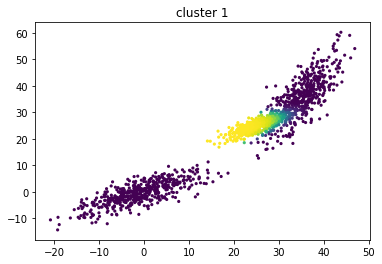

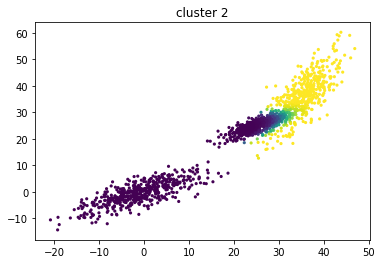

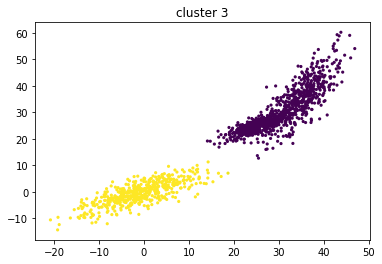

In [7]:
######### plots of p(x) values for each cluster ###########
num_cluster = 3
num_iteration = 100
mus, sigmas, r = GMM(data, num_cluster, num_iteration)

num_data = data.shape[0]
x = data[:,0]
y = data[:,1]
r1 = r[:,0]
r2 = r[:,1]
r3 = r[:,2]

# cluster 1 plot with p(x) value
fig, ax = plt.subplots()
ax.scatter(x,y,c=r1, s=10, edgecolor='')
plt.title('cluster 1')
plt.show()

# cluster 2 plot with p(x) value
fig, ax = plt.subplots()
ax.scatter(x,y,c=r2, s=10, edgecolor='')
plt.title('cluster 2')
plt.show()

# cluster 3 plot with p(x) value
fig, ax = plt.subplots()
ax.scatter(x,y,c=r3, s=10, edgecolor='')
plt.title('cluster 3')
plt.show()

